# Table of contents
[Libraries Used](#lib)

Part I: [Read data and EDA](#DataLoading)

Part II: [Feature selection and correlation](#featureselection)

Part III: [Model selection and data training](#modelselection)

Part IV: [Exploration-Exploitation](#exp-exp)


In [1]:
import numpy as np
from rdkit import Chem as CH
from rdkit.Chem import Descriptors
from rdkit.Chem.rdMolDescriptors import CalcMolFormula
from rdkit.Chem import AllChem
import pubchempy as pcp
from pymatgen.core.composition import Composition
from matminer.featurizers.composition import ElectronAffinity
from matminer.featurizers.composition import ElementFraction


import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt

#Own functions

import IC_calculator
import RDkit_Desc

# SKlearn libraries for learning.
from sklearn.model_selection import cross_val_score, cross_val_predict, KFold, RepeatedKFold
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.model_selection import ShuffleSplit, cross_validate, train_test_split
from sklearn import linear_model 
from xgboost import XGBRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn import kernel_ridge
from sklearn.utils import resample
from sklearn.metrics import r2_score
import xgboost as xgb
import lightgbm as lgbm
from catboost import CatBoostRegressor as CBRegressor




# SKlearn libraries for evaluation.
from sklearn import metrics
from sklearn.metrics import r2_score, mean_squared_error,mean_absolute_error
from sklearn.feature_selection import SelectFromModel


gen_planar_mol_feat=False

# Part I: Read data and EDA

<a id="DataLoading"></a>

### 1. Planar molecule dataset

In [2]:
if gen_planar_mol_feat == True:
    planar_mol = pd.read_csv('DataSource/filtered_planar_mol_by_fit.txt', index_col = None, delimiter = ',')
    smiles = planar_mol['SMILES']
    cid = planar_mol['CID']
    TPSA = []
    mol_weight = []
    aromatic_rings = []
    num_heavy_atoms = []
    LabuteASA = []
    SPAN = []
    GEDI = []

    #Getting gas-features from SMILES using rdkit
    for i in range(len(smiles)):
        m = CH.MolFromSmiles(smiles[i])
        mh = CH.AddHs(m)
        AllChem.EmbedMolecule(mh)
        TPSA.append(Descriptors.TPSA(m))
        mol_weight.append(Descriptors.MolWt(m))
        aromatic_rings.append(Descriptors.NumAromaticRings(m))
        num_heavy_atoms.append(Descriptors.HeavyAtomCount(m))
        LabuteASA.append(Descriptors.LabuteASA(m))
        SPAN.append(RDkit_Desc.get_SPAN(mh,None))
        GEDI.append(RDkit_Desc.get_GeDi(mh))

    planar_mol['TPSA'] = TPSA
    planar_mol['HeavyAtoms'] = num_heavy_atoms
    planar_mol['AromaticRings'] = aromatic_rings
    planar_mol['MolWt'] = mol_weight
    planar_mol['LabuteASA'] = LabuteASA
    planar_mol['SPAN'] = SPAN
    planar_mol['GeDi'] = GEDI
    planar_mol = planar_mol.astype({'CID' :'str'})
    planar_mol
    #planar_mol.to_csv('DataSource/filtered_planar_mol_by_fit_with_features.txt', index=False)

In [3]:
planar_mol = pd.read_csv('DataSource/filtered_planar_mol_by_fit_with_features', index_col = None, delimiter = ',')
planar_mol = planar_mol.astype({'CID' :'str'})
planar_mol

,CID,SMILES,TPSA,HeavyAtoms,AromaticRings,MolWt,LabuteASA,SPAN,GeDi
0,13,C1=CC(=C(C=C1Cl)Cl)Cl,0.00,9,1,181.449,68.341202,3.481711,6.260667
1,66,C1=CC(=C(C=C1Cl)O)Cl,20.23,9,1,163.003,62.832169,3.313690,6.323829
2,101,C1=CC(=CC(=C1)O)C=O,37.30,9,1,122.123,52.752101,3.360840,6.313907
3,240,C1=CC=C(C=C1)C=O,17.07,8,1,106.124,47.957867,3.345250,6.138852
4,241,C1=CC=CC=C1,0.00,6,1,78.114,37.431403,2.494200,4.970533
...,...,...,...,...,...,...,...,...,...
10113,5367417,C=CC=CC=C,0.00,6,0,80.130,38.495153,3.942085,7.841565
10114,137747,C=C=C=C,0.00,4,0,52.076,25.765268,2.701678,5.242299
10115,5463058,CC=CC=CC=C,0.00,7,0,94.157,44.860095,4.174226,8.014709
10116,139187,C=CC=C=C,0.00,5,0,66.103,32.130210,3.220374,6.013381


## 2. 2D materials dataset

In [4]:
TwoD_mat = pd.read_csv('DataSource/Bilayer-Bulk_TotalEnergy.txt', delimiter = ',')
SepBL = pd.read_csv('DataSource/SeparatedBilayerEnergy.txt', delimiter=',')
LC = pd.read_csv('DataSource/LC.txt', delimiter = ',')
SepE = []
HalfSet = int(len(TwoD_mat)/2)

BilayerEnergy = TwoD_mat.iloc[:HalfSet,:]

name = []
for i in BilayerEnergy['Material']:
    strip_text = str(i).strip('struc_Bilayer_')
    name.append(strip_text)
    
BilayerEnergy['Name'] = pd.DataFrame(name)   
SepBL = SepBL.merge(BilayerEnergy, on=["Name"], how="left")
SepBL['SeperationE'] = SepBL['IC'] - SepBL['E']
MaterialFeatures = SepBL.merge(LC, on=["Material"], how="left")

MaterialFeatures.drop(['IC', 'E', 'Material'], axis=1, inplace=True)
MaterialFeatures['a'] = MaterialFeatures['a']/3
MaterialFeatures['b'] = MaterialFeatures['b']/3
MaterialFeatures

MatFormula = []

for i in MaterialFeatures['Name']:
    i = i.replace("Mo", "Mo18")
    i = i.replace("W", "W18")
    i = i.replace("Hf", "Hf18")
    i = i.replace("Ti", "Ti18")
    i = i.replace("Cr", "Cr18")
    i = i.replace("Zr", "Zr18")
    i = i.replace("S2", "S36")
    i = i.replace("Se2", "Se36")
    i = i.replace("Te2", "Te36")
    i = i.replace("O2", "O36")
    MatFormula.append(i)
 
MaterialFeatures['MatFormula'] = pd.DataFrame(MatFormula)
#MaterialFeatures.to_csv('MaterialFeatures', index=False)
MaterialFeatures = MaterialFeatures[(MaterialFeatures.Name != 'ZrO2') & (MaterialFeatures.Name != 'HfO2') & (MaterialFeatures.Name != 'TiO2')]
MaterialFeatures

/Users/sriharik/miniconda3/envs/nano281/lib/python3.7/site-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,Name,SeperationE,a,b,c,SG,MatFormula
0,MoS2,1.766763,3.154333,3.154333,27.427,164.0,Mo18S36
1,MoSe2,2.056959,3.285000,3.285000,28.094,164.0,Mo18Se36
2,MoTe2,2.636494,3.493333,3.493333,28.999,164.0,Mo18Te36
3,MoO2,1.202318,2.828333,2.828333,25.010,164.0,Mo18O36
4,WS2,1.865270,3.162333,3.162333,27.460,164.0,W18S36
5,WSe2,2.142525,3.291667,3.291667,28.154,164.0,W18Se36
6,WTe2,2.694539,3.508333,3.508333,29.028,164.0,W18Te36
7,WO2,1.340843,2.832333,2.832333,25.022,164.0,W18O36
8,HfS2,1.844773,3.531667,3.531667,27.360,164.0,Hf18S36
9,HfSe2,2.075391,3.678000,3.678000,27.514,164.0,Hf18Se36


## 3. Intercalation Dataset

In [5]:
IC_1 = pd.read_csv('DataSource/IC_energy1.txt', delimiter =',')
IC_2 = pd.read_csv('DataSource/IC_energy2.txt', delimiter =',')
IC_3 = pd.read_csv('Results_Code_1/IC_THN_1.txt', delimiter =',')
IC_4 = pd.read_csv('Results_Code_1/IC_THU_1.txt', delimiter =',')
IC_5 = pd.read_csv('Results_Code_2/IC_THN_2.txt', delimiter =',')
IC_6 = pd.read_csv('Results_Code_2/IC_THU_2.txt', delimiter =',')
IC_7 = pd.read_csv('Results_Code_3/IC_THN_3.txt', delimiter =',')
IC_7_previous = pd.read_csv('Results_Code_3/OverlapFromPreviousAttempt_THN', delimiter =',')
IC_8 = pd.read_csv('Results_Code_3/IC_THU_3.txt', delimiter =',')

Gas = pd.read_csv('DataSource/Energy_gas.txt' , delimiter=',')
Gas_3 = pd.read_csv('Results_Code_1/Gas_THN_1.txt', delimiter =',')
Gas_4 = pd.read_csv('Results_Code_1/Gas_THU_1.txt', delimiter =',')
Gas_5 = pd.read_csv('Results_Code_2/Gas_THN_2.txt', delimiter =',')
Gas_6 = pd.read_csv('Results_Code_2/Gas_THU_2.txt', delimiter =',')
Gas_7 = pd.read_csv('Results_Code_3/Gas_THN_3.txt', delimiter =',')
Gas_7_previous = pd.read_csv('Results_Code_3/OverlapFromPreviousAttempt_THN_gas', delimiter = ',')
Gas_8 = pd.read_csv('Results_Code_3/Gas_THU_3.txt', delimiter =',')

Bilayer = pd.read_csv('DataSource/BilayerEnergy.txt', delimiter=',')

IC1 = IC_calculator.IC_calculator(IC_1, Gas, Bilayer)
IC2 = IC_calculator.IC_calculator(IC_2, Gas, Bilayer)
IC3 = IC_calculator.IC_calculator(IC_3, Gas_3, Bilayer)
IC4 = IC_calculator.IC_calculator(IC_4, Gas_4, Bilayer)
IC5 = IC_calculator.IC_calculator(IC_5, Gas_5, Bilayer)
IC6 = IC_calculator.IC_calculator(IC_6, Gas_6, Bilayer)
IC7 = IC_calculator.IC_calculator(IC_7, Gas_7, Bilayer)
IC7_previous = IC_calculator.IC_calculator(IC_7_previous, Gas_7_previous, Bilayer)
IC8 = IC_calculator.IC_calculator(IC_8, Gas_8, Bilayer)

IC = pd.concat([IC1, IC2, IC3, IC4, IC5, IC6, IC7, IC7_previous, IC8], axis=0).drop_duplicates()
IC

,System,Name,CID,IC_ENERGY
0,12606301_CrS2_0,CrS2,12606301,0.134932
1,12606301_CrSe2_0,CrSe2,12606301,0.466738
2,12606301_CrTe2_0,CrTe2,12606301,1.030505
3,12606301_HfS2_0,HfS2,12606301,-0.796573
4,12606301_HfSe2_0,HfSe2,12606301,-0.156093
...,...,...,...,...
145,87361649_WTe2_0,WTe2,87361649,0.244502
146,87361649_ZrS2_0,ZrS2,87361649,-1.903408
147,87361649_ZrSe2_0,ZrSe2,87361649,-1.230356
148,87361649_ZrTe2_0,ZrTe2,87361649,-0.373538


## 4. Merging the three datasets above

In [6]:
Merge_2_3 = IC.merge(MaterialFeatures, on=["Name"], how="right")
FinalSet = Merge_2_3.merge(planar_mol, on=["CID"], how="left").dropna()
#FinalSet = FinalSet[FinalSet.CID != '88957274']

## We want the fractional composition of constituent elements as features. 
## The following lines do that...

gas_formula = []
for i in FinalSet['SMILES']:
    m = CH.MolFromSmiles(i)
    gas_formula.append(CalcMolFormula(m))

FinalSet['Gas_Formula'] = gas_formula
FinalSet['CompoundFormula'] = FinalSet['MatFormula']+FinalSet['Gas_Formula']

Comp = []
for i in FinalSet['CompoundFormula']:
    Comp.append(Composition(i))
    
FinalSet['Composition'] = Comp
from matminer.featurizers.composition import ElementFraction
from matminer.featurizers.composition import Stoichiometry

FinalSet = ElementFraction().featurize_dataframe(FinalSet, 'Composition')

FinalSet = FinalSet.drop_duplicates(subset=['System'])
### Making a copy of Final Set with 'Name', 'SMILES', 'CID'. 
### This is for when we use Final Set and merge it with PredictionSet to make ExploitSet
MergeWithPredictionSet = FinalSet.drop(['b', 'SG', 'c', 'Composition','Gas_Formula', 'CompoundFormula', 'MatFormula', 'MolWt', 'LabuteASA', 'HeavyAtoms'], axis = 1)

### FinalSet for developing ML model
FinalSet = FinalSet.drop(['b', 'SMILES', 'SG', 'c', 'Composition', 'Name', 'CID','Gas_Formula', 'CompoundFormula', 'MatFormula','MolWt','LabuteASA', 'HeavyAtoms'], axis = 1)

## For plotting feature correlation
PlotSet = FinalSet.loc[:, (FinalSet != 0).any(axis=0)] 

FinalSet =FinalSet[FinalSet['IC_ENERGY'] < 10]
FinalSet =FinalSet[FinalSet['IC_ENERGY'] > -4]

ElementFraction:   0%|          | 0/1061 [00:00<?, ?it/s]

In [7]:
FinalSet

,System,IC_ENERGY,SeperationE,a,TPSA,AromaticRings,SPAN,GeDi,H,He,...,Pu,Am,Cm,Bk,Cf,Es,Fm,Md,No,Lr
2,137161100_MoS2_0,0.435827,1.766763,3.154333,63.05,2.0,3.050890,5.910676,0.044118,0,...,0,0,0,0,0,0,0,0,0,0
6,154148619_MoS2_0,0.219380,1.766763,3.154333,45.75,2.0,4.867923,7.441902,0.044118,0,...,0,0,0,0,0,0,0,0,0,0
8,20197826_MoS2_0,0.523010,1.766763,3.154333,12.89,0.0,3.781485,5.781853,0.046154,0,...,0,0,0,0,0,0,0,0,0,0
9,20405740_MoS2_0,0.749361,1.766763,3.154333,51.81,2.0,3.281336,5.952812,0.045455,0,...,0,0,0,0,0,0,0,0,0,0
10,45080076_MoS2_0,0.280013,1.766763,3.154333,43.08,3.0,3.485019,6.566693,0.057971,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1265,83382722_ZrTe2_0,0.699055,2.625600,3.495000,30.19,2.0,3.977433,6.094852,0.058824,0,...,0,0,0,0,0,0,0,0,0,0
1266,87639233_ZrTe2_0,0.326998,2.625600,3.495000,18.46,1.0,3.645334,6.573078,0.072464,0,...,0,0,0,0,0,0,0,0,0,0
1269,154926700_ZrTe2_0,-0.894059,2.625600,3.495000,13.14,1.0,3.115683,5.673467,0.059701,0,...,0,0,0,0,0,0,0,0,0,0
1270,86249522_ZrTe2_0,0.750397,2.625600,3.495000,0.00,0.0,3.142076,6.277975,0.088235,0,...,0,0,0,0,0,0,0,0,0,0


# Part II: Feature Selection and Correlation

<a id="featureselection"></a>

Text(0.5, 1.0, 'Features Correlating with IC energy')

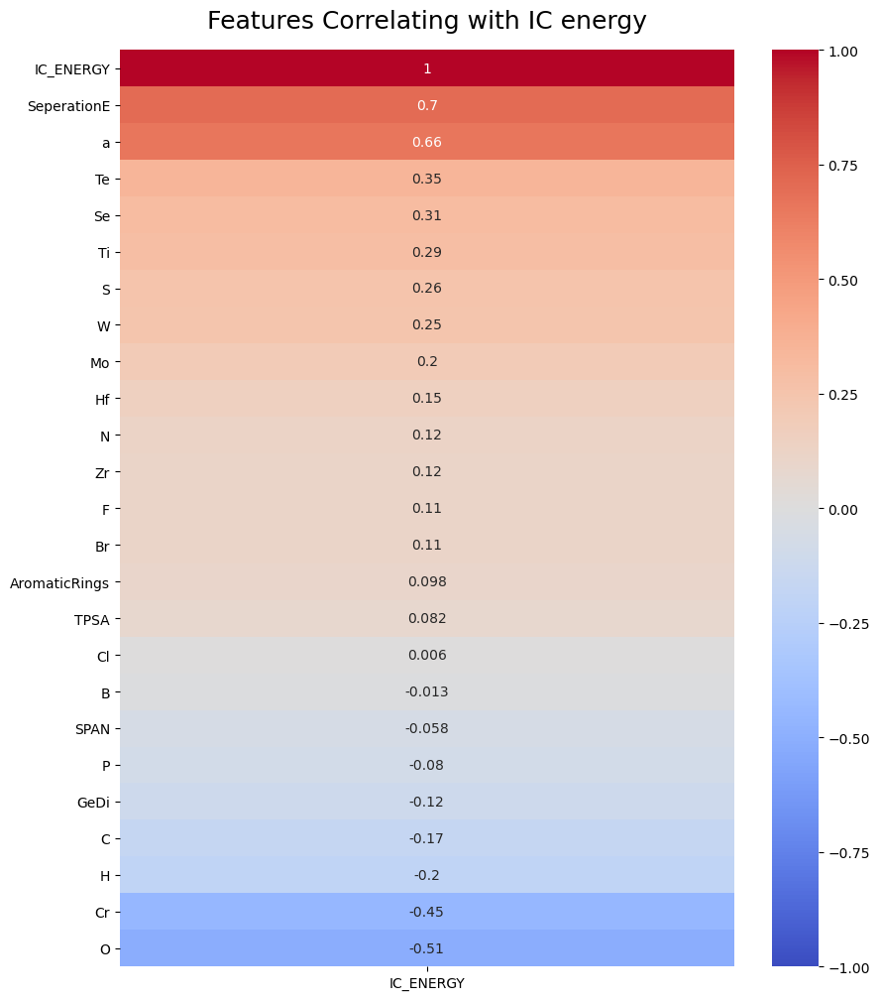

In [8]:
plt.figure(figsize=(10, 12))
matrix = (PlotSet.corr(method = 'spearman')).round(3)
matrix = matrix[~np.isnan(matrix)]


heatmap = sns.heatmap(matrix[['IC_ENERGY']].sort_values(by='IC_ENERGY', ascending=False), vmin=-1, vmax=1, annot=True, cmap='coolwarm')
heatmap.set_title('Features Correlating with IC energy', fontdict={'fontsize':18}, pad=16)

# Part III: Model Selection and Data Training

<a id="modelselection"></a>

In [9]:
exclude = ['IC_ENERGY', 'System']
features = [c for c in FinalSet.columns if c not in exclude]
X = FinalSet[features]
y = FinalSet["IC_ENERGY"]

## Evaluating performance of various models

In [10]:
#Lets use train/split ratio of 70/30 - Use ShuffleSplit
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)
#kfold = KFold(n_splits = 5, shuffle = True, random_state = 42 )

# Use some linear reg model and some with boosting capabilities

hyper_params_lgbm = {
    "objective" : "multiclass",
    'task': 'train',
    'boosting_type': 'gbdt',
    'objective': 'regression',
    'n_estimators': 500,
    "verbosity" : -1 
}

hyper_params_xgb = { 
    'objective': 'reg:squarederror',  # error evaluation for multiclass tasks
    'n_estimators': 500,
    'eval_metric': mean_absolute_error
    }

hyper_params_cb = {   
    'n_estimators': 500,
    'eval_metric': mean_absolute_error
    }

#Use ShuffleSplit for cross validation of dataset. Kfold also gives similar result
cv_split = ShuffleSplit(n_splits = 5, test_size = 0.30, random_state = 42)

# Initializing the Algorithms # I have tried a couple of them. Just showing a handful here
algorithm_list = {'LinearReg': linear_model.LinearRegression(), 
                  'BayeRidge':linear_model.BayesianRidge(),
                  'LassoLars': linear_model.LassoLars(alpha=0.01),
                  'LeastAngLars':linear_model.Lars(),
                  'XgbostReg': xgb.XGBRegressor(**hyper_params_xgb),
                  'LGBMReg': lgbm.LGBMRegressor(**hyper_params_lgbm),
                  'CatBoost' : CBRegressor(),
                  'KernelRidge' : kernel_ridge.KernelRidge(alpha=1,kernel='poly',gamma=None,degree=3,coef0=1,kernel_params=None)
                 }

test_R2 = []
train_R2 = []
ad_R2 = []
CV_R2 = []
CV_R2_std = []
mse = []
mae = []
std = []
mape = []
mod = []
mod_call_name = []
ModelMetrics = pd.DataFrame()
# Fit the various model
for key,model in algorithm_list.items():
    try:
        if key == 'XgbostReg' or key == 'LGBMReg' or key == 'CatBoost':
            model.fit(X_train, y_train,early_stopping_rounds=100,eval_set=[(X_test, y_test)])
        else:
            model.fit(X_train, y_train)
        # Cross-validate the result to avoid over fitting
        cv_results = cross_validate(model, X_train, y_train, cv  = cv_split)
#        cv_results = RepeatedKFold(n_splits = 5, n_repeats = 3, random_state = 42)
        adj_R2 = 1 - (1-model.score(X_train, y_train))*(len(y_train)-1)/(len(y_train)-X_train.shape[1]-1)
        y_pred = model.predict(X_test) 
        # Print model and test metrics
        print(f'Model - {key: <5} || Model Score: %.3f, Adj_R^2: %.3f, Test Score: %.3f, Cross Val Score: %.3f' 
              %(model.score(X_train, y_train),adj_R2, model.score(X_test, y_test), cv_results.get('test_score').mean()))
        mod.append(key)
        test_R2.append(model.score(X_test, y_test))
        train_R2.append(model.score(X_train, y_train))
        ad_R2.append(adj_R2)
        CV_R2.append(cv_results.get('test_score').mean())
        CV_R2_std.append(cv_results.get('test_score').std())
        
        print(f'Model - {key: <5} || MSE: %.3f, MAE: %.3f, STD: %.3f, MAPE: %.3f%%' 
              %(metrics.mean_squared_error(y_test, y_pred), metrics.mean_absolute_error(y_test, y_pred), 
                cv_results.get('test_score').std(), metrics.mean_absolute_percentage_error(y_test, y_pred)*100))
        mse.append(metrics.mean_squared_error(y_test, y_pred))
        mae.append(metrics.mean_absolute_error(y_test, y_pred))
        std.append(cv_results.get('test_score').std())
        mape.append(metrics.mean_absolute_percentage_error(y_test, y_pred)*100)
        mod_call_name.append(model)
        
        print(f'Model - {key: <5}  || Cross Validation Progress: \n')
        print(pd.DataFrame(cv_results))
        print('----------------------------------------------------------------------------------------------------------')
    except Exception as e:
        print(f"Exception occurred in {str(e)}")
        pass 



ModelMetrics['Model'] = mod
ModelMetrics['Train_R2'] = train_R2
ModelMetrics['Adjusted_R2'] = ad_R2
ModelMetrics['Test_R2'] = test_R2
ModelMetrics['CV_R2'] = CV_R2
ModelMetrics['Std_in_CV'] = CV_R2_std
ModelMetrics['MSE'] = mse
ModelMetrics['MAE'] = mae
ModelMetrics['STD'] = std
ModelMetrics['MAPE'] = mape

Model - LinearReg || Model Score: 0.577, Adj_R^2: 0.483, Test Score: 0.629, Cross Val Score: 0.576
Model - LinearReg || MSE: 0.257, MAE: 0.355, STD: 0.033, MAPE: 78.985%
Model - LinearReg  || Cross Validation Progress: 

   fit_time  score_time  test_score
0  0.015104    0.003089    0.538396
1  0.006193    0.002730    0.564352
2  0.013232    0.002585    0.547525
3  0.012244    0.002494    0.608314
4  0.010804    0.002522    0.621645
----------------------------------------------------------------------------------------------------------
Model - BayeRidge || Model Score: 0.551, Adj_R^2: 0.452, Test Score: 0.611, Cross Val Score: 0.541
Model - BayeRidge || MSE: 0.270, MAE: 0.364, STD: 0.044, MAPE: 93.379%
Model - BayeRidge  || Cross Validation Progress: 

   fit_time  score_time  test_score
0  0.009072    0.002317    0.457667
1  0.011590    0.002142    0.547036
2  0.023598    0.002169    0.579255
3  0.008956    0.002176    0.543210
4  0.008970    0.002133    0.576625
-------------------

/Users/sriharik/miniconda3/envs/nano281/lib/python3.7/site-packages/sklearn/linear_model/_base.py:138: FutureWarning: The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLars())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
  FutureWarning,
/Users/sriharik/miniconda3/envs/nano281/lib/python3.7/site-packages/sklearn/linear_model/_base.py:138: FutureWarning: The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the dat

[16]	validation_0-rmse:0.37597
[17]	validation_0-rmse:0.37358
[18]	validation_0-rmse:0.37342
[19]	validation_0-rmse:0.37398
[20]	validation_0-rmse:0.37312
[21]	validation_0-rmse:0.37279
[22]	validation_0-rmse:0.37214
[23]	validation_0-rmse:0.37228
[24]	validation_0-rmse:0.37251
[25]	validation_0-rmse:0.37250
[26]	validation_0-rmse:0.37255
[27]	validation_0-rmse:0.37265
[28]	validation_0-rmse:0.37184
[29]	validation_0-rmse:0.37081
[30]	validation_0-rmse:0.37078
[31]	validation_0-rmse:0.36917
[32]	validation_0-rmse:0.36874
[33]	validation_0-rmse:0.36828
[34]	validation_0-rmse:0.36819
[35]	validation_0-rmse:0.37009
[36]	validation_0-rmse:0.36969
[37]	validation_0-rmse:0.36983
[38]	validation_0-rmse:0.36913
[39]	validation_0-rmse:0.36969
[40]	validation_0-rmse:0.36962
[41]	validation_0-rmse:0.36863
[42]	validation_0-rmse:0.36929
[43]	validation_0-rmse:0.36891
[44]	validation_0-rmse:0.36842
[45]	validation_0-rmse:0.36887
[46]	validation_0-rmse:0.36899
[47]	validation_0-rmse:0.36901
[48]	val

[275]	validation_0-rmse:0.36437
[276]	validation_0-rmse:0.36437
[277]	validation_0-rmse:0.36437
[278]	validation_0-rmse:0.36437
[279]	validation_0-rmse:0.36437
[280]	validation_0-rmse:0.36437
[281]	validation_0-rmse:0.36437
[282]	validation_0-rmse:0.36437
[283]	validation_0-rmse:0.36437
[284]	validation_0-rmse:0.36437
[285]	validation_0-rmse:0.36437
[286]	validation_0-rmse:0.36437
[287]	validation_0-rmse:0.36437
[288]	validation_0-rmse:0.36437
[289]	validation_0-rmse:0.36437
[290]	validation_0-rmse:0.36437
[291]	validation_0-rmse:0.36437
[292]	validation_0-rmse:0.36437
[293]	validation_0-rmse:0.36437
[294]	validation_0-rmse:0.36437
[295]	validation_0-rmse:0.36437
[296]	validation_0-rmse:0.36437
[297]	validation_0-rmse:0.36437
[298]	validation_0-rmse:0.36437
Model - XgbostReg || Model Score: 1.000, Adj_R^2: 1.000, Test Score: 0.808, Cross Val Score: 0.714
Model - XgbostReg || MSE: 0.133, MAE: 0.216, STD: 0.056, MAPE: 57.136%
Model - XgbostReg  || Cross Validation Progress: 

   fit_time

/Users/sriharik/miniconda3/envs/nano281/lib/python3.7/site-packages/lightgbm/sklearn.py:726: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "


Model - LGBMReg || Model Score: 0.958, Adj_R^2: 0.949, Test Score: 0.803, Cross Val Score: 0.733
Model - LGBMReg || MSE: 0.137, MAE: 0.240, STD: 0.036, MAPE: 77.991%
Model - LGBMReg  || Cross Validation Progress: 

   fit_time  score_time  test_score
0  0.102461    0.004206    0.686757
1  0.127602    0.003105    0.703875
2  0.100871    0.002978    0.740763
3  0.098509    0.002930    0.788284
4  0.101141    0.002990    0.747382
----------------------------------------------------------------------------------------------------------
Learning rate set to 0.047046
0:	learn: 0.8959709	test: 0.8153978	best: 0.8153978 (0)	total: 55.4ms	remaining: 55.4s
1:	learn: 0.8756659	test: 0.7923323	best: 0.7923323 (1)	total: 56ms	remaining: 28s
2:	learn: 0.8585658	test: 0.7746525	best: 0.7746525 (2)	total: 56.6ms	remaining: 18.8s
3:	learn: 0.8402201	test: 0.7545591	best: 0.7545591 (3)	total: 57.2ms	remaining: 14.3s
4:	learn: 0.8246118	test: 0.7384699	best: 0.7384699 (4)	total: 57.9ms	remaining: 11.5s
5

170:	learn: 0.3401060	test: 0.3901162	best: 0.3901162 (170)	total: 159ms	remaining: 769ms
171:	learn: 0.3395528	test: 0.3896477	best: 0.3896477 (171)	total: 160ms	remaining: 769ms
172:	learn: 0.3388310	test: 0.3892369	best: 0.3892369 (172)	total: 160ms	remaining: 766ms
173:	learn: 0.3380615	test: 0.3890182	best: 0.3890182 (173)	total: 161ms	remaining: 764ms
174:	learn: 0.3368505	test: 0.3885379	best: 0.3885379 (174)	total: 162ms	remaining: 761ms
175:	learn: 0.3351800	test: 0.3870428	best: 0.3870428 (175)	total: 162ms	remaining: 759ms
176:	learn: 0.3338910	test: 0.3864841	best: 0.3864841 (176)	total: 163ms	remaining: 758ms
177:	learn: 0.3333923	test: 0.3862381	best: 0.3862381 (177)	total: 164ms	remaining: 755ms
178:	learn: 0.3328447	test: 0.3859559	best: 0.3859559 (178)	total: 164ms	remaining: 753ms
179:	learn: 0.3318412	test: 0.3858364	best: 0.3858364 (179)	total: 165ms	remaining: 751ms
180:	learn: 0.3312985	test: 0.3858302	best: 0.3858302 (180)	total: 166ms	remaining: 750ms
181:	learn

424:	learn: 0.2077500	test: 0.3585459	best: 0.3583724 (419)	total: 337ms	remaining: 455ms
425:	learn: 0.2076426	test: 0.3585491	best: 0.3583724 (419)	total: 337ms	remaining: 454ms
426:	learn: 0.2071265	test: 0.3586445	best: 0.3583724 (419)	total: 338ms	remaining: 453ms
427:	learn: 0.2066529	test: 0.3584155	best: 0.3583724 (419)	total: 338ms	remaining: 452ms
428:	learn: 0.2065152	test: 0.3581829	best: 0.3581829 (428)	total: 339ms	remaining: 451ms
429:	learn: 0.2064026	test: 0.3579773	best: 0.3579773 (429)	total: 340ms	remaining: 450ms
430:	learn: 0.2060549	test: 0.3579755	best: 0.3579755 (430)	total: 340ms	remaining: 449ms
431:	learn: 0.2059307	test: 0.3577409	best: 0.3577409 (431)	total: 341ms	remaining: 448ms
432:	learn: 0.2058317	test: 0.3577287	best: 0.3577287 (432)	total: 341ms	remaining: 447ms
433:	learn: 0.2052391	test: 0.3576304	best: 0.3576304 (433)	total: 342ms	remaining: 446ms
434:	learn: 0.2051058	test: 0.3574301	best: 0.3574301 (434)	total: 342ms	remaining: 445ms
435:	learn

762:	learn: 0.1357473	test: 0.3527998	best: 0.3519606 (719)	total: 517ms	remaining: 160ms
763:	learn: 0.1356109	test: 0.3528102	best: 0.3519606 (719)	total: 517ms	remaining: 160ms
764:	learn: 0.1355743	test: 0.3527875	best: 0.3519606 (719)	total: 518ms	remaining: 159ms
765:	learn: 0.1354264	test: 0.3528288	best: 0.3519606 (719)	total: 518ms	remaining: 158ms
766:	learn: 0.1353100	test: 0.3528034	best: 0.3519606 (719)	total: 519ms	remaining: 158ms
767:	learn: 0.1351402	test: 0.3527943	best: 0.3519606 (719)	total: 520ms	remaining: 157ms
768:	learn: 0.1350613	test: 0.3528011	best: 0.3519606 (719)	total: 520ms	remaining: 156ms
769:	learn: 0.1348221	test: 0.3527650	best: 0.3519606 (719)	total: 521ms	remaining: 156ms
770:	learn: 0.1346799	test: 0.3526982	best: 0.3519606 (719)	total: 521ms	remaining: 155ms
771:	learn: 0.1345508	test: 0.3527093	best: 0.3519606 (719)	total: 522ms	remaining: 154ms
772:	learn: 0.1342349	test: 0.3526802	best: 0.3519606 (719)	total: 522ms	remaining: 153ms
773:	learn

201:	learn: 0.3482022	total: 109ms	remaining: 429ms
202:	learn: 0.3472645	total: 110ms	remaining: 431ms
203:	learn: 0.3467536	total: 110ms	remaining: 430ms
204:	learn: 0.3461741	total: 111ms	remaining: 431ms
205:	learn: 0.3457018	total: 112ms	remaining: 430ms
206:	learn: 0.3452066	total: 112ms	remaining: 430ms
207:	learn: 0.3442583	total: 113ms	remaining: 430ms
208:	learn: 0.3432118	total: 114ms	remaining: 430ms
209:	learn: 0.3422685	total: 114ms	remaining: 430ms
210:	learn: 0.3412316	total: 115ms	remaining: 430ms
211:	learn: 0.3401688	total: 116ms	remaining: 430ms
212:	learn: 0.3394455	total: 116ms	remaining: 430ms
213:	learn: 0.3379099	total: 117ms	remaining: 430ms
214:	learn: 0.3370794	total: 118ms	remaining: 430ms
215:	learn: 0.3364036	total: 118ms	remaining: 430ms
216:	learn: 0.3355280	total: 119ms	remaining: 429ms
217:	learn: 0.3350890	total: 120ms	remaining: 429ms
218:	learn: 0.3339914	total: 120ms	remaining: 430ms
219:	learn: 0.3330004	total: 121ms	remaining: 429ms
220:	learn: 

555:	learn: 0.1788542	total: 290ms	remaining: 231ms
556:	learn: 0.1787232	total: 291ms	remaining: 231ms
557:	learn: 0.1784353	total: 291ms	remaining: 231ms
558:	learn: 0.1781182	total: 292ms	remaining: 230ms
559:	learn: 0.1779641	total: 292ms	remaining: 230ms
560:	learn: 0.1778448	total: 293ms	remaining: 229ms
561:	learn: 0.1775413	total: 293ms	remaining: 229ms
562:	learn: 0.1774364	total: 294ms	remaining: 228ms
563:	learn: 0.1772512	total: 294ms	remaining: 228ms
564:	learn: 0.1771767	total: 295ms	remaining: 227ms
565:	learn: 0.1770132	total: 296ms	remaining: 227ms
566:	learn: 0.1769019	total: 296ms	remaining: 226ms
567:	learn: 0.1765813	total: 297ms	remaining: 226ms
568:	learn: 0.1765059	total: 298ms	remaining: 225ms
569:	learn: 0.1763883	total: 298ms	remaining: 225ms
570:	learn: 0.1762979	total: 299ms	remaining: 224ms
571:	learn: 0.1761286	total: 299ms	remaining: 224ms
572:	learn: 0.1757777	total: 300ms	remaining: 223ms
573:	learn: 0.1753743	total: 301ms	remaining: 223ms
574:	learn: 

856:	learn: 0.1191187	total: 455ms	remaining: 75.9ms
857:	learn: 0.1189494	total: 456ms	remaining: 75.4ms
858:	learn: 0.1187414	total: 457ms	remaining: 74.9ms
859:	learn: 0.1186607	total: 457ms	remaining: 74.5ms
860:	learn: 0.1184503	total: 458ms	remaining: 74ms
861:	learn: 0.1183764	total: 459ms	remaining: 73.5ms
862:	learn: 0.1180357	total: 460ms	remaining: 73ms
863:	learn: 0.1179145	total: 460ms	remaining: 72.5ms
864:	learn: 0.1177459	total: 461ms	remaining: 71.9ms
865:	learn: 0.1177066	total: 462ms	remaining: 71.5ms
866:	learn: 0.1176658	total: 463ms	remaining: 71ms
867:	learn: 0.1175507	total: 463ms	remaining: 70.4ms
868:	learn: 0.1174935	total: 464ms	remaining: 69.9ms
869:	learn: 0.1172580	total: 464ms	remaining: 69.4ms
870:	learn: 0.1170509	total: 465ms	remaining: 68.9ms
871:	learn: 0.1168965	total: 466ms	remaining: 68.3ms
872:	learn: 0.1168546	total: 466ms	remaining: 67.8ms
873:	learn: 0.1165914	total: 467ms	remaining: 67.3ms
874:	learn: 0.1165663	total: 467ms	remaining: 66.8ms

34:	learn: 0.6161747	total: 21.5ms	remaining: 593ms
35:	learn: 0.6120791	total: 22.3ms	remaining: 598ms
36:	learn: 0.6082835	total: 23.2ms	remaining: 603ms
37:	learn: 0.6044292	total: 23.8ms	remaining: 603ms
38:	learn: 0.6010905	total: 24.4ms	remaining: 602ms
39:	learn: 0.5967219	total: 25ms	remaining: 601ms
40:	learn: 0.5926110	total: 25.6ms	remaining: 598ms
41:	learn: 0.5882356	total: 26.2ms	remaining: 597ms
42:	learn: 0.5846498	total: 26.9ms	remaining: 598ms
43:	learn: 0.5802610	total: 27.4ms	remaining: 596ms
44:	learn: 0.5758500	total: 28ms	remaining: 595ms
45:	learn: 0.5741667	total: 28.3ms	remaining: 588ms
46:	learn: 0.5719235	total: 28.9ms	remaining: 586ms
47:	learn: 0.5677028	total: 29.4ms	remaining: 584ms
48:	learn: 0.5637116	total: 30ms	remaining: 582ms
49:	learn: 0.5618194	total: 30.5ms	remaining: 579ms
50:	learn: 0.5580841	total: 31ms	remaining: 576ms
51:	learn: 0.5541871	total: 31.5ms	remaining: 575ms
52:	learn: 0.5517196	total: 32.1ms	remaining: 574ms
53:	learn: 0.5477104

358:	learn: 0.2500360	total: 202ms	remaining: 360ms
359:	learn: 0.2496962	total: 202ms	remaining: 360ms
360:	learn: 0.2493511	total: 203ms	remaining: 359ms
361:	learn: 0.2489723	total: 204ms	remaining: 359ms
362:	learn: 0.2483303	total: 204ms	remaining: 358ms
363:	learn: 0.2478674	total: 205ms	remaining: 358ms
364:	learn: 0.2472563	total: 205ms	remaining: 357ms
365:	learn: 0.2466074	total: 206ms	remaining: 356ms
366:	learn: 0.2460379	total: 206ms	remaining: 356ms
367:	learn: 0.2455663	total: 207ms	remaining: 355ms
368:	learn: 0.2451230	total: 207ms	remaining: 354ms
369:	learn: 0.2446165	total: 208ms	remaining: 354ms
370:	learn: 0.2440187	total: 208ms	remaining: 353ms
371:	learn: 0.2436145	total: 209ms	remaining: 353ms
372:	learn: 0.2431621	total: 209ms	remaining: 352ms
373:	learn: 0.2429229	total: 210ms	remaining: 351ms
374:	learn: 0.2424223	total: 210ms	remaining: 351ms
375:	learn: 0.2423050	total: 211ms	remaining: 350ms
376:	learn: 0.2416470	total: 211ms	remaining: 349ms
377:	learn: 

723:	learn: 0.1451833	total: 384ms	remaining: 146ms
724:	learn: 0.1451374	total: 385ms	remaining: 146ms
725:	learn: 0.1449912	total: 386ms	remaining: 146ms
726:	learn: 0.1448539	total: 386ms	remaining: 145ms
727:	learn: 0.1447430	total: 387ms	remaining: 145ms
728:	learn: 0.1446579	total: 387ms	remaining: 144ms
729:	learn: 0.1445047	total: 388ms	remaining: 143ms
730:	learn: 0.1444235	total: 388ms	remaining: 143ms
731:	learn: 0.1441269	total: 389ms	remaining: 142ms
732:	learn: 0.1440460	total: 390ms	remaining: 142ms
733:	learn: 0.1437692	total: 390ms	remaining: 141ms
734:	learn: 0.1437319	total: 391ms	remaining: 141ms
735:	learn: 0.1435444	total: 391ms	remaining: 140ms
736:	learn: 0.1433027	total: 392ms	remaining: 140ms
737:	learn: 0.1432550	total: 393ms	remaining: 139ms
738:	learn: 0.1431530	total: 393ms	remaining: 139ms
739:	learn: 0.1431085	total: 394ms	remaining: 138ms
740:	learn: 0.1428900	total: 394ms	remaining: 138ms
741:	learn: 0.1427305	total: 395ms	remaining: 137ms
742:	learn: 

970:	learn: 0.1107118	total: 528ms	remaining: 15.8ms
971:	learn: 0.1105518	total: 529ms	remaining: 15.2ms
972:	learn: 0.1104815	total: 529ms	remaining: 14.7ms
973:	learn: 0.1103161	total: 530ms	remaining: 14.1ms
974:	learn: 0.1101098	total: 531ms	remaining: 13.6ms
975:	learn: 0.1099981	total: 531ms	remaining: 13.1ms
976:	learn: 0.1098434	total: 532ms	remaining: 12.5ms
977:	learn: 0.1097454	total: 533ms	remaining: 12ms
978:	learn: 0.1096420	total: 533ms	remaining: 11.4ms
979:	learn: 0.1094279	total: 534ms	remaining: 10.9ms
980:	learn: 0.1093522	total: 535ms	remaining: 10.4ms
981:	learn: 0.1093294	total: 535ms	remaining: 9.81ms
982:	learn: 0.1091932	total: 536ms	remaining: 9.27ms
983:	learn: 0.1091267	total: 537ms	remaining: 8.73ms
984:	learn: 0.1088963	total: 538ms	remaining: 8.19ms
985:	learn: 0.1088074	total: 538ms	remaining: 7.64ms
986:	learn: 0.1087645	total: 539ms	remaining: 7.1ms
987:	learn: 0.1086299	total: 539ms	remaining: 6.55ms
988:	learn: 0.1085352	total: 540ms	remaining: 6.0

213:	learn: 0.3328015	total: 124ms	remaining: 454ms
214:	learn: 0.3318285	total: 125ms	remaining: 457ms
215:	learn: 0.3314612	total: 127ms	remaining: 460ms
216:	learn: 0.3306100	total: 128ms	remaining: 463ms
217:	learn: 0.3290682	total: 129ms	remaining: 463ms
218:	learn: 0.3288978	total: 131ms	remaining: 466ms
219:	learn: 0.3277550	total: 132ms	remaining: 467ms
220:	learn: 0.3269123	total: 133ms	remaining: 468ms
221:	learn: 0.3254322	total: 134ms	remaining: 469ms
222:	learn: 0.3250878	total: 135ms	remaining: 470ms
223:	learn: 0.3239418	total: 136ms	remaining: 471ms
224:	learn: 0.3224552	total: 137ms	remaining: 470ms
225:	learn: 0.3211266	total: 137ms	remaining: 470ms
226:	learn: 0.3202882	total: 138ms	remaining: 470ms
227:	learn: 0.3198404	total: 139ms	remaining: 470ms
228:	learn: 0.3190926	total: 140ms	remaining: 470ms
229:	learn: 0.3184001	total: 140ms	remaining: 470ms
230:	learn: 0.3178150	total: 141ms	remaining: 470ms
231:	learn: 0.3171111	total: 142ms	remaining: 471ms
232:	learn: 

536:	learn: 0.1830755	total: 305ms	remaining: 263ms
537:	learn: 0.1827326	total: 306ms	remaining: 263ms
538:	learn: 0.1824549	total: 307ms	remaining: 262ms
539:	learn: 0.1823670	total: 307ms	remaining: 261ms
540:	learn: 0.1819285	total: 307ms	remaining: 261ms
541:	learn: 0.1816347	total: 308ms	remaining: 260ms
542:	learn: 0.1813473	total: 309ms	remaining: 260ms
543:	learn: 0.1811495	total: 309ms	remaining: 259ms
544:	learn: 0.1808600	total: 310ms	remaining: 259ms
545:	learn: 0.1806106	total: 310ms	remaining: 258ms
546:	learn: 0.1804703	total: 311ms	remaining: 257ms
547:	learn: 0.1803221	total: 311ms	remaining: 257ms
548:	learn: 0.1799589	total: 312ms	remaining: 256ms
549:	learn: 0.1797383	total: 312ms	remaining: 256ms
550:	learn: 0.1793256	total: 313ms	remaining: 255ms
551:	learn: 0.1791225	total: 313ms	remaining: 254ms
552:	learn: 0.1788602	total: 314ms	remaining: 254ms
553:	learn: 0.1786637	total: 315ms	remaining: 253ms
554:	learn: 0.1785947	total: 315ms	remaining: 253ms
555:	learn: 

863:	learn: 0.1203802	total: 470ms	remaining: 74ms
864:	learn: 0.1202255	total: 471ms	remaining: 73.4ms
865:	learn: 0.1201255	total: 471ms	remaining: 72.9ms
866:	learn: 0.1200695	total: 472ms	remaining: 72.3ms
867:	learn: 0.1199651	total: 472ms	remaining: 71.8ms
868:	learn: 0.1199444	total: 473ms	remaining: 71.3ms
869:	learn: 0.1197340	total: 473ms	remaining: 70.7ms
870:	learn: 0.1196618	total: 474ms	remaining: 70.2ms
871:	learn: 0.1195783	total: 474ms	remaining: 69.6ms
872:	learn: 0.1195059	total: 475ms	remaining: 69.1ms
873:	learn: 0.1194051	total: 475ms	remaining: 68.5ms
874:	learn: 0.1192872	total: 476ms	remaining: 68ms
875:	learn: 0.1191791	total: 477ms	remaining: 67.5ms
876:	learn: 0.1190312	total: 477ms	remaining: 66.9ms
877:	learn: 0.1188792	total: 478ms	remaining: 66.4ms
878:	learn: 0.1186915	total: 478ms	remaining: 65.8ms
879:	learn: 0.1185941	total: 479ms	remaining: 65.3ms
880:	learn: 0.1185269	total: 479ms	remaining: 64.8ms
881:	learn: 0.1183617	total: 480ms	remaining: 64.2

171:	learn: 0.3873159	total: 89.5ms	remaining: 431ms
172:	learn: 0.3862942	total: 90.2ms	remaining: 431ms
173:	learn: 0.3854866	total: 90.7ms	remaining: 430ms
174:	learn: 0.3833604	total: 91.5ms	remaining: 431ms
175:	learn: 0.3814698	total: 92ms	remaining: 431ms
176:	learn: 0.3807308	total: 92.5ms	remaining: 430ms
177:	learn: 0.3801655	total: 93ms	remaining: 430ms
178:	learn: 0.3791416	total: 93.6ms	remaining: 429ms
179:	learn: 0.3780493	total: 94.2ms	remaining: 429ms
180:	learn: 0.3773782	total: 94.7ms	remaining: 428ms
181:	learn: 0.3771448	total: 95.1ms	remaining: 428ms
182:	learn: 0.3766504	total: 95.7ms	remaining: 427ms
183:	learn: 0.3758752	total: 96.3ms	remaining: 427ms
184:	learn: 0.3755400	total: 96.8ms	remaining: 426ms
185:	learn: 0.3749889	total: 97.3ms	remaining: 426ms
186:	learn: 0.3733429	total: 97.8ms	remaining: 425ms
187:	learn: 0.3719630	total: 98.3ms	remaining: 425ms
188:	learn: 0.3710508	total: 98.8ms	remaining: 424ms
189:	learn: 0.3701878	total: 99.3ms	remaining: 424

538:	learn: 0.1950358	total: 271ms	remaining: 231ms
539:	learn: 0.1950057	total: 271ms	remaining: 231ms
540:	learn: 0.1946132	total: 272ms	remaining: 231ms
541:	learn: 0.1945741	total: 272ms	remaining: 230ms
542:	learn: 0.1942627	total: 273ms	remaining: 230ms
543:	learn: 0.1940219	total: 273ms	remaining: 229ms
544:	learn: 0.1936460	total: 274ms	remaining: 229ms
545:	learn: 0.1934369	total: 275ms	remaining: 228ms
546:	learn: 0.1930904	total: 275ms	remaining: 228ms
547:	learn: 0.1927152	total: 276ms	remaining: 227ms
548:	learn: 0.1926948	total: 276ms	remaining: 227ms
549:	learn: 0.1926530	total: 277ms	remaining: 226ms
550:	learn: 0.1926268	total: 277ms	remaining: 226ms
551:	learn: 0.1924553	total: 278ms	remaining: 225ms
552:	learn: 0.1924346	total: 278ms	remaining: 225ms
553:	learn: 0.1922123	total: 279ms	remaining: 224ms
554:	learn: 0.1919181	total: 279ms	remaining: 224ms
555:	learn: 0.1916571	total: 280ms	remaining: 223ms
556:	learn: 0.1914225	total: 280ms	remaining: 223ms
557:	learn: 

864:	learn: 0.1337377	total: 442ms	remaining: 69ms
865:	learn: 0.1335962	total: 443ms	remaining: 68.5ms
866:	learn: 0.1335319	total: 443ms	remaining: 68ms
867:	learn: 0.1334255	total: 444ms	remaining: 67.6ms
868:	learn: 0.1332316	total: 445ms	remaining: 67.1ms
869:	learn: 0.1331371	total: 446ms	remaining: 66.6ms
870:	learn: 0.1329238	total: 446ms	remaining: 66.1ms
871:	learn: 0.1327509	total: 447ms	remaining: 65.6ms
872:	learn: 0.1326784	total: 448ms	remaining: 65.1ms
873:	learn: 0.1325849	total: 448ms	remaining: 64.6ms
874:	learn: 0.1323724	total: 449ms	remaining: 64.1ms
875:	learn: 0.1323636	total: 449ms	remaining: 63.6ms
876:	learn: 0.1322226	total: 450ms	remaining: 63.1ms
877:	learn: 0.1320528	total: 451ms	remaining: 62.6ms
878:	learn: 0.1318573	total: 451ms	remaining: 62.1ms
879:	learn: 0.1317247	total: 452ms	remaining: 61.6ms
880:	learn: 0.1317178	total: 453ms	remaining: 61.1ms
881:	learn: 0.1315143	total: 453ms	remaining: 60.6ms
882:	learn: 0.1312486	total: 454ms	remaining: 60.1

149:	learn: 0.4237564	total: 74.4ms	remaining: 422ms
150:	learn: 0.4230074	total: 75.1ms	remaining: 422ms
151:	learn: 0.4224987	total: 75.6ms	remaining: 422ms
152:	learn: 0.4214792	total: 76.2ms	remaining: 422ms
153:	learn: 0.4207747	total: 76.7ms	remaining: 421ms
154:	learn: 0.4196127	total: 77.3ms	remaining: 421ms
155:	learn: 0.4187133	total: 77.8ms	remaining: 421ms
156:	learn: 0.4183538	total: 78.3ms	remaining: 420ms
157:	learn: 0.4172121	total: 78.8ms	remaining: 420ms
158:	learn: 0.4154395	total: 79.3ms	remaining: 419ms
159:	learn: 0.4144508	total: 79.8ms	remaining: 419ms
160:	learn: 0.4141857	total: 80.3ms	remaining: 419ms
161:	learn: 0.4127992	total: 80.9ms	remaining: 418ms
162:	learn: 0.4123368	total: 81.4ms	remaining: 418ms
163:	learn: 0.4113855	total: 82ms	remaining: 418ms
164:	learn: 0.4106345	total: 82.5ms	remaining: 417ms
165:	learn: 0.4097122	total: 83.1ms	remaining: 417ms
166:	learn: 0.4086370	total: 83.8ms	remaining: 418ms
167:	learn: 0.4072337	total: 84.4ms	remaining: 4

499:	learn: 0.2191604	total: 255ms	remaining: 255ms
500:	learn: 0.2188349	total: 255ms	remaining: 254ms
501:	learn: 0.2187024	total: 256ms	remaining: 254ms
502:	learn: 0.2186745	total: 256ms	remaining: 253ms
503:	learn: 0.2184228	total: 257ms	remaining: 253ms
504:	learn: 0.2181799	total: 257ms	remaining: 252ms
505:	learn: 0.2174204	total: 258ms	remaining: 252ms
506:	learn: 0.2172275	total: 258ms	remaining: 251ms
507:	learn: 0.2168104	total: 259ms	remaining: 251ms
508:	learn: 0.2165949	total: 260ms	remaining: 250ms
509:	learn: 0.2163682	total: 260ms	remaining: 250ms
510:	learn: 0.2162983	total: 261ms	remaining: 249ms
511:	learn: 0.2160069	total: 261ms	remaining: 249ms
512:	learn: 0.2155909	total: 262ms	remaining: 248ms
513:	learn: 0.2154053	total: 262ms	remaining: 248ms
514:	learn: 0.2152169	total: 263ms	remaining: 248ms
515:	learn: 0.2150550	total: 263ms	remaining: 247ms
516:	learn: 0.2149794	total: 264ms	remaining: 247ms
517:	learn: 0.2145261	total: 264ms	remaining: 246ms
518:	learn: 

861:	learn: 0.1399716	total: 437ms	remaining: 70ms
862:	learn: 0.1399249	total: 438ms	remaining: 69.5ms
863:	learn: 0.1396687	total: 438ms	remaining: 69ms
864:	learn: 0.1394906	total: 439ms	remaining: 68.5ms
865:	learn: 0.1394174	total: 439ms	remaining: 67.9ms
866:	learn: 0.1392018	total: 440ms	remaining: 67.4ms
867:	learn: 0.1388866	total: 440ms	remaining: 66.9ms
868:	learn: 0.1388582	total: 441ms	remaining: 66.4ms
869:	learn: 0.1387295	total: 441ms	remaining: 65.9ms
870:	learn: 0.1386844	total: 442ms	remaining: 65.4ms
871:	learn: 0.1385926	total: 442ms	remaining: 64.9ms
872:	learn: 0.1384406	total: 443ms	remaining: 64.4ms
873:	learn: 0.1381669	total: 443ms	remaining: 63.9ms
874:	learn: 0.1379413	total: 444ms	remaining: 63.4ms
875:	learn: 0.1376344	total: 444ms	remaining: 62.9ms
876:	learn: 0.1375663	total: 445ms	remaining: 62.4ms
877:	learn: 0.1374812	total: 445ms	remaining: 61.9ms
878:	learn: 0.1373220	total: 446ms	remaining: 61.4ms
879:	learn: 0.1371610	total: 447ms	remaining: 60.9

In [11]:
ModelMetrics

,Model,Train_R2,Adjusted_R2,Test_R2,CV_R2,Std_in_CV,MSE,MAE,STD,MAPE
0,LinearReg,0.576695,0.483294,0.628600,0.576046,0.033130,0.257450,0.355223,0.033130,78.985326
1,BayeRidge,0.551064,0.452008,0.610688,0.540759,0.044086,0.269866,0.363779,0.044086,93.379448
2,LassoLars,0.305703,0.152508,0.381574,0.369938,0.023764,0.428685,0.493077,0.023764,101.404018
3,LeastAngLars,-685227.622610,-836421.792376,-821064.566163,-11.098255,16.765137,569151.852340,601.109500,16.765137,210569.551053
4,XgbostReg,0.999982,0.999978,0.808476,0.714354,0.055588,0.132762,0.216273,0.055588,57.136213
5,LGBMReg,0.958351,0.949161,0.803056,0.733412,0.035523,0.136519,0.240026,0.035523,77.990938
6,CatBoost,0.975779,0.970435,0.821295,0.746902,0.047855,0.123876,0.207951,0.047855,56.719279
7,KernelRidge,0.524108,0.419103,0.609786,0.533191,0.052480,0.270491,0.370443,0.052480,107.349787


# Parity Plot of the Best Model

Learning rate set to 0.036496
0:	learn: 0.9014188	total: 1.11ms	remaining: 1.11s
1:	learn: 0.8847237	total: 1.98ms	remaining: 988ms
2:	learn: 0.8710296	total: 3.14ms	remaining: 1.04s
3:	learn: 0.8562802	total: 3.93ms	remaining: 978ms
4:	learn: 0.8434077	total: 5.04ms	remaining: 1s
5:	learn: 0.8316769	total: 5.99ms	remaining: 993ms
6:	learn: 0.8178238	total: 7.24ms	remaining: 1.03s
7:	learn: 0.8065060	total: 8.19ms	remaining: 1.01s
8:	learn: 0.7951247	total: 9.27ms	remaining: 1.02s
9:	learn: 0.7833489	total: 10.3ms	remaining: 1.02s
10:	learn: 0.7739737	total: 11.5ms	remaining: 1.03s
11:	learn: 0.7625470	total: 12.5ms	remaining: 1.03s
12:	learn: 0.7538072	total: 13.5ms	remaining: 1.03s
13:	learn: 0.7446046	total: 14.4ms	remaining: 1.01s
14:	learn: 0.7354879	total: 15.1ms	remaining: 994ms
15:	learn: 0.7275819	total: 15.9ms	remaining: 977ms
16:	learn: 0.7181920	total: 16.6ms	remaining: 960ms
17:	learn: 0.7092302	total: 17.3ms	remaining: 945ms
18:	learn: 0.7007419	total: 18.1ms	remaining: 9

219:	learn: 0.3293643	total: 160ms	remaining: 566ms
220:	learn: 0.3286190	total: 161ms	remaining: 567ms
221:	learn: 0.3282364	total: 162ms	remaining: 567ms
222:	learn: 0.3269952	total: 163ms	remaining: 567ms
223:	learn: 0.3260859	total: 164ms	remaining: 568ms
224:	learn: 0.3253247	total: 165ms	remaining: 567ms
225:	learn: 0.3240129	total: 166ms	remaining: 567ms
226:	learn: 0.3234852	total: 166ms	remaining: 566ms
227:	learn: 0.3230851	total: 167ms	remaining: 565ms
228:	learn: 0.3222387	total: 168ms	remaining: 564ms
229:	learn: 0.3218311	total: 168ms	remaining: 564ms
230:	learn: 0.3204403	total: 169ms	remaining: 563ms
231:	learn: 0.3197957	total: 170ms	remaining: 563ms
232:	learn: 0.3189415	total: 171ms	remaining: 563ms
233:	learn: 0.3179945	total: 172ms	remaining: 562ms
234:	learn: 0.3172532	total: 173ms	remaining: 562ms
235:	learn: 0.3161525	total: 173ms	remaining: 561ms
236:	learn: 0.3155138	total: 174ms	remaining: 561ms
237:	learn: 0.3147325	total: 175ms	remaining: 561ms
238:	learn: 

385:	learn: 0.2400967	total: 269ms	remaining: 428ms
386:	learn: 0.2395719	total: 270ms	remaining: 427ms
387:	learn: 0.2389389	total: 270ms	remaining: 426ms
388:	learn: 0.2384921	total: 271ms	remaining: 426ms
389:	learn: 0.2376600	total: 272ms	remaining: 425ms
390:	learn: 0.2372017	total: 272ms	remaining: 424ms
391:	learn: 0.2370704	total: 273ms	remaining: 423ms
392:	learn: 0.2366114	total: 273ms	remaining: 422ms
393:	learn: 0.2362745	total: 274ms	remaining: 422ms
394:	learn: 0.2358059	total: 275ms	remaining: 421ms
395:	learn: 0.2353341	total: 275ms	remaining: 420ms
396:	learn: 0.2349102	total: 276ms	remaining: 419ms
397:	learn: 0.2345780	total: 276ms	remaining: 418ms
398:	learn: 0.2344566	total: 277ms	remaining: 417ms
399:	learn: 0.2338833	total: 278ms	remaining: 416ms
400:	learn: 0.2335555	total: 278ms	remaining: 416ms
401:	learn: 0.2331675	total: 279ms	remaining: 415ms
402:	learn: 0.2329492	total: 279ms	remaining: 414ms
403:	learn: 0.2327717	total: 280ms	remaining: 413ms
404:	learn: 

671:	learn: 0.1636322	total: 434ms	remaining: 212ms
672:	learn: 0.1633265	total: 434ms	remaining: 211ms
673:	learn: 0.1628568	total: 435ms	remaining: 210ms
674:	learn: 0.1628012	total: 435ms	remaining: 210ms
675:	learn: 0.1626830	total: 436ms	remaining: 209ms
676:	learn: 0.1623892	total: 437ms	remaining: 208ms
677:	learn: 0.1623228	total: 437ms	remaining: 208ms
678:	learn: 0.1622445	total: 438ms	remaining: 207ms
679:	learn: 0.1621452	total: 438ms	remaining: 206ms
680:	learn: 0.1619472	total: 439ms	remaining: 206ms
681:	learn: 0.1618185	total: 440ms	remaining: 205ms
682:	learn: 0.1615177	total: 440ms	remaining: 204ms
683:	learn: 0.1613769	total: 441ms	remaining: 204ms
684:	learn: 0.1613119	total: 441ms	remaining: 203ms
685:	learn: 0.1610654	total: 442ms	remaining: 202ms
686:	learn: 0.1608504	total: 442ms	remaining: 202ms
687:	learn: 0.1605989	total: 443ms	remaining: 201ms
688:	learn: 0.1603981	total: 444ms	remaining: 200ms
689:	learn: 0.1601949	total: 444ms	remaining: 200ms
690:	learn: 

Learning rate set to 0.036496
0:	learn: 0.9155832	total: 610us	remaining: 610ms
1:	learn: 0.9004810	total: 1.16ms	remaining: 579ms
2:	learn: 0.8868543	total: 1.72ms	remaining: 572ms
3:	learn: 0.8718236	total: 2.26ms	remaining: 563ms
4:	learn: 0.8590226	total: 2.83ms	remaining: 563ms
5:	learn: 0.8473627	total: 3.41ms	remaining: 565ms
6:	learn: 0.8350911	total: 4.03ms	remaining: 571ms
7:	learn: 0.8249351	total: 4.58ms	remaining: 568ms
8:	learn: 0.8134220	total: 5.16ms	remaining: 568ms
9:	learn: 0.8022883	total: 5.78ms	remaining: 572ms
10:	learn: 0.7926636	total: 6.4ms	remaining: 575ms
11:	learn: 0.7816534	total: 7.05ms	remaining: 581ms
12:	learn: 0.7721689	total: 7.57ms	remaining: 575ms
13:	learn: 0.7644079	total: 8.09ms	remaining: 570ms
14:	learn: 0.7553960	total: 8.7ms	remaining: 571ms
15:	learn: 0.7482475	total: 9.24ms	remaining: 569ms
16:	learn: 0.7399820	total: 9.85ms	remaining: 570ms
17:	learn: 0.7315888	total: 10.4ms	remaining: 568ms
18:	learn: 0.7245167	total: 10.9ms	remaining: 5

243:	learn: 0.3402513	total: 145ms	remaining: 451ms
244:	learn: 0.3394157	total: 147ms	remaining: 452ms
245:	learn: 0.3384967	total: 148ms	remaining: 452ms
246:	learn: 0.3381057	total: 149ms	remaining: 453ms
247:	learn: 0.3376009	total: 149ms	remaining: 453ms
248:	learn: 0.3369459	total: 150ms	remaining: 454ms
249:	learn: 0.3357806	total: 151ms	remaining: 454ms
250:	learn: 0.3352015	total: 152ms	remaining: 454ms
251:	learn: 0.3344057	total: 153ms	remaining: 454ms
252:	learn: 0.3333576	total: 154ms	remaining: 454ms
253:	learn: 0.3322949	total: 154ms	remaining: 454ms
254:	learn: 0.3308425	total: 155ms	remaining: 454ms
255:	learn: 0.3295994	total: 156ms	remaining: 455ms
256:	learn: 0.3284039	total: 157ms	remaining: 455ms
257:	learn: 0.3278072	total: 158ms	remaining: 455ms
258:	learn: 0.3272170	total: 159ms	remaining: 454ms
259:	learn: 0.3265662	total: 160ms	remaining: 454ms
260:	learn: 0.3255019	total: 160ms	remaining: 454ms
261:	learn: 0.3247900	total: 161ms	remaining: 453ms
262:	learn: 

550:	learn: 0.2014886	total: 327ms	remaining: 266ms
551:	learn: 0.2011162	total: 327ms	remaining: 266ms
552:	learn: 0.2006613	total: 328ms	remaining: 265ms
553:	learn: 0.2003836	total: 328ms	remaining: 264ms
554:	learn: 0.2002045	total: 329ms	remaining: 264ms
555:	learn: 0.2001054	total: 329ms	remaining: 263ms
556:	learn: 0.1999462	total: 330ms	remaining: 262ms
557:	learn: 0.1998950	total: 331ms	remaining: 262ms
558:	learn: 0.1997063	total: 331ms	remaining: 261ms
559:	learn: 0.1994623	total: 332ms	remaining: 261ms
560:	learn: 0.1990504	total: 332ms	remaining: 260ms
561:	learn: 0.1988312	total: 333ms	remaining: 260ms
562:	learn: 0.1987816	total: 334ms	remaining: 259ms
563:	learn: 0.1983769	total: 334ms	remaining: 258ms
564:	learn: 0.1981748	total: 335ms	remaining: 258ms
565:	learn: 0.1977772	total: 335ms	remaining: 257ms
566:	learn: 0.1974839	total: 336ms	remaining: 256ms
567:	learn: 0.1971862	total: 336ms	remaining: 256ms
568:	learn: 0.1969879	total: 337ms	remaining: 255ms
569:	learn: 

859:	learn: 0.1392023	total: 509ms	remaining: 82.9ms
860:	learn: 0.1391069	total: 510ms	remaining: 82.3ms
861:	learn: 0.1389891	total: 510ms	remaining: 81.7ms
862:	learn: 0.1389169	total: 511ms	remaining: 81.1ms
863:	learn: 0.1387595	total: 512ms	remaining: 80.5ms
864:	learn: 0.1385586	total: 512ms	remaining: 80ms
865:	learn: 0.1384643	total: 513ms	remaining: 79.4ms
866:	learn: 0.1383754	total: 514ms	remaining: 78.8ms
867:	learn: 0.1382733	total: 514ms	remaining: 78.2ms
868:	learn: 0.1379942	total: 515ms	remaining: 77.6ms
869:	learn: 0.1378845	total: 515ms	remaining: 77ms
870:	learn: 0.1378005	total: 516ms	remaining: 76.4ms
871:	learn: 0.1377162	total: 517ms	remaining: 75.8ms
872:	learn: 0.1376252	total: 517ms	remaining: 75.2ms
873:	learn: 0.1375448	total: 518ms	remaining: 74.6ms
874:	learn: 0.1373141	total: 518ms	remaining: 74ms
875:	learn: 0.1372666	total: 519ms	remaining: 73.4ms
876:	learn: 0.1370426	total: 519ms	remaining: 72.8ms
877:	learn: 0.1368569	total: 520ms	remaining: 72.3ms

101:	learn: 0.4639449	total: 64ms	remaining: 563ms
102:	learn: 0.4628358	total: 64.8ms	remaining: 565ms
103:	learn: 0.4610376	total: 65.5ms	remaining: 564ms
104:	learn: 0.4585740	total: 66.2ms	remaining: 564ms
105:	learn: 0.4578245	total: 67ms	remaining: 565ms
106:	learn: 0.4562344	total: 68ms	remaining: 568ms
107:	learn: 0.4547912	total: 68.7ms	remaining: 567ms
108:	learn: 0.4536860	total: 69.4ms	remaining: 567ms
109:	learn: 0.4519145	total: 70.2ms	remaining: 568ms
110:	learn: 0.4506544	total: 70.8ms	remaining: 567ms
111:	learn: 0.4497783	total: 71.7ms	remaining: 568ms
112:	learn: 0.4478808	total: 72.5ms	remaining: 569ms
113:	learn: 0.4467392	total: 73.4ms	remaining: 570ms
114:	learn: 0.4463101	total: 74ms	remaining: 569ms
115:	learn: 0.4449379	total: 74.7ms	remaining: 569ms
116:	learn: 0.4435423	total: 75.3ms	remaining: 568ms
117:	learn: 0.4416610	total: 76ms	remaining: 568ms
118:	learn: 0.4410939	total: 76.7ms	remaining: 568ms
119:	learn: 0.4398750	total: 77.5ms	remaining: 568ms
120

392:	learn: 0.2480871	total: 243ms	remaining: 376ms
393:	learn: 0.2474559	total: 244ms	remaining: 376ms
394:	learn: 0.2472191	total: 245ms	remaining: 375ms
395:	learn: 0.2470502	total: 246ms	remaining: 375ms
396:	learn: 0.2465663	total: 246ms	remaining: 374ms
397:	learn: 0.2462369	total: 247ms	remaining: 373ms
398:	learn: 0.2458403	total: 247ms	remaining: 373ms
399:	learn: 0.2457057	total: 248ms	remaining: 372ms
400:	learn: 0.2454210	total: 249ms	remaining: 371ms
401:	learn: 0.2447771	total: 249ms	remaining: 371ms
402:	learn: 0.2441349	total: 250ms	remaining: 370ms
403:	learn: 0.2433859	total: 250ms	remaining: 369ms
404:	learn: 0.2432468	total: 251ms	remaining: 369ms
405:	learn: 0.2431289	total: 252ms	remaining: 368ms
406:	learn: 0.2427398	total: 252ms	remaining: 367ms
407:	learn: 0.2422981	total: 253ms	remaining: 367ms
408:	learn: 0.2420131	total: 253ms	remaining: 366ms
409:	learn: 0.2416189	total: 254ms	remaining: 366ms
410:	learn: 0.2412523	total: 255ms	remaining: 365ms
411:	learn: 

704:	learn: 0.1598381	total: 425ms	remaining: 178ms
705:	learn: 0.1596856	total: 425ms	remaining: 177ms
706:	learn: 0.1593621	total: 426ms	remaining: 177ms
707:	learn: 0.1591717	total: 426ms	remaining: 176ms
708:	learn: 0.1588683	total: 427ms	remaining: 175ms
709:	learn: 0.1585892	total: 428ms	remaining: 175ms
710:	learn: 0.1582806	total: 428ms	remaining: 174ms
711:	learn: 0.1581533	total: 429ms	remaining: 173ms
712:	learn: 0.1580520	total: 429ms	remaining: 173ms
713:	learn: 0.1578978	total: 430ms	remaining: 172ms
714:	learn: 0.1575996	total: 431ms	remaining: 172ms
715:	learn: 0.1572183	total: 431ms	remaining: 171ms
716:	learn: 0.1571334	total: 432ms	remaining: 170ms
717:	learn: 0.1568750	total: 432ms	remaining: 170ms
718:	learn: 0.1566206	total: 433ms	remaining: 169ms
719:	learn: 0.1565474	total: 433ms	remaining: 169ms
720:	learn: 0.1561907	total: 434ms	remaining: 168ms
721:	learn: 0.1560081	total: 435ms	remaining: 167ms
722:	learn: 0.1556381	total: 435ms	remaining: 167ms
723:	learn: 

Learning rate set to 0.036496
0:	learn: 0.8953138	total: 649us	remaining: 648ms
1:	learn: 0.8800854	total: 1.21ms	remaining: 604ms
2:	learn: 0.8661583	total: 1.78ms	remaining: 590ms
3:	learn: 0.8515954	total: 2.34ms	remaining: 583ms
4:	learn: 0.8377408	total: 2.94ms	remaining: 584ms
5:	learn: 0.8266534	total: 3.5ms	remaining: 580ms
6:	learn: 0.8151228	total: 4.08ms	remaining: 579ms
7:	learn: 0.8034935	total: 4.61ms	remaining: 571ms
8:	learn: 0.7923228	total: 5.13ms	remaining: 564ms
9:	learn: 0.7803889	total: 5.64ms	remaining: 559ms
10:	learn: 0.7698757	total: 6.24ms	remaining: 561ms
11:	learn: 0.7593357	total: 6.83ms	remaining: 562ms
12:	learn: 0.7507801	total: 7.59ms	remaining: 576ms
13:	learn: 0.7407477	total: 8.18ms	remaining: 576ms
14:	learn: 0.7319893	total: 8.79ms	remaining: 577ms
15:	learn: 0.7237193	total: 9.38ms	remaining: 577ms
16:	learn: 0.7156148	total: 9.94ms	remaining: 575ms
17:	learn: 0.7068500	total: 10.6ms	remaining: 577ms
18:	learn: 0.6988287	total: 11.2ms	remaining: 

315:	learn: 0.2673624	total: 181ms	remaining: 391ms
316:	learn: 0.2667062	total: 184ms	remaining: 396ms
317:	learn: 0.2661559	total: 184ms	remaining: 395ms
318:	learn: 0.2652830	total: 185ms	remaining: 395ms
319:	learn: 0.2645995	total: 185ms	remaining: 394ms
320:	learn: 0.2641169	total: 186ms	remaining: 394ms
321:	learn: 0.2637661	total: 187ms	remaining: 393ms
322:	learn: 0.2636539	total: 187ms	remaining: 392ms
323:	learn: 0.2631121	total: 188ms	remaining: 392ms
324:	learn: 0.2627113	total: 188ms	remaining: 391ms
325:	learn: 0.2622148	total: 189ms	remaining: 390ms
326:	learn: 0.2614720	total: 189ms	remaining: 390ms
327:	learn: 0.2612800	total: 190ms	remaining: 389ms
328:	learn: 0.2607140	total: 190ms	remaining: 388ms
329:	learn: 0.2605787	total: 191ms	remaining: 388ms
330:	learn: 0.2599804	total: 192ms	remaining: 387ms
331:	learn: 0.2598357	total: 192ms	remaining: 387ms
332:	learn: 0.2591401	total: 193ms	remaining: 386ms
333:	learn: 0.2588696	total: 193ms	remaining: 385ms
334:	learn: 

615:	learn: 0.1698498	total: 364ms	remaining: 227ms
616:	learn: 0.1695432	total: 364ms	remaining: 226ms
617:	learn: 0.1693084	total: 365ms	remaining: 226ms
618:	learn: 0.1690029	total: 366ms	remaining: 225ms
619:	learn: 0.1688978	total: 367ms	remaining: 225ms
620:	learn: 0.1686958	total: 367ms	remaining: 224ms
621:	learn: 0.1686532	total: 368ms	remaining: 224ms
622:	learn: 0.1682722	total: 369ms	remaining: 223ms
623:	learn: 0.1680051	total: 369ms	remaining: 222ms
624:	learn: 0.1679383	total: 370ms	remaining: 222ms
625:	learn: 0.1678775	total: 370ms	remaining: 221ms
626:	learn: 0.1675901	total: 371ms	remaining: 221ms
627:	learn: 0.1672670	total: 372ms	remaining: 220ms
628:	learn: 0.1670190	total: 372ms	remaining: 220ms
629:	learn: 0.1667266	total: 373ms	remaining: 219ms
630:	learn: 0.1664555	total: 373ms	remaining: 218ms
631:	learn: 0.1661939	total: 374ms	remaining: 218ms
632:	learn: 0.1659699	total: 375ms	remaining: 217ms
633:	learn: 0.1658792	total: 375ms	remaining: 217ms
634:	learn: 

906:	learn: 0.1228875	total: 546ms	remaining: 56ms
907:	learn: 0.1228765	total: 547ms	remaining: 55.4ms
908:	learn: 0.1227751	total: 548ms	remaining: 54.8ms
909:	learn: 0.1226487	total: 548ms	remaining: 54.2ms
910:	learn: 0.1225846	total: 549ms	remaining: 53.6ms
911:	learn: 0.1223068	total: 549ms	remaining: 53ms
912:	learn: 0.1221147	total: 550ms	remaining: 52.4ms
913:	learn: 0.1220533	total: 551ms	remaining: 51.8ms
914:	learn: 0.1220344	total: 551ms	remaining: 51.2ms
915:	learn: 0.1219525	total: 552ms	remaining: 50.6ms
916:	learn: 0.1217306	total: 552ms	remaining: 50ms
917:	learn: 0.1216245	total: 553ms	remaining: 49.4ms
918:	learn: 0.1214864	total: 553ms	remaining: 48.8ms
919:	learn: 0.1214714	total: 554ms	remaining: 48.2ms
920:	learn: 0.1213328	total: 554ms	remaining: 47.6ms
921:	learn: 0.1211716	total: 555ms	remaining: 47ms
922:	learn: 0.1210395	total: 556ms	remaining: 46.3ms
923:	learn: 0.1208209	total: 556ms	remaining: 45.8ms
924:	learn: 0.1207335	total: 557ms	remaining: 45.1ms
9

193:	learn: 0.3612295	total: 109ms	remaining: 453ms
194:	learn: 0.3608638	total: 110ms	remaining: 454ms
195:	learn: 0.3604566	total: 111ms	remaining: 454ms
196:	learn: 0.3591593	total: 111ms	remaining: 454ms
197:	learn: 0.3587354	total: 112ms	remaining: 453ms
198:	learn: 0.3581726	total: 112ms	remaining: 453ms
199:	learn: 0.3567722	total: 113ms	remaining: 452ms
200:	learn: 0.3560870	total: 114ms	remaining: 452ms
201:	learn: 0.3544406	total: 114ms	remaining: 452ms
202:	learn: 0.3529959	total: 115ms	remaining: 451ms
203:	learn: 0.3524355	total: 115ms	remaining: 450ms
204:	learn: 0.3517906	total: 116ms	remaining: 450ms
205:	learn: 0.3509411	total: 117ms	remaining: 449ms
206:	learn: 0.3496658	total: 117ms	remaining: 449ms
207:	learn: 0.3491857	total: 118ms	remaining: 449ms
208:	learn: 0.3483582	total: 118ms	remaining: 448ms
209:	learn: 0.3479396	total: 119ms	remaining: 448ms
210:	learn: 0.3473227	total: 120ms	remaining: 448ms
211:	learn: 0.3461505	total: 120ms	remaining: 447ms
212:	learn: 

525:	learn: 0.2036020	total: 291ms	remaining: 262ms
526:	learn: 0.2033600	total: 292ms	remaining: 262ms
527:	learn: 0.2032987	total: 292ms	remaining: 261ms
528:	learn: 0.2032665	total: 293ms	remaining: 261ms
529:	learn: 0.2029065	total: 293ms	remaining: 260ms
530:	learn: 0.2027185	total: 294ms	remaining: 260ms
531:	learn: 0.2026674	total: 295ms	remaining: 259ms
532:	learn: 0.2023392	total: 295ms	remaining: 259ms
533:	learn: 0.2019428	total: 296ms	remaining: 258ms
534:	learn: 0.2017679	total: 296ms	remaining: 257ms
535:	learn: 0.2017064	total: 297ms	remaining: 257ms
536:	learn: 0.2015830	total: 297ms	remaining: 256ms
537:	learn: 0.2011645	total: 298ms	remaining: 256ms
538:	learn: 0.2011381	total: 298ms	remaining: 255ms
539:	learn: 0.2008013	total: 299ms	remaining: 255ms
540:	learn: 0.2003442	total: 300ms	remaining: 254ms
541:	learn: 0.2000645	total: 300ms	remaining: 254ms
542:	learn: 0.2000102	total: 301ms	remaining: 253ms
543:	learn: 0.1995742	total: 301ms	remaining: 252ms
544:	learn: 

874:	learn: 0.1355134	total: 474ms	remaining: 67.7ms
875:	learn: 0.1354191	total: 475ms	remaining: 67.2ms
876:	learn: 0.1353857	total: 475ms	remaining: 66.6ms
877:	learn: 0.1352358	total: 476ms	remaining: 66.1ms
878:	learn: 0.1348509	total: 476ms	remaining: 65.6ms
879:	learn: 0.1348139	total: 477ms	remaining: 65ms
880:	learn: 0.1346670	total: 477ms	remaining: 64.5ms
881:	learn: 0.1345265	total: 478ms	remaining: 63.9ms
882:	learn: 0.1344625	total: 478ms	remaining: 63.4ms
883:	learn: 0.1342757	total: 479ms	remaining: 62.9ms
884:	learn: 0.1341376	total: 480ms	remaining: 62.3ms
885:	learn: 0.1338905	total: 480ms	remaining: 61.8ms
886:	learn: 0.1338754	total: 481ms	remaining: 61.2ms
887:	learn: 0.1336406	total: 481ms	remaining: 60.7ms
888:	learn: 0.1335263	total: 482ms	remaining: 60.2ms
889:	learn: 0.1334665	total: 482ms	remaining: 59.6ms
890:	learn: 0.1333887	total: 483ms	remaining: 59.1ms
891:	learn: 0.1332891	total: 483ms	remaining: 58.5ms
892:	learn: 0.1331544	total: 484ms	remaining: 58

180:	learn: 0.3604811	total: 96.9ms	remaining: 438ms
181:	learn: 0.3599714	total: 97.7ms	remaining: 439ms
182:	learn: 0.3592705	total: 98.4ms	remaining: 439ms
183:	learn: 0.3581976	total: 99ms	remaining: 439ms
184:	learn: 0.3572337	total: 99.6ms	remaining: 439ms
185:	learn: 0.3563104	total: 100ms	remaining: 439ms
186:	learn: 0.3554581	total: 101ms	remaining: 439ms
187:	learn: 0.3541854	total: 102ms	remaining: 439ms
188:	learn: 0.3536268	total: 102ms	remaining: 438ms
189:	learn: 0.3525921	total: 103ms	remaining: 439ms
190:	learn: 0.3520815	total: 104ms	remaining: 439ms
191:	learn: 0.3512957	total: 104ms	remaining: 438ms
192:	learn: 0.3506322	total: 105ms	remaining: 439ms
193:	learn: 0.3497484	total: 106ms	remaining: 438ms
194:	learn: 0.3492084	total: 106ms	remaining: 438ms
195:	learn: 0.3485584	total: 107ms	remaining: 438ms
196:	learn: 0.3480677	total: 107ms	remaining: 438ms
197:	learn: 0.3470007	total: 108ms	remaining: 437ms
198:	learn: 0.3459070	total: 109ms	remaining: 437ms
199:	lear

518:	learn: 0.1961868	total: 278ms	remaining: 258ms
519:	learn: 0.1957350	total: 279ms	remaining: 258ms
520:	learn: 0.1953773	total: 280ms	remaining: 257ms
521:	learn: 0.1951778	total: 280ms	remaining: 257ms
522:	learn: 0.1948925	total: 281ms	remaining: 256ms
523:	learn: 0.1943965	total: 281ms	remaining: 255ms
524:	learn: 0.1938376	total: 282ms	remaining: 255ms
525:	learn: 0.1935721	total: 282ms	remaining: 254ms
526:	learn: 0.1933642	total: 283ms	remaining: 254ms
527:	learn: 0.1932525	total: 283ms	remaining: 253ms
528:	learn: 0.1930937	total: 284ms	remaining: 253ms
529:	learn: 0.1927667	total: 284ms	remaining: 252ms
530:	learn: 0.1923877	total: 285ms	remaining: 252ms
531:	learn: 0.1921358	total: 286ms	remaining: 251ms
532:	learn: 0.1919880	total: 286ms	remaining: 251ms
533:	learn: 0.1916441	total: 287ms	remaining: 250ms
534:	learn: 0.1913413	total: 287ms	remaining: 250ms
535:	learn: 0.1911980	total: 288ms	remaining: 249ms
536:	learn: 0.1909485	total: 288ms	remaining: 249ms
537:	learn: 

679:	learn: 0.1611877	total: 363ms	remaining: 171ms
680:	learn: 0.1609829	total: 364ms	remaining: 170ms
681:	learn: 0.1607295	total: 364ms	remaining: 170ms
682:	learn: 0.1606671	total: 365ms	remaining: 169ms
683:	learn: 0.1604639	total: 365ms	remaining: 169ms
684:	learn: 0.1601922	total: 366ms	remaining: 168ms
685:	learn: 0.1599749	total: 366ms	remaining: 168ms
686:	learn: 0.1596308	total: 367ms	remaining: 167ms
687:	learn: 0.1594489	total: 368ms	remaining: 167ms
688:	learn: 0.1593906	total: 368ms	remaining: 166ms
689:	learn: 0.1592456	total: 369ms	remaining: 166ms
690:	learn: 0.1590500	total: 369ms	remaining: 165ms
691:	learn: 0.1589920	total: 370ms	remaining: 165ms
692:	learn: 0.1589256	total: 370ms	remaining: 164ms
693:	learn: 0.1588266	total: 371ms	remaining: 164ms
694:	learn: 0.1585505	total: 371ms	remaining: 163ms
695:	learn: 0.1583462	total: 372ms	remaining: 162ms
696:	learn: 0.1582185	total: 373ms	remaining: 162ms
697:	learn: 0.1580143	total: 373ms	remaining: 161ms
698:	learn: 

865:	learn: 0.1309471	total: 460ms	remaining: 71.2ms
866:	learn: 0.1308995	total: 461ms	remaining: 70.7ms
867:	learn: 0.1306629	total: 461ms	remaining: 70.2ms
868:	learn: 0.1305217	total: 462ms	remaining: 69.6ms
869:	learn: 0.1304498	total: 463ms	remaining: 69.1ms
870:	learn: 0.1302988	total: 463ms	remaining: 68.6ms
871:	learn: 0.1301037	total: 464ms	remaining: 68.1ms
872:	learn: 0.1299360	total: 464ms	remaining: 67.5ms
873:	learn: 0.1297938	total: 465ms	remaining: 67ms
874:	learn: 0.1295831	total: 465ms	remaining: 66.5ms
875:	learn: 0.1292867	total: 466ms	remaining: 65.9ms
876:	learn: 0.1291102	total: 466ms	remaining: 65.4ms
877:	learn: 0.1289477	total: 467ms	remaining: 64.9ms
878:	learn: 0.1287112	total: 467ms	remaining: 64.3ms
879:	learn: 0.1285863	total: 468ms	remaining: 63.8ms
880:	learn: 0.1285134	total: 469ms	remaining: 63.3ms
881:	learn: 0.1283977	total: 469ms	remaining: 62.8ms
882:	learn: 0.1283468	total: 470ms	remaining: 62.2ms
883:	learn: 0.1282057	total: 470ms	remaining: 61

129:	learn: 0.4463167	total: 73.6ms	remaining: 492ms
130:	learn: 0.4450518	total: 74.4ms	remaining: 494ms
131:	learn: 0.4443820	total: 75.1ms	remaining: 494ms
132:	learn: 0.4432575	total: 75.8ms	remaining: 494ms
133:	learn: 0.4419425	total: 76.5ms	remaining: 494ms
134:	learn: 0.4392247	total: 77.1ms	remaining: 494ms
135:	learn: 0.4380263	total: 77.7ms	remaining: 493ms
136:	learn: 0.4371437	total: 78.3ms	remaining: 493ms
137:	learn: 0.4365352	total: 79ms	remaining: 493ms
138:	learn: 0.4354639	total: 79.6ms	remaining: 493ms
139:	learn: 0.4346168	total: 80.2ms	remaining: 493ms
140:	learn: 0.4337448	total: 80.9ms	remaining: 493ms
141:	learn: 0.4327345	total: 81.5ms	remaining: 493ms
142:	learn: 0.4321511	total: 82.1ms	remaining: 492ms
143:	learn: 0.4307779	total: 82.7ms	remaining: 492ms
144:	learn: 0.4296641	total: 83.4ms	remaining: 492ms
145:	learn: 0.4283870	total: 84ms	remaining: 491ms
146:	learn: 0.4263268	total: 84.6ms	remaining: 491ms
147:	learn: 0.4258254	total: 85.2ms	remaining: 490

320:	learn: 0.2764591	total: 178ms	remaining: 377ms
321:	learn: 0.2755682	total: 179ms	remaining: 377ms
322:	learn: 0.2746980	total: 180ms	remaining: 376ms
323:	learn: 0.2742929	total: 180ms	remaining: 376ms
324:	learn: 0.2739808	total: 181ms	remaining: 375ms
325:	learn: 0.2732942	total: 181ms	remaining: 375ms
326:	learn: 0.2726528	total: 182ms	remaining: 374ms
327:	learn: 0.2723756	total: 182ms	remaining: 374ms
328:	learn: 0.2717356	total: 183ms	remaining: 373ms
329:	learn: 0.2714549	total: 184ms	remaining: 373ms
330:	learn: 0.2710335	total: 184ms	remaining: 372ms
331:	learn: 0.2706714	total: 185ms	remaining: 372ms
332:	learn: 0.2699172	total: 185ms	remaining: 371ms
333:	learn: 0.2693203	total: 186ms	remaining: 370ms
334:	learn: 0.2688002	total: 186ms	remaining: 370ms
335:	learn: 0.2681922	total: 187ms	remaining: 369ms
336:	learn: 0.2674184	total: 187ms	remaining: 369ms
337:	learn: 0.2668694	total: 188ms	remaining: 368ms
338:	learn: 0.2663597	total: 188ms	remaining: 367ms
339:	learn: 

659:	learn: 0.1730134	total: 360ms	remaining: 186ms
660:	learn: 0.1728595	total: 361ms	remaining: 185ms
661:	learn: 0.1726604	total: 362ms	remaining: 185ms
662:	learn: 0.1724740	total: 362ms	remaining: 184ms
663:	learn: 0.1723132	total: 363ms	remaining: 184ms
664:	learn: 0.1722153	total: 363ms	remaining: 183ms
665:	learn: 0.1720746	total: 364ms	remaining: 183ms
666:	learn: 0.1718923	total: 365ms	remaining: 182ms
667:	learn: 0.1716151	total: 365ms	remaining: 181ms
668:	learn: 0.1713210	total: 366ms	remaining: 181ms
669:	learn: 0.1711083	total: 366ms	remaining: 180ms
670:	learn: 0.1710320	total: 367ms	remaining: 180ms
671:	learn: 0.1706643	total: 367ms	remaining: 179ms
672:	learn: 0.1703672	total: 368ms	remaining: 179ms
673:	learn: 0.1701772	total: 369ms	remaining: 178ms
674:	learn: 0.1700404	total: 369ms	remaining: 178ms
675:	learn: 0.1698727	total: 370ms	remaining: 177ms
676:	learn: 0.1697233	total: 370ms	remaining: 177ms
677:	learn: 0.1696050	total: 371ms	remaining: 176ms
678:	learn: 

Learning rate set to 0.036496
0:	learn: 0.9372654	total: 701us	remaining: 701ms
1:	learn: 0.9214955	total: 1.36ms	remaining: 679ms
2:	learn: 0.9057609	total: 2.09ms	remaining: 694ms
3:	learn: 0.8916002	total: 2.74ms	remaining: 683ms
4:	learn: 0.8781004	total: 3.43ms	remaining: 682ms
5:	learn: 0.8660499	total: 4.15ms	remaining: 687ms
6:	learn: 0.8522323	total: 4.86ms	remaining: 690ms
7:	learn: 0.8408068	total: 5.62ms	remaining: 697ms
8:	learn: 0.8287359	total: 6.23ms	remaining: 686ms
9:	learn: 0.8172406	total: 6.96ms	remaining: 689ms
10:	learn: 0.8069822	total: 7.65ms	remaining: 688ms
11:	learn: 0.7961547	total: 8.38ms	remaining: 690ms
12:	learn: 0.7876050	total: 8.97ms	remaining: 681ms
13:	learn: 0.7779647	total: 9.68ms	remaining: 682ms
14:	learn: 0.7690383	total: 10.4ms	remaining: 682ms
15:	learn: 0.7602049	total: 11.1ms	remaining: 681ms
16:	learn: 0.7523483	total: 11.7ms	remaining: 676ms
17:	learn: 0.7433149	total: 12.3ms	remaining: 671ms
18:	learn: 0.7349212	total: 12.9ms	remaining:

328:	learn: 0.2866874	total: 178ms	remaining: 363ms
329:	learn: 0.2865366	total: 179ms	remaining: 363ms
330:	learn: 0.2864659	total: 179ms	remaining: 363ms
331:	learn: 0.2864095	total: 180ms	remaining: 362ms
332:	learn: 0.2862951	total: 181ms	remaining: 362ms
333:	learn: 0.2853105	total: 181ms	remaining: 361ms
334:	learn: 0.2851846	total: 182ms	remaining: 360ms
335:	learn: 0.2842157	total: 182ms	remaining: 360ms
336:	learn: 0.2837957	total: 183ms	remaining: 359ms
337:	learn: 0.2832419	total: 183ms	remaining: 359ms
338:	learn: 0.2823870	total: 184ms	remaining: 358ms
339:	learn: 0.2823253	total: 184ms	remaining: 358ms
340:	learn: 0.2817933	total: 185ms	remaining: 357ms
341:	learn: 0.2809782	total: 185ms	remaining: 357ms
342:	learn: 0.2805988	total: 186ms	remaining: 356ms
343:	learn: 0.2803031	total: 187ms	remaining: 356ms
344:	learn: 0.2797198	total: 187ms	remaining: 355ms
345:	learn: 0.2795976	total: 188ms	remaining: 355ms
346:	learn: 0.2794810	total: 188ms	remaining: 354ms
347:	learn: 

646:	learn: 0.1800034	total: 361ms	remaining: 197ms
647:	learn: 0.1797045	total: 362ms	remaining: 196ms
648:	learn: 0.1795453	total: 362ms	remaining: 196ms
649:	learn: 0.1793647	total: 363ms	remaining: 195ms
650:	learn: 0.1792014	total: 364ms	remaining: 195ms
651:	learn: 0.1789763	total: 365ms	remaining: 195ms
652:	learn: 0.1789106	total: 365ms	remaining: 194ms
653:	learn: 0.1788152	total: 366ms	remaining: 194ms
654:	learn: 0.1786698	total: 367ms	remaining: 193ms
655:	learn: 0.1778632	total: 367ms	remaining: 192ms
656:	learn: 0.1775477	total: 368ms	remaining: 192ms
657:	learn: 0.1774292	total: 368ms	remaining: 191ms
658:	learn: 0.1773176	total: 369ms	remaining: 191ms
659:	learn: 0.1771381	total: 370ms	remaining: 191ms
660:	learn: 0.1770590	total: 371ms	remaining: 190ms
661:	learn: 0.1769200	total: 372ms	remaining: 190ms
662:	learn: 0.1767569	total: 372ms	remaining: 189ms
663:	learn: 0.1766155	total: 373ms	remaining: 189ms
664:	learn: 0.1764230	total: 374ms	remaining: 188ms
665:	learn: 

980:	learn: 0.1255754	total: 543ms	remaining: 10.5ms
981:	learn: 0.1255000	total: 544ms	remaining: 9.96ms
982:	learn: 0.1253205	total: 544ms	remaining: 9.41ms
983:	learn: 0.1252308	total: 545ms	remaining: 8.86ms
984:	learn: 0.1251941	total: 545ms	remaining: 8.3ms
985:	learn: 0.1249727	total: 546ms	remaining: 7.75ms
986:	learn: 0.1248813	total: 546ms	remaining: 7.2ms
987:	learn: 0.1247068	total: 547ms	remaining: 6.64ms
988:	learn: 0.1246214	total: 547ms	remaining: 6.09ms
989:	learn: 0.1245355	total: 548ms	remaining: 5.54ms
990:	learn: 0.1244810	total: 549ms	remaining: 4.98ms
991:	learn: 0.1244178	total: 549ms	remaining: 4.43ms
992:	learn: 0.1243242	total: 550ms	remaining: 3.87ms
993:	learn: 0.1241393	total: 550ms	remaining: 3.32ms
994:	learn: 0.1240848	total: 551ms	remaining: 2.77ms
995:	learn: 0.1240437	total: 551ms	remaining: 2.21ms
996:	learn: 0.1239340	total: 552ms	remaining: 1.66ms
997:	learn: 0.1238782	total: 552ms	remaining: 1.11ms
998:	learn: 0.1237334	total: 553ms	remaining: 55

274:	learn: 0.2793907	total: 151ms	remaining: 398ms
275:	learn: 0.2790945	total: 152ms	remaining: 398ms
276:	learn: 0.2788687	total: 152ms	remaining: 397ms
277:	learn: 0.2784352	total: 153ms	remaining: 397ms
278:	learn: 0.2779793	total: 153ms	remaining: 396ms
279:	learn: 0.2777055	total: 154ms	remaining: 396ms
280:	learn: 0.2775161	total: 154ms	remaining: 395ms
281:	learn: 0.2770645	total: 155ms	remaining: 395ms
282:	learn: 0.2766352	total: 155ms	remaining: 394ms
283:	learn: 0.2763016	total: 156ms	remaining: 393ms
284:	learn: 0.2754391	total: 157ms	remaining: 393ms
285:	learn: 0.2742122	total: 157ms	remaining: 392ms
286:	learn: 0.2738504	total: 158ms	remaining: 392ms
287:	learn: 0.2736313	total: 158ms	remaining: 391ms
288:	learn: 0.2727388	total: 159ms	remaining: 391ms
289:	learn: 0.2722829	total: 159ms	remaining: 390ms
290:	learn: 0.2718554	total: 160ms	remaining: 390ms
291:	learn: 0.2712084	total: 161ms	remaining: 389ms
292:	learn: 0.2706545	total: 161ms	remaining: 389ms
293:	learn: 

618:	learn: 0.1612258	total: 333ms	remaining: 205ms
619:	learn: 0.1609720	total: 333ms	remaining: 204ms
620:	learn: 0.1606801	total: 334ms	remaining: 204ms
621:	learn: 0.1606347	total: 334ms	remaining: 203ms
622:	learn: 0.1605384	total: 335ms	remaining: 203ms
623:	learn: 0.1600784	total: 336ms	remaining: 202ms
624:	learn: 0.1598209	total: 336ms	remaining: 202ms
625:	learn: 0.1595042	total: 337ms	remaining: 201ms
626:	learn: 0.1593059	total: 337ms	remaining: 201ms
627:	learn: 0.1592000	total: 338ms	remaining: 200ms
628:	learn: 0.1588158	total: 338ms	remaining: 200ms
629:	learn: 0.1585825	total: 339ms	remaining: 199ms
630:	learn: 0.1583625	total: 339ms	remaining: 198ms
631:	learn: 0.1581683	total: 340ms	remaining: 198ms
632:	learn: 0.1579808	total: 340ms	remaining: 197ms
633:	learn: 0.1576549	total: 341ms	remaining: 197ms
634:	learn: 0.1576155	total: 341ms	remaining: 196ms
635:	learn: 0.1575784	total: 342ms	remaining: 196ms
636:	learn: 0.1575368	total: 342ms	remaining: 195ms
637:	learn: 

962:	learn: 0.1132413	total: 515ms	remaining: 19.8ms
963:	learn: 0.1131545	total: 516ms	remaining: 19.3ms
964:	learn: 0.1130754	total: 516ms	remaining: 18.7ms
965:	learn: 0.1128844	total: 517ms	remaining: 18.2ms
966:	learn: 0.1128494	total: 517ms	remaining: 17.7ms
967:	learn: 0.1126730	total: 518ms	remaining: 17.1ms
968:	learn: 0.1125326	total: 519ms	remaining: 16.6ms
969:	learn: 0.1124104	total: 519ms	remaining: 16.1ms
970:	learn: 0.1122556	total: 520ms	remaining: 15.5ms
971:	learn: 0.1121694	total: 520ms	remaining: 15ms
972:	learn: 0.1120722	total: 521ms	remaining: 14.4ms
973:	learn: 0.1119711	total: 521ms	remaining: 13.9ms
974:	learn: 0.1118035	total: 522ms	remaining: 13.4ms
975:	learn: 0.1117230	total: 522ms	remaining: 12.8ms
976:	learn: 0.1116559	total: 523ms	remaining: 12.3ms
977:	learn: 0.1116409	total: 524ms	remaining: 11.8ms
978:	learn: 0.1116236	total: 524ms	remaining: 11.2ms
979:	learn: 0.1115437	total: 525ms	remaining: 10.7ms
980:	learn: 0.1114611	total: 525ms	remaining: 10

202:	learn: 0.3488729	total: 139ms	remaining: 545ms
203:	learn: 0.3484575	total: 140ms	remaining: 545ms
204:	learn: 0.3473561	total: 140ms	remaining: 544ms
205:	learn: 0.3465896	total: 141ms	remaining: 544ms
206:	learn: 0.3454423	total: 142ms	remaining: 544ms
207:	learn: 0.3441795	total: 143ms	remaining: 543ms
208:	learn: 0.3433532	total: 143ms	remaining: 543ms
209:	learn: 0.3422474	total: 144ms	remaining: 542ms
210:	learn: 0.3412655	total: 145ms	remaining: 541ms
211:	learn: 0.3404231	total: 145ms	remaining: 541ms
212:	learn: 0.3399762	total: 146ms	remaining: 539ms
213:	learn: 0.3391307	total: 147ms	remaining: 539ms
214:	learn: 0.3385991	total: 147ms	remaining: 538ms
215:	learn: 0.3377157	total: 148ms	remaining: 537ms
216:	learn: 0.3369732	total: 149ms	remaining: 536ms
217:	learn: 0.3356775	total: 149ms	remaining: 535ms
218:	learn: 0.3350972	total: 150ms	remaining: 534ms
219:	learn: 0.3344151	total: 150ms	remaining: 533ms
220:	learn: 0.3336624	total: 151ms	remaining: 532ms
221:	learn: 

529:	learn: 0.2017110	total: 320ms	remaining: 284ms
530:	learn: 0.2012836	total: 321ms	remaining: 284ms
531:	learn: 0.2008980	total: 322ms	remaining: 283ms
532:	learn: 0.2007152	total: 322ms	remaining: 282ms
533:	learn: 0.2006428	total: 323ms	remaining: 282ms
534:	learn: 0.2005417	total: 323ms	remaining: 281ms
535:	learn: 0.2003848	total: 324ms	remaining: 280ms
536:	learn: 0.2003394	total: 324ms	remaining: 280ms
537:	learn: 0.1999214	total: 325ms	remaining: 279ms
538:	learn: 0.1997892	total: 325ms	remaining: 278ms
539:	learn: 0.1995469	total: 326ms	remaining: 278ms
540:	learn: 0.1994201	total: 327ms	remaining: 277ms
541:	learn: 0.1993107	total: 327ms	remaining: 276ms
542:	learn: 0.1990787	total: 328ms	remaining: 276ms
543:	learn: 0.1986430	total: 328ms	remaining: 275ms
544:	learn: 0.1984670	total: 329ms	remaining: 274ms
545:	learn: 0.1981761	total: 329ms	remaining: 274ms
546:	learn: 0.1979423	total: 330ms	remaining: 273ms
547:	learn: 0.1977302	total: 330ms	remaining: 273ms
548:	learn: 

878:	learn: 0.1404134	total: 503ms	remaining: 69.2ms
879:	learn: 0.1403258	total: 503ms	remaining: 68.6ms
880:	learn: 0.1400684	total: 504ms	remaining: 68.1ms
881:	learn: 0.1399584	total: 505ms	remaining: 67.5ms
882:	learn: 0.1398863	total: 505ms	remaining: 66.9ms
883:	learn: 0.1397437	total: 506ms	remaining: 66.4ms
884:	learn: 0.1396832	total: 506ms	remaining: 65.8ms
885:	learn: 0.1395689	total: 507ms	remaining: 65.2ms
886:	learn: 0.1394074	total: 507ms	remaining: 64.6ms
887:	learn: 0.1392691	total: 508ms	remaining: 64ms
888:	learn: 0.1391844	total: 508ms	remaining: 63.5ms
889:	learn: 0.1390061	total: 509ms	remaining: 62.9ms
890:	learn: 0.1389332	total: 509ms	remaining: 62.3ms
891:	learn: 0.1388187	total: 510ms	remaining: 61.7ms
892:	learn: 0.1386389	total: 511ms	remaining: 61.2ms
893:	learn: 0.1385532	total: 511ms	remaining: 60.6ms
894:	learn: 0.1383602	total: 512ms	remaining: 60ms
895:	learn: 0.1381831	total: 512ms	remaining: 59.4ms
896:	learn: 0.1380636	total: 513ms	remaining: 58.9

182:	learn: 0.3390543	total: 95.3ms	remaining: 425ms
183:	learn: 0.3380795	total: 96.4ms	remaining: 427ms
184:	learn: 0.3371230	total: 97ms	remaining: 428ms
185:	learn: 0.3367801	total: 97.7ms	remaining: 428ms
186:	learn: 0.3360029	total: 98.4ms	remaining: 428ms
187:	learn: 0.3347117	total: 99.1ms	remaining: 428ms
188:	learn: 0.3334967	total: 99.7ms	remaining: 428ms
189:	learn: 0.3329254	total: 100ms	remaining: 428ms
190:	learn: 0.3309035	total: 101ms	remaining: 427ms
191:	learn: 0.3306365	total: 102ms	remaining: 427ms
192:	learn: 0.3297372	total: 102ms	remaining: 427ms
193:	learn: 0.3290999	total: 103ms	remaining: 427ms
194:	learn: 0.3283356	total: 103ms	remaining: 427ms
195:	learn: 0.3277354	total: 104ms	remaining: 427ms
196:	learn: 0.3269982	total: 105ms	remaining: 426ms
197:	learn: 0.3255143	total: 105ms	remaining: 426ms
198:	learn: 0.3236215	total: 106ms	remaining: 427ms
199:	learn: 0.3227249	total: 107ms	remaining: 426ms
200:	learn: 0.3215661	total: 107ms	remaining: 426ms
201:	le

524:	learn: 0.1865842	total: 276ms	remaining: 249ms
525:	learn: 0.1863200	total: 277ms	remaining: 249ms
526:	learn: 0.1861212	total: 277ms	remaining: 249ms
527:	learn: 0.1857914	total: 278ms	remaining: 248ms
528:	learn: 0.1855494	total: 278ms	remaining: 248ms
529:	learn: 0.1851785	total: 279ms	remaining: 247ms
530:	learn: 0.1849627	total: 279ms	remaining: 247ms
531:	learn: 0.1847820	total: 280ms	remaining: 246ms
532:	learn: 0.1845020	total: 280ms	remaining: 246ms
533:	learn: 0.1842405	total: 281ms	remaining: 245ms
534:	learn: 0.1840636	total: 281ms	remaining: 244ms
535:	learn: 0.1838870	total: 282ms	remaining: 244ms
536:	learn: 0.1833879	total: 282ms	remaining: 243ms
537:	learn: 0.1828852	total: 283ms	remaining: 243ms
538:	learn: 0.1827202	total: 283ms	remaining: 242ms
539:	learn: 0.1825419	total: 284ms	remaining: 242ms
540:	learn: 0.1823308	total: 285ms	remaining: 241ms
541:	learn: 0.1820520	total: 285ms	remaining: 241ms
542:	learn: 0.1819176	total: 286ms	remaining: 241ms
543:	learn: 

847:	learn: 0.1295401	total: 456ms	remaining: 81.8ms
848:	learn: 0.1294076	total: 457ms	remaining: 81.3ms
849:	learn: 0.1293357	total: 458ms	remaining: 80.8ms
850:	learn: 0.1290963	total: 458ms	remaining: 80.2ms
851:	learn: 0.1290592	total: 459ms	remaining: 79.7ms
852:	learn: 0.1289752	total: 459ms	remaining: 79.2ms
853:	learn: 0.1289116	total: 460ms	remaining: 78.6ms
854:	learn: 0.1288186	total: 461ms	remaining: 78.1ms
855:	learn: 0.1287668	total: 461ms	remaining: 77.6ms
856:	learn: 0.1285929	total: 462ms	remaining: 77ms
857:	learn: 0.1285271	total: 462ms	remaining: 76.5ms
858:	learn: 0.1284538	total: 463ms	remaining: 75.9ms
859:	learn: 0.1283193	total: 463ms	remaining: 75.4ms
860:	learn: 0.1281200	total: 464ms	remaining: 74.9ms
861:	learn: 0.1280467	total: 464ms	remaining: 74.3ms
862:	learn: 0.1279576	total: 465ms	remaining: 73.8ms
863:	learn: 0.1278215	total: 465ms	remaining: 73.2ms
864:	learn: 0.1277426	total: 466ms	remaining: 72.7ms
865:	learn: 0.1275616	total: 466ms	remaining: 72

106:	learn: 0.4737209	total: 62.6ms	remaining: 522ms
107:	learn: 0.4728452	total: 63.3ms	remaining: 523ms
108:	learn: 0.4716244	total: 64ms	remaining: 523ms
109:	learn: 0.4704051	total: 64.9ms	remaining: 525ms
110:	learn: 0.4695991	total: 65.6ms	remaining: 525ms
111:	learn: 0.4684275	total: 66.5ms	remaining: 527ms
112:	learn: 0.4674032	total: 67.4ms	remaining: 529ms
113:	learn: 0.4662971	total: 68.3ms	remaining: 531ms
114:	learn: 0.4651222	total: 69.5ms	remaining: 534ms
115:	learn: 0.4644488	total: 70.5ms	remaining: 537ms
116:	learn: 0.4635906	total: 71.1ms	remaining: 537ms
117:	learn: 0.4625234	total: 72ms	remaining: 538ms
118:	learn: 0.4617184	total: 72.9ms	remaining: 540ms
119:	learn: 0.4607882	total: 73.6ms	remaining: 540ms
120:	learn: 0.4598302	total: 75.4ms	remaining: 548ms
121:	learn: 0.4584771	total: 76.2ms	remaining: 548ms
122:	learn: 0.4579862	total: 77.2ms	remaining: 550ms
123:	learn: 0.4564052	total: 78ms	remaining: 551ms
124:	learn: 0.4558076	total: 79ms	remaining: 553ms
1

414:	learn: 0.2454965	total: 242ms	remaining: 341ms
415:	learn: 0.2452076	total: 242ms	remaining: 340ms
416:	learn: 0.2451374	total: 243ms	remaining: 340ms
417:	learn: 0.2447191	total: 243ms	remaining: 339ms
418:	learn: 0.2444900	total: 244ms	remaining: 338ms
419:	learn: 0.2439544	total: 245ms	remaining: 338ms
420:	learn: 0.2436062	total: 245ms	remaining: 337ms
421:	learn: 0.2430927	total: 246ms	remaining: 337ms
422:	learn: 0.2429629	total: 246ms	remaining: 336ms
423:	learn: 0.2426651	total: 247ms	remaining: 335ms
424:	learn: 0.2422768	total: 247ms	remaining: 335ms
425:	learn: 0.2416882	total: 248ms	remaining: 334ms
426:	learn: 0.2411999	total: 249ms	remaining: 333ms
427:	learn: 0.2411009	total: 249ms	remaining: 333ms
428:	learn: 0.2405496	total: 250ms	remaining: 332ms
429:	learn: 0.2399828	total: 250ms	remaining: 332ms
430:	learn: 0.2395265	total: 251ms	remaining: 331ms
431:	learn: 0.2394352	total: 251ms	remaining: 330ms
432:	learn: 0.2390843	total: 252ms	remaining: 330ms
433:	learn: 

745:	learn: 0.1647066	total: 424ms	remaining: 144ms
746:	learn: 0.1646687	total: 424ms	remaining: 144ms
747:	learn: 0.1642153	total: 425ms	remaining: 143ms
748:	learn: 0.1640562	total: 425ms	remaining: 143ms
749:	learn: 0.1640285	total: 426ms	remaining: 142ms
750:	learn: 0.1637575	total: 426ms	remaining: 141ms
751:	learn: 0.1635026	total: 427ms	remaining: 141ms
752:	learn: 0.1634305	total: 427ms	remaining: 140ms
753:	learn: 0.1633789	total: 428ms	remaining: 140ms
754:	learn: 0.1632335	total: 429ms	remaining: 139ms
755:	learn: 0.1631335	total: 429ms	remaining: 138ms
756:	learn: 0.1629447	total: 430ms	remaining: 138ms
757:	learn: 0.1628537	total: 430ms	remaining: 137ms
758:	learn: 0.1626849	total: 431ms	remaining: 137ms
759:	learn: 0.1625463	total: 431ms	remaining: 136ms
760:	learn: 0.1625216	total: 432ms	remaining: 136ms
761:	learn: 0.1623521	total: 432ms	remaining: 135ms
762:	learn: 0.1622469	total: 433ms	remaining: 134ms
763:	learn: 0.1621880	total: 433ms	remaining: 134ms
764:	learn: 

61:	learn: 0.5287038	total: 31.6ms	remaining: 478ms
62:	learn: 0.5265345	total: 32.3ms	remaining: 480ms
63:	learn: 0.5250524	total: 32.8ms	remaining: 480ms
64:	learn: 0.5227151	total: 33.4ms	remaining: 481ms
65:	learn: 0.5209243	total: 34ms	remaining: 481ms
66:	learn: 0.5181074	total: 34.5ms	remaining: 480ms
67:	learn: 0.5158054	total: 35ms	remaining: 480ms
68:	learn: 0.5134069	total: 35.5ms	remaining: 480ms
69:	learn: 0.5123055	total: 36.1ms	remaining: 480ms
70:	learn: 0.5094846	total: 36.7ms	remaining: 480ms
71:	learn: 0.5070450	total: 37.2ms	remaining: 480ms
72:	learn: 0.5045777	total: 37.8ms	remaining: 480ms
73:	learn: 0.5030344	total: 38.3ms	remaining: 479ms
74:	learn: 0.4993344	total: 38.8ms	remaining: 479ms
75:	learn: 0.4978616	total: 39.4ms	remaining: 479ms
76:	learn: 0.4955213	total: 40ms	remaining: 479ms
77:	learn: 0.4943910	total: 40.5ms	remaining: 479ms
78:	learn: 0.4922953	total: 41ms	remaining: 478ms
79:	learn: 0.4901134	total: 41.6ms	remaining: 478ms
80:	learn: 0.4884882

366:	learn: 0.2428759	total: 212ms	remaining: 365ms
367:	learn: 0.2427986	total: 212ms	remaining: 365ms
368:	learn: 0.2425513	total: 213ms	remaining: 364ms
369:	learn: 0.2422014	total: 214ms	remaining: 364ms
370:	learn: 0.2415188	total: 214ms	remaining: 363ms
371:	learn: 0.2410787	total: 215ms	remaining: 362ms
372:	learn: 0.2406196	total: 215ms	remaining: 362ms
373:	learn: 0.2400402	total: 216ms	remaining: 361ms
374:	learn: 0.2396618	total: 216ms	remaining: 361ms
375:	learn: 0.2395876	total: 217ms	remaining: 360ms
376:	learn: 0.2391837	total: 218ms	remaining: 360ms
377:	learn: 0.2384524	total: 218ms	remaining: 359ms
378:	learn: 0.2381782	total: 219ms	remaining: 358ms
379:	learn: 0.2380212	total: 219ms	remaining: 358ms
380:	learn: 0.2378028	total: 220ms	remaining: 357ms
381:	learn: 0.2372297	total: 220ms	remaining: 357ms
382:	learn: 0.2367944	total: 221ms	remaining: 356ms
383:	learn: 0.2364641	total: 221ms	remaining: 355ms
384:	learn: 0.2361288	total: 222ms	remaining: 355ms
385:	learn: 

705:	learn: 0.1608528	total: 394ms	remaining: 164ms
706:	learn: 0.1606729	total: 395ms	remaining: 164ms
707:	learn: 0.1604662	total: 395ms	remaining: 163ms
708:	learn: 0.1602383	total: 396ms	remaining: 162ms
709:	learn: 0.1599709	total: 396ms	remaining: 162ms
710:	learn: 0.1597778	total: 397ms	remaining: 161ms
711:	learn: 0.1597609	total: 397ms	remaining: 161ms
712:	learn: 0.1593448	total: 398ms	remaining: 160ms
713:	learn: 0.1590523	total: 398ms	remaining: 160ms
714:	learn: 0.1588284	total: 399ms	remaining: 159ms
715:	learn: 0.1585958	total: 400ms	remaining: 158ms
716:	learn: 0.1585754	total: 400ms	remaining: 158ms
717:	learn: 0.1582541	total: 401ms	remaining: 157ms
718:	learn: 0.1580753	total: 401ms	remaining: 157ms
719:	learn: 0.1576702	total: 402ms	remaining: 156ms
720:	learn: 0.1572121	total: 402ms	remaining: 156ms
721:	learn: 0.1568702	total: 403ms	remaining: 155ms
722:	learn: 0.1566079	total: 403ms	remaining: 155ms
723:	learn: 0.1564147	total: 404ms	remaining: 154ms
724:	learn: 

8:	learn: 0.7802697	total: 5.39ms	remaining: 593ms
9:	learn: 0.7689329	total: 6.14ms	remaining: 608ms
10:	learn: 0.7585326	total: 6.74ms	remaining: 606ms
11:	learn: 0.7483959	total: 7.44ms	remaining: 612ms
12:	learn: 0.7372712	total: 8.01ms	remaining: 608ms
13:	learn: 0.7282108	total: 8.54ms	remaining: 601ms
14:	learn: 0.7187324	total: 9.11ms	remaining: 598ms
15:	learn: 0.7100992	total: 9.71ms	remaining: 597ms
16:	learn: 0.7014565	total: 10.3ms	remaining: 597ms
17:	learn: 0.6933931	total: 10.9ms	remaining: 594ms
18:	learn: 0.6850219	total: 11.5ms	remaining: 592ms
19:	learn: 0.6775016	total: 12.2ms	remaining: 598ms
20:	learn: 0.6712781	total: 12.8ms	remaining: 597ms
21:	learn: 0.6626679	total: 13.3ms	remaining: 593ms
22:	learn: 0.6573291	total: 13.9ms	remaining: 591ms
23:	learn: 0.6487629	total: 14.5ms	remaining: 591ms
24:	learn: 0.6421706	total: 15.1ms	remaining: 589ms
25:	learn: 0.6365186	total: 15.7ms	remaining: 586ms
26:	learn: 0.6313029	total: 16.2ms	remaining: 582ms
27:	learn: 0.6

327:	learn: 0.2497760	total: 187ms	remaining: 383ms
328:	learn: 0.2492149	total: 187ms	remaining: 382ms
329:	learn: 0.2488720	total: 188ms	remaining: 382ms
330:	learn: 0.2484403	total: 189ms	remaining: 382ms
331:	learn: 0.2477220	total: 190ms	remaining: 381ms
332:	learn: 0.2471759	total: 190ms	remaining: 381ms
333:	learn: 0.2470752	total: 191ms	remaining: 380ms
334:	learn: 0.2461903	total: 191ms	remaining: 380ms
335:	learn: 0.2461092	total: 192ms	remaining: 380ms
336:	learn: 0.2459307	total: 193ms	remaining: 379ms
337:	learn: 0.2454457	total: 193ms	remaining: 379ms
338:	learn: 0.2447183	total: 194ms	remaining: 378ms
339:	learn: 0.2444414	total: 195ms	remaining: 378ms
340:	learn: 0.2441973	total: 195ms	remaining: 377ms
341:	learn: 0.2437550	total: 196ms	remaining: 377ms
342:	learn: 0.2436707	total: 197ms	remaining: 377ms
343:	learn: 0.2428717	total: 198ms	remaining: 377ms
344:	learn: 0.2424518	total: 198ms	remaining: 377ms
345:	learn: 0.2421764	total: 199ms	remaining: 377ms
346:	learn: 

656:	learn: 0.1572937	total: 369ms	remaining: 193ms
657:	learn: 0.1570491	total: 369ms	remaining: 192ms
658:	learn: 0.1570095	total: 370ms	remaining: 191ms
659:	learn: 0.1569342	total: 371ms	remaining: 191ms
660:	learn: 0.1567427	total: 371ms	remaining: 190ms
661:	learn: 0.1564531	total: 372ms	remaining: 190ms
662:	learn: 0.1560446	total: 372ms	remaining: 189ms
663:	learn: 0.1559196	total: 373ms	remaining: 189ms
664:	learn: 0.1556710	total: 373ms	remaining: 188ms
665:	learn: 0.1555364	total: 374ms	remaining: 188ms
666:	learn: 0.1553659	total: 375ms	remaining: 187ms
667:	learn: 0.1550030	total: 375ms	remaining: 186ms
668:	learn: 0.1547770	total: 376ms	remaining: 186ms
669:	learn: 0.1547634	total: 376ms	remaining: 185ms
670:	learn: 0.1544380	total: 377ms	remaining: 185ms
671:	learn: 0.1542928	total: 377ms	remaining: 184ms
672:	learn: 0.1541044	total: 378ms	remaining: 184ms
673:	learn: 0.1538152	total: 378ms	remaining: 183ms
674:	learn: 0.1534931	total: 379ms	remaining: 182ms
675:	learn: 

985:	learn: 0.1121903	total: 551ms	remaining: 7.83ms
986:	learn: 0.1121091	total: 552ms	remaining: 7.27ms
987:	learn: 0.1120664	total: 552ms	remaining: 6.71ms
988:	learn: 0.1120389	total: 553ms	remaining: 6.15ms
989:	learn: 0.1120101	total: 553ms	remaining: 5.59ms
990:	learn: 0.1119911	total: 554ms	remaining: 5.03ms
991:	learn: 0.1119279	total: 555ms	remaining: 4.47ms
992:	learn: 0.1119171	total: 555ms	remaining: 3.91ms
993:	learn: 0.1117578	total: 556ms	remaining: 3.35ms
994:	learn: 0.1115699	total: 556ms	remaining: 2.79ms
995:	learn: 0.1114118	total: 557ms	remaining: 2.24ms
996:	learn: 0.1113166	total: 557ms	remaining: 1.68ms
997:	learn: 0.1112486	total: 558ms	remaining: 1.12ms
998:	learn: 0.1111996	total: 558ms	remaining: 559us
999:	learn: 0.1110001	total: 559ms	remaining: 0us
Learning rate set to 0.036508
0:	learn: 0.9078286	total: 625us	remaining: 625ms
1:	learn: 0.8929811	total: 1.11ms	remaining: 556ms
2:	learn: 0.8795081	total: 1.73ms	remaining: 575ms
3:	learn: 0.8697495	total: 

264:	learn: 0.3126338	total: 152ms	remaining: 421ms
265:	learn: 0.3120564	total: 153ms	remaining: 421ms
266:	learn: 0.3114088	total: 153ms	remaining: 421ms
267:	learn: 0.3102840	total: 154ms	remaining: 420ms
268:	learn: 0.3096575	total: 154ms	remaining: 419ms
269:	learn: 0.3089004	total: 155ms	remaining: 419ms
270:	learn: 0.3085223	total: 155ms	remaining: 418ms
271:	learn: 0.3081531	total: 156ms	remaining: 417ms
272:	learn: 0.3078438	total: 156ms	remaining: 417ms
273:	learn: 0.3074193	total: 157ms	remaining: 416ms
274:	learn: 0.3065129	total: 158ms	remaining: 415ms
275:	learn: 0.3057451	total: 158ms	remaining: 415ms
276:	learn: 0.3053321	total: 159ms	remaining: 414ms
277:	learn: 0.3048294	total: 159ms	remaining: 414ms
278:	learn: 0.3039622	total: 160ms	remaining: 413ms
279:	learn: 0.3033804	total: 160ms	remaining: 413ms
280:	learn: 0.3026108	total: 161ms	remaining: 412ms
281:	learn: 0.3020100	total: 162ms	remaining: 411ms
282:	learn: 0.3014388	total: 162ms	remaining: 411ms
283:	learn: 

603:	learn: 0.1838181	total: 334ms	remaining: 219ms
604:	learn: 0.1836524	total: 334ms	remaining: 218ms
605:	learn: 0.1835472	total: 335ms	remaining: 218ms
606:	learn: 0.1834586	total: 336ms	remaining: 217ms
607:	learn: 0.1832619	total: 336ms	remaining: 217ms
608:	learn: 0.1830734	total: 337ms	remaining: 216ms
609:	learn: 0.1828531	total: 337ms	remaining: 216ms
610:	learn: 0.1826053	total: 338ms	remaining: 215ms
611:	learn: 0.1824961	total: 338ms	remaining: 214ms
612:	learn: 0.1822242	total: 339ms	remaining: 214ms
613:	learn: 0.1820671	total: 339ms	remaining: 213ms
614:	learn: 0.1819445	total: 340ms	remaining: 213ms
615:	learn: 0.1818461	total: 340ms	remaining: 212ms
616:	learn: 0.1814246	total: 341ms	remaining: 212ms
617:	learn: 0.1812867	total: 342ms	remaining: 211ms
618:	learn: 0.1811413	total: 342ms	remaining: 211ms
619:	learn: 0.1809764	total: 343ms	remaining: 210ms
620:	learn: 0.1805660	total: 343ms	remaining: 209ms
621:	learn: 0.1802792	total: 344ms	remaining: 209ms
622:	learn: 

943:	learn: 0.1283929	total: 516ms	remaining: 30.6ms
944:	learn: 0.1283538	total: 517ms	remaining: 30.1ms
945:	learn: 0.1283229	total: 517ms	remaining: 29.5ms
946:	learn: 0.1282572	total: 518ms	remaining: 29ms
947:	learn: 0.1282241	total: 518ms	remaining: 28.4ms
948:	learn: 0.1280356	total: 519ms	remaining: 27.9ms
949:	learn: 0.1279888	total: 519ms	remaining: 27.3ms
950:	learn: 0.1278742	total: 520ms	remaining: 26.8ms
951:	learn: 0.1277301	total: 520ms	remaining: 26.2ms
952:	learn: 0.1275905	total: 521ms	remaining: 25.7ms
953:	learn: 0.1275708	total: 521ms	remaining: 25.1ms
954:	learn: 0.1275448	total: 522ms	remaining: 24.6ms
955:	learn: 0.1274374	total: 523ms	remaining: 24ms
956:	learn: 0.1273657	total: 523ms	remaining: 23.5ms
957:	learn: 0.1271691	total: 524ms	remaining: 23ms
958:	learn: 0.1271000	total: 524ms	remaining: 22.4ms
959:	learn: 0.1268832	total: 525ms	remaining: 21.9ms
960:	learn: 0.1267126	total: 525ms	remaining: 21.3ms
961:	learn: 0.1265409	total: 526ms	remaining: 20.8ms

195:	learn: 0.3521189	total: 114ms	remaining: 466ms
196:	learn: 0.3514370	total: 114ms	remaining: 466ms
197:	learn: 0.3507129	total: 115ms	remaining: 465ms
198:	learn: 0.3499194	total: 115ms	remaining: 464ms
199:	learn: 0.3493091	total: 116ms	remaining: 464ms
200:	learn: 0.3487518	total: 116ms	remaining: 463ms
201:	learn: 0.3481317	total: 117ms	remaining: 462ms
202:	learn: 0.3464146	total: 118ms	remaining: 461ms
203:	learn: 0.3449203	total: 118ms	remaining: 461ms
204:	learn: 0.3440834	total: 119ms	remaining: 460ms
205:	learn: 0.3435031	total: 119ms	remaining: 460ms
206:	learn: 0.3420476	total: 120ms	remaining: 459ms
207:	learn: 0.3413862	total: 120ms	remaining: 459ms
208:	learn: 0.3396358	total: 121ms	remaining: 458ms
209:	learn: 0.3383398	total: 122ms	remaining: 457ms
210:	learn: 0.3372333	total: 122ms	remaining: 457ms
211:	learn: 0.3362971	total: 123ms	remaining: 456ms
212:	learn: 0.3354510	total: 123ms	remaining: 456ms
213:	learn: 0.3344847	total: 124ms	remaining: 455ms
214:	learn: 

527:	learn: 0.1937796	total: 295ms	remaining: 264ms
528:	learn: 0.1935482	total: 296ms	remaining: 264ms
529:	learn: 0.1933040	total: 297ms	remaining: 263ms
530:	learn: 0.1929570	total: 297ms	remaining: 263ms
531:	learn: 0.1927378	total: 298ms	remaining: 262ms
532:	learn: 0.1924420	total: 299ms	remaining: 262ms
533:	learn: 0.1920852	total: 299ms	remaining: 261ms
534:	learn: 0.1918513	total: 300ms	remaining: 260ms
535:	learn: 0.1915805	total: 300ms	remaining: 260ms
536:	learn: 0.1912505	total: 301ms	remaining: 259ms
537:	learn: 0.1909298	total: 301ms	remaining: 259ms
538:	learn: 0.1904740	total: 302ms	remaining: 258ms
539:	learn: 0.1902917	total: 302ms	remaining: 258ms
540:	learn: 0.1899337	total: 303ms	remaining: 257ms
541:	learn: 0.1896204	total: 304ms	remaining: 257ms
542:	learn: 0.1892903	total: 304ms	remaining: 256ms
543:	learn: 0.1890651	total: 305ms	remaining: 255ms
544:	learn: 0.1887970	total: 305ms	remaining: 255ms
545:	learn: 0.1887239	total: 306ms	remaining: 254ms
546:	learn: 

871:	learn: 0.1341505	total: 477ms	remaining: 70.1ms
872:	learn: 0.1340681	total: 478ms	remaining: 69.6ms
873:	learn: 0.1340325	total: 479ms	remaining: 69ms
874:	learn: 0.1337805	total: 479ms	remaining: 68.5ms
875:	learn: 0.1336882	total: 480ms	remaining: 67.9ms
876:	learn: 0.1336720	total: 480ms	remaining: 67.4ms
877:	learn: 0.1334655	total: 481ms	remaining: 66.8ms
878:	learn: 0.1332837	total: 482ms	remaining: 66.3ms
879:	learn: 0.1332520	total: 482ms	remaining: 65.7ms
880:	learn: 0.1332369	total: 483ms	remaining: 65.2ms
881:	learn: 0.1331493	total: 483ms	remaining: 64.6ms
882:	learn: 0.1331084	total: 484ms	remaining: 64.1ms
883:	learn: 0.1329431	total: 484ms	remaining: 63.5ms
884:	learn: 0.1328940	total: 485ms	remaining: 63ms
885:	learn: 0.1328294	total: 485ms	remaining: 62.4ms
886:	learn: 0.1325014	total: 486ms	remaining: 61.9ms
887:	learn: 0.1324470	total: 486ms	remaining: 61.3ms
888:	learn: 0.1322707	total: 487ms	remaining: 60.8ms
889:	learn: 0.1322558	total: 488ms	remaining: 60.3

181:	learn: 0.3961018	total: 95.1ms	remaining: 427ms
182:	learn: 0.3952822	total: 95.9ms	remaining: 428ms
183:	learn: 0.3945990	total: 96.5ms	remaining: 428ms
184:	learn: 0.3934988	total: 97.1ms	remaining: 428ms
185:	learn: 0.3927626	total: 97.8ms	remaining: 428ms
186:	learn: 0.3916109	total: 98.5ms	remaining: 428ms
187:	learn: 0.3906075	total: 99.2ms	remaining: 429ms
188:	learn: 0.3893408	total: 99.9ms	remaining: 429ms
189:	learn: 0.3883289	total: 101ms	remaining: 428ms
190:	learn: 0.3870831	total: 101ms	remaining: 428ms
191:	learn: 0.3858785	total: 102ms	remaining: 428ms
192:	learn: 0.3850199	total: 102ms	remaining: 428ms
193:	learn: 0.3842107	total: 103ms	remaining: 429ms
194:	learn: 0.3836712	total: 104ms	remaining: 428ms
195:	learn: 0.3826507	total: 104ms	remaining: 428ms
196:	learn: 0.3820980	total: 105ms	remaining: 428ms
197:	learn: 0.3813084	total: 106ms	remaining: 428ms
198:	learn: 0.3808884	total: 106ms	remaining: 428ms
199:	learn: 0.3802502	total: 107ms	remaining: 427ms
200:

516:	learn: 0.2109894	total: 276ms	remaining: 258ms
517:	learn: 0.2107883	total: 276ms	remaining: 257ms
518:	learn: 0.2105726	total: 277ms	remaining: 257ms
519:	learn: 0.2105190	total: 277ms	remaining: 256ms
520:	learn: 0.2103476	total: 278ms	remaining: 256ms
521:	learn: 0.2099418	total: 279ms	remaining: 255ms
522:	learn: 0.2094630	total: 279ms	remaining: 255ms
523:	learn: 0.2090574	total: 280ms	remaining: 254ms
524:	learn: 0.2088596	total: 280ms	remaining: 254ms
525:	learn: 0.2084854	total: 281ms	remaining: 253ms
526:	learn: 0.2084495	total: 281ms	remaining: 252ms
527:	learn: 0.2082314	total: 282ms	remaining: 252ms
528:	learn: 0.2080987	total: 282ms	remaining: 251ms
529:	learn: 0.2077247	total: 283ms	remaining: 251ms
530:	learn: 0.2075293	total: 284ms	remaining: 250ms
531:	learn: 0.2071716	total: 284ms	remaining: 250ms
532:	learn: 0.2067186	total: 285ms	remaining: 249ms
533:	learn: 0.2064308	total: 285ms	remaining: 249ms
534:	learn: 0.2061458	total: 286ms	remaining: 248ms
535:	learn: 

864:	learn: 0.1385586	total: 458ms	remaining: 71.5ms
865:	learn: 0.1384643	total: 459ms	remaining: 71ms
866:	learn: 0.1383754	total: 460ms	remaining: 70.5ms
867:	learn: 0.1382733	total: 460ms	remaining: 70ms
868:	learn: 0.1379942	total: 461ms	remaining: 69.5ms
869:	learn: 0.1378845	total: 461ms	remaining: 68.9ms
870:	learn: 0.1378005	total: 462ms	remaining: 68.4ms
871:	learn: 0.1377162	total: 462ms	remaining: 67.9ms
872:	learn: 0.1376252	total: 463ms	remaining: 67.3ms
873:	learn: 0.1375448	total: 463ms	remaining: 66.8ms
874:	learn: 0.1373141	total: 464ms	remaining: 66.3ms
875:	learn: 0.1372666	total: 465ms	remaining: 65.8ms
876:	learn: 0.1370426	total: 465ms	remaining: 65.3ms
877:	learn: 0.1368569	total: 466ms	remaining: 64.7ms
878:	learn: 0.1366964	total: 466ms	remaining: 64.2ms
879:	learn: 0.1365121	total: 467ms	remaining: 63.7ms
880:	learn: 0.1364212	total: 467ms	remaining: 63.1ms
881:	learn: 0.1362077	total: 468ms	remaining: 62.6ms
882:	learn: 0.1360489	total: 469ms	remaining: 62.1

90:	learn: 0.4801270	total: 64.7ms	remaining: 647ms
91:	learn: 0.4783925	total: 65.6ms	remaining: 647ms
92:	learn: 0.4767009	total: 66.2ms	remaining: 646ms
93:	learn: 0.4754606	total: 66.9ms	remaining: 645ms
94:	learn: 0.4734783	total: 67.7ms	remaining: 645ms
95:	learn: 0.4723471	total: 68.3ms	remaining: 644ms
96:	learn: 0.4715457	total: 69ms	remaining: 642ms
97:	learn: 0.4697898	total: 69.7ms	remaining: 642ms
98:	learn: 0.4679003	total: 70.4ms	remaining: 641ms
99:	learn: 0.4665678	total: 71ms	remaining: 639ms
100:	learn: 0.4654017	total: 71.6ms	remaining: 637ms
101:	learn: 0.4639449	total: 72.2ms	remaining: 635ms
102:	learn: 0.4628358	total: 72.8ms	remaining: 634ms
103:	learn: 0.4610376	total: 73.4ms	remaining: 633ms
104:	learn: 0.4585740	total: 74.1ms	remaining: 632ms
105:	learn: 0.4578245	total: 74.8ms	remaining: 630ms
106:	learn: 0.4562344	total: 75.6ms	remaining: 631ms
107:	learn: 0.4547912	total: 76.2ms	remaining: 630ms
108:	learn: 0.4536860	total: 76.9ms	remaining: 629ms
109:	le

421:	learn: 0.2373570	total: 246ms	remaining: 337ms
422:	learn: 0.2371888	total: 247ms	remaining: 336ms
423:	learn: 0.2365470	total: 247ms	remaining: 336ms
424:	learn: 0.2360256	total: 248ms	remaining: 336ms
425:	learn: 0.2355935	total: 249ms	remaining: 335ms
426:	learn: 0.2352575	total: 249ms	remaining: 335ms
427:	learn: 0.2351269	total: 250ms	remaining: 334ms
428:	learn: 0.2347229	total: 250ms	remaining: 333ms
429:	learn: 0.2342362	total: 251ms	remaining: 333ms
430:	learn: 0.2338676	total: 251ms	remaining: 332ms
431:	learn: 0.2333987	total: 252ms	remaining: 331ms
432:	learn: 0.2330721	total: 253ms	remaining: 331ms
433:	learn: 0.2327134	total: 253ms	remaining: 330ms
434:	learn: 0.2324155	total: 254ms	remaining: 330ms
435:	learn: 0.2321689	total: 254ms	remaining: 329ms
436:	learn: 0.2316383	total: 255ms	remaining: 328ms
437:	learn: 0.2315473	total: 255ms	remaining: 328ms
438:	learn: 0.2311408	total: 256ms	remaining: 327ms
439:	learn: 0.2302827	total: 257ms	remaining: 327ms
440:	learn: 

767:	learn: 0.1470923	total: 428ms	remaining: 129ms
768:	learn: 0.1470334	total: 429ms	remaining: 129ms
769:	learn: 0.1469844	total: 429ms	remaining: 128ms
770:	learn: 0.1467393	total: 430ms	remaining: 128ms
771:	learn: 0.1464189	total: 430ms	remaining: 127ms
772:	learn: 0.1461113	total: 431ms	remaining: 127ms
773:	learn: 0.1460148	total: 431ms	remaining: 126ms
774:	learn: 0.1458261	total: 432ms	remaining: 125ms
775:	learn: 0.1454839	total: 433ms	remaining: 125ms
776:	learn: 0.1452737	total: 433ms	remaining: 124ms
777:	learn: 0.1451455	total: 434ms	remaining: 124ms
778:	learn: 0.1448765	total: 434ms	remaining: 123ms
779:	learn: 0.1446340	total: 435ms	remaining: 123ms
780:	learn: 0.1444199	total: 435ms	remaining: 122ms
781:	learn: 0.1440406	total: 436ms	remaining: 122ms
782:	learn: 0.1437457	total: 437ms	remaining: 121ms
783:	learn: 0.1435050	total: 437ms	remaining: 120ms
784:	learn: 0.1434141	total: 438ms	remaining: 120ms
785:	learn: 0.1433588	total: 438ms	remaining: 119ms
786:	learn: 

74:	learn: 0.4911685	total: 40.8ms	remaining: 504ms
75:	learn: 0.4897172	total: 41.5ms	remaining: 505ms
76:	learn: 0.4875427	total: 42.1ms	remaining: 505ms
77:	learn: 0.4862664	total: 42.6ms	remaining: 504ms
78:	learn: 0.4849187	total: 43.2ms	remaining: 504ms
79:	learn: 0.4820851	total: 43.7ms	remaining: 503ms
80:	learn: 0.4801924	total: 44.3ms	remaining: 503ms
81:	learn: 0.4789729	total: 44.8ms	remaining: 502ms
82:	learn: 0.4764319	total: 45.5ms	remaining: 502ms
83:	learn: 0.4738206	total: 46ms	remaining: 502ms
84:	learn: 0.4710817	total: 46.6ms	remaining: 502ms
85:	learn: 0.4697249	total: 47.2ms	remaining: 502ms
86:	learn: 0.4679940	total: 47.9ms	remaining: 503ms
87:	learn: 0.4670152	total: 48.5ms	remaining: 503ms
88:	learn: 0.4644706	total: 49.2ms	remaining: 503ms
89:	learn: 0.4635316	total: 49.8ms	remaining: 504ms
90:	learn: 0.4627657	total: 50.4ms	remaining: 504ms
91:	learn: 0.4606820	total: 51ms	remaining: 504ms
92:	learn: 0.4596821	total: 51.7ms	remaining: 504ms
93:	learn: 0.458

380:	learn: 0.2375824	total: 222ms	remaining: 360ms
381:	learn: 0.2369383	total: 222ms	remaining: 360ms
382:	learn: 0.2362596	total: 223ms	remaining: 359ms
383:	learn: 0.2361647	total: 224ms	remaining: 359ms
384:	learn: 0.2356549	total: 224ms	remaining: 358ms
385:	learn: 0.2350492	total: 225ms	remaining: 357ms
386:	learn: 0.2348129	total: 225ms	remaining: 357ms
387:	learn: 0.2345313	total: 226ms	remaining: 356ms
388:	learn: 0.2344439	total: 226ms	remaining: 356ms
389:	learn: 0.2338875	total: 227ms	remaining: 355ms
390:	learn: 0.2334099	total: 227ms	remaining: 354ms
391:	learn: 0.2326293	total: 228ms	remaining: 354ms
392:	learn: 0.2324032	total: 229ms	remaining: 353ms
393:	learn: 0.2318824	total: 229ms	remaining: 352ms
394:	learn: 0.2318456	total: 230ms	remaining: 352ms
395:	learn: 0.2317504	total: 230ms	remaining: 351ms
396:	learn: 0.2315513	total: 231ms	remaining: 350ms
397:	learn: 0.2310923	total: 231ms	remaining: 350ms
398:	learn: 0.2310130	total: 232ms	remaining: 349ms
399:	learn: 

703:	learn: 0.1523487	total: 403ms	remaining: 170ms
704:	learn: 0.1522483	total: 404ms	remaining: 169ms
705:	learn: 0.1521466	total: 405ms	remaining: 168ms
706:	learn: 0.1519818	total: 405ms	remaining: 168ms
707:	learn: 0.1518816	total: 406ms	remaining: 167ms
708:	learn: 0.1517945	total: 406ms	remaining: 167ms
709:	learn: 0.1516309	total: 407ms	remaining: 166ms
710:	learn: 0.1513657	total: 407ms	remaining: 166ms
711:	learn: 0.1511651	total: 408ms	remaining: 165ms
712:	learn: 0.1508469	total: 408ms	remaining: 164ms
713:	learn: 0.1507767	total: 409ms	remaining: 164ms
714:	learn: 0.1507326	total: 409ms	remaining: 163ms
715:	learn: 0.1505523	total: 410ms	remaining: 163ms
716:	learn: 0.1503042	total: 411ms	remaining: 162ms
717:	learn: 0.1499556	total: 411ms	remaining: 161ms
718:	learn: 0.1498547	total: 412ms	remaining: 161ms
719:	learn: 0.1496685	total: 412ms	remaining: 160ms
720:	learn: 0.1496206	total: 413ms	remaining: 160ms
721:	learn: 0.1494580	total: 413ms	remaining: 159ms
722:	learn: 

Learning rate set to 0.036508
0:	learn: 0.8850939	total: 898us	remaining: 898ms
1:	learn: 0.8692875	total: 1.89ms	remaining: 941ms
2:	learn: 0.8553994	total: 2.61ms	remaining: 868ms
3:	learn: 0.8415947	total: 3.38ms	remaining: 841ms
4:	learn: 0.8292096	total: 3.8ms	remaining: 756ms
5:	learn: 0.8167805	total: 4.76ms	remaining: 789ms
6:	learn: 0.8052684	total: 5.6ms	remaining: 794ms
7:	learn: 0.7939768	total: 6.28ms	remaining: 779ms
8:	learn: 0.7836676	total: 7.05ms	remaining: 776ms
9:	learn: 0.7727083	total: 7.71ms	remaining: 763ms
10:	learn: 0.7632344	total: 8.44ms	remaining: 759ms
11:	learn: 0.7537402	total: 9.08ms	remaining: 747ms
12:	learn: 0.7437000	total: 9.75ms	remaining: 740ms
13:	learn: 0.7346675	total: 10.4ms	remaining: 730ms
14:	learn: 0.7268527	total: 11ms	remaining: 724ms
15:	learn: 0.7182571	total: 11.8ms	remaining: 724ms
16:	learn: 0.7098432	total: 12.5ms	remaining: 725ms
17:	learn: 0.7019315	total: 13.3ms	remaining: 725ms
18:	learn: 0.6949820	total: 14ms	remaining: 724ms

321:	learn: 0.2721456	total: 178ms	remaining: 374ms
322:	learn: 0.2715649	total: 178ms	remaining: 374ms
323:	learn: 0.2707167	total: 179ms	remaining: 373ms
324:	learn: 0.2701254	total: 180ms	remaining: 373ms
325:	learn: 0.2698131	total: 180ms	remaining: 372ms
326:	learn: 0.2689978	total: 181ms	remaining: 372ms
327:	learn: 0.2683276	total: 181ms	remaining: 371ms
328:	learn: 0.2679719	total: 182ms	remaining: 371ms
329:	learn: 0.2674735	total: 182ms	remaining: 370ms
330:	learn: 0.2668105	total: 183ms	remaining: 370ms
331:	learn: 0.2662395	total: 184ms	remaining: 369ms
332:	learn: 0.2659984	total: 184ms	remaining: 369ms
333:	learn: 0.2654507	total: 185ms	remaining: 368ms
334:	learn: 0.2648740	total: 185ms	remaining: 368ms
335:	learn: 0.2645371	total: 186ms	remaining: 367ms
336:	learn: 0.2637752	total: 186ms	remaining: 367ms
337:	learn: 0.2632653	total: 187ms	remaining: 366ms
338:	learn: 0.2626209	total: 188ms	remaining: 366ms
339:	learn: 0.2621762	total: 188ms	remaining: 365ms
340:	learn: 

664:	learn: 0.1709021	total: 360ms	remaining: 181ms
665:	learn: 0.1705337	total: 361ms	remaining: 181ms
666:	learn: 0.1705159	total: 361ms	remaining: 180ms
667:	learn: 0.1704740	total: 362ms	remaining: 180ms
668:	learn: 0.1703642	total: 362ms	remaining: 179ms
669:	learn: 0.1701715	total: 363ms	remaining: 179ms
670:	learn: 0.1700427	total: 363ms	remaining: 178ms
671:	learn: 0.1699116	total: 364ms	remaining: 178ms
672:	learn: 0.1696420	total: 364ms	remaining: 177ms
673:	learn: 0.1694674	total: 365ms	remaining: 177ms
674:	learn: 0.1691839	total: 365ms	remaining: 176ms
675:	learn: 0.1689503	total: 366ms	remaining: 175ms
676:	learn: 0.1687801	total: 367ms	remaining: 175ms
677:	learn: 0.1685455	total: 367ms	remaining: 174ms
678:	learn: 0.1685048	total: 368ms	remaining: 174ms
679:	learn: 0.1683489	total: 368ms	remaining: 173ms
680:	learn: 0.1681644	total: 369ms	remaining: 173ms
681:	learn: 0.1680488	total: 370ms	remaining: 172ms
682:	learn: 0.1678931	total: 370ms	remaining: 172ms
683:	learn: 

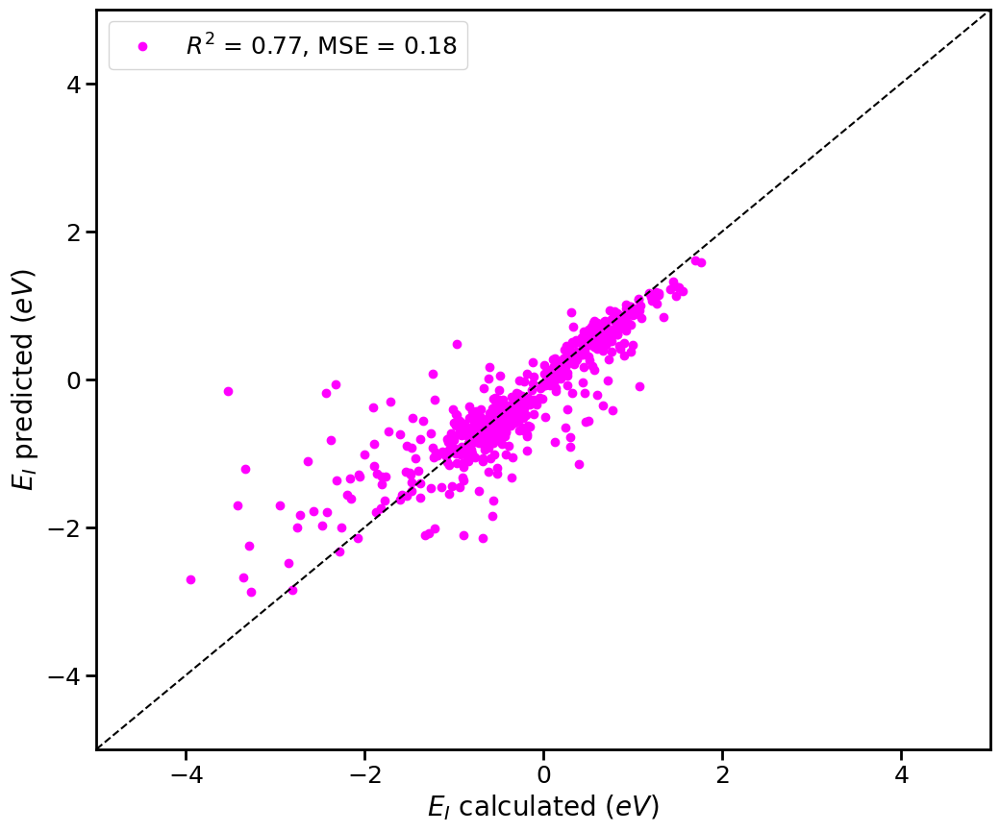

In [12]:
bestmodel = CBRegressor()

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.3, random_state=42)
kfold = KFold(n_splits = 5, shuffle = True, random_state = 42 )
### Cross validation scores
cv = RepeatedKFold(n_splits = 5, n_repeats = 3, random_state = 42)
scores = cross_val_score(bestmodel, X_train, y_train, cv = cv)
r2_mean = scores.mean()
print("%0.4f accuracy with a standard deviation of %0.4f" % (r2_mean, scores.std()))

### Cross validation predictions
yhat_bestmodel = cross_val_predict(bestmodel, X_train, y_train, cv = kfold)
Mean_sqr_error = metrics.mean_squared_error(y_train, yhat_bestmodel)
f, ax = plt.subplots(figsize=(12, 10))

# Increase axis font size
ax.tick_params(axis='both', labelsize=18)

# Increase axis linewidth
ax.spines['top'].set_linewidth(2)
ax.spines['bottom'].set_linewidth(2)
ax.spines['left'].set_linewidth(2)
ax.spines['right'].set_linewidth(2)

# Increase tick mark thickness and length
ax.tick_params(which='both', width=2, length=8)

label_mlr = "$R^2$ = %.2f, MSE = %.2f" % (r2_mean, Mean_sqr_error)
plt.plot(y_train, yhat_bestmodel, 'o', label=label_mlr, color = "magenta")
plt.ylabel(r"$E_{I}$ predicted ($eV$)", fontsize=20)
plt.xlabel(r"$E_{I}$ calculated ($eV$)", fontsize=20)
plt.legend(fontsize=18)
plt.xlim([-5, 5])
plt.ylim([-5, 5])
plt.plot([-5, 5], [-5, 5], 'k--')
plt.show()

#f.savefig("Results_Code_4/ParityPlot", dpi = 300, transparent = False, facecolor = 'white')

## Sensitivity Analysis

Learning rate set to 0.037808
0:	learn: 0.8996712	total: 690us	remaining: 690ms
1:	learn: 0.8831657	total: 1.35ms	remaining: 673ms
2:	learn: 0.8690840	total: 2ms	remaining: 665ms
3:	learn: 0.8538487	total: 2.65ms	remaining: 659ms
4:	learn: 0.8406915	total: 3.23ms	remaining: 643ms
5:	learn: 0.8285985	total: 3.92ms	remaining: 650ms
6:	learn: 0.8144439	total: 4.57ms	remaining: 648ms
7:	learn: 0.8032212	total: 5.24ms	remaining: 650ms
8:	learn: 0.7910442	total: 6.01ms	remaining: 661ms
9:	learn: 0.7795569	total: 6.79ms	remaining: 672ms
10:	learn: 0.7698902	total: 7.42ms	remaining: 668ms
11:	learn: 0.7584560	total: 8.05ms	remaining: 663ms
12:	learn: 0.7497439	total: 8.71ms	remaining: 662ms
13:	learn: 0.7407022	total: 9.06ms	remaining: 638ms
14:	learn: 0.7325795	total: 9.75ms	remaining: 641ms
15:	learn: 0.7241370	total: 10.6ms	remaining: 649ms
16:	learn: 0.7150374	total: 11.2ms	remaining: 649ms
17:	learn: 0.7080598	total: 11.9ms	remaining: 647ms
18:	learn: 0.7005155	total: 12.5ms	remaining: 64

273:	learn: 0.2948229	total: 164ms	remaining: 434ms
274:	learn: 0.2945704	total: 165ms	remaining: 434ms
275:	learn: 0.2941837	total: 165ms	remaining: 433ms
276:	learn: 0.2938919	total: 166ms	remaining: 432ms
277:	learn: 0.2934498	total: 166ms	remaining: 432ms
278:	learn: 0.2931289	total: 167ms	remaining: 431ms
279:	learn: 0.2922841	total: 167ms	remaining: 430ms
280:	learn: 0.2916286	total: 168ms	remaining: 430ms
281:	learn: 0.2913644	total: 169ms	remaining: 429ms
282:	learn: 0.2910144	total: 169ms	remaining: 429ms
283:	learn: 0.2903647	total: 170ms	remaining: 428ms
284:	learn: 0.2899912	total: 170ms	remaining: 427ms
285:	learn: 0.2894323	total: 171ms	remaining: 427ms
286:	learn: 0.2886700	total: 172ms	remaining: 426ms
287:	learn: 0.2885144	total: 172ms	remaining: 425ms
288:	learn: 0.2882936	total: 173ms	remaining: 425ms
289:	learn: 0.2878131	total: 173ms	remaining: 424ms
290:	learn: 0.2871086	total: 174ms	remaining: 424ms
291:	learn: 0.2864688	total: 174ms	remaining: 423ms
292:	learn: 

565:	learn: 0.1923805	total: 343ms	remaining: 263ms
566:	learn: 0.1921810	total: 344ms	remaining: 263ms
567:	learn: 0.1921357	total: 344ms	remaining: 262ms
568:	learn: 0.1917796	total: 345ms	remaining: 261ms
569:	learn: 0.1916642	total: 346ms	remaining: 261ms
570:	learn: 0.1910922	total: 346ms	remaining: 260ms
571:	learn: 0.1909011	total: 347ms	remaining: 259ms
572:	learn: 0.1905473	total: 347ms	remaining: 259ms
573:	learn: 0.1901135	total: 348ms	remaining: 258ms
574:	learn: 0.1898027	total: 349ms	remaining: 258ms
575:	learn: 0.1896853	total: 349ms	remaining: 257ms
576:	learn: 0.1895038	total: 350ms	remaining: 256ms
577:	learn: 0.1893188	total: 350ms	remaining: 256ms
578:	learn: 0.1892158	total: 351ms	remaining: 255ms
579:	learn: 0.1889780	total: 351ms	remaining: 254ms
580:	learn: 0.1887897	total: 352ms	remaining: 254ms
581:	learn: 0.1886594	total: 353ms	remaining: 253ms
582:	learn: 0.1883445	total: 353ms	remaining: 253ms
583:	learn: 0.1879535	total: 354ms	remaining: 252ms
584:	learn: 

821:	learn: 0.1465880	total: 494ms	remaining: 107ms
822:	learn: 0.1464348	total: 495ms	remaining: 106ms
823:	learn: 0.1463784	total: 496ms	remaining: 106ms
824:	learn: 0.1461643	total: 497ms	remaining: 105ms
825:	learn: 0.1459116	total: 498ms	remaining: 105ms
826:	learn: 0.1458004	total: 499ms	remaining: 104ms
827:	learn: 0.1457189	total: 500ms	remaining: 104ms
828:	learn: 0.1455180	total: 501ms	remaining: 103ms
829:	learn: 0.1453907	total: 502ms	remaining: 103ms
830:	learn: 0.1451555	total: 502ms	remaining: 102ms
831:	learn: 0.1451434	total: 503ms	remaining: 102ms
832:	learn: 0.1449729	total: 504ms	remaining: 101ms
833:	learn: 0.1447792	total: 505ms	remaining: 101ms
834:	learn: 0.1447276	total: 506ms	remaining: 100ms
835:	learn: 0.1444358	total: 507ms	remaining: 99.4ms
836:	learn: 0.1442266	total: 507ms	remaining: 98.8ms
837:	learn: 0.1441150	total: 508ms	remaining: 98.2ms
838:	learn: 0.1440238	total: 509ms	remaining: 97.7ms
839:	learn: 0.1439596	total: 510ms	remaining: 97.1ms
840:	le

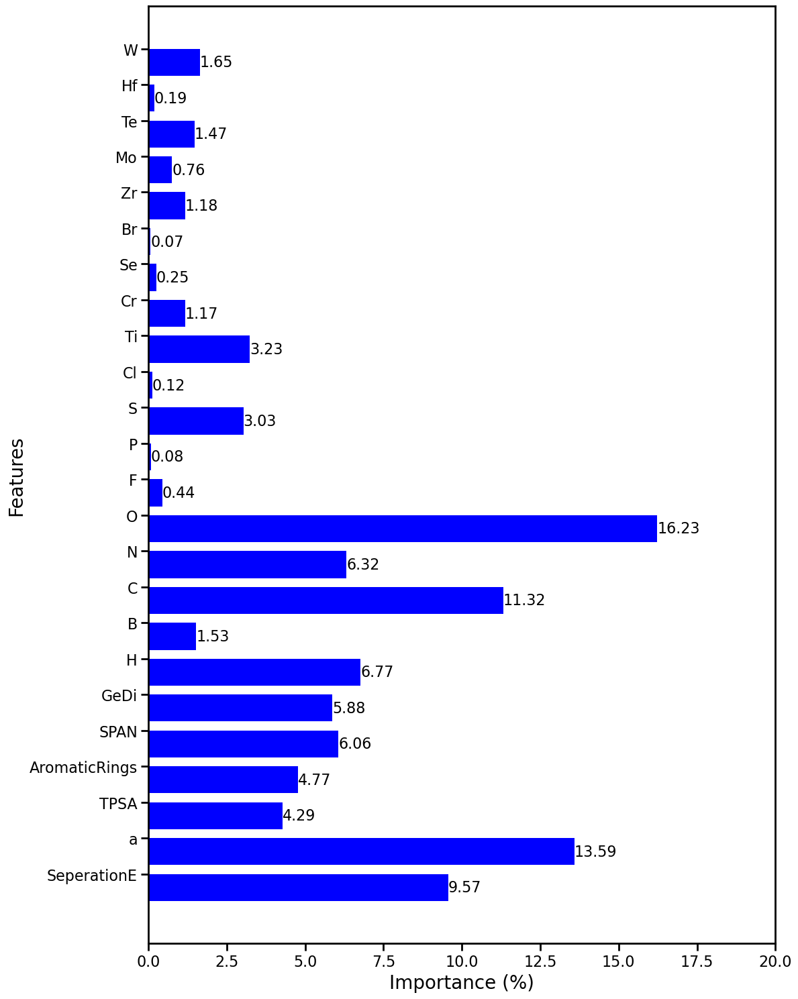

In [13]:
bestmodel.fit(X_train, y_train)
bestmodel_feature_importance = pd.DataFrame()
bestmodel_feature_importance['Feature'] = pd.DataFrame(X_test.columns)
bestmodel_feature_importance['Importance'] = pd.DataFrame(bestmodel.feature_importances_)
bestmodel_feature_importance = bestmodel_feature_importance[bestmodel_feature_importance.Importance > 0]

y = bestmodel_feature_importance.Importance
x = bestmodel_feature_importance.Feature

fig, ax = plt.subplots(figsize=(12,15)) 

# Increase axis font size
ax.tick_params(axis='both', labelsize=16)

# Increase axis linewidth
ax.spines['top'].set_linewidth(2)
ax.spines['bottom'].set_linewidth(2)
ax.spines['left'].set_linewidth(2)
ax.spines['right'].set_linewidth(2)

# Increase tick mark thickness and length
ax.tick_params(which='both', width=2, length=8)

width = 0.75 # the width of the bars 
ind = np.arange(len(y))  # the x locations for the groups
ax.barh(ind, y, width, color="blue")
ax.set_yticks(ind+width/2)
ax.set_yticklabels(x, minor=False)
#plt.title('Distribution of Feature Importance')
plt.xlabel('Importance (%)', fontsize=20)
plt.ylabel('Features', fontsize=20)
plt.xlim([0, 20])

# Print the values on the barchart
ax.bar_label(ax.containers[0],label_type='edge',fmt='%.2f', fontsize = 16)

plt.tight_layout()  # Ensures that the figure fits within the specified dimensions

plt.show()

#fig.savefig("Results_Code_4/FeatImp", dpi=300, bbox_inches='tight', transparent=False, facecolor='white')

# Part IV: Exploration-Exploitation

<a id="exp-exp"></a>

In [14]:
## We combined our 2D materials and gas molecules datasets 
## to make all possible hybrid material combinations. 
## And, calculated necessary features for these combinations in an auxiliary code. 


PredictionSet = pd.read_csv('PredictionSet_3')
PredictionSet = PredictionSet.astype({'CID' :'str'})
PredictionSet





,CID,Name,SeperationE,a,SMILES,TPSA,AromaticRings,H,He,Li,...,Bk,Cf,Es,Fm,Md,No,Lr,SPAN,GeDi,System
0,13,MoS2,1.766763,3.154333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1,0.045455,0,0,...,0,0,0,0,0,0,0,3.509434,6.313619,13_MoS2_0
1,13,MoSe2,2.056959,3.285000,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1,0.045455,0,0,...,0,0,0,0,0,0,0,3.456396,6.211905,13_MoSe2_0
2,13,MoTe2,2.636494,3.493333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1,0.045455,0,0,...,0,0,0,0,0,0,0,3.451183,6.228006,13_MoTe2_0
3,13,MoO2,1.202318,2.828333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1,0.045455,0,0,...,0,0,0,0,0,0,0,3.469165,6.245761,13_MoO2_0
4,13,WS2,1.865270,3.162333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1,0.045455,0,0,...,0,0,0,0,0,0,0,3.457050,6.216698,13_WS2_0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212473,13593933,CrTe2,2.477311,3.407000,CC=C=C=C,0.0,0,0.092308,0,0,...,0,0,0,0,0,0,0,3.297814,6.552722,13593933_CrTe2_0
212474,13593933,CrO2,0.823892,2.622667,CC=C=C=C,0.0,0,0.092308,0,0,...,0,0,0,0,0,0,0,3.302684,6.319375,13593933_CrO2_0
212475,13593933,ZrS2,1.895850,3.567333,CC=C=C=C,0.0,0,0.092308,0,0,...,0,0,0,0,0,0,0,3.291805,6.497326,13593933_ZrS2_0
212476,13593933,ZrSe2,2.158777,3.706333,CC=C=C=C,0.0,0,0.092308,0,0,...,0,0,0,0,0,0,0,3.280770,6.377696,13593933_ZrSe2_0


In [15]:
FullSet = pd.concat([PredictionSet, MergeWithPredictionSet.drop(['IC_ENERGY'], axis = 1)], axis = 0).drop_duplicates(subset='System')
FullSet

,CID,Name,SeperationE,a,SMILES,TPSA,AromaticRings,H,He,Li,...,Bk,Cf,Es,Fm,Md,No,Lr,SPAN,GeDi,System
0,13,MoS2,1.766763,3.154333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,0,...,0,0,0,0,0,0,0,3.509434,6.313619,13_MoS2_0
1,13,MoSe2,2.056959,3.285000,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,0,...,0,0,0,0,0,0,0,3.456396,6.211905,13_MoSe2_0
2,13,MoTe2,2.636494,3.493333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,0,...,0,0,0,0,0,0,0,3.451183,6.228006,13_MoTe2_0
3,13,MoO2,1.202318,2.828333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,0,...,0,0,0,0,0,0,0,3.469165,6.245761,13_MoO2_0
4,13,WS2,1.865270,3.162333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,0,...,0,0,0,0,0,0,0,3.457050,6.216698,13_WS2_0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212473,13593933,CrTe2,2.477311,3.407000,CC=C=C=C,0.0,0.0,0.092308,0,0,...,0,0,0,0,0,0,0,3.297814,6.552722,13593933_CrTe2_0
212474,13593933,CrO2,0.823892,2.622667,CC=C=C=C,0.0,0.0,0.092308,0,0,...,0,0,0,0,0,0,0,3.302684,6.319375,13593933_CrO2_0
212475,13593933,ZrS2,1.895850,3.567333,CC=C=C=C,0.0,0.0,0.092308,0,0,...,0,0,0,0,0,0,0,3.291805,6.497326,13593933_ZrS2_0
212476,13593933,ZrSe2,2.158777,3.706333,CC=C=C=C,0.0,0.0,0.092308,0,0,...,0,0,0,0,0,0,0,3.280770,6.377696,13593933_ZrSe2_0


## Bootstrap begins here

In [16]:
n_bs = 200
train_r2 = []
test_r2 = []
pred_r2 = []
remove_from_features = ['Name', 'SMILES', 'CID', 'System']
features = [c for c in FullSet.columns if c not in remove_from_features]
X_pred = FullSet[features]

fullset_bootstrapped_yhats = pd.DataFrame()

for i in range(n_bs):
    # Making n_bs bootstrapped samples
    train = resample(FinalSet, replace=True, n_samples=len(FinalSet), random_state=i)
    test = FinalSet[~FinalSet.index.isin(train.index)]
    
    # Split bootstrapped samples into train and test sets
    X_train = train[features]
    y_train = train["IC_ENERGY"]
    X_test = test[features]
    y_test = test["IC_ENERGY"]
    
    # Fit model on train sets
    bestmodel.fit(X_train, y_train)
    
    # Model scores
    r2_train = bestmodel.score(X_train, y_train)
    r2_test = bestmodel.score(X_test, y_test)
    train_r2.append(r2_train)
    test_r2.append(r2_test)
    
    # Predict on PredictionSet
    
    y_hat = bestmodel.predict(X_pred)
    
    #temp_df = pd.DataFrame(y_hat, columns=[])
    fullset_bootstrapped_yhats['y_pred_bs_{}'.format(i)] = y_hat
    fullset_bootstrapped_yhats = fullset_bootstrapped_yhats.copy()
    #bootstrapped_yhats[i] = pd.DataFrame(y_hat)



Learning rate set to 0.040001
0:	learn: 0.8879221	total: 801us	remaining: 800ms
1:	learn: 0.8699370	total: 1.5ms	remaining: 750ms
2:	learn: 0.8528577	total: 2.29ms	remaining: 761ms
3:	learn: 0.8368059	total: 3.05ms	remaining: 760ms
4:	learn: 0.8212269	total: 3.79ms	remaining: 754ms
5:	learn: 0.8050103	total: 4.54ms	remaining: 753ms
6:	learn: 0.7918582	total: 5.33ms	remaining: 756ms
7:	learn: 0.7774685	total: 6.09ms	remaining: 755ms
8:	learn: 0.7643782	total: 6.78ms	remaining: 746ms
9:	learn: 0.7498811	total: 7.49ms	remaining: 742ms
10:	learn: 0.7385775	total: 8.25ms	remaining: 742ms
11:	learn: 0.7275494	total: 9.13ms	remaining: 752ms
12:	learn: 0.7165706	total: 9.85ms	remaining: 748ms
13:	learn: 0.7064563	total: 10.6ms	remaining: 749ms
14:	learn: 0.6947860	total: 11.4ms	remaining: 750ms
15:	learn: 0.6845722	total: 12.2ms	remaining: 752ms
16:	learn: 0.6753169	total: 13.2ms	remaining: 761ms
17:	learn: 0.6659724	total: 14ms	remaining: 766ms
18:	learn: 0.6577777	total: 14.8ms	remaining: 76

303:	learn: 0.2218240	total: 179ms	remaining: 410ms
304:	learn: 0.2213764	total: 180ms	remaining: 409ms
305:	learn: 0.2206763	total: 180ms	remaining: 409ms
306:	learn: 0.2201758	total: 181ms	remaining: 409ms
307:	learn: 0.2196739	total: 182ms	remaining: 408ms
308:	learn: 0.2195518	total: 183ms	remaining: 408ms
309:	learn: 0.2188574	total: 183ms	remaining: 408ms
310:	learn: 0.2183108	total: 184ms	remaining: 408ms
311:	learn: 0.2178227	total: 185ms	remaining: 407ms
312:	learn: 0.2174825	total: 185ms	remaining: 407ms
313:	learn: 0.2167973	total: 186ms	remaining: 407ms
314:	learn: 0.2162709	total: 187ms	remaining: 406ms
315:	learn: 0.2155644	total: 188ms	remaining: 406ms
316:	learn: 0.2141519	total: 188ms	remaining: 406ms
317:	learn: 0.2139607	total: 189ms	remaining: 405ms
318:	learn: 0.2127336	total: 189ms	remaining: 404ms
319:	learn: 0.2123234	total: 190ms	remaining: 404ms
320:	learn: 0.2110444	total: 191ms	remaining: 404ms
321:	learn: 0.2105870	total: 191ms	remaining: 403ms
322:	learn: 

555:	learn: 0.1476671	total: 344ms	remaining: 274ms
556:	learn: 0.1474831	total: 344ms	remaining: 274ms
557:	learn: 0.1473522	total: 345ms	remaining: 273ms
558:	learn: 0.1472831	total: 345ms	remaining: 272ms
559:	learn: 0.1471111	total: 346ms	remaining: 272ms
560:	learn: 0.1469600	total: 346ms	remaining: 271ms
561:	learn: 0.1467734	total: 347ms	remaining: 270ms
562:	learn: 0.1464720	total: 348ms	remaining: 270ms
563:	learn: 0.1460196	total: 348ms	remaining: 269ms
564:	learn: 0.1457985	total: 349ms	remaining: 268ms
565:	learn: 0.1457646	total: 349ms	remaining: 268ms
566:	learn: 0.1454837	total: 350ms	remaining: 267ms
567:	learn: 0.1453510	total: 350ms	remaining: 266ms
568:	learn: 0.1451040	total: 351ms	remaining: 266ms
569:	learn: 0.1448467	total: 351ms	remaining: 265ms
570:	learn: 0.1444949	total: 352ms	remaining: 264ms
571:	learn: 0.1443971	total: 353ms	remaining: 264ms
572:	learn: 0.1440512	total: 353ms	remaining: 263ms
573:	learn: 0.1437778	total: 354ms	remaining: 262ms
574:	learn: 

893:	learn: 0.1046503	total: 526ms	remaining: 62.3ms
894:	learn: 0.1046444	total: 526ms	remaining: 61.7ms
895:	learn: 0.1046366	total: 527ms	remaining: 61.1ms
896:	learn: 0.1045439	total: 527ms	remaining: 60.5ms
897:	learn: 0.1043805	total: 528ms	remaining: 60ms
898:	learn: 0.1043236	total: 528ms	remaining: 59.4ms
899:	learn: 0.1042370	total: 529ms	remaining: 58.8ms
900:	learn: 0.1041655	total: 530ms	remaining: 58.2ms
901:	learn: 0.1041254	total: 530ms	remaining: 57.6ms
902:	learn: 0.1040489	total: 531ms	remaining: 57ms
903:	learn: 0.1039180	total: 531ms	remaining: 56.4ms
904:	learn: 0.1037909	total: 532ms	remaining: 55.8ms
905:	learn: 0.1037594	total: 532ms	remaining: 55.2ms
906:	learn: 0.1034253	total: 533ms	remaining: 54.6ms
907:	learn: 0.1032531	total: 534ms	remaining: 54.1ms
908:	learn: 0.1031589	total: 534ms	remaining: 53.5ms
909:	learn: 0.1031041	total: 535ms	remaining: 52.9ms
910:	learn: 0.1029971	total: 535ms	remaining: 52.3ms
911:	learn: 0.1029157	total: 536ms	remaining: 51.7

323:	learn: 0.2388472	total: 191ms	remaining: 398ms
324:	learn: 0.2384709	total: 192ms	remaining: 399ms
325:	learn: 0.2375957	total: 193ms	remaining: 399ms
326:	learn: 0.2366667	total: 194ms	remaining: 399ms
327:	learn: 0.2359577	total: 195ms	remaining: 399ms
328:	learn: 0.2352959	total: 195ms	remaining: 398ms
329:	learn: 0.2347467	total: 196ms	remaining: 398ms
330:	learn: 0.2345494	total: 197ms	remaining: 398ms
331:	learn: 0.2342919	total: 198ms	remaining: 397ms
332:	learn: 0.2337711	total: 198ms	remaining: 397ms
333:	learn: 0.2329843	total: 199ms	remaining: 396ms
334:	learn: 0.2321799	total: 199ms	remaining: 396ms
335:	learn: 0.2319982	total: 200ms	remaining: 395ms
336:	learn: 0.2316498	total: 201ms	remaining: 395ms
337:	learn: 0.2309621	total: 201ms	remaining: 394ms
338:	learn: 0.2301189	total: 202ms	remaining: 394ms
339:	learn: 0.2296523	total: 203ms	remaining: 393ms
340:	learn: 0.2289760	total: 203ms	remaining: 393ms
341:	learn: 0.2285845	total: 204ms	remaining: 392ms
342:	learn: 

622:	learn: 0.1460581	total: 356ms	remaining: 215ms
623:	learn: 0.1459059	total: 357ms	remaining: 215ms
624:	learn: 0.1457130	total: 357ms	remaining: 214ms
625:	learn: 0.1455634	total: 358ms	remaining: 214ms
626:	learn: 0.1454772	total: 358ms	remaining: 213ms
627:	learn: 0.1453180	total: 359ms	remaining: 213ms
628:	learn: 0.1449283	total: 359ms	remaining: 212ms
629:	learn: 0.1446734	total: 360ms	remaining: 211ms
630:	learn: 0.1446582	total: 360ms	remaining: 211ms
631:	learn: 0.1443746	total: 361ms	remaining: 210ms
632:	learn: 0.1442267	total: 362ms	remaining: 210ms
633:	learn: 0.1440502	total: 362ms	remaining: 209ms
634:	learn: 0.1439318	total: 363ms	remaining: 208ms
635:	learn: 0.1435333	total: 363ms	remaining: 208ms
636:	learn: 0.1432159	total: 364ms	remaining: 207ms
637:	learn: 0.1430341	total: 364ms	remaining: 207ms
638:	learn: 0.1428863	total: 365ms	remaining: 206ms
639:	learn: 0.1426928	total: 366ms	remaining: 206ms
640:	learn: 0.1423285	total: 366ms	remaining: 205ms
641:	learn: 

953:	learn: 0.1004967	total: 539ms	remaining: 26ms
954:	learn: 0.1004270	total: 540ms	remaining: 25.4ms
955:	learn: 0.1003874	total: 540ms	remaining: 24.9ms
956:	learn: 0.1003630	total: 541ms	remaining: 24.3ms
957:	learn: 0.1002859	total: 541ms	remaining: 23.7ms
958:	learn: 0.1002278	total: 542ms	remaining: 23.2ms
959:	learn: 0.1002014	total: 542ms	remaining: 22.6ms
960:	learn: 0.1000703	total: 543ms	remaining: 22ms
961:	learn: 0.0999989	total: 544ms	remaining: 21.5ms
962:	learn: 0.0997614	total: 544ms	remaining: 20.9ms
963:	learn: 0.0997209	total: 545ms	remaining: 20.3ms
964:	learn: 0.0995706	total: 545ms	remaining: 19.8ms
965:	learn: 0.0995673	total: 546ms	remaining: 19.2ms
966:	learn: 0.0993523	total: 546ms	remaining: 18.6ms
967:	learn: 0.0992322	total: 547ms	remaining: 18.1ms
968:	learn: 0.0991739	total: 548ms	remaining: 17.5ms
969:	learn: 0.0990754	total: 548ms	remaining: 17ms
970:	learn: 0.0989199	total: 549ms	remaining: 16.4ms
971:	learn: 0.0988325	total: 549ms	remaining: 15.8ms

121:	learn: 0.3571597	total: 82.7ms	remaining: 595ms
122:	learn: 0.3564512	total: 83.6ms	remaining: 596ms
123:	learn: 0.3551503	total: 84.3ms	remaining: 595ms
124:	learn: 0.3546723	total: 84.8ms	remaining: 594ms
125:	learn: 0.3536788	total: 85.5ms	remaining: 593ms
126:	learn: 0.3529880	total: 86.1ms	remaining: 592ms
127:	learn: 0.3522036	total: 86.8ms	remaining: 592ms
128:	learn: 0.3517622	total: 87.4ms	remaining: 590ms
129:	learn: 0.3511144	total: 88ms	remaining: 589ms
130:	learn: 0.3496542	total: 88.9ms	remaining: 590ms
131:	learn: 0.3487078	total: 89.4ms	remaining: 588ms
132:	learn: 0.3475716	total: 89.9ms	remaining: 586ms
133:	learn: 0.3463921	total: 90.5ms	remaining: 585ms
134:	learn: 0.3449135	total: 91.2ms	remaining: 584ms
135:	learn: 0.3431048	total: 91.9ms	remaining: 584ms
136:	learn: 0.3416979	total: 92.4ms	remaining: 582ms
137:	learn: 0.3409122	total: 93ms	remaining: 581ms
138:	learn: 0.3395736	total: 93.5ms	remaining: 579ms
139:	learn: 0.3389868	total: 94.1ms	remaining: 578

424:	learn: 0.1710303	total: 262ms	remaining: 355ms
425:	learn: 0.1706634	total: 263ms	remaining: 354ms
426:	learn: 0.1704526	total: 264ms	remaining: 354ms
427:	learn: 0.1703226	total: 264ms	remaining: 353ms
428:	learn: 0.1700741	total: 265ms	remaining: 352ms
429:	learn: 0.1698393	total: 265ms	remaining: 352ms
430:	learn: 0.1697798	total: 266ms	remaining: 351ms
431:	learn: 0.1694560	total: 266ms	remaining: 350ms
432:	learn: 0.1693225	total: 267ms	remaining: 350ms
433:	learn: 0.1690825	total: 268ms	remaining: 349ms
434:	learn: 0.1689632	total: 268ms	remaining: 348ms
435:	learn: 0.1687952	total: 269ms	remaining: 348ms
436:	learn: 0.1686198	total: 269ms	remaining: 347ms
437:	learn: 0.1684794	total: 270ms	remaining: 346ms
438:	learn: 0.1683306	total: 271ms	remaining: 346ms
439:	learn: 0.1680930	total: 271ms	remaining: 345ms
440:	learn: 0.1679422	total: 272ms	remaining: 344ms
441:	learn: 0.1673719	total: 272ms	remaining: 344ms
442:	learn: 0.1672083	total: 273ms	remaining: 343ms
443:	learn: 

761:	learn: 0.1102906	total: 445ms	remaining: 139ms
762:	learn: 0.1101826	total: 446ms	remaining: 139ms
763:	learn: 0.1099746	total: 447ms	remaining: 138ms
764:	learn: 0.1098198	total: 447ms	remaining: 137ms
765:	learn: 0.1097126	total: 448ms	remaining: 137ms
766:	learn: 0.1095660	total: 449ms	remaining: 136ms
767:	learn: 0.1093692	total: 449ms	remaining: 136ms
768:	learn: 0.1093238	total: 450ms	remaining: 135ms
769:	learn: 0.1092320	total: 450ms	remaining: 135ms
770:	learn: 0.1090183	total: 451ms	remaining: 134ms
771:	learn: 0.1088825	total: 452ms	remaining: 133ms
772:	learn: 0.1087311	total: 452ms	remaining: 133ms
773:	learn: 0.1085662	total: 453ms	remaining: 132ms
774:	learn: 0.1083607	total: 453ms	remaining: 132ms
775:	learn: 0.1082392	total: 454ms	remaining: 131ms
776:	learn: 0.1081720	total: 454ms	remaining: 130ms
777:	learn: 0.1081465	total: 455ms	remaining: 130ms
778:	learn: 0.1080899	total: 455ms	remaining: 129ms
779:	learn: 0.1078845	total: 456ms	remaining: 129ms
780:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8843215	total: 657us	remaining: 656ms
1:	learn: 0.8670334	total: 1.26ms	remaining: 631ms
2:	learn: 0.8498709	total: 1.84ms	remaining: 613ms
3:	learn: 0.8350927	total: 2.48ms	remaining: 618ms
4:	learn: 0.8188658	total: 3.11ms	remaining: 619ms
5:	learn: 0.8026038	total: 3.79ms	remaining: 629ms
6:	learn: 0.7883577	total: 4.41ms	remaining: 626ms
7:	learn: 0.7748579	total: 5.05ms	remaining: 626ms
8:	learn: 0.7613469	total: 5.77ms	remaining: 636ms
9:	learn: 0.7487424	total: 6.36ms	remaining: 630ms
10:	learn: 0.7374132	total: 6.93ms	remaining: 623ms
11:	learn: 0.7272031	total: 7.54ms	remaining: 621ms
12:	learn: 0.7165742	total: 8.14ms	remaining: 618ms
13:	learn: 0.7071661	total: 8.86ms	remaining: 624ms
14:	learn: 0.6977717	total: 9.51ms	remaining: 625ms
15:	learn: 0.6889093	total: 10.1ms	remaining: 623ms
16:	learn: 0.6802557	total: 10.8ms	remaining: 622ms
17:	learn: 0.6722322	total: 11.5ms	remaining: 627ms
18:	learn: 0.6648949	total: 12.2ms	remaining:

306:	learn: 0.2359415	total: 180ms	remaining: 406ms
307:	learn: 0.2355821	total: 180ms	remaining: 405ms
308:	learn: 0.2344950	total: 181ms	remaining: 405ms
309:	learn: 0.2344011	total: 182ms	remaining: 404ms
310:	learn: 0.2341414	total: 182ms	remaining: 404ms
311:	learn: 0.2337638	total: 183ms	remaining: 403ms
312:	learn: 0.2334002	total: 183ms	remaining: 402ms
313:	learn: 0.2328063	total: 184ms	remaining: 402ms
314:	learn: 0.2323433	total: 184ms	remaining: 401ms
315:	learn: 0.2317268	total: 185ms	remaining: 400ms
316:	learn: 0.2311461	total: 186ms	remaining: 400ms
317:	learn: 0.2310743	total: 186ms	remaining: 399ms
318:	learn: 0.2310266	total: 187ms	remaining: 398ms
319:	learn: 0.2306067	total: 187ms	remaining: 397ms
320:	learn: 0.2301050	total: 188ms	remaining: 397ms
321:	learn: 0.2296726	total: 188ms	remaining: 396ms
322:	learn: 0.2289355	total: 189ms	remaining: 396ms
323:	learn: 0.2288824	total: 189ms	remaining: 395ms
324:	learn: 0.2284139	total: 190ms	remaining: 394ms
325:	learn: 

648:	learn: 0.1454445	total: 362ms	remaining: 196ms
649:	learn: 0.1453649	total: 363ms	remaining: 195ms
650:	learn: 0.1451790	total: 363ms	remaining: 195ms
651:	learn: 0.1450162	total: 364ms	remaining: 194ms
652:	learn: 0.1447238	total: 364ms	remaining: 194ms
653:	learn: 0.1446280	total: 365ms	remaining: 193ms
654:	learn: 0.1444331	total: 365ms	remaining: 192ms
655:	learn: 0.1442140	total: 366ms	remaining: 192ms
656:	learn: 0.1439861	total: 366ms	remaining: 191ms
657:	learn: 0.1439280	total: 367ms	remaining: 191ms
658:	learn: 0.1436795	total: 368ms	remaining: 190ms
659:	learn: 0.1436395	total: 368ms	remaining: 190ms
660:	learn: 0.1434236	total: 369ms	remaining: 189ms
661:	learn: 0.1433366	total: 369ms	remaining: 189ms
662:	learn: 0.1432362	total: 370ms	remaining: 188ms
663:	learn: 0.1430546	total: 370ms	remaining: 187ms
664:	learn: 0.1428714	total: 371ms	remaining: 187ms
665:	learn: 0.1427843	total: 372ms	remaining: 186ms
666:	learn: 0.1425989	total: 372ms	remaining: 186ms
667:	learn: 

974:	learn: 0.1044717	total: 544ms	remaining: 14ms
975:	learn: 0.1043597	total: 545ms	remaining: 13.4ms
976:	learn: 0.1042279	total: 546ms	remaining: 12.8ms
977:	learn: 0.1041473	total: 546ms	remaining: 12.3ms
978:	learn: 0.1040667	total: 547ms	remaining: 11.7ms
979:	learn: 0.1040424	total: 548ms	remaining: 11.2ms
980:	learn: 0.1038811	total: 548ms	remaining: 10.6ms
981:	learn: 0.1038180	total: 549ms	remaining: 10.1ms
982:	learn: 0.1037078	total: 550ms	remaining: 9.51ms
983:	learn: 0.1035772	total: 550ms	remaining: 8.95ms
984:	learn: 0.1034520	total: 551ms	remaining: 8.39ms
985:	learn: 0.1033767	total: 551ms	remaining: 7.83ms
986:	learn: 0.1032265	total: 552ms	remaining: 7.27ms
987:	learn: 0.1030546	total: 553ms	remaining: 6.71ms
988:	learn: 0.1029567	total: 553ms	remaining: 6.15ms
989:	learn: 0.1027859	total: 554ms	remaining: 5.59ms
990:	learn: 0.1027203	total: 554ms	remaining: 5.03ms
991:	learn: 0.1026652	total: 555ms	remaining: 4.47ms
992:	learn: 0.1025725	total: 555ms	remaining: 3.

135:	learn: 0.2994829	total: 95ms	remaining: 604ms
136:	learn: 0.2982519	total: 95.8ms	remaining: 603ms
137:	learn: 0.2973571	total: 96.4ms	remaining: 602ms
138:	learn: 0.2962394	total: 97.2ms	remaining: 602ms
139:	learn: 0.2954825	total: 97.7ms	remaining: 600ms
140:	learn: 0.2946457	total: 98.2ms	remaining: 599ms
141:	learn: 0.2929200	total: 98.8ms	remaining: 597ms
142:	learn: 0.2918990	total: 99.3ms	remaining: 595ms
143:	learn: 0.2910437	total: 99.8ms	remaining: 593ms
144:	learn: 0.2896270	total: 100ms	remaining: 592ms
145:	learn: 0.2884760	total: 101ms	remaining: 590ms
146:	learn: 0.2879256	total: 101ms	remaining: 588ms
147:	learn: 0.2870663	total: 102ms	remaining: 587ms
148:	learn: 0.2861376	total: 102ms	remaining: 585ms
149:	learn: 0.2850451	total: 103ms	remaining: 584ms
150:	learn: 0.2836114	total: 104ms	remaining: 582ms
151:	learn: 0.2826858	total: 104ms	remaining: 580ms
152:	learn: 0.2818238	total: 105ms	remaining: 579ms
153:	learn: 0.2806116	total: 105ms	remaining: 577ms
154:	

466:	learn: 0.1490049	total: 276ms	remaining: 315ms
467:	learn: 0.1488600	total: 277ms	remaining: 315ms
468:	learn: 0.1487664	total: 278ms	remaining: 314ms
469:	learn: 0.1485556	total: 278ms	remaining: 314ms
470:	learn: 0.1481590	total: 279ms	remaining: 313ms
471:	learn: 0.1478076	total: 279ms	remaining: 312ms
472:	learn: 0.1476532	total: 280ms	remaining: 312ms
473:	learn: 0.1475960	total: 280ms	remaining: 311ms
474:	learn: 0.1474333	total: 281ms	remaining: 310ms
475:	learn: 0.1472030	total: 281ms	remaining: 310ms
476:	learn: 0.1469705	total: 282ms	remaining: 309ms
477:	learn: 0.1467188	total: 283ms	remaining: 309ms
478:	learn: 0.1465458	total: 283ms	remaining: 308ms
479:	learn: 0.1462770	total: 284ms	remaining: 307ms
480:	learn: 0.1460864	total: 284ms	remaining: 307ms
481:	learn: 0.1459210	total: 285ms	remaining: 306ms
482:	learn: 0.1455967	total: 285ms	remaining: 306ms
483:	learn: 0.1454229	total: 286ms	remaining: 305ms
484:	learn: 0.1452530	total: 287ms	remaining: 304ms
485:	learn: 

805:	learn: 0.1046379	total: 459ms	remaining: 110ms
806:	learn: 0.1045688	total: 460ms	remaining: 110ms
807:	learn: 0.1044710	total: 460ms	remaining: 109ms
808:	learn: 0.1043787	total: 461ms	remaining: 109ms
809:	learn: 0.1043574	total: 461ms	remaining: 108ms
810:	learn: 0.1042455	total: 462ms	remaining: 108ms
811:	learn: 0.1041473	total: 463ms	remaining: 107ms
812:	learn: 0.1041284	total: 463ms	remaining: 107ms
813:	learn: 0.1039776	total: 464ms	remaining: 106ms
814:	learn: 0.1039489	total: 464ms	remaining: 105ms
815:	learn: 0.1039437	total: 465ms	remaining: 105ms
816:	learn: 0.1039023	total: 465ms	remaining: 104ms
817:	learn: 0.1037841	total: 466ms	remaining: 104ms
818:	learn: 0.1037763	total: 466ms	remaining: 103ms
819:	learn: 0.1036950	total: 467ms	remaining: 102ms
820:	learn: 0.1036905	total: 467ms	remaining: 102ms
821:	learn: 0.1036290	total: 468ms	remaining: 101ms
822:	learn: 0.1035651	total: 469ms	remaining: 101ms
823:	learn: 0.1034928	total: 469ms	remaining: 100ms
824:	learn: 

8:	learn: 0.7596310	total: 6.33ms	remaining: 697ms
9:	learn: 0.7450760	total: 7.14ms	remaining: 707ms
10:	learn: 0.7327771	total: 7.82ms	remaining: 703ms
11:	learn: 0.7214990	total: 8.45ms	remaining: 696ms
12:	learn: 0.7093997	total: 9.04ms	remaining: 687ms
13:	learn: 0.7003667	total: 9.53ms	remaining: 671ms
14:	learn: 0.6896736	total: 10.2ms	remaining: 667ms
15:	learn: 0.6802156	total: 10.8ms	remaining: 665ms
16:	learn: 0.6712636	total: 11.4ms	remaining: 659ms
17:	learn: 0.6621397	total: 11.8ms	remaining: 645ms
18:	learn: 0.6532071	total: 12.4ms	remaining: 641ms
19:	learn: 0.6449866	total: 13ms	remaining: 638ms
20:	learn: 0.6387016	total: 13.6ms	remaining: 633ms
21:	learn: 0.6332113	total: 14.1ms	remaining: 628ms
22:	learn: 0.6264989	total: 14.6ms	remaining: 620ms
23:	learn: 0.6197525	total: 15.2ms	remaining: 618ms
24:	learn: 0.6125581	total: 15.8ms	remaining: 616ms
25:	learn: 0.6048701	total: 16.3ms	remaining: 612ms
26:	learn: 0.5993556	total: 17.2ms	remaining: 621ms
27:	learn: 0.592

260:	learn: 0.2562598	total: 168ms	remaining: 475ms
261:	learn: 0.2558853	total: 169ms	remaining: 475ms
262:	learn: 0.2550224	total: 169ms	remaining: 474ms
263:	learn: 0.2545325	total: 170ms	remaining: 473ms
264:	learn: 0.2540283	total: 170ms	remaining: 472ms
265:	learn: 0.2535965	total: 171ms	remaining: 472ms
266:	learn: 0.2527267	total: 172ms	remaining: 471ms
267:	learn: 0.2519458	total: 172ms	remaining: 470ms
268:	learn: 0.2516132	total: 173ms	remaining: 469ms
269:	learn: 0.2507853	total: 173ms	remaining: 468ms
270:	learn: 0.2503763	total: 174ms	remaining: 467ms
271:	learn: 0.2499451	total: 174ms	remaining: 467ms
272:	learn: 0.2493598	total: 175ms	remaining: 466ms
273:	learn: 0.2489359	total: 175ms	remaining: 465ms
274:	learn: 0.2482867	total: 176ms	remaining: 464ms
275:	learn: 0.2480350	total: 176ms	remaining: 463ms
276:	learn: 0.2472532	total: 177ms	remaining: 462ms
277:	learn: 0.2463822	total: 178ms	remaining: 462ms
278:	learn: 0.2461185	total: 178ms	remaining: 461ms
279:	learn: 

600:	learn: 0.1391959	total: 350ms	remaining: 232ms
601:	learn: 0.1391728	total: 351ms	remaining: 232ms
602:	learn: 0.1389298	total: 351ms	remaining: 231ms
603:	learn: 0.1387314	total: 352ms	remaining: 231ms
604:	learn: 0.1384095	total: 352ms	remaining: 230ms
605:	learn: 0.1381240	total: 353ms	remaining: 229ms
606:	learn: 0.1380285	total: 353ms	remaining: 229ms
607:	learn: 0.1376212	total: 354ms	remaining: 228ms
608:	learn: 0.1375980	total: 354ms	remaining: 228ms
609:	learn: 0.1374393	total: 355ms	remaining: 227ms
610:	learn: 0.1371663	total: 356ms	remaining: 226ms
611:	learn: 0.1367713	total: 356ms	remaining: 226ms
612:	learn: 0.1366463	total: 357ms	remaining: 225ms
613:	learn: 0.1365146	total: 357ms	remaining: 225ms
614:	learn: 0.1362060	total: 358ms	remaining: 224ms
615:	learn: 0.1359826	total: 358ms	remaining: 223ms
616:	learn: 0.1358944	total: 359ms	remaining: 223ms
617:	learn: 0.1358784	total: 359ms	remaining: 222ms
618:	learn: 0.1357458	total: 360ms	remaining: 222ms
619:	learn: 

945:	learn: 0.0919040	total: 532ms	remaining: 30.4ms
946:	learn: 0.0917505	total: 533ms	remaining: 29.8ms
947:	learn: 0.0917391	total: 534ms	remaining: 29.3ms
948:	learn: 0.0915945	total: 534ms	remaining: 28.7ms
949:	learn: 0.0914686	total: 535ms	remaining: 28.2ms
950:	learn: 0.0913376	total: 535ms	remaining: 27.6ms
951:	learn: 0.0912507	total: 536ms	remaining: 27ms
952:	learn: 0.0911497	total: 537ms	remaining: 26.5ms
953:	learn: 0.0910623	total: 537ms	remaining: 25.9ms
954:	learn: 0.0909632	total: 538ms	remaining: 25.3ms
955:	learn: 0.0908555	total: 538ms	remaining: 24.8ms
956:	learn: 0.0907114	total: 539ms	remaining: 24.2ms
957:	learn: 0.0905865	total: 539ms	remaining: 23.6ms
958:	learn: 0.0905264	total: 540ms	remaining: 23.1ms
959:	learn: 0.0903453	total: 540ms	remaining: 22.5ms
960:	learn: 0.0902270	total: 541ms	remaining: 22ms
961:	learn: 0.0901221	total: 542ms	remaining: 21.4ms
962:	learn: 0.0900414	total: 542ms	remaining: 20.8ms
963:	learn: 0.0899585	total: 543ms	remaining: 20.3

103:	learn: 0.3583258	total: 67.2ms	remaining: 579ms
104:	learn: 0.3574698	total: 67.9ms	remaining: 579ms
105:	learn: 0.3555731	total: 68.5ms	remaining: 578ms
106:	learn: 0.3537422	total: 69.1ms	remaining: 577ms
107:	learn: 0.3525529	total: 69.6ms	remaining: 575ms
108:	learn: 0.3510895	total: 70.2ms	remaining: 574ms
109:	learn: 0.3492834	total: 70.7ms	remaining: 572ms
110:	learn: 0.3482151	total: 71.3ms	remaining: 571ms
111:	learn: 0.3468874	total: 71.9ms	remaining: 570ms
112:	learn: 0.3453049	total: 72.4ms	remaining: 568ms
113:	learn: 0.3443928	total: 73ms	remaining: 567ms
114:	learn: 0.3423551	total: 73.6ms	remaining: 566ms
115:	learn: 0.3405464	total: 74.1ms	remaining: 565ms
116:	learn: 0.3396789	total: 74.7ms	remaining: 563ms
117:	learn: 0.3385050	total: 75.2ms	remaining: 562ms
118:	learn: 0.3369451	total: 75.9ms	remaining: 562ms
119:	learn: 0.3349315	total: 76.4ms	remaining: 560ms
120:	learn: 0.3331377	total: 77ms	remaining: 559ms
121:	learn: 0.3325775	total: 77.5ms	remaining: 558

436:	learn: 0.1570799	total: 248ms	remaining: 320ms
437:	learn: 0.1565880	total: 249ms	remaining: 320ms
438:	learn: 0.1563669	total: 250ms	remaining: 319ms
439:	learn: 0.1558863	total: 250ms	remaining: 319ms
440:	learn: 0.1553882	total: 251ms	remaining: 318ms
441:	learn: 0.1550901	total: 252ms	remaining: 318ms
442:	learn: 0.1549269	total: 252ms	remaining: 317ms
443:	learn: 0.1546317	total: 253ms	remaining: 316ms
444:	learn: 0.1545711	total: 253ms	remaining: 316ms
445:	learn: 0.1544864	total: 254ms	remaining: 315ms
446:	learn: 0.1539130	total: 254ms	remaining: 315ms
447:	learn: 0.1534249	total: 255ms	remaining: 314ms
448:	learn: 0.1533843	total: 256ms	remaining: 314ms
449:	learn: 0.1533007	total: 256ms	remaining: 313ms
450:	learn: 0.1530954	total: 257ms	remaining: 313ms
451:	learn: 0.1529274	total: 257ms	remaining: 312ms
452:	learn: 0.1527774	total: 258ms	remaining: 312ms
453:	learn: 0.1523726	total: 258ms	remaining: 311ms
454:	learn: 0.1522678	total: 259ms	remaining: 310ms
455:	learn: 

768:	learn: 0.1025041	total: 431ms	remaining: 129ms
769:	learn: 0.1023781	total: 432ms	remaining: 129ms
770:	learn: 0.1023162	total: 432ms	remaining: 128ms
771:	learn: 0.1021493	total: 433ms	remaining: 128ms
772:	learn: 0.1020941	total: 433ms	remaining: 127ms
773:	learn: 0.1019899	total: 434ms	remaining: 127ms
774:	learn: 0.1018530	total: 435ms	remaining: 126ms
775:	learn: 0.1016977	total: 435ms	remaining: 126ms
776:	learn: 0.1016535	total: 436ms	remaining: 125ms
777:	learn: 0.1015555	total: 436ms	remaining: 125ms
778:	learn: 0.1014564	total: 437ms	remaining: 124ms
779:	learn: 0.1013485	total: 438ms	remaining: 123ms
780:	learn: 0.1012435	total: 438ms	remaining: 123ms
781:	learn: 0.1012073	total: 439ms	remaining: 122ms
782:	learn: 0.1011489	total: 439ms	remaining: 122ms
783:	learn: 0.1010552	total: 440ms	remaining: 121ms
784:	learn: 0.1009867	total: 440ms	remaining: 121ms
785:	learn: 0.1007765	total: 441ms	remaining: 120ms
786:	learn: 0.1006552	total: 441ms	remaining: 119ms
787:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8684665	total: 776us	remaining: 775ms
1:	learn: 0.8517514	total: 1.76ms	remaining: 878ms
2:	learn: 0.8363347	total: 2.85ms	remaining: 948ms
3:	learn: 0.8203088	total: 3.59ms	remaining: 893ms
4:	learn: 0.8067049	total: 4.43ms	remaining: 881ms
5:	learn: 0.7919246	total: 5.21ms	remaining: 862ms
6:	learn: 0.7768103	total: 6.86ms	remaining: 973ms
7:	learn: 0.7638419	total: 7.88ms	remaining: 977ms
8:	learn: 0.7511324	total: 8.64ms	remaining: 951ms
9:	learn: 0.7386466	total: 9.7ms	remaining: 960ms
10:	learn: 0.7276559	total: 10.7ms	remaining: 960ms
11:	learn: 0.7169082	total: 11.7ms	remaining: 964ms
12:	learn: 0.7056364	total: 12.3ms	remaining: 934ms
13:	learn: 0.6967517	total: 13.2ms	remaining: 930ms
14:	learn: 0.6878600	total: 14.2ms	remaining: 933ms
15:	learn: 0.6785928	total: 15.1ms	remaining: 928ms
16:	learn: 0.6709558	total: 15.8ms	remaining: 916ms
17:	learn: 0.6637009	total: 16.7ms	remaining: 909ms
18:	learn: 0.6550791	total: 17.4ms	remaining: 

281:	learn: 0.2586853	total: 180ms	remaining: 457ms
282:	learn: 0.2576784	total: 180ms	remaining: 457ms
283:	learn: 0.2570678	total: 181ms	remaining: 456ms
284:	learn: 0.2562723	total: 182ms	remaining: 455ms
285:	learn: 0.2557251	total: 182ms	remaining: 455ms
286:	learn: 0.2550523	total: 183ms	remaining: 454ms
287:	learn: 0.2538888	total: 183ms	remaining: 453ms
288:	learn: 0.2531738	total: 184ms	remaining: 452ms
289:	learn: 0.2527691	total: 184ms	remaining: 452ms
290:	learn: 0.2516720	total: 185ms	remaining: 451ms
291:	learn: 0.2508644	total: 186ms	remaining: 450ms
292:	learn: 0.2502038	total: 186ms	remaining: 449ms
293:	learn: 0.2495623	total: 187ms	remaining: 448ms
294:	learn: 0.2490589	total: 187ms	remaining: 447ms
295:	learn: 0.2489070	total: 188ms	remaining: 447ms
296:	learn: 0.2484218	total: 188ms	remaining: 446ms
297:	learn: 0.2480157	total: 189ms	remaining: 445ms
298:	learn: 0.2474672	total: 190ms	remaining: 444ms
299:	learn: 0.2468058	total: 190ms	remaining: 444ms
300:	learn: 

611:	learn: 0.1546179	total: 361ms	remaining: 229ms
612:	learn: 0.1544889	total: 362ms	remaining: 228ms
613:	learn: 0.1543652	total: 362ms	remaining: 228ms
614:	learn: 0.1542775	total: 363ms	remaining: 227ms
615:	learn: 0.1539743	total: 363ms	remaining: 226ms
616:	learn: 0.1538271	total: 364ms	remaining: 226ms
617:	learn: 0.1537449	total: 364ms	remaining: 225ms
618:	learn: 0.1537327	total: 365ms	remaining: 225ms
619:	learn: 0.1535160	total: 365ms	remaining: 224ms
620:	learn: 0.1533893	total: 366ms	remaining: 223ms
621:	learn: 0.1533210	total: 367ms	remaining: 223ms
622:	learn: 0.1531744	total: 367ms	remaining: 222ms
623:	learn: 0.1530767	total: 368ms	remaining: 222ms
624:	learn: 0.1528315	total: 368ms	remaining: 221ms
625:	learn: 0.1527424	total: 369ms	remaining: 220ms
626:	learn: 0.1526564	total: 369ms	remaining: 220ms
627:	learn: 0.1524275	total: 370ms	remaining: 219ms
628:	learn: 0.1522508	total: 370ms	remaining: 218ms
629:	learn: 0.1521131	total: 371ms	remaining: 218ms
630:	learn: 

946:	learn: 0.1071142	total: 544ms	remaining: 30.4ms
947:	learn: 0.1070528	total: 544ms	remaining: 29.9ms
948:	learn: 0.1069627	total: 545ms	remaining: 29.3ms
949:	learn: 0.1069556	total: 545ms	remaining: 28.7ms
950:	learn: 0.1067672	total: 546ms	remaining: 28.1ms
951:	learn: 0.1066319	total: 547ms	remaining: 27.6ms
952:	learn: 0.1065406	total: 547ms	remaining: 27ms
953:	learn: 0.1065337	total: 548ms	remaining: 26.4ms
954:	learn: 0.1064306	total: 548ms	remaining: 25.8ms
955:	learn: 0.1063025	total: 549ms	remaining: 25.3ms
956:	learn: 0.1061754	total: 550ms	remaining: 24.7ms
957:	learn: 0.1059550	total: 550ms	remaining: 24.1ms
958:	learn: 0.1057308	total: 551ms	remaining: 23.6ms
959:	learn: 0.1055889	total: 552ms	remaining: 23ms
960:	learn: 0.1055754	total: 552ms	remaining: 22.4ms
961:	learn: 0.1055081	total: 553ms	remaining: 21.8ms
962:	learn: 0.1054621	total: 554ms	remaining: 21.3ms
963:	learn: 0.1054100	total: 554ms	remaining: 20.7ms
964:	learn: 0.1053525	total: 555ms	remaining: 20.1

421:	learn: 0.1751909	total: 235ms	remaining: 321ms
422:	learn: 0.1747849	total: 235ms	remaining: 321ms
423:	learn: 0.1745866	total: 236ms	remaining: 320ms
424:	learn: 0.1741007	total: 237ms	remaining: 320ms
425:	learn: 0.1736897	total: 237ms	remaining: 319ms
426:	learn: 0.1735120	total: 238ms	remaining: 319ms
427:	learn: 0.1732346	total: 238ms	remaining: 318ms
428:	learn: 0.1729030	total: 239ms	remaining: 318ms
429:	learn: 0.1726649	total: 239ms	remaining: 317ms
430:	learn: 0.1723423	total: 240ms	remaining: 317ms
431:	learn: 0.1721505	total: 240ms	remaining: 316ms
432:	learn: 0.1716598	total: 241ms	remaining: 316ms
433:	learn: 0.1714734	total: 242ms	remaining: 315ms
434:	learn: 0.1712839	total: 242ms	remaining: 314ms
435:	learn: 0.1708659	total: 243ms	remaining: 314ms
436:	learn: 0.1706450	total: 243ms	remaining: 313ms
437:	learn: 0.1703013	total: 244ms	remaining: 313ms
438:	learn: 0.1700768	total: 244ms	remaining: 312ms
439:	learn: 0.1696816	total: 245ms	remaining: 312ms
440:	learn: 

719:	learn: 0.1186379	total: 400ms	remaining: 156ms
720:	learn: 0.1184123	total: 401ms	remaining: 155ms
721:	learn: 0.1183079	total: 402ms	remaining: 155ms
722:	learn: 0.1180048	total: 402ms	remaining: 154ms
723:	learn: 0.1179634	total: 403ms	remaining: 153ms
724:	learn: 0.1178948	total: 403ms	remaining: 153ms
725:	learn: 0.1178029	total: 404ms	remaining: 152ms
726:	learn: 0.1175847	total: 404ms	remaining: 152ms
727:	learn: 0.1175139	total: 405ms	remaining: 151ms
728:	learn: 0.1174419	total: 406ms	remaining: 151ms
729:	learn: 0.1173325	total: 406ms	remaining: 150ms
730:	learn: 0.1172638	total: 407ms	remaining: 150ms
731:	learn: 0.1171676	total: 407ms	remaining: 149ms
732:	learn: 0.1169973	total: 408ms	remaining: 149ms
733:	learn: 0.1169515	total: 408ms	remaining: 148ms
734:	learn: 0.1168418	total: 409ms	remaining: 147ms
735:	learn: 0.1166268	total: 409ms	remaining: 147ms
736:	learn: 0.1164693	total: 410ms	remaining: 146ms
737:	learn: 0.1162415	total: 411ms	remaining: 146ms
738:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8635678	total: 1.1ms	remaining: 1.1s
1:	learn: 0.8467889	total: 2.13ms	remaining: 1.06s
2:	learn: 0.8312315	total: 2.91ms	remaining: 966ms
3:	learn: 0.8163750	total: 3.69ms	remaining: 920ms
4:	learn: 0.8017624	total: 4.58ms	remaining: 911ms
5:	learn: 0.7860504	total: 5.53ms	remaining: 916ms
6:	learn: 0.7737913	total: 6.57ms	remaining: 932ms
7:	learn: 0.7609746	total: 7.49ms	remaining: 929ms
8:	learn: 0.7482627	total: 8.33ms	remaining: 917ms
9:	learn: 0.7349798	total: 9.18ms	remaining: 909ms
10:	learn: 0.7244362	total: 10.4ms	remaining: 932ms
11:	learn: 0.7132248	total: 11.3ms	remaining: 928ms
12:	learn: 0.7028882	total: 12.1ms	remaining: 916ms
13:	learn: 0.6941962	total: 12.7ms	remaining: 894ms
14:	learn: 0.6833996	total: 13.2ms	remaining: 870ms
15:	learn: 0.6753173	total: 14.1ms	remaining: 870ms
16:	learn: 0.6672164	total: 15.2ms	remaining: 877ms
17:	learn: 0.6601251	total: 15.7ms	remaining: 855ms
18:	learn: 0.6518633	total: 16.6ms	remaining: 

201:	learn: 0.2884354	total: 142ms	remaining: 563ms
202:	learn: 0.2872872	total: 143ms	remaining: 562ms
203:	learn: 0.2866499	total: 144ms	remaining: 561ms
204:	learn: 0.2856994	total: 144ms	remaining: 560ms
205:	learn: 0.2852204	total: 145ms	remaining: 558ms
206:	learn: 0.2845907	total: 145ms	remaining: 557ms
207:	learn: 0.2839009	total: 146ms	remaining: 556ms
208:	learn: 0.2831804	total: 147ms	remaining: 554ms
209:	learn: 0.2826723	total: 147ms	remaining: 553ms
210:	learn: 0.2820229	total: 148ms	remaining: 552ms
211:	learn: 0.2812135	total: 148ms	remaining: 551ms
212:	learn: 0.2806778	total: 149ms	remaining: 549ms
213:	learn: 0.2802605	total: 149ms	remaining: 549ms
214:	learn: 0.2799019	total: 150ms	remaining: 547ms
215:	learn: 0.2784654	total: 150ms	remaining: 546ms
216:	learn: 0.2777237	total: 151ms	remaining: 545ms
217:	learn: 0.2771648	total: 152ms	remaining: 544ms
218:	learn: 0.2765837	total: 152ms	remaining: 543ms
219:	learn: 0.2756550	total: 153ms	remaining: 542ms
220:	learn: 

536:	learn: 0.1470330	total: 324ms	remaining: 280ms
537:	learn: 0.1467823	total: 325ms	remaining: 279ms
538:	learn: 0.1464232	total: 326ms	remaining: 279ms
539:	learn: 0.1460733	total: 326ms	remaining: 278ms
540:	learn: 0.1458185	total: 327ms	remaining: 277ms
541:	learn: 0.1456073	total: 327ms	remaining: 277ms
542:	learn: 0.1453232	total: 328ms	remaining: 276ms
543:	learn: 0.1451667	total: 329ms	remaining: 275ms
544:	learn: 0.1450011	total: 329ms	remaining: 275ms
545:	learn: 0.1449587	total: 330ms	remaining: 274ms
546:	learn: 0.1446129	total: 330ms	remaining: 273ms
547:	learn: 0.1445686	total: 331ms	remaining: 273ms
548:	learn: 0.1443924	total: 331ms	remaining: 272ms
549:	learn: 0.1442637	total: 332ms	remaining: 272ms
550:	learn: 0.1440737	total: 332ms	remaining: 271ms
551:	learn: 0.1437934	total: 333ms	remaining: 270ms
552:	learn: 0.1435915	total: 334ms	remaining: 270ms
553:	learn: 0.1434249	total: 334ms	remaining: 269ms
554:	learn: 0.1432393	total: 335ms	remaining: 269ms
555:	learn: 

857:	learn: 0.1012193	total: 507ms	remaining: 83.9ms
858:	learn: 0.1010771	total: 507ms	remaining: 83.3ms
859:	learn: 0.1008660	total: 508ms	remaining: 82.7ms
860:	learn: 0.1007680	total: 508ms	remaining: 82.1ms
861:	learn: 0.1006367	total: 509ms	remaining: 81.5ms
862:	learn: 0.1005632	total: 510ms	remaining: 80.9ms
863:	learn: 0.1005062	total: 510ms	remaining: 80.3ms
864:	learn: 0.1004938	total: 511ms	remaining: 79.7ms
865:	learn: 0.1003868	total: 511ms	remaining: 79.1ms
866:	learn: 0.1002676	total: 512ms	remaining: 78.5ms
867:	learn: 0.1002575	total: 512ms	remaining: 77.9ms
868:	learn: 0.1002245	total: 513ms	remaining: 77.3ms
869:	learn: 0.1001239	total: 513ms	remaining: 76.7ms
870:	learn: 0.0998852	total: 514ms	remaining: 76.1ms
871:	learn: 0.0997851	total: 515ms	remaining: 75.5ms
872:	learn: 0.0996540	total: 515ms	remaining: 74.9ms
873:	learn: 0.0996467	total: 516ms	remaining: 74.3ms
874:	learn: 0.0996176	total: 516ms	remaining: 73.8ms
875:	learn: 0.0994983	total: 517ms	remaining: 

13:	learn: 0.6433673	total: 13.4ms	remaining: 942ms
14:	learn: 0.6333117	total: 14.9ms	remaining: 979ms
15:	learn: 0.6235443	total: 16ms	remaining: 984ms
16:	learn: 0.6134309	total: 17ms	remaining: 983ms
17:	learn: 0.6052658	total: 18ms	remaining: 984ms
18:	learn: 0.5980625	total: 19.4ms	remaining: 1s
19:	learn: 0.5902142	total: 20.5ms	remaining: 1s
20:	learn: 0.5830974	total: 21.6ms	remaining: 1s
21:	learn: 0.5774436	total: 22.7ms	remaining: 1.01s
22:	learn: 0.5707327	total: 23.7ms	remaining: 1.01s
23:	learn: 0.5644392	total: 24.6ms	remaining: 1s
24:	learn: 0.5573732	total: 25.7ms	remaining: 1s
25:	learn: 0.5505091	total: 26.7ms	remaining: 1s
26:	learn: 0.5448227	total: 27.6ms	remaining: 994ms
27:	learn: 0.5387008	total: 28.5ms	remaining: 989ms
28:	learn: 0.5329715	total: 29.4ms	remaining: 985ms
29:	learn: 0.5262515	total: 30.3ms	remaining: 979ms
30:	learn: 0.5208751	total: 31.2ms	remaining: 976ms
31:	learn: 0.5159104	total: 32.1ms	remaining: 971ms
32:	learn: 0.5114998	total: 32.9ms	r

300:	learn: 0.2221857	total: 183ms	remaining: 424ms
301:	learn: 0.2217727	total: 184ms	remaining: 425ms
302:	learn: 0.2216349	total: 185ms	remaining: 425ms
303:	learn: 0.2208953	total: 185ms	remaining: 425ms
304:	learn: 0.2205205	total: 186ms	remaining: 424ms
305:	learn: 0.2203888	total: 187ms	remaining: 424ms
306:	learn: 0.2199882	total: 188ms	remaining: 424ms
307:	learn: 0.2197521	total: 189ms	remaining: 424ms
308:	learn: 0.2192322	total: 190ms	remaining: 424ms
309:	learn: 0.2190183	total: 190ms	remaining: 423ms
310:	learn: 0.2187572	total: 191ms	remaining: 423ms
311:	learn: 0.2181532	total: 191ms	remaining: 422ms
312:	learn: 0.2177939	total: 192ms	remaining: 422ms
313:	learn: 0.2172494	total: 193ms	remaining: 421ms
314:	learn: 0.2170974	total: 193ms	remaining: 420ms
315:	learn: 0.2167845	total: 194ms	remaining: 420ms
316:	learn: 0.2167404	total: 195ms	remaining: 419ms
317:	learn: 0.2165954	total: 195ms	remaining: 419ms
318:	learn: 0.2162019	total: 196ms	remaining: 418ms
319:	learn: 

623:	learn: 0.1446234	total: 366ms	remaining: 221ms
624:	learn: 0.1444822	total: 367ms	remaining: 220ms
625:	learn: 0.1442974	total: 367ms	remaining: 220ms
626:	learn: 0.1442096	total: 368ms	remaining: 219ms
627:	learn: 0.1441354	total: 369ms	remaining: 218ms
628:	learn: 0.1440531	total: 369ms	remaining: 218ms
629:	learn: 0.1438745	total: 370ms	remaining: 217ms
630:	learn: 0.1437266	total: 370ms	remaining: 217ms
631:	learn: 0.1436373	total: 371ms	remaining: 216ms
632:	learn: 0.1435569	total: 372ms	remaining: 215ms
633:	learn: 0.1434064	total: 372ms	remaining: 215ms
634:	learn: 0.1431462	total: 373ms	remaining: 214ms
635:	learn: 0.1431398	total: 374ms	remaining: 214ms
636:	learn: 0.1429895	total: 374ms	remaining: 213ms
637:	learn: 0.1427907	total: 375ms	remaining: 213ms
638:	learn: 0.1425967	total: 376ms	remaining: 212ms
639:	learn: 0.1424368	total: 376ms	remaining: 212ms
640:	learn: 0.1424033	total: 377ms	remaining: 211ms
641:	learn: 0.1422981	total: 377ms	remaining: 210ms
642:	learn: 

931:	learn: 0.1065360	total: 533ms	remaining: 38.9ms
932:	learn: 0.1064660	total: 533ms	remaining: 38.3ms
933:	learn: 0.1063655	total: 534ms	remaining: 37.7ms
934:	learn: 0.1063567	total: 535ms	remaining: 37.2ms
935:	learn: 0.1062606	total: 535ms	remaining: 36.6ms
936:	learn: 0.1062085	total: 536ms	remaining: 36ms
937:	learn: 0.1061619	total: 536ms	remaining: 35.4ms
938:	learn: 0.1060629	total: 537ms	remaining: 34.9ms
939:	learn: 0.1060178	total: 537ms	remaining: 34.3ms
940:	learn: 0.1058043	total: 538ms	remaining: 33.7ms
941:	learn: 0.1057275	total: 538ms	remaining: 33.2ms
942:	learn: 0.1056207	total: 539ms	remaining: 32.6ms
943:	learn: 0.1055661	total: 540ms	remaining: 32ms
944:	learn: 0.1054192	total: 540ms	remaining: 31.4ms
945:	learn: 0.1054112	total: 541ms	remaining: 30.9ms
946:	learn: 0.1053641	total: 541ms	remaining: 30.3ms
947:	learn: 0.1053202	total: 542ms	remaining: 29.7ms
948:	learn: 0.1053169	total: 542ms	remaining: 29.1ms
949:	learn: 0.1052485	total: 543ms	remaining: 28.6

91:	learn: 0.4032309	total: 56.8ms	remaining: 561ms
92:	learn: 0.4020131	total: 57.5ms	remaining: 561ms
93:	learn: 0.3999763	total: 58ms	remaining: 559ms
94:	learn: 0.3986688	total: 58.6ms	remaining: 559ms
95:	learn: 0.3965734	total: 59.2ms	remaining: 558ms
96:	learn: 0.3952289	total: 59.8ms	remaining: 556ms
97:	learn: 0.3934977	total: 60.4ms	remaining: 556ms
98:	learn: 0.3922024	total: 60.9ms	remaining: 554ms
99:	learn: 0.3907016	total: 61.5ms	remaining: 553ms
100:	learn: 0.3888882	total: 62ms	remaining: 552ms
101:	learn: 0.3887602	total: 62.3ms	remaining: 548ms
102:	learn: 0.3877052	total: 62.8ms	remaining: 547ms
103:	learn: 0.3859258	total: 63.4ms	remaining: 546ms
104:	learn: 0.3845384	total: 63.9ms	remaining: 545ms
105:	learn: 0.3819629	total: 64.5ms	remaining: 544ms
106:	learn: 0.3810042	total: 65.1ms	remaining: 543ms
107:	learn: 0.3789775	total: 65.7ms	remaining: 542ms
108:	learn: 0.3781316	total: 66.3ms	remaining: 542ms
109:	learn: 0.3768919	total: 66.9ms	remaining: 541ms
110:	l

417:	learn: 0.1812923	total: 238ms	remaining: 332ms
418:	learn: 0.1811149	total: 239ms	remaining: 332ms
419:	learn: 0.1806600	total: 240ms	remaining: 331ms
420:	learn: 0.1802302	total: 240ms	remaining: 331ms
421:	learn: 0.1802012	total: 241ms	remaining: 330ms
422:	learn: 0.1797895	total: 242ms	remaining: 329ms
423:	learn: 0.1794652	total: 242ms	remaining: 329ms
424:	learn: 0.1793436	total: 243ms	remaining: 328ms
425:	learn: 0.1793116	total: 243ms	remaining: 328ms
426:	learn: 0.1792812	total: 244ms	remaining: 327ms
427:	learn: 0.1789850	total: 245ms	remaining: 327ms
428:	learn: 0.1785877	total: 245ms	remaining: 327ms
429:	learn: 0.1784209	total: 246ms	remaining: 326ms
430:	learn: 0.1782621	total: 247ms	remaining: 326ms
431:	learn: 0.1775477	total: 248ms	remaining: 326ms
432:	learn: 0.1768800	total: 249ms	remaining: 326ms
433:	learn: 0.1764338	total: 250ms	remaining: 326ms
434:	learn: 0.1764116	total: 250ms	remaining: 325ms
435:	learn: 0.1757466	total: 251ms	remaining: 325ms
436:	learn: 

678:	learn: 0.1276765	total: 385ms	remaining: 182ms
679:	learn: 0.1275329	total: 385ms	remaining: 181ms
680:	learn: 0.1274428	total: 386ms	remaining: 181ms
681:	learn: 0.1272431	total: 386ms	remaining: 180ms
682:	learn: 0.1271729	total: 387ms	remaining: 180ms
683:	learn: 0.1270994	total: 388ms	remaining: 179ms
684:	learn: 0.1268902	total: 388ms	remaining: 178ms
685:	learn: 0.1268485	total: 389ms	remaining: 178ms
686:	learn: 0.1266565	total: 389ms	remaining: 177ms
687:	learn: 0.1265828	total: 390ms	remaining: 177ms
688:	learn: 0.1264783	total: 390ms	remaining: 176ms
689:	learn: 0.1263613	total: 391ms	remaining: 176ms
690:	learn: 0.1261572	total: 391ms	remaining: 175ms
691:	learn: 0.1261458	total: 392ms	remaining: 174ms
692:	learn: 0.1261345	total: 393ms	remaining: 174ms
693:	learn: 0.1260113	total: 393ms	remaining: 173ms
694:	learn: 0.1257971	total: 394ms	remaining: 173ms
695:	learn: 0.1257031	total: 394ms	remaining: 172ms
696:	learn: 0.1255293	total: 395ms	remaining: 172ms
697:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8506921	total: 820us	remaining: 819ms
1:	learn: 0.8334479	total: 1.51ms	remaining: 754ms
2:	learn: 0.8163615	total: 2.29ms	remaining: 762ms
3:	learn: 0.8003146	total: 3.01ms	remaining: 750ms
4:	learn: 0.7843202	total: 3.76ms	remaining: 748ms
5:	learn: 0.7699424	total: 4.4ms	remaining: 730ms
6:	learn: 0.7561966	total: 5.01ms	remaining: 711ms
7:	learn: 0.7442160	total: 5.77ms	remaining: 715ms
8:	learn: 0.7323300	total: 6.52ms	remaining: 718ms
9:	learn: 0.7202431	total: 7.28ms	remaining: 721ms
10:	learn: 0.7100122	total: 8.05ms	remaining: 724ms
11:	learn: 0.6989045	total: 8.88ms	remaining: 731ms
12:	learn: 0.6877986	total: 9.68ms	remaining: 735ms
13:	learn: 0.6798545	total: 10.4ms	remaining: 734ms
14:	learn: 0.6708962	total: 11.1ms	remaining: 731ms
15:	learn: 0.6623188	total: 11.9ms	remaining: 731ms
16:	learn: 0.6540954	total: 12.6ms	remaining: 728ms
17:	learn: 0.6456214	total: 13.3ms	remaining: 727ms
18:	learn: 0.6380351	total: 14ms	remaining: 72

316:	learn: 0.2332584	total: 180ms	remaining: 387ms
317:	learn: 0.2331883	total: 180ms	remaining: 387ms
318:	learn: 0.2329170	total: 181ms	remaining: 386ms
319:	learn: 0.2323280	total: 181ms	remaining: 386ms
320:	learn: 0.2318088	total: 182ms	remaining: 385ms
321:	learn: 0.2317172	total: 182ms	remaining: 384ms
322:	learn: 0.2316580	total: 183ms	remaining: 384ms
323:	learn: 0.2309188	total: 184ms	remaining: 383ms
324:	learn: 0.2308725	total: 184ms	remaining: 382ms
325:	learn: 0.2300624	total: 185ms	remaining: 382ms
326:	learn: 0.2292393	total: 185ms	remaining: 381ms
327:	learn: 0.2289808	total: 186ms	remaining: 381ms
328:	learn: 0.2287097	total: 186ms	remaining: 380ms
329:	learn: 0.2281688	total: 187ms	remaining: 380ms
330:	learn: 0.2279466	total: 188ms	remaining: 379ms
331:	learn: 0.2278909	total: 188ms	remaining: 378ms
332:	learn: 0.2275143	total: 189ms	remaining: 378ms
333:	learn: 0.2274330	total: 189ms	remaining: 377ms
334:	learn: 0.2272084	total: 190ms	remaining: 377ms
335:	learn: 

660:	learn: 0.1459917	total: 362ms	remaining: 186ms
661:	learn: 0.1458326	total: 363ms	remaining: 185ms
662:	learn: 0.1457363	total: 364ms	remaining: 185ms
663:	learn: 0.1455395	total: 364ms	remaining: 184ms
664:	learn: 0.1453606	total: 365ms	remaining: 184ms
665:	learn: 0.1451869	total: 366ms	remaining: 183ms
666:	learn: 0.1450864	total: 366ms	remaining: 183ms
667:	learn: 0.1448952	total: 367ms	remaining: 182ms
668:	learn: 0.1447744	total: 367ms	remaining: 182ms
669:	learn: 0.1447466	total: 368ms	remaining: 181ms
670:	learn: 0.1445882	total: 368ms	remaining: 181ms
671:	learn: 0.1444156	total: 369ms	remaining: 180ms
672:	learn: 0.1441573	total: 369ms	remaining: 179ms
673:	learn: 0.1439086	total: 370ms	remaining: 179ms
674:	learn: 0.1437785	total: 371ms	remaining: 178ms
675:	learn: 0.1435383	total: 371ms	remaining: 178ms
676:	learn: 0.1433335	total: 372ms	remaining: 177ms
677:	learn: 0.1431484	total: 372ms	remaining: 177ms
678:	learn: 0.1429808	total: 373ms	remaining: 176ms
679:	learn: 

985:	learn: 0.1032168	total: 545ms	remaining: 7.73ms
986:	learn: 0.1031952	total: 545ms	remaining: 7.18ms
987:	learn: 0.1031295	total: 546ms	remaining: 6.63ms
988:	learn: 0.1030574	total: 547ms	remaining: 6.08ms
989:	learn: 0.1030055	total: 547ms	remaining: 5.53ms
990:	learn: 0.1027899	total: 548ms	remaining: 4.97ms
991:	learn: 0.1026183	total: 548ms	remaining: 4.42ms
992:	learn: 0.1025192	total: 549ms	remaining: 3.87ms
993:	learn: 0.1023346	total: 550ms	remaining: 3.32ms
994:	learn: 0.1021653	total: 550ms	remaining: 2.77ms
995:	learn: 0.1021019	total: 551ms	remaining: 2.21ms
996:	learn: 0.1019611	total: 552ms	remaining: 1.66ms
997:	learn: 0.1018773	total: 552ms	remaining: 1.11ms
998:	learn: 0.1017751	total: 553ms	remaining: 553us
999:	learn: 0.1016695	total: 553ms	remaining: 0us
Learning rate set to 0.040001
0:	learn: 0.8441701	total: 665us	remaining: 665ms
1:	learn: 0.8273696	total: 1.31ms	remaining: 652ms
2:	learn: 0.8103325	total: 1.83ms	remaining: 609ms
3:	learn: 0.7952122	total: 

387:	learn: 0.1949695	total: 235ms	remaining: 370ms
388:	learn: 0.1945762	total: 236ms	remaining: 371ms
389:	learn: 0.1939428	total: 237ms	remaining: 370ms
390:	learn: 0.1937419	total: 237ms	remaining: 369ms
391:	learn: 0.1933039	total: 238ms	remaining: 369ms
392:	learn: 0.1930937	total: 238ms	remaining: 368ms
393:	learn: 0.1927444	total: 239ms	remaining: 367ms
394:	learn: 0.1924758	total: 239ms	remaining: 367ms
395:	learn: 0.1922698	total: 240ms	remaining: 366ms
396:	learn: 0.1917289	total: 241ms	remaining: 365ms
397:	learn: 0.1915541	total: 241ms	remaining: 365ms
398:	learn: 0.1911100	total: 242ms	remaining: 364ms
399:	learn: 0.1905283	total: 242ms	remaining: 363ms
400:	learn: 0.1903538	total: 243ms	remaining: 363ms
401:	learn: 0.1902432	total: 243ms	remaining: 362ms
402:	learn: 0.1901460	total: 244ms	remaining: 361ms
403:	learn: 0.1899121	total: 245ms	remaining: 361ms
404:	learn: 0.1896446	total: 245ms	remaining: 360ms
405:	learn: 0.1890763	total: 246ms	remaining: 360ms
406:	learn: 

649:	learn: 0.1411819	total: 383ms	remaining: 206ms
650:	learn: 0.1410362	total: 384ms	remaining: 206ms
651:	learn: 0.1409106	total: 384ms	remaining: 205ms
652:	learn: 0.1409003	total: 384ms	remaining: 204ms
653:	learn: 0.1408506	total: 385ms	remaining: 204ms
654:	learn: 0.1408410	total: 386ms	remaining: 203ms
655:	learn: 0.1406524	total: 386ms	remaining: 202ms
656:	learn: 0.1403757	total: 387ms	remaining: 202ms
657:	learn: 0.1402331	total: 387ms	remaining: 201ms
658:	learn: 0.1400845	total: 388ms	remaining: 201ms
659:	learn: 0.1400372	total: 388ms	remaining: 200ms
660:	learn: 0.1399645	total: 389ms	remaining: 199ms
661:	learn: 0.1399553	total: 389ms	remaining: 199ms
662:	learn: 0.1399039	total: 390ms	remaining: 198ms
663:	learn: 0.1398953	total: 390ms	remaining: 197ms
664:	learn: 0.1397512	total: 391ms	remaining: 197ms
665:	learn: 0.1395700	total: 391ms	remaining: 196ms
666:	learn: 0.1393916	total: 392ms	remaining: 196ms
667:	learn: 0.1392125	total: 392ms	remaining: 195ms
668:	learn: 

983:	learn: 0.1012765	total: 566ms	remaining: 9.2ms
984:	learn: 0.1011993	total: 567ms	remaining: 8.63ms
985:	learn: 0.1011010	total: 567ms	remaining: 8.05ms
986:	learn: 0.1009742	total: 568ms	remaining: 7.48ms
987:	learn: 0.1009717	total: 568ms	remaining: 6.9ms
988:	learn: 0.1008966	total: 569ms	remaining: 6.33ms
989:	learn: 0.1008367	total: 570ms	remaining: 5.75ms
990:	learn: 0.1007455	total: 570ms	remaining: 5.18ms
991:	learn: 0.1007402	total: 571ms	remaining: 4.6ms
992:	learn: 0.1005887	total: 571ms	remaining: 4.03ms
993:	learn: 0.1005174	total: 572ms	remaining: 3.45ms
994:	learn: 0.1004719	total: 572ms	remaining: 2.88ms
995:	learn: 0.1003969	total: 573ms	remaining: 2.3ms
996:	learn: 0.1003358	total: 574ms	remaining: 1.73ms
997:	learn: 0.1003046	total: 574ms	remaining: 1.15ms
998:	learn: 0.1002403	total: 575ms	remaining: 575us
999:	learn: 0.1001622	total: 575ms	remaining: 0us
Learning rate set to 0.040001
0:	learn: 0.8614324	total: 857us	remaining: 857ms
1:	learn: 0.8443487	total: 

358:	learn: 0.2050192	total: 226ms	remaining: 403ms
359:	learn: 0.2046688	total: 226ms	remaining: 403ms
360:	learn: 0.2043383	total: 227ms	remaining: 402ms
361:	learn: 0.2039845	total: 228ms	remaining: 401ms
362:	learn: 0.2037132	total: 228ms	remaining: 401ms
363:	learn: 0.2036664	total: 229ms	remaining: 400ms
364:	learn: 0.2032959	total: 229ms	remaining: 399ms
365:	learn: 0.2030032	total: 230ms	remaining: 399ms
366:	learn: 0.2027292	total: 231ms	remaining: 398ms
367:	learn: 0.2021419	total: 231ms	remaining: 397ms
368:	learn: 0.2018338	total: 232ms	remaining: 396ms
369:	learn: 0.2014060	total: 232ms	remaining: 396ms
370:	learn: 0.2012232	total: 233ms	remaining: 395ms
371:	learn: 0.2011410	total: 234ms	remaining: 394ms
372:	learn: 0.2005164	total: 234ms	remaining: 394ms
373:	learn: 0.2000758	total: 235ms	remaining: 393ms
374:	learn: 0.1997554	total: 236ms	remaining: 393ms
375:	learn: 0.1995630	total: 236ms	remaining: 392ms
376:	learn: 0.1994793	total: 237ms	remaining: 391ms
377:	learn: 

681:	learn: 0.1373614	total: 408ms	remaining: 190ms
682:	learn: 0.1372468	total: 409ms	remaining: 190ms
683:	learn: 0.1369998	total: 409ms	remaining: 189ms
684:	learn: 0.1367529	total: 410ms	remaining: 188ms
685:	learn: 0.1366234	total: 410ms	remaining: 188ms
686:	learn: 0.1364347	total: 411ms	remaining: 187ms
687:	learn: 0.1362857	total: 411ms	remaining: 187ms
688:	learn: 0.1360115	total: 412ms	remaining: 186ms
689:	learn: 0.1360001	total: 412ms	remaining: 185ms
690:	learn: 0.1358069	total: 413ms	remaining: 185ms
691:	learn: 0.1357226	total: 414ms	remaining: 184ms
692:	learn: 0.1355987	total: 414ms	remaining: 183ms
693:	learn: 0.1353656	total: 415ms	remaining: 183ms
694:	learn: 0.1351147	total: 415ms	remaining: 182ms
695:	learn: 0.1349871	total: 416ms	remaining: 182ms
696:	learn: 0.1347545	total: 416ms	remaining: 181ms
697:	learn: 0.1344693	total: 417ms	remaining: 180ms
698:	learn: 0.1343348	total: 417ms	remaining: 180ms
699:	learn: 0.1341553	total: 418ms	remaining: 179ms
700:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8426465	total: 757us	remaining: 757ms
1:	learn: 0.8249510	total: 1.66ms	remaining: 829ms
2:	learn: 0.8085345	total: 2.51ms	remaining: 835ms
3:	learn: 0.7924798	total: 3.4ms	remaining: 847ms
4:	learn: 0.7774055	total: 4.23ms	remaining: 841ms
5:	learn: 0.7616925	total: 5.06ms	remaining: 838ms
6:	learn: 0.7480257	total: 5.86ms	remaining: 831ms
7:	learn: 0.7341978	total: 6.65ms	remaining: 824ms
8:	learn: 0.7217539	total: 7.42ms	remaining: 818ms
9:	learn: 0.7098584	total: 8.26ms	remaining: 817ms
10:	learn: 0.6982965	total: 9.02ms	remaining: 811ms
11:	learn: 0.6870710	total: 9.78ms	remaining: 805ms
12:	learn: 0.6760709	total: 10.6ms	remaining: 804ms
13:	learn: 0.6655715	total: 11.4ms	remaining: 800ms
14:	learn: 0.6562333	total: 12.2ms	remaining: 799ms
15:	learn: 0.6463661	total: 12.9ms	remaining: 791ms
16:	learn: 0.6390909	total: 13.7ms	remaining: 793ms
17:	learn: 0.6316178	total: 14.5ms	remaining: 790ms
18:	learn: 0.6236824	total: 15.2ms	remaining: 

303:	learn: 0.2346059	total: 179ms	remaining: 410ms
304:	learn: 0.2343888	total: 180ms	remaining: 410ms
305:	learn: 0.2341392	total: 181ms	remaining: 409ms
306:	learn: 0.2339118	total: 181ms	remaining: 409ms
307:	learn: 0.2333658	total: 182ms	remaining: 408ms
308:	learn: 0.2327131	total: 182ms	remaining: 408ms
309:	learn: 0.2323870	total: 183ms	remaining: 407ms
310:	learn: 0.2317816	total: 184ms	remaining: 407ms
311:	learn: 0.2311366	total: 184ms	remaining: 406ms
312:	learn: 0.2309382	total: 185ms	remaining: 405ms
313:	learn: 0.2299594	total: 185ms	remaining: 405ms
314:	learn: 0.2295688	total: 186ms	remaining: 404ms
315:	learn: 0.2291961	total: 186ms	remaining: 404ms
316:	learn: 0.2287951	total: 187ms	remaining: 403ms
317:	learn: 0.2284888	total: 188ms	remaining: 402ms
318:	learn: 0.2283650	total: 188ms	remaining: 402ms
319:	learn: 0.2281585	total: 189ms	remaining: 401ms
320:	learn: 0.2276803	total: 189ms	remaining: 400ms
321:	learn: 0.2273244	total: 190ms	remaining: 400ms
322:	learn: 

634:	learn: 0.1412689	total: 362ms	remaining: 208ms
635:	learn: 0.1411102	total: 363ms	remaining: 208ms
636:	learn: 0.1409106	total: 364ms	remaining: 207ms
637:	learn: 0.1408456	total: 364ms	remaining: 207ms
638:	learn: 0.1407740	total: 365ms	remaining: 206ms
639:	learn: 0.1405275	total: 365ms	remaining: 206ms
640:	learn: 0.1405132	total: 366ms	remaining: 205ms
641:	learn: 0.1403607	total: 367ms	remaining: 204ms
642:	learn: 0.1402673	total: 367ms	remaining: 204ms
643:	learn: 0.1400613	total: 368ms	remaining: 203ms
644:	learn: 0.1397543	total: 368ms	remaining: 203ms
645:	learn: 0.1393942	total: 369ms	remaining: 202ms
646:	learn: 0.1393393	total: 369ms	remaining: 202ms
647:	learn: 0.1391013	total: 370ms	remaining: 201ms
648:	learn: 0.1389711	total: 370ms	remaining: 200ms
649:	learn: 0.1388860	total: 371ms	remaining: 200ms
650:	learn: 0.1386782	total: 372ms	remaining: 199ms
651:	learn: 0.1386035	total: 372ms	remaining: 199ms
652:	learn: 0.1385633	total: 373ms	remaining: 198ms
653:	learn: 

948:	learn: 0.1003076	total: 545ms	remaining: 29.3ms
949:	learn: 0.1002973	total: 546ms	remaining: 28.7ms
950:	learn: 0.1001776	total: 546ms	remaining: 28.1ms
951:	learn: 0.1000741	total: 547ms	remaining: 27.6ms
952:	learn: 0.0998995	total: 547ms	remaining: 27ms
953:	learn: 0.0997443	total: 548ms	remaining: 26.4ms
954:	learn: 0.0995867	total: 548ms	remaining: 25.8ms
955:	learn: 0.0994590	total: 549ms	remaining: 25.3ms
956:	learn: 0.0993026	total: 550ms	remaining: 24.7ms
957:	learn: 0.0992681	total: 550ms	remaining: 24.1ms
958:	learn: 0.0991911	total: 551ms	remaining: 23.5ms
959:	learn: 0.0991297	total: 551ms	remaining: 23ms
960:	learn: 0.0989017	total: 552ms	remaining: 22.4ms
961:	learn: 0.0987008	total: 552ms	remaining: 21.8ms
962:	learn: 0.0985322	total: 553ms	remaining: 21.2ms
963:	learn: 0.0984695	total: 554ms	remaining: 20.7ms
964:	learn: 0.0983216	total: 554ms	remaining: 20.1ms
965:	learn: 0.0982071	total: 555ms	remaining: 19.5ms
966:	learn: 0.0981394	total: 555ms	remaining: 19ms

384:	learn: 0.1981456	total: 234ms	remaining: 374ms
385:	learn: 0.1977210	total: 235ms	remaining: 373ms
386:	learn: 0.1970667	total: 235ms	remaining: 373ms
387:	learn: 0.1964600	total: 236ms	remaining: 372ms
388:	learn: 0.1960215	total: 236ms	remaining: 371ms
389:	learn: 0.1954884	total: 237ms	remaining: 371ms
390:	learn: 0.1947669	total: 237ms	remaining: 370ms
391:	learn: 0.1943799	total: 238ms	remaining: 369ms
392:	learn: 0.1940966	total: 239ms	remaining: 368ms
393:	learn: 0.1940324	total: 239ms	remaining: 368ms
394:	learn: 0.1936001	total: 240ms	remaining: 367ms
395:	learn: 0.1935532	total: 240ms	remaining: 366ms
396:	learn: 0.1933538	total: 241ms	remaining: 366ms
397:	learn: 0.1930444	total: 241ms	remaining: 365ms
398:	learn: 0.1927460	total: 242ms	remaining: 364ms
399:	learn: 0.1923641	total: 242ms	remaining: 364ms
400:	learn: 0.1920933	total: 243ms	remaining: 363ms
401:	learn: 0.1920287	total: 244ms	remaining: 362ms
402:	learn: 0.1919669	total: 244ms	remaining: 362ms
403:	learn: 

728:	learn: 0.1171710	total: 417ms	remaining: 155ms
729:	learn: 0.1169849	total: 417ms	remaining: 154ms
730:	learn: 0.1168318	total: 418ms	remaining: 154ms
731:	learn: 0.1167930	total: 419ms	remaining: 153ms
732:	learn: 0.1166549	total: 419ms	remaining: 153ms
733:	learn: 0.1165662	total: 420ms	remaining: 152ms
734:	learn: 0.1164384	total: 420ms	remaining: 152ms
735:	learn: 0.1161901	total: 421ms	remaining: 151ms
736:	learn: 0.1159792	total: 421ms	remaining: 150ms
737:	learn: 0.1158719	total: 422ms	remaining: 150ms
738:	learn: 0.1158017	total: 422ms	remaining: 149ms
739:	learn: 0.1156635	total: 423ms	remaining: 149ms
740:	learn: 0.1154652	total: 424ms	remaining: 148ms
741:	learn: 0.1154039	total: 424ms	remaining: 147ms
742:	learn: 0.1152848	total: 425ms	remaining: 147ms
743:	learn: 0.1151685	total: 425ms	remaining: 146ms
744:	learn: 0.1151240	total: 426ms	remaining: 146ms
745:	learn: 0.1148885	total: 426ms	remaining: 145ms
746:	learn: 0.1147936	total: 427ms	remaining: 145ms
747:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8696452	total: 1.72ms	remaining: 1.71s
1:	learn: 0.8527287	total: 2.49ms	remaining: 1.24s
2:	learn: 0.8370922	total: 3.25ms	remaining: 1.08s
3:	learn: 0.8230935	total: 3.93ms	remaining: 978ms
4:	learn: 0.8089807	total: 4.63ms	remaining: 921ms
5:	learn: 0.7946075	total: 5.42ms	remaining: 897ms
6:	learn: 0.7820105	total: 6.16ms	remaining: 874ms
7:	learn: 0.7713017	total: 6.94ms	remaining: 861ms
8:	learn: 0.7597103	total: 7.69ms	remaining: 847ms
9:	learn: 0.7484263	total: 8.47ms	remaining: 838ms
10:	learn: 0.7377391	total: 9.22ms	remaining: 829ms
11:	learn: 0.7267336	total: 9.88ms	remaining: 814ms
12:	learn: 0.7168036	total: 10.8ms	remaining: 817ms
13:	learn: 0.7095501	total: 11.4ms	remaining: 806ms
14:	learn: 0.6999947	total: 12.1ms	remaining: 798ms
15:	learn: 0.6918138	total: 12.9ms	remaining: 794ms
16:	learn: 0.6833564	total: 13.8ms	remaining: 797ms
17:	learn: 0.6760745	total: 14.4ms	remaining: 786ms
18:	learn: 0.6692063	total: 15.1ms	remaining

285:	learn: 0.2716407	total: 178ms	remaining: 444ms
286:	learn: 0.2711408	total: 179ms	remaining: 444ms
287:	learn: 0.2709803	total: 179ms	remaining: 444ms
288:	learn: 0.2708805	total: 180ms	remaining: 443ms
289:	learn: 0.2706724	total: 181ms	remaining: 443ms
290:	learn: 0.2700737	total: 182ms	remaining: 442ms
291:	learn: 0.2692769	total: 182ms	remaining: 442ms
292:	learn: 0.2684231	total: 183ms	remaining: 442ms
293:	learn: 0.2679962	total: 184ms	remaining: 442ms
294:	learn: 0.2672689	total: 185ms	remaining: 442ms
295:	learn: 0.2665221	total: 186ms	remaining: 441ms
296:	learn: 0.2658341	total: 186ms	remaining: 440ms
297:	learn: 0.2655746	total: 187ms	remaining: 440ms
298:	learn: 0.2651758	total: 187ms	remaining: 439ms
299:	learn: 0.2645670	total: 188ms	remaining: 439ms
300:	learn: 0.2641619	total: 189ms	remaining: 439ms
301:	learn: 0.2636920	total: 189ms	remaining: 438ms
302:	learn: 0.2629907	total: 190ms	remaining: 438ms
303:	learn: 0.2621124	total: 191ms	remaining: 437ms
304:	learn: 

612:	learn: 0.1602079	total: 361ms	remaining: 228ms
613:	learn: 0.1598209	total: 362ms	remaining: 227ms
614:	learn: 0.1595733	total: 362ms	remaining: 227ms
615:	learn: 0.1595533	total: 362ms	remaining: 226ms
616:	learn: 0.1595247	total: 363ms	remaining: 225ms
617:	learn: 0.1593771	total: 364ms	remaining: 225ms
618:	learn: 0.1590868	total: 364ms	remaining: 224ms
619:	learn: 0.1589907	total: 366ms	remaining: 224ms
620:	learn: 0.1588910	total: 366ms	remaining: 224ms
621:	learn: 0.1586229	total: 367ms	remaining: 223ms
622:	learn: 0.1584079	total: 367ms	remaining: 222ms
623:	learn: 0.1581901	total: 368ms	remaining: 222ms
624:	learn: 0.1579203	total: 368ms	remaining: 221ms
625:	learn: 0.1579019	total: 369ms	remaining: 220ms
626:	learn: 0.1576717	total: 369ms	remaining: 220ms
627:	learn: 0.1573624	total: 370ms	remaining: 219ms
628:	learn: 0.1571022	total: 370ms	remaining: 218ms
629:	learn: 0.1569915	total: 371ms	remaining: 218ms
630:	learn: 0.1568959	total: 371ms	remaining: 217ms
631:	learn: 

951:	learn: 0.1089024	total: 544ms	remaining: 27.4ms
952:	learn: 0.1087006	total: 545ms	remaining: 26.9ms
953:	learn: 0.1086443	total: 545ms	remaining: 26.3ms
954:	learn: 0.1085351	total: 546ms	remaining: 25.7ms
955:	learn: 0.1083957	total: 546ms	remaining: 25.1ms
956:	learn: 0.1083220	total: 547ms	remaining: 24.6ms
957:	learn: 0.1081969	total: 548ms	remaining: 24ms
958:	learn: 0.1080425	total: 548ms	remaining: 23.4ms
959:	learn: 0.1079478	total: 549ms	remaining: 22.9ms
960:	learn: 0.1079390	total: 549ms	remaining: 22.3ms
961:	learn: 0.1078356	total: 550ms	remaining: 21.7ms
962:	learn: 0.1078222	total: 551ms	remaining: 21.2ms
963:	learn: 0.1078112	total: 551ms	remaining: 20.6ms
964:	learn: 0.1077247	total: 552ms	remaining: 20ms
965:	learn: 0.1074525	total: 553ms	remaining: 19.4ms
966:	learn: 0.1073377	total: 553ms	remaining: 18.9ms
967:	learn: 0.1073240	total: 554ms	remaining: 18.3ms
968:	learn: 0.1072664	total: 554ms	remaining: 17.7ms
969:	learn: 0.1070063	total: 555ms	remaining: 17.2

388:	learn: 0.1951511	total: 224ms	remaining: 352ms
389:	learn: 0.1948146	total: 225ms	remaining: 352ms
390:	learn: 0.1944377	total: 226ms	remaining: 352ms
391:	learn: 0.1941114	total: 226ms	remaining: 351ms
392:	learn: 0.1939072	total: 227ms	remaining: 350ms
393:	learn: 0.1934905	total: 227ms	remaining: 350ms
394:	learn: 0.1932120	total: 228ms	remaining: 349ms
395:	learn: 0.1930501	total: 229ms	remaining: 349ms
396:	learn: 0.1929631	total: 229ms	remaining: 348ms
397:	learn: 0.1924290	total: 230ms	remaining: 347ms
398:	learn: 0.1922517	total: 230ms	remaining: 347ms
399:	learn: 0.1920151	total: 231ms	remaining: 346ms
400:	learn: 0.1915793	total: 231ms	remaining: 346ms
401:	learn: 0.1913096	total: 232ms	remaining: 345ms
402:	learn: 0.1912065	total: 232ms	remaining: 344ms
403:	learn: 0.1909469	total: 233ms	remaining: 344ms
404:	learn: 0.1907749	total: 234ms	remaining: 343ms
405:	learn: 0.1902896	total: 234ms	remaining: 343ms
406:	learn: 0.1901216	total: 235ms	remaining: 342ms
407:	learn: 

715:	learn: 0.1292823	total: 407ms	remaining: 161ms
716:	learn: 0.1290848	total: 407ms	remaining: 161ms
717:	learn: 0.1290085	total: 408ms	remaining: 160ms
718:	learn: 0.1288353	total: 409ms	remaining: 160ms
719:	learn: 0.1286573	total: 409ms	remaining: 159ms
720:	learn: 0.1285014	total: 410ms	remaining: 159ms
721:	learn: 0.1283761	total: 410ms	remaining: 158ms
722:	learn: 0.1281591	total: 411ms	remaining: 157ms
723:	learn: 0.1279738	total: 411ms	remaining: 157ms
724:	learn: 0.1279586	total: 412ms	remaining: 156ms
725:	learn: 0.1277981	total: 412ms	remaining: 156ms
726:	learn: 0.1275597	total: 413ms	remaining: 155ms
727:	learn: 0.1275312	total: 413ms	remaining: 154ms
728:	learn: 0.1273468	total: 414ms	remaining: 154ms
729:	learn: 0.1271461	total: 415ms	remaining: 153ms
730:	learn: 0.1269688	total: 415ms	remaining: 153ms
731:	learn: 0.1268694	total: 416ms	remaining: 152ms
732:	learn: 0.1268344	total: 416ms	remaining: 152ms
733:	learn: 0.1267467	total: 417ms	remaining: 151ms
734:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8307889	total: 834us	remaining: 834ms
1:	learn: 0.8119153	total: 1.63ms	remaining: 814ms
2:	learn: 0.7943622	total: 2.49ms	remaining: 828ms
3:	learn: 0.7783827	total: 3.29ms	remaining: 820ms
4:	learn: 0.7622991	total: 4.14ms	remaining: 825ms
5:	learn: 0.7466812	total: 4.93ms	remaining: 817ms
6:	learn: 0.7326512	total: 5.68ms	remaining: 805ms
7:	learn: 0.7191521	total: 6.66ms	remaining: 826ms
8:	learn: 0.7057099	total: 7.45ms	remaining: 820ms
9:	learn: 0.6926838	total: 8.3ms	remaining: 822ms
10:	learn: 0.6806019	total: 9.05ms	remaining: 814ms
11:	learn: 0.6693257	total: 9.96ms	remaining: 820ms
12:	learn: 0.6586080	total: 10.7ms	remaining: 815ms
13:	learn: 0.6494815	total: 11.3ms	remaining: 794ms
14:	learn: 0.6404602	total: 12ms	remaining: 788ms
15:	learn: 0.6298480	total: 12.8ms	remaining: 785ms
16:	learn: 0.6205483	total: 13.5ms	remaining: 782ms
17:	learn: 0.6127076	total: 14.3ms	remaining: 781ms
18:	learn: 0.6043937	total: 15ms	remaining: 775m

293:	learn: 0.2168434	total: 178ms	remaining: 426ms
294:	learn: 0.2165989	total: 178ms	remaining: 426ms
295:	learn: 0.2161269	total: 179ms	remaining: 425ms
296:	learn: 0.2157859	total: 179ms	remaining: 425ms
297:	learn: 0.2154017	total: 180ms	remaining: 424ms
298:	learn: 0.2150015	total: 181ms	remaining: 423ms
299:	learn: 0.2146341	total: 181ms	remaining: 423ms
300:	learn: 0.2143233	total: 182ms	remaining: 422ms
301:	learn: 0.2142102	total: 182ms	remaining: 421ms
302:	learn: 0.2138483	total: 183ms	remaining: 421ms
303:	learn: 0.2133531	total: 183ms	remaining: 420ms
304:	learn: 0.2127886	total: 184ms	remaining: 419ms
305:	learn: 0.2123437	total: 185ms	remaining: 418ms
306:	learn: 0.2121152	total: 185ms	remaining: 418ms
307:	learn: 0.2119394	total: 186ms	remaining: 417ms
308:	learn: 0.2117089	total: 186ms	remaining: 416ms
309:	learn: 0.2114659	total: 187ms	remaining: 416ms
310:	learn: 0.2110989	total: 187ms	remaining: 415ms
311:	learn: 0.2109033	total: 188ms	remaining: 415ms
312:	learn: 

636:	learn: 0.1339566	total: 360ms	remaining: 205ms
637:	learn: 0.1336775	total: 361ms	remaining: 205ms
638:	learn: 0.1334926	total: 361ms	remaining: 204ms
639:	learn: 0.1333903	total: 362ms	remaining: 203ms
640:	learn: 0.1332795	total: 362ms	remaining: 203ms
641:	learn: 0.1330161	total: 363ms	remaining: 202ms
642:	learn: 0.1328238	total: 364ms	remaining: 202ms
643:	learn: 0.1326596	total: 364ms	remaining: 201ms
644:	learn: 0.1325460	total: 365ms	remaining: 201ms
645:	learn: 0.1322722	total: 365ms	remaining: 200ms
646:	learn: 0.1320390	total: 366ms	remaining: 200ms
647:	learn: 0.1318613	total: 367ms	remaining: 199ms
648:	learn: 0.1317525	total: 367ms	remaining: 199ms
649:	learn: 0.1317429	total: 367ms	remaining: 198ms
650:	learn: 0.1314913	total: 368ms	remaining: 197ms
651:	learn: 0.1312813	total: 369ms	remaining: 197ms
652:	learn: 0.1311023	total: 369ms	remaining: 196ms
653:	learn: 0.1309336	total: 370ms	remaining: 196ms
654:	learn: 0.1307956	total: 370ms	remaining: 195ms
655:	learn: 

966:	learn: 0.0935228	total: 543ms	remaining: 18.5ms
967:	learn: 0.0934131	total: 544ms	remaining: 18ms
968:	learn: 0.0932725	total: 544ms	remaining: 17.4ms
969:	learn: 0.0932519	total: 545ms	remaining: 16.9ms
970:	learn: 0.0931723	total: 546ms	remaining: 16.3ms
971:	learn: 0.0929629	total: 546ms	remaining: 15.7ms
972:	learn: 0.0928484	total: 547ms	remaining: 15.2ms
973:	learn: 0.0927222	total: 547ms	remaining: 14.6ms
974:	learn: 0.0926466	total: 548ms	remaining: 14.1ms
975:	learn: 0.0925233	total: 549ms	remaining: 13.5ms
976:	learn: 0.0925192	total: 549ms	remaining: 12.9ms
977:	learn: 0.0923805	total: 550ms	remaining: 12.4ms
978:	learn: 0.0923050	total: 551ms	remaining: 11.8ms
979:	learn: 0.0922439	total: 551ms	remaining: 11.2ms
980:	learn: 0.0921436	total: 552ms	remaining: 10.7ms
981:	learn: 0.0920744	total: 553ms	remaining: 10.1ms
982:	learn: 0.0919730	total: 553ms	remaining: 9.57ms
983:	learn: 0.0919682	total: 554ms	remaining: 9ms
984:	learn: 0.0918582	total: 554ms	remaining: 8.44m

371:	learn: 0.2284409	total: 214ms	remaining: 360ms
372:	learn: 0.2283814	total: 214ms	remaining: 360ms
373:	learn: 0.2279764	total: 215ms	remaining: 360ms
374:	learn: 0.2278749	total: 216ms	remaining: 359ms
375:	learn: 0.2276419	total: 216ms	remaining: 359ms
376:	learn: 0.2273751	total: 217ms	remaining: 358ms
377:	learn: 0.2266220	total: 217ms	remaining: 358ms
378:	learn: 0.2261032	total: 218ms	remaining: 357ms
379:	learn: 0.2258682	total: 219ms	remaining: 357ms
380:	learn: 0.2256097	total: 219ms	remaining: 356ms
381:	learn: 0.2249846	total: 220ms	remaining: 355ms
382:	learn: 0.2248508	total: 220ms	remaining: 355ms
383:	learn: 0.2245269	total: 221ms	remaining: 354ms
384:	learn: 0.2239866	total: 221ms	remaining: 353ms
385:	learn: 0.2233294	total: 222ms	remaining: 353ms
386:	learn: 0.2226775	total: 222ms	remaining: 352ms
387:	learn: 0.2226328	total: 223ms	remaining: 352ms
388:	learn: 0.2221198	total: 224ms	remaining: 351ms
389:	learn: 0.2217535	total: 224ms	remaining: 351ms
390:	learn: 

703:	learn: 0.1417282	total: 397ms	remaining: 167ms
704:	learn: 0.1415303	total: 397ms	remaining: 166ms
705:	learn: 0.1414311	total: 398ms	remaining: 166ms
706:	learn: 0.1413398	total: 399ms	remaining: 165ms
707:	learn: 0.1412342	total: 399ms	remaining: 165ms
708:	learn: 0.1411635	total: 400ms	remaining: 164ms
709:	learn: 0.1410365	total: 401ms	remaining: 164ms
710:	learn: 0.1409113	total: 401ms	remaining: 163ms
711:	learn: 0.1408788	total: 402ms	remaining: 163ms
712:	learn: 0.1406558	total: 402ms	remaining: 162ms
713:	learn: 0.1406320	total: 403ms	remaining: 161ms
714:	learn: 0.1405870	total: 404ms	remaining: 161ms
715:	learn: 0.1404312	total: 404ms	remaining: 160ms
716:	learn: 0.1403088	total: 405ms	remaining: 160ms
717:	learn: 0.1399895	total: 406ms	remaining: 159ms
718:	learn: 0.1399688	total: 406ms	remaining: 159ms
719:	learn: 0.1398597	total: 407ms	remaining: 158ms
720:	learn: 0.1397637	total: 407ms	remaining: 158ms
721:	learn: 0.1396521	total: 408ms	remaining: 157ms
722:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8662627	total: 1.09ms	remaining: 1.09s
1:	learn: 0.8487012	total: 2.09ms	remaining: 1.04s
2:	learn: 0.8329387	total: 3.21ms	remaining: 1.07s
3:	learn: 0.8181618	total: 4.04ms	remaining: 1s
4:	learn: 0.8046021	total: 4.83ms	remaining: 961ms
5:	learn: 0.7897925	total: 5.65ms	remaining: 936ms
6:	learn: 0.7755773	total: 6.47ms	remaining: 918ms
7:	learn: 0.7636168	total: 7.25ms	remaining: 899ms
8:	learn: 0.7508259	total: 8.03ms	remaining: 884ms
9:	learn: 0.7383412	total: 8.81ms	remaining: 872ms
10:	learn: 0.7277830	total: 9.52ms	remaining: 856ms
11:	learn: 0.7173282	total: 10.2ms	remaining: 843ms
12:	learn: 0.7073632	total: 11ms	remaining: 834ms
13:	learn: 0.6988700	total: 11.4ms	remaining: 805ms
14:	learn: 0.6907333	total: 12.1ms	remaining: 793ms
15:	learn: 0.6824328	total: 12.8ms	remaining: 787ms
16:	learn: 0.6742073	total: 13.5ms	remaining: 783ms
17:	learn: 0.6668506	total: 14.3ms	remaining: 779ms
18:	learn: 0.6581031	total: 15.1ms	remaining: 779

303:	learn: 0.2282178	total: 178ms	remaining: 407ms
304:	learn: 0.2279745	total: 178ms	remaining: 407ms
305:	learn: 0.2273183	total: 179ms	remaining: 406ms
306:	learn: 0.2268897	total: 180ms	remaining: 405ms
307:	learn: 0.2259901	total: 180ms	remaining: 405ms
308:	learn: 0.2253388	total: 181ms	remaining: 404ms
309:	learn: 0.2247393	total: 181ms	remaining: 403ms
310:	learn: 0.2244842	total: 182ms	remaining: 403ms
311:	learn: 0.2240913	total: 182ms	remaining: 402ms
312:	learn: 0.2234984	total: 183ms	remaining: 401ms
313:	learn: 0.2230962	total: 184ms	remaining: 401ms
314:	learn: 0.2223837	total: 184ms	remaining: 400ms
315:	learn: 0.2217966	total: 185ms	remaining: 400ms
316:	learn: 0.2213608	total: 185ms	remaining: 399ms
317:	learn: 0.2209905	total: 186ms	remaining: 399ms
318:	learn: 0.2204271	total: 187ms	remaining: 398ms
319:	learn: 0.2200509	total: 187ms	remaining: 398ms
320:	learn: 0.2198775	total: 188ms	remaining: 397ms
321:	learn: 0.2190145	total: 189ms	remaining: 398ms
322:	learn: 

641:	learn: 0.1395356	total: 360ms	remaining: 201ms
642:	learn: 0.1395256	total: 361ms	remaining: 200ms
643:	learn: 0.1394023	total: 362ms	remaining: 200ms
644:	learn: 0.1391446	total: 362ms	remaining: 199ms
645:	learn: 0.1389268	total: 363ms	remaining: 199ms
646:	learn: 0.1387308	total: 363ms	remaining: 198ms
647:	learn: 0.1385703	total: 364ms	remaining: 198ms
648:	learn: 0.1382832	total: 365ms	remaining: 197ms
649:	learn: 0.1380713	total: 365ms	remaining: 197ms
650:	learn: 0.1377553	total: 366ms	remaining: 196ms
651:	learn: 0.1376177	total: 366ms	remaining: 196ms
652:	learn: 0.1375003	total: 367ms	remaining: 195ms
653:	learn: 0.1372704	total: 368ms	remaining: 195ms
654:	learn: 0.1371543	total: 368ms	remaining: 194ms
655:	learn: 0.1368864	total: 369ms	remaining: 193ms
656:	learn: 0.1367244	total: 369ms	remaining: 193ms
657:	learn: 0.1365778	total: 370ms	remaining: 192ms
658:	learn: 0.1364362	total: 371ms	remaining: 192ms
659:	learn: 0.1362867	total: 371ms	remaining: 191ms
660:	learn: 

973:	learn: 0.1008344	total: 543ms	remaining: 14.5ms
974:	learn: 0.1007502	total: 544ms	remaining: 13.9ms
975:	learn: 0.1006180	total: 545ms	remaining: 13.4ms
976:	learn: 0.1005367	total: 545ms	remaining: 12.8ms
977:	learn: 0.1003572	total: 546ms	remaining: 12.3ms
978:	learn: 0.1002699	total: 547ms	remaining: 11.7ms
979:	learn: 0.1001577	total: 547ms	remaining: 11.2ms
980:	learn: 0.1000956	total: 548ms	remaining: 10.6ms
981:	learn: 0.1000863	total: 548ms	remaining: 10ms
982:	learn: 0.1000769	total: 549ms	remaining: 9.49ms
983:	learn: 0.0999850	total: 549ms	remaining: 8.93ms
984:	learn: 0.0999213	total: 550ms	remaining: 8.38ms
985:	learn: 0.0999058	total: 551ms	remaining: 7.82ms
986:	learn: 0.0998041	total: 551ms	remaining: 7.26ms
987:	learn: 0.0997150	total: 552ms	remaining: 6.7ms
988:	learn: 0.0996758	total: 553ms	remaining: 6.14ms
989:	learn: 0.0995917	total: 553ms	remaining: 5.59ms
990:	learn: 0.0993812	total: 554ms	remaining: 5.03ms
991:	learn: 0.0993756	total: 555ms	remaining: 4.4

367:	learn: 0.1891076	total: 217ms	remaining: 373ms
368:	learn: 0.1887390	total: 218ms	remaining: 373ms
369:	learn: 0.1885438	total: 219ms	remaining: 372ms
370:	learn: 0.1882852	total: 219ms	remaining: 372ms
371:	learn: 0.1881693	total: 220ms	remaining: 371ms
372:	learn: 0.1881457	total: 220ms	remaining: 370ms
373:	learn: 0.1878359	total: 221ms	remaining: 370ms
374:	learn: 0.1875947	total: 221ms	remaining: 369ms
375:	learn: 0.1870566	total: 222ms	remaining: 368ms
376:	learn: 0.1867482	total: 223ms	remaining: 368ms
377:	learn: 0.1866114	total: 223ms	remaining: 367ms
378:	learn: 0.1865264	total: 224ms	remaining: 366ms
379:	learn: 0.1862315	total: 224ms	remaining: 366ms
380:	learn: 0.1859836	total: 225ms	remaining: 365ms
381:	learn: 0.1857817	total: 225ms	remaining: 364ms
382:	learn: 0.1853821	total: 226ms	remaining: 364ms
383:	learn: 0.1851617	total: 226ms	remaining: 363ms
384:	learn: 0.1847771	total: 227ms	remaining: 362ms
385:	learn: 0.1845322	total: 227ms	remaining: 362ms
386:	learn: 

699:	learn: 0.1249516	total: 400ms	remaining: 171ms
700:	learn: 0.1249355	total: 401ms	remaining: 171ms
701:	learn: 0.1247599	total: 401ms	remaining: 170ms
702:	learn: 0.1247192	total: 402ms	remaining: 170ms
703:	learn: 0.1246714	total: 402ms	remaining: 169ms
704:	learn: 0.1245844	total: 403ms	remaining: 169ms
705:	learn: 0.1244820	total: 404ms	remaining: 168ms
706:	learn: 0.1244079	total: 404ms	remaining: 167ms
707:	learn: 0.1242112	total: 405ms	remaining: 167ms
708:	learn: 0.1241119	total: 405ms	remaining: 166ms
709:	learn: 0.1240853	total: 406ms	remaining: 166ms
710:	learn: 0.1239886	total: 406ms	remaining: 165ms
711:	learn: 0.1237884	total: 407ms	remaining: 165ms
712:	learn: 0.1236935	total: 407ms	remaining: 164ms
713:	learn: 0.1234762	total: 408ms	remaining: 163ms
714:	learn: 0.1232889	total: 409ms	remaining: 163ms
715:	learn: 0.1232130	total: 409ms	remaining: 162ms
716:	learn: 0.1229939	total: 410ms	remaining: 162ms
717:	learn: 0.1227974	total: 410ms	remaining: 161ms
718:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8276987	total: 1.91ms	remaining: 1.91s
1:	learn: 0.8090351	total: 2.87ms	remaining: 1.43s
2:	learn: 0.7911600	total: 3.81ms	remaining: 1.27s
3:	learn: 0.7746452	total: 4.58ms	remaining: 1.14s
4:	learn: 0.7591066	total: 5.38ms	remaining: 1.07s
5:	learn: 0.7433721	total: 6.17ms	remaining: 1.02s
6:	learn: 0.7289653	total: 7.01ms	remaining: 995ms
7:	learn: 0.7157876	total: 7.83ms	remaining: 971ms
8:	learn: 0.7026362	total: 8.49ms	remaining: 935ms
9:	learn: 0.6892900	total: 9.23ms	remaining: 914ms
10:	learn: 0.6771341	total: 9.92ms	remaining: 892ms
11:	learn: 0.6660533	total: 10.6ms	remaining: 874ms
12:	learn: 0.6543526	total: 11.3ms	remaining: 857ms
13:	learn: 0.6455262	total: 11.9ms	remaining: 841ms
14:	learn: 0.6358051	total: 12.6ms	remaining: 830ms
15:	learn: 0.6252521	total: 13.3ms	remaining: 818ms
16:	learn: 0.6156915	total: 14.1ms	remaining: 817ms
17:	learn: 0.6074010	total: 14.8ms	remaining: 807ms
18:	learn: 0.5988957	total: 15.5ms	remaining

298:	learn: 0.2127634	total: 179ms	remaining: 419ms
299:	learn: 0.2120928	total: 180ms	remaining: 419ms
300:	learn: 0.2116382	total: 180ms	remaining: 419ms
301:	learn: 0.2110941	total: 181ms	remaining: 419ms
302:	learn: 0.2104130	total: 182ms	remaining: 418ms
303:	learn: 0.2098053	total: 182ms	remaining: 418ms
304:	learn: 0.2096242	total: 183ms	remaining: 417ms
305:	learn: 0.2091622	total: 184ms	remaining: 417ms
306:	learn: 0.2086360	total: 184ms	remaining: 416ms
307:	learn: 0.2084086	total: 185ms	remaining: 416ms
308:	learn: 0.2079438	total: 186ms	remaining: 416ms
309:	learn: 0.2072953	total: 187ms	remaining: 416ms
310:	learn: 0.2071198	total: 187ms	remaining: 415ms
311:	learn: 0.2069488	total: 188ms	remaining: 415ms
312:	learn: 0.2065636	total: 189ms	remaining: 414ms
313:	learn: 0.2063247	total: 189ms	remaining: 414ms
314:	learn: 0.2057378	total: 190ms	remaining: 414ms
315:	learn: 0.2055797	total: 191ms	remaining: 413ms
316:	learn: 0.2051056	total: 191ms	remaining: 412ms
317:	learn: 

628:	learn: 0.1294147	total: 362ms	remaining: 213ms
629:	learn: 0.1293078	total: 363ms	remaining: 213ms
630:	learn: 0.1291489	total: 363ms	remaining: 212ms
631:	learn: 0.1290785	total: 364ms	remaining: 212ms
632:	learn: 0.1290111	total: 364ms	remaining: 211ms
633:	learn: 0.1288356	total: 365ms	remaining: 211ms
634:	learn: 0.1285275	total: 366ms	remaining: 210ms
635:	learn: 0.1284408	total: 366ms	remaining: 210ms
636:	learn: 0.1281576	total: 367ms	remaining: 209ms
637:	learn: 0.1278549	total: 367ms	remaining: 208ms
638:	learn: 0.1277381	total: 368ms	remaining: 208ms
639:	learn: 0.1275342	total: 368ms	remaining: 207ms
640:	learn: 0.1272610	total: 369ms	remaining: 207ms
641:	learn: 0.1270620	total: 370ms	remaining: 206ms
642:	learn: 0.1269963	total: 370ms	remaining: 206ms
643:	learn: 0.1268639	total: 371ms	remaining: 205ms
644:	learn: 0.1267353	total: 371ms	remaining: 204ms
645:	learn: 0.1266724	total: 372ms	remaining: 204ms
646:	learn: 0.1265417	total: 373ms	remaining: 203ms
647:	learn: 

945:	learn: 0.0908439	total: 545ms	remaining: 31.1ms
946:	learn: 0.0907799	total: 546ms	remaining: 30.5ms
947:	learn: 0.0906469	total: 546ms	remaining: 30ms
948:	learn: 0.0905781	total: 547ms	remaining: 29.4ms
949:	learn: 0.0904766	total: 547ms	remaining: 28.8ms
950:	learn: 0.0904693	total: 548ms	remaining: 28.2ms
951:	learn: 0.0904013	total: 548ms	remaining: 27.7ms
952:	learn: 0.0903234	total: 549ms	remaining: 27.1ms
953:	learn: 0.0902442	total: 550ms	remaining: 26.5ms
954:	learn: 0.0901925	total: 550ms	remaining: 25.9ms
955:	learn: 0.0901170	total: 551ms	remaining: 25.3ms
956:	learn: 0.0900672	total: 551ms	remaining: 24.8ms
957:	learn: 0.0899367	total: 552ms	remaining: 24.2ms
958:	learn: 0.0899060	total: 553ms	remaining: 23.6ms
959:	learn: 0.0898368	total: 553ms	remaining: 23ms
960:	learn: 0.0897983	total: 554ms	remaining: 22.5ms
961:	learn: 0.0897125	total: 554ms	remaining: 21.9ms
962:	learn: 0.0896677	total: 555ms	remaining: 21.3ms
963:	learn: 0.0895260	total: 555ms	remaining: 20.7

340:	learn: 0.2286545	total: 203ms	remaining: 391ms
341:	learn: 0.2284407	total: 203ms	remaining: 391ms
342:	learn: 0.2282118	total: 204ms	remaining: 391ms
343:	learn: 0.2274230	total: 204ms	remaining: 390ms
344:	learn: 0.2273028	total: 205ms	remaining: 389ms
345:	learn: 0.2267534	total: 206ms	remaining: 389ms
346:	learn: 0.2266370	total: 206ms	remaining: 388ms
347:	learn: 0.2265920	total: 207ms	remaining: 387ms
348:	learn: 0.2259730	total: 207ms	remaining: 387ms
349:	learn: 0.2257500	total: 208ms	remaining: 386ms
350:	learn: 0.2253062	total: 209ms	remaining: 386ms
351:	learn: 0.2248593	total: 209ms	remaining: 385ms
352:	learn: 0.2244484	total: 210ms	remaining: 385ms
353:	learn: 0.2239684	total: 211ms	remaining: 384ms
354:	learn: 0.2233680	total: 211ms	remaining: 384ms
355:	learn: 0.2228383	total: 212ms	remaining: 383ms
356:	learn: 0.2222967	total: 212ms	remaining: 383ms
357:	learn: 0.2218191	total: 213ms	remaining: 382ms
358:	learn: 0.2217734	total: 214ms	remaining: 382ms
359:	learn: 

665:	learn: 0.1415937	total: 385ms	remaining: 193ms
666:	learn: 0.1413452	total: 386ms	remaining: 193ms
667:	learn: 0.1413301	total: 387ms	remaining: 192ms
668:	learn: 0.1410841	total: 387ms	remaining: 192ms
669:	learn: 0.1408454	total: 388ms	remaining: 191ms
670:	learn: 0.1406149	total: 388ms	remaining: 190ms
671:	learn: 0.1403047	total: 389ms	remaining: 190ms
672:	learn: 0.1400216	total: 390ms	remaining: 189ms
673:	learn: 0.1398001	total: 390ms	remaining: 189ms
674:	learn: 0.1397844	total: 391ms	remaining: 188ms
675:	learn: 0.1394072	total: 391ms	remaining: 188ms
676:	learn: 0.1392913	total: 392ms	remaining: 187ms
677:	learn: 0.1392505	total: 392ms	remaining: 186ms
678:	learn: 0.1391530	total: 393ms	remaining: 186ms
679:	learn: 0.1390116	total: 394ms	remaining: 185ms
680:	learn: 0.1389971	total: 394ms	remaining: 185ms
681:	learn: 0.1388206	total: 395ms	remaining: 184ms
682:	learn: 0.1387851	total: 396ms	remaining: 184ms
683:	learn: 0.1385815	total: 396ms	remaining: 183ms
684:	learn: 

989:	learn: 0.0997306	total: 569ms	remaining: 5.75ms
990:	learn: 0.0996020	total: 570ms	remaining: 5.17ms
991:	learn: 0.0994255	total: 570ms	remaining: 4.6ms
992:	learn: 0.0992900	total: 571ms	remaining: 4.02ms
993:	learn: 0.0991490	total: 571ms	remaining: 3.45ms
994:	learn: 0.0990688	total: 572ms	remaining: 2.87ms
995:	learn: 0.0989365	total: 573ms	remaining: 2.3ms
996:	learn: 0.0988006	total: 573ms	remaining: 1.72ms
997:	learn: 0.0987099	total: 574ms	remaining: 1.15ms
998:	learn: 0.0986446	total: 574ms	remaining: 574us
999:	learn: 0.0985260	total: 575ms	remaining: 0us
Learning rate set to 0.040001
0:	learn: 0.8793820	total: 1.25ms	remaining: 1.25s
1:	learn: 0.8618395	total: 2.58ms	remaining: 1.28s
2:	learn: 0.8440111	total: 3.64ms	remaining: 1.21s
3:	learn: 0.8294472	total: 4.63ms	remaining: 1.15s
4:	learn: 0.8145495	total: 5.54ms	remaining: 1.1s
5:	learn: 0.7985339	total: 6.81ms	remaining: 1.13s
6:	learn: 0.7862658	total: 7.8ms	remaining: 1.11s
7:	learn: 0.7736387	total: 8.82ms	rema

355:	learn: 0.2021447	total: 215ms	remaining: 389ms
356:	learn: 0.2018943	total: 216ms	remaining: 389ms
357:	learn: 0.2014221	total: 216ms	remaining: 388ms
358:	learn: 0.2011461	total: 217ms	remaining: 388ms
359:	learn: 0.2007267	total: 218ms	remaining: 387ms
360:	learn: 0.2004865	total: 218ms	remaining: 386ms
361:	learn: 0.2000769	total: 219ms	remaining: 386ms
362:	learn: 0.1997248	total: 219ms	remaining: 385ms
363:	learn: 0.1993469	total: 220ms	remaining: 384ms
364:	learn: 0.1988384	total: 221ms	remaining: 384ms
365:	learn: 0.1984500	total: 221ms	remaining: 383ms
366:	learn: 0.1981462	total: 222ms	remaining: 383ms
367:	learn: 0.1977193	total: 223ms	remaining: 382ms
368:	learn: 0.1974075	total: 223ms	remaining: 382ms
369:	learn: 0.1971719	total: 224ms	remaining: 381ms
370:	learn: 0.1967975	total: 224ms	remaining: 380ms
371:	learn: 0.1963016	total: 225ms	remaining: 380ms
372:	learn: 0.1959369	total: 226ms	remaining: 379ms
373:	learn: 0.1955678	total: 226ms	remaining: 379ms
374:	learn: 

647:	learn: 0.1334851	total: 380ms	remaining: 207ms
648:	learn: 0.1332671	total: 381ms	remaining: 206ms
649:	learn: 0.1330705	total: 382ms	remaining: 206ms
650:	learn: 0.1330321	total: 382ms	remaining: 205ms
651:	learn: 0.1329258	total: 383ms	remaining: 204ms
652:	learn: 0.1326291	total: 383ms	remaining: 204ms
653:	learn: 0.1324197	total: 384ms	remaining: 203ms
654:	learn: 0.1322577	total: 384ms	remaining: 203ms
655:	learn: 0.1319855	total: 385ms	remaining: 202ms
656:	learn: 0.1318885	total: 386ms	remaining: 201ms
657:	learn: 0.1317854	total: 386ms	remaining: 201ms
658:	learn: 0.1315471	total: 387ms	remaining: 200ms
659:	learn: 0.1314901	total: 387ms	remaining: 199ms
660:	learn: 0.1312754	total: 388ms	remaining: 199ms
661:	learn: 0.1311947	total: 388ms	remaining: 198ms
662:	learn: 0.1310299	total: 389ms	remaining: 198ms
663:	learn: 0.1305976	total: 389ms	remaining: 197ms
664:	learn: 0.1303672	total: 390ms	remaining: 196ms
665:	learn: 0.1302640	total: 391ms	remaining: 196ms
666:	learn: 

987:	learn: 0.0925379	total: 564ms	remaining: 6.84ms
988:	learn: 0.0924595	total: 564ms	remaining: 6.28ms
989:	learn: 0.0923558	total: 565ms	remaining: 5.71ms
990:	learn: 0.0923374	total: 565ms	remaining: 5.13ms
991:	learn: 0.0922072	total: 566ms	remaining: 4.57ms
992:	learn: 0.0921265	total: 567ms	remaining: 4ms
993:	learn: 0.0919702	total: 567ms	remaining: 3.42ms
994:	learn: 0.0919035	total: 568ms	remaining: 2.85ms
995:	learn: 0.0918354	total: 569ms	remaining: 2.28ms
996:	learn: 0.0918161	total: 569ms	remaining: 1.71ms
997:	learn: 0.0918034	total: 570ms	remaining: 1.14ms
998:	learn: 0.0917431	total: 570ms	remaining: 570us
999:	learn: 0.0917259	total: 571ms	remaining: 0us
Learning rate set to 0.040001
0:	learn: 0.8865110	total: 1.7ms	remaining: 1.7s
1:	learn: 0.8692363	total: 2.48ms	remaining: 1.24s
2:	learn: 0.8522063	total: 3.22ms	remaining: 1.07s
3:	learn: 0.8357976	total: 4.06ms	remaining: 1.01s
4:	learn: 0.8206956	total: 4.85ms	remaining: 965ms
5:	learn: 0.8059881	total: 5.6ms	re

312:	learn: 0.2106209	total: 192ms	remaining: 421ms
313:	learn: 0.2100707	total: 193ms	remaining: 421ms
314:	learn: 0.2094355	total: 193ms	remaining: 420ms
315:	learn: 0.2089225	total: 194ms	remaining: 419ms
316:	learn: 0.2087319	total: 194ms	remaining: 419ms
317:	learn: 0.2080060	total: 195ms	remaining: 418ms
318:	learn: 0.2073982	total: 196ms	remaining: 417ms
319:	learn: 0.2068631	total: 196ms	remaining: 417ms
320:	learn: 0.2064187	total: 197ms	remaining: 416ms
321:	learn: 0.2060248	total: 197ms	remaining: 415ms
322:	learn: 0.2057648	total: 198ms	remaining: 414ms
323:	learn: 0.2055196	total: 198ms	remaining: 413ms
324:	learn: 0.2051873	total: 199ms	remaining: 413ms
325:	learn: 0.2051106	total: 199ms	remaining: 412ms
326:	learn: 0.2049594	total: 200ms	remaining: 411ms
327:	learn: 0.2045139	total: 200ms	remaining: 410ms
328:	learn: 0.2042654	total: 201ms	remaining: 410ms
329:	learn: 0.2039337	total: 201ms	remaining: 409ms
330:	learn: 0.2036351	total: 202ms	remaining: 408ms
331:	learn: 

656:	learn: 0.1201725	total: 374ms	remaining: 195ms
657:	learn: 0.1199965	total: 375ms	remaining: 195ms
658:	learn: 0.1199189	total: 376ms	remaining: 194ms
659:	learn: 0.1197543	total: 376ms	remaining: 194ms
660:	learn: 0.1194797	total: 377ms	remaining: 193ms
661:	learn: 0.1193508	total: 377ms	remaining: 193ms
662:	learn: 0.1192542	total: 378ms	remaining: 192ms
663:	learn: 0.1189807	total: 378ms	remaining: 192ms
664:	learn: 0.1188557	total: 379ms	remaining: 191ms
665:	learn: 0.1187685	total: 380ms	remaining: 190ms
666:	learn: 0.1186482	total: 380ms	remaining: 190ms
667:	learn: 0.1184942	total: 381ms	remaining: 189ms
668:	learn: 0.1182809	total: 381ms	remaining: 189ms
669:	learn: 0.1181480	total: 382ms	remaining: 188ms
670:	learn: 0.1179972	total: 382ms	remaining: 187ms
671:	learn: 0.1177439	total: 383ms	remaining: 187ms
672:	learn: 0.1175064	total: 384ms	remaining: 186ms
673:	learn: 0.1173186	total: 384ms	remaining: 186ms
674:	learn: 0.1171552	total: 385ms	remaining: 185ms
675:	learn: 

974:	learn: 0.0869773	total: 558ms	remaining: 14.3ms
975:	learn: 0.0868320	total: 559ms	remaining: 13.7ms
976:	learn: 0.0867673	total: 559ms	remaining: 13.2ms
977:	learn: 0.0867632	total: 560ms	remaining: 12.6ms
978:	learn: 0.0867178	total: 560ms	remaining: 12ms
979:	learn: 0.0866507	total: 561ms	remaining: 11.4ms
980:	learn: 0.0865123	total: 561ms	remaining: 10.9ms
981:	learn: 0.0863487	total: 562ms	remaining: 10.3ms
982:	learn: 0.0862248	total: 562ms	remaining: 9.73ms
983:	learn: 0.0862203	total: 563ms	remaining: 9.15ms
984:	learn: 0.0861866	total: 564ms	remaining: 8.58ms
985:	learn: 0.0861710	total: 564ms	remaining: 8.01ms
986:	learn: 0.0860881	total: 565ms	remaining: 7.44ms
987:	learn: 0.0860312	total: 565ms	remaining: 6.87ms
988:	learn: 0.0859430	total: 566ms	remaining: 6.29ms
989:	learn: 0.0858144	total: 566ms	remaining: 5.72ms
990:	learn: 0.0857300	total: 567ms	remaining: 5.15ms
991:	learn: 0.0855784	total: 567ms	remaining: 4.58ms
992:	learn: 0.0855495	total: 568ms	remaining: 4m

372:	learn: 0.1874306	total: 218ms	remaining: 366ms
373:	learn: 0.1867975	total: 219ms	remaining: 366ms
374:	learn: 0.1864976	total: 219ms	remaining: 365ms
375:	learn: 0.1864484	total: 220ms	remaining: 365ms
376:	learn: 0.1861076	total: 220ms	remaining: 364ms
377:	learn: 0.1859129	total: 221ms	remaining: 363ms
378:	learn: 0.1857040	total: 221ms	remaining: 363ms
379:	learn: 0.1854038	total: 222ms	remaining: 362ms
380:	learn: 0.1852694	total: 223ms	remaining: 362ms
381:	learn: 0.1848117	total: 223ms	remaining: 361ms
382:	learn: 0.1846092	total: 224ms	remaining: 360ms
383:	learn: 0.1841888	total: 224ms	remaining: 360ms
384:	learn: 0.1839561	total: 225ms	remaining: 359ms
385:	learn: 0.1834887	total: 225ms	remaining: 358ms
386:	learn: 0.1830808	total: 226ms	remaining: 358ms
387:	learn: 0.1828085	total: 226ms	remaining: 357ms
388:	learn: 0.1827756	total: 227ms	remaining: 356ms
389:	learn: 0.1824077	total: 227ms	remaining: 356ms
390:	learn: 0.1822424	total: 228ms	remaining: 355ms
391:	learn: 

696:	learn: 0.1257656	total: 400ms	remaining: 174ms
697:	learn: 0.1257101	total: 401ms	remaining: 173ms
698:	learn: 0.1256005	total: 402ms	remaining: 173ms
699:	learn: 0.1255398	total: 402ms	remaining: 172ms
700:	learn: 0.1254948	total: 403ms	remaining: 172ms
701:	learn: 0.1253712	total: 403ms	remaining: 171ms
702:	learn: 0.1250036	total: 404ms	remaining: 171ms
703:	learn: 0.1248359	total: 404ms	remaining: 170ms
704:	learn: 0.1248071	total: 405ms	remaining: 169ms
705:	learn: 0.1246452	total: 406ms	remaining: 169ms
706:	learn: 0.1245089	total: 406ms	remaining: 168ms
707:	learn: 0.1244149	total: 407ms	remaining: 168ms
708:	learn: 0.1242212	total: 407ms	remaining: 167ms
709:	learn: 0.1240241	total: 408ms	remaining: 167ms
710:	learn: 0.1239297	total: 408ms	remaining: 166ms
711:	learn: 0.1238111	total: 409ms	remaining: 165ms
712:	learn: 0.1235515	total: 410ms	remaining: 165ms
713:	learn: 0.1233155	total: 410ms	remaining: 164ms
714:	learn: 0.1232164	total: 411ms	remaining: 164ms
715:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8605487	total: 1.25ms	remaining: 1.25s
1:	learn: 0.8427878	total: 2.33ms	remaining: 1.16s
2:	learn: 0.8263798	total: 3.45ms	remaining: 1.15s
3:	learn: 0.8109885	total: 4.45ms	remaining: 1.11s
4:	learn: 0.7964332	total: 5.31ms	remaining: 1.05s
5:	learn: 0.7820588	total: 6.11ms	remaining: 1.01s
6:	learn: 0.7692403	total: 6.86ms	remaining: 972ms
7:	learn: 0.7575231	total: 7.64ms	remaining: 947ms
8:	learn: 0.7453115	total: 8.45ms	remaining: 930ms
9:	learn: 0.7311218	total: 9.22ms	remaining: 913ms
10:	learn: 0.7199541	total: 9.92ms	remaining: 892ms
11:	learn: 0.7101964	total: 10.7ms	remaining: 881ms
12:	learn: 0.6994040	total: 11.4ms	remaining: 867ms
13:	learn: 0.6891972	total: 12.2ms	remaining: 857ms
14:	learn: 0.6794353	total: 12.8ms	remaining: 843ms
15:	learn: 0.6703500	total: 13.6ms	remaining: 834ms
16:	learn: 0.6626323	total: 14.3ms	remaining: 826ms
17:	learn: 0.6555793	total: 15ms	remaining: 817ms
18:	learn: 0.6475923	total: 15.8ms	remaining: 

269:	learn: 0.2516630	total: 160ms	remaining: 432ms
270:	learn: 0.2507883	total: 160ms	remaining: 432ms
271:	learn: 0.2506100	total: 161ms	remaining: 431ms
272:	learn: 0.2496836	total: 162ms	remaining: 430ms
273:	learn: 0.2489495	total: 162ms	remaining: 430ms
274:	learn: 0.2485151	total: 163ms	remaining: 429ms
275:	learn: 0.2482640	total: 163ms	remaining: 429ms
276:	learn: 0.2470866	total: 164ms	remaining: 428ms
277:	learn: 0.2464877	total: 165ms	remaining: 427ms
278:	learn: 0.2457034	total: 165ms	remaining: 427ms
279:	learn: 0.2451742	total: 166ms	remaining: 426ms
280:	learn: 0.2447306	total: 166ms	remaining: 425ms
281:	learn: 0.2444722	total: 167ms	remaining: 425ms
282:	learn: 0.2442668	total: 167ms	remaining: 424ms
283:	learn: 0.2433469	total: 168ms	remaining: 423ms
284:	learn: 0.2426171	total: 168ms	remaining: 423ms
285:	learn: 0.2419549	total: 169ms	remaining: 422ms
286:	learn: 0.2414905	total: 170ms	remaining: 421ms
287:	learn: 0.2408455	total: 170ms	remaining: 421ms
288:	learn: 

565:	learn: 0.1557493	total: 325ms	remaining: 249ms
566:	learn: 0.1556242	total: 326ms	remaining: 249ms
567:	learn: 0.1555144	total: 327ms	remaining: 248ms
568:	learn: 0.1553605	total: 327ms	remaining: 248ms
569:	learn: 0.1551972	total: 328ms	remaining: 247ms
570:	learn: 0.1549813	total: 328ms	remaining: 247ms
571:	learn: 0.1548768	total: 329ms	remaining: 246ms
572:	learn: 0.1546552	total: 329ms	remaining: 245ms
573:	learn: 0.1545038	total: 330ms	remaining: 245ms
574:	learn: 0.1540470	total: 331ms	remaining: 244ms
575:	learn: 0.1538496	total: 331ms	remaining: 244ms
576:	learn: 0.1535450	total: 332ms	remaining: 243ms
577:	learn: 0.1534070	total: 332ms	remaining: 242ms
578:	learn: 0.1532448	total: 333ms	remaining: 242ms
579:	learn: 0.1531485	total: 333ms	remaining: 241ms
580:	learn: 0.1529097	total: 334ms	remaining: 241ms
581:	learn: 0.1526437	total: 334ms	remaining: 240ms
582:	learn: 0.1525352	total: 335ms	remaining: 240ms
583:	learn: 0.1522229	total: 335ms	remaining: 239ms
584:	learn: 

895:	learn: 0.1094494	total: 508ms	remaining: 59ms
896:	learn: 0.1094441	total: 509ms	remaining: 58.5ms
897:	learn: 0.1094375	total: 510ms	remaining: 57.9ms
898:	learn: 0.1093377	total: 510ms	remaining: 57.3ms
899:	learn: 0.1093307	total: 511ms	remaining: 56.8ms
900:	learn: 0.1092738	total: 512ms	remaining: 56.2ms
901:	learn: 0.1091166	total: 512ms	remaining: 55.6ms
902:	learn: 0.1089445	total: 513ms	remaining: 55.1ms
903:	learn: 0.1088717	total: 513ms	remaining: 54.5ms
904:	learn: 0.1087185	total: 514ms	remaining: 53.9ms
905:	learn: 0.1086543	total: 515ms	remaining: 53.4ms
906:	learn: 0.1086495	total: 515ms	remaining: 52.8ms
907:	learn: 0.1085400	total: 516ms	remaining: 52.3ms
908:	learn: 0.1084824	total: 516ms	remaining: 51.7ms
909:	learn: 0.1084056	total: 517ms	remaining: 51.1ms
910:	learn: 0.1082960	total: 518ms	remaining: 50.6ms
911:	learn: 0.1082646	total: 518ms	remaining: 50ms
912:	learn: 0.1081893	total: 519ms	remaining: 49.4ms
913:	learn: 0.1080456	total: 519ms	remaining: 48.9

261:	learn: 0.2328150	total: 162ms	remaining: 455ms
262:	learn: 0.2322761	total: 162ms	remaining: 455ms
263:	learn: 0.2318449	total: 163ms	remaining: 454ms
264:	learn: 0.2313877	total: 163ms	remaining: 453ms
265:	learn: 0.2309002	total: 164ms	remaining: 453ms
266:	learn: 0.2303591	total: 165ms	remaining: 452ms
267:	learn: 0.2299486	total: 165ms	remaining: 451ms
268:	learn: 0.2296252	total: 166ms	remaining: 450ms
269:	learn: 0.2292003	total: 166ms	remaining: 450ms
270:	learn: 0.2287675	total: 167ms	remaining: 449ms
271:	learn: 0.2284358	total: 167ms	remaining: 448ms
272:	learn: 0.2280671	total: 168ms	remaining: 448ms
273:	learn: 0.2276540	total: 169ms	remaining: 447ms
274:	learn: 0.2268187	total: 169ms	remaining: 446ms
275:	learn: 0.2263475	total: 170ms	remaining: 445ms
276:	learn: 0.2262567	total: 170ms	remaining: 444ms
277:	learn: 0.2255160	total: 171ms	remaining: 443ms
278:	learn: 0.2251011	total: 171ms	remaining: 442ms
279:	learn: 0.2247551	total: 172ms	remaining: 441ms
280:	learn: 

558:	learn: 0.1438829	total: 327ms	remaining: 258ms
559:	learn: 0.1437173	total: 328ms	remaining: 258ms
560:	learn: 0.1436166	total: 328ms	remaining: 257ms
561:	learn: 0.1434643	total: 329ms	remaining: 256ms
562:	learn: 0.1431609	total: 330ms	remaining: 256ms
563:	learn: 0.1430688	total: 330ms	remaining: 255ms
564:	learn: 0.1429057	total: 331ms	remaining: 255ms
565:	learn: 0.1428683	total: 331ms	remaining: 254ms
566:	learn: 0.1426693	total: 332ms	remaining: 253ms
567:	learn: 0.1425168	total: 332ms	remaining: 253ms
568:	learn: 0.1422608	total: 333ms	remaining: 252ms
569:	learn: 0.1420566	total: 333ms	remaining: 252ms
570:	learn: 0.1416983	total: 334ms	remaining: 251ms
571:	learn: 0.1414621	total: 335ms	remaining: 250ms
572:	learn: 0.1411991	total: 335ms	remaining: 250ms
573:	learn: 0.1409293	total: 336ms	remaining: 249ms
574:	learn: 0.1406322	total: 336ms	remaining: 249ms
575:	learn: 0.1403764	total: 337ms	remaining: 248ms
576:	learn: 0.1402164	total: 337ms	remaining: 247ms
577:	learn: 

896:	learn: 0.1023164	total: 509ms	remaining: 58.5ms
897:	learn: 0.1022707	total: 510ms	remaining: 57.9ms
898:	learn: 0.1020756	total: 510ms	remaining: 57.3ms
899:	learn: 0.1018601	total: 511ms	remaining: 56.8ms
900:	learn: 0.1018515	total: 512ms	remaining: 56.2ms
901:	learn: 0.1018477	total: 512ms	remaining: 55.6ms
902:	learn: 0.1017070	total: 513ms	remaining: 55.1ms
903:	learn: 0.1015794	total: 513ms	remaining: 54.5ms
904:	learn: 0.1015080	total: 514ms	remaining: 53.9ms
905:	learn: 0.1014303	total: 514ms	remaining: 53.4ms
906:	learn: 0.1013021	total: 515ms	remaining: 52.8ms
907:	learn: 0.1011649	total: 516ms	remaining: 52.2ms
908:	learn: 0.1011609	total: 516ms	remaining: 51.7ms
909:	learn: 0.1011562	total: 517ms	remaining: 51.1ms
910:	learn: 0.1008780	total: 517ms	remaining: 50.5ms
911:	learn: 0.1008204	total: 518ms	remaining: 50ms
912:	learn: 0.1006967	total: 518ms	remaining: 49.4ms
913:	learn: 0.1006461	total: 519ms	remaining: 48.8ms
914:	learn: 0.1005247	total: 519ms	remaining: 48

283:	learn: 0.2324072	total: 162ms	remaining: 408ms
284:	learn: 0.2317690	total: 164ms	remaining: 410ms
285:	learn: 0.2315402	total: 165ms	remaining: 411ms
286:	learn: 0.2311609	total: 166ms	remaining: 412ms
287:	learn: 0.2308145	total: 167ms	remaining: 412ms
288:	learn: 0.2305115	total: 168ms	remaining: 412ms
289:	learn: 0.2301402	total: 168ms	remaining: 412ms
290:	learn: 0.2294070	total: 169ms	remaining: 412ms
291:	learn: 0.2287317	total: 170ms	remaining: 412ms
292:	learn: 0.2282821	total: 170ms	remaining: 411ms
293:	learn: 0.2279683	total: 171ms	remaining: 411ms
294:	learn: 0.2277266	total: 172ms	remaining: 411ms
295:	learn: 0.2274035	total: 172ms	remaining: 410ms
296:	learn: 0.2268778	total: 173ms	remaining: 410ms
297:	learn: 0.2263817	total: 174ms	remaining: 409ms
298:	learn: 0.2259279	total: 174ms	remaining: 409ms
299:	learn: 0.2256418	total: 175ms	remaining: 408ms
300:	learn: 0.2252259	total: 176ms	remaining: 408ms
301:	learn: 0.2249219	total: 176ms	remaining: 407ms
302:	learn: 

612:	learn: 0.1359331	total: 345ms	remaining: 218ms
613:	learn: 0.1358538	total: 346ms	remaining: 218ms
614:	learn: 0.1357789	total: 347ms	remaining: 217ms
615:	learn: 0.1355320	total: 347ms	remaining: 217ms
616:	learn: 0.1354926	total: 348ms	remaining: 216ms
617:	learn: 0.1352512	total: 349ms	remaining: 215ms
618:	learn: 0.1351756	total: 349ms	remaining: 215ms
619:	learn: 0.1349494	total: 350ms	remaining: 214ms
620:	learn: 0.1346530	total: 350ms	remaining: 214ms
621:	learn: 0.1345005	total: 351ms	remaining: 213ms
622:	learn: 0.1341214	total: 352ms	remaining: 213ms
623:	learn: 0.1340565	total: 352ms	remaining: 212ms
624:	learn: 0.1338864	total: 353ms	remaining: 212ms
625:	learn: 0.1336463	total: 353ms	remaining: 211ms
626:	learn: 0.1333587	total: 354ms	remaining: 210ms
627:	learn: 0.1330733	total: 354ms	remaining: 210ms
628:	learn: 0.1328082	total: 355ms	remaining: 209ms
629:	learn: 0.1325014	total: 356ms	remaining: 209ms
630:	learn: 0.1324490	total: 356ms	remaining: 208ms
631:	learn: 

920:	learn: 0.0936084	total: 512ms	remaining: 43.9ms
921:	learn: 0.0934918	total: 513ms	remaining: 43.4ms
922:	learn: 0.0934109	total: 513ms	remaining: 42.8ms
923:	learn: 0.0933085	total: 514ms	remaining: 42.3ms
924:	learn: 0.0932180	total: 514ms	remaining: 41.7ms
925:	learn: 0.0931188	total: 515ms	remaining: 41.1ms
926:	learn: 0.0930252	total: 516ms	remaining: 40.6ms
927:	learn: 0.0929207	total: 516ms	remaining: 40ms
928:	learn: 0.0928097	total: 517ms	remaining: 39.5ms
929:	learn: 0.0927371	total: 517ms	remaining: 38.9ms
930:	learn: 0.0926593	total: 518ms	remaining: 38.4ms
931:	learn: 0.0926398	total: 518ms	remaining: 37.8ms
932:	learn: 0.0925365	total: 519ms	remaining: 37.3ms
933:	learn: 0.0925090	total: 520ms	remaining: 36.7ms
934:	learn: 0.0924365	total: 520ms	remaining: 36.2ms
935:	learn: 0.0923098	total: 521ms	remaining: 35.6ms
936:	learn: 0.0921420	total: 521ms	remaining: 35ms
937:	learn: 0.0920310	total: 522ms	remaining: 34.5ms
938:	learn: 0.0919794	total: 522ms	remaining: 33.9

231:	learn: 0.2844426	total: 157ms	remaining: 519ms
232:	learn: 0.2841872	total: 158ms	remaining: 519ms
233:	learn: 0.2835374	total: 158ms	remaining: 518ms
234:	learn: 0.2828941	total: 159ms	remaining: 518ms
235:	learn: 0.2825180	total: 160ms	remaining: 518ms
236:	learn: 0.2815022	total: 161ms	remaining: 517ms
237:	learn: 0.2810687	total: 161ms	remaining: 517ms
238:	learn: 0.2804804	total: 162ms	remaining: 516ms
239:	learn: 0.2793692	total: 163ms	remaining: 515ms
240:	learn: 0.2784843	total: 163ms	remaining: 514ms
241:	learn: 0.2770916	total: 164ms	remaining: 513ms
242:	learn: 0.2767966	total: 164ms	remaining: 512ms
243:	learn: 0.2761583	total: 165ms	remaining: 511ms
244:	learn: 0.2751980	total: 166ms	remaining: 510ms
245:	learn: 0.2747940	total: 166ms	remaining: 509ms
246:	learn: 0.2743765	total: 167ms	remaining: 509ms
247:	learn: 0.2732741	total: 167ms	remaining: 508ms
248:	learn: 0.2724943	total: 168ms	remaining: 507ms
249:	learn: 0.2718296	total: 169ms	remaining: 506ms
250:	learn: 

557:	learn: 0.1603060	total: 339ms	remaining: 269ms
558:	learn: 0.1600705	total: 340ms	remaining: 268ms
559:	learn: 0.1598089	total: 341ms	remaining: 268ms
560:	learn: 0.1594652	total: 342ms	remaining: 267ms
561:	learn: 0.1592659	total: 342ms	remaining: 267ms
562:	learn: 0.1591062	total: 343ms	remaining: 266ms
563:	learn: 0.1590614	total: 343ms	remaining: 266ms
564:	learn: 0.1586922	total: 344ms	remaining: 265ms
565:	learn: 0.1584709	total: 345ms	remaining: 264ms
566:	learn: 0.1582122	total: 345ms	remaining: 264ms
567:	learn: 0.1578056	total: 346ms	remaining: 263ms
568:	learn: 0.1575026	total: 346ms	remaining: 262ms
569:	learn: 0.1574321	total: 347ms	remaining: 262ms
570:	learn: 0.1570620	total: 348ms	remaining: 261ms
571:	learn: 0.1568640	total: 348ms	remaining: 261ms
572:	learn: 0.1564712	total: 349ms	remaining: 260ms
573:	learn: 0.1562339	total: 349ms	remaining: 259ms
574:	learn: 0.1560844	total: 350ms	remaining: 259ms
575:	learn: 0.1559379	total: 350ms	remaining: 258ms
576:	learn: 

879:	learn: 0.1105102	total: 522ms	remaining: 71.2ms
880:	learn: 0.1102893	total: 523ms	remaining: 70.6ms
881:	learn: 0.1101585	total: 523ms	remaining: 70ms
882:	learn: 0.1100013	total: 524ms	remaining: 69.4ms
883:	learn: 0.1099580	total: 525ms	remaining: 68.8ms
884:	learn: 0.1098257	total: 525ms	remaining: 68.3ms
885:	learn: 0.1097445	total: 526ms	remaining: 67.7ms
886:	learn: 0.1095047	total: 526ms	remaining: 67.1ms
887:	learn: 0.1094409	total: 527ms	remaining: 66.5ms
888:	learn: 0.1093178	total: 528ms	remaining: 65.9ms
889:	learn: 0.1091881	total: 528ms	remaining: 65.3ms
890:	learn: 0.1090989	total: 529ms	remaining: 64.7ms
891:	learn: 0.1088371	total: 529ms	remaining: 64.1ms
892:	learn: 0.1087404	total: 530ms	remaining: 63.5ms
893:	learn: 0.1086645	total: 531ms	remaining: 62.9ms
894:	learn: 0.1085507	total: 531ms	remaining: 62.3ms
895:	learn: 0.1083965	total: 532ms	remaining: 61.7ms
896:	learn: 0.1082590	total: 532ms	remaining: 61.1ms
897:	learn: 0.1081293	total: 533ms	remaining: 60

264:	learn: 0.2535226	total: 163ms	remaining: 452ms
265:	learn: 0.2527249	total: 164ms	remaining: 451ms
266:	learn: 0.2522689	total: 164ms	remaining: 451ms
267:	learn: 0.2514933	total: 165ms	remaining: 450ms
268:	learn: 0.2505795	total: 165ms	remaining: 449ms
269:	learn: 0.2500783	total: 166ms	remaining: 449ms
270:	learn: 0.2496565	total: 166ms	remaining: 448ms
271:	learn: 0.2490679	total: 167ms	remaining: 447ms
272:	learn: 0.2483180	total: 168ms	remaining: 446ms
273:	learn: 0.2481621	total: 168ms	remaining: 446ms
274:	learn: 0.2480073	total: 169ms	remaining: 445ms
275:	learn: 0.2473560	total: 169ms	remaining: 444ms
276:	learn: 0.2472199	total: 170ms	remaining: 443ms
277:	learn: 0.2470698	total: 170ms	remaining: 443ms
278:	learn: 0.2465093	total: 171ms	remaining: 442ms
279:	learn: 0.2458276	total: 172ms	remaining: 441ms
280:	learn: 0.2450046	total: 172ms	remaining: 440ms
281:	learn: 0.2445740	total: 173ms	remaining: 440ms
282:	learn: 0.2438548	total: 173ms	remaining: 439ms
283:	learn: 

550:	learn: 0.1602334	total: 329ms	remaining: 268ms
551:	learn: 0.1600983	total: 330ms	remaining: 268ms
552:	learn: 0.1598425	total: 330ms	remaining: 267ms
553:	learn: 0.1595688	total: 331ms	remaining: 267ms
554:	learn: 0.1592856	total: 332ms	remaining: 266ms
555:	learn: 0.1589375	total: 333ms	remaining: 266ms
556:	learn: 0.1588696	total: 333ms	remaining: 265ms
557:	learn: 0.1587665	total: 334ms	remaining: 265ms
558:	learn: 0.1586613	total: 335ms	remaining: 264ms
559:	learn: 0.1585823	total: 335ms	remaining: 264ms
560:	learn: 0.1582296	total: 336ms	remaining: 263ms
561:	learn: 0.1581089	total: 337ms	remaining: 262ms
562:	learn: 0.1577332	total: 337ms	remaining: 262ms
563:	learn: 0.1574681	total: 338ms	remaining: 261ms
564:	learn: 0.1571877	total: 339ms	remaining: 261ms
565:	learn: 0.1570177	total: 339ms	remaining: 260ms
566:	learn: 0.1569445	total: 340ms	remaining: 259ms
567:	learn: 0.1565409	total: 340ms	remaining: 259ms
568:	learn: 0.1564034	total: 341ms	remaining: 258ms
569:	learn: 

885:	learn: 0.1086284	total: 512ms	remaining: 65.9ms
886:	learn: 0.1085726	total: 513ms	remaining: 65.3ms
887:	learn: 0.1084508	total: 513ms	remaining: 64.8ms
888:	learn: 0.1083697	total: 514ms	remaining: 64.2ms
889:	learn: 0.1082458	total: 515ms	remaining: 63.6ms
890:	learn: 0.1082161	total: 515ms	remaining: 63ms
891:	learn: 0.1082020	total: 516ms	remaining: 62.5ms
892:	learn: 0.1081619	total: 516ms	remaining: 61.9ms
893:	learn: 0.1080532	total: 517ms	remaining: 61.3ms
894:	learn: 0.1079772	total: 518ms	remaining: 60.7ms
895:	learn: 0.1078372	total: 518ms	remaining: 60.2ms
896:	learn: 0.1077462	total: 519ms	remaining: 59.6ms
897:	learn: 0.1076168	total: 519ms	remaining: 59ms
898:	learn: 0.1074755	total: 520ms	remaining: 58.4ms
899:	learn: 0.1073726	total: 520ms	remaining: 57.8ms
900:	learn: 0.1073293	total: 521ms	remaining: 57.2ms
901:	learn: 0.1072332	total: 522ms	remaining: 56.7ms
902:	learn: 0.1071136	total: 522ms	remaining: 56.1ms
903:	learn: 0.1069613	total: 523ms	remaining: 55.5

251:	learn: 0.2624382	total: 159ms	remaining: 472ms
252:	learn: 0.2623560	total: 160ms	remaining: 471ms
253:	learn: 0.2616072	total: 160ms	remaining: 471ms
254:	learn: 0.2614179	total: 161ms	remaining: 470ms
255:	learn: 0.2603658	total: 162ms	remaining: 469ms
256:	learn: 0.2601735	total: 162ms	remaining: 468ms
257:	learn: 0.2595012	total: 163ms	remaining: 468ms
258:	learn: 0.2585832	total: 163ms	remaining: 467ms
259:	learn: 0.2582536	total: 164ms	remaining: 466ms
260:	learn: 0.2572146	total: 164ms	remaining: 465ms
261:	learn: 0.2568520	total: 165ms	remaining: 464ms
262:	learn: 0.2566694	total: 165ms	remaining: 463ms
263:	learn: 0.2563990	total: 166ms	remaining: 462ms
264:	learn: 0.2562523	total: 166ms	remaining: 461ms
265:	learn: 0.2558503	total: 167ms	remaining: 460ms
266:	learn: 0.2553406	total: 167ms	remaining: 460ms
267:	learn: 0.2542808	total: 168ms	remaining: 459ms
268:	learn: 0.2533686	total: 169ms	remaining: 458ms
269:	learn: 0.2527279	total: 169ms	remaining: 457ms
270:	learn: 

596:	learn: 0.1548522	total: 341ms	remaining: 230ms
597:	learn: 0.1546890	total: 342ms	remaining: 230ms
598:	learn: 0.1544271	total: 343ms	remaining: 229ms
599:	learn: 0.1539533	total: 343ms	remaining: 229ms
600:	learn: 0.1538631	total: 344ms	remaining: 228ms
601:	learn: 0.1537743	total: 344ms	remaining: 228ms
602:	learn: 0.1536349	total: 345ms	remaining: 227ms
603:	learn: 0.1534319	total: 345ms	remaining: 226ms
604:	learn: 0.1533233	total: 346ms	remaining: 226ms
605:	learn: 0.1531257	total: 347ms	remaining: 225ms
606:	learn: 0.1528563	total: 347ms	remaining: 225ms
607:	learn: 0.1526655	total: 348ms	remaining: 224ms
608:	learn: 0.1522959	total: 348ms	remaining: 224ms
609:	learn: 0.1521052	total: 349ms	remaining: 223ms
610:	learn: 0.1520431	total: 349ms	remaining: 222ms
611:	learn: 0.1516850	total: 350ms	remaining: 222ms
612:	learn: 0.1515874	total: 350ms	remaining: 221ms
613:	learn: 0.1514681	total: 351ms	remaining: 221ms
614:	learn: 0.1512749	total: 351ms	remaining: 220ms
615:	learn: 

902:	learn: 0.1138649	total: 523ms	remaining: 56.2ms
903:	learn: 0.1138159	total: 524ms	remaining: 55.6ms
904:	learn: 0.1137011	total: 524ms	remaining: 55ms
905:	learn: 0.1134852	total: 525ms	remaining: 54.4ms
906:	learn: 0.1133022	total: 525ms	remaining: 53.9ms
907:	learn: 0.1131491	total: 526ms	remaining: 53.3ms
908:	learn: 0.1129605	total: 526ms	remaining: 52.7ms
909:	learn: 0.1128976	total: 527ms	remaining: 52.1ms
910:	learn: 0.1128249	total: 528ms	remaining: 51.6ms
911:	learn: 0.1127385	total: 528ms	remaining: 51ms
912:	learn: 0.1127275	total: 529ms	remaining: 50.4ms
913:	learn: 0.1124856	total: 530ms	remaining: 49.8ms
914:	learn: 0.1123516	total: 530ms	remaining: 49.3ms
915:	learn: 0.1122704	total: 531ms	remaining: 48.7ms
916:	learn: 0.1120806	total: 531ms	remaining: 48.1ms
917:	learn: 0.1118844	total: 532ms	remaining: 47.5ms
918:	learn: 0.1116774	total: 533ms	remaining: 46.9ms
919:	learn: 0.1115892	total: 533ms	remaining: 46.4ms
920:	learn: 0.1114673	total: 534ms	remaining: 45.8

226:	learn: 0.2663839	total: 163ms	remaining: 554ms
227:	learn: 0.2661018	total: 163ms	remaining: 554ms
228:	learn: 0.2655428	total: 164ms	remaining: 552ms
229:	learn: 0.2648957	total: 165ms	remaining: 551ms
230:	learn: 0.2645505	total: 165ms	remaining: 550ms
231:	learn: 0.2642550	total: 166ms	remaining: 549ms
232:	learn: 0.2637545	total: 166ms	remaining: 548ms
233:	learn: 0.2624650	total: 167ms	remaining: 547ms
234:	learn: 0.2617380	total: 168ms	remaining: 546ms
235:	learn: 0.2610941	total: 168ms	remaining: 545ms
236:	learn: 0.2605662	total: 169ms	remaining: 544ms
237:	learn: 0.2598764	total: 169ms	remaining: 542ms
238:	learn: 0.2592631	total: 170ms	remaining: 541ms
239:	learn: 0.2589950	total: 171ms	remaining: 540ms
240:	learn: 0.2578563	total: 171ms	remaining: 539ms
241:	learn: 0.2572089	total: 172ms	remaining: 538ms
242:	learn: 0.2567575	total: 172ms	remaining: 537ms
243:	learn: 0.2560237	total: 173ms	remaining: 536ms
244:	learn: 0.2549855	total: 173ms	remaining: 535ms
245:	learn: 

514:	learn: 0.1675250	total: 329ms	remaining: 310ms
515:	learn: 0.1671289	total: 330ms	remaining: 309ms
516:	learn: 0.1667345	total: 330ms	remaining: 309ms
517:	learn: 0.1664420	total: 331ms	remaining: 308ms
518:	learn: 0.1661332	total: 332ms	remaining: 307ms
519:	learn: 0.1659481	total: 332ms	remaining: 307ms
520:	learn: 0.1658630	total: 333ms	remaining: 306ms
521:	learn: 0.1656928	total: 333ms	remaining: 305ms
522:	learn: 0.1655267	total: 334ms	remaining: 305ms
523:	learn: 0.1653586	total: 335ms	remaining: 304ms
524:	learn: 0.1653064	total: 335ms	remaining: 303ms
525:	learn: 0.1652329	total: 336ms	remaining: 303ms
526:	learn: 0.1652077	total: 336ms	remaining: 302ms
527:	learn: 0.1649403	total: 337ms	remaining: 301ms
528:	learn: 0.1648032	total: 338ms	remaining: 301ms
529:	learn: 0.1643874	total: 338ms	remaining: 300ms
530:	learn: 0.1640869	total: 339ms	remaining: 299ms
531:	learn: 0.1634484	total: 340ms	remaining: 299ms
532:	learn: 0.1632916	total: 340ms	remaining: 298ms
533:	learn: 

837:	learn: 0.1100254	total: 512ms	remaining: 99ms
838:	learn: 0.1099593	total: 513ms	remaining: 98.5ms
839:	learn: 0.1099072	total: 514ms	remaining: 97.8ms
840:	learn: 0.1098413	total: 514ms	remaining: 97.2ms
841:	learn: 0.1096520	total: 515ms	remaining: 96.6ms
842:	learn: 0.1094547	total: 515ms	remaining: 96ms
843:	learn: 0.1093604	total: 516ms	remaining: 95.3ms
844:	learn: 0.1092984	total: 516ms	remaining: 94.7ms
845:	learn: 0.1092067	total: 517ms	remaining: 94.1ms
846:	learn: 0.1090950	total: 518ms	remaining: 93.5ms
847:	learn: 0.1090044	total: 518ms	remaining: 92.9ms
848:	learn: 0.1089331	total: 519ms	remaining: 92.2ms
849:	learn: 0.1087727	total: 519ms	remaining: 91.6ms
850:	learn: 0.1086683	total: 520ms	remaining: 91ms
851:	learn: 0.1086066	total: 521ms	remaining: 90.4ms
852:	learn: 0.1083998	total: 521ms	remaining: 89.8ms
853:	learn: 0.1083077	total: 522ms	remaining: 89.2ms
854:	learn: 0.1081916	total: 523ms	remaining: 88.6ms
855:	learn: 0.1080434	total: 523ms	remaining: 88ms
8

Learning rate set to 0.040001
0:	learn: 0.8833354	total: 1.78ms	remaining: 1.77s
1:	learn: 0.8653860	total: 2.51ms	remaining: 1.25s
2:	learn: 0.8489082	total: 3.29ms	remaining: 1.09s
3:	learn: 0.8344841	total: 4.07ms	remaining: 1.01s
4:	learn: 0.8199023	total: 4.79ms	remaining: 953ms
5:	learn: 0.8034139	total: 5.56ms	remaining: 921ms
6:	learn: 0.7896911	total: 6.25ms	remaining: 887ms
7:	learn: 0.7759077	total: 7.04ms	remaining: 873ms
8:	learn: 0.7625815	total: 7.8ms	remaining: 859ms
9:	learn: 0.7482097	total: 8.6ms	remaining: 851ms
10:	learn: 0.7350559	total: 9.33ms	remaining: 839ms
11:	learn: 0.7231771	total: 9.97ms	remaining: 821ms
12:	learn: 0.7124114	total: 10.7ms	remaining: 813ms
13:	learn: 0.7031659	total: 11.3ms	remaining: 798ms
14:	learn: 0.6944212	total: 12.1ms	remaining: 795ms
15:	learn: 0.6848544	total: 12.8ms	remaining: 789ms
16:	learn: 0.6768428	total: 13.5ms	remaining: 778ms
17:	learn: 0.6672956	total: 14.2ms	remaining: 773ms
18:	learn: 0.6582024	total: 14.8ms	remaining: 

236:	learn: 0.2529758	total: 145ms	remaining: 467ms
237:	learn: 0.2525342	total: 146ms	remaining: 467ms
238:	learn: 0.2523272	total: 146ms	remaining: 466ms
239:	learn: 0.2515119	total: 147ms	remaining: 465ms
240:	learn: 0.2505722	total: 147ms	remaining: 464ms
241:	learn: 0.2500106	total: 148ms	remaining: 464ms
242:	learn: 0.2493333	total: 149ms	remaining: 463ms
243:	learn: 0.2484742	total: 149ms	remaining: 462ms
244:	learn: 0.2474722	total: 150ms	remaining: 461ms
245:	learn: 0.2472589	total: 150ms	remaining: 460ms
246:	learn: 0.2468825	total: 151ms	remaining: 459ms
247:	learn: 0.2464581	total: 151ms	remaining: 459ms
248:	learn: 0.2458876	total: 152ms	remaining: 458ms
249:	learn: 0.2451911	total: 152ms	remaining: 457ms
250:	learn: 0.2446548	total: 153ms	remaining: 456ms
251:	learn: 0.2440368	total: 153ms	remaining: 455ms
252:	learn: 0.2429340	total: 154ms	remaining: 455ms
253:	learn: 0.2421243	total: 155ms	remaining: 454ms
254:	learn: 0.2417354	total: 155ms	remaining: 453ms
255:	learn: 

573:	learn: 0.1458194	total: 327ms	remaining: 243ms
574:	learn: 0.1457393	total: 328ms	remaining: 242ms
575:	learn: 0.1456170	total: 328ms	remaining: 242ms
576:	learn: 0.1453886	total: 329ms	remaining: 241ms
577:	learn: 0.1453177	total: 329ms	remaining: 240ms
578:	learn: 0.1452552	total: 330ms	remaining: 240ms
579:	learn: 0.1450397	total: 330ms	remaining: 239ms
580:	learn: 0.1449742	total: 331ms	remaining: 239ms
581:	learn: 0.1446253	total: 331ms	remaining: 238ms
582:	learn: 0.1443801	total: 332ms	remaining: 237ms
583:	learn: 0.1442285	total: 333ms	remaining: 237ms
584:	learn: 0.1440559	total: 333ms	remaining: 236ms
585:	learn: 0.1439682	total: 334ms	remaining: 236ms
586:	learn: 0.1436662	total: 334ms	remaining: 235ms
587:	learn: 0.1436161	total: 335ms	remaining: 235ms
588:	learn: 0.1434719	total: 336ms	remaining: 234ms
589:	learn: 0.1432667	total: 336ms	remaining: 234ms
590:	learn: 0.1430494	total: 337ms	remaining: 233ms
591:	learn: 0.1429325	total: 337ms	remaining: 232ms
592:	learn: 

904:	learn: 0.1016958	total: 509ms	remaining: 53.5ms
905:	learn: 0.1015113	total: 510ms	remaining: 52.9ms
906:	learn: 0.1013875	total: 511ms	remaining: 52.4ms
907:	learn: 0.1013693	total: 511ms	remaining: 51.8ms
908:	learn: 0.1012280	total: 512ms	remaining: 51.2ms
909:	learn: 0.1010392	total: 512ms	remaining: 50.7ms
910:	learn: 0.1010005	total: 513ms	remaining: 50.1ms
911:	learn: 0.1009943	total: 513ms	remaining: 49.5ms
912:	learn: 0.1009089	total: 514ms	remaining: 49ms
913:	learn: 0.1007849	total: 514ms	remaining: 48.4ms
914:	learn: 0.1006429	total: 515ms	remaining: 47.8ms
915:	learn: 0.1006222	total: 516ms	remaining: 47.3ms
916:	learn: 0.1005408	total: 516ms	remaining: 46.7ms
917:	learn: 0.1004003	total: 517ms	remaining: 46.2ms
918:	learn: 0.1003413	total: 517ms	remaining: 45.6ms
919:	learn: 0.1003223	total: 518ms	remaining: 45ms
920:	learn: 0.1002650	total: 519ms	remaining: 44.5ms
921:	learn: 0.1002473	total: 519ms	remaining: 43.9ms
922:	learn: 0.1000744	total: 520ms	remaining: 43.4

268:	learn: 0.2567079	total: 162ms	remaining: 441ms
269:	learn: 0.2564861	total: 163ms	remaining: 440ms
270:	learn: 0.2563006	total: 163ms	remaining: 439ms
271:	learn: 0.2559305	total: 164ms	remaining: 439ms
272:	learn: 0.2555908	total: 165ms	remaining: 438ms
273:	learn: 0.2544545	total: 165ms	remaining: 437ms
274:	learn: 0.2541055	total: 166ms	remaining: 437ms
275:	learn: 0.2536240	total: 166ms	remaining: 436ms
276:	learn: 0.2534343	total: 167ms	remaining: 435ms
277:	learn: 0.2530752	total: 167ms	remaining: 435ms
278:	learn: 0.2527200	total: 168ms	remaining: 434ms
279:	learn: 0.2517205	total: 168ms	remaining: 433ms
280:	learn: 0.2513469	total: 169ms	remaining: 433ms
281:	learn: 0.2505517	total: 170ms	remaining: 432ms
282:	learn: 0.2499802	total: 170ms	remaining: 431ms
283:	learn: 0.2493612	total: 171ms	remaining: 430ms
284:	learn: 0.2486222	total: 171ms	remaining: 430ms
285:	learn: 0.2476521	total: 172ms	remaining: 429ms
286:	learn: 0.2470698	total: 172ms	remaining: 428ms
287:	learn: 

562:	learn: 0.1648562	total: 327ms	remaining: 254ms
563:	learn: 0.1647715	total: 328ms	remaining: 254ms
564:	learn: 0.1647333	total: 329ms	remaining: 253ms
565:	learn: 0.1642145	total: 329ms	remaining: 253ms
566:	learn: 0.1636767	total: 330ms	remaining: 252ms
567:	learn: 0.1636065	total: 331ms	remaining: 252ms
568:	learn: 0.1632910	total: 331ms	remaining: 251ms
569:	learn: 0.1630523	total: 332ms	remaining: 251ms
570:	learn: 0.1628629	total: 333ms	remaining: 250ms
571:	learn: 0.1626495	total: 333ms	remaining: 249ms
572:	learn: 0.1625189	total: 334ms	remaining: 249ms
573:	learn: 0.1625074	total: 335ms	remaining: 248ms
574:	learn: 0.1624962	total: 335ms	remaining: 248ms
575:	learn: 0.1621671	total: 336ms	remaining: 247ms
576:	learn: 0.1620891	total: 337ms	remaining: 247ms
577:	learn: 0.1619455	total: 337ms	remaining: 246ms
578:	learn: 0.1617285	total: 338ms	remaining: 246ms
579:	learn: 0.1614797	total: 339ms	remaining: 245ms
580:	learn: 0.1614599	total: 339ms	remaining: 245ms
581:	learn: 

892:	learn: 0.1119467	total: 510ms	remaining: 61.1ms
893:	learn: 0.1118899	total: 511ms	remaining: 60.6ms
894:	learn: 0.1118755	total: 511ms	remaining: 60ms
895:	learn: 0.1118229	total: 512ms	remaining: 59.4ms
896:	learn: 0.1116788	total: 512ms	remaining: 58.8ms
897:	learn: 0.1115991	total: 513ms	remaining: 58.3ms
898:	learn: 0.1115553	total: 514ms	remaining: 57.7ms
899:	learn: 0.1114133	total: 514ms	remaining: 57.1ms
900:	learn: 0.1113306	total: 515ms	remaining: 56.6ms
901:	learn: 0.1111989	total: 515ms	remaining: 56ms
902:	learn: 0.1111476	total: 516ms	remaining: 55.4ms
903:	learn: 0.1110433	total: 516ms	remaining: 54.8ms
904:	learn: 0.1109510	total: 517ms	remaining: 54.3ms
905:	learn: 0.1109261	total: 518ms	remaining: 53.7ms
906:	learn: 0.1108109	total: 518ms	remaining: 53.1ms
907:	learn: 0.1106618	total: 519ms	remaining: 52.6ms
908:	learn: 0.1104722	total: 519ms	remaining: 52ms
909:	learn: 0.1103397	total: 520ms	remaining: 51.4ms
910:	learn: 0.1102576	total: 520ms	remaining: 50.8ms

189:	learn: 0.3321999	total: 140ms	remaining: 597ms
190:	learn: 0.3312961	total: 141ms	remaining: 598ms
191:	learn: 0.3307379	total: 142ms	remaining: 596ms
192:	learn: 0.3300308	total: 143ms	remaining: 596ms
193:	learn: 0.3296302	total: 143ms	remaining: 594ms
194:	learn: 0.3292323	total: 143ms	remaining: 592ms
195:	learn: 0.3277531	total: 144ms	remaining: 591ms
196:	learn: 0.3269186	total: 145ms	remaining: 589ms
197:	learn: 0.3267121	total: 145ms	remaining: 588ms
198:	learn: 0.3257882	total: 146ms	remaining: 586ms
199:	learn: 0.3253290	total: 146ms	remaining: 585ms
200:	learn: 0.3244462	total: 147ms	remaining: 583ms
201:	learn: 0.3236002	total: 147ms	remaining: 581ms
202:	learn: 0.3231397	total: 148ms	remaining: 580ms
203:	learn: 0.3225753	total: 148ms	remaining: 578ms
204:	learn: 0.3214355	total: 149ms	remaining: 577ms
205:	learn: 0.3212063	total: 149ms	remaining: 576ms
206:	learn: 0.3198702	total: 150ms	remaining: 574ms
207:	learn: 0.3191189	total: 150ms	remaining: 573ms
208:	learn: 

516:	learn: 0.1683265	total: 322ms	remaining: 301ms
517:	learn: 0.1682693	total: 323ms	remaining: 300ms
518:	learn: 0.1678112	total: 323ms	remaining: 299ms
519:	learn: 0.1677606	total: 324ms	remaining: 299ms
520:	learn: 0.1673704	total: 324ms	remaining: 298ms
521:	learn: 0.1670047	total: 325ms	remaining: 298ms
522:	learn: 0.1667581	total: 326ms	remaining: 297ms
523:	learn: 0.1666609	total: 326ms	remaining: 296ms
524:	learn: 0.1663009	total: 327ms	remaining: 296ms
525:	learn: 0.1660575	total: 327ms	remaining: 295ms
526:	learn: 0.1656507	total: 328ms	remaining: 294ms
527:	learn: 0.1652761	total: 328ms	remaining: 294ms
528:	learn: 0.1649457	total: 329ms	remaining: 293ms
529:	learn: 0.1646425	total: 329ms	remaining: 292ms
530:	learn: 0.1641775	total: 330ms	remaining: 292ms
531:	learn: 0.1639126	total: 331ms	remaining: 291ms
532:	learn: 0.1634721	total: 331ms	remaining: 290ms
533:	learn: 0.1632017	total: 332ms	remaining: 290ms
534:	learn: 0.1628930	total: 332ms	remaining: 289ms
535:	learn: 

849:	learn: 0.1114366	total: 505ms	remaining: 89.1ms
850:	learn: 0.1113250	total: 505ms	remaining: 88.5ms
851:	learn: 0.1111165	total: 506ms	remaining: 87.9ms
852:	learn: 0.1110424	total: 507ms	remaining: 87.3ms
853:	learn: 0.1110317	total: 507ms	remaining: 86.7ms
854:	learn: 0.1110218	total: 508ms	remaining: 86.1ms
855:	learn: 0.1109765	total: 508ms	remaining: 85.5ms
856:	learn: 0.1107697	total: 509ms	remaining: 84.9ms
857:	learn: 0.1106447	total: 510ms	remaining: 84.3ms
858:	learn: 0.1104683	total: 510ms	remaining: 83.7ms
859:	learn: 0.1103855	total: 511ms	remaining: 83.1ms
860:	learn: 0.1101905	total: 511ms	remaining: 82.5ms
861:	learn: 0.1100969	total: 512ms	remaining: 81.9ms
862:	learn: 0.1099389	total: 512ms	remaining: 81.3ms
863:	learn: 0.1097202	total: 513ms	remaining: 80.7ms
864:	learn: 0.1096182	total: 514ms	remaining: 80.1ms
865:	learn: 0.1096081	total: 514ms	remaining: 79.6ms
866:	learn: 0.1095986	total: 515ms	remaining: 78.9ms
867:	learn: 0.1095062	total: 515ms	remaining: 

317:	learn: 0.2280161	total: 179ms	remaining: 384ms
318:	learn: 0.2276912	total: 180ms	remaining: 384ms
319:	learn: 0.2274429	total: 180ms	remaining: 383ms
320:	learn: 0.2268157	total: 181ms	remaining: 383ms
321:	learn: 0.2261746	total: 182ms	remaining: 382ms
322:	learn: 0.2260592	total: 182ms	remaining: 382ms
323:	learn: 0.2254069	total: 183ms	remaining: 381ms
324:	learn: 0.2251382	total: 183ms	remaining: 381ms
325:	learn: 0.2246476	total: 184ms	remaining: 380ms
326:	learn: 0.2243635	total: 185ms	remaining: 380ms
327:	learn: 0.2241985	total: 185ms	remaining: 380ms
328:	learn: 0.2240391	total: 186ms	remaining: 379ms
329:	learn: 0.2238884	total: 186ms	remaining: 378ms
330:	learn: 0.2234163	total: 187ms	remaining: 378ms
331:	learn: 0.2230707	total: 187ms	remaining: 377ms
332:	learn: 0.2229490	total: 188ms	remaining: 376ms
333:	learn: 0.2223003	total: 188ms	remaining: 376ms
334:	learn: 0.2218251	total: 189ms	remaining: 375ms
335:	learn: 0.2210677	total: 190ms	remaining: 375ms
336:	learn: 

613:	learn: 0.1464324	total: 345ms	remaining: 217ms
614:	learn: 0.1461915	total: 346ms	remaining: 217ms
615:	learn: 0.1461784	total: 347ms	remaining: 216ms
616:	learn: 0.1459968	total: 347ms	remaining: 215ms
617:	learn: 0.1457840	total: 348ms	remaining: 215ms
618:	learn: 0.1455962	total: 348ms	remaining: 214ms
619:	learn: 0.1452581	total: 349ms	remaining: 214ms
620:	learn: 0.1452455	total: 349ms	remaining: 213ms
621:	learn: 0.1449252	total: 350ms	remaining: 213ms
622:	learn: 0.1448143	total: 350ms	remaining: 212ms
623:	learn: 0.1446904	total: 351ms	remaining: 211ms
624:	learn: 0.1441987	total: 352ms	remaining: 211ms
625:	learn: 0.1439492	total: 352ms	remaining: 210ms
626:	learn: 0.1437064	total: 353ms	remaining: 210ms
627:	learn: 0.1435432	total: 353ms	remaining: 209ms
628:	learn: 0.1432290	total: 354ms	remaining: 209ms
629:	learn: 0.1430742	total: 354ms	remaining: 208ms
630:	learn: 0.1430335	total: 355ms	remaining: 208ms
631:	learn: 0.1429400	total: 356ms	remaining: 207ms
632:	learn: 

916:	learn: 0.1050245	total: 511ms	remaining: 46.2ms
917:	learn: 0.1049230	total: 512ms	remaining: 45.7ms
918:	learn: 0.1048787	total: 512ms	remaining: 45.1ms
919:	learn: 0.1047638	total: 513ms	remaining: 44.6ms
920:	learn: 0.1045352	total: 513ms	remaining: 44ms
921:	learn: 0.1045285	total: 514ms	remaining: 43.5ms
922:	learn: 0.1044511	total: 514ms	remaining: 42.9ms
923:	learn: 0.1042825	total: 515ms	remaining: 42.3ms
924:	learn: 0.1041286	total: 515ms	remaining: 41.8ms
925:	learn: 0.1040418	total: 516ms	remaining: 41.2ms
926:	learn: 0.1039278	total: 516ms	remaining: 40.7ms
927:	learn: 0.1038347	total: 517ms	remaining: 40.1ms
928:	learn: 0.1037716	total: 518ms	remaining: 39.6ms
929:	learn: 0.1035706	total: 518ms	remaining: 39ms
930:	learn: 0.1035602	total: 519ms	remaining: 38.4ms
931:	learn: 0.1034960	total: 519ms	remaining: 37.9ms
932:	learn: 0.1034129	total: 520ms	remaining: 37.3ms
933:	learn: 0.1033300	total: 520ms	remaining: 36.8ms
934:	learn: 0.1033215	total: 521ms	remaining: 36.2

236:	learn: 0.2427354	total: 146ms	remaining: 470ms
237:	learn: 0.2415434	total: 147ms	remaining: 470ms
238:	learn: 0.2410340	total: 147ms	remaining: 469ms
239:	learn: 0.2408477	total: 148ms	remaining: 469ms
240:	learn: 0.2402578	total: 149ms	remaining: 468ms
241:	learn: 0.2393597	total: 149ms	remaining: 467ms
242:	learn: 0.2390569	total: 150ms	remaining: 467ms
243:	learn: 0.2387585	total: 150ms	remaining: 466ms
244:	learn: 0.2382468	total: 151ms	remaining: 466ms
245:	learn: 0.2376325	total: 152ms	remaining: 465ms
246:	learn: 0.2371517	total: 152ms	remaining: 464ms
247:	learn: 0.2367042	total: 153ms	remaining: 464ms
248:	learn: 0.2361114	total: 154ms	remaining: 463ms
249:	learn: 0.2354032	total: 154ms	remaining: 463ms
250:	learn: 0.2343873	total: 155ms	remaining: 463ms
251:	learn: 0.2339341	total: 156ms	remaining: 462ms
252:	learn: 0.2328534	total: 157ms	remaining: 462ms
253:	learn: 0.2325641	total: 157ms	remaining: 463ms
254:	learn: 0.2317877	total: 158ms	remaining: 462ms
255:	learn: 

535:	learn: 0.1421117	total: 330ms	remaining: 286ms
536:	learn: 0.1417051	total: 331ms	remaining: 285ms
537:	learn: 0.1416136	total: 331ms	remaining: 284ms
538:	learn: 0.1414914	total: 332ms	remaining: 284ms
539:	learn: 0.1414261	total: 333ms	remaining: 283ms
540:	learn: 0.1412719	total: 333ms	remaining: 283ms
541:	learn: 0.1409412	total: 334ms	remaining: 282ms
542:	learn: 0.1406411	total: 334ms	remaining: 281ms
543:	learn: 0.1405224	total: 335ms	remaining: 281ms
544:	learn: 0.1402801	total: 336ms	remaining: 280ms
545:	learn: 0.1401164	total: 336ms	remaining: 280ms
546:	learn: 0.1400071	total: 337ms	remaining: 279ms
547:	learn: 0.1398745	total: 337ms	remaining: 278ms
548:	learn: 0.1398484	total: 338ms	remaining: 278ms
549:	learn: 0.1396141	total: 338ms	remaining: 277ms
550:	learn: 0.1395854	total: 339ms	remaining: 276ms
551:	learn: 0.1393495	total: 340ms	remaining: 276ms
552:	learn: 0.1392587	total: 340ms	remaining: 275ms
553:	learn: 0.1391709	total: 341ms	remaining: 275ms
554:	learn: 

831:	learn: 0.1011149	total: 512ms	remaining: 103ms
832:	learn: 0.1010057	total: 513ms	remaining: 103ms
833:	learn: 0.1009263	total: 513ms	remaining: 102ms
834:	learn: 0.1007703	total: 514ms	remaining: 102ms
835:	learn: 0.1007644	total: 514ms	remaining: 101ms
836:	learn: 0.1005125	total: 515ms	remaining: 100ms
837:	learn: 0.1005055	total: 515ms	remaining: 99.6ms
838:	learn: 0.1002555	total: 516ms	remaining: 99ms
839:	learn: 0.1001366	total: 517ms	remaining: 98.4ms
840:	learn: 0.1000381	total: 517ms	remaining: 97.8ms
841:	learn: 0.0999511	total: 518ms	remaining: 97.1ms
842:	learn: 0.0998442	total: 518ms	remaining: 96.5ms
843:	learn: 0.0997611	total: 519ms	remaining: 95.9ms
844:	learn: 0.0997561	total: 519ms	remaining: 95.3ms
845:	learn: 0.0997447	total: 520ms	remaining: 94.6ms
846:	learn: 0.0995469	total: 520ms	remaining: 94ms
847:	learn: 0.0992827	total: 521ms	remaining: 93.4ms
848:	learn: 0.0992051	total: 522ms	remaining: 92.8ms
849:	learn: 0.0990925	total: 522ms	remaining: 92.1ms
850

Learning rate set to 0.040001
0:	learn: 0.8735716	total: 1.06ms	remaining: 1.06s
1:	learn: 0.8552590	total: 2.04ms	remaining: 1.02s
2:	learn: 0.8380474	total: 2.9ms	remaining: 963ms
3:	learn: 0.8223663	total: 3.76ms	remaining: 936ms
4:	learn: 0.8062100	total: 4.5ms	remaining: 896ms
5:	learn: 0.7904774	total: 5.29ms	remaining: 877ms
6:	learn: 0.7769307	total: 6.08ms	remaining: 863ms
7:	learn: 0.7643344	total: 6.86ms	remaining: 850ms
8:	learn: 0.7504659	total: 7.55ms	remaining: 831ms
9:	learn: 0.7370790	total: 8.27ms	remaining: 819ms
10:	learn: 0.7254263	total: 9.05ms	remaining: 814ms
11:	learn: 0.7143192	total: 9.68ms	remaining: 797ms
12:	learn: 0.7021599	total: 10.3ms	remaining: 783ms
13:	learn: 0.6933061	total: 11ms	remaining: 775ms
14:	learn: 0.6833966	total: 11.7ms	remaining: 765ms
15:	learn: 0.6716327	total: 12.3ms	remaining: 757ms
16:	learn: 0.6613366	total: 12.9ms	remaining: 748ms
17:	learn: 0.6535251	total: 13.6ms	remaining: 743ms
18:	learn: 0.6462391	total: 14.3ms	remaining: 73

282:	learn: 0.2459303	total: 164ms	remaining: 414ms
283:	learn: 0.2457489	total: 165ms	remaining: 416ms
284:	learn: 0.2451465	total: 166ms	remaining: 416ms
285:	learn: 0.2448109	total: 167ms	remaining: 416ms
286:	learn: 0.2441343	total: 168ms	remaining: 417ms
287:	learn: 0.2434988	total: 168ms	remaining: 416ms
288:	learn: 0.2429051	total: 169ms	remaining: 416ms
289:	learn: 0.2424717	total: 170ms	remaining: 416ms
290:	learn: 0.2419119	total: 171ms	remaining: 416ms
291:	learn: 0.2412831	total: 171ms	remaining: 415ms
292:	learn: 0.2408380	total: 172ms	remaining: 415ms
293:	learn: 0.2405941	total: 173ms	remaining: 414ms
294:	learn: 0.2398587	total: 173ms	remaining: 414ms
295:	learn: 0.2393982	total: 174ms	remaining: 414ms
296:	learn: 0.2389552	total: 175ms	remaining: 413ms
297:	learn: 0.2383939	total: 175ms	remaining: 413ms
298:	learn: 0.2379820	total: 176ms	remaining: 412ms
299:	learn: 0.2375599	total: 176ms	remaining: 412ms
300:	learn: 0.2368731	total: 177ms	remaining: 411ms
301:	learn: 

606:	learn: 0.1530081	total: 345ms	remaining: 223ms
607:	learn: 0.1527293	total: 346ms	remaining: 223ms
608:	learn: 0.1523192	total: 347ms	remaining: 223ms
609:	learn: 0.1520340	total: 348ms	remaining: 222ms
610:	learn: 0.1519578	total: 348ms	remaining: 222ms
611:	learn: 0.1518604	total: 349ms	remaining: 221ms
612:	learn: 0.1515462	total: 349ms	remaining: 220ms
613:	learn: 0.1512998	total: 350ms	remaining: 220ms
614:	learn: 0.1508900	total: 350ms	remaining: 219ms
615:	learn: 0.1506855	total: 351ms	remaining: 219ms
616:	learn: 0.1504881	total: 351ms	remaining: 218ms
617:	learn: 0.1501978	total: 352ms	remaining: 218ms
618:	learn: 0.1499267	total: 353ms	remaining: 217ms
619:	learn: 0.1499051	total: 353ms	remaining: 216ms
620:	learn: 0.1496253	total: 354ms	remaining: 216ms
621:	learn: 0.1492194	total: 354ms	remaining: 215ms
622:	learn: 0.1491318	total: 355ms	remaining: 215ms
623:	learn: 0.1488743	total: 356ms	remaining: 214ms
624:	learn: 0.1487252	total: 356ms	remaining: 214ms
625:	learn: 

894:	learn: 0.1074438	total: 511ms	remaining: 59.9ms
895:	learn: 0.1072751	total: 512ms	remaining: 59.4ms
896:	learn: 0.1071536	total: 512ms	remaining: 58.8ms
897:	learn: 0.1070972	total: 513ms	remaining: 58.3ms
898:	learn: 0.1070836	total: 513ms	remaining: 57.7ms
899:	learn: 0.1069978	total: 514ms	remaining: 57.1ms
900:	learn: 0.1069007	total: 514ms	remaining: 56.5ms
901:	learn: 0.1066576	total: 515ms	remaining: 56ms
902:	learn: 0.1064873	total: 515ms	remaining: 55.4ms
903:	learn: 0.1063304	total: 516ms	remaining: 54.8ms
904:	learn: 0.1062288	total: 517ms	remaining: 54.2ms
905:	learn: 0.1061765	total: 517ms	remaining: 53.7ms
906:	learn: 0.1061151	total: 518ms	remaining: 53.1ms
907:	learn: 0.1059172	total: 519ms	remaining: 52.5ms
908:	learn: 0.1058510	total: 519ms	remaining: 52ms
909:	learn: 0.1058413	total: 520ms	remaining: 51.4ms
910:	learn: 0.1058320	total: 521ms	remaining: 50.9ms
911:	learn: 0.1056408	total: 521ms	remaining: 50.3ms
912:	learn: 0.1055409	total: 522ms	remaining: 49.8

239:	learn: 0.2492871	total: 145ms	remaining: 460ms
240:	learn: 0.2489234	total: 146ms	remaining: 459ms
241:	learn: 0.2487058	total: 146ms	remaining: 458ms
242:	learn: 0.2476878	total: 147ms	remaining: 458ms
243:	learn: 0.2467675	total: 148ms	remaining: 457ms
244:	learn: 0.2460811	total: 148ms	remaining: 456ms
245:	learn: 0.2455065	total: 149ms	remaining: 456ms
246:	learn: 0.2448459	total: 149ms	remaining: 455ms
247:	learn: 0.2439426	total: 150ms	remaining: 454ms
248:	learn: 0.2435210	total: 150ms	remaining: 453ms
249:	learn: 0.2433625	total: 151ms	remaining: 453ms
250:	learn: 0.2427970	total: 151ms	remaining: 452ms
251:	learn: 0.2421857	total: 152ms	remaining: 451ms
252:	learn: 0.2417615	total: 153ms	remaining: 450ms
253:	learn: 0.2409246	total: 153ms	remaining: 450ms
254:	learn: 0.2403706	total: 154ms	remaining: 449ms
255:	learn: 0.2398643	total: 154ms	remaining: 448ms
256:	learn: 0.2393256	total: 155ms	remaining: 448ms
257:	learn: 0.2389935	total: 155ms	remaining: 447ms
258:	learn: 

582:	learn: 0.1431599	total: 327ms	remaining: 234ms
583:	learn: 0.1430693	total: 328ms	remaining: 234ms
584:	learn: 0.1429517	total: 329ms	remaining: 233ms
585:	learn: 0.1428784	total: 329ms	remaining: 232ms
586:	learn: 0.1427266	total: 330ms	remaining: 232ms
587:	learn: 0.1425119	total: 330ms	remaining: 231ms
588:	learn: 0.1422826	total: 331ms	remaining: 231ms
589:	learn: 0.1421773	total: 331ms	remaining: 230ms
590:	learn: 0.1420412	total: 332ms	remaining: 230ms
591:	learn: 0.1420301	total: 333ms	remaining: 229ms
592:	learn: 0.1416954	total: 333ms	remaining: 229ms
593:	learn: 0.1415263	total: 334ms	remaining: 228ms
594:	learn: 0.1414467	total: 334ms	remaining: 227ms
595:	learn: 0.1413039	total: 335ms	remaining: 227ms
596:	learn: 0.1411923	total: 335ms	remaining: 226ms
597:	learn: 0.1410795	total: 336ms	remaining: 226ms
598:	learn: 0.1408355	total: 336ms	remaining: 225ms
599:	learn: 0.1406439	total: 337ms	remaining: 225ms
600:	learn: 0.1404485	total: 338ms	remaining: 224ms
601:	learn: 

910:	learn: 0.1038576	total: 510ms	remaining: 49.8ms
911:	learn: 0.1038537	total: 511ms	remaining: 49.3ms
912:	learn: 0.1037449	total: 511ms	remaining: 48.7ms
913:	learn: 0.1036883	total: 512ms	remaining: 48.1ms
914:	learn: 0.1036497	total: 512ms	remaining: 47.6ms
915:	learn: 0.1035194	total: 513ms	remaining: 47ms
916:	learn: 0.1032709	total: 513ms	remaining: 46.5ms
917:	learn: 0.1030750	total: 514ms	remaining: 45.9ms
918:	learn: 0.1029594	total: 515ms	remaining: 45.3ms
919:	learn: 0.1028370	total: 515ms	remaining: 44.8ms
920:	learn: 0.1027510	total: 516ms	remaining: 44.2ms
921:	learn: 0.1027067	total: 516ms	remaining: 43.7ms
922:	learn: 0.1026748	total: 517ms	remaining: 43.1ms
923:	learn: 0.1025411	total: 518ms	remaining: 42.6ms
924:	learn: 0.1023762	total: 518ms	remaining: 42ms
925:	learn: 0.1022314	total: 519ms	remaining: 41.5ms
926:	learn: 0.1021043	total: 519ms	remaining: 40.9ms
927:	learn: 0.1020019	total: 520ms	remaining: 40.3ms
928:	learn: 0.1019809	total: 521ms	remaining: 39.8

279:	learn: 0.2357446	total: 163ms	remaining: 418ms
280:	learn: 0.2352912	total: 164ms	remaining: 421ms
281:	learn: 0.2344878	total: 165ms	remaining: 421ms
282:	learn: 0.2340285	total: 166ms	remaining: 421ms
283:	learn: 0.2332033	total: 167ms	remaining: 421ms
284:	learn: 0.2324778	total: 168ms	remaining: 421ms
285:	learn: 0.2317047	total: 169ms	remaining: 421ms
286:	learn: 0.2309137	total: 169ms	remaining: 421ms
287:	learn: 0.2305306	total: 170ms	remaining: 421ms
288:	learn: 0.2299372	total: 171ms	remaining: 420ms
289:	learn: 0.2295424	total: 172ms	remaining: 420ms
290:	learn: 0.2291989	total: 172ms	remaining: 419ms
291:	learn: 0.2287677	total: 173ms	remaining: 419ms
292:	learn: 0.2280875	total: 173ms	remaining: 418ms
293:	learn: 0.2278450	total: 174ms	remaining: 418ms
294:	learn: 0.2270142	total: 175ms	remaining: 417ms
295:	learn: 0.2261230	total: 175ms	remaining: 417ms
296:	learn: 0.2256074	total: 176ms	remaining: 417ms
297:	learn: 0.2248192	total: 177ms	remaining: 416ms
298:	learn: 

600:	learn: 0.1467546	total: 344ms	remaining: 228ms
601:	learn: 0.1465307	total: 345ms	remaining: 228ms
602:	learn: 0.1462078	total: 346ms	remaining: 228ms
603:	learn: 0.1461952	total: 346ms	remaining: 227ms
604:	learn: 0.1459072	total: 347ms	remaining: 226ms
605:	learn: 0.1457302	total: 347ms	remaining: 226ms
606:	learn: 0.1456050	total: 348ms	remaining: 225ms
607:	learn: 0.1455422	total: 348ms	remaining: 225ms
608:	learn: 0.1452973	total: 349ms	remaining: 224ms
609:	learn: 0.1451297	total: 350ms	remaining: 223ms
610:	learn: 0.1449160	total: 350ms	remaining: 223ms
611:	learn: 0.1447341	total: 351ms	remaining: 222ms
612:	learn: 0.1445642	total: 351ms	remaining: 222ms
613:	learn: 0.1443355	total: 352ms	remaining: 221ms
614:	learn: 0.1441946	total: 352ms	remaining: 221ms
615:	learn: 0.1439572	total: 353ms	remaining: 220ms
616:	learn: 0.1437538	total: 354ms	remaining: 220ms
617:	learn: 0.1436482	total: 354ms	remaining: 219ms
618:	learn: 0.1434228	total: 355ms	remaining: 218ms
619:	learn: 

906:	learn: 0.1082202	total: 509ms	remaining: 52.2ms
907:	learn: 0.1080706	total: 509ms	remaining: 51.6ms
908:	learn: 0.1078561	total: 510ms	remaining: 51.1ms
909:	learn: 0.1077822	total: 511ms	remaining: 50.5ms
910:	learn: 0.1077574	total: 511ms	remaining: 50ms
911:	learn: 0.1076999	total: 512ms	remaining: 49.4ms
912:	learn: 0.1076622	total: 512ms	remaining: 48.8ms
913:	learn: 0.1075741	total: 513ms	remaining: 48.3ms
914:	learn: 0.1074523	total: 514ms	remaining: 47.7ms
915:	learn: 0.1073602	total: 514ms	remaining: 47.1ms
916:	learn: 0.1073139	total: 515ms	remaining: 46.6ms
917:	learn: 0.1072344	total: 515ms	remaining: 46ms
918:	learn: 0.1071826	total: 516ms	remaining: 45.5ms
919:	learn: 0.1071349	total: 517ms	remaining: 44.9ms
920:	learn: 0.1070421	total: 517ms	remaining: 44.4ms
921:	learn: 0.1064572	total: 518ms	remaining: 43.8ms
922:	learn: 0.1063355	total: 518ms	remaining: 43.2ms
923:	learn: 0.1062497	total: 519ms	remaining: 42.7ms
924:	learn: 0.1061798	total: 520ms	remaining: 42.1

221:	learn: 0.2599168	total: 145ms	remaining: 507ms
222:	learn: 0.2593407	total: 145ms	remaining: 507ms
223:	learn: 0.2588598	total: 146ms	remaining: 506ms
224:	learn: 0.2575542	total: 147ms	remaining: 505ms
225:	learn: 0.2571711	total: 147ms	remaining: 504ms
226:	learn: 0.2568177	total: 148ms	remaining: 503ms
227:	learn: 0.2560798	total: 148ms	remaining: 502ms
228:	learn: 0.2557854	total: 149ms	remaining: 501ms
229:	learn: 0.2554529	total: 149ms	remaining: 500ms
230:	learn: 0.2550298	total: 150ms	remaining: 499ms
231:	learn: 0.2545653	total: 151ms	remaining: 498ms
232:	learn: 0.2539928	total: 151ms	remaining: 498ms
233:	learn: 0.2536163	total: 152ms	remaining: 497ms
234:	learn: 0.2532108	total: 152ms	remaining: 496ms
235:	learn: 0.2523671	total: 153ms	remaining: 495ms
236:	learn: 0.2515038	total: 153ms	remaining: 494ms
237:	learn: 0.2503281	total: 154ms	remaining: 493ms
238:	learn: 0.2499383	total: 155ms	remaining: 492ms
239:	learn: 0.2489200	total: 155ms	remaining: 492ms
240:	learn: 

545:	learn: 0.1475953	total: 327ms	remaining: 272ms
546:	learn: 0.1473615	total: 328ms	remaining: 271ms
547:	learn: 0.1470204	total: 328ms	remaining: 271ms
548:	learn: 0.1467820	total: 329ms	remaining: 270ms
549:	learn: 0.1465358	total: 329ms	remaining: 270ms
550:	learn: 0.1464676	total: 330ms	remaining: 269ms
551:	learn: 0.1462590	total: 331ms	remaining: 268ms
552:	learn: 0.1459387	total: 331ms	remaining: 268ms
553:	learn: 0.1459006	total: 332ms	remaining: 267ms
554:	learn: 0.1456409	total: 332ms	remaining: 267ms
555:	learn: 0.1455105	total: 333ms	remaining: 266ms
556:	learn: 0.1452837	total: 334ms	remaining: 265ms
557:	learn: 0.1450793	total: 334ms	remaining: 265ms
558:	learn: 0.1449050	total: 335ms	remaining: 264ms
559:	learn: 0.1446665	total: 336ms	remaining: 264ms
560:	learn: 0.1445158	total: 336ms	remaining: 263ms
561:	learn: 0.1443056	total: 337ms	remaining: 262ms
562:	learn: 0.1442462	total: 337ms	remaining: 262ms
563:	learn: 0.1441029	total: 338ms	remaining: 261ms
564:	learn: 

877:	learn: 0.0991268	total: 510ms	remaining: 70.9ms
878:	learn: 0.0990625	total: 511ms	remaining: 70.3ms
879:	learn: 0.0990556	total: 511ms	remaining: 69.7ms
880:	learn: 0.0989436	total: 512ms	remaining: 69.1ms
881:	learn: 0.0989301	total: 512ms	remaining: 68.6ms
882:	learn: 0.0988699	total: 513ms	remaining: 68ms
883:	learn: 0.0988030	total: 514ms	remaining: 67.4ms
884:	learn: 0.0986666	total: 514ms	remaining: 66.8ms
885:	learn: 0.0984177	total: 515ms	remaining: 66.2ms
886:	learn: 0.0983736	total: 515ms	remaining: 65.6ms
887:	learn: 0.0982399	total: 516ms	remaining: 65.1ms
888:	learn: 0.0980051	total: 516ms	remaining: 64.5ms
889:	learn: 0.0979653	total: 517ms	remaining: 63.9ms
890:	learn: 0.0977183	total: 518ms	remaining: 63.3ms
891:	learn: 0.0975853	total: 518ms	remaining: 62.7ms
892:	learn: 0.0975505	total: 519ms	remaining: 62.2ms
893:	learn: 0.0974384	total: 519ms	remaining: 61.6ms
894:	learn: 0.0972505	total: 520ms	remaining: 61ms
895:	learn: 0.0971533	total: 521ms	remaining: 60.4

289:	learn: 0.2718363	total: 180ms	remaining: 440ms
290:	learn: 0.2711243	total: 181ms	remaining: 440ms
291:	learn: 0.2710807	total: 181ms	remaining: 440ms
292:	learn: 0.2703222	total: 182ms	remaining: 440ms
293:	learn: 0.2695897	total: 183ms	remaining: 439ms
294:	learn: 0.2695397	total: 183ms	remaining: 438ms
295:	learn: 0.2691680	total: 184ms	remaining: 437ms
296:	learn: 0.2691235	total: 184ms	remaining: 436ms
297:	learn: 0.2681934	total: 185ms	remaining: 435ms
298:	learn: 0.2674475	total: 185ms	remaining: 435ms
299:	learn: 0.2663901	total: 186ms	remaining: 434ms
300:	learn: 0.2657858	total: 186ms	remaining: 433ms
301:	learn: 0.2651710	total: 187ms	remaining: 433ms
302:	learn: 0.2647563	total: 188ms	remaining: 432ms
303:	learn: 0.2641024	total: 188ms	remaining: 431ms
304:	learn: 0.2638336	total: 189ms	remaining: 430ms
305:	learn: 0.2632832	total: 189ms	remaining: 430ms
306:	learn: 0.2627614	total: 190ms	remaining: 429ms
307:	learn: 0.2621386	total: 190ms	remaining: 428ms
308:	learn: 

589:	learn: 0.1749278	total: 344ms	remaining: 239ms
590:	learn: 0.1745931	total: 345ms	remaining: 239ms
591:	learn: 0.1742817	total: 345ms	remaining: 238ms
592:	learn: 0.1738776	total: 346ms	remaining: 237ms
593:	learn: 0.1737903	total: 347ms	remaining: 237ms
594:	learn: 0.1734636	total: 347ms	remaining: 236ms
595:	learn: 0.1731506	total: 348ms	remaining: 236ms
596:	learn: 0.1730362	total: 348ms	remaining: 235ms
597:	learn: 0.1726397	total: 349ms	remaining: 235ms
598:	learn: 0.1724922	total: 350ms	remaining: 234ms
599:	learn: 0.1723172	total: 350ms	remaining: 233ms
600:	learn: 0.1721804	total: 351ms	remaining: 233ms
601:	learn: 0.1720760	total: 351ms	remaining: 232ms
602:	learn: 0.1718958	total: 352ms	remaining: 232ms
603:	learn: 0.1717665	total: 353ms	remaining: 231ms
604:	learn: 0.1714412	total: 353ms	remaining: 231ms
605:	learn: 0.1713669	total: 354ms	remaining: 230ms
606:	learn: 0.1712204	total: 355ms	remaining: 230ms
607:	learn: 0.1710036	total: 355ms	remaining: 229ms
608:	learn: 

890:	learn: 0.1242288	total: 509ms	remaining: 62.3ms
891:	learn: 0.1241442	total: 510ms	remaining: 61.8ms
892:	learn: 0.1240662	total: 511ms	remaining: 61.2ms
893:	learn: 0.1239325	total: 511ms	remaining: 60.6ms
894:	learn: 0.1238023	total: 512ms	remaining: 60.1ms
895:	learn: 0.1237930	total: 512ms	remaining: 59.4ms
896:	learn: 0.1236548	total: 513ms	remaining: 58.9ms
897:	learn: 0.1235909	total: 513ms	remaining: 58.3ms
898:	learn: 0.1235820	total: 513ms	remaining: 57.7ms
899:	learn: 0.1234457	total: 514ms	remaining: 57.1ms
900:	learn: 0.1233266	total: 515ms	remaining: 56.5ms
901:	learn: 0.1232475	total: 515ms	remaining: 56ms
902:	learn: 0.1231771	total: 516ms	remaining: 55.4ms
903:	learn: 0.1230391	total: 516ms	remaining: 54.8ms
904:	learn: 0.1230303	total: 517ms	remaining: 54.2ms
905:	learn: 0.1228845	total: 517ms	remaining: 53.7ms
906:	learn: 0.1226670	total: 518ms	remaining: 53.1ms
907:	learn: 0.1225794	total: 519ms	remaining: 52.6ms
908:	learn: 0.1225709	total: 519ms	remaining: 52

230:	learn: 0.2713082	total: 144ms	remaining: 480ms
231:	learn: 0.2708729	total: 145ms	remaining: 479ms
232:	learn: 0.2704911	total: 145ms	remaining: 479ms
233:	learn: 0.2696048	total: 146ms	remaining: 478ms
234:	learn: 0.2689864	total: 147ms	remaining: 477ms
235:	learn: 0.2685962	total: 147ms	remaining: 476ms
236:	learn: 0.2684130	total: 148ms	remaining: 475ms
237:	learn: 0.2682572	total: 148ms	remaining: 474ms
238:	learn: 0.2679999	total: 149ms	remaining: 473ms
239:	learn: 0.2674781	total: 149ms	remaining: 472ms
240:	learn: 0.2669345	total: 150ms	remaining: 471ms
241:	learn: 0.2657767	total: 150ms	remaining: 471ms
242:	learn: 0.2646894	total: 151ms	remaining: 470ms
243:	learn: 0.2636278	total: 151ms	remaining: 469ms
244:	learn: 0.2632074	total: 152ms	remaining: 468ms
245:	learn: 0.2631477	total: 152ms	remaining: 467ms
246:	learn: 0.2629450	total: 153ms	remaining: 466ms
247:	learn: 0.2623902	total: 154ms	remaining: 466ms
248:	learn: 0.2618745	total: 154ms	remaining: 465ms
249:	learn: 

534:	learn: 0.1717177	total: 326ms	remaining: 284ms
535:	learn: 0.1714966	total: 327ms	remaining: 283ms
536:	learn: 0.1713400	total: 328ms	remaining: 283ms
537:	learn: 0.1712390	total: 328ms	remaining: 282ms
538:	learn: 0.1711401	total: 329ms	remaining: 281ms
539:	learn: 0.1710949	total: 330ms	remaining: 281ms
540:	learn: 0.1707802	total: 330ms	remaining: 280ms
541:	learn: 0.1703910	total: 331ms	remaining: 279ms
542:	learn: 0.1702029	total: 331ms	remaining: 279ms
543:	learn: 0.1699068	total: 332ms	remaining: 278ms
544:	learn: 0.1697020	total: 332ms	remaining: 278ms
545:	learn: 0.1693967	total: 333ms	remaining: 277ms
546:	learn: 0.1693138	total: 333ms	remaining: 276ms
547:	learn: 0.1690103	total: 334ms	remaining: 275ms
548:	learn: 0.1688081	total: 335ms	remaining: 275ms
549:	learn: 0.1687081	total: 335ms	remaining: 274ms
550:	learn: 0.1686466	total: 336ms	remaining: 273ms
551:	learn: 0.1685260	total: 336ms	remaining: 273ms
552:	learn: 0.1684103	total: 337ms	remaining: 272ms
553:	learn: 

854:	learn: 0.1221606	total: 509ms	remaining: 86.2ms
855:	learn: 0.1220692	total: 510ms	remaining: 85.7ms
856:	learn: 0.1219851	total: 510ms	remaining: 85.2ms
857:	learn: 0.1218600	total: 511ms	remaining: 84.6ms
858:	learn: 0.1216955	total: 512ms	remaining: 84ms
859:	learn: 0.1216061	total: 512ms	remaining: 83.4ms
860:	learn: 0.1214280	total: 513ms	remaining: 82.8ms
861:	learn: 0.1212167	total: 513ms	remaining: 82.2ms
862:	learn: 0.1211984	total: 514ms	remaining: 81.6ms
863:	learn: 0.1210015	total: 515ms	remaining: 81ms
864:	learn: 0.1207729	total: 515ms	remaining: 80.4ms
865:	learn: 0.1205530	total: 516ms	remaining: 79.8ms
866:	learn: 0.1204575	total: 516ms	remaining: 79.2ms
867:	learn: 0.1202660	total: 517ms	remaining: 78.6ms
868:	learn: 0.1202541	total: 517ms	remaining: 78ms
869:	learn: 0.1200821	total: 518ms	remaining: 77.4ms
870:	learn: 0.1198850	total: 519ms	remaining: 76.8ms
871:	learn: 0.1198492	total: 519ms	remaining: 76.2ms
872:	learn: 0.1196627	total: 520ms	remaining: 75.6ms

277:	learn: 0.2473909	total: 163ms	remaining: 423ms
278:	learn: 0.2463058	total: 163ms	remaining: 422ms
279:	learn: 0.2457218	total: 164ms	remaining: 422ms
280:	learn: 0.2452888	total: 165ms	remaining: 421ms
281:	learn: 0.2447040	total: 165ms	remaining: 420ms
282:	learn: 0.2439312	total: 166ms	remaining: 420ms
283:	learn: 0.2438401	total: 166ms	remaining: 419ms
284:	learn: 0.2430997	total: 167ms	remaining: 419ms
285:	learn: 0.2421658	total: 167ms	remaining: 418ms
286:	learn: 0.2417879	total: 168ms	remaining: 417ms
287:	learn: 0.2409793	total: 168ms	remaining: 416ms
288:	learn: 0.2403820	total: 169ms	remaining: 416ms
289:	learn: 0.2396012	total: 170ms	remaining: 415ms
290:	learn: 0.2391836	total: 170ms	remaining: 415ms
291:	learn: 0.2386624	total: 171ms	remaining: 414ms
292:	learn: 0.2386010	total: 171ms	remaining: 413ms
293:	learn: 0.2385222	total: 172ms	remaining: 413ms
294:	learn: 0.2380757	total: 172ms	remaining: 412ms
295:	learn: 0.2379041	total: 173ms	remaining: 412ms
296:	learn: 

564:	learn: 0.1570219	total: 328ms	remaining: 253ms
565:	learn: 0.1568911	total: 329ms	remaining: 252ms
566:	learn: 0.1566853	total: 330ms	remaining: 252ms
567:	learn: 0.1566795	total: 331ms	remaining: 251ms
568:	learn: 0.1565059	total: 331ms	remaining: 251ms
569:	learn: 0.1562083	total: 332ms	remaining: 251ms
570:	learn: 0.1560219	total: 333ms	remaining: 250ms
571:	learn: 0.1559508	total: 333ms	remaining: 249ms
572:	learn: 0.1556547	total: 334ms	remaining: 249ms
573:	learn: 0.1553508	total: 335ms	remaining: 248ms
574:	learn: 0.1553334	total: 335ms	remaining: 248ms
575:	learn: 0.1550497	total: 336ms	remaining: 247ms
576:	learn: 0.1548271	total: 337ms	remaining: 247ms
577:	learn: 0.1546067	total: 337ms	remaining: 246ms
578:	learn: 0.1544631	total: 338ms	remaining: 246ms
579:	learn: 0.1542831	total: 339ms	remaining: 245ms
580:	learn: 0.1540741	total: 339ms	remaining: 245ms
581:	learn: 0.1539124	total: 340ms	remaining: 244ms
582:	learn: 0.1538775	total: 340ms	remaining: 243ms
583:	learn: 

889:	learn: 0.1111873	total: 512ms	remaining: 63.2ms
890:	learn: 0.1110948	total: 512ms	remaining: 62.7ms
891:	learn: 0.1110608	total: 513ms	remaining: 62.1ms
892:	learn: 0.1109556	total: 514ms	remaining: 61.5ms
893:	learn: 0.1108376	total: 514ms	remaining: 61ms
894:	learn: 0.1107660	total: 515ms	remaining: 60.4ms
895:	learn: 0.1105743	total: 515ms	remaining: 59.8ms
896:	learn: 0.1105433	total: 516ms	remaining: 59.2ms
897:	learn: 0.1103913	total: 516ms	remaining: 58.7ms
898:	learn: 0.1103027	total: 517ms	remaining: 58.1ms
899:	learn: 0.1101522	total: 518ms	remaining: 57.5ms
900:	learn: 0.1099910	total: 518ms	remaining: 56.9ms
901:	learn: 0.1099043	total: 519ms	remaining: 56.4ms
902:	learn: 0.1097984	total: 519ms	remaining: 55.8ms
903:	learn: 0.1097066	total: 520ms	remaining: 55.2ms
904:	learn: 0.1096040	total: 520ms	remaining: 54.6ms
905:	learn: 0.1094206	total: 521ms	remaining: 54.1ms
906:	learn: 0.1093380	total: 522ms	remaining: 53.5ms
907:	learn: 0.1092589	total: 522ms	remaining: 52

306:	learn: 0.2411517	total: 179ms	remaining: 404ms
307:	learn: 0.2405621	total: 180ms	remaining: 403ms
308:	learn: 0.2400014	total: 180ms	remaining: 403ms
309:	learn: 0.2394360	total: 181ms	remaining: 403ms
310:	learn: 0.2388374	total: 181ms	remaining: 402ms
311:	learn: 0.2380357	total: 182ms	remaining: 401ms
312:	learn: 0.2379943	total: 183ms	remaining: 401ms
313:	learn: 0.2372219	total: 183ms	remaining: 400ms
314:	learn: 0.2370690	total: 184ms	remaining: 400ms
315:	learn: 0.2368877	total: 184ms	remaining: 399ms
316:	learn: 0.2367178	total: 185ms	remaining: 399ms
317:	learn: 0.2366672	total: 186ms	remaining: 398ms
318:	learn: 0.2360810	total: 186ms	remaining: 398ms
319:	learn: 0.2355582	total: 187ms	remaining: 397ms
320:	learn: 0.2349137	total: 187ms	remaining: 396ms
321:	learn: 0.2343136	total: 188ms	remaining: 396ms
322:	learn: 0.2337924	total: 188ms	remaining: 395ms
323:	learn: 0.2331722	total: 189ms	remaining: 394ms
324:	learn: 0.2326249	total: 190ms	remaining: 394ms
325:	learn: 

636:	learn: 0.1356200	total: 362ms	remaining: 206ms
637:	learn: 0.1356073	total: 363ms	remaining: 206ms
638:	learn: 0.1354114	total: 363ms	remaining: 205ms
639:	learn: 0.1353038	total: 364ms	remaining: 205ms
640:	learn: 0.1351818	total: 364ms	remaining: 204ms
641:	learn: 0.1350762	total: 365ms	remaining: 204ms
642:	learn: 0.1349143	total: 366ms	remaining: 203ms
643:	learn: 0.1346086	total: 366ms	remaining: 203ms
644:	learn: 0.1345161	total: 367ms	remaining: 202ms
645:	learn: 0.1342335	total: 368ms	remaining: 202ms
646:	learn: 0.1340291	total: 368ms	remaining: 201ms
647:	learn: 0.1339101	total: 369ms	remaining: 200ms
648:	learn: 0.1336398	total: 370ms	remaining: 200ms
649:	learn: 0.1335316	total: 370ms	remaining: 199ms
650:	learn: 0.1334582	total: 371ms	remaining: 199ms
651:	learn: 0.1332096	total: 372ms	remaining: 198ms
652:	learn: 0.1330197	total: 372ms	remaining: 198ms
653:	learn: 0.1326805	total: 373ms	remaining: 197ms
654:	learn: 0.1326696	total: 374ms	remaining: 197ms
655:	learn: 

945:	learn: 0.0935963	total: 545ms	remaining: 31.1ms
946:	learn: 0.0935234	total: 546ms	remaining: 30.5ms
947:	learn: 0.0934977	total: 546ms	remaining: 30ms
948:	learn: 0.0933893	total: 547ms	remaining: 29.4ms
949:	learn: 0.0933364	total: 547ms	remaining: 28.8ms
950:	learn: 0.0932848	total: 548ms	remaining: 28.2ms
951:	learn: 0.0932547	total: 548ms	remaining: 27.6ms
952:	learn: 0.0931577	total: 549ms	remaining: 27.1ms
953:	learn: 0.0930175	total: 549ms	remaining: 26.5ms
954:	learn: 0.0929229	total: 550ms	remaining: 25.9ms
955:	learn: 0.0929160	total: 550ms	remaining: 25.3ms
956:	learn: 0.0927796	total: 551ms	remaining: 24.8ms
957:	learn: 0.0925929	total: 552ms	remaining: 24.2ms
958:	learn: 0.0925264	total: 552ms	remaining: 23.6ms
959:	learn: 0.0923071	total: 553ms	remaining: 23ms
960:	learn: 0.0923007	total: 554ms	remaining: 22.5ms
961:	learn: 0.0922336	total: 554ms	remaining: 21.9ms
962:	learn: 0.0921551	total: 555ms	remaining: 21.3ms
963:	learn: 0.0921501	total: 555ms	remaining: 20.7

308:	learn: 0.2112988	total: 179ms	remaining: 400ms
309:	learn: 0.2111342	total: 180ms	remaining: 400ms
310:	learn: 0.2104855	total: 180ms	remaining: 400ms
311:	learn: 0.2100884	total: 181ms	remaining: 399ms
312:	learn: 0.2098249	total: 182ms	remaining: 399ms
313:	learn: 0.2092447	total: 182ms	remaining: 398ms
314:	learn: 0.2086638	total: 183ms	remaining: 398ms
315:	learn: 0.2082607	total: 184ms	remaining: 398ms
316:	learn: 0.2078776	total: 185ms	remaining: 398ms
317:	learn: 0.2072705	total: 185ms	remaining: 397ms
318:	learn: 0.2067508	total: 186ms	remaining: 397ms
319:	learn: 0.2067174	total: 187ms	remaining: 396ms
320:	learn: 0.2063375	total: 187ms	remaining: 396ms
321:	learn: 0.2056908	total: 188ms	remaining: 396ms
322:	learn: 0.2053533	total: 189ms	remaining: 396ms
323:	learn: 0.2046955	total: 189ms	remaining: 395ms
324:	learn: 0.2043277	total: 190ms	remaining: 395ms
325:	learn: 0.2038697	total: 191ms	remaining: 394ms
326:	learn: 0.2036515	total: 191ms	remaining: 394ms
327:	learn: 

602:	learn: 0.1328623	total: 346ms	remaining: 228ms
603:	learn: 0.1327199	total: 346ms	remaining: 227ms
604:	learn: 0.1325463	total: 347ms	remaining: 227ms
605:	learn: 0.1324630	total: 348ms	remaining: 226ms
606:	learn: 0.1321759	total: 348ms	remaining: 226ms
607:	learn: 0.1319184	total: 349ms	remaining: 225ms
608:	learn: 0.1318920	total: 350ms	remaining: 224ms
609:	learn: 0.1315272	total: 350ms	remaining: 224ms
610:	learn: 0.1313489	total: 351ms	remaining: 223ms
611:	learn: 0.1309984	total: 351ms	remaining: 223ms
612:	learn: 0.1309073	total: 352ms	remaining: 222ms
613:	learn: 0.1306869	total: 352ms	remaining: 222ms
614:	learn: 0.1304575	total: 353ms	remaining: 221ms
615:	learn: 0.1303213	total: 354ms	remaining: 220ms
616:	learn: 0.1302999	total: 354ms	remaining: 220ms
617:	learn: 0.1301356	total: 355ms	remaining: 219ms
618:	learn: 0.1297779	total: 355ms	remaining: 219ms
619:	learn: 0.1296720	total: 356ms	remaining: 218ms
620:	learn: 0.1295475	total: 357ms	remaining: 218ms
621:	learn: 

907:	learn: 0.0937803	total: 511ms	remaining: 51.8ms
908:	learn: 0.0936511	total: 512ms	remaining: 51.2ms
909:	learn: 0.0935788	total: 512ms	remaining: 50.7ms
910:	learn: 0.0934400	total: 513ms	remaining: 50.1ms
911:	learn: 0.0933100	total: 513ms	remaining: 49.5ms
912:	learn: 0.0931885	total: 514ms	remaining: 49ms
913:	learn: 0.0930748	total: 515ms	remaining: 48.4ms
914:	learn: 0.0929116	total: 515ms	remaining: 47.9ms
915:	learn: 0.0927956	total: 516ms	remaining: 47.3ms
916:	learn: 0.0926735	total: 516ms	remaining: 46.7ms
917:	learn: 0.0925680	total: 517ms	remaining: 46.2ms
918:	learn: 0.0924384	total: 518ms	remaining: 45.6ms
919:	learn: 0.0923110	total: 518ms	remaining: 45.1ms
920:	learn: 0.0922518	total: 519ms	remaining: 44.5ms
921:	learn: 0.0921303	total: 519ms	remaining: 43.9ms
922:	learn: 0.0920336	total: 520ms	remaining: 43.4ms
923:	learn: 0.0919874	total: 521ms	remaining: 42.8ms
924:	learn: 0.0918714	total: 521ms	remaining: 42.3ms
925:	learn: 0.0917400	total: 522ms	remaining: 41

273:	learn: 0.2576696	total: 161ms	remaining: 426ms
274:	learn: 0.2574067	total: 161ms	remaining: 425ms
275:	learn: 0.2570510	total: 162ms	remaining: 425ms
276:	learn: 0.2566090	total: 163ms	remaining: 424ms
277:	learn: 0.2558146	total: 163ms	remaining: 424ms
278:	learn: 0.2554009	total: 164ms	remaining: 423ms
279:	learn: 0.2547672	total: 164ms	remaining: 422ms
280:	learn: 0.2540853	total: 165ms	remaining: 421ms
281:	learn: 0.2533170	total: 165ms	remaining: 421ms
282:	learn: 0.2528868	total: 166ms	remaining: 420ms
283:	learn: 0.2521979	total: 166ms	remaining: 420ms
284:	learn: 0.2516898	total: 167ms	remaining: 419ms
285:	learn: 0.2511532	total: 167ms	remaining: 418ms
286:	learn: 0.2508033	total: 168ms	remaining: 417ms
287:	learn: 0.2503032	total: 169ms	remaining: 417ms
288:	learn: 0.2499135	total: 169ms	remaining: 416ms
289:	learn: 0.2494749	total: 170ms	remaining: 415ms
290:	learn: 0.2488820	total: 170ms	remaining: 415ms
291:	learn: 0.2483737	total: 171ms	remaining: 414ms
292:	learn: 

610:	learn: 0.1508957	total: 344ms	remaining: 219ms
611:	learn: 0.1507244	total: 344ms	remaining: 218ms
612:	learn: 0.1504149	total: 345ms	remaining: 218ms
613:	learn: 0.1502780	total: 345ms	remaining: 217ms
614:	learn: 0.1500210	total: 346ms	remaining: 217ms
615:	learn: 0.1498964	total: 346ms	remaining: 216ms
616:	learn: 0.1496440	total: 347ms	remaining: 215ms
617:	learn: 0.1495011	total: 348ms	remaining: 215ms
618:	learn: 0.1491725	total: 348ms	remaining: 214ms
619:	learn: 0.1489632	total: 349ms	remaining: 214ms
620:	learn: 0.1488306	total: 349ms	remaining: 213ms
621:	learn: 0.1485810	total: 350ms	remaining: 213ms
622:	learn: 0.1484762	total: 350ms	remaining: 212ms
623:	learn: 0.1484059	total: 351ms	remaining: 211ms
624:	learn: 0.1483459	total: 352ms	remaining: 211ms
625:	learn: 0.1482257	total: 352ms	remaining: 210ms
626:	learn: 0.1480341	total: 353ms	remaining: 210ms
627:	learn: 0.1477950	total: 353ms	remaining: 209ms
628:	learn: 0.1474452	total: 354ms	remaining: 209ms
629:	learn: 

945:	learn: 0.1035710	total: 526ms	remaining: 30ms
946:	learn: 0.1034495	total: 526ms	remaining: 29.5ms
947:	learn: 0.1031831	total: 527ms	remaining: 28.9ms
948:	learn: 0.1030756	total: 528ms	remaining: 28.3ms
949:	learn: 0.1029257	total: 528ms	remaining: 27.8ms
950:	learn: 0.1026406	total: 529ms	remaining: 27.2ms
951:	learn: 0.1025495	total: 529ms	remaining: 26.7ms
952:	learn: 0.1024653	total: 530ms	remaining: 26.1ms
953:	learn: 0.1023034	total: 530ms	remaining: 25.6ms
954:	learn: 0.1021450	total: 531ms	remaining: 25ms
955:	learn: 0.1020827	total: 532ms	remaining: 24.5ms
956:	learn: 0.1019085	total: 532ms	remaining: 23.9ms
957:	learn: 0.1017836	total: 533ms	remaining: 23.4ms
958:	learn: 0.1016572	total: 533ms	remaining: 22.8ms
959:	learn: 0.1015997	total: 534ms	remaining: 22.3ms
960:	learn: 0.1015670	total: 535ms	remaining: 21.7ms
961:	learn: 0.1015158	total: 535ms	remaining: 21.1ms
962:	learn: 0.1012481	total: 536ms	remaining: 20.6ms
963:	learn: 0.1009907	total: 536ms	remaining: 20ms

185:	learn: 0.2926138	total: 143ms	remaining: 624ms
186:	learn: 0.2920746	total: 143ms	remaining: 623ms
187:	learn: 0.2912741	total: 144ms	remaining: 623ms
188:	learn: 0.2898340	total: 145ms	remaining: 621ms
189:	learn: 0.2893064	total: 145ms	remaining: 620ms
190:	learn: 0.2882635	total: 146ms	remaining: 619ms
191:	learn: 0.2872851	total: 147ms	remaining: 619ms
192:	learn: 0.2861165	total: 148ms	remaining: 617ms
193:	learn: 0.2854177	total: 148ms	remaining: 616ms
194:	learn: 0.2845119	total: 149ms	remaining: 615ms
195:	learn: 0.2840604	total: 149ms	remaining: 613ms
196:	learn: 0.2824755	total: 150ms	remaining: 612ms
197:	learn: 0.2815492	total: 151ms	remaining: 611ms
198:	learn: 0.2809567	total: 152ms	remaining: 610ms
199:	learn: 0.2804072	total: 152ms	remaining: 609ms
200:	learn: 0.2801814	total: 153ms	remaining: 608ms
201:	learn: 0.2794250	total: 154ms	remaining: 607ms
202:	learn: 0.2783395	total: 154ms	remaining: 605ms
203:	learn: 0.2777426	total: 155ms	remaining: 604ms
204:	learn: 

469:	learn: 0.1610981	total: 308ms	remaining: 348ms
470:	learn: 0.1606706	total: 309ms	remaining: 347ms
471:	learn: 0.1605155	total: 310ms	remaining: 347ms
472:	learn: 0.1603561	total: 311ms	remaining: 346ms
473:	learn: 0.1603006	total: 311ms	remaining: 345ms
474:	learn: 0.1601425	total: 312ms	remaining: 344ms
475:	learn: 0.1595929	total: 312ms	remaining: 344ms
476:	learn: 0.1594131	total: 313ms	remaining: 343ms
477:	learn: 0.1593594	total: 313ms	remaining: 342ms
478:	learn: 0.1590435	total: 314ms	remaining: 342ms
479:	learn: 0.1588701	total: 315ms	remaining: 341ms
480:	learn: 0.1587952	total: 315ms	remaining: 340ms
481:	learn: 0.1584415	total: 316ms	remaining: 339ms
482:	learn: 0.1580799	total: 316ms	remaining: 338ms
483:	learn: 0.1579553	total: 317ms	remaining: 338ms
484:	learn: 0.1575964	total: 317ms	remaining: 337ms
485:	learn: 0.1573977	total: 318ms	remaining: 336ms
486:	learn: 0.1571453	total: 318ms	remaining: 335ms
487:	learn: 0.1569049	total: 319ms	remaining: 335ms
488:	learn: 

803:	learn: 0.1066176	total: 491ms	remaining: 120ms
804:	learn: 0.1064242	total: 492ms	remaining: 119ms
805:	learn: 0.1062939	total: 492ms	remaining: 119ms
806:	learn: 0.1061695	total: 493ms	remaining: 118ms
807:	learn: 0.1061109	total: 493ms	remaining: 117ms
808:	learn: 0.1060977	total: 494ms	remaining: 117ms
809:	learn: 0.1059997	total: 495ms	remaining: 116ms
810:	learn: 0.1059209	total: 495ms	remaining: 115ms
811:	learn: 0.1057704	total: 496ms	remaining: 115ms
812:	learn: 0.1056269	total: 496ms	remaining: 114ms
813:	learn: 0.1055390	total: 497ms	remaining: 113ms
814:	learn: 0.1054655	total: 497ms	remaining: 113ms
815:	learn: 0.1053907	total: 498ms	remaining: 112ms
816:	learn: 0.1053017	total: 498ms	remaining: 112ms
817:	learn: 0.1051210	total: 499ms	remaining: 111ms
818:	learn: 0.1050030	total: 499ms	remaining: 110ms
819:	learn: 0.1048903	total: 500ms	remaining: 110ms
820:	learn: 0.1047693	total: 501ms	remaining: 109ms
821:	learn: 0.1046803	total: 501ms	remaining: 109ms
822:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8701451	total: 1.5ms	remaining: 1.5s
1:	learn: 0.8520141	total: 2.23ms	remaining: 1.11s
2:	learn: 0.8341332	total: 3.05ms	remaining: 1.01s
3:	learn: 0.8174159	total: 3.85ms	remaining: 959ms
4:	learn: 0.8023647	total: 4.6ms	remaining: 915ms
5:	learn: 0.7863942	total: 5.4ms	remaining: 895ms
6:	learn: 0.7713869	total: 6.17ms	remaining: 875ms
7:	learn: 0.7574392	total: 6.94ms	remaining: 860ms
8:	learn: 0.7446167	total: 7.64ms	remaining: 841ms
9:	learn: 0.7307399	total: 8.39ms	remaining: 830ms
10:	learn: 0.7180463	total: 9.09ms	remaining: 818ms
11:	learn: 0.7059257	total: 9.81ms	remaining: 808ms
12:	learn: 0.6929899	total: 10.7ms	remaining: 814ms
13:	learn: 0.6828635	total: 11.1ms	remaining: 784ms
14:	learn: 0.6737422	total: 11.8ms	remaining: 778ms
15:	learn: 0.6635313	total: 12.6ms	remaining: 775ms
16:	learn: 0.6541633	total: 13.4ms	remaining: 775ms
17:	learn: 0.6453711	total: 14.2ms	remaining: 774ms
18:	learn: 0.6354353	total: 14.9ms	remaining: 77

264:	learn: 0.2497878	total: 162ms	remaining: 448ms
265:	learn: 0.2494840	total: 162ms	remaining: 448ms
266:	learn: 0.2491690	total: 163ms	remaining: 448ms
267:	learn: 0.2485204	total: 164ms	remaining: 447ms
268:	learn: 0.2483730	total: 164ms	remaining: 447ms
269:	learn: 0.2477540	total: 165ms	remaining: 447ms
270:	learn: 0.2476608	total: 166ms	remaining: 446ms
271:	learn: 0.2471510	total: 166ms	remaining: 446ms
272:	learn: 0.2467058	total: 167ms	remaining: 445ms
273:	learn: 0.2461997	total: 168ms	remaining: 445ms
274:	learn: 0.2459164	total: 169ms	remaining: 444ms
275:	learn: 0.2453296	total: 169ms	remaining: 444ms
276:	learn: 0.2450806	total: 170ms	remaining: 443ms
277:	learn: 0.2448953	total: 170ms	remaining: 443ms
278:	learn: 0.2442786	total: 171ms	remaining: 442ms
279:	learn: 0.2436002	total: 172ms	remaining: 442ms
280:	learn: 0.2430051	total: 172ms	remaining: 441ms
281:	learn: 0.2429013	total: 173ms	remaining: 440ms
282:	learn: 0.2427630	total: 173ms	remaining: 440ms
283:	learn: 

566:	learn: 0.1632567	total: 330ms	remaining: 252ms
567:	learn: 0.1630684	total: 332ms	remaining: 252ms
568:	learn: 0.1627110	total: 333ms	remaining: 252ms
569:	learn: 0.1626372	total: 334ms	remaining: 252ms
570:	learn: 0.1621916	total: 335ms	remaining: 251ms
571:	learn: 0.1620668	total: 335ms	remaining: 251ms
572:	learn: 0.1618856	total: 336ms	remaining: 250ms
573:	learn: 0.1617697	total: 337ms	remaining: 250ms
574:	learn: 0.1616447	total: 337ms	remaining: 249ms
575:	learn: 0.1615320	total: 338ms	remaining: 249ms
576:	learn: 0.1612076	total: 339ms	remaining: 248ms
577:	learn: 0.1610442	total: 339ms	remaining: 248ms
578:	learn: 0.1608257	total: 340ms	remaining: 247ms
579:	learn: 0.1606568	total: 341ms	remaining: 247ms
580:	learn: 0.1605116	total: 341ms	remaining: 246ms
581:	learn: 0.1604439	total: 342ms	remaining: 246ms
582:	learn: 0.1602326	total: 343ms	remaining: 245ms
583:	learn: 0.1600810	total: 343ms	remaining: 244ms
584:	learn: 0.1600626	total: 344ms	remaining: 244ms
585:	learn: 

885:	learn: 0.1197632	total: 513ms	remaining: 66ms
886:	learn: 0.1196140	total: 513ms	remaining: 65.4ms
887:	learn: 0.1195835	total: 514ms	remaining: 64.9ms
888:	learn: 0.1195063	total: 515ms	remaining: 64.3ms
889:	learn: 0.1193999	total: 516ms	remaining: 63.7ms
890:	learn: 0.1193434	total: 516ms	remaining: 63.2ms
891:	learn: 0.1192387	total: 517ms	remaining: 62.6ms
892:	learn: 0.1191111	total: 518ms	remaining: 62ms
893:	learn: 0.1189382	total: 518ms	remaining: 61.4ms
894:	learn: 0.1187868	total: 519ms	remaining: 60.9ms
895:	learn: 0.1187206	total: 519ms	remaining: 60.3ms
896:	learn: 0.1185822	total: 520ms	remaining: 59.7ms
897:	learn: 0.1185556	total: 521ms	remaining: 59.2ms
898:	learn: 0.1185045	total: 522ms	remaining: 58.6ms
899:	learn: 0.1182990	total: 522ms	remaining: 58ms
900:	learn: 0.1180854	total: 523ms	remaining: 57.5ms
901:	learn: 0.1180555	total: 524ms	remaining: 56.9ms
902:	learn: 0.1179809	total: 525ms	remaining: 56.4ms
903:	learn: 0.1177967	total: 525ms	remaining: 55.8ms

303:	learn: 0.2269344	total: 178ms	remaining: 408ms
304:	learn: 0.2266727	total: 179ms	remaining: 408ms
305:	learn: 0.2262734	total: 180ms	remaining: 408ms
306:	learn: 0.2259089	total: 181ms	remaining: 408ms
307:	learn: 0.2257288	total: 182ms	remaining: 408ms
308:	learn: 0.2253686	total: 182ms	remaining: 407ms
309:	learn: 0.2248279	total: 183ms	remaining: 407ms
310:	learn: 0.2247502	total: 183ms	remaining: 406ms
311:	learn: 0.2242600	total: 184ms	remaining: 405ms
312:	learn: 0.2237411	total: 184ms	remaining: 404ms
313:	learn: 0.2233567	total: 185ms	remaining: 404ms
314:	learn: 0.2228907	total: 185ms	remaining: 403ms
315:	learn: 0.2220246	total: 186ms	remaining: 402ms
316:	learn: 0.2211942	total: 186ms	remaining: 402ms
317:	learn: 0.2202911	total: 187ms	remaining: 401ms
318:	learn: 0.2199463	total: 188ms	remaining: 400ms
319:	learn: 0.2195206	total: 188ms	remaining: 400ms
320:	learn: 0.2191466	total: 189ms	remaining: 399ms
321:	learn: 0.2187639	total: 189ms	remaining: 398ms
322:	learn: 

633:	learn: 0.1343631	total: 360ms	remaining: 208ms
634:	learn: 0.1340956	total: 361ms	remaining: 208ms
635:	learn: 0.1338383	total: 362ms	remaining: 207ms
636:	learn: 0.1335358	total: 362ms	remaining: 206ms
637:	learn: 0.1334594	total: 363ms	remaining: 206ms
638:	learn: 0.1334375	total: 364ms	remaining: 205ms
639:	learn: 0.1333045	total: 364ms	remaining: 205ms
640:	learn: 0.1331179	total: 365ms	remaining: 204ms
641:	learn: 0.1330697	total: 365ms	remaining: 204ms
642:	learn: 0.1328613	total: 366ms	remaining: 203ms
643:	learn: 0.1326953	total: 366ms	remaining: 203ms
644:	learn: 0.1326260	total: 367ms	remaining: 202ms
645:	learn: 0.1324332	total: 368ms	remaining: 201ms
646:	learn: 0.1322557	total: 368ms	remaining: 201ms
647:	learn: 0.1322281	total: 369ms	remaining: 200ms
648:	learn: 0.1320163	total: 369ms	remaining: 200ms
649:	learn: 0.1317750	total: 370ms	remaining: 199ms
650:	learn: 0.1316334	total: 370ms	remaining: 199ms
651:	learn: 0.1315395	total: 371ms	remaining: 198ms
652:	learn: 

961:	learn: 0.0930260	total: 543ms	remaining: 21.5ms
962:	learn: 0.0929662	total: 544ms	remaining: 20.9ms
963:	learn: 0.0927942	total: 545ms	remaining: 20.3ms
964:	learn: 0.0927722	total: 545ms	remaining: 19.8ms
965:	learn: 0.0927335	total: 546ms	remaining: 19.2ms
966:	learn: 0.0926453	total: 546ms	remaining: 18.6ms
967:	learn: 0.0926173	total: 547ms	remaining: 18.1ms
968:	learn: 0.0925426	total: 547ms	remaining: 17.5ms
969:	learn: 0.0924651	total: 548ms	remaining: 16.9ms
970:	learn: 0.0923732	total: 549ms	remaining: 16.4ms
971:	learn: 0.0922601	total: 549ms	remaining: 15.8ms
972:	learn: 0.0922034	total: 550ms	remaining: 15.3ms
973:	learn: 0.0921707	total: 550ms	remaining: 14.7ms
974:	learn: 0.0920330	total: 551ms	remaining: 14.1ms
975:	learn: 0.0919498	total: 551ms	remaining: 13.6ms
976:	learn: 0.0917527	total: 552ms	remaining: 13ms
977:	learn: 0.0915709	total: 553ms	remaining: 12.4ms
978:	learn: 0.0915130	total: 553ms	remaining: 11.9ms
979:	learn: 0.0914434	total: 554ms	remaining: 11

300:	learn: 0.2417108	total: 172ms	remaining: 400ms
301:	learn: 0.2413989	total: 173ms	remaining: 400ms
302:	learn: 0.2409266	total: 174ms	remaining: 400ms
303:	learn: 0.2397822	total: 175ms	remaining: 400ms
304:	learn: 0.2393630	total: 176ms	remaining: 400ms
305:	learn: 0.2388001	total: 176ms	remaining: 400ms
306:	learn: 0.2380161	total: 177ms	remaining: 399ms
307:	learn: 0.2379527	total: 177ms	remaining: 399ms
308:	learn: 0.2374986	total: 178ms	remaining: 398ms
309:	learn: 0.2368921	total: 179ms	remaining: 398ms
310:	learn: 0.2364154	total: 179ms	remaining: 397ms
311:	learn: 0.2358990	total: 180ms	remaining: 397ms
312:	learn: 0.2358380	total: 181ms	remaining: 396ms
313:	learn: 0.2355213	total: 181ms	remaining: 396ms
314:	learn: 0.2352490	total: 182ms	remaining: 395ms
315:	learn: 0.2348425	total: 182ms	remaining: 395ms
316:	learn: 0.2344870	total: 183ms	remaining: 394ms
317:	learn: 0.2344128	total: 184ms	remaining: 394ms
318:	learn: 0.2339843	total: 184ms	remaining: 393ms
319:	learn: 

607:	learn: 0.1567602	total: 355ms	remaining: 229ms
608:	learn: 0.1564892	total: 356ms	remaining: 229ms
609:	learn: 0.1562583	total: 357ms	remaining: 228ms
610:	learn: 0.1560605	total: 358ms	remaining: 228ms
611:	learn: 0.1559712	total: 358ms	remaining: 227ms
612:	learn: 0.1559162	total: 359ms	remaining: 227ms
613:	learn: 0.1558019	total: 360ms	remaining: 226ms
614:	learn: 0.1555023	total: 360ms	remaining: 226ms
615:	learn: 0.1551326	total: 361ms	remaining: 225ms
616:	learn: 0.1549427	total: 361ms	remaining: 224ms
617:	learn: 0.1546772	total: 362ms	remaining: 224ms
618:	learn: 0.1544092	total: 363ms	remaining: 223ms
619:	learn: 0.1543071	total: 363ms	remaining: 223ms
620:	learn: 0.1540723	total: 364ms	remaining: 222ms
621:	learn: 0.1538175	total: 364ms	remaining: 221ms
622:	learn: 0.1537694	total: 365ms	remaining: 221ms
623:	learn: 0.1533414	total: 365ms	remaining: 220ms
624:	learn: 0.1531757	total: 366ms	remaining: 220ms
625:	learn: 0.1528815	total: 367ms	remaining: 219ms
626:	learn: 

916:	learn: 0.1120617	total: 520ms	remaining: 47.1ms
917:	learn: 0.1119862	total: 521ms	remaining: 46.5ms
918:	learn: 0.1118565	total: 522ms	remaining: 46ms
919:	learn: 0.1118116	total: 522ms	remaining: 45.4ms
920:	learn: 0.1115936	total: 523ms	remaining: 44.9ms
921:	learn: 0.1113972	total: 524ms	remaining: 44.3ms
922:	learn: 0.1112126	total: 524ms	remaining: 43.8ms
923:	learn: 0.1111671	total: 525ms	remaining: 43.2ms
924:	learn: 0.1110895	total: 526ms	remaining: 42.6ms
925:	learn: 0.1109575	total: 526ms	remaining: 42.1ms
926:	learn: 0.1108293	total: 527ms	remaining: 41.5ms
927:	learn: 0.1107058	total: 528ms	remaining: 40.9ms
928:	learn: 0.1105845	total: 528ms	remaining: 40.4ms
929:	learn: 0.1105029	total: 529ms	remaining: 39.8ms
930:	learn: 0.1103534	total: 529ms	remaining: 39.2ms
931:	learn: 0.1103026	total: 530ms	remaining: 38.7ms
932:	learn: 0.1102554	total: 531ms	remaining: 38.1ms
933:	learn: 0.1101890	total: 531ms	remaining: 37.5ms
934:	learn: 0.1100978	total: 532ms	remaining: 37

311:	learn: 0.2439030	total: 181ms	remaining: 399ms
312:	learn: 0.2430490	total: 182ms	remaining: 399ms
313:	learn: 0.2423177	total: 182ms	remaining: 398ms
314:	learn: 0.2415940	total: 183ms	remaining: 398ms
315:	learn: 0.2406990	total: 183ms	remaining: 397ms
316:	learn: 0.2403991	total: 184ms	remaining: 397ms
317:	learn: 0.2397719	total: 185ms	remaining: 396ms
318:	learn: 0.2390890	total: 185ms	remaining: 396ms
319:	learn: 0.2385821	total: 186ms	remaining: 395ms
320:	learn: 0.2378468	total: 186ms	remaining: 394ms
321:	learn: 0.2374472	total: 187ms	remaining: 394ms
322:	learn: 0.2366619	total: 188ms	remaining: 393ms
323:	learn: 0.2361489	total: 188ms	remaining: 393ms
324:	learn: 0.2355018	total: 189ms	remaining: 392ms
325:	learn: 0.2348504	total: 190ms	remaining: 392ms
326:	learn: 0.2342373	total: 190ms	remaining: 392ms
327:	learn: 0.2336538	total: 191ms	remaining: 391ms
328:	learn: 0.2331432	total: 192ms	remaining: 391ms
329:	learn: 0.2326649	total: 192ms	remaining: 390ms
330:	learn: 

539:	learn: 0.1669843	total: 326ms	remaining: 278ms
540:	learn: 0.1667836	total: 327ms	remaining: 277ms
541:	learn: 0.1667677	total: 327ms	remaining: 276ms
542:	learn: 0.1664098	total: 328ms	remaining: 276ms
543:	learn: 0.1663204	total: 328ms	remaining: 275ms
544:	learn: 0.1659301	total: 329ms	remaining: 275ms
545:	learn: 0.1657822	total: 330ms	remaining: 274ms
546:	learn: 0.1656785	total: 330ms	remaining: 273ms
547:	learn: 0.1653818	total: 331ms	remaining: 273ms
548:	learn: 0.1651185	total: 331ms	remaining: 272ms
549:	learn: 0.1650917	total: 332ms	remaining: 272ms
550:	learn: 0.1646477	total: 333ms	remaining: 271ms
551:	learn: 0.1640841	total: 333ms	remaining: 270ms
552:	learn: 0.1637270	total: 334ms	remaining: 270ms
553:	learn: 0.1635187	total: 335ms	remaining: 269ms
554:	learn: 0.1631794	total: 335ms	remaining: 269ms
555:	learn: 0.1628565	total: 336ms	remaining: 268ms
556:	learn: 0.1627590	total: 337ms	remaining: 268ms
557:	learn: 0.1623305	total: 337ms	remaining: 267ms
558:	learn: 

833:	learn: 0.1148401	total: 509ms	remaining: 101ms
834:	learn: 0.1146552	total: 510ms	remaining: 101ms
835:	learn: 0.1146443	total: 511ms	remaining: 100ms
836:	learn: 0.1146379	total: 511ms	remaining: 99.6ms
837:	learn: 0.1144858	total: 512ms	remaining: 99ms
838:	learn: 0.1144298	total: 513ms	remaining: 98.4ms
839:	learn: 0.1143578	total: 513ms	remaining: 97.8ms
840:	learn: 0.1141642	total: 514ms	remaining: 97.2ms
841:	learn: 0.1139511	total: 514ms	remaining: 96.5ms
842:	learn: 0.1136861	total: 515ms	remaining: 95.9ms
843:	learn: 0.1136269	total: 516ms	remaining: 95.3ms
844:	learn: 0.1135479	total: 516ms	remaining: 94.7ms
845:	learn: 0.1134596	total: 517ms	remaining: 94.1ms
846:	learn: 0.1133011	total: 517ms	remaining: 93.5ms
847:	learn: 0.1131742	total: 518ms	remaining: 92.9ms
848:	learn: 0.1131070	total: 519ms	remaining: 92.3ms
849:	learn: 0.1129525	total: 519ms	remaining: 91.7ms
850:	learn: 0.1129218	total: 520ms	remaining: 91.1ms
851:	learn: 0.1127699	total: 521ms	remaining: 90.5m

Learning rate set to 0.040001
0:	learn: 0.8971696	total: 821us	remaining: 820ms
1:	learn: 0.8790937	total: 1.58ms	remaining: 790ms
2:	learn: 0.8615743	total: 2.46ms	remaining: 817ms
3:	learn: 0.8445920	total: 3.32ms	remaining: 827ms
4:	learn: 0.8291109	total: 4.13ms	remaining: 821ms
5:	learn: 0.8133617	total: 5ms	remaining: 829ms
6:	learn: 0.7990632	total: 5.74ms	remaining: 814ms
7:	learn: 0.7867650	total: 6.51ms	remaining: 807ms
8:	learn: 0.7740092	total: 7.29ms	remaining: 802ms
9:	learn: 0.7614321	total: 8.07ms	remaining: 799ms
10:	learn: 0.7497968	total: 8.85ms	remaining: 796ms
11:	learn: 0.7392051	total: 9.54ms	remaining: 785ms
12:	learn: 0.7266012	total: 10.3ms	remaining: 783ms
13:	learn: 0.7174452	total: 10.7ms	remaining: 752ms
14:	learn: 0.7081773	total: 11.5ms	remaining: 752ms
15:	learn: 0.7008865	total: 11.9ms	remaining: 731ms
16:	learn: 0.6922694	total: 12.7ms	remaining: 736ms
17:	learn: 0.6840311	total: 13.5ms	remaining: 737ms
18:	learn: 0.6759674	total: 14.3ms	remaining: 73

304:	learn: 0.2401946	total: 167ms	remaining: 380ms
305:	learn: 0.2397667	total: 168ms	remaining: 382ms
306:	learn: 0.2394945	total: 169ms	remaining: 382ms
307:	learn: 0.2387899	total: 170ms	remaining: 382ms
308:	learn: 0.2381000	total: 171ms	remaining: 382ms
309:	learn: 0.2377199	total: 171ms	remaining: 382ms
310:	learn: 0.2371110	total: 172ms	remaining: 381ms
311:	learn: 0.2362550	total: 173ms	remaining: 381ms
312:	learn: 0.2351407	total: 174ms	remaining: 381ms
313:	learn: 0.2350080	total: 174ms	remaining: 381ms
314:	learn: 0.2346576	total: 175ms	remaining: 380ms
315:	learn: 0.2339301	total: 175ms	remaining: 380ms
316:	learn: 0.2336598	total: 176ms	remaining: 380ms
317:	learn: 0.2330102	total: 177ms	remaining: 379ms
318:	learn: 0.2324767	total: 178ms	remaining: 379ms
319:	learn: 0.2316389	total: 178ms	remaining: 378ms
320:	learn: 0.2307478	total: 179ms	remaining: 378ms
321:	learn: 0.2301747	total: 179ms	remaining: 378ms
322:	learn: 0.2297464	total: 180ms	remaining: 377ms
323:	learn: 

640:	learn: 0.1339020	total: 350ms	remaining: 196ms
641:	learn: 0.1338211	total: 351ms	remaining: 195ms
642:	learn: 0.1336654	total: 351ms	remaining: 195ms
643:	learn: 0.1335092	total: 352ms	remaining: 194ms
644:	learn: 0.1333093	total: 352ms	remaining: 194ms
645:	learn: 0.1332931	total: 353ms	remaining: 193ms
646:	learn: 0.1330575	total: 354ms	remaining: 193ms
647:	learn: 0.1327632	total: 354ms	remaining: 192ms
648:	learn: 0.1325882	total: 355ms	remaining: 192ms
649:	learn: 0.1323345	total: 355ms	remaining: 191ms
650:	learn: 0.1322638	total: 356ms	remaining: 191ms
651:	learn: 0.1320078	total: 357ms	remaining: 190ms
652:	learn: 0.1317333	total: 357ms	remaining: 190ms
653:	learn: 0.1316361	total: 358ms	remaining: 189ms
654:	learn: 0.1314184	total: 358ms	remaining: 189ms
655:	learn: 0.1313995	total: 359ms	remaining: 188ms
656:	learn: 0.1311862	total: 359ms	remaining: 188ms
657:	learn: 0.1310580	total: 360ms	remaining: 187ms
658:	learn: 0.1309898	total: 361ms	remaining: 187ms
659:	learn: 

943:	learn: 0.0943074	total: 516ms	remaining: 30.6ms
944:	learn: 0.0942333	total: 517ms	remaining: 30.1ms
945:	learn: 0.0940817	total: 517ms	remaining: 29.5ms
946:	learn: 0.0940120	total: 518ms	remaining: 29ms
947:	learn: 0.0940014	total: 519ms	remaining: 28.4ms
948:	learn: 0.0939626	total: 519ms	remaining: 27.9ms
949:	learn: 0.0937614	total: 520ms	remaining: 27.4ms
950:	learn: 0.0935909	total: 521ms	remaining: 26.8ms
951:	learn: 0.0934964	total: 521ms	remaining: 26.3ms
952:	learn: 0.0934623	total: 522ms	remaining: 25.7ms
953:	learn: 0.0934015	total: 522ms	remaining: 25.2ms
954:	learn: 0.0933073	total: 523ms	remaining: 24.6ms
955:	learn: 0.0932468	total: 523ms	remaining: 24.1ms
956:	learn: 0.0931621	total: 524ms	remaining: 23.5ms
957:	learn: 0.0930022	total: 524ms	remaining: 23ms
958:	learn: 0.0929439	total: 525ms	remaining: 22.4ms
959:	learn: 0.0927877	total: 526ms	remaining: 21.9ms
960:	learn: 0.0927413	total: 526ms	remaining: 21.4ms
961:	learn: 0.0925620	total: 527ms	remaining: 20.8

247:	learn: 0.2458074	total: 147ms	remaining: 445ms
248:	learn: 0.2456078	total: 147ms	remaining: 445ms
249:	learn: 0.2454111	total: 148ms	remaining: 444ms
250:	learn: 0.2446012	total: 149ms	remaining: 444ms
251:	learn: 0.2438900	total: 149ms	remaining: 443ms
252:	learn: 0.2434528	total: 150ms	remaining: 443ms
253:	learn: 0.2429721	total: 150ms	remaining: 442ms
254:	learn: 0.2423756	total: 151ms	remaining: 441ms
255:	learn: 0.2419554	total: 152ms	remaining: 440ms
256:	learn: 0.2414502	total: 152ms	remaining: 440ms
257:	learn: 0.2405737	total: 153ms	remaining: 440ms
258:	learn: 0.2402094	total: 153ms	remaining: 439ms
259:	learn: 0.2392941	total: 154ms	remaining: 439ms
260:	learn: 0.2387059	total: 155ms	remaining: 438ms
261:	learn: 0.2376974	total: 155ms	remaining: 438ms
262:	learn: 0.2369474	total: 156ms	remaining: 438ms
263:	learn: 0.2364711	total: 157ms	remaining: 437ms
264:	learn: 0.2359983	total: 157ms	remaining: 436ms
265:	learn: 0.2355654	total: 158ms	remaining: 436ms
266:	learn: 

570:	learn: 0.1458821	total: 328ms	remaining: 247ms
571:	learn: 0.1458067	total: 329ms	remaining: 246ms
572:	learn: 0.1455435	total: 330ms	remaining: 246ms
573:	learn: 0.1452382	total: 330ms	remaining: 245ms
574:	learn: 0.1450619	total: 331ms	remaining: 245ms
575:	learn: 0.1449140	total: 331ms	remaining: 244ms
576:	learn: 0.1446827	total: 332ms	remaining: 243ms
577:	learn: 0.1444960	total: 332ms	remaining: 243ms
578:	learn: 0.1443424	total: 333ms	remaining: 242ms
579:	learn: 0.1440076	total: 334ms	remaining: 242ms
580:	learn: 0.1437824	total: 334ms	remaining: 241ms
581:	learn: 0.1435595	total: 335ms	remaining: 241ms
582:	learn: 0.1434463	total: 336ms	remaining: 240ms
583:	learn: 0.1433286	total: 336ms	remaining: 239ms
584:	learn: 0.1432369	total: 337ms	remaining: 239ms
585:	learn: 0.1428093	total: 337ms	remaining: 238ms
586:	learn: 0.1426848	total: 338ms	remaining: 238ms
587:	learn: 0.1425104	total: 339ms	remaining: 237ms
588:	learn: 0.1421850	total: 339ms	remaining: 237ms
589:	learn: 

907:	learn: 0.1013332	total: 512ms	remaining: 51.9ms
908:	learn: 0.1012688	total: 513ms	remaining: 51.3ms
909:	learn: 0.1011257	total: 513ms	remaining: 50.8ms
910:	learn: 0.1010207	total: 514ms	remaining: 50.2ms
911:	learn: 0.1009640	total: 514ms	remaining: 49.6ms
912:	learn: 0.1008905	total: 515ms	remaining: 49.1ms
913:	learn: 0.1007744	total: 516ms	remaining: 48.5ms
914:	learn: 0.1006392	total: 516ms	remaining: 48ms
915:	learn: 0.1005424	total: 517ms	remaining: 47.4ms
916:	learn: 0.1003597	total: 518ms	remaining: 46.8ms
917:	learn: 0.1002833	total: 518ms	remaining: 46.3ms
918:	learn: 0.1002715	total: 519ms	remaining: 45.7ms
919:	learn: 0.1002163	total: 519ms	remaining: 45.2ms
920:	learn: 0.1000539	total: 520ms	remaining: 44.6ms
921:	learn: 0.1000241	total: 521ms	remaining: 44.1ms
922:	learn: 0.0998760	total: 521ms	remaining: 43.5ms
923:	learn: 0.0998053	total: 522ms	remaining: 42.9ms
924:	learn: 0.0996066	total: 523ms	remaining: 42.4ms
925:	learn: 0.0994734	total: 523ms	remaining: 41

262:	learn: 0.2404189	total: 163ms	remaining: 458ms
263:	learn: 0.2401774	total: 164ms	remaining: 459ms
264:	learn: 0.2394492	total: 165ms	remaining: 459ms
265:	learn: 0.2389228	total: 166ms	remaining: 459ms
266:	learn: 0.2382585	total: 167ms	remaining: 459ms
267:	learn: 0.2377263	total: 168ms	remaining: 459ms
268:	learn: 0.2375712	total: 169ms	remaining: 459ms
269:	learn: 0.2371901	total: 169ms	remaining: 458ms
270:	learn: 0.2369843	total: 170ms	remaining: 458ms
271:	learn: 0.2367871	total: 171ms	remaining: 457ms
272:	learn: 0.2363757	total: 172ms	remaining: 457ms
273:	learn: 0.2355083	total: 172ms	remaining: 456ms
274:	learn: 0.2349421	total: 173ms	remaining: 456ms
275:	learn: 0.2348484	total: 174ms	remaining: 455ms
276:	learn: 0.2344642	total: 174ms	remaining: 455ms
277:	learn: 0.2339132	total: 175ms	remaining: 454ms
278:	learn: 0.2336109	total: 175ms	remaining: 453ms
279:	learn: 0.2335235	total: 176ms	remaining: 452ms
280:	learn: 0.2332747	total: 177ms	remaining: 452ms
281:	learn: 

579:	learn: 0.1494057	total: 345ms	remaining: 250ms
580:	learn: 0.1493214	total: 346ms	remaining: 250ms
581:	learn: 0.1491120	total: 347ms	remaining: 249ms
582:	learn: 0.1490431	total: 347ms	remaining: 248ms
583:	learn: 0.1488631	total: 348ms	remaining: 248ms
584:	learn: 0.1484256	total: 349ms	remaining: 247ms
585:	learn: 0.1481654	total: 349ms	remaining: 247ms
586:	learn: 0.1480485	total: 350ms	remaining: 246ms
587:	learn: 0.1479497	total: 350ms	remaining: 245ms
588:	learn: 0.1479227	total: 351ms	remaining: 245ms
589:	learn: 0.1478951	total: 351ms	remaining: 244ms
590:	learn: 0.1477447	total: 352ms	remaining: 244ms
591:	learn: 0.1477205	total: 353ms	remaining: 243ms
592:	learn: 0.1474886	total: 353ms	remaining: 242ms
593:	learn: 0.1474628	total: 354ms	remaining: 242ms
594:	learn: 0.1473813	total: 354ms	remaining: 241ms
595:	learn: 0.1472559	total: 355ms	remaining: 241ms
596:	learn: 0.1471546	total: 355ms	remaining: 240ms
597:	learn: 0.1468807	total: 356ms	remaining: 239ms
598:	learn: 

890:	learn: 0.1068243	total: 512ms	remaining: 62.6ms
891:	learn: 0.1067007	total: 513ms	remaining: 62.1ms
892:	learn: 0.1063263	total: 514ms	remaining: 61.5ms
893:	learn: 0.1062178	total: 514ms	remaining: 61ms
894:	learn: 0.1061437	total: 515ms	remaining: 60.4ms
895:	learn: 0.1060271	total: 515ms	remaining: 59.8ms
896:	learn: 0.1060143	total: 516ms	remaining: 59.2ms
897:	learn: 0.1058913	total: 516ms	remaining: 58.7ms
898:	learn: 0.1057356	total: 517ms	remaining: 58.1ms
899:	learn: 0.1054994	total: 518ms	remaining: 57.5ms
900:	learn: 0.1054368	total: 518ms	remaining: 56.9ms
901:	learn: 0.1053287	total: 519ms	remaining: 56.4ms
902:	learn: 0.1052115	total: 519ms	remaining: 55.8ms
903:	learn: 0.1051650	total: 520ms	remaining: 55.2ms
904:	learn: 0.1051400	total: 520ms	remaining: 54.6ms
905:	learn: 0.1051070	total: 521ms	remaining: 54ms
906:	learn: 0.1050113	total: 521ms	remaining: 53.5ms
907:	learn: 0.1049510	total: 522ms	remaining: 52.9ms
908:	learn: 0.1048777	total: 523ms	remaining: 52.3

239:	learn: 0.2441563	total: 162ms	remaining: 512ms
240:	learn: 0.2434252	total: 163ms	remaining: 512ms
241:	learn: 0.2427846	total: 163ms	remaining: 511ms
242:	learn: 0.2418737	total: 164ms	remaining: 511ms
243:	learn: 0.2417849	total: 165ms	remaining: 510ms
244:	learn: 0.2407350	total: 165ms	remaining: 509ms
245:	learn: 0.2405681	total: 166ms	remaining: 508ms
246:	learn: 0.2400563	total: 167ms	remaining: 508ms
247:	learn: 0.2396965	total: 167ms	remaining: 507ms
248:	learn: 0.2390794	total: 168ms	remaining: 507ms
249:	learn: 0.2385967	total: 169ms	remaining: 506ms
250:	learn: 0.2379817	total: 170ms	remaining: 506ms
251:	learn: 0.2377625	total: 170ms	remaining: 505ms
252:	learn: 0.2372949	total: 171ms	remaining: 504ms
253:	learn: 0.2366503	total: 171ms	remaining: 504ms
254:	learn: 0.2365034	total: 172ms	remaining: 503ms
255:	learn: 0.2359825	total: 173ms	remaining: 503ms
256:	learn: 0.2354632	total: 174ms	remaining: 503ms
257:	learn: 0.2348204	total: 175ms	remaining: 502ms
258:	learn: 

520:	learn: 0.1556492	total: 329ms	remaining: 302ms
521:	learn: 0.1555133	total: 330ms	remaining: 302ms
522:	learn: 0.1553380	total: 330ms	remaining: 301ms
523:	learn: 0.1552884	total: 331ms	remaining: 301ms
524:	learn: 0.1551639	total: 332ms	remaining: 300ms
525:	learn: 0.1549353	total: 332ms	remaining: 299ms
526:	learn: 0.1547516	total: 333ms	remaining: 299ms
527:	learn: 0.1545478	total: 333ms	remaining: 298ms
528:	learn: 0.1544322	total: 334ms	remaining: 297ms
529:	learn: 0.1541825	total: 334ms	remaining: 297ms
530:	learn: 0.1540921	total: 335ms	remaining: 296ms
531:	learn: 0.1538338	total: 336ms	remaining: 295ms
532:	learn: 0.1537873	total: 336ms	remaining: 294ms
533:	learn: 0.1535022	total: 337ms	remaining: 294ms
534:	learn: 0.1532313	total: 337ms	remaining: 293ms
535:	learn: 0.1529713	total: 338ms	remaining: 292ms
536:	learn: 0.1529569	total: 338ms	remaining: 292ms
537:	learn: 0.1529429	total: 339ms	remaining: 291ms
538:	learn: 0.1527129	total: 340ms	remaining: 290ms
539:	learn: 

855:	learn: 0.1090781	total: 512ms	remaining: 86.1ms
856:	learn: 0.1089879	total: 513ms	remaining: 85.5ms
857:	learn: 0.1088747	total: 513ms	remaining: 84.9ms
858:	learn: 0.1087964	total: 514ms	remaining: 84.3ms
859:	learn: 0.1087015	total: 514ms	remaining: 83.7ms
860:	learn: 0.1086048	total: 515ms	remaining: 83.1ms
861:	learn: 0.1085280	total: 515ms	remaining: 82.5ms
862:	learn: 0.1084100	total: 516ms	remaining: 81.9ms
863:	learn: 0.1082142	total: 517ms	remaining: 81.3ms
864:	learn: 0.1081426	total: 517ms	remaining: 80.7ms
865:	learn: 0.1079701	total: 518ms	remaining: 80.1ms
866:	learn: 0.1078933	total: 518ms	remaining: 79.5ms
867:	learn: 0.1077095	total: 519ms	remaining: 78.9ms
868:	learn: 0.1076195	total: 519ms	remaining: 78.3ms
869:	learn: 0.1075357	total: 520ms	remaining: 77.7ms
870:	learn: 0.1074244	total: 521ms	remaining: 77.1ms
871:	learn: 0.1073053	total: 521ms	remaining: 76.5ms
872:	learn: 0.1071966	total: 522ms	remaining: 75.9ms
873:	learn: 0.1071851	total: 522ms	remaining: 

268:	learn: 0.2515941	total: 163ms	remaining: 443ms
269:	learn: 0.2511639	total: 164ms	remaining: 443ms
270:	learn: 0.2506330	total: 164ms	remaining: 442ms
271:	learn: 0.2501850	total: 165ms	remaining: 441ms
272:	learn: 0.2496795	total: 165ms	remaining: 441ms
273:	learn: 0.2489495	total: 166ms	remaining: 440ms
274:	learn: 0.2481974	total: 167ms	remaining: 439ms
275:	learn: 0.2475634	total: 167ms	remaining: 439ms
276:	learn: 0.2473117	total: 168ms	remaining: 438ms
277:	learn: 0.2470584	total: 168ms	remaining: 437ms
278:	learn: 0.2467738	total: 169ms	remaining: 436ms
279:	learn: 0.2463519	total: 169ms	remaining: 436ms
280:	learn: 0.2458179	total: 170ms	remaining: 435ms
281:	learn: 0.2457415	total: 171ms	remaining: 434ms
282:	learn: 0.2454581	total: 171ms	remaining: 434ms
283:	learn: 0.2452123	total: 172ms	remaining: 433ms
284:	learn: 0.2448776	total: 172ms	remaining: 433ms
285:	learn: 0.2446402	total: 173ms	remaining: 432ms
286:	learn: 0.2440553	total: 174ms	remaining: 431ms
287:	learn: 

559:	learn: 0.1646322	total: 329ms	remaining: 259ms
560:	learn: 0.1643434	total: 330ms	remaining: 258ms
561:	learn: 0.1642673	total: 331ms	remaining: 258ms
562:	learn: 0.1641257	total: 331ms	remaining: 257ms
563:	learn: 0.1638238	total: 332ms	remaining: 257ms
564:	learn: 0.1636486	total: 333ms	remaining: 256ms
565:	learn: 0.1634161	total: 333ms	remaining: 256ms
566:	learn: 0.1632330	total: 334ms	remaining: 255ms
567:	learn: 0.1630018	total: 334ms	remaining: 254ms
568:	learn: 0.1624073	total: 335ms	remaining: 254ms
569:	learn: 0.1622255	total: 336ms	remaining: 253ms
570:	learn: 0.1620552	total: 336ms	remaining: 253ms
571:	learn: 0.1618243	total: 337ms	remaining: 252ms
572:	learn: 0.1616731	total: 337ms	remaining: 251ms
573:	learn: 0.1612816	total: 338ms	remaining: 251ms
574:	learn: 0.1611448	total: 339ms	remaining: 250ms
575:	learn: 0.1606451	total: 339ms	remaining: 250ms
576:	learn: 0.1603303	total: 340ms	remaining: 249ms
577:	learn: 0.1602419	total: 340ms	remaining: 248ms
578:	learn: 

896:	learn: 0.1081417	total: 512ms	remaining: 58.8ms
897:	learn: 0.1080058	total: 513ms	remaining: 58.3ms
898:	learn: 0.1078692	total: 514ms	remaining: 57.7ms
899:	learn: 0.1077771	total: 514ms	remaining: 57.1ms
900:	learn: 0.1076632	total: 515ms	remaining: 56.6ms
901:	learn: 0.1074407	total: 515ms	remaining: 56ms
902:	learn: 0.1073666	total: 516ms	remaining: 55.4ms
903:	learn: 0.1073012	total: 517ms	remaining: 54.9ms
904:	learn: 0.1072091	total: 517ms	remaining: 54.3ms
905:	learn: 0.1071278	total: 518ms	remaining: 53.7ms
906:	learn: 0.1069703	total: 518ms	remaining: 53.1ms
907:	learn: 0.1069430	total: 519ms	remaining: 52.6ms
908:	learn: 0.1068737	total: 519ms	remaining: 52ms
909:	learn: 0.1067532	total: 520ms	remaining: 51.4ms
910:	learn: 0.1066856	total: 521ms	remaining: 50.9ms
911:	learn: 0.1066109	total: 521ms	remaining: 50.3ms
912:	learn: 0.1064437	total: 522ms	remaining: 49.7ms
913:	learn: 0.1063484	total: 522ms	remaining: 49.1ms
914:	learn: 0.1062101	total: 523ms	remaining: 48.6

229:	learn: 0.2518434	total: 163ms	remaining: 546ms
230:	learn: 0.2514505	total: 164ms	remaining: 547ms
231:	learn: 0.2509396	total: 165ms	remaining: 547ms
232:	learn: 0.2501778	total: 166ms	remaining: 547ms
233:	learn: 0.2498089	total: 167ms	remaining: 547ms
234:	learn: 0.2487509	total: 168ms	remaining: 547ms
235:	learn: 0.2482163	total: 169ms	remaining: 546ms
236:	learn: 0.2477853	total: 169ms	remaining: 546ms
237:	learn: 0.2474739	total: 170ms	remaining: 545ms
238:	learn: 0.2470766	total: 171ms	remaining: 544ms
239:	learn: 0.2465457	total: 172ms	remaining: 544ms
240:	learn: 0.2460852	total: 172ms	remaining: 543ms
241:	learn: 0.2452688	total: 173ms	remaining: 543ms
242:	learn: 0.2448543	total: 174ms	remaining: 542ms
243:	learn: 0.2439066	total: 175ms	remaining: 541ms
244:	learn: 0.2435430	total: 175ms	remaining: 540ms
245:	learn: 0.2432705	total: 176ms	remaining: 539ms
246:	learn: 0.2423441	total: 177ms	remaining: 539ms
247:	learn: 0.2415446	total: 177ms	remaining: 537ms
248:	learn: 

535:	learn: 0.1497312	total: 345ms	remaining: 299ms
536:	learn: 0.1496145	total: 346ms	remaining: 298ms
537:	learn: 0.1494796	total: 347ms	remaining: 298ms
538:	learn: 0.1493314	total: 347ms	remaining: 297ms
539:	learn: 0.1492859	total: 348ms	remaining: 296ms
540:	learn: 0.1492075	total: 348ms	remaining: 296ms
541:	learn: 0.1491111	total: 349ms	remaining: 295ms
542:	learn: 0.1488938	total: 350ms	remaining: 294ms
543:	learn: 0.1486418	total: 350ms	remaining: 294ms
544:	learn: 0.1484266	total: 351ms	remaining: 293ms
545:	learn: 0.1481180	total: 351ms	remaining: 292ms
546:	learn: 0.1480039	total: 352ms	remaining: 291ms
547:	learn: 0.1479385	total: 353ms	remaining: 291ms
548:	learn: 0.1478194	total: 353ms	remaining: 290ms
549:	learn: 0.1476175	total: 354ms	remaining: 289ms
550:	learn: 0.1474718	total: 354ms	remaining: 289ms
551:	learn: 0.1472994	total: 355ms	remaining: 288ms
552:	learn: 0.1470005	total: 356ms	remaining: 287ms
553:	learn: 0.1466293	total: 356ms	remaining: 287ms
554:	learn: 

838:	learn: 0.1068968	total: 510ms	remaining: 97.9ms
839:	learn: 0.1068076	total: 511ms	remaining: 97.3ms
840:	learn: 0.1067147	total: 512ms	remaining: 96.7ms
841:	learn: 0.1065675	total: 513ms	remaining: 96.2ms
842:	learn: 0.1065308	total: 513ms	remaining: 95.6ms
843:	learn: 0.1065001	total: 514ms	remaining: 95ms
844:	learn: 0.1063994	total: 514ms	remaining: 94.4ms
845:	learn: 0.1063455	total: 515ms	remaining: 93.7ms
846:	learn: 0.1061566	total: 516ms	remaining: 93.1ms
847:	learn: 0.1059949	total: 516ms	remaining: 92.5ms
848:	learn: 0.1059179	total: 517ms	remaining: 91.9ms
849:	learn: 0.1058312	total: 517ms	remaining: 91.3ms
850:	learn: 0.1056508	total: 518ms	remaining: 90.7ms
851:	learn: 0.1056030	total: 519ms	remaining: 90.1ms
852:	learn: 0.1055239	total: 519ms	remaining: 89.5ms
853:	learn: 0.1054383	total: 520ms	remaining: 88.9ms
854:	learn: 0.1053100	total: 521ms	remaining: 88.3ms
855:	learn: 0.1051281	total: 521ms	remaining: 87.7ms
856:	learn: 0.1050411	total: 522ms	remaining: 87

Learning rate set to 0.040001
0:	learn: 0.9057887	total: 1.29ms	remaining: 1.29s
1:	learn: 0.8876990	total: 2.58ms	remaining: 1.29s
2:	learn: 0.8705322	total: 3.53ms	remaining: 1.17s
3:	learn: 0.8543073	total: 4.57ms	remaining: 1.14s
4:	learn: 0.8378197	total: 5.51ms	remaining: 1.1s
5:	learn: 0.8212694	total: 6.32ms	remaining: 1.05s
6:	learn: 0.8078175	total: 7.12ms	remaining: 1.01s
7:	learn: 0.7941712	total: 7.93ms	remaining: 984ms
8:	learn: 0.7813590	total: 8.8ms	remaining: 969ms
9:	learn: 0.7671969	total: 9.59ms	remaining: 949ms
10:	learn: 0.7538706	total: 10.3ms	remaining: 928ms
11:	learn: 0.7427605	total: 11.2ms	remaining: 924ms
12:	learn: 0.7299069	total: 12ms	remaining: 913ms
13:	learn: 0.7211403	total: 12.5ms	remaining: 879ms
14:	learn: 0.7109532	total: 13.3ms	remaining: 872ms
15:	learn: 0.7013044	total: 14ms	remaining: 863ms
16:	learn: 0.6922485	total: 14.8ms	remaining: 855ms
17:	learn: 0.6834171	total: 15.6ms	remaining: 850ms
18:	learn: 0.6736656	total: 16.4ms	remaining: 847m

256:	learn: 0.2936917	total: 161ms	remaining: 465ms
257:	learn: 0.2931410	total: 162ms	remaining: 466ms
258:	learn: 0.2928204	total: 163ms	remaining: 465ms
259:	learn: 0.2924677	total: 163ms	remaining: 465ms
260:	learn: 0.2922567	total: 164ms	remaining: 464ms
261:	learn: 0.2920780	total: 165ms	remaining: 463ms
262:	learn: 0.2916113	total: 165ms	remaining: 462ms
263:	learn: 0.2909151	total: 165ms	remaining: 461ms
264:	learn: 0.2899912	total: 166ms	remaining: 460ms
265:	learn: 0.2895377	total: 167ms	remaining: 460ms
266:	learn: 0.2887743	total: 167ms	remaining: 459ms
267:	learn: 0.2880993	total: 168ms	remaining: 458ms
268:	learn: 0.2870016	total: 168ms	remaining: 457ms
269:	learn: 0.2866614	total: 169ms	remaining: 457ms
270:	learn: 0.2863332	total: 170ms	remaining: 456ms
271:	learn: 0.2854578	total: 170ms	remaining: 455ms
272:	learn: 0.2847975	total: 171ms	remaining: 454ms
273:	learn: 0.2843107	total: 171ms	remaining: 454ms
274:	learn: 0.2833415	total: 172ms	remaining: 453ms
275:	learn: 

589:	learn: 0.1703780	total: 348ms	remaining: 242ms
590:	learn: 0.1699861	total: 349ms	remaining: 241ms
591:	learn: 0.1698083	total: 349ms	remaining: 241ms
592:	learn: 0.1696409	total: 350ms	remaining: 240ms
593:	learn: 0.1694030	total: 350ms	remaining: 240ms
594:	learn: 0.1692508	total: 351ms	remaining: 239ms
595:	learn: 0.1691827	total: 352ms	remaining: 238ms
596:	learn: 0.1691512	total: 352ms	remaining: 238ms
597:	learn: 0.1688505	total: 353ms	remaining: 237ms
598:	learn: 0.1687585	total: 353ms	remaining: 236ms
599:	learn: 0.1685963	total: 354ms	remaining: 236ms
600:	learn: 0.1683481	total: 354ms	remaining: 235ms
601:	learn: 0.1680005	total: 355ms	remaining: 235ms
602:	learn: 0.1677613	total: 356ms	remaining: 234ms
603:	learn: 0.1675631	total: 356ms	remaining: 234ms
604:	learn: 0.1673308	total: 357ms	remaining: 233ms
605:	learn: 0.1672419	total: 357ms	remaining: 232ms
606:	learn: 0.1670156	total: 358ms	remaining: 232ms
607:	learn: 0.1669216	total: 359ms	remaining: 231ms
608:	learn: 

915:	learn: 0.1170390	total: 531ms	remaining: 48.7ms
916:	learn: 0.1169322	total: 531ms	remaining: 48.1ms
917:	learn: 0.1168127	total: 532ms	remaining: 47.5ms
918:	learn: 0.1168006	total: 532ms	remaining: 46.9ms
919:	learn: 0.1167155	total: 533ms	remaining: 46.4ms
920:	learn: 0.1166171	total: 534ms	remaining: 45.8ms
921:	learn: 0.1163787	total: 534ms	remaining: 45.2ms
922:	learn: 0.1162578	total: 535ms	remaining: 44.6ms
923:	learn: 0.1161135	total: 535ms	remaining: 44ms
924:	learn: 0.1160476	total: 536ms	remaining: 43.4ms
925:	learn: 0.1158926	total: 536ms	remaining: 42.9ms
926:	learn: 0.1158023	total: 537ms	remaining: 42.3ms
927:	learn: 0.1156969	total: 538ms	remaining: 41.7ms
928:	learn: 0.1156230	total: 538ms	remaining: 41.1ms
929:	learn: 0.1155468	total: 539ms	remaining: 40.5ms
930:	learn: 0.1154351	total: 539ms	remaining: 40ms
931:	learn: 0.1153426	total: 540ms	remaining: 39.4ms
932:	learn: 0.1152554	total: 541ms	remaining: 38.8ms
933:	learn: 0.1152454	total: 541ms	remaining: 38.2

251:	learn: 0.2367760	total: 163ms	remaining: 483ms
252:	learn: 0.2359035	total: 164ms	remaining: 484ms
253:	learn: 0.2356896	total: 165ms	remaining: 485ms
254:	learn: 0.2354632	total: 166ms	remaining: 486ms
255:	learn: 0.2351800	total: 167ms	remaining: 487ms
256:	learn: 0.2344226	total: 169ms	remaining: 488ms
257:	learn: 0.2339564	total: 170ms	remaining: 490ms
258:	learn: 0.2337717	total: 171ms	remaining: 490ms
259:	learn: 0.2331297	total: 172ms	remaining: 490ms
260:	learn: 0.2327867	total: 173ms	remaining: 490ms
261:	learn: 0.2322048	total: 174ms	remaining: 490ms
262:	learn: 0.2316097	total: 175ms	remaining: 490ms
263:	learn: 0.2308680	total: 175ms	remaining: 489ms
264:	learn: 0.2300296	total: 177ms	remaining: 490ms
265:	learn: 0.2294660	total: 178ms	remaining: 490ms
266:	learn: 0.2289869	total: 179ms	remaining: 492ms
267:	learn: 0.2280506	total: 180ms	remaining: 492ms
268:	learn: 0.2271424	total: 181ms	remaining: 493ms
269:	learn: 0.2268709	total: 182ms	remaining: 493ms
270:	learn: 

535:	learn: 0.1454998	total: 335ms	remaining: 290ms
536:	learn: 0.1452597	total: 336ms	remaining: 290ms
537:	learn: 0.1449779	total: 337ms	remaining: 290ms
538:	learn: 0.1446847	total: 338ms	remaining: 289ms
539:	learn: 0.1445148	total: 339ms	remaining: 288ms
540:	learn: 0.1443467	total: 339ms	remaining: 288ms
541:	learn: 0.1440540	total: 340ms	remaining: 287ms
542:	learn: 0.1439095	total: 341ms	remaining: 287ms
543:	learn: 0.1437383	total: 341ms	remaining: 286ms
544:	learn: 0.1434075	total: 342ms	remaining: 285ms
545:	learn: 0.1432082	total: 342ms	remaining: 285ms
546:	learn: 0.1430416	total: 343ms	remaining: 284ms
547:	learn: 0.1430092	total: 344ms	remaining: 284ms
548:	learn: 0.1429893	total: 344ms	remaining: 283ms
549:	learn: 0.1428051	total: 345ms	remaining: 282ms
550:	learn: 0.1427373	total: 346ms	remaining: 282ms
551:	learn: 0.1426282	total: 346ms	remaining: 281ms
552:	learn: 0.1424701	total: 347ms	remaining: 280ms
553:	learn: 0.1421749	total: 348ms	remaining: 280ms
554:	learn: 

867:	learn: 0.1006273	total: 518ms	remaining: 78.7ms
868:	learn: 0.1005839	total: 519ms	remaining: 78.3ms
869:	learn: 0.1005731	total: 520ms	remaining: 77.7ms
870:	learn: 0.1005358	total: 520ms	remaining: 77.1ms
871:	learn: 0.1005327	total: 521ms	remaining: 76.5ms
872:	learn: 0.1003747	total: 522ms	remaining: 75.9ms
873:	learn: 0.1003219	total: 522ms	remaining: 75.3ms
874:	learn: 0.1002952	total: 523ms	remaining: 74.7ms
875:	learn: 0.1002840	total: 523ms	remaining: 74.1ms
876:	learn: 0.1002262	total: 524ms	remaining: 73.4ms
877:	learn: 0.1001301	total: 524ms	remaining: 72.8ms
878:	learn: 0.1000776	total: 525ms	remaining: 72.2ms
879:	learn: 0.0999719	total: 525ms	remaining: 71.6ms
880:	learn: 0.0999679	total: 526ms	remaining: 71ms
881:	learn: 0.0998427	total: 526ms	remaining: 70.4ms
882:	learn: 0.0998405	total: 527ms	remaining: 69.8ms
883:	learn: 0.0997421	total: 528ms	remaining: 69.2ms
884:	learn: 0.0996120	total: 528ms	remaining: 68.6ms
885:	learn: 0.0994998	total: 529ms	remaining: 68

258:	learn: 0.2473661	total: 161ms	remaining: 462ms
259:	learn: 0.2470865	total: 162ms	remaining: 461ms
260:	learn: 0.2466165	total: 163ms	remaining: 461ms
261:	learn: 0.2463570	total: 163ms	remaining: 460ms
262:	learn: 0.2462233	total: 164ms	remaining: 460ms
263:	learn: 0.2455720	total: 165ms	remaining: 460ms
264:	learn: 0.2449774	total: 166ms	remaining: 460ms
265:	learn: 0.2445556	total: 167ms	remaining: 460ms
266:	learn: 0.2444608	total: 167ms	remaining: 460ms
267:	learn: 0.2443497	total: 168ms	remaining: 459ms
268:	learn: 0.2440926	total: 169ms	remaining: 459ms
269:	learn: 0.2431503	total: 169ms	remaining: 458ms
270:	learn: 0.2429448	total: 170ms	remaining: 457ms
271:	learn: 0.2422315	total: 171ms	remaining: 457ms
272:	learn: 0.2412831	total: 172ms	remaining: 457ms
273:	learn: 0.2411223	total: 172ms	remaining: 456ms
274:	learn: 0.2410464	total: 173ms	remaining: 456ms
275:	learn: 0.2404646	total: 174ms	remaining: 456ms
276:	learn: 0.2403851	total: 174ms	remaining: 455ms
277:	learn: 

559:	learn: 0.1444260	total: 348ms	remaining: 274ms
560:	learn: 0.1442812	total: 349ms	remaining: 273ms
561:	learn: 0.1442296	total: 350ms	remaining: 273ms
562:	learn: 0.1439684	total: 350ms	remaining: 272ms
563:	learn: 0.1437041	total: 351ms	remaining: 271ms
564:	learn: 0.1434284	total: 351ms	remaining: 271ms
565:	learn: 0.1432010	total: 352ms	remaining: 270ms
566:	learn: 0.1429858	total: 353ms	remaining: 269ms
567:	learn: 0.1427427	total: 353ms	remaining: 269ms
568:	learn: 0.1426444	total: 354ms	remaining: 268ms
569:	learn: 0.1424596	total: 354ms	remaining: 267ms
570:	learn: 0.1422300	total: 355ms	remaining: 267ms
571:	learn: 0.1419869	total: 355ms	remaining: 266ms
572:	learn: 0.1418219	total: 356ms	remaining: 265ms
573:	learn: 0.1416120	total: 357ms	remaining: 265ms
574:	learn: 0.1414486	total: 357ms	remaining: 264ms
575:	learn: 0.1413482	total: 358ms	remaining: 263ms
576:	learn: 0.1411809	total: 358ms	remaining: 263ms
577:	learn: 0.1409317	total: 359ms	remaining: 262ms
578:	learn: 

897:	learn: 0.1002073	total: 532ms	remaining: 60.4ms
898:	learn: 0.1001415	total: 532ms	remaining: 59.8ms
899:	learn: 0.1000347	total: 533ms	remaining: 59.2ms
900:	learn: 0.0998852	total: 533ms	remaining: 58.6ms
901:	learn: 0.0996896	total: 534ms	remaining: 58ms
902:	learn: 0.0996274	total: 534ms	remaining: 57.4ms
903:	learn: 0.0994963	total: 535ms	remaining: 56.8ms
904:	learn: 0.0992888	total: 536ms	remaining: 56.2ms
905:	learn: 0.0991838	total: 536ms	remaining: 55.6ms
906:	learn: 0.0990971	total: 537ms	remaining: 55ms
907:	learn: 0.0989275	total: 537ms	remaining: 54.4ms
908:	learn: 0.0988755	total: 538ms	remaining: 53.9ms
909:	learn: 0.0988196	total: 539ms	remaining: 53.3ms
910:	learn: 0.0988093	total: 539ms	remaining: 52.7ms
911:	learn: 0.0987948	total: 540ms	remaining: 52.1ms
912:	learn: 0.0987079	total: 540ms	remaining: 51.5ms
913:	learn: 0.0985105	total: 541ms	remaining: 50.9ms
914:	learn: 0.0983722	total: 542ms	remaining: 50.3ms
915:	learn: 0.0983068	total: 542ms	remaining: 49.7

227:	learn: 0.2626330	total: 163ms	remaining: 554ms
228:	learn: 0.2614552	total: 164ms	remaining: 553ms
229:	learn: 0.2607196	total: 165ms	remaining: 553ms
230:	learn: 0.2598871	total: 166ms	remaining: 552ms
231:	learn: 0.2594877	total: 166ms	remaining: 551ms
232:	learn: 0.2590876	total: 167ms	remaining: 550ms
233:	learn: 0.2586755	total: 168ms	remaining: 550ms
234:	learn: 0.2578314	total: 169ms	remaining: 549ms
235:	learn: 0.2573299	total: 169ms	remaining: 548ms
236:	learn: 0.2569537	total: 170ms	remaining: 547ms
237:	learn: 0.2562155	total: 171ms	remaining: 546ms
238:	learn: 0.2551428	total: 171ms	remaining: 545ms
239:	learn: 0.2547648	total: 172ms	remaining: 544ms
240:	learn: 0.2542319	total: 173ms	remaining: 544ms
241:	learn: 0.2536926	total: 173ms	remaining: 542ms
242:	learn: 0.2527936	total: 174ms	remaining: 541ms
243:	learn: 0.2523811	total: 174ms	remaining: 540ms
244:	learn: 0.2520455	total: 175ms	remaining: 540ms
245:	learn: 0.2514775	total: 176ms	remaining: 539ms
246:	learn: 

506:	learn: 0.1594614	total: 328ms	remaining: 319ms
507:	learn: 0.1593336	total: 329ms	remaining: 318ms
508:	learn: 0.1591468	total: 329ms	remaining: 317ms
509:	learn: 0.1590685	total: 330ms	remaining: 317ms
510:	learn: 0.1589590	total: 330ms	remaining: 316ms
511:	learn: 0.1587258	total: 331ms	remaining: 315ms
512:	learn: 0.1583635	total: 332ms	remaining: 315ms
513:	learn: 0.1580924	total: 332ms	remaining: 314ms
514:	learn: 0.1580256	total: 333ms	remaining: 313ms
515:	learn: 0.1576867	total: 333ms	remaining: 313ms
516:	learn: 0.1573731	total: 334ms	remaining: 312ms
517:	learn: 0.1570637	total: 334ms	remaining: 311ms
518:	learn: 0.1567799	total: 335ms	remaining: 311ms
519:	learn: 0.1565408	total: 336ms	remaining: 310ms
520:	learn: 0.1564815	total: 336ms	remaining: 309ms
521:	learn: 0.1562387	total: 337ms	remaining: 308ms
522:	learn: 0.1560060	total: 337ms	remaining: 308ms
523:	learn: 0.1559836	total: 338ms	remaining: 307ms
524:	learn: 0.1558216	total: 339ms	remaining: 306ms
525:	learn: 

837:	learn: 0.1052801	total: 511ms	remaining: 98.8ms
838:	learn: 0.1052468	total: 512ms	remaining: 98.2ms
839:	learn: 0.1051265	total: 512ms	remaining: 97.6ms
840:	learn: 0.1051191	total: 513ms	remaining: 96.9ms
841:	learn: 0.1050447	total: 513ms	remaining: 96.3ms
842:	learn: 0.1048790	total: 514ms	remaining: 95.7ms
843:	learn: 0.1047682	total: 514ms	remaining: 95.1ms
844:	learn: 0.1046496	total: 515ms	remaining: 94.5ms
845:	learn: 0.1045877	total: 516ms	remaining: 93.9ms
846:	learn: 0.1045654	total: 516ms	remaining: 93.2ms
847:	learn: 0.1043084	total: 517ms	remaining: 92.6ms
848:	learn: 0.1042014	total: 517ms	remaining: 92ms
849:	learn: 0.1040830	total: 518ms	remaining: 91.4ms
850:	learn: 0.1040330	total: 518ms	remaining: 90.8ms
851:	learn: 0.1039297	total: 519ms	remaining: 90.1ms
852:	learn: 0.1038288	total: 519ms	remaining: 89.5ms
853:	learn: 0.1037710	total: 520ms	remaining: 88.9ms
854:	learn: 0.1035395	total: 521ms	remaining: 88.3ms
855:	learn: 0.1033620	total: 521ms	remaining: 87

Learning rate set to 0.040001
0:	learn: 0.8820178	total: 2.1ms	remaining: 2.1s
1:	learn: 0.8641244	total: 3.06ms	remaining: 1.53s
2:	learn: 0.8460618	total: 4.02ms	remaining: 1.33s
3:	learn: 0.8307755	total: 4.92ms	remaining: 1.23s
4:	learn: 0.8155355	total: 5.81ms	remaining: 1.16s
5:	learn: 0.7993413	total: 6.58ms	remaining: 1.09s
6:	learn: 0.7854627	total: 7.34ms	remaining: 1.04s
7:	learn: 0.7707056	total: 8.25ms	remaining: 1.02s
8:	learn: 0.7579568	total: 8.94ms	remaining: 985ms
9:	learn: 0.7453099	total: 9.74ms	remaining: 964ms
10:	learn: 0.7332001	total: 10.5ms	remaining: 946ms
11:	learn: 0.7217301	total: 11.3ms	remaining: 927ms
12:	learn: 0.7098149	total: 12.1ms	remaining: 918ms
13:	learn: 0.7007794	total: 12.9ms	remaining: 905ms
14:	learn: 0.6917970	total: 13.6ms	remaining: 894ms
15:	learn: 0.6821018	total: 14.4ms	remaining: 888ms
16:	learn: 0.6738545	total: 15.2ms	remaining: 877ms
17:	learn: 0.6645953	total: 16ms	remaining: 874ms
18:	learn: 0.6565404	total: 16.8ms	remaining: 86

287:	learn: 0.2190784	total: 180ms	remaining: 444ms
288:	learn: 0.2187788	total: 180ms	remaining: 444ms
289:	learn: 0.2181707	total: 181ms	remaining: 443ms
290:	learn: 0.2175943	total: 182ms	remaining: 442ms
291:	learn: 0.2165930	total: 182ms	remaining: 442ms
292:	learn: 0.2160729	total: 183ms	remaining: 441ms
293:	learn: 0.2158041	total: 183ms	remaining: 440ms
294:	learn: 0.2154554	total: 184ms	remaining: 440ms
295:	learn: 0.2148067	total: 184ms	remaining: 439ms
296:	learn: 0.2144000	total: 185ms	remaining: 438ms
297:	learn: 0.2139234	total: 186ms	remaining: 438ms
298:	learn: 0.2133971	total: 186ms	remaining: 437ms
299:	learn: 0.2132049	total: 187ms	remaining: 436ms
300:	learn: 0.2128797	total: 188ms	remaining: 436ms
301:	learn: 0.2124139	total: 188ms	remaining: 435ms
302:	learn: 0.2122022	total: 189ms	remaining: 435ms
303:	learn: 0.2118148	total: 189ms	remaining: 434ms
304:	learn: 0.2115581	total: 190ms	remaining: 433ms
305:	learn: 0.2112984	total: 191ms	remaining: 433ms
306:	learn: 

604:	learn: 0.1339651	total: 361ms	remaining: 235ms
605:	learn: 0.1339094	total: 361ms	remaining: 235ms
606:	learn: 0.1336402	total: 362ms	remaining: 234ms
607:	learn: 0.1334598	total: 363ms	remaining: 234ms
608:	learn: 0.1334243	total: 363ms	remaining: 233ms
609:	learn: 0.1332619	total: 364ms	remaining: 233ms
610:	learn: 0.1330852	total: 365ms	remaining: 232ms
611:	learn: 0.1330696	total: 365ms	remaining: 232ms
612:	learn: 0.1327759	total: 366ms	remaining: 231ms
613:	learn: 0.1325445	total: 366ms	remaining: 230ms
614:	learn: 0.1322788	total: 367ms	remaining: 230ms
615:	learn: 0.1320501	total: 368ms	remaining: 229ms
616:	learn: 0.1318114	total: 368ms	remaining: 229ms
617:	learn: 0.1317974	total: 369ms	remaining: 228ms
618:	learn: 0.1316657	total: 370ms	remaining: 228ms
619:	learn: 0.1314221	total: 370ms	remaining: 227ms
620:	learn: 0.1312857	total: 371ms	remaining: 226ms
621:	learn: 0.1312711	total: 372ms	remaining: 226ms
622:	learn: 0.1311021	total: 372ms	remaining: 225ms
623:	learn: 

933:	learn: 0.0969524	total: 543ms	remaining: 38.4ms
934:	learn: 0.0969417	total: 544ms	remaining: 37.8ms
935:	learn: 0.0969384	total: 545ms	remaining: 37.2ms
936:	learn: 0.0969306	total: 545ms	remaining: 36.6ms
937:	learn: 0.0968516	total: 546ms	remaining: 36.1ms
938:	learn: 0.0967827	total: 546ms	remaining: 35.5ms
939:	learn: 0.0966835	total: 547ms	remaining: 34.9ms
940:	learn: 0.0965888	total: 547ms	remaining: 34.3ms
941:	learn: 0.0964959	total: 548ms	remaining: 33.7ms
942:	learn: 0.0964045	total: 549ms	remaining: 33.2ms
943:	learn: 0.0962953	total: 549ms	remaining: 32.6ms
944:	learn: 0.0961555	total: 550ms	remaining: 32ms
945:	learn: 0.0961180	total: 550ms	remaining: 31.4ms
946:	learn: 0.0960514	total: 551ms	remaining: 30.8ms
947:	learn: 0.0959865	total: 552ms	remaining: 30.3ms
948:	learn: 0.0959420	total: 552ms	remaining: 29.7ms
949:	learn: 0.0957816	total: 553ms	remaining: 29.1ms
950:	learn: 0.0956329	total: 553ms	remaining: 28.5ms
951:	learn: 0.0956197	total: 554ms	remaining: 27

297:	learn: 0.2391940	total: 165ms	remaining: 389ms
298:	learn: 0.2387735	total: 167ms	remaining: 391ms
299:	learn: 0.2385887	total: 168ms	remaining: 391ms
300:	learn: 0.2380141	total: 169ms	remaining: 392ms
301:	learn: 0.2379210	total: 170ms	remaining: 392ms
302:	learn: 0.2374092	total: 170ms	remaining: 392ms
303:	learn: 0.2366645	total: 171ms	remaining: 392ms
304:	learn: 0.2362616	total: 172ms	remaining: 392ms
305:	learn: 0.2360216	total: 173ms	remaining: 391ms
306:	learn: 0.2356190	total: 173ms	remaining: 391ms
307:	learn: 0.2355364	total: 174ms	remaining: 391ms
308:	learn: 0.2352381	total: 175ms	remaining: 391ms
309:	learn: 0.2350729	total: 175ms	remaining: 390ms
310:	learn: 0.2345469	total: 176ms	remaining: 390ms
311:	learn: 0.2337886	total: 177ms	remaining: 389ms
312:	learn: 0.2333148	total: 177ms	remaining: 389ms
313:	learn: 0.2328723	total: 178ms	remaining: 389ms
314:	learn: 0.2326515	total: 179ms	remaining: 388ms
315:	learn: 0.2324027	total: 179ms	remaining: 388ms
316:	learn: 

612:	learn: 0.1479537	total: 346ms	remaining: 219ms
613:	learn: 0.1476231	total: 347ms	remaining: 218ms
614:	learn: 0.1473965	total: 348ms	remaining: 218ms
615:	learn: 0.1471030	total: 348ms	remaining: 217ms
616:	learn: 0.1469608	total: 349ms	remaining: 217ms
617:	learn: 0.1467601	total: 350ms	remaining: 216ms
618:	learn: 0.1465695	total: 350ms	remaining: 216ms
619:	learn: 0.1465113	total: 351ms	remaining: 215ms
620:	learn: 0.1461658	total: 352ms	remaining: 215ms
621:	learn: 0.1458224	total: 352ms	remaining: 214ms
622:	learn: 0.1457061	total: 353ms	remaining: 214ms
623:	learn: 0.1455720	total: 354ms	remaining: 213ms
624:	learn: 0.1454070	total: 354ms	remaining: 213ms
625:	learn: 0.1451500	total: 355ms	remaining: 212ms
626:	learn: 0.1449969	total: 355ms	remaining: 211ms
627:	learn: 0.1448770	total: 356ms	remaining: 211ms
628:	learn: 0.1447688	total: 357ms	remaining: 210ms
629:	learn: 0.1445838	total: 357ms	remaining: 210ms
630:	learn: 0.1444868	total: 358ms	remaining: 209ms
631:	learn: 

897:	learn: 0.1078875	total: 512ms	remaining: 58.1ms
898:	learn: 0.1078357	total: 513ms	remaining: 57.6ms
899:	learn: 0.1077919	total: 513ms	remaining: 57ms
900:	learn: 0.1076406	total: 514ms	remaining: 56.5ms
901:	learn: 0.1075758	total: 514ms	remaining: 55.9ms
902:	learn: 0.1075040	total: 515ms	remaining: 55.3ms
903:	learn: 0.1073827	total: 515ms	remaining: 54.7ms
904:	learn: 0.1073159	total: 516ms	remaining: 54.2ms
905:	learn: 0.1072003	total: 517ms	remaining: 53.6ms
906:	learn: 0.1071454	total: 517ms	remaining: 53ms
907:	learn: 0.1070655	total: 518ms	remaining: 52.5ms
908:	learn: 0.1069148	total: 518ms	remaining: 51.9ms
909:	learn: 0.1068505	total: 519ms	remaining: 51.3ms
910:	learn: 0.1066244	total: 519ms	remaining: 50.7ms
911:	learn: 0.1065676	total: 520ms	remaining: 50.2ms
912:	learn: 0.1063876	total: 520ms	remaining: 49.6ms
913:	learn: 0.1062398	total: 521ms	remaining: 49ms
914:	learn: 0.1062319	total: 522ms	remaining: 48.4ms
915:	learn: 0.1060426	total: 522ms	remaining: 47.9ms

232:	learn: 0.2654088	total: 145ms	remaining: 477ms
233:	learn: 0.2644926	total: 146ms	remaining: 477ms
234:	learn: 0.2639622	total: 146ms	remaining: 476ms
235:	learn: 0.2636954	total: 147ms	remaining: 475ms
236:	learn: 0.2630210	total: 148ms	remaining: 475ms
237:	learn: 0.2622293	total: 148ms	remaining: 474ms
238:	learn: 0.2617295	total: 149ms	remaining: 474ms
239:	learn: 0.2605056	total: 149ms	remaining: 473ms
240:	learn: 0.2597454	total: 150ms	remaining: 472ms
241:	learn: 0.2596666	total: 151ms	remaining: 472ms
242:	learn: 0.2587898	total: 151ms	remaining: 471ms
243:	learn: 0.2583297	total: 152ms	remaining: 471ms
244:	learn: 0.2576592	total: 153ms	remaining: 470ms
245:	learn: 0.2572258	total: 153ms	remaining: 469ms
246:	learn: 0.2568313	total: 154ms	remaining: 469ms
247:	learn: 0.2567105	total: 154ms	remaining: 468ms
248:	learn: 0.2560307	total: 155ms	remaining: 467ms
249:	learn: 0.2551263	total: 155ms	remaining: 466ms
250:	learn: 0.2543367	total: 156ms	remaining: 466ms
251:	learn: 

548:	learn: 0.1552112	total: 326ms	remaining: 268ms
549:	learn: 0.1549229	total: 327ms	remaining: 267ms
550:	learn: 0.1549048	total: 327ms	remaining: 267ms
551:	learn: 0.1548859	total: 328ms	remaining: 266ms
552:	learn: 0.1548711	total: 329ms	remaining: 266ms
553:	learn: 0.1548567	total: 329ms	remaining: 265ms
554:	learn: 0.1546987	total: 330ms	remaining: 265ms
555:	learn: 0.1546131	total: 331ms	remaining: 264ms
556:	learn: 0.1545882	total: 331ms	remaining: 264ms
557:	learn: 0.1542607	total: 332ms	remaining: 263ms
558:	learn: 0.1540329	total: 333ms	remaining: 262ms
559:	learn: 0.1537452	total: 333ms	remaining: 262ms
560:	learn: 0.1534821	total: 334ms	remaining: 261ms
561:	learn: 0.1532300	total: 334ms	remaining: 261ms
562:	learn: 0.1529514	total: 335ms	remaining: 260ms
563:	learn: 0.1526080	total: 336ms	remaining: 259ms
564:	learn: 0.1522669	total: 336ms	remaining: 259ms
565:	learn: 0.1520880	total: 337ms	remaining: 258ms
566:	learn: 0.1517483	total: 337ms	remaining: 258ms
567:	learn: 

871:	learn: 0.1045883	total: 509ms	remaining: 74.7ms
872:	learn: 0.1044664	total: 510ms	remaining: 74.2ms
873:	learn: 0.1043571	total: 510ms	remaining: 73.6ms
874:	learn: 0.1042647	total: 511ms	remaining: 73ms
875:	learn: 0.1040981	total: 512ms	remaining: 72.4ms
876:	learn: 0.1040746	total: 512ms	remaining: 71.9ms
877:	learn: 0.1039374	total: 513ms	remaining: 71.3ms
878:	learn: 0.1039261	total: 514ms	remaining: 70.7ms
879:	learn: 0.1036734	total: 514ms	remaining: 70.1ms
880:	learn: 0.1034071	total: 515ms	remaining: 69.5ms
881:	learn: 0.1032599	total: 515ms	remaining: 68.9ms
882:	learn: 0.1031906	total: 516ms	remaining: 68.4ms
883:	learn: 0.1029321	total: 517ms	remaining: 67.8ms
884:	learn: 0.1028428	total: 517ms	remaining: 67.2ms
885:	learn: 0.1027500	total: 518ms	remaining: 66.6ms
886:	learn: 0.1027269	total: 518ms	remaining: 66ms
887:	learn: 0.1025050	total: 519ms	remaining: 65.5ms
888:	learn: 0.1023593	total: 520ms	remaining: 64.9ms
889:	learn: 0.1023230	total: 520ms	remaining: 64.3

276:	learn: 0.2424494	total: 163ms	remaining: 426ms
277:	learn: 0.2417996	total: 164ms	remaining: 425ms
278:	learn: 0.2414334	total: 164ms	remaining: 424ms
279:	learn: 0.2409019	total: 165ms	remaining: 424ms
280:	learn: 0.2400989	total: 165ms	remaining: 423ms
281:	learn: 0.2394992	total: 166ms	remaining: 423ms
282:	learn: 0.2389426	total: 166ms	remaining: 422ms
283:	learn: 0.2382667	total: 167ms	remaining: 421ms
284:	learn: 0.2380781	total: 168ms	remaining: 420ms
285:	learn: 0.2371856	total: 168ms	remaining: 420ms
286:	learn: 0.2366565	total: 169ms	remaining: 419ms
287:	learn: 0.2361852	total: 169ms	remaining: 419ms
288:	learn: 0.2355986	total: 170ms	remaining: 418ms
289:	learn: 0.2350757	total: 170ms	remaining: 417ms
290:	learn: 0.2347423	total: 171ms	remaining: 417ms
291:	learn: 0.2342399	total: 172ms	remaining: 416ms
292:	learn: 0.2338606	total: 172ms	remaining: 415ms
293:	learn: 0.2332651	total: 173ms	remaining: 415ms
294:	learn: 0.2324664	total: 173ms	remaining: 414ms
295:	learn: 

566:	learn: 0.1517465	total: 330ms	remaining: 252ms
567:	learn: 0.1516318	total: 330ms	remaining: 251ms
568:	learn: 0.1513424	total: 331ms	remaining: 251ms
569:	learn: 0.1511348	total: 331ms	remaining: 250ms
570:	learn: 0.1509607	total: 332ms	remaining: 249ms
571:	learn: 0.1508204	total: 332ms	remaining: 249ms
572:	learn: 0.1505633	total: 333ms	remaining: 248ms
573:	learn: 0.1502400	total: 334ms	remaining: 248ms
574:	learn: 0.1499900	total: 334ms	remaining: 247ms
575:	learn: 0.1497507	total: 335ms	remaining: 246ms
576:	learn: 0.1496383	total: 335ms	remaining: 246ms
577:	learn: 0.1494161	total: 336ms	remaining: 245ms
578:	learn: 0.1492470	total: 336ms	remaining: 245ms
579:	learn: 0.1491030	total: 337ms	remaining: 244ms
580:	learn: 0.1489617	total: 338ms	remaining: 243ms
581:	learn: 0.1488447	total: 338ms	remaining: 243ms
582:	learn: 0.1487234	total: 339ms	remaining: 242ms
583:	learn: 0.1483947	total: 339ms	remaining: 242ms
584:	learn: 0.1482883	total: 340ms	remaining: 241ms
585:	learn: 

904:	learn: 0.1044451	total: 513ms	remaining: 53.8ms
905:	learn: 0.1042495	total: 514ms	remaining: 53.3ms
906:	learn: 0.1042035	total: 514ms	remaining: 52.7ms
907:	learn: 0.1041726	total: 515ms	remaining: 52.2ms
908:	learn: 0.1041068	total: 515ms	remaining: 51.6ms
909:	learn: 0.1040182	total: 516ms	remaining: 51ms
910:	learn: 0.1038207	total: 516ms	remaining: 50.5ms
911:	learn: 0.1037101	total: 517ms	remaining: 49.9ms
912:	learn: 0.1036390	total: 518ms	remaining: 49.3ms
913:	learn: 0.1035029	total: 518ms	remaining: 48.8ms
914:	learn: 0.1034430	total: 519ms	remaining: 48.2ms
915:	learn: 0.1034048	total: 519ms	remaining: 47.6ms
916:	learn: 0.1033354	total: 520ms	remaining: 47.1ms
917:	learn: 0.1032193	total: 520ms	remaining: 46.5ms
918:	learn: 0.1031397	total: 521ms	remaining: 45.9ms
919:	learn: 0.1029961	total: 522ms	remaining: 45.4ms
920:	learn: 0.1029564	total: 522ms	remaining: 44.8ms
921:	learn: 0.1028896	total: 523ms	remaining: 44.2ms
922:	learn: 0.1028518	total: 523ms	remaining: 43

256:	learn: 0.2801019	total: 164ms	remaining: 476ms
257:	learn: 0.2793108	total: 165ms	remaining: 475ms
258:	learn: 0.2782454	total: 166ms	remaining: 475ms
259:	learn: 0.2778632	total: 167ms	remaining: 475ms
260:	learn: 0.2775580	total: 168ms	remaining: 475ms
261:	learn: 0.2770168	total: 168ms	remaining: 474ms
262:	learn: 0.2762150	total: 169ms	remaining: 474ms
263:	learn: 0.2751798	total: 170ms	remaining: 473ms
264:	learn: 0.2744055	total: 170ms	remaining: 473ms
265:	learn: 0.2737268	total: 171ms	remaining: 473ms
266:	learn: 0.2730831	total: 172ms	remaining: 472ms
267:	learn: 0.2718738	total: 173ms	remaining: 472ms
268:	learn: 0.2712506	total: 173ms	remaining: 471ms
269:	learn: 0.2708030	total: 174ms	remaining: 470ms
270:	learn: 0.2702141	total: 175ms	remaining: 470ms
271:	learn: 0.2696887	total: 175ms	remaining: 469ms
272:	learn: 0.2689610	total: 176ms	remaining: 469ms
273:	learn: 0.2682635	total: 177ms	remaining: 469ms
274:	learn: 0.2676306	total: 178ms	remaining: 468ms
275:	learn: 

529:	learn: 0.1823934	total: 331ms	remaining: 293ms
530:	learn: 0.1823144	total: 331ms	remaining: 293ms
531:	learn: 0.1821887	total: 332ms	remaining: 292ms
532:	learn: 0.1820195	total: 332ms	remaining: 291ms
533:	learn: 0.1819223	total: 333ms	remaining: 291ms
534:	learn: 0.1817153	total: 333ms	remaining: 290ms
535:	learn: 0.1816971	total: 334ms	remaining: 289ms
536:	learn: 0.1815043	total: 335ms	remaining: 288ms
537:	learn: 0.1813309	total: 335ms	remaining: 288ms
538:	learn: 0.1811283	total: 336ms	remaining: 287ms
539:	learn: 0.1808708	total: 336ms	remaining: 286ms
540:	learn: 0.1805174	total: 337ms	remaining: 286ms
541:	learn: 0.1803132	total: 337ms	remaining: 285ms
542:	learn: 0.1802777	total: 338ms	remaining: 284ms
543:	learn: 0.1801121	total: 338ms	remaining: 284ms
544:	learn: 0.1800975	total: 339ms	remaining: 283ms
545:	learn: 0.1798939	total: 340ms	remaining: 282ms
546:	learn: 0.1797528	total: 340ms	remaining: 282ms
547:	learn: 0.1795552	total: 341ms	remaining: 281ms
548:	learn: 

818:	learn: 0.1381672	total: 513ms	remaining: 113ms
819:	learn: 0.1381167	total: 514ms	remaining: 113ms
820:	learn: 0.1380885	total: 515ms	remaining: 112ms
821:	learn: 0.1378220	total: 516ms	remaining: 112ms
822:	learn: 0.1377665	total: 517ms	remaining: 111ms
823:	learn: 0.1377337	total: 518ms	remaining: 111ms
824:	learn: 0.1375211	total: 519ms	remaining: 110ms
825:	learn: 0.1373751	total: 520ms	remaining: 110ms
826:	learn: 0.1373558	total: 521ms	remaining: 109ms
827:	learn: 0.1371753	total: 521ms	remaining: 108ms
828:	learn: 0.1371514	total: 522ms	remaining: 108ms
829:	learn: 0.1369092	total: 523ms	remaining: 107ms
830:	learn: 0.1366750	total: 523ms	remaining: 106ms
831:	learn: 0.1365748	total: 524ms	remaining: 106ms
832:	learn: 0.1364460	total: 525ms	remaining: 105ms
833:	learn: 0.1361202	total: 525ms	remaining: 105ms
834:	learn: 0.1360829	total: 526ms	remaining: 104ms
835:	learn: 0.1358955	total: 526ms	remaining: 103ms
836:	learn: 0.1358190	total: 527ms	remaining: 103ms
837:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8480094	total: 940us	remaining: 940ms
1:	learn: 0.8316132	total: 1.76ms	remaining: 880ms
2:	learn: 0.8148705	total: 2.64ms	remaining: 878ms
3:	learn: 0.7996712	total: 3.51ms	remaining: 875ms
4:	learn: 0.7851556	total: 4.37ms	remaining: 870ms
5:	learn: 0.7698038	total: 5.25ms	remaining: 871ms
6:	learn: 0.7555409	total: 6.12ms	remaining: 868ms
7:	learn: 0.7423041	total: 7.01ms	remaining: 869ms
8:	learn: 0.7309020	total: 8.05ms	remaining: 887ms
9:	learn: 0.7180222	total: 8.87ms	remaining: 878ms
10:	learn: 0.7064788	total: 9.83ms	remaining: 884ms
11:	learn: 0.6951955	total: 11ms	remaining: 903ms
12:	learn: 0.6837419	total: 12ms	remaining: 913ms
13:	learn: 0.6757523	total: 12.9ms	remaining: 909ms
14:	learn: 0.6645573	total: 13.7ms	remaining: 900ms
15:	learn: 0.6560819	total: 14.5ms	remaining: 891ms
16:	learn: 0.6481198	total: 15.4ms	remaining: 891ms
17:	learn: 0.6410955	total: 16.4ms	remaining: 892ms
18:	learn: 0.6327214	total: 17.3ms	remaining: 895

219:	learn: 0.2824257	total: 161ms	remaining: 570ms
220:	learn: 0.2821789	total: 161ms	remaining: 569ms
221:	learn: 0.2819064	total: 162ms	remaining: 568ms
222:	learn: 0.2810530	total: 163ms	remaining: 567ms
223:	learn: 0.2808860	total: 163ms	remaining: 566ms
224:	learn: 0.2797887	total: 164ms	remaining: 564ms
225:	learn: 0.2794136	total: 164ms	remaining: 563ms
226:	learn: 0.2789245	total: 165ms	remaining: 562ms
227:	learn: 0.2778308	total: 166ms	remaining: 561ms
228:	learn: 0.2771673	total: 166ms	remaining: 559ms
229:	learn: 0.2760088	total: 167ms	remaining: 558ms
230:	learn: 0.2753784	total: 167ms	remaining: 557ms
231:	learn: 0.2747187	total: 168ms	remaining: 556ms
232:	learn: 0.2746277	total: 168ms	remaining: 554ms
233:	learn: 0.2737760	total: 169ms	remaining: 553ms
234:	learn: 0.2735174	total: 169ms	remaining: 552ms
235:	learn: 0.2723245	total: 170ms	remaining: 550ms
236:	learn: 0.2714635	total: 171ms	remaining: 549ms
237:	learn: 0.2701361	total: 171ms	remaining: 548ms
238:	learn: 

482:	learn: 0.1686070	total: 324ms	remaining: 347ms
483:	learn: 0.1681392	total: 326ms	remaining: 347ms
484:	learn: 0.1678530	total: 327ms	remaining: 347ms
485:	learn: 0.1674754	total: 328ms	remaining: 347ms
486:	learn: 0.1673812	total: 328ms	remaining: 346ms
487:	learn: 0.1669406	total: 329ms	remaining: 345ms
488:	learn: 0.1666783	total: 330ms	remaining: 345ms
489:	learn: 0.1664832	total: 331ms	remaining: 344ms
490:	learn: 0.1663885	total: 332ms	remaining: 344ms
491:	learn: 0.1661772	total: 333ms	remaining: 343ms
492:	learn: 0.1658070	total: 333ms	remaining: 343ms
493:	learn: 0.1655425	total: 334ms	remaining: 342ms
494:	learn: 0.1651650	total: 335ms	remaining: 342ms
495:	learn: 0.1648905	total: 336ms	remaining: 341ms
496:	learn: 0.1646897	total: 337ms	remaining: 341ms
497:	learn: 0.1646241	total: 337ms	remaining: 340ms
498:	learn: 0.1642090	total: 338ms	remaining: 339ms
499:	learn: 0.1639694	total: 339ms	remaining: 339ms
500:	learn: 0.1636431	total: 340ms	remaining: 338ms
501:	learn: 

779:	learn: 0.1195034	total: 505ms	remaining: 143ms
780:	learn: 0.1194065	total: 506ms	remaining: 142ms
781:	learn: 0.1193272	total: 506ms	remaining: 141ms
782:	learn: 0.1192422	total: 507ms	remaining: 141ms
783:	learn: 0.1190116	total: 508ms	remaining: 140ms
784:	learn: 0.1189309	total: 508ms	remaining: 139ms
785:	learn: 0.1188568	total: 509ms	remaining: 138ms
786:	learn: 0.1186415	total: 509ms	remaining: 138ms
787:	learn: 0.1185848	total: 510ms	remaining: 137ms
788:	learn: 0.1184690	total: 510ms	remaining: 136ms
789:	learn: 0.1181929	total: 511ms	remaining: 136ms
790:	learn: 0.1181157	total: 511ms	remaining: 135ms
791:	learn: 0.1180087	total: 512ms	remaining: 134ms
792:	learn: 0.1178876	total: 512ms	remaining: 134ms
793:	learn: 0.1177321	total: 513ms	remaining: 133ms
794:	learn: 0.1175892	total: 514ms	remaining: 132ms
795:	learn: 0.1174646	total: 514ms	remaining: 132ms
796:	learn: 0.1172473	total: 515ms	remaining: 131ms
797:	learn: 0.1172232	total: 515ms	remaining: 130ms
798:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8869871	total: 1.6ms	remaining: 1.6s
1:	learn: 0.8693515	total: 2.35ms	remaining: 1.17s
2:	learn: 0.8537104	total: 3.08ms	remaining: 1.02s
3:	learn: 0.8377292	total: 3.77ms	remaining: 938ms
4:	learn: 0.8208296	total: 4.49ms	remaining: 893ms
5:	learn: 0.8058896	total: 5.28ms	remaining: 874ms
6:	learn: 0.7923653	total: 6.05ms	remaining: 858ms
7:	learn: 0.7797433	total: 6.8ms	remaining: 844ms
8:	learn: 0.7679286	total: 7.65ms	remaining: 842ms
9:	learn: 0.7548260	total: 8.43ms	remaining: 834ms
10:	learn: 0.7431700	total: 9.13ms	remaining: 820ms
11:	learn: 0.7312028	total: 9.89ms	remaining: 814ms
12:	learn: 0.7192931	total: 10.7ms	remaining: 812ms
13:	learn: 0.7098964	total: 11.1ms	remaining: 784ms
14:	learn: 0.7023230	total: 11.9ms	remaining: 779ms
15:	learn: 0.6925528	total: 12.8ms	remaining: 785ms
16:	learn: 0.6815597	total: 13.5ms	remaining: 783ms
17:	learn: 0.6748118	total: 14.3ms	remaining: 780ms
18:	learn: 0.6656835	total: 15.1ms	remaining: 7

258:	learn: 0.2573494	total: 162ms	remaining: 464ms
259:	learn: 0.2569423	total: 163ms	remaining: 464ms
260:	learn: 0.2567853	total: 164ms	remaining: 463ms
261:	learn: 0.2559696	total: 164ms	remaining: 462ms
262:	learn: 0.2551035	total: 165ms	remaining: 462ms
263:	learn: 0.2543133	total: 165ms	remaining: 461ms
264:	learn: 0.2541174	total: 166ms	remaining: 460ms
265:	learn: 0.2536039	total: 167ms	remaining: 460ms
266:	learn: 0.2531235	total: 167ms	remaining: 459ms
267:	learn: 0.2524717	total: 168ms	remaining: 458ms
268:	learn: 0.2515894	total: 168ms	remaining: 457ms
269:	learn: 0.2514289	total: 169ms	remaining: 457ms
270:	learn: 0.2511005	total: 169ms	remaining: 456ms
271:	learn: 0.2503189	total: 170ms	remaining: 455ms
272:	learn: 0.2495071	total: 171ms	remaining: 455ms
273:	learn: 0.2492801	total: 171ms	remaining: 454ms
274:	learn: 0.2488141	total: 172ms	remaining: 453ms
275:	learn: 0.2486262	total: 173ms	remaining: 453ms
276:	learn: 0.2478978	total: 173ms	remaining: 452ms
277:	learn: 

533:	learn: 0.1608617	total: 327ms	remaining: 285ms
534:	learn: 0.1606435	total: 328ms	remaining: 285ms
535:	learn: 0.1602580	total: 328ms	remaining: 284ms
536:	learn: 0.1599522	total: 329ms	remaining: 284ms
537:	learn: 0.1596701	total: 330ms	remaining: 283ms
538:	learn: 0.1595987	total: 330ms	remaining: 282ms
539:	learn: 0.1594046	total: 331ms	remaining: 282ms
540:	learn: 0.1593144	total: 331ms	remaining: 281ms
541:	learn: 0.1589518	total: 332ms	remaining: 280ms
542:	learn: 0.1587550	total: 332ms	remaining: 280ms
543:	learn: 0.1585444	total: 333ms	remaining: 279ms
544:	learn: 0.1584712	total: 333ms	remaining: 278ms
545:	learn: 0.1583880	total: 334ms	remaining: 278ms
546:	learn: 0.1581480	total: 334ms	remaining: 277ms
547:	learn: 0.1576995	total: 335ms	remaining: 276ms
548:	learn: 0.1575306	total: 336ms	remaining: 276ms
549:	learn: 0.1574251	total: 336ms	remaining: 275ms
550:	learn: 0.1571118	total: 337ms	remaining: 274ms
551:	learn: 0.1569237	total: 338ms	remaining: 274ms
552:	learn: 

872:	learn: 0.1079031	total: 510ms	remaining: 74.1ms
873:	learn: 0.1077822	total: 510ms	remaining: 73.6ms
874:	learn: 0.1075634	total: 511ms	remaining: 73ms
875:	learn: 0.1073554	total: 512ms	remaining: 72.4ms
876:	learn: 0.1072894	total: 512ms	remaining: 71.8ms
877:	learn: 0.1070411	total: 513ms	remaining: 71.2ms
878:	learn: 0.1068219	total: 513ms	remaining: 70.6ms
879:	learn: 0.1067488	total: 514ms	remaining: 70.1ms
880:	learn: 0.1067276	total: 514ms	remaining: 69.5ms
881:	learn: 0.1066175	total: 515ms	remaining: 68.9ms
882:	learn: 0.1064565	total: 515ms	remaining: 68.3ms
883:	learn: 0.1064072	total: 516ms	remaining: 67.7ms
884:	learn: 0.1062211	total: 516ms	remaining: 67.1ms
885:	learn: 0.1061900	total: 517ms	remaining: 66.5ms
886:	learn: 0.1060735	total: 517ms	remaining: 65.9ms
887:	learn: 0.1059636	total: 518ms	remaining: 65.3ms
888:	learn: 0.1059192	total: 519ms	remaining: 64.7ms
889:	learn: 0.1057850	total: 519ms	remaining: 64.2ms
890:	learn: 0.1056755	total: 520ms	remaining: 63

289:	learn: 0.2311929	total: 178ms	remaining: 435ms
290:	learn: 0.2308856	total: 178ms	remaining: 435ms
291:	learn: 0.2306504	total: 179ms	remaining: 434ms
292:	learn: 0.2305440	total: 180ms	remaining: 433ms
293:	learn: 0.2303786	total: 180ms	remaining: 433ms
294:	learn: 0.2302882	total: 181ms	remaining: 432ms
295:	learn: 0.2297498	total: 181ms	remaining: 431ms
296:	learn: 0.2294156	total: 182ms	remaining: 430ms
297:	learn: 0.2291172	total: 182ms	remaining: 430ms
298:	learn: 0.2284501	total: 183ms	remaining: 429ms
299:	learn: 0.2279128	total: 183ms	remaining: 428ms
300:	learn: 0.2267639	total: 184ms	remaining: 427ms
301:	learn: 0.2263497	total: 185ms	remaining: 427ms
302:	learn: 0.2261386	total: 185ms	remaining: 426ms
303:	learn: 0.2256756	total: 186ms	remaining: 425ms
304:	learn: 0.2254219	total: 186ms	remaining: 424ms
305:	learn: 0.2244284	total: 187ms	remaining: 424ms
306:	learn: 0.2243072	total: 187ms	remaining: 423ms
307:	learn: 0.2236397	total: 188ms	remaining: 422ms
308:	learn: 

591:	learn: 0.1345834	total: 360ms	remaining: 248ms
592:	learn: 0.1344181	total: 361ms	remaining: 248ms
593:	learn: 0.1342171	total: 362ms	remaining: 247ms
594:	learn: 0.1340928	total: 362ms	remaining: 247ms
595:	learn: 0.1338429	total: 363ms	remaining: 246ms
596:	learn: 0.1336505	total: 364ms	remaining: 245ms
597:	learn: 0.1333699	total: 364ms	remaining: 245ms
598:	learn: 0.1331850	total: 365ms	remaining: 244ms
599:	learn: 0.1329025	total: 365ms	remaining: 244ms
600:	learn: 0.1327091	total: 366ms	remaining: 243ms
601:	learn: 0.1324905	total: 367ms	remaining: 242ms
602:	learn: 0.1324741	total: 367ms	remaining: 242ms
603:	learn: 0.1324587	total: 368ms	remaining: 241ms
604:	learn: 0.1324071	total: 368ms	remaining: 241ms
605:	learn: 0.1322709	total: 369ms	remaining: 240ms
606:	learn: 0.1319209	total: 370ms	remaining: 239ms
607:	learn: 0.1317041	total: 370ms	remaining: 239ms
608:	learn: 0.1315228	total: 371ms	remaining: 238ms
609:	learn: 0.1313425	total: 371ms	remaining: 237ms
610:	learn: 

894:	learn: 0.0949342	total: 544ms	remaining: 63.9ms
895:	learn: 0.0949288	total: 545ms	remaining: 63.3ms
896:	learn: 0.0947342	total: 546ms	remaining: 62.7ms
897:	learn: 0.0947244	total: 547ms	remaining: 62.1ms
898:	learn: 0.0946624	total: 547ms	remaining: 61.5ms
899:	learn: 0.0945020	total: 548ms	remaining: 60.9ms
900:	learn: 0.0943455	total: 548ms	remaining: 60.2ms
901:	learn: 0.0942948	total: 549ms	remaining: 59.6ms
902:	learn: 0.0942016	total: 549ms	remaining: 59ms
903:	learn: 0.0941530	total: 550ms	remaining: 58.4ms
904:	learn: 0.0940876	total: 551ms	remaining: 57.8ms
905:	learn: 0.0939533	total: 551ms	remaining: 57.2ms
906:	learn: 0.0938662	total: 552ms	remaining: 56.6ms
907:	learn: 0.0937810	total: 552ms	remaining: 56ms
908:	learn: 0.0936751	total: 553ms	remaining: 55.4ms
909:	learn: 0.0936567	total: 553ms	remaining: 54.7ms
910:	learn: 0.0935995	total: 554ms	remaining: 54.1ms
911:	learn: 0.0935307	total: 555ms	remaining: 53.5ms
912:	learn: 0.0934858	total: 556ms	remaining: 52.9

250:	learn: 0.2415719	total: 165ms	remaining: 491ms
251:	learn: 0.2409491	total: 165ms	remaining: 491ms
252:	learn: 0.2403301	total: 166ms	remaining: 491ms
253:	learn: 0.2398595	total: 167ms	remaining: 490ms
254:	learn: 0.2388751	total: 168ms	remaining: 490ms
255:	learn: 0.2384995	total: 169ms	remaining: 490ms
256:	learn: 0.2379958	total: 169ms	remaining: 489ms
257:	learn: 0.2372717	total: 170ms	remaining: 488ms
258:	learn: 0.2363704	total: 170ms	remaining: 487ms
259:	learn: 0.2358328	total: 171ms	remaining: 487ms
260:	learn: 0.2349294	total: 172ms	remaining: 486ms
261:	learn: 0.2341517	total: 172ms	remaining: 485ms
262:	learn: 0.2334365	total: 173ms	remaining: 485ms
263:	learn: 0.2328225	total: 174ms	remaining: 484ms
264:	learn: 0.2322500	total: 174ms	remaining: 484ms
265:	learn: 0.2314662	total: 175ms	remaining: 483ms
266:	learn: 0.2312301	total: 176ms	remaining: 482ms
267:	learn: 0.2304000	total: 176ms	remaining: 481ms
268:	learn: 0.2295717	total: 177ms	remaining: 481ms
269:	learn: 

554:	learn: 0.1350603	total: 348ms	remaining: 279ms
555:	learn: 0.1350201	total: 349ms	remaining: 278ms
556:	learn: 0.1348610	total: 349ms	remaining: 278ms
557:	learn: 0.1346404	total: 350ms	remaining: 277ms
558:	learn: 0.1346001	total: 350ms	remaining: 276ms
559:	learn: 0.1343765	total: 351ms	remaining: 276ms
560:	learn: 0.1339468	total: 352ms	remaining: 275ms
561:	learn: 0.1337171	total: 352ms	remaining: 274ms
562:	learn: 0.1334434	total: 353ms	remaining: 274ms
563:	learn: 0.1331457	total: 353ms	remaining: 273ms
564:	learn: 0.1330434	total: 354ms	remaining: 272ms
565:	learn: 0.1328936	total: 354ms	remaining: 272ms
566:	learn: 0.1324855	total: 355ms	remaining: 271ms
567:	learn: 0.1323206	total: 356ms	remaining: 270ms
568:	learn: 0.1320628	total: 356ms	remaining: 270ms
569:	learn: 0.1318851	total: 357ms	remaining: 269ms
570:	learn: 0.1317903	total: 357ms	remaining: 269ms
571:	learn: 0.1312600	total: 358ms	remaining: 268ms
572:	learn: 0.1310673	total: 359ms	remaining: 267ms
573:	learn: 

793:	learn: 0.1003291	total: 497ms	remaining: 129ms
794:	learn: 0.1002065	total: 498ms	remaining: 128ms
795:	learn: 0.1000303	total: 499ms	remaining: 128ms
796:	learn: 0.0999693	total: 499ms	remaining: 127ms
797:	learn: 0.0998681	total: 500ms	remaining: 127ms
798:	learn: 0.0997381	total: 500ms	remaining: 126ms
799:	learn: 0.0996493	total: 501ms	remaining: 125ms
800:	learn: 0.0993781	total: 502ms	remaining: 125ms
801:	learn: 0.0993357	total: 502ms	remaining: 124ms
802:	learn: 0.0992083	total: 503ms	remaining: 123ms
803:	learn: 0.0990768	total: 503ms	remaining: 123ms
804:	learn: 0.0990215	total: 504ms	remaining: 122ms
805:	learn: 0.0989908	total: 504ms	remaining: 121ms
806:	learn: 0.0988248	total: 505ms	remaining: 121ms
807:	learn: 0.0986746	total: 505ms	remaining: 120ms
808:	learn: 0.0985359	total: 506ms	remaining: 119ms
809:	learn: 0.0984755	total: 506ms	remaining: 119ms
810:	learn: 0.0984345	total: 507ms	remaining: 118ms
811:	learn: 0.0982817	total: 508ms	remaining: 118ms
812:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8617929	total: 1.62ms	remaining: 1.62s
1:	learn: 0.8433048	total: 2.44ms	remaining: 1.22s
2:	learn: 0.8251203	total: 3.22ms	remaining: 1.07s
3:	learn: 0.8086537	total: 3.99ms	remaining: 993ms
4:	learn: 0.7927850	total: 4.72ms	remaining: 939ms
5:	learn: 0.7753993	total: 5.5ms	remaining: 912ms
6:	learn: 0.7615947	total: 6.28ms	remaining: 891ms
7:	learn: 0.7471245	total: 7.01ms	remaining: 869ms
8:	learn: 0.7342528	total: 7.76ms	remaining: 855ms
9:	learn: 0.7192374	total: 8.54ms	remaining: 845ms
10:	learn: 0.7069363	total: 9.31ms	remaining: 837ms
11:	learn: 0.6966292	total: 10.1ms	remaining: 831ms
12:	learn: 0.6844251	total: 10.9ms	remaining: 826ms
13:	learn: 0.6756832	total: 11.3ms	remaining: 797ms
14:	learn: 0.6652864	total: 12.2ms	remaining: 798ms
15:	learn: 0.6554704	total: 12.9ms	remaining: 795ms
16:	learn: 0.6470933	total: 13.7ms	remaining: 792ms
17:	learn: 0.6399957	total: 14.6ms	remaining: 795ms
18:	learn: 0.6320714	total: 15.3ms	remaining:

227:	learn: 0.2768714	total: 144ms	remaining: 487ms
228:	learn: 0.2766301	total: 145ms	remaining: 487ms
229:	learn: 0.2754269	total: 145ms	remaining: 486ms
230:	learn: 0.2750200	total: 146ms	remaining: 486ms
231:	learn: 0.2745912	total: 146ms	remaining: 485ms
232:	learn: 0.2740807	total: 147ms	remaining: 484ms
233:	learn: 0.2738537	total: 148ms	remaining: 483ms
234:	learn: 0.2729078	total: 148ms	remaining: 482ms
235:	learn: 0.2718656	total: 149ms	remaining: 481ms
236:	learn: 0.2711195	total: 149ms	remaining: 481ms
237:	learn: 0.2709916	total: 150ms	remaining: 480ms
238:	learn: 0.2701304	total: 150ms	remaining: 479ms
239:	learn: 0.2695541	total: 151ms	remaining: 478ms
240:	learn: 0.2689857	total: 152ms	remaining: 477ms
241:	learn: 0.2682475	total: 152ms	remaining: 476ms
242:	learn: 0.2681922	total: 153ms	remaining: 476ms
243:	learn: 0.2677057	total: 153ms	remaining: 475ms
244:	learn: 0.2672352	total: 154ms	remaining: 474ms
245:	learn: 0.2660944	total: 154ms	remaining: 473ms
246:	learn: 

550:	learn: 0.1554570	total: 326ms	remaining: 266ms
551:	learn: 0.1552604	total: 327ms	remaining: 265ms
552:	learn: 0.1550698	total: 327ms	remaining: 265ms
553:	learn: 0.1548823	total: 328ms	remaining: 264ms
554:	learn: 0.1545086	total: 329ms	remaining: 264ms
555:	learn: 0.1542049	total: 330ms	remaining: 263ms
556:	learn: 0.1541443	total: 330ms	remaining: 263ms
557:	learn: 0.1538228	total: 331ms	remaining: 262ms
558:	learn: 0.1536812	total: 332ms	remaining: 262ms
559:	learn: 0.1534374	total: 333ms	remaining: 261ms
560:	learn: 0.1532014	total: 334ms	remaining: 261ms
561:	learn: 0.1529646	total: 334ms	remaining: 261ms
562:	learn: 0.1528687	total: 335ms	remaining: 260ms
563:	learn: 0.1526563	total: 336ms	remaining: 260ms
564:	learn: 0.1524155	total: 337ms	remaining: 259ms
565:	learn: 0.1520669	total: 337ms	remaining: 259ms
566:	learn: 0.1517422	total: 338ms	remaining: 258ms
567:	learn: 0.1514186	total: 339ms	remaining: 257ms
568:	learn: 0.1513584	total: 339ms	remaining: 257ms
569:	learn: 

843:	learn: 0.1071142	total: 510ms	remaining: 94.3ms
844:	learn: 0.1069919	total: 511ms	remaining: 93.8ms
845:	learn: 0.1069859	total: 512ms	remaining: 93.3ms
846:	learn: 0.1068120	total: 513ms	remaining: 92.7ms
847:	learn: 0.1067290	total: 514ms	remaining: 92.2ms
848:	learn: 0.1065102	total: 515ms	remaining: 91.6ms
849:	learn: 0.1063586	total: 516ms	remaining: 91.1ms
850:	learn: 0.1062375	total: 517ms	remaining: 90.5ms
851:	learn: 0.1061653	total: 518ms	remaining: 89.9ms
852:	learn: 0.1060676	total: 518ms	remaining: 89.3ms
853:	learn: 0.1060586	total: 520ms	remaining: 88.8ms
854:	learn: 0.1059279	total: 521ms	remaining: 88.3ms
855:	learn: 0.1058041	total: 522ms	remaining: 87.7ms
856:	learn: 0.1057438	total: 523ms	remaining: 87.2ms
857:	learn: 0.1055491	total: 524ms	remaining: 86.7ms
858:	learn: 0.1054110	total: 524ms	remaining: 86.1ms
859:	learn: 0.1053253	total: 525ms	remaining: 85.5ms
860:	learn: 0.1051835	total: 526ms	remaining: 84.9ms
861:	learn: 0.1051191	total: 527ms	remaining: 

Learning rate set to 0.040001
0:	learn: 0.9105167	total: 1.65ms	remaining: 1.64s
1:	learn: 0.8910151	total: 2.32ms	remaining: 1.16s
2:	learn: 0.8737389	total: 3.04ms	remaining: 1.01s
3:	learn: 0.8586026	total: 3.82ms	remaining: 951ms
4:	learn: 0.8417673	total: 4.52ms	remaining: 899ms
5:	learn: 0.8256616	total: 5.16ms	remaining: 855ms
6:	learn: 0.8108897	total: 5.92ms	remaining: 840ms
7:	learn: 0.7979276	total: 6.63ms	remaining: 822ms
8:	learn: 0.7852814	total: 7.33ms	remaining: 808ms
9:	learn: 0.7706273	total: 8.07ms	remaining: 799ms
10:	learn: 0.7570275	total: 8.75ms	remaining: 787ms
11:	learn: 0.7438518	total: 9.45ms	remaining: 778ms
12:	learn: 0.7313137	total: 10.2ms	remaining: 773ms
13:	learn: 0.7202218	total: 10.9ms	remaining: 766ms
14:	learn: 0.7084062	total: 11.5ms	remaining: 757ms
15:	learn: 0.6978141	total: 12.2ms	remaining: 751ms
16:	learn: 0.6879413	total: 12.9ms	remaining: 745ms
17:	learn: 0.6786679	total: 13.5ms	remaining: 737ms
18:	learn: 0.6712095	total: 14.1ms	remaining

275:	learn: 0.2298926	total: 165ms	remaining: 433ms
276:	learn: 0.2297442	total: 166ms	remaining: 433ms
277:	learn: 0.2296049	total: 166ms	remaining: 432ms
278:	learn: 0.2294874	total: 167ms	remaining: 431ms
279:	learn: 0.2294100	total: 167ms	remaining: 431ms
280:	learn: 0.2289694	total: 168ms	remaining: 430ms
281:	learn: 0.2285265	total: 169ms	remaining: 429ms
282:	learn: 0.2279510	total: 169ms	remaining: 428ms
283:	learn: 0.2278364	total: 170ms	remaining: 428ms
284:	learn: 0.2276880	total: 170ms	remaining: 427ms
285:	learn: 0.2276037	total: 171ms	remaining: 426ms
286:	learn: 0.2270115	total: 171ms	remaining: 426ms
287:	learn: 0.2263551	total: 172ms	remaining: 425ms
288:	learn: 0.2262125	total: 172ms	remaining: 424ms
289:	learn: 0.2252664	total: 173ms	remaining: 424ms
290:	learn: 0.2247518	total: 174ms	remaining: 423ms
291:	learn: 0.2242729	total: 174ms	remaining: 422ms
292:	learn: 0.2241379	total: 175ms	remaining: 421ms
293:	learn: 0.2238768	total: 175ms	remaining: 421ms
294:	learn: 

567:	learn: 0.1390490	total: 330ms	remaining: 251ms
568:	learn: 0.1388599	total: 331ms	remaining: 251ms
569:	learn: 0.1387151	total: 332ms	remaining: 250ms
570:	learn: 0.1384910	total: 332ms	remaining: 250ms
571:	learn: 0.1383566	total: 333ms	remaining: 249ms
572:	learn: 0.1380320	total: 333ms	remaining: 249ms
573:	learn: 0.1376843	total: 334ms	remaining: 248ms
574:	learn: 0.1374912	total: 335ms	remaining: 247ms
575:	learn: 0.1373183	total: 335ms	remaining: 247ms
576:	learn: 0.1372075	total: 336ms	remaining: 246ms
577:	learn: 0.1369913	total: 336ms	remaining: 246ms
578:	learn: 0.1368627	total: 337ms	remaining: 245ms
579:	learn: 0.1364860	total: 337ms	remaining: 244ms
580:	learn: 0.1363225	total: 338ms	remaining: 244ms
581:	learn: 0.1360244	total: 338ms	remaining: 243ms
582:	learn: 0.1357670	total: 339ms	remaining: 242ms
583:	learn: 0.1354372	total: 340ms	remaining: 242ms
584:	learn: 0.1352333	total: 340ms	remaining: 241ms
585:	learn: 0.1349629	total: 341ms	remaining: 241ms
586:	learn: 

903:	learn: 0.0891159	total: 513ms	remaining: 54.5ms
904:	learn: 0.0890085	total: 514ms	remaining: 53.9ms
905:	learn: 0.0888818	total: 514ms	remaining: 53.4ms
906:	learn: 0.0887755	total: 515ms	remaining: 52.8ms
907:	learn: 0.0885961	total: 516ms	remaining: 52.2ms
908:	learn: 0.0884776	total: 516ms	remaining: 51.7ms
909:	learn: 0.0883701	total: 517ms	remaining: 51.1ms
910:	learn: 0.0882646	total: 517ms	remaining: 50.5ms
911:	learn: 0.0881394	total: 518ms	remaining: 50ms
912:	learn: 0.0881204	total: 519ms	remaining: 49.4ms
913:	learn: 0.0881021	total: 519ms	remaining: 48.8ms
914:	learn: 0.0879801	total: 520ms	remaining: 48.3ms
915:	learn: 0.0878651	total: 520ms	remaining: 47.7ms
916:	learn: 0.0878432	total: 521ms	remaining: 47.2ms
917:	learn: 0.0877639	total: 522ms	remaining: 46.6ms
918:	learn: 0.0876225	total: 522ms	remaining: 46ms
919:	learn: 0.0875921	total: 523ms	remaining: 45.5ms
920:	learn: 0.0875433	total: 523ms	remaining: 44.9ms
921:	learn: 0.0874586	total: 524ms	remaining: 44.3

202:	learn: 0.2850384	total: 146ms	remaining: 574ms
203:	learn: 0.2846606	total: 147ms	remaining: 574ms
204:	learn: 0.2843032	total: 148ms	remaining: 573ms
205:	learn: 0.2837115	total: 148ms	remaining: 572ms
206:	learn: 0.2823880	total: 149ms	remaining: 571ms
207:	learn: 0.2813166	total: 150ms	remaining: 570ms
208:	learn: 0.2807632	total: 150ms	remaining: 568ms
209:	learn: 0.2802537	total: 151ms	remaining: 567ms
210:	learn: 0.2798394	total: 151ms	remaining: 566ms
211:	learn: 0.2787395	total: 152ms	remaining: 564ms
212:	learn: 0.2780127	total: 152ms	remaining: 563ms
213:	learn: 0.2775964	total: 153ms	remaining: 562ms
214:	learn: 0.2768356	total: 154ms	remaining: 561ms
215:	learn: 0.2762850	total: 154ms	remaining: 559ms
216:	learn: 0.2758394	total: 155ms	remaining: 558ms
217:	learn: 0.2754922	total: 155ms	remaining: 557ms
218:	learn: 0.2749136	total: 156ms	remaining: 556ms
219:	learn: 0.2748030	total: 156ms	remaining: 554ms
220:	learn: 0.2744792	total: 157ms	remaining: 553ms
221:	learn: 

501:	learn: 0.1691814	total: 328ms	remaining: 325ms
502:	learn: 0.1689256	total: 328ms	remaining: 325ms
503:	learn: 0.1686493	total: 329ms	remaining: 324ms
504:	learn: 0.1686291	total: 330ms	remaining: 323ms
505:	learn: 0.1684225	total: 330ms	remaining: 322ms
506:	learn: 0.1682194	total: 331ms	remaining: 322ms
507:	learn: 0.1681932	total: 331ms	remaining: 321ms
508:	learn: 0.1679621	total: 332ms	remaining: 320ms
509:	learn: 0.1677019	total: 333ms	remaining: 320ms
510:	learn: 0.1676766	total: 333ms	remaining: 319ms
511:	learn: 0.1676535	total: 334ms	remaining: 318ms
512:	learn: 0.1676300	total: 334ms	remaining: 317ms
513:	learn: 0.1673807	total: 335ms	remaining: 317ms
514:	learn: 0.1667993	total: 336ms	remaining: 316ms
515:	learn: 0.1666127	total: 336ms	remaining: 315ms
516:	learn: 0.1662037	total: 337ms	remaining: 315ms
517:	learn: 0.1656626	total: 337ms	remaining: 314ms
518:	learn: 0.1654831	total: 338ms	remaining: 313ms
519:	learn: 0.1653073	total: 339ms	remaining: 313ms
520:	learn: 

809:	learn: 0.1158435	total: 512ms	remaining: 120ms
810:	learn: 0.1157080	total: 512ms	remaining: 119ms
811:	learn: 0.1154878	total: 513ms	remaining: 119ms
812:	learn: 0.1154827	total: 513ms	remaining: 118ms
813:	learn: 0.1150118	total: 514ms	remaining: 117ms
814:	learn: 0.1149648	total: 515ms	remaining: 117ms
815:	learn: 0.1148159	total: 515ms	remaining: 116ms
816:	learn: 0.1146615	total: 516ms	remaining: 116ms
817:	learn: 0.1146518	total: 516ms	remaining: 115ms
818:	learn: 0.1145224	total: 517ms	remaining: 114ms
819:	learn: 0.1143917	total: 517ms	remaining: 114ms
820:	learn: 0.1142070	total: 518ms	remaining: 113ms
821:	learn: 0.1140726	total: 519ms	remaining: 112ms
822:	learn: 0.1139489	total: 519ms	remaining: 112ms
823:	learn: 0.1138808	total: 520ms	remaining: 111ms
824:	learn: 0.1138668	total: 520ms	remaining: 110ms
825:	learn: 0.1138208	total: 521ms	remaining: 110ms
826:	learn: 0.1138065	total: 521ms	remaining: 109ms
827:	learn: 0.1137134	total: 522ms	remaining: 108ms
828:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8789609	total: 1.69ms	remaining: 1.69s
1:	learn: 0.8620087	total: 2.65ms	remaining: 1.32s
2:	learn: 0.8465493	total: 3.49ms	remaining: 1.16s
3:	learn: 0.8312578	total: 4.17ms	remaining: 1.04s
4:	learn: 0.8160325	total: 4.97ms	remaining: 989ms
5:	learn: 0.8000847	total: 5.71ms	remaining: 946ms
6:	learn: 0.7843906	total: 6.51ms	remaining: 923ms
7:	learn: 0.7726143	total: 7.21ms	remaining: 895ms
8:	learn: 0.7615830	total: 7.97ms	remaining: 878ms
9:	learn: 0.7491362	total: 8.8ms	remaining: 871ms
10:	learn: 0.7368995	total: 9.59ms	remaining: 862ms
11:	learn: 0.7259165	total: 10.4ms	remaining: 855ms
12:	learn: 0.7143844	total: 11.1ms	remaining: 843ms
13:	learn: 0.7065928	total: 11.7ms	remaining: 821ms
14:	learn: 0.6970742	total: 12.4ms	remaining: 817ms
15:	learn: 0.6880371	total: 13.2ms	remaining: 814ms
16:	learn: 0.6797776	total: 14ms	remaining: 807ms
17:	learn: 0.6719785	total: 14.8ms	remaining: 808ms
18:	learn: 0.6631311	total: 15.6ms	remaining: 8

259:	learn: 0.2596941	total: 165ms	remaining: 469ms
260:	learn: 0.2593218	total: 166ms	remaining: 469ms
261:	learn: 0.2587604	total: 166ms	remaining: 468ms
262:	learn: 0.2582989	total: 167ms	remaining: 467ms
263:	learn: 0.2579972	total: 167ms	remaining: 467ms
264:	learn: 0.2574268	total: 168ms	remaining: 466ms
265:	learn: 0.2571079	total: 169ms	remaining: 465ms
266:	learn: 0.2563069	total: 169ms	remaining: 464ms
267:	learn: 0.2559064	total: 170ms	remaining: 464ms
268:	learn: 0.2554682	total: 170ms	remaining: 463ms
269:	learn: 0.2548682	total: 171ms	remaining: 462ms
270:	learn: 0.2540667	total: 171ms	remaining: 461ms
271:	learn: 0.2536207	total: 172ms	remaining: 460ms
272:	learn: 0.2532138	total: 173ms	remaining: 460ms
273:	learn: 0.2530636	total: 173ms	remaining: 459ms
274:	learn: 0.2527677	total: 174ms	remaining: 458ms
275:	learn: 0.2522179	total: 174ms	remaining: 457ms
276:	learn: 0.2520021	total: 175ms	remaining: 456ms
277:	learn: 0.2517455	total: 175ms	remaining: 456ms
278:	learn: 

544:	learn: 0.1595867	total: 331ms	remaining: 277ms
545:	learn: 0.1594349	total: 332ms	remaining: 276ms
546:	learn: 0.1592530	total: 333ms	remaining: 276ms
547:	learn: 0.1590216	total: 333ms	remaining: 275ms
548:	learn: 0.1588512	total: 334ms	remaining: 274ms
549:	learn: 0.1587984	total: 334ms	remaining: 274ms
550:	learn: 0.1585794	total: 335ms	remaining: 273ms
551:	learn: 0.1582930	total: 336ms	remaining: 272ms
552:	learn: 0.1581293	total: 336ms	remaining: 272ms
553:	learn: 0.1580309	total: 337ms	remaining: 271ms
554:	learn: 0.1576461	total: 337ms	remaining: 270ms
555:	learn: 0.1574361	total: 338ms	remaining: 270ms
556:	learn: 0.1571637	total: 338ms	remaining: 269ms
557:	learn: 0.1569214	total: 339ms	remaining: 268ms
558:	learn: 0.1567928	total: 339ms	remaining: 268ms
559:	learn: 0.1563878	total: 340ms	remaining: 267ms
560:	learn: 0.1562063	total: 341ms	remaining: 267ms
561:	learn: 0.1559948	total: 341ms	remaining: 266ms
562:	learn: 0.1558846	total: 342ms	remaining: 265ms
563:	learn: 

870:	learn: 0.1111150	total: 514ms	remaining: 76.1ms
871:	learn: 0.1109787	total: 515ms	remaining: 75.6ms
872:	learn: 0.1109298	total: 515ms	remaining: 75ms
873:	learn: 0.1108383	total: 516ms	remaining: 74.4ms
874:	learn: 0.1106579	total: 517ms	remaining: 73.8ms
875:	learn: 0.1105467	total: 517ms	remaining: 73.2ms
876:	learn: 0.1104301	total: 518ms	remaining: 72.6ms
877:	learn: 0.1102962	total: 519ms	remaining: 72ms
878:	learn: 0.1102464	total: 519ms	remaining: 71.4ms
879:	learn: 0.1101688	total: 520ms	remaining: 70.9ms
880:	learn: 0.1100535	total: 520ms	remaining: 70.3ms
881:	learn: 0.1098309	total: 521ms	remaining: 69.7ms
882:	learn: 0.1097113	total: 521ms	remaining: 69.1ms
883:	learn: 0.1095882	total: 522ms	remaining: 68.5ms
884:	learn: 0.1095799	total: 522ms	remaining: 67.9ms
885:	learn: 0.1093725	total: 523ms	remaining: 67.3ms
886:	learn: 0.1093643	total: 524ms	remaining: 66.7ms
887:	learn: 0.1093109	total: 524ms	remaining: 66.1ms
888:	learn: 0.1092394	total: 525ms	remaining: 65.5

277:	learn: 0.2296438	total: 163ms	remaining: 422ms
278:	learn: 0.2291187	total: 163ms	remaining: 422ms
279:	learn: 0.2284660	total: 164ms	remaining: 421ms
280:	learn: 0.2279530	total: 164ms	remaining: 421ms
281:	learn: 0.2273954	total: 165ms	remaining: 420ms
282:	learn: 0.2266766	total: 166ms	remaining: 419ms
283:	learn: 0.2262370	total: 166ms	remaining: 419ms
284:	learn: 0.2257696	total: 167ms	remaining: 418ms
285:	learn: 0.2254335	total: 167ms	remaining: 417ms
286:	learn: 0.2250220	total: 168ms	remaining: 417ms
287:	learn: 0.2243561	total: 168ms	remaining: 416ms
288:	learn: 0.2238542	total: 169ms	remaining: 416ms
289:	learn: 0.2234688	total: 169ms	remaining: 415ms
290:	learn: 0.2227671	total: 170ms	remaining: 414ms
291:	learn: 0.2221022	total: 171ms	remaining: 414ms
292:	learn: 0.2217090	total: 171ms	remaining: 413ms
293:	learn: 0.2211162	total: 172ms	remaining: 412ms
294:	learn: 0.2206136	total: 172ms	remaining: 411ms
295:	learn: 0.2199663	total: 173ms	remaining: 411ms
296:	learn: 

578:	learn: 0.1436598	total: 329ms	remaining: 239ms
579:	learn: 0.1435187	total: 330ms	remaining: 239ms
580:	learn: 0.1431280	total: 330ms	remaining: 238ms
581:	learn: 0.1429831	total: 331ms	remaining: 238ms
582:	learn: 0.1427813	total: 331ms	remaining: 237ms
583:	learn: 0.1426631	total: 332ms	remaining: 236ms
584:	learn: 0.1425963	total: 333ms	remaining: 236ms
585:	learn: 0.1423748	total: 333ms	remaining: 235ms
586:	learn: 0.1422047	total: 334ms	remaining: 235ms
587:	learn: 0.1420982	total: 334ms	remaining: 234ms
588:	learn: 0.1417687	total: 335ms	remaining: 234ms
589:	learn: 0.1416866	total: 335ms	remaining: 233ms
590:	learn: 0.1415204	total: 336ms	remaining: 232ms
591:	learn: 0.1414854	total: 336ms	remaining: 232ms
592:	learn: 0.1413323	total: 337ms	remaining: 231ms
593:	learn: 0.1413141	total: 337ms	remaining: 230ms
594:	learn: 0.1412015	total: 338ms	remaining: 230ms
595:	learn: 0.1411237	total: 338ms	remaining: 229ms
596:	learn: 0.1410961	total: 339ms	remaining: 229ms
597:	learn: 

922:	learn: 0.1011986	total: 512ms	remaining: 42.7ms
923:	learn: 0.1011150	total: 512ms	remaining: 42.1ms
924:	learn: 0.1010426	total: 513ms	remaining: 41.6ms
925:	learn: 0.1010086	total: 513ms	remaining: 41ms
926:	learn: 0.1008377	total: 514ms	remaining: 40.5ms
927:	learn: 0.1007025	total: 515ms	remaining: 39.9ms
928:	learn: 0.1006545	total: 515ms	remaining: 39.4ms
929:	learn: 0.1005975	total: 516ms	remaining: 38.8ms
930:	learn: 0.1004247	total: 516ms	remaining: 38.3ms
931:	learn: 0.1002674	total: 517ms	remaining: 37.7ms
932:	learn: 0.1001920	total: 517ms	remaining: 37.2ms
933:	learn: 0.1001218	total: 518ms	remaining: 36.6ms
934:	learn: 0.1001099	total: 519ms	remaining: 36ms
935:	learn: 0.1000185	total: 519ms	remaining: 35.5ms
936:	learn: 0.0998177	total: 520ms	remaining: 34.9ms
937:	learn: 0.0997710	total: 520ms	remaining: 34.4ms
938:	learn: 0.0996813	total: 521ms	remaining: 33.8ms
939:	learn: 0.0996245	total: 521ms	remaining: 33.3ms
940:	learn: 0.0995384	total: 522ms	remaining: 32.7

277:	learn: 0.2340830	total: 164ms	remaining: 425ms
278:	learn: 0.2335032	total: 165ms	remaining: 426ms
279:	learn: 0.2325886	total: 165ms	remaining: 425ms
280:	learn: 0.2322409	total: 166ms	remaining: 425ms
281:	learn: 0.2321540	total: 167ms	remaining: 425ms
282:	learn: 0.2314826	total: 168ms	remaining: 425ms
283:	learn: 0.2310481	total: 168ms	remaining: 424ms
284:	learn: 0.2304844	total: 169ms	remaining: 424ms
285:	learn: 0.2301512	total: 170ms	remaining: 423ms
286:	learn: 0.2297824	total: 170ms	remaining: 423ms
287:	learn: 0.2292628	total: 171ms	remaining: 422ms
288:	learn: 0.2288924	total: 172ms	remaining: 422ms
289:	learn: 0.2283184	total: 172ms	remaining: 422ms
290:	learn: 0.2275821	total: 173ms	remaining: 421ms
291:	learn: 0.2270396	total: 174ms	remaining: 421ms
292:	learn: 0.2263329	total: 174ms	remaining: 421ms
293:	learn: 0.2260304	total: 175ms	remaining: 420ms
294:	learn: 0.2257294	total: 176ms	remaining: 419ms
295:	learn: 0.2252079	total: 176ms	remaining: 419ms
296:	learn: 

590:	learn: 0.1406837	total: 340ms	remaining: 236ms
591:	learn: 0.1404391	total: 341ms	remaining: 235ms
592:	learn: 0.1403612	total: 342ms	remaining: 235ms
593:	learn: 0.1400439	total: 343ms	remaining: 234ms
594:	learn: 0.1399944	total: 343ms	remaining: 234ms
595:	learn: 0.1398804	total: 344ms	remaining: 233ms
596:	learn: 0.1396182	total: 345ms	remaining: 233ms
597:	learn: 0.1394048	total: 345ms	remaining: 232ms
598:	learn: 0.1391862	total: 346ms	remaining: 232ms
599:	learn: 0.1389155	total: 346ms	remaining: 231ms
600:	learn: 0.1386683	total: 347ms	remaining: 230ms
601:	learn: 0.1383810	total: 348ms	remaining: 230ms
602:	learn: 0.1381983	total: 348ms	remaining: 229ms
603:	learn: 0.1380179	total: 349ms	remaining: 229ms
604:	learn: 0.1379928	total: 350ms	remaining: 228ms
605:	learn: 0.1378667	total: 350ms	remaining: 228ms
606:	learn: 0.1377260	total: 351ms	remaining: 227ms
607:	learn: 0.1375968	total: 352ms	remaining: 227ms
608:	learn: 0.1375594	total: 352ms	remaining: 226ms
609:	learn: 

904:	learn: 0.0994260	total: 523ms	remaining: 54.9ms
905:	learn: 0.0993586	total: 524ms	remaining: 54.4ms
906:	learn: 0.0992808	total: 525ms	remaining: 53.8ms
907:	learn: 0.0992605	total: 525ms	remaining: 53.2ms
908:	learn: 0.0992048	total: 526ms	remaining: 52.6ms
909:	learn: 0.0991092	total: 526ms	remaining: 52.1ms
910:	learn: 0.0990131	total: 527ms	remaining: 51.5ms
911:	learn: 0.0989575	total: 528ms	remaining: 50.9ms
912:	learn: 0.0988732	total: 528ms	remaining: 50.3ms
913:	learn: 0.0987983	total: 529ms	remaining: 49.7ms
914:	learn: 0.0987696	total: 529ms	remaining: 49.2ms
915:	learn: 0.0986933	total: 530ms	remaining: 48.6ms
916:	learn: 0.0985848	total: 531ms	remaining: 48ms
917:	learn: 0.0984452	total: 531ms	remaining: 47.4ms
918:	learn: 0.0983308	total: 532ms	remaining: 46.9ms
919:	learn: 0.0982624	total: 532ms	remaining: 46.3ms
920:	learn: 0.0982467	total: 533ms	remaining: 45.7ms
921:	learn: 0.0981838	total: 533ms	remaining: 45.1ms
922:	learn: 0.0981506	total: 534ms	remaining: 44

312:	learn: 0.2399144	total: 181ms	remaining: 396ms
313:	learn: 0.2393244	total: 181ms	remaining: 396ms
314:	learn: 0.2391351	total: 182ms	remaining: 395ms
315:	learn: 0.2385592	total: 182ms	remaining: 395ms
316:	learn: 0.2379904	total: 183ms	remaining: 394ms
317:	learn: 0.2374090	total: 183ms	remaining: 393ms
318:	learn: 0.2372357	total: 184ms	remaining: 393ms
319:	learn: 0.2369429	total: 185ms	remaining: 392ms
320:	learn: 0.2364024	total: 185ms	remaining: 391ms
321:	learn: 0.2356324	total: 186ms	remaining: 391ms
322:	learn: 0.2351940	total: 186ms	remaining: 390ms
323:	learn: 0.2345622	total: 187ms	remaining: 390ms
324:	learn: 0.2338600	total: 187ms	remaining: 389ms
325:	learn: 0.2333670	total: 188ms	remaining: 388ms
326:	learn: 0.2328376	total: 188ms	remaining: 388ms
327:	learn: 0.2327615	total: 189ms	remaining: 387ms
328:	learn: 0.2322090	total: 190ms	remaining: 387ms
329:	learn: 0.2321181	total: 190ms	remaining: 386ms
330:	learn: 0.2317074	total: 191ms	remaining: 385ms
331:	learn: 

647:	learn: 0.1386194	total: 363ms	remaining: 197ms
648:	learn: 0.1382623	total: 364ms	remaining: 197ms
649:	learn: 0.1380161	total: 364ms	remaining: 196ms
650:	learn: 0.1376858	total: 365ms	remaining: 196ms
651:	learn: 0.1374784	total: 365ms	remaining: 195ms
652:	learn: 0.1374569	total: 366ms	remaining: 194ms
653:	learn: 0.1373616	total: 367ms	remaining: 194ms
654:	learn: 0.1372642	total: 367ms	remaining: 193ms
655:	learn: 0.1369965	total: 368ms	remaining: 193ms
656:	learn: 0.1369688	total: 368ms	remaining: 192ms
657:	learn: 0.1366758	total: 369ms	remaining: 192ms
658:	learn: 0.1365861	total: 369ms	remaining: 191ms
659:	learn: 0.1363176	total: 370ms	remaining: 191ms
660:	learn: 0.1361153	total: 371ms	remaining: 190ms
661:	learn: 0.1360065	total: 371ms	remaining: 190ms
662:	learn: 0.1358384	total: 372ms	remaining: 189ms
663:	learn: 0.1358123	total: 372ms	remaining: 188ms
664:	learn: 0.1356409	total: 373ms	remaining: 188ms
665:	learn: 0.1353966	total: 374ms	remaining: 187ms
666:	learn: 

971:	learn: 0.0945032	total: 547ms	remaining: 15.7ms
972:	learn: 0.0944296	total: 547ms	remaining: 15.2ms
973:	learn: 0.0943198	total: 548ms	remaining: 14.6ms
974:	learn: 0.0941902	total: 549ms	remaining: 14.1ms
975:	learn: 0.0941284	total: 549ms	remaining: 13.5ms
976:	learn: 0.0941109	total: 550ms	remaining: 12.9ms
977:	learn: 0.0938957	total: 550ms	remaining: 12.4ms
978:	learn: 0.0938175	total: 551ms	remaining: 11.8ms
979:	learn: 0.0937320	total: 551ms	remaining: 11.3ms
980:	learn: 0.0935879	total: 552ms	remaining: 10.7ms
981:	learn: 0.0935407	total: 553ms	remaining: 10.1ms
982:	learn: 0.0935258	total: 553ms	remaining: 9.57ms
983:	learn: 0.0934148	total: 554ms	remaining: 9.01ms
984:	learn: 0.0932645	total: 555ms	remaining: 8.44ms
985:	learn: 0.0931780	total: 555ms	remaining: 7.88ms
986:	learn: 0.0931641	total: 556ms	remaining: 7.32ms
987:	learn: 0.0930220	total: 556ms	remaining: 6.76ms
988:	learn: 0.0929288	total: 557ms	remaining: 6.19ms
989:	learn: 0.0928446	total: 558ms	remaining: 

251:	learn: 0.2336440	total: 164ms	remaining: 487ms
252:	learn: 0.2328558	total: 165ms	remaining: 487ms
253:	learn: 0.2322443	total: 165ms	remaining: 486ms
254:	learn: 0.2317805	total: 166ms	remaining: 486ms
255:	learn: 0.2311930	total: 167ms	remaining: 485ms
256:	learn: 0.2308098	total: 168ms	remaining: 484ms
257:	learn: 0.2300906	total: 168ms	remaining: 484ms
258:	learn: 0.2295589	total: 169ms	remaining: 484ms
259:	learn: 0.2289899	total: 170ms	remaining: 483ms
260:	learn: 0.2284449	total: 170ms	remaining: 482ms
261:	learn: 0.2279087	total: 171ms	remaining: 482ms
262:	learn: 0.2273324	total: 172ms	remaining: 482ms
263:	learn: 0.2267834	total: 173ms	remaining: 481ms
264:	learn: 0.2266110	total: 173ms	remaining: 481ms
265:	learn: 0.2262973	total: 174ms	remaining: 480ms
266:	learn: 0.2259216	total: 175ms	remaining: 479ms
267:	learn: 0.2254519	total: 175ms	remaining: 479ms
268:	learn: 0.2248361	total: 176ms	remaining: 478ms
269:	learn: 0.2241768	total: 177ms	remaining: 477ms
270:	learn: 

537:	learn: 0.1491302	total: 331ms	remaining: 284ms
538:	learn: 0.1488564	total: 332ms	remaining: 284ms
539:	learn: 0.1488087	total: 332ms	remaining: 283ms
540:	learn: 0.1487275	total: 333ms	remaining: 282ms
541:	learn: 0.1486432	total: 333ms	remaining: 282ms
542:	learn: 0.1484290	total: 334ms	remaining: 281ms
543:	learn: 0.1482881	total: 334ms	remaining: 280ms
544:	learn: 0.1482350	total: 335ms	remaining: 280ms
545:	learn: 0.1481848	total: 335ms	remaining: 279ms
546:	learn: 0.1479597	total: 336ms	remaining: 278ms
547:	learn: 0.1477383	total: 337ms	remaining: 278ms
548:	learn: 0.1476797	total: 337ms	remaining: 277ms
549:	learn: 0.1476232	total: 338ms	remaining: 276ms
550:	learn: 0.1475176	total: 338ms	remaining: 276ms
551:	learn: 0.1471379	total: 339ms	remaining: 275ms
552:	learn: 0.1469701	total: 339ms	remaining: 274ms
553:	learn: 0.1467333	total: 340ms	remaining: 274ms
554:	learn: 0.1461292	total: 340ms	remaining: 273ms
555:	learn: 0.1457432	total: 341ms	remaining: 272ms
556:	learn: 

880:	learn: 0.0994904	total: 514ms	remaining: 69.4ms
881:	learn: 0.0993004	total: 514ms	remaining: 68.8ms
882:	learn: 0.0992429	total: 515ms	remaining: 68.2ms
883:	learn: 0.0991111	total: 515ms	remaining: 67.6ms
884:	learn: 0.0990689	total: 516ms	remaining: 67.1ms
885:	learn: 0.0989938	total: 517ms	remaining: 66.5ms
886:	learn: 0.0988038	total: 517ms	remaining: 65.9ms
887:	learn: 0.0987043	total: 518ms	remaining: 65.3ms
888:	learn: 0.0984836	total: 519ms	remaining: 64.7ms
889:	learn: 0.0984383	total: 519ms	remaining: 64.2ms
890:	learn: 0.0983912	total: 520ms	remaining: 63.6ms
891:	learn: 0.0983504	total: 520ms	remaining: 63ms
892:	learn: 0.0982854	total: 521ms	remaining: 62.4ms
893:	learn: 0.0982231	total: 521ms	remaining: 61.8ms
894:	learn: 0.0981288	total: 522ms	remaining: 61.2ms
895:	learn: 0.0979292	total: 523ms	remaining: 60.7ms
896:	learn: 0.0978221	total: 523ms	remaining: 60.1ms
897:	learn: 0.0976261	total: 524ms	remaining: 59.5ms
898:	learn: 0.0975393	total: 525ms	remaining: 58

320:	learn: 0.2198063	total: 180ms	remaining: 381ms
321:	learn: 0.2194384	total: 181ms	remaining: 381ms
322:	learn: 0.2187106	total: 181ms	remaining: 380ms
323:	learn: 0.2184431	total: 182ms	remaining: 380ms
324:	learn: 0.2181569	total: 183ms	remaining: 379ms
325:	learn: 0.2177248	total: 184ms	remaining: 380ms
326:	learn: 0.2166349	total: 184ms	remaining: 379ms
327:	learn: 0.2164984	total: 185ms	remaining: 379ms
328:	learn: 0.2161382	total: 185ms	remaining: 378ms
329:	learn: 0.2160222	total: 186ms	remaining: 378ms
330:	learn: 0.2156981	total: 186ms	remaining: 377ms
331:	learn: 0.2149625	total: 187ms	remaining: 376ms
332:	learn: 0.2144545	total: 188ms	remaining: 376ms
333:	learn: 0.2141157	total: 188ms	remaining: 375ms
334:	learn: 0.2139128	total: 189ms	remaining: 374ms
335:	learn: 0.2138313	total: 189ms	remaining: 374ms
336:	learn: 0.2133579	total: 190ms	remaining: 373ms
337:	learn: 0.2126731	total: 190ms	remaining: 373ms
338:	learn: 0.2123341	total: 191ms	remaining: 372ms
339:	learn: 

599:	learn: 0.1378049	total: 331ms	remaining: 221ms
600:	learn: 0.1376235	total: 333ms	remaining: 221ms
601:	learn: 0.1374805	total: 334ms	remaining: 221ms
602:	learn: 0.1372639	total: 335ms	remaining: 221ms
603:	learn: 0.1370925	total: 336ms	remaining: 220ms
604:	learn: 0.1369922	total: 337ms	remaining: 220ms
605:	learn: 0.1366757	total: 338ms	remaining: 220ms
606:	learn: 0.1364408	total: 339ms	remaining: 219ms
607:	learn: 0.1363982	total: 339ms	remaining: 219ms
608:	learn: 0.1362197	total: 340ms	remaining: 218ms
609:	learn: 0.1360753	total: 341ms	remaining: 218ms
610:	learn: 0.1360055	total: 342ms	remaining: 217ms
611:	learn: 0.1358565	total: 342ms	remaining: 217ms
612:	learn: 0.1357440	total: 343ms	remaining: 217ms
613:	learn: 0.1354795	total: 344ms	remaining: 216ms
614:	learn: 0.1353236	total: 345ms	remaining: 216ms
615:	learn: 0.1351295	total: 345ms	remaining: 215ms
616:	learn: 0.1350312	total: 346ms	remaining: 215ms
617:	learn: 0.1347759	total: 347ms	remaining: 214ms
618:	learn: 

926:	learn: 0.0975655	total: 513ms	remaining: 40.4ms
927:	learn: 0.0974625	total: 514ms	remaining: 39.8ms
928:	learn: 0.0972741	total: 514ms	remaining: 39.3ms
929:	learn: 0.0972618	total: 515ms	remaining: 38.7ms
930:	learn: 0.0971448	total: 515ms	remaining: 38.2ms
931:	learn: 0.0971249	total: 516ms	remaining: 37.6ms
932:	learn: 0.0971070	total: 516ms	remaining: 37.1ms
933:	learn: 0.0970802	total: 517ms	remaining: 36.5ms
934:	learn: 0.0970106	total: 517ms	remaining: 36ms
935:	learn: 0.0969389	total: 518ms	remaining: 35.4ms
936:	learn: 0.0968605	total: 518ms	remaining: 34.9ms
937:	learn: 0.0966836	total: 519ms	remaining: 34.3ms
938:	learn: 0.0965864	total: 520ms	remaining: 33.8ms
939:	learn: 0.0965211	total: 520ms	remaining: 33.2ms
940:	learn: 0.0965061	total: 521ms	remaining: 32.7ms
941:	learn: 0.0964598	total: 521ms	remaining: 32.1ms
942:	learn: 0.0963981	total: 522ms	remaining: 31.5ms
943:	learn: 0.0963436	total: 522ms	remaining: 31ms
944:	learn: 0.0963212	total: 523ms	remaining: 30.4

294:	learn: 0.2381930	total: 173ms	remaining: 412ms
295:	learn: 0.2378522	total: 174ms	remaining: 413ms
296:	learn: 0.2375528	total: 174ms	remaining: 412ms
297:	learn: 0.2370969	total: 175ms	remaining: 412ms
298:	learn: 0.2362817	total: 176ms	remaining: 412ms
299:	learn: 0.2357568	total: 176ms	remaining: 411ms
300:	learn: 0.2354536	total: 177ms	remaining: 410ms
301:	learn: 0.2346102	total: 177ms	remaining: 410ms
302:	learn: 0.2338306	total: 178ms	remaining: 409ms
303:	learn: 0.2335566	total: 179ms	remaining: 409ms
304:	learn: 0.2334586	total: 179ms	remaining: 408ms
305:	learn: 0.2326593	total: 180ms	remaining: 408ms
306:	learn: 0.2319753	total: 181ms	remaining: 407ms
307:	learn: 0.2315534	total: 181ms	remaining: 407ms
308:	learn: 0.2313424	total: 182ms	remaining: 407ms
309:	learn: 0.2310676	total: 183ms	remaining: 406ms
310:	learn: 0.2308980	total: 183ms	remaining: 406ms
311:	learn: 0.2305067	total: 184ms	remaining: 405ms
312:	learn: 0.2301878	total: 184ms	remaining: 405ms
313:	learn: 

626:	learn: 0.1444694	total: 355ms	remaining: 211ms
627:	learn: 0.1442777	total: 356ms	remaining: 211ms
628:	learn: 0.1441532	total: 357ms	remaining: 210ms
629:	learn: 0.1440484	total: 357ms	remaining: 210ms
630:	learn: 0.1437519	total: 358ms	remaining: 209ms
631:	learn: 0.1435221	total: 358ms	remaining: 209ms
632:	learn: 0.1435047	total: 359ms	remaining: 208ms
633:	learn: 0.1434934	total: 359ms	remaining: 208ms
634:	learn: 0.1433997	total: 360ms	remaining: 207ms
635:	learn: 0.1433613	total: 361ms	remaining: 206ms
636:	learn: 0.1432563	total: 361ms	remaining: 206ms
637:	learn: 0.1431812	total: 362ms	remaining: 205ms
638:	learn: 0.1428116	total: 362ms	remaining: 205ms
639:	learn: 0.1425302	total: 363ms	remaining: 204ms
640:	learn: 0.1423347	total: 363ms	remaining: 204ms
641:	learn: 0.1422447	total: 364ms	remaining: 203ms
642:	learn: 0.1421024	total: 365ms	remaining: 202ms
643:	learn: 0.1418857	total: 365ms	remaining: 202ms
644:	learn: 0.1415719	total: 366ms	remaining: 201ms
645:	learn: 

961:	learn: 0.1021536	total: 538ms	remaining: 21.2ms
962:	learn: 0.1020177	total: 538ms	remaining: 20.7ms
963:	learn: 0.1019723	total: 539ms	remaining: 20.1ms
964:	learn: 0.1019558	total: 540ms	remaining: 19.6ms
965:	learn: 0.1019455	total: 540ms	remaining: 19ms
966:	learn: 0.1018406	total: 541ms	remaining: 18.4ms
967:	learn: 0.1017745	total: 541ms	remaining: 17.9ms
968:	learn: 0.1016601	total: 542ms	remaining: 17.3ms
969:	learn: 0.1016295	total: 542ms	remaining: 16.8ms
970:	learn: 0.1016191	total: 543ms	remaining: 16.2ms
971:	learn: 0.1015780	total: 543ms	remaining: 15.7ms
972:	learn: 0.1014415	total: 544ms	remaining: 15.1ms
973:	learn: 0.1013583	total: 544ms	remaining: 14.5ms
974:	learn: 0.1012428	total: 545ms	remaining: 14ms
975:	learn: 0.1011988	total: 546ms	remaining: 13.4ms
976:	learn: 0.1009212	total: 546ms	remaining: 12.9ms
977:	learn: 0.1007588	total: 547ms	remaining: 12.3ms
978:	learn: 0.1006858	total: 547ms	remaining: 11.7ms
979:	learn: 0.1005976	total: 548ms	remaining: 11.2

273:	learn: 0.2515199	total: 163ms	remaining: 432ms
274:	learn: 0.2508665	total: 164ms	remaining: 432ms
275:	learn: 0.2507071	total: 164ms	remaining: 431ms
276:	learn: 0.2498542	total: 165ms	remaining: 431ms
277:	learn: 0.2496313	total: 166ms	remaining: 430ms
278:	learn: 0.2490592	total: 166ms	remaining: 429ms
279:	learn: 0.2483588	total: 167ms	remaining: 429ms
280:	learn: 0.2478942	total: 167ms	remaining: 428ms
281:	learn: 0.2474679	total: 168ms	remaining: 428ms
282:	learn: 0.2469102	total: 169ms	remaining: 427ms
283:	learn: 0.2467523	total: 169ms	remaining: 426ms
284:	learn: 0.2461132	total: 170ms	remaining: 426ms
285:	learn: 0.2458300	total: 170ms	remaining: 425ms
286:	learn: 0.2450350	total: 171ms	remaining: 425ms
287:	learn: 0.2444101	total: 172ms	remaining: 424ms
288:	learn: 0.2439439	total: 172ms	remaining: 423ms
289:	learn: 0.2436541	total: 173ms	remaining: 423ms
290:	learn: 0.2433835	total: 173ms	remaining: 422ms
291:	learn: 0.2431526	total: 174ms	remaining: 422ms
292:	learn: 

562:	learn: 0.1568488	total: 329ms	remaining: 256ms
563:	learn: 0.1568094	total: 330ms	remaining: 255ms
564:	learn: 0.1567180	total: 331ms	remaining: 255ms
565:	learn: 0.1564847	total: 331ms	remaining: 254ms
566:	learn: 0.1560922	total: 332ms	remaining: 253ms
567:	learn: 0.1559948	total: 332ms	remaining: 253ms
568:	learn: 0.1557591	total: 333ms	remaining: 252ms
569:	learn: 0.1557366	total: 334ms	remaining: 252ms
570:	learn: 0.1555322	total: 334ms	remaining: 251ms
571:	learn: 0.1555107	total: 335ms	remaining: 250ms
572:	learn: 0.1552912	total: 335ms	remaining: 250ms
573:	learn: 0.1552371	total: 336ms	remaining: 249ms
574:	learn: 0.1552030	total: 336ms	remaining: 249ms
575:	learn: 0.1549607	total: 337ms	remaining: 248ms
576:	learn: 0.1548625	total: 338ms	remaining: 248ms
577:	learn: 0.1546158	total: 338ms	remaining: 247ms
578:	learn: 0.1544859	total: 339ms	remaining: 246ms
579:	learn: 0.1541840	total: 339ms	remaining: 246ms
580:	learn: 0.1540360	total: 340ms	remaining: 245ms
581:	learn: 

887:	learn: 0.1108762	total: 512ms	remaining: 64.6ms
888:	learn: 0.1107628	total: 513ms	remaining: 64ms
889:	learn: 0.1106830	total: 514ms	remaining: 63.5ms
890:	learn: 0.1105141	total: 514ms	remaining: 62.9ms
891:	learn: 0.1104579	total: 515ms	remaining: 62.3ms
892:	learn: 0.1103144	total: 515ms	remaining: 61.7ms
893:	learn: 0.1102216	total: 516ms	remaining: 61.2ms
894:	learn: 0.1101147	total: 516ms	remaining: 60.6ms
895:	learn: 0.1098915	total: 517ms	remaining: 60ms
896:	learn: 0.1097943	total: 518ms	remaining: 59.4ms
897:	learn: 0.1097494	total: 518ms	remaining: 58.9ms
898:	learn: 0.1096432	total: 519ms	remaining: 58.3ms
899:	learn: 0.1096138	total: 519ms	remaining: 57.7ms
900:	learn: 0.1095881	total: 520ms	remaining: 57.1ms
901:	learn: 0.1095044	total: 520ms	remaining: 56.5ms
902:	learn: 0.1094431	total: 521ms	remaining: 56ms
903:	learn: 0.1094136	total: 522ms	remaining: 55.4ms
904:	learn: 0.1093638	total: 522ms	remaining: 54.8ms
905:	learn: 0.1092236	total: 523ms	remaining: 54.2ms

255:	learn: 0.2619791	total: 159ms	remaining: 462ms
256:	learn: 0.2618134	total: 160ms	remaining: 462ms
257:	learn: 0.2613855	total: 161ms	remaining: 462ms
258:	learn: 0.2601996	total: 161ms	remaining: 462ms
259:	learn: 0.2596918	total: 162ms	remaining: 461ms
260:	learn: 0.2591090	total: 163ms	remaining: 460ms
261:	learn: 0.2585149	total: 163ms	remaining: 460ms
262:	learn: 0.2578778	total: 164ms	remaining: 460ms
263:	learn: 0.2575751	total: 165ms	remaining: 460ms
264:	learn: 0.2572039	total: 166ms	remaining: 459ms
265:	learn: 0.2567482	total: 166ms	remaining: 459ms
266:	learn: 0.2563007	total: 167ms	remaining: 459ms
267:	learn: 0.2551518	total: 168ms	remaining: 459ms
268:	learn: 0.2538749	total: 169ms	remaining: 459ms
269:	learn: 0.2533349	total: 170ms	remaining: 458ms
270:	learn: 0.2526287	total: 170ms	remaining: 458ms
271:	learn: 0.2518308	total: 171ms	remaining: 458ms
272:	learn: 0.2511246	total: 172ms	remaining: 457ms
273:	learn: 0.2500584	total: 172ms	remaining: 457ms
274:	learn: 

519:	learn: 0.1639766	total: 326ms	remaining: 301ms
520:	learn: 0.1637429	total: 327ms	remaining: 301ms
521:	learn: 0.1635986	total: 328ms	remaining: 300ms
522:	learn: 0.1635502	total: 328ms	remaining: 300ms
523:	learn: 0.1633067	total: 329ms	remaining: 299ms
524:	learn: 0.1630355	total: 330ms	remaining: 298ms
525:	learn: 0.1629250	total: 330ms	remaining: 298ms
526:	learn: 0.1627998	total: 331ms	remaining: 297ms
527:	learn: 0.1627532	total: 332ms	remaining: 296ms
528:	learn: 0.1625199	total: 332ms	remaining: 296ms
529:	learn: 0.1624843	total: 333ms	remaining: 295ms
530:	learn: 0.1622073	total: 334ms	remaining: 295ms
531:	learn: 0.1618161	total: 334ms	remaining: 294ms
532:	learn: 0.1613748	total: 335ms	remaining: 293ms
533:	learn: 0.1610305	total: 335ms	remaining: 293ms
534:	learn: 0.1608209	total: 336ms	remaining: 292ms
535:	learn: 0.1605162	total: 337ms	remaining: 291ms
536:	learn: 0.1601447	total: 337ms	remaining: 291ms
537:	learn: 0.1596177	total: 338ms	remaining: 290ms
538:	learn: 

843:	learn: 0.1151797	total: 510ms	remaining: 94.3ms
844:	learn: 0.1149841	total: 511ms	remaining: 93.8ms
845:	learn: 0.1149414	total: 512ms	remaining: 93.2ms
846:	learn: 0.1148254	total: 512ms	remaining: 92.5ms
847:	learn: 0.1146861	total: 513ms	remaining: 91.9ms
848:	learn: 0.1143664	total: 513ms	remaining: 91.3ms
849:	learn: 0.1142233	total: 514ms	remaining: 90.7ms
850:	learn: 0.1140618	total: 515ms	remaining: 90.1ms
851:	learn: 0.1138159	total: 515ms	remaining: 89.5ms
852:	learn: 0.1137185	total: 516ms	remaining: 88.9ms
853:	learn: 0.1136180	total: 516ms	remaining: 88.3ms
854:	learn: 0.1134728	total: 517ms	remaining: 87.7ms
855:	learn: 0.1133863	total: 518ms	remaining: 87.1ms
856:	learn: 0.1131211	total: 518ms	remaining: 86.5ms
857:	learn: 0.1129823	total: 519ms	remaining: 85.9ms
858:	learn: 0.1126116	total: 519ms	remaining: 85.3ms
859:	learn: 0.1124444	total: 520ms	remaining: 84.6ms
860:	learn: 0.1122364	total: 521ms	remaining: 84.1ms
861:	learn: 0.1121257	total: 521ms	remaining: 

Learning rate set to 0.040001
0:	learn: 0.8836856	total: 1.64ms	remaining: 1.64s
1:	learn: 0.8651583	total: 2.39ms	remaining: 1.19s
2:	learn: 0.8487237	total: 3.06ms	remaining: 1.02s
3:	learn: 0.8340754	total: 3.85ms	remaining: 958ms
4:	learn: 0.8193051	total: 4.55ms	remaining: 906ms
5:	learn: 0.8047927	total: 5.31ms	remaining: 879ms
6:	learn: 0.7901317	total: 6.05ms	remaining: 859ms
7:	learn: 0.7770014	total: 6.75ms	remaining: 837ms
8:	learn: 0.7653741	total: 7.45ms	remaining: 820ms
9:	learn: 0.7517789	total: 8.14ms	remaining: 806ms
10:	learn: 0.7389882	total: 8.8ms	remaining: 791ms
11:	learn: 0.7269033	total: 9.44ms	remaining: 777ms
12:	learn: 0.7157824	total: 10.2ms	remaining: 772ms
13:	learn: 0.7066364	total: 10.7ms	remaining: 756ms
14:	learn: 0.6943857	total: 11.4ms	remaining: 747ms
15:	learn: 0.6863011	total: 12.1ms	remaining: 743ms
16:	learn: 0.6776394	total: 12.7ms	remaining: 737ms
17:	learn: 0.6693752	total: 13.4ms	remaining: 732ms
18:	learn: 0.6597885	total: 14.1ms	remaining:

276:	learn: 0.2357233	total: 163ms	remaining: 426ms
277:	learn: 0.2353938	total: 164ms	remaining: 426ms
278:	learn: 0.2346846	total: 165ms	remaining: 425ms
279:	learn: 0.2343180	total: 165ms	remaining: 424ms
280:	learn: 0.2337681	total: 166ms	remaining: 424ms
281:	learn: 0.2330800	total: 166ms	remaining: 424ms
282:	learn: 0.2327602	total: 167ms	remaining: 423ms
283:	learn: 0.2327351	total: 167ms	remaining: 422ms
284:	learn: 0.2323169	total: 168ms	remaining: 421ms
285:	learn: 0.2318014	total: 169ms	remaining: 421ms
286:	learn: 0.2312275	total: 169ms	remaining: 420ms
287:	learn: 0.2306421	total: 170ms	remaining: 419ms
288:	learn: 0.2302445	total: 170ms	remaining: 419ms
289:	learn: 0.2298054	total: 171ms	remaining: 418ms
290:	learn: 0.2297570	total: 171ms	remaining: 417ms
291:	learn: 0.2296716	total: 172ms	remaining: 416ms
292:	learn: 0.2296485	total: 172ms	remaining: 416ms
293:	learn: 0.2293822	total: 173ms	remaining: 415ms
294:	learn: 0.2291083	total: 173ms	remaining: 414ms
295:	learn: 

566:	learn: 0.1544384	total: 329ms	remaining: 251ms
567:	learn: 0.1544255	total: 329ms	remaining: 251ms
568:	learn: 0.1542036	total: 330ms	remaining: 250ms
569:	learn: 0.1538945	total: 331ms	remaining: 249ms
570:	learn: 0.1535307	total: 331ms	remaining: 249ms
571:	learn: 0.1533405	total: 332ms	remaining: 248ms
572:	learn: 0.1531770	total: 333ms	remaining: 248ms
573:	learn: 0.1529808	total: 333ms	remaining: 247ms
574:	learn: 0.1526546	total: 334ms	remaining: 247ms
575:	learn: 0.1525141	total: 334ms	remaining: 246ms
576:	learn: 0.1522805	total: 335ms	remaining: 246ms
577:	learn: 0.1519840	total: 336ms	remaining: 245ms
578:	learn: 0.1517783	total: 336ms	remaining: 244ms
579:	learn: 0.1515334	total: 337ms	remaining: 244ms
580:	learn: 0.1512360	total: 337ms	remaining: 243ms
581:	learn: 0.1512302	total: 338ms	remaining: 243ms
582:	learn: 0.1510214	total: 339ms	remaining: 242ms
583:	learn: 0.1508523	total: 339ms	remaining: 242ms
584:	learn: 0.1505308	total: 340ms	remaining: 241ms
585:	learn: 

885:	learn: 0.1083802	total: 511ms	remaining: 65.7ms
886:	learn: 0.1081755	total: 512ms	remaining: 65.2ms
887:	learn: 0.1080315	total: 512ms	remaining: 64.6ms
888:	learn: 0.1079537	total: 513ms	remaining: 64ms
889:	learn: 0.1078153	total: 513ms	remaining: 63.5ms
890:	learn: 0.1077362	total: 514ms	remaining: 62.9ms
891:	learn: 0.1076810	total: 515ms	remaining: 62.3ms
892:	learn: 0.1075412	total: 515ms	remaining: 61.7ms
893:	learn: 0.1074142	total: 516ms	remaining: 61.1ms
894:	learn: 0.1073822	total: 516ms	remaining: 60.6ms
895:	learn: 0.1072854	total: 517ms	remaining: 60ms
896:	learn: 0.1072217	total: 518ms	remaining: 59.4ms
897:	learn: 0.1071601	total: 518ms	remaining: 58.8ms
898:	learn: 0.1070245	total: 519ms	remaining: 58.3ms
899:	learn: 0.1069704	total: 519ms	remaining: 57.7ms
900:	learn: 0.1068638	total: 520ms	remaining: 57.1ms
901:	learn: 0.1068393	total: 521ms	remaining: 56.6ms
902:	learn: 0.1067808	total: 521ms	remaining: 56ms
903:	learn: 0.1065517	total: 522ms	remaining: 55.4ms

279:	learn: 0.2320527	total: 164ms	remaining: 421ms
280:	learn: 0.2314351	total: 164ms	remaining: 421ms
281:	learn: 0.2307187	total: 165ms	remaining: 421ms
282:	learn: 0.2305142	total: 166ms	remaining: 420ms
283:	learn: 0.2304294	total: 167ms	remaining: 420ms
284:	learn: 0.2299814	total: 167ms	remaining: 420ms
285:	learn: 0.2295567	total: 168ms	remaining: 420ms
286:	learn: 0.2293547	total: 169ms	remaining: 420ms
287:	learn: 0.2289390	total: 170ms	remaining: 419ms
288:	learn: 0.2280006	total: 170ms	remaining: 419ms
289:	learn: 0.2279401	total: 171ms	remaining: 418ms
290:	learn: 0.2278234	total: 172ms	remaining: 418ms
291:	learn: 0.2277067	total: 172ms	remaining: 418ms
292:	learn: 0.2272261	total: 173ms	remaining: 417ms
293:	learn: 0.2268034	total: 173ms	remaining: 417ms
294:	learn: 0.2260444	total: 174ms	remaining: 416ms
295:	learn: 0.2256300	total: 175ms	remaining: 416ms
296:	learn: 0.2253349	total: 175ms	remaining: 415ms
297:	learn: 0.2250635	total: 176ms	remaining: 415ms
298:	learn: 

553:	learn: 0.1505299	total: 329ms	remaining: 265ms
554:	learn: 0.1503505	total: 330ms	remaining: 264ms
555:	learn: 0.1503312	total: 330ms	remaining: 264ms
556:	learn: 0.1503090	total: 331ms	remaining: 263ms
557:	learn: 0.1500412	total: 331ms	remaining: 262ms
558:	learn: 0.1498110	total: 332ms	remaining: 262ms
559:	learn: 0.1497778	total: 332ms	remaining: 261ms
560:	learn: 0.1495112	total: 333ms	remaining: 261ms
561:	learn: 0.1493169	total: 334ms	remaining: 260ms
562:	learn: 0.1492825	total: 334ms	remaining: 259ms
563:	learn: 0.1491193	total: 335ms	remaining: 259ms
564:	learn: 0.1487671	total: 335ms	remaining: 258ms
565:	learn: 0.1485800	total: 336ms	remaining: 257ms
566:	learn: 0.1482538	total: 336ms	remaining: 257ms
567:	learn: 0.1476955	total: 337ms	remaining: 256ms
568:	learn: 0.1473799	total: 337ms	remaining: 256ms
569:	learn: 0.1470775	total: 338ms	remaining: 255ms
570:	learn: 0.1468112	total: 338ms	remaining: 254ms
571:	learn: 0.1466750	total: 339ms	remaining: 254ms
572:	learn: 

895:	learn: 0.1020885	total: 512ms	remaining: 59.4ms
896:	learn: 0.1020809	total: 512ms	remaining: 58.8ms
897:	learn: 0.1019122	total: 513ms	remaining: 58.3ms
898:	learn: 0.1018269	total: 514ms	remaining: 57.7ms
899:	learn: 0.1016698	total: 514ms	remaining: 57.1ms
900:	learn: 0.1015813	total: 515ms	remaining: 56.5ms
901:	learn: 0.1015524	total: 515ms	remaining: 56ms
902:	learn: 0.1014988	total: 516ms	remaining: 55.4ms
903:	learn: 0.1014106	total: 516ms	remaining: 54.8ms
904:	learn: 0.1012537	total: 517ms	remaining: 54.2ms
905:	learn: 0.1011915	total: 517ms	remaining: 53.7ms
906:	learn: 0.1010153	total: 518ms	remaining: 53.1ms
907:	learn: 0.1009195	total: 518ms	remaining: 52.5ms
908:	learn: 0.1008363	total: 519ms	remaining: 52ms
909:	learn: 0.1007073	total: 520ms	remaining: 51.4ms
910:	learn: 0.1006215	total: 520ms	remaining: 50.8ms
911:	learn: 0.1005105	total: 521ms	remaining: 50.2ms
912:	learn: 0.1004126	total: 521ms	remaining: 49.7ms
913:	learn: 0.1003477	total: 522ms	remaining: 49.1

309:	learn: 0.2151857	total: 182ms	remaining: 405ms
310:	learn: 0.2148895	total: 183ms	remaining: 405ms
311:	learn: 0.2145269	total: 184ms	remaining: 405ms
312:	learn: 0.2140773	total: 184ms	remaining: 405ms
313:	learn: 0.2137515	total: 185ms	remaining: 404ms
314:	learn: 0.2135159	total: 186ms	remaining: 404ms
315:	learn: 0.2128360	total: 186ms	remaining: 404ms
316:	learn: 0.2124727	total: 187ms	remaining: 403ms
317:	learn: 0.2119942	total: 188ms	remaining: 403ms
318:	learn: 0.2116012	total: 189ms	remaining: 403ms
319:	learn: 0.2109089	total: 189ms	remaining: 402ms
320:	learn: 0.2104976	total: 190ms	remaining: 401ms
321:	learn: 0.2100490	total: 191ms	remaining: 401ms
322:	learn: 0.2095897	total: 191ms	remaining: 401ms
323:	learn: 0.2090600	total: 192ms	remaining: 401ms
324:	learn: 0.2085653	total: 193ms	remaining: 400ms
325:	learn: 0.2084490	total: 193ms	remaining: 400ms
326:	learn: 0.2081473	total: 194ms	remaining: 399ms
327:	learn: 0.2076618	total: 195ms	remaining: 399ms
328:	learn: 

567:	learn: 0.1456639	total: 330ms	remaining: 251ms
568:	learn: 0.1454831	total: 331ms	remaining: 251ms
569:	learn: 0.1452988	total: 331ms	remaining: 250ms
570:	learn: 0.1451647	total: 332ms	remaining: 249ms
571:	learn: 0.1446534	total: 333ms	remaining: 249ms
572:	learn: 0.1444545	total: 333ms	remaining: 248ms
573:	learn: 0.1442786	total: 334ms	remaining: 248ms
574:	learn: 0.1441161	total: 334ms	remaining: 247ms
575:	learn: 0.1439309	total: 335ms	remaining: 246ms
576:	learn: 0.1434355	total: 335ms	remaining: 246ms
577:	learn: 0.1432695	total: 336ms	remaining: 245ms
578:	learn: 0.1428412	total: 337ms	remaining: 245ms
579:	learn: 0.1428241	total: 337ms	remaining: 244ms
580:	learn: 0.1423939	total: 338ms	remaining: 244ms
581:	learn: 0.1419915	total: 338ms	remaining: 243ms
582:	learn: 0.1417318	total: 339ms	remaining: 242ms
583:	learn: 0.1412671	total: 340ms	remaining: 242ms
584:	learn: 0.1412219	total: 340ms	remaining: 241ms
585:	learn: 0.1411988	total: 341ms	remaining: 241ms
586:	learn: 

898:	learn: 0.0984839	total: 513ms	remaining: 57.6ms
899:	learn: 0.0984038	total: 514ms	remaining: 57.1ms
900:	learn: 0.0982608	total: 514ms	remaining: 56.5ms
901:	learn: 0.0981689	total: 515ms	remaining: 55.9ms
902:	learn: 0.0980246	total: 515ms	remaining: 55.4ms
903:	learn: 0.0978668	total: 516ms	remaining: 54.8ms
904:	learn: 0.0978513	total: 517ms	remaining: 54.2ms
905:	learn: 0.0978398	total: 517ms	remaining: 53.7ms
906:	learn: 0.0977598	total: 518ms	remaining: 53.1ms
907:	learn: 0.0976353	total: 518ms	remaining: 52.5ms
908:	learn: 0.0976261	total: 519ms	remaining: 51.9ms
909:	learn: 0.0975280	total: 519ms	remaining: 51.4ms
910:	learn: 0.0974313	total: 520ms	remaining: 50.8ms
911:	learn: 0.0973852	total: 521ms	remaining: 50.2ms
912:	learn: 0.0972807	total: 521ms	remaining: 49.7ms
913:	learn: 0.0971632	total: 522ms	remaining: 49.1ms
914:	learn: 0.0971373	total: 522ms	remaining: 48.5ms
915:	learn: 0.0971154	total: 523ms	remaining: 48ms
916:	learn: 0.0970618	total: 523ms	remaining: 47

313:	learn: 0.2327935	total: 181ms	remaining: 396ms
314:	learn: 0.2321469	total: 182ms	remaining: 396ms
315:	learn: 0.2312254	total: 183ms	remaining: 396ms
316:	learn: 0.2306556	total: 183ms	remaining: 395ms
317:	learn: 0.2303957	total: 184ms	remaining: 395ms
318:	learn: 0.2297835	total: 185ms	remaining: 394ms
319:	learn: 0.2290162	total: 185ms	remaining: 393ms
320:	learn: 0.2283616	total: 186ms	remaining: 393ms
321:	learn: 0.2280073	total: 186ms	remaining: 393ms
322:	learn: 0.2274175	total: 187ms	remaining: 392ms
323:	learn: 0.2269962	total: 188ms	remaining: 392ms
324:	learn: 0.2266751	total: 188ms	remaining: 391ms
325:	learn: 0.2265354	total: 189ms	remaining: 391ms
326:	learn: 0.2260989	total: 189ms	remaining: 390ms
327:	learn: 0.2259239	total: 190ms	remaining: 389ms
328:	learn: 0.2258331	total: 191ms	remaining: 389ms
329:	learn: 0.2251747	total: 191ms	remaining: 388ms
330:	learn: 0.2248223	total: 192ms	remaining: 388ms
331:	learn: 0.2241158	total: 192ms	remaining: 387ms
332:	learn: 

613:	learn: 0.1506312	total: 348ms	remaining: 218ms
614:	learn: 0.1505036	total: 348ms	remaining: 218ms
615:	learn: 0.1503656	total: 349ms	remaining: 218ms
616:	learn: 0.1501881	total: 350ms	remaining: 217ms
617:	learn: 0.1500961	total: 350ms	remaining: 217ms
618:	learn: 0.1500770	total: 351ms	remaining: 216ms
619:	learn: 0.1500541	total: 351ms	remaining: 215ms
620:	learn: 0.1497369	total: 352ms	remaining: 215ms
621:	learn: 0.1496143	total: 353ms	remaining: 214ms
622:	learn: 0.1493384	total: 353ms	remaining: 214ms
623:	learn: 0.1491938	total: 354ms	remaining: 213ms
624:	learn: 0.1489497	total: 354ms	remaining: 213ms
625:	learn: 0.1487034	total: 355ms	remaining: 212ms
626:	learn: 0.1486883	total: 356ms	remaining: 212ms
627:	learn: 0.1484722	total: 356ms	remaining: 211ms
628:	learn: 0.1482023	total: 357ms	remaining: 210ms
629:	learn: 0.1480865	total: 358ms	remaining: 210ms
630:	learn: 0.1479875	total: 358ms	remaining: 209ms
631:	learn: 0.1477751	total: 359ms	remaining: 209ms
632:	learn: 

927:	learn: 0.1092871	total: 530ms	remaining: 41.1ms
928:	learn: 0.1092710	total: 531ms	remaining: 40.6ms
929:	learn: 0.1091960	total: 532ms	remaining: 40ms
930:	learn: 0.1091227	total: 532ms	remaining: 39.5ms
931:	learn: 0.1091166	total: 533ms	remaining: 38.9ms
932:	learn: 0.1090218	total: 534ms	remaining: 38.3ms
933:	learn: 0.1089074	total: 534ms	remaining: 37.8ms
934:	learn: 0.1087281	total: 535ms	remaining: 37.2ms
935:	learn: 0.1086293	total: 536ms	remaining: 36.6ms
936:	learn: 0.1086243	total: 536ms	remaining: 36ms
937:	learn: 0.1086044	total: 537ms	remaining: 35.5ms
938:	learn: 0.1085543	total: 537ms	remaining: 34.9ms
939:	learn: 0.1084206	total: 538ms	remaining: 34.3ms
940:	learn: 0.1083226	total: 538ms	remaining: 33.8ms
941:	learn: 0.1081902	total: 539ms	remaining: 33.2ms
942:	learn: 0.1080796	total: 540ms	remaining: 32.6ms
943:	learn: 0.1080680	total: 540ms	remaining: 32ms
944:	learn: 0.1079990	total: 541ms	remaining: 31.5ms
945:	learn: 0.1079404	total: 541ms	remaining: 30.9ms

253:	learn: 0.2520641	total: 165ms	remaining: 485ms
254:	learn: 0.2516913	total: 166ms	remaining: 484ms
255:	learn: 0.2508353	total: 166ms	remaining: 483ms
256:	learn: 0.2499743	total: 167ms	remaining: 482ms
257:	learn: 0.2495647	total: 167ms	remaining: 481ms
258:	learn: 0.2488826	total: 168ms	remaining: 481ms
259:	learn: 0.2482780	total: 169ms	remaining: 480ms
260:	learn: 0.2477301	total: 169ms	remaining: 479ms
261:	learn: 0.2472514	total: 170ms	remaining: 478ms
262:	learn: 0.2461489	total: 170ms	remaining: 477ms
263:	learn: 0.2455351	total: 171ms	remaining: 476ms
264:	learn: 0.2450764	total: 171ms	remaining: 475ms
265:	learn: 0.2444493	total: 172ms	remaining: 475ms
266:	learn: 0.2439612	total: 173ms	remaining: 474ms
267:	learn: 0.2431762	total: 173ms	remaining: 473ms
268:	learn: 0.2429097	total: 174ms	remaining: 472ms
269:	learn: 0.2426387	total: 174ms	remaining: 471ms
270:	learn: 0.2421699	total: 175ms	remaining: 471ms
271:	learn: 0.2410290	total: 176ms	remaining: 470ms
272:	learn: 

550:	learn: 0.1571958	total: 332ms	remaining: 270ms
551:	learn: 0.1570357	total: 332ms	remaining: 270ms
552:	learn: 0.1566034	total: 333ms	remaining: 269ms
553:	learn: 0.1563922	total: 333ms	remaining: 268ms
554:	learn: 0.1563626	total: 334ms	remaining: 268ms
555:	learn: 0.1559170	total: 335ms	remaining: 267ms
556:	learn: 0.1556899	total: 335ms	remaining: 267ms
557:	learn: 0.1555470	total: 336ms	remaining: 266ms
558:	learn: 0.1553987	total: 336ms	remaining: 265ms
559:	learn: 0.1552955	total: 337ms	remaining: 265ms
560:	learn: 0.1550950	total: 338ms	remaining: 264ms
561:	learn: 0.1549278	total: 338ms	remaining: 264ms
562:	learn: 0.1547060	total: 339ms	remaining: 263ms
563:	learn: 0.1544730	total: 339ms	remaining: 262ms
564:	learn: 0.1542573	total: 340ms	remaining: 262ms
565:	learn: 0.1540433	total: 340ms	remaining: 261ms
566:	learn: 0.1538408	total: 341ms	remaining: 260ms
567:	learn: 0.1536651	total: 342ms	remaining: 260ms
568:	learn: 0.1532167	total: 342ms	remaining: 259ms
569:	learn: 

865:	learn: 0.1072588	total: 514ms	remaining: 79.5ms
866:	learn: 0.1072463	total: 514ms	remaining: 78.9ms
867:	learn: 0.1070431	total: 515ms	remaining: 78.3ms
868:	learn: 0.1067711	total: 516ms	remaining: 77.7ms
869:	learn: 0.1066995	total: 516ms	remaining: 77.1ms
870:	learn: 0.1065757	total: 517ms	remaining: 76.5ms
871:	learn: 0.1063563	total: 517ms	remaining: 75.9ms
872:	learn: 0.1062908	total: 518ms	remaining: 75.3ms
873:	learn: 0.1060566	total: 519ms	remaining: 74.8ms
874:	learn: 0.1059643	total: 519ms	remaining: 74.2ms
875:	learn: 0.1059521	total: 520ms	remaining: 73.6ms
876:	learn: 0.1058941	total: 520ms	remaining: 73ms
877:	learn: 0.1058711	total: 521ms	remaining: 72.4ms
878:	learn: 0.1057532	total: 521ms	remaining: 71.8ms
879:	learn: 0.1055059	total: 522ms	remaining: 71.2ms
880:	learn: 0.1053802	total: 523ms	remaining: 70.6ms
881:	learn: 0.1051574	total: 523ms	remaining: 70ms
882:	learn: 0.1049427	total: 524ms	remaining: 69.4ms
883:	learn: 0.1048335	total: 524ms	remaining: 68.8

278:	learn: 0.2340429	total: 161ms	remaining: 417ms
279:	learn: 0.2334129	total: 162ms	remaining: 416ms
280:	learn: 0.2330860	total: 162ms	remaining: 416ms
281:	learn: 0.2325322	total: 163ms	remaining: 415ms
282:	learn: 0.2322225	total: 164ms	remaining: 414ms
283:	learn: 0.2314503	total: 164ms	remaining: 414ms
284:	learn: 0.2304702	total: 165ms	remaining: 413ms
285:	learn: 0.2295645	total: 165ms	remaining: 413ms
286:	learn: 0.2290503	total: 166ms	remaining: 412ms
287:	learn: 0.2289339	total: 166ms	remaining: 411ms
288:	learn: 0.2284408	total: 167ms	remaining: 410ms
289:	learn: 0.2274658	total: 167ms	remaining: 410ms
290:	learn: 0.2272519	total: 168ms	remaining: 409ms
291:	learn: 0.2270531	total: 168ms	remaining: 408ms
292:	learn: 0.2259430	total: 169ms	remaining: 408ms
293:	learn: 0.2254615	total: 169ms	remaining: 407ms
294:	learn: 0.2253692	total: 170ms	remaining: 406ms
295:	learn: 0.2249062	total: 171ms	remaining: 406ms
296:	learn: 0.2244962	total: 171ms	remaining: 405ms
297:	learn: 

585:	learn: 0.1412477	total: 328ms	remaining: 232ms
586:	learn: 0.1411530	total: 329ms	remaining: 231ms
587:	learn: 0.1410342	total: 330ms	remaining: 231ms
588:	learn: 0.1407554	total: 330ms	remaining: 230ms
589:	learn: 0.1406632	total: 331ms	remaining: 230ms
590:	learn: 0.1405358	total: 331ms	remaining: 229ms
591:	learn: 0.1403083	total: 332ms	remaining: 229ms
592:	learn: 0.1402362	total: 332ms	remaining: 228ms
593:	learn: 0.1400729	total: 333ms	remaining: 228ms
594:	learn: 0.1397700	total: 334ms	remaining: 227ms
595:	learn: 0.1396390	total: 334ms	remaining: 226ms
596:	learn: 0.1396146	total: 335ms	remaining: 226ms
597:	learn: 0.1394552	total: 335ms	remaining: 225ms
598:	learn: 0.1392377	total: 336ms	remaining: 225ms
599:	learn: 0.1389683	total: 336ms	remaining: 224ms
600:	learn: 0.1388941	total: 337ms	remaining: 224ms
601:	learn: 0.1387684	total: 337ms	remaining: 223ms
602:	learn: 0.1386338	total: 338ms	remaining: 223ms
603:	learn: 0.1385452	total: 339ms	remaining: 222ms
604:	learn: 

928:	learn: 0.0988191	total: 511ms	remaining: 39.1ms
929:	learn: 0.0987498	total: 512ms	remaining: 38.5ms
930:	learn: 0.0986991	total: 513ms	remaining: 38ms
931:	learn: 0.0986610	total: 513ms	remaining: 37.4ms
932:	learn: 0.0986121	total: 514ms	remaining: 36.9ms
933:	learn: 0.0985634	total: 514ms	remaining: 36.3ms
934:	learn: 0.0985572	total: 515ms	remaining: 35.8ms
935:	learn: 0.0985054	total: 515ms	remaining: 35.2ms
936:	learn: 0.0983804	total: 516ms	remaining: 34.7ms
937:	learn: 0.0983131	total: 517ms	remaining: 34.1ms
938:	learn: 0.0981804	total: 517ms	remaining: 33.6ms
939:	learn: 0.0981300	total: 518ms	remaining: 33ms
940:	learn: 0.0980827	total: 518ms	remaining: 32.5ms
941:	learn: 0.0980110	total: 519ms	remaining: 31.9ms
942:	learn: 0.0977425	total: 519ms	remaining: 31.4ms
943:	learn: 0.0976713	total: 520ms	remaining: 30.8ms
944:	learn: 0.0975406	total: 521ms	remaining: 30.3ms
945:	learn: 0.0973291	total: 521ms	remaining: 29.8ms
946:	learn: 0.0971891	total: 522ms	remaining: 29.2

282:	learn: 0.2431848	total: 164ms	remaining: 415ms
283:	learn: 0.2424920	total: 164ms	remaining: 414ms
284:	learn: 0.2418759	total: 165ms	remaining: 414ms
285:	learn: 0.2412272	total: 165ms	remaining: 413ms
286:	learn: 0.2407541	total: 166ms	remaining: 412ms
287:	learn: 0.2402809	total: 167ms	remaining: 412ms
288:	learn: 0.2395958	total: 167ms	remaining: 411ms
289:	learn: 0.2390877	total: 168ms	remaining: 410ms
290:	learn: 0.2383367	total: 168ms	remaining: 410ms
291:	learn: 0.2379256	total: 169ms	remaining: 409ms
292:	learn: 0.2373038	total: 169ms	remaining: 408ms
293:	learn: 0.2370124	total: 170ms	remaining: 408ms
294:	learn: 0.2368387	total: 170ms	remaining: 407ms
295:	learn: 0.2364223	total: 171ms	remaining: 406ms
296:	learn: 0.2357849	total: 171ms	remaining: 406ms
297:	learn: 0.2349620	total: 172ms	remaining: 405ms
298:	learn: 0.2345211	total: 173ms	remaining: 405ms
299:	learn: 0.2338500	total: 173ms	remaining: 404ms
300:	learn: 0.2333856	total: 174ms	remaining: 403ms
301:	learn: 

591:	learn: 0.1507473	total: 330ms	remaining: 227ms
592:	learn: 0.1504718	total: 331ms	remaining: 227ms
593:	learn: 0.1503388	total: 331ms	remaining: 226ms
594:	learn: 0.1499529	total: 332ms	remaining: 226ms
595:	learn: 0.1495305	total: 332ms	remaining: 225ms
596:	learn: 0.1493500	total: 333ms	remaining: 225ms
597:	learn: 0.1492708	total: 334ms	remaining: 224ms
598:	learn: 0.1489870	total: 334ms	remaining: 224ms
599:	learn: 0.1487667	total: 335ms	remaining: 223ms
600:	learn: 0.1485480	total: 335ms	remaining: 223ms
601:	learn: 0.1484734	total: 336ms	remaining: 222ms
602:	learn: 0.1482703	total: 336ms	remaining: 222ms
603:	learn: 0.1482013	total: 337ms	remaining: 221ms
604:	learn: 0.1481003	total: 338ms	remaining: 220ms
605:	learn: 0.1479333	total: 338ms	remaining: 220ms
606:	learn: 0.1478403	total: 339ms	remaining: 219ms
607:	learn: 0.1474112	total: 339ms	remaining: 219ms
608:	learn: 0.1473432	total: 340ms	remaining: 218ms
609:	learn: 0.1471506	total: 341ms	remaining: 218ms
610:	learn: 

914:	learn: 0.1046979	total: 513ms	remaining: 47.6ms
915:	learn: 0.1046305	total: 514ms	remaining: 47.1ms
916:	learn: 0.1044389	total: 514ms	remaining: 46.5ms
917:	learn: 0.1042843	total: 515ms	remaining: 46ms
918:	learn: 0.1042387	total: 515ms	remaining: 45.4ms
919:	learn: 0.1040868	total: 516ms	remaining: 44.9ms
920:	learn: 0.1039596	total: 516ms	remaining: 44.3ms
921:	learn: 0.1038611	total: 517ms	remaining: 43.7ms
922:	learn: 0.1038173	total: 518ms	remaining: 43.2ms
923:	learn: 0.1037519	total: 518ms	remaining: 42.6ms
924:	learn: 0.1036600	total: 519ms	remaining: 42.1ms
925:	learn: 0.1036193	total: 519ms	remaining: 41.5ms
926:	learn: 0.1035380	total: 520ms	remaining: 40.9ms
927:	learn: 0.1034561	total: 521ms	remaining: 40.4ms
928:	learn: 0.1033739	total: 521ms	remaining: 39.8ms
929:	learn: 0.1033418	total: 522ms	remaining: 39.3ms
930:	learn: 0.1032554	total: 522ms	remaining: 38.7ms
931:	learn: 0.1030883	total: 523ms	remaining: 38.2ms
932:	learn: 0.1030277	total: 524ms	remaining: 37

256:	learn: 0.2581975	total: 161ms	remaining: 464ms
257:	learn: 0.2578383	total: 161ms	remaining: 464ms
258:	learn: 0.2571175	total: 162ms	remaining: 463ms
259:	learn: 0.2569575	total: 163ms	remaining: 465ms
260:	learn: 0.2565323	total: 164ms	remaining: 464ms
261:	learn: 0.2556172	total: 165ms	remaining: 464ms
262:	learn: 0.2549878	total: 165ms	remaining: 463ms
263:	learn: 0.2544649	total: 166ms	remaining: 463ms
264:	learn: 0.2540435	total: 167ms	remaining: 462ms
265:	learn: 0.2533893	total: 167ms	remaining: 462ms
266:	learn: 0.2529260	total: 168ms	remaining: 462ms
267:	learn: 0.2527398	total: 169ms	remaining: 461ms
268:	learn: 0.2519400	total: 170ms	remaining: 461ms
269:	learn: 0.2514507	total: 171ms	remaining: 461ms
270:	learn: 0.2510303	total: 172ms	remaining: 462ms
271:	learn: 0.2505136	total: 173ms	remaining: 462ms
272:	learn: 0.2499783	total: 173ms	remaining: 461ms
273:	learn: 0.2492639	total: 174ms	remaining: 461ms
274:	learn: 0.2488094	total: 175ms	remaining: 461ms
275:	learn: 

526:	learn: 0.1691792	total: 326ms	remaining: 293ms
527:	learn: 0.1690831	total: 327ms	remaining: 292ms
528:	learn: 0.1690270	total: 327ms	remaining: 291ms
529:	learn: 0.1688578	total: 328ms	remaining: 291ms
530:	learn: 0.1686197	total: 329ms	remaining: 290ms
531:	learn: 0.1685902	total: 329ms	remaining: 290ms
532:	learn: 0.1680857	total: 330ms	remaining: 289ms
533:	learn: 0.1678634	total: 330ms	remaining: 288ms
534:	learn: 0.1678173	total: 331ms	remaining: 288ms
535:	learn: 0.1673791	total: 332ms	remaining: 287ms
536:	learn: 0.1671745	total: 332ms	remaining: 286ms
537:	learn: 0.1665897	total: 333ms	remaining: 286ms
538:	learn: 0.1663234	total: 333ms	remaining: 285ms
539:	learn: 0.1658388	total: 334ms	remaining: 284ms
540:	learn: 0.1656805	total: 334ms	remaining: 284ms
541:	learn: 0.1656048	total: 335ms	remaining: 283ms
542:	learn: 0.1654093	total: 335ms	remaining: 282ms
543:	learn: 0.1651385	total: 336ms	remaining: 282ms
544:	learn: 0.1647719	total: 336ms	remaining: 281ms
545:	learn: 

865:	learn: 0.1162256	total: 510ms	remaining: 78.9ms
866:	learn: 0.1161724	total: 511ms	remaining: 78.3ms
867:	learn: 0.1161111	total: 511ms	remaining: 77.8ms
868:	learn: 0.1160009	total: 512ms	remaining: 77.2ms
869:	learn: 0.1159322	total: 512ms	remaining: 76.6ms
870:	learn: 0.1157964	total: 513ms	remaining: 76ms
871:	learn: 0.1155322	total: 514ms	remaining: 75.4ms
872:	learn: 0.1154786	total: 514ms	remaining: 74.8ms
873:	learn: 0.1154220	total: 515ms	remaining: 74.2ms
874:	learn: 0.1153315	total: 515ms	remaining: 73.6ms
875:	learn: 0.1152383	total: 516ms	remaining: 73ms
876:	learn: 0.1149752	total: 516ms	remaining: 72.4ms
877:	learn: 0.1148092	total: 517ms	remaining: 71.8ms
878:	learn: 0.1147144	total: 518ms	remaining: 71.3ms
879:	learn: 0.1146107	total: 518ms	remaining: 70.7ms
880:	learn: 0.1143998	total: 519ms	remaining: 70.1ms
881:	learn: 0.1143872	total: 519ms	remaining: 69.5ms
882:	learn: 0.1143001	total: 520ms	remaining: 68.9ms
883:	learn: 0.1141964	total: 521ms	remaining: 68.3

278:	learn: 0.2261990	total: 164ms	remaining: 424ms
279:	learn: 0.2254508	total: 165ms	remaining: 424ms
280:	learn: 0.2249071	total: 165ms	remaining: 423ms
281:	learn: 0.2239400	total: 166ms	remaining: 422ms
282:	learn: 0.2237161	total: 167ms	remaining: 422ms
283:	learn: 0.2235487	total: 167ms	remaining: 421ms
284:	learn: 0.2231590	total: 168ms	remaining: 421ms
285:	learn: 0.2227561	total: 168ms	remaining: 420ms
286:	learn: 0.2224163	total: 169ms	remaining: 420ms
287:	learn: 0.2218564	total: 170ms	remaining: 419ms
288:	learn: 0.2217396	total: 170ms	remaining: 419ms
289:	learn: 0.2209994	total: 171ms	remaining: 418ms
290:	learn: 0.2206478	total: 171ms	remaining: 417ms
291:	learn: 0.2205486	total: 172ms	remaining: 417ms
292:	learn: 0.2204452	total: 172ms	remaining: 416ms
293:	learn: 0.2202886	total: 173ms	remaining: 416ms
294:	learn: 0.2197493	total: 174ms	remaining: 415ms
295:	learn: 0.2192510	total: 174ms	remaining: 415ms
296:	learn: 0.2189491	total: 175ms	remaining: 414ms
297:	learn: 

561:	learn: 0.1557182	total: 328ms	remaining: 256ms
562:	learn: 0.1554647	total: 329ms	remaining: 255ms
563:	learn: 0.1552505	total: 329ms	remaining: 254ms
564:	learn: 0.1552417	total: 330ms	remaining: 254ms
565:	learn: 0.1548291	total: 330ms	remaining: 253ms
566:	learn: 0.1548168	total: 331ms	remaining: 253ms
567:	learn: 0.1545981	total: 331ms	remaining: 252ms
568:	learn: 0.1544300	total: 332ms	remaining: 251ms
569:	learn: 0.1541961	total: 332ms	remaining: 251ms
570:	learn: 0.1540990	total: 333ms	remaining: 250ms
571:	learn: 0.1536510	total: 333ms	remaining: 249ms
572:	learn: 0.1534863	total: 334ms	remaining: 249ms
573:	learn: 0.1534520	total: 334ms	remaining: 248ms
574:	learn: 0.1532406	total: 335ms	remaining: 248ms
575:	learn: 0.1528107	total: 336ms	remaining: 247ms
576:	learn: 0.1523085	total: 336ms	remaining: 246ms
577:	learn: 0.1521399	total: 337ms	remaining: 246ms
578:	learn: 0.1517365	total: 337ms	remaining: 245ms
579:	learn: 0.1517113	total: 338ms	remaining: 245ms
580:	learn: 

906:	learn: 0.1061430	total: 510ms	remaining: 52.3ms
907:	learn: 0.1059232	total: 511ms	remaining: 51.8ms
908:	learn: 0.1058397	total: 511ms	remaining: 51.2ms
909:	learn: 0.1058224	total: 512ms	remaining: 50.6ms
910:	learn: 0.1057081	total: 513ms	remaining: 50.1ms
911:	learn: 0.1055498	total: 513ms	remaining: 49.5ms
912:	learn: 0.1054262	total: 514ms	remaining: 49ms
913:	learn: 0.1053150	total: 514ms	remaining: 48.4ms
914:	learn: 0.1050611	total: 515ms	remaining: 47.8ms
915:	learn: 0.1049407	total: 515ms	remaining: 47.3ms
916:	learn: 0.1048839	total: 516ms	remaining: 46.7ms
917:	learn: 0.1046327	total: 517ms	remaining: 46.1ms
918:	learn: 0.1044733	total: 517ms	remaining: 45.6ms
919:	learn: 0.1044368	total: 518ms	remaining: 45ms
920:	learn: 0.1043653	total: 518ms	remaining: 44.4ms
921:	learn: 0.1041895	total: 519ms	remaining: 43.9ms
922:	learn: 0.1041545	total: 519ms	remaining: 43.3ms
923:	learn: 0.1040344	total: 520ms	remaining: 42.8ms
924:	learn: 0.1039384	total: 520ms	remaining: 42.2

274:	learn: 0.2562199	total: 163ms	remaining: 430ms
275:	learn: 0.2561467	total: 164ms	remaining: 429ms
276:	learn: 0.2559962	total: 164ms	remaining: 429ms
277:	learn: 0.2551525	total: 165ms	remaining: 428ms
278:	learn: 0.2545334	total: 165ms	remaining: 428ms
279:	learn: 0.2539389	total: 166ms	remaining: 427ms
280:	learn: 0.2537019	total: 167ms	remaining: 426ms
281:	learn: 0.2534092	total: 167ms	remaining: 426ms
282:	learn: 0.2527826	total: 168ms	remaining: 425ms
283:	learn: 0.2525172	total: 168ms	remaining: 424ms
284:	learn: 0.2523882	total: 169ms	remaining: 424ms
285:	learn: 0.2521384	total: 169ms	remaining: 423ms
286:	learn: 0.2520228	total: 170ms	remaining: 422ms
287:	learn: 0.2517220	total: 170ms	remaining: 421ms
288:	learn: 0.2515305	total: 171ms	remaining: 421ms
289:	learn: 0.2513896	total: 172ms	remaining: 420ms
290:	learn: 0.2507454	total: 173ms	remaining: 420ms
291:	learn: 0.2502262	total: 173ms	remaining: 420ms
292:	learn: 0.2495986	total: 174ms	remaining: 419ms
293:	learn: 

564:	learn: 0.1647142	total: 329ms	remaining: 254ms
565:	learn: 0.1645131	total: 330ms	remaining: 253ms
566:	learn: 0.1642995	total: 331ms	remaining: 253ms
567:	learn: 0.1640095	total: 331ms	remaining: 252ms
568:	learn: 0.1637298	total: 332ms	remaining: 251ms
569:	learn: 0.1635345	total: 332ms	remaining: 251ms
570:	learn: 0.1633053	total: 333ms	remaining: 250ms
571:	learn: 0.1631720	total: 334ms	remaining: 250ms
572:	learn: 0.1628466	total: 334ms	remaining: 249ms
573:	learn: 0.1624884	total: 335ms	remaining: 248ms
574:	learn: 0.1621897	total: 335ms	remaining: 248ms
575:	learn: 0.1621639	total: 336ms	remaining: 247ms
576:	learn: 0.1618244	total: 336ms	remaining: 247ms
577:	learn: 0.1614487	total: 337ms	remaining: 246ms
578:	learn: 0.1612273	total: 337ms	remaining: 245ms
579:	learn: 0.1608160	total: 338ms	remaining: 245ms
580:	learn: 0.1606786	total: 339ms	remaining: 244ms
581:	learn: 0.1603603	total: 339ms	remaining: 244ms
582:	learn: 0.1603295	total: 340ms	remaining: 243ms
583:	learn: 

887:	learn: 0.1147092	total: 512ms	remaining: 64.5ms
888:	learn: 0.1145841	total: 512ms	remaining: 64ms
889:	learn: 0.1144299	total: 513ms	remaining: 63.4ms
890:	learn: 0.1143365	total: 513ms	remaining: 62.8ms
891:	learn: 0.1142681	total: 514ms	remaining: 62.2ms
892:	learn: 0.1141820	total: 515ms	remaining: 61.7ms
893:	learn: 0.1141032	total: 515ms	remaining: 61.1ms
894:	learn: 0.1139713	total: 516ms	remaining: 60.5ms
895:	learn: 0.1139045	total: 516ms	remaining: 59.9ms
896:	learn: 0.1137728	total: 517ms	remaining: 59.3ms
897:	learn: 0.1136610	total: 517ms	remaining: 58.8ms
898:	learn: 0.1135582	total: 518ms	remaining: 58.2ms
899:	learn: 0.1134242	total: 518ms	remaining: 57.6ms
900:	learn: 0.1133017	total: 519ms	remaining: 57ms
901:	learn: 0.1131523	total: 520ms	remaining: 56.5ms
902:	learn: 0.1129930	total: 520ms	remaining: 55.9ms
903:	learn: 0.1127512	total: 521ms	remaining: 55.3ms
904:	learn: 0.1126587	total: 521ms	remaining: 54.7ms
905:	learn: 0.1126546	total: 522ms	remaining: 54.1

316:	learn: 0.2200574	total: 180ms	remaining: 389ms
317:	learn: 0.2196719	total: 181ms	remaining: 388ms
318:	learn: 0.2194172	total: 182ms	remaining: 388ms
319:	learn: 0.2190847	total: 182ms	remaining: 387ms
320:	learn: 0.2186047	total: 183ms	remaining: 387ms
321:	learn: 0.2178070	total: 183ms	remaining: 386ms
322:	learn: 0.2171843	total: 184ms	remaining: 386ms
323:	learn: 0.2170622	total: 185ms	remaining: 385ms
324:	learn: 0.2167636	total: 185ms	remaining: 385ms
325:	learn: 0.2162849	total: 186ms	remaining: 384ms
326:	learn: 0.2157136	total: 186ms	remaining: 384ms
327:	learn: 0.2152389	total: 187ms	remaining: 383ms
328:	learn: 0.2148946	total: 188ms	remaining: 383ms
329:	learn: 0.2145417	total: 188ms	remaining: 382ms
330:	learn: 0.2141283	total: 189ms	remaining: 381ms
331:	learn: 0.2136453	total: 189ms	remaining: 381ms
332:	learn: 0.2133140	total: 190ms	remaining: 380ms
333:	learn: 0.2129909	total: 190ms	remaining: 380ms
334:	learn: 0.2126000	total: 191ms	remaining: 379ms
335:	learn: 

622:	learn: 0.1406400	total: 346ms	remaining: 210ms
623:	learn: 0.1405135	total: 347ms	remaining: 209ms
624:	learn: 0.1403324	total: 348ms	remaining: 209ms
625:	learn: 0.1402530	total: 348ms	remaining: 208ms
626:	learn: 0.1400357	total: 349ms	remaining: 207ms
627:	learn: 0.1400060	total: 349ms	remaining: 207ms
628:	learn: 0.1397866	total: 350ms	remaining: 206ms
629:	learn: 0.1395723	total: 350ms	remaining: 206ms
630:	learn: 0.1395323	total: 351ms	remaining: 205ms
631:	learn: 0.1392872	total: 351ms	remaining: 205ms
632:	learn: 0.1391509	total: 352ms	remaining: 204ms
633:	learn: 0.1389549	total: 353ms	remaining: 203ms
634:	learn: 0.1388488	total: 353ms	remaining: 203ms
635:	learn: 0.1387158	total: 354ms	remaining: 202ms
636:	learn: 0.1385649	total: 354ms	remaining: 202ms
637:	learn: 0.1383484	total: 355ms	remaining: 201ms
638:	learn: 0.1381396	total: 355ms	remaining: 201ms
639:	learn: 0.1379371	total: 356ms	remaining: 200ms
640:	learn: 0.1377296	total: 356ms	remaining: 200ms
641:	learn: 

956:	learn: 0.0980388	total: 530ms	remaining: 23.8ms
957:	learn: 0.0979739	total: 530ms	remaining: 23.3ms
958:	learn: 0.0978611	total: 531ms	remaining: 22.7ms
959:	learn: 0.0978114	total: 532ms	remaining: 22.2ms
960:	learn: 0.0976542	total: 532ms	remaining: 21.6ms
961:	learn: 0.0976448	total: 533ms	remaining: 21ms
962:	learn: 0.0975265	total: 533ms	remaining: 20.5ms
963:	learn: 0.0974038	total: 534ms	remaining: 19.9ms
964:	learn: 0.0973360	total: 535ms	remaining: 19.4ms
965:	learn: 0.0972855	total: 535ms	remaining: 18.8ms
966:	learn: 0.0972722	total: 536ms	remaining: 18.3ms
967:	learn: 0.0972030	total: 537ms	remaining: 17.7ms
968:	learn: 0.0971488	total: 537ms	remaining: 17.2ms
969:	learn: 0.0970418	total: 538ms	remaining: 16.6ms
970:	learn: 0.0969501	total: 538ms	remaining: 16.1ms
971:	learn: 0.0968783	total: 539ms	remaining: 15.5ms
972:	learn: 0.0967832	total: 540ms	remaining: 15ms
973:	learn: 0.0966704	total: 540ms	remaining: 14.4ms
974:	learn: 0.0965738	total: 541ms	remaining: 13.9

322:	learn: 0.2287128	total: 180ms	remaining: 377ms
323:	learn: 0.2282189	total: 180ms	remaining: 377ms
324:	learn: 0.2273207	total: 181ms	remaining: 376ms
325:	learn: 0.2270528	total: 182ms	remaining: 375ms
326:	learn: 0.2261480	total: 182ms	remaining: 375ms
327:	learn: 0.2257171	total: 183ms	remaining: 374ms
328:	learn: 0.2253560	total: 183ms	remaining: 374ms
329:	learn: 0.2250976	total: 184ms	remaining: 373ms
330:	learn: 0.2248620	total: 184ms	remaining: 372ms
331:	learn: 0.2244626	total: 185ms	remaining: 372ms
332:	learn: 0.2242775	total: 185ms	remaining: 372ms
333:	learn: 0.2240232	total: 186ms	remaining: 371ms
334:	learn: 0.2235713	total: 187ms	remaining: 371ms
335:	learn: 0.2233193	total: 187ms	remaining: 370ms
336:	learn: 0.2231096	total: 188ms	remaining: 370ms
337:	learn: 0.2228542	total: 188ms	remaining: 369ms
338:	learn: 0.2222108	total: 189ms	remaining: 368ms
339:	learn: 0.2219755	total: 190ms	remaining: 368ms
340:	learn: 0.2216109	total: 190ms	remaining: 367ms
341:	learn: 

631:	learn: 0.1452649	total: 346ms	remaining: 201ms
632:	learn: 0.1449236	total: 346ms	remaining: 201ms
633:	learn: 0.1449133	total: 347ms	remaining: 200ms
634:	learn: 0.1446078	total: 347ms	remaining: 200ms
635:	learn: 0.1445105	total: 348ms	remaining: 199ms
636:	learn: 0.1441796	total: 349ms	remaining: 199ms
637:	learn: 0.1441723	total: 349ms	remaining: 198ms
638:	learn: 0.1440667	total: 350ms	remaining: 198ms
639:	learn: 0.1438900	total: 350ms	remaining: 197ms
640:	learn: 0.1436788	total: 351ms	remaining: 196ms
641:	learn: 0.1435306	total: 351ms	remaining: 196ms
642:	learn: 0.1432503	total: 352ms	remaining: 195ms
643:	learn: 0.1428645	total: 352ms	remaining: 195ms
644:	learn: 0.1426969	total: 353ms	remaining: 194ms
645:	learn: 0.1426172	total: 353ms	remaining: 194ms
646:	learn: 0.1424013	total: 354ms	remaining: 193ms
647:	learn: 0.1421280	total: 355ms	remaining: 193ms
648:	learn: 0.1419936	total: 355ms	remaining: 192ms
649:	learn: 0.1418138	total: 356ms	remaining: 192ms
650:	learn: 

973:	learn: 0.0980154	total: 528ms	remaining: 14.1ms
974:	learn: 0.0979761	total: 529ms	remaining: 13.6ms
975:	learn: 0.0977455	total: 530ms	remaining: 13ms
976:	learn: 0.0976304	total: 530ms	remaining: 12.5ms
977:	learn: 0.0975013	total: 531ms	remaining: 11.9ms
978:	learn: 0.0973322	total: 531ms	remaining: 11.4ms
979:	learn: 0.0972368	total: 532ms	remaining: 10.9ms
980:	learn: 0.0971212	total: 533ms	remaining: 10.3ms
981:	learn: 0.0969579	total: 533ms	remaining: 9.77ms
982:	learn: 0.0968716	total: 534ms	remaining: 9.23ms
983:	learn: 0.0968196	total: 534ms	remaining: 8.69ms
984:	learn: 0.0967832	total: 535ms	remaining: 8.14ms
985:	learn: 0.0967614	total: 535ms	remaining: 7.6ms
986:	learn: 0.0966286	total: 536ms	remaining: 7.06ms
987:	learn: 0.0965275	total: 536ms	remaining: 6.51ms
988:	learn: 0.0964946	total: 537ms	remaining: 5.97ms
989:	learn: 0.0964120	total: 537ms	remaining: 5.43ms
990:	learn: 0.0962362	total: 538ms	remaining: 4.88ms
991:	learn: 0.0962302	total: 539ms	remaining: 4.3

284:	learn: 0.2449298	total: 164ms	remaining: 410ms
285:	learn: 0.2440140	total: 164ms	remaining: 410ms
286:	learn: 0.2435674	total: 165ms	remaining: 410ms
287:	learn: 0.2428463	total: 166ms	remaining: 409ms
288:	learn: 0.2422021	total: 166ms	remaining: 409ms
289:	learn: 0.2413023	total: 167ms	remaining: 408ms
290:	learn: 0.2405659	total: 167ms	remaining: 407ms
291:	learn: 0.2398962	total: 168ms	remaining: 407ms
292:	learn: 0.2396933	total: 168ms	remaining: 406ms
293:	learn: 0.2387567	total: 169ms	remaining: 405ms
294:	learn: 0.2381919	total: 169ms	remaining: 405ms
295:	learn: 0.2377830	total: 170ms	remaining: 404ms
296:	learn: 0.2373119	total: 170ms	remaining: 403ms
297:	learn: 0.2366552	total: 171ms	remaining: 403ms
298:	learn: 0.2363033	total: 172ms	remaining: 402ms
299:	learn: 0.2355264	total: 172ms	remaining: 402ms
300:	learn: 0.2349594	total: 173ms	remaining: 401ms
301:	learn: 0.2345219	total: 173ms	remaining: 401ms
302:	learn: 0.2342404	total: 174ms	remaining: 400ms
303:	learn: 

613:	learn: 0.1513610	total: 346ms	remaining: 218ms
614:	learn: 0.1509429	total: 347ms	remaining: 217ms
615:	learn: 0.1508815	total: 348ms	remaining: 217ms
616:	learn: 0.1506071	total: 348ms	remaining: 216ms
617:	learn: 0.1504928	total: 349ms	remaining: 216ms
618:	learn: 0.1502778	total: 350ms	remaining: 215ms
619:	learn: 0.1499928	total: 350ms	remaining: 215ms
620:	learn: 0.1498596	total: 351ms	remaining: 214ms
621:	learn: 0.1498345	total: 352ms	remaining: 214ms
622:	learn: 0.1497248	total: 352ms	remaining: 213ms
623:	learn: 0.1496549	total: 353ms	remaining: 213ms
624:	learn: 0.1496402	total: 353ms	remaining: 212ms
625:	learn: 0.1494111	total: 354ms	remaining: 212ms
626:	learn: 0.1490406	total: 355ms	remaining: 211ms
627:	learn: 0.1489482	total: 355ms	remaining: 211ms
628:	learn: 0.1489406	total: 356ms	remaining: 210ms
629:	learn: 0.1487365	total: 357ms	remaining: 209ms
630:	learn: 0.1485907	total: 357ms	remaining: 209ms
631:	learn: 0.1484746	total: 358ms	remaining: 208ms
632:	learn: 

935:	learn: 0.1068659	total: 528ms	remaining: 36.1ms
936:	learn: 0.1066705	total: 529ms	remaining: 35.6ms
937:	learn: 0.1066356	total: 530ms	remaining: 35ms
938:	learn: 0.1065693	total: 530ms	remaining: 34.5ms
939:	learn: 0.1064177	total: 531ms	remaining: 33.9ms
940:	learn: 0.1063827	total: 532ms	remaining: 33.3ms
941:	learn: 0.1063327	total: 532ms	remaining: 32.8ms
942:	learn: 0.1061882	total: 533ms	remaining: 32.2ms
943:	learn: 0.1061171	total: 533ms	remaining: 31.6ms
944:	learn: 0.1060624	total: 534ms	remaining: 31.1ms
945:	learn: 0.1059699	total: 535ms	remaining: 30.5ms
946:	learn: 0.1059170	total: 535ms	remaining: 30ms
947:	learn: 0.1058623	total: 536ms	remaining: 29.4ms
948:	learn: 0.1057003	total: 536ms	remaining: 28.8ms
949:	learn: 0.1054909	total: 537ms	remaining: 28.3ms
950:	learn: 0.1053707	total: 538ms	remaining: 27.7ms
951:	learn: 0.1053628	total: 538ms	remaining: 27.1ms
952:	learn: 0.1053594	total: 539ms	remaining: 26.6ms
953:	learn: 0.1053330	total: 539ms	remaining: 26ms

311:	learn: 0.2250069	total: 178ms	remaining: 394ms
312:	learn: 0.2245745	total: 179ms	remaining: 394ms
313:	learn: 0.2243011	total: 180ms	remaining: 393ms
314:	learn: 0.2237899	total: 181ms	remaining: 393ms
315:	learn: 0.2233952	total: 181ms	remaining: 392ms
316:	learn: 0.2228850	total: 182ms	remaining: 392ms
317:	learn: 0.2222023	total: 182ms	remaining: 391ms
318:	learn: 0.2221151	total: 183ms	remaining: 391ms
319:	learn: 0.2216599	total: 184ms	remaining: 390ms
320:	learn: 0.2215265	total: 184ms	remaining: 390ms
321:	learn: 0.2209975	total: 185ms	remaining: 389ms
322:	learn: 0.2209466	total: 185ms	remaining: 389ms
323:	learn: 0.2208096	total: 186ms	remaining: 388ms
324:	learn: 0.2207007	total: 187ms	remaining: 388ms
325:	learn: 0.2203011	total: 187ms	remaining: 387ms
326:	learn: 0.2198641	total: 188ms	remaining: 387ms
327:	learn: 0.2196995	total: 189ms	remaining: 386ms
328:	learn: 0.2192985	total: 189ms	remaining: 386ms
329:	learn: 0.2188779	total: 190ms	remaining: 385ms
330:	learn: 

642:	learn: 0.1478167	total: 362ms	remaining: 201ms
643:	learn: 0.1477681	total: 362ms	remaining: 200ms
644:	learn: 0.1473999	total: 363ms	remaining: 200ms
645:	learn: 0.1472666	total: 364ms	remaining: 199ms
646:	learn: 0.1470189	total: 364ms	remaining: 199ms
647:	learn: 0.1468104	total: 365ms	remaining: 198ms
648:	learn: 0.1464275	total: 365ms	remaining: 198ms
649:	learn: 0.1463740	total: 366ms	remaining: 197ms
650:	learn: 0.1461752	total: 367ms	remaining: 197ms
651:	learn: 0.1460672	total: 367ms	remaining: 196ms
652:	learn: 0.1457949	total: 368ms	remaining: 195ms
653:	learn: 0.1457138	total: 368ms	remaining: 195ms
654:	learn: 0.1455370	total: 369ms	remaining: 194ms
655:	learn: 0.1453062	total: 370ms	remaining: 194ms
656:	learn: 0.1451673	total: 370ms	remaining: 193ms
657:	learn: 0.1450575	total: 371ms	remaining: 193ms
658:	learn: 0.1447423	total: 371ms	remaining: 192ms
659:	learn: 0.1446140	total: 372ms	remaining: 192ms
660:	learn: 0.1443209	total: 372ms	remaining: 191ms
661:	learn: 

970:	learn: 0.1030145	total: 546ms	remaining: 16.3ms
971:	learn: 0.1029183	total: 547ms	remaining: 15.8ms
972:	learn: 0.1028046	total: 548ms	remaining: 15.2ms
973:	learn: 0.1027405	total: 548ms	remaining: 14.6ms
974:	learn: 0.1026997	total: 549ms	remaining: 14.1ms
975:	learn: 0.1026477	total: 550ms	remaining: 13.5ms
976:	learn: 0.1026039	total: 550ms	remaining: 13ms
977:	learn: 0.1025564	total: 551ms	remaining: 12.4ms
978:	learn: 0.1024838	total: 552ms	remaining: 11.8ms
979:	learn: 0.1024235	total: 552ms	remaining: 11.3ms
980:	learn: 0.1023354	total: 553ms	remaining: 10.7ms
981:	learn: 0.1022301	total: 554ms	remaining: 10.1ms
982:	learn: 0.1021475	total: 554ms	remaining: 9.58ms
983:	learn: 0.1020351	total: 555ms	remaining: 9.02ms
984:	learn: 0.1019986	total: 555ms	remaining: 8.46ms
985:	learn: 0.1019541	total: 556ms	remaining: 7.89ms
986:	learn: 0.1018444	total: 557ms	remaining: 7.33ms
987:	learn: 0.1017159	total: 557ms	remaining: 6.77ms
988:	learn: 0.1015722	total: 558ms	remaining: 6.

265:	learn: 0.2757607	total: 164ms	remaining: 452ms
266:	learn: 0.2745391	total: 164ms	remaining: 452ms
267:	learn: 0.2737721	total: 165ms	remaining: 451ms
268:	learn: 0.2730800	total: 166ms	remaining: 450ms
269:	learn: 0.2719978	total: 166ms	remaining: 450ms
270:	learn: 0.2715286	total: 167ms	remaining: 449ms
271:	learn: 0.2709595	total: 168ms	remaining: 449ms
272:	learn: 0.2702694	total: 168ms	remaining: 448ms
273:	learn: 0.2692034	total: 169ms	remaining: 447ms
274:	learn: 0.2682726	total: 169ms	remaining: 447ms
275:	learn: 0.2677305	total: 170ms	remaining: 446ms
276:	learn: 0.2667540	total: 171ms	remaining: 445ms
277:	learn: 0.2656176	total: 171ms	remaining: 445ms
278:	learn: 0.2649029	total: 172ms	remaining: 444ms
279:	learn: 0.2644021	total: 172ms	remaining: 443ms
280:	learn: 0.2638995	total: 173ms	remaining: 442ms
281:	learn: 0.2630469	total: 173ms	remaining: 442ms
282:	learn: 0.2619025	total: 174ms	remaining: 441ms
283:	learn: 0.2611767	total: 175ms	remaining: 440ms
284:	learn: 

596:	learn: 0.1562444	total: 347ms	remaining: 234ms
597:	learn: 0.1560872	total: 347ms	remaining: 233ms
598:	learn: 0.1559460	total: 348ms	remaining: 233ms
599:	learn: 0.1557114	total: 348ms	remaining: 232ms
600:	learn: 0.1554725	total: 349ms	remaining: 232ms
601:	learn: 0.1552463	total: 350ms	remaining: 231ms
602:	learn: 0.1549942	total: 350ms	remaining: 230ms
603:	learn: 0.1547320	total: 351ms	remaining: 230ms
604:	learn: 0.1542854	total: 351ms	remaining: 229ms
605:	learn: 0.1541383	total: 352ms	remaining: 229ms
606:	learn: 0.1540085	total: 352ms	remaining: 228ms
607:	learn: 0.1538053	total: 353ms	remaining: 227ms
608:	learn: 0.1537013	total: 353ms	remaining: 227ms
609:	learn: 0.1535335	total: 354ms	remaining: 226ms
610:	learn: 0.1532588	total: 355ms	remaining: 226ms
611:	learn: 0.1530391	total: 355ms	remaining: 225ms
612:	learn: 0.1530254	total: 356ms	remaining: 225ms
613:	learn: 0.1529824	total: 357ms	remaining: 224ms
614:	learn: 0.1528217	total: 357ms	remaining: 224ms
615:	learn: 

918:	learn: 0.1051128	total: 531ms	remaining: 46.8ms
919:	learn: 0.1050021	total: 531ms	remaining: 46.2ms
920:	learn: 0.1048232	total: 532ms	remaining: 45.6ms
921:	learn: 0.1046355	total: 533ms	remaining: 45.1ms
922:	learn: 0.1045927	total: 534ms	remaining: 44.5ms
923:	learn: 0.1045302	total: 534ms	remaining: 44ms
924:	learn: 0.1043897	total: 535ms	remaining: 43.4ms
925:	learn: 0.1043670	total: 536ms	remaining: 42.8ms
926:	learn: 0.1041787	total: 537ms	remaining: 42.3ms
927:	learn: 0.1040186	total: 538ms	remaining: 41.7ms
928:	learn: 0.1037669	total: 538ms	remaining: 41.1ms
929:	learn: 0.1037633	total: 539ms	remaining: 40.6ms
930:	learn: 0.1036471	total: 540ms	remaining: 40ms
931:	learn: 0.1035448	total: 541ms	remaining: 39.4ms
932:	learn: 0.1035005	total: 541ms	remaining: 38.9ms
933:	learn: 0.1034013	total: 542ms	remaining: 38.3ms
934:	learn: 0.1033917	total: 543ms	remaining: 37.7ms
935:	learn: 0.1032622	total: 543ms	remaining: 37.2ms
936:	learn: 0.1030731	total: 544ms	remaining: 36.6

273:	learn: 0.2474424	total: 163ms	remaining: 431ms
274:	learn: 0.2464667	total: 164ms	remaining: 432ms
275:	learn: 0.2461401	total: 164ms	remaining: 432ms
276:	learn: 0.2458658	total: 165ms	remaining: 431ms
277:	learn: 0.2451659	total: 166ms	remaining: 431ms
278:	learn: 0.2449284	total: 167ms	remaining: 431ms
279:	learn: 0.2440239	total: 168ms	remaining: 431ms
280:	learn: 0.2431235	total: 168ms	remaining: 430ms
281:	learn: 0.2424602	total: 169ms	remaining: 430ms
282:	learn: 0.2420774	total: 169ms	remaining: 429ms
283:	learn: 0.2410312	total: 170ms	remaining: 429ms
284:	learn: 0.2406350	total: 171ms	remaining: 428ms
285:	learn: 0.2398705	total: 171ms	remaining: 428ms
286:	learn: 0.2394868	total: 172ms	remaining: 427ms
287:	learn: 0.2390748	total: 172ms	remaining: 426ms
288:	learn: 0.2385182	total: 173ms	remaining: 426ms
289:	learn: 0.2379138	total: 174ms	remaining: 425ms
290:	learn: 0.2373900	total: 174ms	remaining: 425ms
291:	learn: 0.2364353	total: 175ms	remaining: 424ms
292:	learn: 

609:	learn: 0.1490575	total: 345ms	remaining: 221ms
610:	learn: 0.1489255	total: 346ms	remaining: 220ms
611:	learn: 0.1487834	total: 347ms	remaining: 220ms
612:	learn: 0.1486148	total: 347ms	remaining: 219ms
613:	learn: 0.1484923	total: 348ms	remaining: 219ms
614:	learn: 0.1483428	total: 348ms	remaining: 218ms
615:	learn: 0.1482515	total: 349ms	remaining: 218ms
616:	learn: 0.1481537	total: 350ms	remaining: 217ms
617:	learn: 0.1479057	total: 350ms	remaining: 216ms
618:	learn: 0.1476662	total: 351ms	remaining: 216ms
619:	learn: 0.1475401	total: 351ms	remaining: 215ms
620:	learn: 0.1474583	total: 352ms	remaining: 215ms
621:	learn: 0.1473820	total: 352ms	remaining: 214ms
622:	learn: 0.1472378	total: 353ms	remaining: 213ms
623:	learn: 0.1471196	total: 353ms	remaining: 213ms
624:	learn: 0.1469589	total: 354ms	remaining: 212ms
625:	learn: 0.1469292	total: 354ms	remaining: 212ms
626:	learn: 0.1466533	total: 355ms	remaining: 211ms
627:	learn: 0.1462774	total: 355ms	remaining: 211ms
628:	learn: 

947:	learn: 0.1040266	total: 529ms	remaining: 29ms
948:	learn: 0.1039474	total: 529ms	remaining: 28.4ms
949:	learn: 0.1038868	total: 530ms	remaining: 27.9ms
950:	learn: 0.1038297	total: 530ms	remaining: 27.3ms
951:	learn: 0.1038014	total: 531ms	remaining: 26.8ms
952:	learn: 0.1037368	total: 532ms	remaining: 26.2ms
953:	learn: 0.1036526	total: 532ms	remaining: 25.7ms
954:	learn: 0.1034825	total: 533ms	remaining: 25.1ms
955:	learn: 0.1034139	total: 534ms	remaining: 24.6ms
956:	learn: 0.1032973	total: 534ms	remaining: 24ms
957:	learn: 0.1031835	total: 535ms	remaining: 23.4ms
958:	learn: 0.1031099	total: 535ms	remaining: 22.9ms
959:	learn: 0.1029882	total: 536ms	remaining: 22.3ms
960:	learn: 0.1029737	total: 536ms	remaining: 21.8ms
961:	learn: 0.1028548	total: 537ms	remaining: 21.2ms
962:	learn: 0.1027626	total: 538ms	remaining: 20.7ms
963:	learn: 0.1027386	total: 538ms	remaining: 20.1ms
964:	learn: 0.1026497	total: 539ms	remaining: 19.5ms
965:	learn: 0.1025906	total: 539ms	remaining: 19ms

270:	learn: 0.2420573	total: 165ms	remaining: 444ms
271:	learn: 0.2415063	total: 166ms	remaining: 444ms
272:	learn: 0.2411603	total: 167ms	remaining: 444ms
273:	learn: 0.2401131	total: 168ms	remaining: 444ms
274:	learn: 0.2399348	total: 168ms	remaining: 444ms
275:	learn: 0.2389491	total: 169ms	remaining: 444ms
276:	learn: 0.2384291	total: 170ms	remaining: 443ms
277:	learn: 0.2379809	total: 171ms	remaining: 443ms
278:	learn: 0.2375510	total: 171ms	remaining: 442ms
279:	learn: 0.2371951	total: 172ms	remaining: 442ms
280:	learn: 0.2367256	total: 172ms	remaining: 441ms
281:	learn: 0.2360210	total: 173ms	remaining: 440ms
282:	learn: 0.2357298	total: 174ms	remaining: 440ms
283:	learn: 0.2353007	total: 174ms	remaining: 439ms
284:	learn: 0.2350516	total: 175ms	remaining: 438ms
285:	learn: 0.2342439	total: 175ms	remaining: 438ms
286:	learn: 0.2335725	total: 176ms	remaining: 437ms
287:	learn: 0.2328910	total: 177ms	remaining: 437ms
288:	learn: 0.2324468	total: 177ms	remaining: 436ms
289:	learn: 

590:	learn: 0.1372880	total: 348ms	remaining: 241ms
591:	learn: 0.1372023	total: 349ms	remaining: 240ms
592:	learn: 0.1370448	total: 349ms	remaining: 240ms
593:	learn: 0.1368540	total: 350ms	remaining: 239ms
594:	learn: 0.1366709	total: 350ms	remaining: 239ms
595:	learn: 0.1364313	total: 351ms	remaining: 238ms
596:	learn: 0.1363639	total: 352ms	remaining: 237ms
597:	learn: 0.1359468	total: 352ms	remaining: 237ms
598:	learn: 0.1356755	total: 353ms	remaining: 236ms
599:	learn: 0.1354560	total: 353ms	remaining: 236ms
600:	learn: 0.1353240	total: 354ms	remaining: 235ms
601:	learn: 0.1350181	total: 354ms	remaining: 234ms
602:	learn: 0.1348764	total: 355ms	remaining: 234ms
603:	learn: 0.1347037	total: 355ms	remaining: 233ms
604:	learn: 0.1345711	total: 356ms	remaining: 232ms
605:	learn: 0.1344921	total: 357ms	remaining: 232ms
606:	learn: 0.1342556	total: 357ms	remaining: 231ms
607:	learn: 0.1341152	total: 358ms	remaining: 231ms
608:	learn: 0.1339458	total: 358ms	remaining: 230ms
609:	learn: 

927:	learn: 0.0922280	total: 531ms	remaining: 41.2ms
928:	learn: 0.0921232	total: 532ms	remaining: 40.7ms
929:	learn: 0.0920635	total: 533ms	remaining: 40.1ms
930:	learn: 0.0920017	total: 533ms	remaining: 39.5ms
931:	learn: 0.0919487	total: 534ms	remaining: 39ms
932:	learn: 0.0918930	total: 535ms	remaining: 38.4ms
933:	learn: 0.0917781	total: 535ms	remaining: 37.8ms
934:	learn: 0.0915838	total: 536ms	remaining: 37.3ms
935:	learn: 0.0914989	total: 536ms	remaining: 36.7ms
936:	learn: 0.0914084	total: 537ms	remaining: 36.1ms
937:	learn: 0.0913132	total: 538ms	remaining: 35.5ms
938:	learn: 0.0912630	total: 538ms	remaining: 35ms
939:	learn: 0.0911770	total: 539ms	remaining: 34.4ms
940:	learn: 0.0910898	total: 539ms	remaining: 33.8ms
941:	learn: 0.0910074	total: 540ms	remaining: 33.2ms
942:	learn: 0.0908993	total: 541ms	remaining: 32.7ms
943:	learn: 0.0907706	total: 541ms	remaining: 32.1ms
944:	learn: 0.0907078	total: 542ms	remaining: 31.5ms
945:	learn: 0.0906132	total: 542ms	remaining: 31ms

249:	learn: 0.2416377	total: 160ms	remaining: 479ms
250:	learn: 0.2409674	total: 160ms	remaining: 478ms
251:	learn: 0.2406604	total: 161ms	remaining: 477ms
252:	learn: 0.2399942	total: 161ms	remaining: 477ms
253:	learn: 0.2398430	total: 162ms	remaining: 476ms
254:	learn: 0.2389032	total: 163ms	remaining: 475ms
255:	learn: 0.2384842	total: 163ms	remaining: 474ms
256:	learn: 0.2376240	total: 164ms	remaining: 473ms
257:	learn: 0.2374845	total: 164ms	remaining: 472ms
258:	learn: 0.2370340	total: 165ms	remaining: 472ms
259:	learn: 0.2368157	total: 165ms	remaining: 471ms
260:	learn: 0.2365029	total: 166ms	remaining: 470ms
261:	learn: 0.2356746	total: 167ms	remaining: 469ms
262:	learn: 0.2355272	total: 167ms	remaining: 468ms
263:	learn: 0.2349395	total: 168ms	remaining: 468ms
264:	learn: 0.2340555	total: 168ms	remaining: 467ms
265:	learn: 0.2333663	total: 169ms	remaining: 466ms
266:	learn: 0.2327655	total: 169ms	remaining: 465ms
267:	learn: 0.2326114	total: 170ms	remaining: 464ms
268:	learn: 

524:	learn: 0.1480562	total: 326ms	remaining: 295ms
525:	learn: 0.1478221	total: 327ms	remaining: 294ms
526:	learn: 0.1478060	total: 328ms	remaining: 294ms
527:	learn: 0.1475127	total: 328ms	remaining: 294ms
528:	learn: 0.1474033	total: 329ms	remaining: 293ms
529:	learn: 0.1472460	total: 330ms	remaining: 293ms
530:	learn: 0.1470956	total: 331ms	remaining: 292ms
531:	learn: 0.1466916	total: 331ms	remaining: 291ms
532:	learn: 0.1463040	total: 332ms	remaining: 291ms
533:	learn: 0.1461383	total: 332ms	remaining: 290ms
534:	learn: 0.1461223	total: 333ms	remaining: 290ms
535:	learn: 0.1459913	total: 334ms	remaining: 289ms
536:	learn: 0.1458140	total: 335ms	remaining: 289ms
537:	learn: 0.1456863	total: 336ms	remaining: 289ms
538:	learn: 0.1454991	total: 337ms	remaining: 288ms
539:	learn: 0.1453713	total: 337ms	remaining: 287ms
540:	learn: 0.1453564	total: 338ms	remaining: 287ms
541:	learn: 0.1452125	total: 339ms	remaining: 286ms
542:	learn: 0.1449093	total: 339ms	remaining: 286ms
543:	learn: 

823:	learn: 0.1044610	total: 510ms	remaining: 109ms
824:	learn: 0.1043042	total: 511ms	remaining: 108ms
825:	learn: 0.1040940	total: 511ms	remaining: 108ms
826:	learn: 0.1040061	total: 512ms	remaining: 107ms
827:	learn: 0.1039271	total: 512ms	remaining: 106ms
828:	learn: 0.1037323	total: 513ms	remaining: 106ms
829:	learn: 0.1037270	total: 513ms	remaining: 105ms
830:	learn: 0.1037106	total: 514ms	remaining: 105ms
831:	learn: 0.1036481	total: 515ms	remaining: 104ms
832:	learn: 0.1035029	total: 515ms	remaining: 103ms
833:	learn: 0.1033597	total: 516ms	remaining: 103ms
834:	learn: 0.1033039	total: 516ms	remaining: 102ms
835:	learn: 0.1032198	total: 517ms	remaining: 101ms
836:	learn: 0.1031537	total: 518ms	remaining: 101ms
837:	learn: 0.1030612	total: 518ms	remaining: 100ms
838:	learn: 0.1030127	total: 519ms	remaining: 99.5ms
839:	learn: 0.1027723	total: 519ms	remaining: 98.9ms
840:	learn: 0.1027556	total: 520ms	remaining: 98.3ms
841:	learn: 0.1026022	total: 520ms	remaining: 97.7ms
842:	lea

Learning rate set to 0.040001
0:	learn: 0.9008800	total: 1.59ms	remaining: 1.59s
1:	learn: 0.8841630	total: 2.35ms	remaining: 1.17s
2:	learn: 0.8661171	total: 3.15ms	remaining: 1.05s
3:	learn: 0.8507112	total: 3.9ms	remaining: 971ms
4:	learn: 0.8342498	total: 4.59ms	remaining: 914ms
5:	learn: 0.8180841	total: 5.35ms	remaining: 886ms
6:	learn: 0.8032736	total: 6.11ms	remaining: 866ms
7:	learn: 0.7895890	total: 6.89ms	remaining: 854ms
8:	learn: 0.7767275	total: 7.58ms	remaining: 834ms
9:	learn: 0.7643290	total: 8.3ms	remaining: 822ms
10:	learn: 0.7510491	total: 9.09ms	remaining: 818ms
11:	learn: 0.7404700	total: 9.79ms	remaining: 806ms
12:	learn: 0.7295754	total: 10.6ms	remaining: 803ms
13:	learn: 0.7196942	total: 11.3ms	remaining: 795ms
14:	learn: 0.7082388	total: 12ms	remaining: 785ms
15:	learn: 0.6986214	total: 12.6ms	remaining: 778ms
16:	learn: 0.6911480	total: 13.3ms	remaining: 770ms
17:	learn: 0.6818723	total: 14ms	remaining: 763ms
18:	learn: 0.6729593	total: 14.7ms	remaining: 758m

270:	learn: 0.2393447	total: 164ms	remaining: 441ms
271:	learn: 0.2391399	total: 165ms	remaining: 441ms
272:	learn: 0.2387682	total: 165ms	remaining: 440ms
273:	learn: 0.2380480	total: 166ms	remaining: 440ms
274:	learn: 0.2372415	total: 167ms	remaining: 439ms
275:	learn: 0.2369414	total: 167ms	remaining: 439ms
276:	learn: 0.2366781	total: 168ms	remaining: 438ms
277:	learn: 0.2365176	total: 168ms	remaining: 437ms
278:	learn: 0.2361549	total: 169ms	remaining: 437ms
279:	learn: 0.2358066	total: 170ms	remaining: 436ms
280:	learn: 0.2352028	total: 170ms	remaining: 435ms
281:	learn: 0.2351103	total: 171ms	remaining: 435ms
282:	learn: 0.2345409	total: 171ms	remaining: 434ms
283:	learn: 0.2344028	total: 172ms	remaining: 433ms
284:	learn: 0.2339531	total: 172ms	remaining: 433ms
285:	learn: 0.2334265	total: 173ms	remaining: 432ms
286:	learn: 0.2330458	total: 174ms	remaining: 431ms
287:	learn: 0.2327984	total: 174ms	remaining: 431ms
288:	learn: 0.2323966	total: 175ms	remaining: 430ms
289:	learn: 

553:	learn: 0.1561622	total: 329ms	remaining: 265ms
554:	learn: 0.1559128	total: 330ms	remaining: 265ms
555:	learn: 0.1557335	total: 331ms	remaining: 264ms
556:	learn: 0.1556127	total: 331ms	remaining: 263ms
557:	learn: 0.1555968	total: 332ms	remaining: 263ms
558:	learn: 0.1553898	total: 332ms	remaining: 262ms
559:	learn: 0.1549534	total: 333ms	remaining: 261ms
560:	learn: 0.1549263	total: 333ms	remaining: 261ms
561:	learn: 0.1548952	total: 334ms	remaining: 260ms
562:	learn: 0.1546212	total: 334ms	remaining: 260ms
563:	learn: 0.1544396	total: 335ms	remaining: 259ms
564:	learn: 0.1543104	total: 336ms	remaining: 258ms
565:	learn: 0.1541272	total: 336ms	remaining: 258ms
566:	learn: 0.1539894	total: 337ms	remaining: 257ms
567:	learn: 0.1539705	total: 337ms	remaining: 257ms
568:	learn: 0.1534889	total: 338ms	remaining: 256ms
569:	learn: 0.1534517	total: 338ms	remaining: 255ms
570:	learn: 0.1530757	total: 339ms	remaining: 255ms
571:	learn: 0.1528129	total: 339ms	remaining: 254ms
572:	learn: 

889:	learn: 0.1044202	total: 512ms	remaining: 63.3ms
890:	learn: 0.1042539	total: 513ms	remaining: 62.7ms
891:	learn: 0.1041977	total: 513ms	remaining: 62.1ms
892:	learn: 0.1040649	total: 514ms	remaining: 61.6ms
893:	learn: 0.1040103	total: 514ms	remaining: 61ms
894:	learn: 0.1039474	total: 515ms	remaining: 60.4ms
895:	learn: 0.1037657	total: 516ms	remaining: 59.9ms
896:	learn: 0.1037401	total: 516ms	remaining: 59.3ms
897:	learn: 0.1036290	total: 517ms	remaining: 58.7ms
898:	learn: 0.1035688	total: 517ms	remaining: 58.1ms
899:	learn: 0.1035516	total: 518ms	remaining: 57.5ms
900:	learn: 0.1035456	total: 518ms	remaining: 57ms
901:	learn: 0.1033991	total: 519ms	remaining: 56.4ms
902:	learn: 0.1032478	total: 520ms	remaining: 55.8ms
903:	learn: 0.1030926	total: 520ms	remaining: 55.2ms
904:	learn: 0.1029936	total: 521ms	remaining: 54.7ms
905:	learn: 0.1029275	total: 521ms	remaining: 54.1ms
906:	learn: 0.1027587	total: 522ms	remaining: 53.5ms
907:	learn: 0.1026697	total: 522ms	remaining: 52.9

279:	learn: 0.2436275	total: 164ms	remaining: 421ms
280:	learn: 0.2431019	total: 165ms	remaining: 421ms
281:	learn: 0.2422382	total: 165ms	remaining: 420ms
282:	learn: 0.2420931	total: 166ms	remaining: 420ms
283:	learn: 0.2420496	total: 166ms	remaining: 419ms
284:	learn: 0.2415315	total: 167ms	remaining: 418ms
285:	learn: 0.2409221	total: 167ms	remaining: 418ms
286:	learn: 0.2408742	total: 168ms	remaining: 417ms
287:	learn: 0.2405063	total: 168ms	remaining: 416ms
288:	learn: 0.2399041	total: 169ms	remaining: 416ms
289:	learn: 0.2393038	total: 170ms	remaining: 415ms
290:	learn: 0.2386209	total: 170ms	remaining: 415ms
291:	learn: 0.2378835	total: 171ms	remaining: 414ms
292:	learn: 0.2378197	total: 171ms	remaining: 413ms
293:	learn: 0.2372080	total: 172ms	remaining: 413ms
294:	learn: 0.2364631	total: 172ms	remaining: 412ms
295:	learn: 0.2360086	total: 173ms	remaining: 411ms
296:	learn: 0.2352032	total: 174ms	remaining: 411ms
297:	learn: 0.2346361	total: 174ms	remaining: 410ms
298:	learn: 

618:	learn: 0.1405845	total: 348ms	remaining: 214ms
619:	learn: 0.1405110	total: 348ms	remaining: 213ms
620:	learn: 0.1402875	total: 349ms	remaining: 213ms
621:	learn: 0.1399926	total: 349ms	remaining: 212ms
622:	learn: 0.1398766	total: 350ms	remaining: 212ms
623:	learn: 0.1398616	total: 350ms	remaining: 211ms
624:	learn: 0.1395634	total: 351ms	remaining: 211ms
625:	learn: 0.1393113	total: 352ms	remaining: 210ms
626:	learn: 0.1391231	total: 352ms	remaining: 209ms
627:	learn: 0.1391080	total: 353ms	remaining: 209ms
628:	learn: 0.1390414	total: 353ms	remaining: 208ms
629:	learn: 0.1389041	total: 354ms	remaining: 208ms
630:	learn: 0.1388284	total: 354ms	remaining: 207ms
631:	learn: 0.1385512	total: 355ms	remaining: 207ms
632:	learn: 0.1384212	total: 356ms	remaining: 206ms
633:	learn: 0.1382743	total: 356ms	remaining: 206ms
634:	learn: 0.1380950	total: 357ms	remaining: 205ms
635:	learn: 0.1380329	total: 357ms	remaining: 204ms
636:	learn: 0.1380019	total: 358ms	remaining: 204ms
637:	learn: 

855:	learn: 0.1099209	total: 496ms	remaining: 83.5ms
856:	learn: 0.1098053	total: 497ms	remaining: 82.9ms
857:	learn: 0.1098016	total: 498ms	remaining: 82.4ms
858:	learn: 0.1097729	total: 499ms	remaining: 81.9ms
859:	learn: 0.1096243	total: 500ms	remaining: 81.4ms
860:	learn: 0.1094677	total: 501ms	remaining: 80.8ms
861:	learn: 0.1094246	total: 502ms	remaining: 80.3ms
862:	learn: 0.1093662	total: 502ms	remaining: 79.7ms
863:	learn: 0.1092537	total: 503ms	remaining: 79.2ms
864:	learn: 0.1091352	total: 504ms	remaining: 78.6ms
865:	learn: 0.1090186	total: 505ms	remaining: 78.1ms
866:	learn: 0.1089340	total: 506ms	remaining: 77.6ms
867:	learn: 0.1088911	total: 506ms	remaining: 77ms
868:	learn: 0.1087178	total: 507ms	remaining: 76.4ms
869:	learn: 0.1086623	total: 508ms	remaining: 75.9ms
870:	learn: 0.1085908	total: 509ms	remaining: 75.3ms
871:	learn: 0.1084173	total: 509ms	remaining: 74.8ms
872:	learn: 0.1083663	total: 510ms	remaining: 74.2ms
873:	learn: 0.1082139	total: 511ms	remaining: 73

263:	learn: 0.2866219	total: 162ms	remaining: 451ms
264:	learn: 0.2860897	total: 163ms	remaining: 451ms
265:	learn: 0.2853234	total: 163ms	remaining: 450ms
266:	learn: 0.2849974	total: 164ms	remaining: 450ms
267:	learn: 0.2844124	total: 164ms	remaining: 449ms
268:	learn: 0.2839436	total: 165ms	remaining: 448ms
269:	learn: 0.2831895	total: 166ms	remaining: 447ms
270:	learn: 0.2820912	total: 166ms	remaining: 447ms
271:	learn: 0.2807556	total: 167ms	remaining: 446ms
272:	learn: 0.2798715	total: 167ms	remaining: 445ms
273:	learn: 0.2791784	total: 168ms	remaining: 444ms
274:	learn: 0.2785514	total: 168ms	remaining: 444ms
275:	learn: 0.2779098	total: 169ms	remaining: 443ms
276:	learn: 0.2770448	total: 169ms	remaining: 442ms
277:	learn: 0.2763198	total: 170ms	remaining: 441ms
278:	learn: 0.2750919	total: 171ms	remaining: 441ms
279:	learn: 0.2740849	total: 171ms	remaining: 440ms
280:	learn: 0.2735890	total: 172ms	remaining: 439ms
281:	learn: 0.2730954	total: 172ms	remaining: 438ms
282:	learn: 

565:	learn: 0.1621384	total: 345ms	remaining: 264ms
566:	learn: 0.1616771	total: 345ms	remaining: 264ms
567:	learn: 0.1614306	total: 346ms	remaining: 263ms
568:	learn: 0.1612724	total: 347ms	remaining: 262ms
569:	learn: 0.1611341	total: 347ms	remaining: 262ms
570:	learn: 0.1610262	total: 348ms	remaining: 261ms
571:	learn: 0.1607460	total: 348ms	remaining: 261ms
572:	learn: 0.1603912	total: 349ms	remaining: 260ms
573:	learn: 0.1600111	total: 349ms	remaining: 259ms
574:	learn: 0.1598102	total: 350ms	remaining: 259ms
575:	learn: 0.1597919	total: 351ms	remaining: 258ms
576:	learn: 0.1594515	total: 351ms	remaining: 257ms
577:	learn: 0.1592280	total: 352ms	remaining: 257ms
578:	learn: 0.1590242	total: 352ms	remaining: 256ms
579:	learn: 0.1588797	total: 353ms	remaining: 256ms
580:	learn: 0.1588122	total: 353ms	remaining: 255ms
581:	learn: 0.1585537	total: 354ms	remaining: 254ms
582:	learn: 0.1582033	total: 355ms	remaining: 254ms
583:	learn: 0.1580850	total: 355ms	remaining: 253ms
584:	learn: 

822:	learn: 0.1195577	total: 505ms	remaining: 109ms
823:	learn: 0.1194469	total: 506ms	remaining: 108ms
824:	learn: 0.1193326	total: 507ms	remaining: 108ms
825:	learn: 0.1192197	total: 508ms	remaining: 107ms
826:	learn: 0.1191867	total: 509ms	remaining: 106ms
827:	learn: 0.1191211	total: 509ms	remaining: 106ms
828:	learn: 0.1189344	total: 510ms	remaining: 105ms
829:	learn: 0.1188184	total: 511ms	remaining: 105ms
830:	learn: 0.1186679	total: 512ms	remaining: 104ms
831:	learn: 0.1184895	total: 512ms	remaining: 103ms
832:	learn: 0.1184215	total: 513ms	remaining: 103ms
833:	learn: 0.1183266	total: 514ms	remaining: 102ms
834:	learn: 0.1182690	total: 515ms	remaining: 102ms
835:	learn: 0.1181736	total: 515ms	remaining: 101ms
836:	learn: 0.1180430	total: 516ms	remaining: 101ms
837:	learn: 0.1180078	total: 517ms	remaining: 99.9ms
838:	learn: 0.1179200	total: 517ms	remaining: 99.3ms
839:	learn: 0.1177454	total: 518ms	remaining: 98.7ms
840:	learn: 0.1177245	total: 519ms	remaining: 98.1ms
841:	lea

Learning rate set to 0.040001
0:	learn: 0.8940620	total: 1.85ms	remaining: 1.84s
1:	learn: 0.8749239	total: 2.66ms	remaining: 1.33s
2:	learn: 0.8557353	total: 3.4ms	remaining: 1.13s
3:	learn: 0.8383454	total: 4.16ms	remaining: 1.04s
4:	learn: 0.8234556	total: 4.86ms	remaining: 968ms
5:	learn: 0.8074177	total: 5.63ms	remaining: 933ms
6:	learn: 0.7919079	total: 6.31ms	remaining: 895ms
7:	learn: 0.7778646	total: 7.06ms	remaining: 876ms
8:	learn: 0.7640382	total: 7.84ms	remaining: 864ms
9:	learn: 0.7479269	total: 8.59ms	remaining: 851ms
10:	learn: 0.7355223	total: 9.3ms	remaining: 836ms
11:	learn: 0.7221951	total: 10.1ms	remaining: 828ms
12:	learn: 0.7100381	total: 10.8ms	remaining: 817ms
13:	learn: 0.6971621	total: 11.5ms	remaining: 808ms
14:	learn: 0.6857713	total: 12.2ms	remaining: 799ms
15:	learn: 0.6738194	total: 12.9ms	remaining: 793ms
16:	learn: 0.6620961	total: 13.5ms	remaining: 783ms
17:	learn: 0.6523811	total: 14.3ms	remaining: 779ms
18:	learn: 0.6425956	total: 15ms	remaining: 77

271:	learn: 0.2436650	total: 164ms	remaining: 438ms
272:	learn: 0.2433757	total: 164ms	remaining: 437ms
273:	learn: 0.2429554	total: 165ms	remaining: 437ms
274:	learn: 0.2423552	total: 165ms	remaining: 436ms
275:	learn: 0.2419730	total: 166ms	remaining: 435ms
276:	learn: 0.2415613	total: 166ms	remaining: 434ms
277:	learn: 0.2409417	total: 167ms	remaining: 434ms
278:	learn: 0.2405360	total: 167ms	remaining: 433ms
279:	learn: 0.2397065	total: 168ms	remaining: 432ms
280:	learn: 0.2393219	total: 169ms	remaining: 431ms
281:	learn: 0.2390015	total: 169ms	remaining: 431ms
282:	learn: 0.2384088	total: 170ms	remaining: 430ms
283:	learn: 0.2381717	total: 170ms	remaining: 429ms
284:	learn: 0.2377010	total: 171ms	remaining: 429ms
285:	learn: 0.2374233	total: 171ms	remaining: 428ms
286:	learn: 0.2373759	total: 172ms	remaining: 427ms
287:	learn: 0.2370524	total: 173ms	remaining: 427ms
288:	learn: 0.2366501	total: 173ms	remaining: 426ms
289:	learn: 0.2361274	total: 174ms	remaining: 425ms
290:	learn: 

564:	learn: 0.1618661	total: 329ms	remaining: 253ms
565:	learn: 0.1617960	total: 329ms	remaining: 253ms
566:	learn: 0.1617477	total: 330ms	remaining: 252ms
567:	learn: 0.1616994	total: 331ms	remaining: 251ms
568:	learn: 0.1615119	total: 331ms	remaining: 251ms
569:	learn: 0.1611334	total: 332ms	remaining: 250ms
570:	learn: 0.1610666	total: 332ms	remaining: 250ms
571:	learn: 0.1609920	total: 333ms	remaining: 249ms
572:	learn: 0.1607613	total: 334ms	remaining: 249ms
573:	learn: 0.1606073	total: 334ms	remaining: 248ms
574:	learn: 0.1602443	total: 335ms	remaining: 247ms
575:	learn: 0.1600184	total: 335ms	remaining: 247ms
576:	learn: 0.1596634	total: 336ms	remaining: 246ms
577:	learn: 0.1595561	total: 337ms	remaining: 246ms
578:	learn: 0.1591496	total: 337ms	remaining: 245ms
579:	learn: 0.1588809	total: 338ms	remaining: 245ms
580:	learn: 0.1588048	total: 338ms	remaining: 244ms
581:	learn: 0.1585915	total: 339ms	remaining: 243ms
582:	learn: 0.1584699	total: 340ms	remaining: 243ms
583:	learn: 

847:	learn: 0.1202864	total: 513ms	remaining: 91.9ms
848:	learn: 0.1201731	total: 513ms	remaining: 91.3ms
849:	learn: 0.1200808	total: 514ms	remaining: 90.7ms
850:	learn: 0.1200486	total: 515ms	remaining: 90.1ms
851:	learn: 0.1199819	total: 515ms	remaining: 89.5ms
852:	learn: 0.1198512	total: 516ms	remaining: 88.9ms
853:	learn: 0.1196110	total: 517ms	remaining: 88.3ms
854:	learn: 0.1195326	total: 517ms	remaining: 87.7ms
855:	learn: 0.1194572	total: 518ms	remaining: 87.1ms
856:	learn: 0.1193138	total: 519ms	remaining: 86.6ms
857:	learn: 0.1192114	total: 519ms	remaining: 86ms
858:	learn: 0.1190680	total: 520ms	remaining: 85.4ms
859:	learn: 0.1190541	total: 521ms	remaining: 84.8ms
860:	learn: 0.1189531	total: 521ms	remaining: 84.2ms
861:	learn: 0.1187472	total: 522ms	remaining: 83.6ms
862:	learn: 0.1186914	total: 523ms	remaining: 83ms
863:	learn: 0.1185664	total: 523ms	remaining: 82.4ms
864:	learn: 0.1184870	total: 524ms	remaining: 81.8ms
865:	learn: 0.1184006	total: 525ms	remaining: 81.2

280:	learn: 0.2567015	total: 164ms	remaining: 419ms
281:	learn: 0.2557477	total: 165ms	remaining: 419ms
282:	learn: 0.2556835	total: 165ms	remaining: 419ms
283:	learn: 0.2555199	total: 166ms	remaining: 419ms
284:	learn: 0.2547741	total: 167ms	remaining: 418ms
285:	learn: 0.2545682	total: 167ms	remaining: 418ms
286:	learn: 0.2540542	total: 168ms	remaining: 418ms
287:	learn: 0.2536638	total: 169ms	remaining: 417ms
288:	learn: 0.2523380	total: 169ms	remaining: 417ms
289:	learn: 0.2517623	total: 170ms	remaining: 416ms
290:	learn: 0.2511479	total: 171ms	remaining: 416ms
291:	learn: 0.2505534	total: 171ms	remaining: 416ms
292:	learn: 0.2497015	total: 172ms	remaining: 415ms
293:	learn: 0.2489155	total: 173ms	remaining: 415ms
294:	learn: 0.2483329	total: 173ms	remaining: 414ms
295:	learn: 0.2473687	total: 174ms	remaining: 414ms
296:	learn: 0.2469352	total: 175ms	remaining: 413ms
297:	learn: 0.2460729	total: 175ms	remaining: 412ms
298:	learn: 0.2454151	total: 176ms	remaining: 412ms
299:	learn: 

601:	learn: 0.1449136	total: 347ms	remaining: 230ms
602:	learn: 0.1447792	total: 348ms	remaining: 229ms
603:	learn: 0.1447618	total: 348ms	remaining: 228ms
604:	learn: 0.1446533	total: 349ms	remaining: 228ms
605:	learn: 0.1444662	total: 350ms	remaining: 227ms
606:	learn: 0.1443793	total: 350ms	remaining: 227ms
607:	learn: 0.1442945	total: 351ms	remaining: 226ms
608:	learn: 0.1442807	total: 351ms	remaining: 226ms
609:	learn: 0.1441564	total: 352ms	remaining: 225ms
610:	learn: 0.1439405	total: 353ms	remaining: 224ms
611:	learn: 0.1437676	total: 353ms	remaining: 224ms
612:	learn: 0.1436134	total: 354ms	remaining: 223ms
613:	learn: 0.1434281	total: 354ms	remaining: 223ms
614:	learn: 0.1430827	total: 355ms	remaining: 222ms
615:	learn: 0.1429582	total: 355ms	remaining: 222ms
616:	learn: 0.1427423	total: 356ms	remaining: 221ms
617:	learn: 0.1425826	total: 357ms	remaining: 220ms
618:	learn: 0.1423620	total: 357ms	remaining: 220ms
619:	learn: 0.1420476	total: 358ms	remaining: 219ms
620:	learn: 

895:	learn: 0.1069523	total: 521ms	remaining: 60.5ms
896:	learn: 0.1068536	total: 523ms	remaining: 60ms
897:	learn: 0.1068138	total: 524ms	remaining: 59.5ms
898:	learn: 0.1066118	total: 524ms	remaining: 58.9ms
899:	learn: 0.1064357	total: 525ms	remaining: 58.3ms
900:	learn: 0.1062784	total: 526ms	remaining: 57.8ms
901:	learn: 0.1061953	total: 527ms	remaining: 57.2ms
902:	learn: 0.1061030	total: 528ms	remaining: 56.7ms
903:	learn: 0.1060038	total: 528ms	remaining: 56.1ms
904:	learn: 0.1059141	total: 529ms	remaining: 55.6ms
905:	learn: 0.1057862	total: 530ms	remaining: 55ms
906:	learn: 0.1056691	total: 531ms	remaining: 54.4ms
907:	learn: 0.1054513	total: 532ms	remaining: 53.9ms
908:	learn: 0.1053511	total: 532ms	remaining: 53.3ms
909:	learn: 0.1053041	total: 533ms	remaining: 52.7ms
910:	learn: 0.1052550	total: 534ms	remaining: 52.1ms
911:	learn: 0.1051797	total: 534ms	remaining: 51.5ms
912:	learn: 0.1051452	total: 535ms	remaining: 51ms
913:	learn: 0.1049785	total: 535ms	remaining: 50.4ms

259:	learn: 0.2578529	total: 163ms	remaining: 463ms
260:	learn: 0.2572491	total: 164ms	remaining: 463ms
261:	learn: 0.2566291	total: 165ms	remaining: 463ms
262:	learn: 0.2558591	total: 165ms	remaining: 463ms
263:	learn: 0.2556610	total: 166ms	remaining: 464ms
264:	learn: 0.2548747	total: 167ms	remaining: 463ms
265:	learn: 0.2545276	total: 168ms	remaining: 463ms
266:	learn: 0.2541121	total: 169ms	remaining: 463ms
267:	learn: 0.2538713	total: 169ms	remaining: 462ms
268:	learn: 0.2535253	total: 170ms	remaining: 462ms
269:	learn: 0.2531791	total: 171ms	remaining: 462ms
270:	learn: 0.2523277	total: 172ms	remaining: 462ms
271:	learn: 0.2514211	total: 172ms	remaining: 462ms
272:	learn: 0.2508153	total: 173ms	remaining: 461ms
273:	learn: 0.2505393	total: 174ms	remaining: 462ms
274:	learn: 0.2504433	total: 175ms	remaining: 462ms
275:	learn: 0.2503698	total: 176ms	remaining: 462ms
276:	learn: 0.2499150	total: 177ms	remaining: 462ms
277:	learn: 0.2492170	total: 178ms	remaining: 461ms
278:	learn: 

534:	learn: 0.1594546	total: 327ms	remaining: 284ms
535:	learn: 0.1592903	total: 328ms	remaining: 284ms
536:	learn: 0.1589737	total: 328ms	remaining: 283ms
537:	learn: 0.1586583	total: 329ms	remaining: 283ms
538:	learn: 0.1583207	total: 330ms	remaining: 282ms
539:	learn: 0.1581541	total: 330ms	remaining: 281ms
540:	learn: 0.1579247	total: 331ms	remaining: 281ms
541:	learn: 0.1577372	total: 332ms	remaining: 280ms
542:	learn: 0.1576116	total: 332ms	remaining: 279ms
543:	learn: 0.1575451	total: 333ms	remaining: 279ms
544:	learn: 0.1571474	total: 333ms	remaining: 278ms
545:	learn: 0.1567630	total: 334ms	remaining: 278ms
546:	learn: 0.1563949	total: 335ms	remaining: 277ms
547:	learn: 0.1562930	total: 335ms	remaining: 276ms
548:	learn: 0.1560445	total: 336ms	remaining: 276ms
549:	learn: 0.1558149	total: 336ms	remaining: 275ms
550:	learn: 0.1554964	total: 337ms	remaining: 274ms
551:	learn: 0.1552389	total: 337ms	remaining: 274ms
552:	learn: 0.1549536	total: 338ms	remaining: 273ms
553:	learn: 

873:	learn: 0.1065080	total: 510ms	remaining: 73.6ms
874:	learn: 0.1065048	total: 511ms	remaining: 73ms
875:	learn: 0.1063127	total: 512ms	remaining: 72.4ms
876:	learn: 0.1062648	total: 512ms	remaining: 71.8ms
877:	learn: 0.1062523	total: 513ms	remaining: 71.3ms
878:	learn: 0.1060013	total: 513ms	remaining: 70.7ms
879:	learn: 0.1058366	total: 514ms	remaining: 70.1ms
880:	learn: 0.1058215	total: 515ms	remaining: 69.5ms
881:	learn: 0.1058078	total: 515ms	remaining: 68.9ms
882:	learn: 0.1057781	total: 516ms	remaining: 68.3ms
883:	learn: 0.1056782	total: 516ms	remaining: 67.7ms
884:	learn: 0.1055283	total: 517ms	remaining: 67.1ms
885:	learn: 0.1052973	total: 517ms	remaining: 66.6ms
886:	learn: 0.1052536	total: 518ms	remaining: 66ms
887:	learn: 0.1051299	total: 518ms	remaining: 65.4ms
888:	learn: 0.1050496	total: 519ms	remaining: 64.8ms
889:	learn: 0.1048070	total: 519ms	remaining: 64.2ms
890:	learn: 0.1047494	total: 520ms	remaining: 63.6ms
891:	learn: 0.1046453	total: 521ms	remaining: 63ms

262:	learn: 0.2592900	total: 164ms	remaining: 459ms
263:	learn: 0.2586677	total: 165ms	remaining: 459ms
264:	learn: 0.2584739	total: 165ms	remaining: 459ms
265:	learn: 0.2576057	total: 166ms	remaining: 459ms
266:	learn: 0.2569688	total: 167ms	remaining: 459ms
267:	learn: 0.2565788	total: 168ms	remaining: 458ms
268:	learn: 0.2561143	total: 168ms	remaining: 458ms
269:	learn: 0.2557221	total: 169ms	remaining: 457ms
270:	learn: 0.2551944	total: 170ms	remaining: 457ms
271:	learn: 0.2550175	total: 170ms	remaining: 456ms
272:	learn: 0.2545803	total: 171ms	remaining: 455ms
273:	learn: 0.2535654	total: 172ms	remaining: 455ms
274:	learn: 0.2527739	total: 172ms	remaining: 454ms
275:	learn: 0.2519870	total: 173ms	remaining: 453ms
276:	learn: 0.2517433	total: 173ms	remaining: 453ms
277:	learn: 0.2514223	total: 174ms	remaining: 452ms
278:	learn: 0.2509849	total: 175ms	remaining: 451ms
279:	learn: 0.2504190	total: 175ms	remaining: 451ms
280:	learn: 0.2501571	total: 176ms	remaining: 450ms
281:	learn: 

594:	learn: 0.1472149	total: 346ms	remaining: 236ms
595:	learn: 0.1470371	total: 347ms	remaining: 235ms
596:	learn: 0.1469479	total: 347ms	remaining: 235ms
597:	learn: 0.1465430	total: 348ms	remaining: 234ms
598:	learn: 0.1460116	total: 349ms	remaining: 233ms
599:	learn: 0.1458530	total: 349ms	remaining: 233ms
600:	learn: 0.1457808	total: 350ms	remaining: 232ms
601:	learn: 0.1456503	total: 350ms	remaining: 232ms
602:	learn: 0.1454144	total: 351ms	remaining: 231ms
603:	learn: 0.1452041	total: 351ms	remaining: 230ms
604:	learn: 0.1451267	total: 352ms	remaining: 230ms
605:	learn: 0.1448792	total: 353ms	remaining: 229ms
606:	learn: 0.1446306	total: 353ms	remaining: 229ms
607:	learn: 0.1444440	total: 354ms	remaining: 228ms
608:	learn: 0.1440539	total: 354ms	remaining: 227ms
609:	learn: 0.1439808	total: 355ms	remaining: 227ms
610:	learn: 0.1437694	total: 355ms	remaining: 226ms
611:	learn: 0.1434274	total: 356ms	remaining: 226ms
612:	learn: 0.1431928	total: 357ms	remaining: 225ms
613:	learn: 

929:	learn: 0.0973757	total: 529ms	remaining: 39.8ms
930:	learn: 0.0973096	total: 530ms	remaining: 39.3ms
931:	learn: 0.0971278	total: 530ms	remaining: 38.7ms
932:	learn: 0.0970393	total: 531ms	remaining: 38.1ms
933:	learn: 0.0970305	total: 532ms	remaining: 37.6ms
934:	learn: 0.0969514	total: 532ms	remaining: 37ms
935:	learn: 0.0969430	total: 533ms	remaining: 36.4ms
936:	learn: 0.0968650	total: 533ms	remaining: 35.9ms
937:	learn: 0.0967774	total: 534ms	remaining: 35.3ms
938:	learn: 0.0966461	total: 534ms	remaining: 34.7ms
939:	learn: 0.0966293	total: 535ms	remaining: 34.1ms
940:	learn: 0.0964712	total: 535ms	remaining: 33.6ms
941:	learn: 0.0964003	total: 536ms	remaining: 33ms
942:	learn: 0.0962147	total: 537ms	remaining: 32.4ms
943:	learn: 0.0960223	total: 537ms	remaining: 31.9ms
944:	learn: 0.0958983	total: 538ms	remaining: 31.3ms
945:	learn: 0.0958204	total: 538ms	remaining: 30.7ms
946:	learn: 0.0957809	total: 539ms	remaining: 30.2ms
947:	learn: 0.0957727	total: 539ms	remaining: 29.6

240:	learn: 0.2786381	total: 164ms	remaining: 515ms
241:	learn: 0.2782536	total: 164ms	remaining: 515ms
242:	learn: 0.2780353	total: 165ms	remaining: 514ms
243:	learn: 0.2770010	total: 166ms	remaining: 513ms
244:	learn: 0.2754633	total: 166ms	remaining: 512ms
245:	learn: 0.2748425	total: 167ms	remaining: 511ms
246:	learn: 0.2745460	total: 167ms	remaining: 510ms
247:	learn: 0.2739856	total: 168ms	remaining: 509ms
248:	learn: 0.2725574	total: 169ms	remaining: 508ms
249:	learn: 0.2711186	total: 169ms	remaining: 507ms
250:	learn: 0.2709311	total: 170ms	remaining: 506ms
251:	learn: 0.2701830	total: 170ms	remaining: 505ms
252:	learn: 0.2694599	total: 171ms	remaining: 504ms
253:	learn: 0.2687573	total: 171ms	remaining: 503ms
254:	learn: 0.2677281	total: 172ms	remaining: 502ms
255:	learn: 0.2671282	total: 172ms	remaining: 501ms
256:	learn: 0.2669580	total: 173ms	remaining: 500ms
257:	learn: 0.2662345	total: 173ms	remaining: 499ms
258:	learn: 0.2656265	total: 174ms	remaining: 498ms
259:	learn: 

579:	learn: 0.1488953	total: 347ms	remaining: 251ms
580:	learn: 0.1484482	total: 348ms	remaining: 251ms
581:	learn: 0.1482017	total: 348ms	remaining: 250ms
582:	learn: 0.1480940	total: 349ms	remaining: 249ms
583:	learn: 0.1478054	total: 349ms	remaining: 249ms
584:	learn: 0.1476374	total: 350ms	remaining: 248ms
585:	learn: 0.1474277	total: 350ms	remaining: 248ms
586:	learn: 0.1473394	total: 351ms	remaining: 247ms
587:	learn: 0.1469511	total: 351ms	remaining: 246ms
588:	learn: 0.1466816	total: 352ms	remaining: 246ms
589:	learn: 0.1465662	total: 353ms	remaining: 245ms
590:	learn: 0.1465181	total: 353ms	remaining: 244ms
591:	learn: 0.1463507	total: 354ms	remaining: 244ms
592:	learn: 0.1459987	total: 354ms	remaining: 243ms
593:	learn: 0.1459624	total: 355ms	remaining: 243ms
594:	learn: 0.1458810	total: 355ms	remaining: 242ms
595:	learn: 0.1455612	total: 356ms	remaining: 241ms
596:	learn: 0.1455481	total: 357ms	remaining: 241ms
597:	learn: 0.1454501	total: 357ms	remaining: 240ms
598:	learn: 

866:	learn: 0.1099301	total: 505ms	remaining: 77.5ms
867:	learn: 0.1097497	total: 506ms	remaining: 77ms
868:	learn: 0.1097306	total: 507ms	remaining: 76.4ms
869:	learn: 0.1095020	total: 508ms	remaining: 75.9ms
870:	learn: 0.1093570	total: 508ms	remaining: 75.3ms
871:	learn: 0.1091490	total: 509ms	remaining: 74.8ms
872:	learn: 0.1091023	total: 510ms	remaining: 74.2ms
873:	learn: 0.1090906	total: 511ms	remaining: 73.6ms
874:	learn: 0.1089116	total: 511ms	remaining: 73.1ms
875:	learn: 0.1089009	total: 512ms	remaining: 72.5ms
876:	learn: 0.1088122	total: 513ms	remaining: 71.9ms
877:	learn: 0.1087603	total: 514ms	remaining: 71.4ms
878:	learn: 0.1086296	total: 514ms	remaining: 70.8ms
879:	learn: 0.1085636	total: 515ms	remaining: 70.2ms
880:	learn: 0.1084991	total: 516ms	remaining: 69.7ms
881:	learn: 0.1083172	total: 516ms	remaining: 69.1ms
882:	learn: 0.1080678	total: 517ms	remaining: 68.5ms
883:	learn: 0.1080205	total: 518ms	remaining: 67.9ms
884:	learn: 0.1079098	total: 519ms	remaining: 67

276:	learn: 0.2469379	total: 163ms	remaining: 426ms
277:	learn: 0.2465799	total: 164ms	remaining: 426ms
278:	learn: 0.2462108	total: 165ms	remaining: 425ms
279:	learn: 0.2455825	total: 165ms	remaining: 425ms
280:	learn: 0.2453320	total: 165ms	remaining: 423ms
281:	learn: 0.2449928	total: 166ms	remaining: 423ms
282:	learn: 0.2447388	total: 167ms	remaining: 422ms
283:	learn: 0.2441522	total: 167ms	remaining: 421ms
284:	learn: 0.2438667	total: 168ms	remaining: 421ms
285:	learn: 0.2428334	total: 168ms	remaining: 420ms
286:	learn: 0.2424366	total: 169ms	remaining: 419ms
287:	learn: 0.2420818	total: 169ms	remaining: 419ms
288:	learn: 0.2418225	total: 170ms	remaining: 418ms
289:	learn: 0.2415364	total: 170ms	remaining: 417ms
290:	learn: 0.2413402	total: 171ms	remaining: 417ms
291:	learn: 0.2409562	total: 172ms	remaining: 416ms
292:	learn: 0.2404252	total: 172ms	remaining: 416ms
293:	learn: 0.2400951	total: 173ms	remaining: 415ms
294:	learn: 0.2393419	total: 173ms	remaining: 414ms
295:	learn: 

596:	learn: 0.1517717	total: 346ms	remaining: 234ms
597:	learn: 0.1516097	total: 347ms	remaining: 233ms
598:	learn: 0.1514310	total: 347ms	remaining: 233ms
599:	learn: 0.1511170	total: 348ms	remaining: 232ms
600:	learn: 0.1510061	total: 349ms	remaining: 231ms
601:	learn: 0.1508715	total: 349ms	remaining: 231ms
602:	learn: 0.1508544	total: 350ms	remaining: 230ms
603:	learn: 0.1505974	total: 350ms	remaining: 230ms
604:	learn: 0.1505758	total: 351ms	remaining: 229ms
605:	learn: 0.1504237	total: 352ms	remaining: 229ms
606:	learn: 0.1501731	total: 352ms	remaining: 228ms
607:	learn: 0.1499834	total: 353ms	remaining: 227ms
608:	learn: 0.1496766	total: 353ms	remaining: 227ms
609:	learn: 0.1491944	total: 354ms	remaining: 226ms
610:	learn: 0.1488155	total: 354ms	remaining: 226ms
611:	learn: 0.1486378	total: 355ms	remaining: 225ms
612:	learn: 0.1483913	total: 356ms	remaining: 225ms
613:	learn: 0.1481311	total: 356ms	remaining: 224ms
614:	learn: 0.1478615	total: 357ms	remaining: 223ms
615:	learn: 

926:	learn: 0.1065883	total: 531ms	remaining: 41.8ms
927:	learn: 0.1064803	total: 531ms	remaining: 41.2ms
928:	learn: 0.1064129	total: 532ms	remaining: 40.7ms
929:	learn: 0.1063380	total: 533ms	remaining: 40.1ms
930:	learn: 0.1062185	total: 533ms	remaining: 39.5ms
931:	learn: 0.1060943	total: 534ms	remaining: 38.9ms
932:	learn: 0.1060062	total: 534ms	remaining: 38.4ms
933:	learn: 0.1059877	total: 535ms	remaining: 37.8ms
934:	learn: 0.1059081	total: 535ms	remaining: 37.2ms
935:	learn: 0.1058214	total: 536ms	remaining: 36.6ms
936:	learn: 0.1056345	total: 537ms	remaining: 36.1ms
937:	learn: 0.1055436	total: 537ms	remaining: 35.5ms
938:	learn: 0.1054079	total: 538ms	remaining: 34.9ms
939:	learn: 0.1053927	total: 538ms	remaining: 34.4ms
940:	learn: 0.1052875	total: 539ms	remaining: 33.8ms
941:	learn: 0.1052439	total: 540ms	remaining: 33.2ms
942:	learn: 0.1051278	total: 540ms	remaining: 32.7ms
943:	learn: 0.1049664	total: 541ms	remaining: 32.1ms
944:	learn: 0.1049011	total: 542ms	remaining: 

262:	learn: 0.2597914	total: 163ms	remaining: 458ms
263:	learn: 0.2593270	total: 164ms	remaining: 458ms
264:	learn: 0.2586516	total: 165ms	remaining: 457ms
265:	learn: 0.2580614	total: 166ms	remaining: 457ms
266:	learn: 0.2574088	total: 166ms	remaining: 457ms
267:	learn: 0.2571584	total: 167ms	remaining: 456ms
268:	learn: 0.2565353	total: 168ms	remaining: 456ms
269:	learn: 0.2564029	total: 168ms	remaining: 455ms
270:	learn: 0.2563202	total: 169ms	remaining: 454ms
271:	learn: 0.2561358	total: 170ms	remaining: 454ms
272:	learn: 0.2559224	total: 170ms	remaining: 453ms
273:	learn: 0.2557285	total: 171ms	remaining: 453ms
274:	learn: 0.2549644	total: 172ms	remaining: 452ms
275:	learn: 0.2543762	total: 172ms	remaining: 452ms
276:	learn: 0.2536904	total: 173ms	remaining: 451ms
277:	learn: 0.2529482	total: 174ms	remaining: 451ms
278:	learn: 0.2525191	total: 174ms	remaining: 450ms
279:	learn: 0.2522360	total: 175ms	remaining: 450ms
280:	learn: 0.2515262	total: 177ms	remaining: 453ms
281:	learn: 

573:	learn: 0.1642116	total: 346ms	remaining: 257ms
574:	learn: 0.1638442	total: 347ms	remaining: 257ms
575:	learn: 0.1637105	total: 348ms	remaining: 256ms
576:	learn: 0.1636700	total: 348ms	remaining: 255ms
577:	learn: 0.1636104	total: 349ms	remaining: 255ms
578:	learn: 0.1635713	total: 350ms	remaining: 254ms
579:	learn: 0.1633395	total: 350ms	remaining: 254ms
580:	learn: 0.1630755	total: 351ms	remaining: 253ms
581:	learn: 0.1626950	total: 351ms	remaining: 252ms
582:	learn: 0.1623556	total: 352ms	remaining: 252ms
583:	learn: 0.1623172	total: 353ms	remaining: 251ms
584:	learn: 0.1621968	total: 353ms	remaining: 251ms
585:	learn: 0.1621745	total: 354ms	remaining: 250ms
586:	learn: 0.1620250	total: 354ms	remaining: 249ms
587:	learn: 0.1620165	total: 355ms	remaining: 249ms
588:	learn: 0.1619822	total: 355ms	remaining: 248ms
589:	learn: 0.1619455	total: 356ms	remaining: 247ms
590:	learn: 0.1619085	total: 356ms	remaining: 247ms
591:	learn: 0.1615959	total: 357ms	remaining: 246ms
592:	learn: 

896:	learn: 0.1198508	total: 529ms	remaining: 60.7ms
897:	learn: 0.1195929	total: 529ms	remaining: 60.1ms
898:	learn: 0.1194522	total: 530ms	remaining: 59.5ms
899:	learn: 0.1192641	total: 531ms	remaining: 58.9ms
900:	learn: 0.1192569	total: 531ms	remaining: 58.4ms
901:	learn: 0.1191428	total: 532ms	remaining: 57.8ms
902:	learn: 0.1189888	total: 532ms	remaining: 57.2ms
903:	learn: 0.1189245	total: 533ms	remaining: 56.6ms
904:	learn: 0.1189146	total: 533ms	remaining: 56ms
905:	learn: 0.1188798	total: 534ms	remaining: 55.4ms
906:	learn: 0.1186986	total: 534ms	remaining: 54.8ms
907:	learn: 0.1186226	total: 535ms	remaining: 54.2ms
908:	learn: 0.1184841	total: 535ms	remaining: 53.6ms
909:	learn: 0.1183895	total: 536ms	remaining: 53ms
910:	learn: 0.1181661	total: 537ms	remaining: 52.4ms
911:	learn: 0.1180944	total: 537ms	remaining: 51.8ms
912:	learn: 0.1179133	total: 538ms	remaining: 51.2ms
913:	learn: 0.1178188	total: 538ms	remaining: 50.6ms
914:	learn: 0.1176654	total: 539ms	remaining: 50ms

270:	learn: 0.2527261	total: 163ms	remaining: 439ms
271:	learn: 0.2524177	total: 164ms	remaining: 438ms
272:	learn: 0.2522089	total: 164ms	remaining: 438ms
273:	learn: 0.2513978	total: 165ms	remaining: 437ms
274:	learn: 0.2502304	total: 166ms	remaining: 437ms
275:	learn: 0.2493883	total: 166ms	remaining: 436ms
276:	learn: 0.2488787	total: 167ms	remaining: 435ms
277:	learn: 0.2482513	total: 167ms	remaining: 434ms
278:	learn: 0.2473326	total: 168ms	remaining: 434ms
279:	learn: 0.2469485	total: 168ms	remaining: 433ms
280:	learn: 0.2457590	total: 169ms	remaining: 433ms
281:	learn: 0.2448845	total: 170ms	remaining: 432ms
282:	learn: 0.2440246	total: 170ms	remaining: 431ms
283:	learn: 0.2434612	total: 171ms	remaining: 430ms
284:	learn: 0.2427640	total: 171ms	remaining: 430ms
285:	learn: 0.2423867	total: 172ms	remaining: 429ms
286:	learn: 0.2421880	total: 172ms	remaining: 428ms
287:	learn: 0.2420425	total: 173ms	remaining: 428ms
288:	learn: 0.2415765	total: 174ms	remaining: 427ms
289:	learn: 

612:	learn: 0.1377427	total: 345ms	remaining: 218ms
613:	learn: 0.1376140	total: 346ms	remaining: 218ms
614:	learn: 0.1374125	total: 347ms	remaining: 217ms
615:	learn: 0.1373082	total: 347ms	remaining: 217ms
616:	learn: 0.1370176	total: 348ms	remaining: 216ms
617:	learn: 0.1368444	total: 349ms	remaining: 215ms
618:	learn: 0.1367714	total: 349ms	remaining: 215ms
619:	learn: 0.1366476	total: 350ms	remaining: 214ms
620:	learn: 0.1365043	total: 350ms	remaining: 214ms
621:	learn: 0.1363194	total: 351ms	remaining: 213ms
622:	learn: 0.1362194	total: 351ms	remaining: 213ms
623:	learn: 0.1359759	total: 352ms	remaining: 212ms
624:	learn: 0.1357808	total: 352ms	remaining: 211ms
625:	learn: 0.1355812	total: 353ms	remaining: 211ms
626:	learn: 0.1355204	total: 353ms	remaining: 210ms
627:	learn: 0.1352626	total: 354ms	remaining: 210ms
628:	learn: 0.1350822	total: 355ms	remaining: 209ms
629:	learn: 0.1349332	total: 355ms	remaining: 209ms
630:	learn: 0.1348406	total: 356ms	remaining: 208ms
631:	learn: 

931:	learn: 0.0936504	total: 524ms	remaining: 38.2ms
932:	learn: 0.0935006	total: 525ms	remaining: 37.7ms
933:	learn: 0.0934884	total: 526ms	remaining: 37.1ms
934:	learn: 0.0934310	total: 526ms	remaining: 36.6ms
935:	learn: 0.0933328	total: 527ms	remaining: 36ms
936:	learn: 0.0932337	total: 528ms	remaining: 35.5ms
937:	learn: 0.0930680	total: 528ms	remaining: 34.9ms
938:	learn: 0.0930494	total: 529ms	remaining: 34.4ms
939:	learn: 0.0929165	total: 530ms	remaining: 33.8ms
940:	learn: 0.0927881	total: 530ms	remaining: 33.3ms
941:	learn: 0.0926559	total: 531ms	remaining: 32.7ms
942:	learn: 0.0926053	total: 532ms	remaining: 32.1ms
943:	learn: 0.0924682	total: 532ms	remaining: 31.6ms
944:	learn: 0.0923127	total: 533ms	remaining: 31ms
945:	learn: 0.0921984	total: 534ms	remaining: 30.5ms
946:	learn: 0.0921112	total: 534ms	remaining: 29.9ms
947:	learn: 0.0919780	total: 535ms	remaining: 29.4ms
948:	learn: 0.0918225	total: 536ms	remaining: 28.8ms
949:	learn: 0.0916890	total: 536ms	remaining: 28.2

301:	learn: 0.2256300	total: 180ms	remaining: 416ms
302:	learn: 0.2252703	total: 181ms	remaining: 416ms
303:	learn: 0.2248380	total: 181ms	remaining: 415ms
304:	learn: 0.2244363	total: 182ms	remaining: 414ms
305:	learn: 0.2239420	total: 183ms	remaining: 414ms
306:	learn: 0.2230131	total: 183ms	remaining: 413ms
307:	learn: 0.2226544	total: 184ms	remaining: 413ms
308:	learn: 0.2219400	total: 185ms	remaining: 413ms
309:	learn: 0.2214207	total: 185ms	remaining: 412ms
310:	learn: 0.2207930	total: 186ms	remaining: 412ms
311:	learn: 0.2203073	total: 186ms	remaining: 411ms
312:	learn: 0.2200064	total: 187ms	remaining: 411ms
313:	learn: 0.2192398	total: 188ms	remaining: 410ms
314:	learn: 0.2185990	total: 188ms	remaining: 410ms
315:	learn: 0.2184715	total: 189ms	remaining: 409ms
316:	learn: 0.2179467	total: 190ms	remaining: 409ms
317:	learn: 0.2172779	total: 190ms	remaining: 408ms
318:	learn: 0.2167981	total: 191ms	remaining: 407ms
319:	learn: 0.2167130	total: 191ms	remaining: 407ms
320:	learn: 

592:	learn: 0.1433845	total: 346ms	remaining: 237ms
593:	learn: 0.1431934	total: 346ms	remaining: 237ms
594:	learn: 0.1428547	total: 347ms	remaining: 236ms
595:	learn: 0.1424803	total: 348ms	remaining: 236ms
596:	learn: 0.1424106	total: 348ms	remaining: 235ms
597:	learn: 0.1422193	total: 349ms	remaining: 234ms
598:	learn: 0.1419274	total: 349ms	remaining: 234ms
599:	learn: 0.1417767	total: 350ms	remaining: 233ms
600:	learn: 0.1416255	total: 351ms	remaining: 233ms
601:	learn: 0.1415160	total: 351ms	remaining: 232ms
602:	learn: 0.1412890	total: 352ms	remaining: 232ms
603:	learn: 0.1410552	total: 352ms	remaining: 231ms
604:	learn: 0.1408908	total: 353ms	remaining: 230ms
605:	learn: 0.1407242	total: 353ms	remaining: 230ms
606:	learn: 0.1405775	total: 354ms	remaining: 229ms
607:	learn: 0.1405050	total: 355ms	remaining: 229ms
608:	learn: 0.1403801	total: 355ms	remaining: 228ms
609:	learn: 0.1401996	total: 356ms	remaining: 228ms
610:	learn: 0.1401830	total: 356ms	remaining: 227ms
611:	learn: 

916:	learn: 0.0998428	total: 529ms	remaining: 47.9ms
917:	learn: 0.0997976	total: 530ms	remaining: 47.3ms
918:	learn: 0.0997141	total: 530ms	remaining: 46.7ms
919:	learn: 0.0994991	total: 531ms	remaining: 46.2ms
920:	learn: 0.0992608	total: 531ms	remaining: 45.6ms
921:	learn: 0.0991133	total: 532ms	remaining: 45ms
922:	learn: 0.0990379	total: 533ms	remaining: 44.4ms
923:	learn: 0.0990319	total: 533ms	remaining: 43.9ms
924:	learn: 0.0988851	total: 534ms	remaining: 43.3ms
925:	learn: 0.0988573	total: 534ms	remaining: 42.7ms
926:	learn: 0.0987713	total: 535ms	remaining: 42.1ms
927:	learn: 0.0987125	total: 536ms	remaining: 41.6ms
928:	learn: 0.0985661	total: 536ms	remaining: 41ms
929:	learn: 0.0985207	total: 537ms	remaining: 40.4ms
930:	learn: 0.0984481	total: 537ms	remaining: 39.8ms
931:	learn: 0.0983609	total: 538ms	remaining: 39.3ms
932:	learn: 0.0982322	total: 539ms	remaining: 38.7ms
933:	learn: 0.0982112	total: 539ms	remaining: 38.1ms
934:	learn: 0.0980079	total: 540ms	remaining: 37.5

265:	learn: 0.2623212	total: 163ms	remaining: 449ms
266:	learn: 0.2613518	total: 164ms	remaining: 449ms
267:	learn: 0.2608528	total: 164ms	remaining: 448ms
268:	learn: 0.2600425	total: 165ms	remaining: 448ms
269:	learn: 0.2592743	total: 166ms	remaining: 448ms
270:	learn: 0.2590218	total: 166ms	remaining: 448ms
271:	learn: 0.2580228	total: 167ms	remaining: 447ms
272:	learn: 0.2578936	total: 168ms	remaining: 447ms
273:	learn: 0.2574506	total: 169ms	remaining: 447ms
274:	learn: 0.2567082	total: 169ms	remaining: 446ms
275:	learn: 0.2558151	total: 170ms	remaining: 445ms
276:	learn: 0.2548907	total: 170ms	remaining: 444ms
277:	learn: 0.2542598	total: 171ms	remaining: 444ms
278:	learn: 0.2536446	total: 172ms	remaining: 444ms
279:	learn: 0.2528937	total: 173ms	remaining: 444ms
280:	learn: 0.2525521	total: 173ms	remaining: 443ms
281:	learn: 0.2514298	total: 174ms	remaining: 443ms
282:	learn: 0.2506031	total: 175ms	remaining: 442ms
283:	learn: 0.2500363	total: 175ms	remaining: 441ms
284:	learn: 

593:	learn: 0.1589723	total: 345ms	remaining: 236ms
594:	learn: 0.1587865	total: 346ms	remaining: 235ms
595:	learn: 0.1586021	total: 346ms	remaining: 235ms
596:	learn: 0.1583967	total: 347ms	remaining: 234ms
597:	learn: 0.1580872	total: 348ms	remaining: 234ms
598:	learn: 0.1578319	total: 348ms	remaining: 233ms
599:	learn: 0.1575887	total: 349ms	remaining: 232ms
600:	learn: 0.1571820	total: 349ms	remaining: 232ms
601:	learn: 0.1569548	total: 350ms	remaining: 231ms
602:	learn: 0.1568814	total: 350ms	remaining: 231ms
603:	learn: 0.1567906	total: 351ms	remaining: 230ms
604:	learn: 0.1565422	total: 351ms	remaining: 229ms
605:	learn: 0.1564277	total: 352ms	remaining: 229ms
606:	learn: 0.1562090	total: 352ms	remaining: 228ms
607:	learn: 0.1560895	total: 353ms	remaining: 228ms
608:	learn: 0.1557145	total: 354ms	remaining: 227ms
609:	learn: 0.1553002	total: 354ms	remaining: 226ms
610:	learn: 0.1551694	total: 355ms	remaining: 226ms
611:	learn: 0.1550528	total: 355ms	remaining: 225ms
612:	learn: 

829:	learn: 0.1196900	total: 488ms	remaining: 100ms
830:	learn: 0.1195432	total: 490ms	remaining: 99.6ms
831:	learn: 0.1195253	total: 490ms	remaining: 99ms
832:	learn: 0.1194638	total: 491ms	remaining: 98.4ms
833:	learn: 0.1193060	total: 492ms	remaining: 97.9ms
834:	learn: 0.1192687	total: 492ms	remaining: 97.3ms
835:	learn: 0.1191811	total: 493ms	remaining: 96.7ms
836:	learn: 0.1191422	total: 493ms	remaining: 96.1ms
837:	learn: 0.1190942	total: 494ms	remaining: 95.5ms
838:	learn: 0.1190303	total: 495ms	remaining: 94.9ms
839:	learn: 0.1188701	total: 495ms	remaining: 94.3ms
840:	learn: 0.1186949	total: 496ms	remaining: 93.7ms
841:	learn: 0.1185443	total: 497ms	remaining: 93.2ms
842:	learn: 0.1183891	total: 497ms	remaining: 92.6ms
843:	learn: 0.1182810	total: 498ms	remaining: 92.1ms
844:	learn: 0.1181676	total: 499ms	remaining: 91.5ms
845:	learn: 0.1180069	total: 499ms	remaining: 90.9ms
846:	learn: 0.1178440	total: 500ms	remaining: 90.3ms
847:	learn: 0.1176469	total: 501ms	remaining: 89.

Learning rate set to 0.040001
0:	learn: 0.8931409	total: 2.3ms	remaining: 2.3s
1:	learn: 0.8784299	total: 3.24ms	remaining: 1.62s
2:	learn: 0.8597642	total: 4.27ms	remaining: 1.42s
3:	learn: 0.8433804	total: 5.11ms	remaining: 1.27s
4:	learn: 0.8263173	total: 5.93ms	remaining: 1.18s
5:	learn: 0.8102064	total: 6.69ms	remaining: 1.11s
6:	learn: 0.7958154	total: 7.55ms	remaining: 1.07s
7:	learn: 0.7808682	total: 8.47ms	remaining: 1.05s
8:	learn: 0.7682530	total: 9.33ms	remaining: 1.03s
9:	learn: 0.7550435	total: 10.1ms	remaining: 1s
10:	learn: 0.7425966	total: 11.1ms	remaining: 996ms
11:	learn: 0.7299921	total: 11.9ms	remaining: 983ms
12:	learn: 0.7181016	total: 12.9ms	remaining: 982ms
13:	learn: 0.7055431	total: 13.8ms	remaining: 969ms
14:	learn: 0.6968969	total: 14.6ms	remaining: 957ms
15:	learn: 0.6868339	total: 15.5ms	remaining: 951ms
16:	learn: 0.6773410	total: 16.3ms	remaining: 944ms
17:	learn: 0.6675259	total: 17.2ms	remaining: 937ms
18:	learn: 0.6596135	total: 18ms	remaining: 928ms

309:	learn: 0.2449005	total: 180ms	remaining: 400ms
310:	learn: 0.2446367	total: 181ms	remaining: 400ms
311:	learn: 0.2445530	total: 181ms	remaining: 399ms
312:	learn: 0.2444709	total: 182ms	remaining: 399ms
313:	learn: 0.2441416	total: 182ms	remaining: 398ms
314:	learn: 0.2432136	total: 183ms	remaining: 398ms
315:	learn: 0.2423828	total: 184ms	remaining: 397ms
316:	learn: 0.2418758	total: 184ms	remaining: 397ms
317:	learn: 0.2418061	total: 185ms	remaining: 396ms
318:	learn: 0.2413784	total: 185ms	remaining: 396ms
319:	learn: 0.2410315	total: 186ms	remaining: 396ms
320:	learn: 0.2404801	total: 187ms	remaining: 395ms
321:	learn: 0.2403738	total: 187ms	remaining: 395ms
322:	learn: 0.2403347	total: 188ms	remaining: 394ms
323:	learn: 0.2400841	total: 189ms	remaining: 394ms
324:	learn: 0.2400433	total: 189ms	remaining: 393ms
325:	learn: 0.2400037	total: 190ms	remaining: 393ms
326:	learn: 0.2397961	total: 191ms	remaining: 392ms
327:	learn: 0.2390411	total: 191ms	remaining: 392ms
328:	learn: 

605:	learn: 0.1629208	total: 346ms	remaining: 225ms
606:	learn: 0.1626685	total: 347ms	remaining: 224ms
607:	learn: 0.1625602	total: 347ms	remaining: 224ms
608:	learn: 0.1624494	total: 348ms	remaining: 223ms
609:	learn: 0.1622093	total: 348ms	remaining: 223ms
610:	learn: 0.1621600	total: 349ms	remaining: 222ms
611:	learn: 0.1619505	total: 350ms	remaining: 222ms
612:	learn: 0.1616433	total: 350ms	remaining: 221ms
613:	learn: 0.1613986	total: 351ms	remaining: 220ms
614:	learn: 0.1612075	total: 351ms	remaining: 220ms
615:	learn: 0.1609042	total: 352ms	remaining: 219ms
616:	learn: 0.1606441	total: 352ms	remaining: 219ms
617:	learn: 0.1603425	total: 353ms	remaining: 218ms
618:	learn: 0.1602661	total: 353ms	remaining: 218ms
619:	learn: 0.1600915	total: 354ms	remaining: 217ms
620:	learn: 0.1599266	total: 355ms	remaining: 216ms
621:	learn: 0.1595972	total: 355ms	remaining: 216ms
622:	learn: 0.1593993	total: 356ms	remaining: 215ms
623:	learn: 0.1593275	total: 356ms	remaining: 215ms
624:	learn: 

900:	learn: 0.1191069	total: 517ms	remaining: 56.8ms
901:	learn: 0.1190097	total: 518ms	remaining: 56.3ms
902:	learn: 0.1188948	total: 519ms	remaining: 55.7ms
903:	learn: 0.1187893	total: 519ms	remaining: 55.2ms
904:	learn: 0.1187289	total: 520ms	remaining: 54.6ms
905:	learn: 0.1186256	total: 521ms	remaining: 54ms
906:	learn: 0.1184974	total: 522ms	remaining: 53.5ms
907:	learn: 0.1183743	total: 522ms	remaining: 52.9ms
908:	learn: 0.1183331	total: 523ms	remaining: 52.4ms
909:	learn: 0.1182486	total: 524ms	remaining: 51.8ms
910:	learn: 0.1181795	total: 525ms	remaining: 51.3ms
911:	learn: 0.1180256	total: 525ms	remaining: 50.7ms
912:	learn: 0.1179349	total: 526ms	remaining: 50.1ms
913:	learn: 0.1177553	total: 527ms	remaining: 49.6ms
914:	learn: 0.1175073	total: 528ms	remaining: 49ms
915:	learn: 0.1174073	total: 529ms	remaining: 48.5ms
916:	learn: 0.1173261	total: 529ms	remaining: 47.9ms
917:	learn: 0.1171230	total: 530ms	remaining: 47.3ms
918:	learn: 0.1169271	total: 531ms	remaining: 46.8

313:	learn: 0.2146832	total: 180ms	remaining: 393ms
314:	learn: 0.2142376	total: 181ms	remaining: 393ms
315:	learn: 0.2138661	total: 181ms	remaining: 392ms
316:	learn: 0.2134943	total: 182ms	remaining: 392ms
317:	learn: 0.2130773	total: 183ms	remaining: 391ms
318:	learn: 0.2127356	total: 183ms	remaining: 391ms
319:	learn: 0.2122798	total: 184ms	remaining: 390ms
320:	learn: 0.2119037	total: 184ms	remaining: 390ms
321:	learn: 0.2109917	total: 185ms	remaining: 389ms
322:	learn: 0.2105125	total: 186ms	remaining: 389ms
323:	learn: 0.2104625	total: 186ms	remaining: 389ms
324:	learn: 0.2100821	total: 187ms	remaining: 388ms
325:	learn: 0.2097012	total: 188ms	remaining: 388ms
326:	learn: 0.2092793	total: 188ms	remaining: 387ms
327:	learn: 0.2092100	total: 189ms	remaining: 387ms
328:	learn: 0.2087854	total: 190ms	remaining: 387ms
329:	learn: 0.2081881	total: 190ms	remaining: 386ms
330:	learn: 0.2077285	total: 191ms	remaining: 386ms
331:	learn: 0.2073732	total: 191ms	remaining: 385ms
332:	learn: 

609:	learn: 0.1389704	total: 345ms	remaining: 221ms
610:	learn: 0.1388266	total: 346ms	remaining: 220ms
611:	learn: 0.1387417	total: 347ms	remaining: 220ms
612:	learn: 0.1385269	total: 347ms	remaining: 219ms
613:	learn: 0.1380745	total: 348ms	remaining: 219ms
614:	learn: 0.1377779	total: 348ms	remaining: 218ms
615:	learn: 0.1376606	total: 349ms	remaining: 218ms
616:	learn: 0.1375696	total: 350ms	remaining: 217ms
617:	learn: 0.1374320	total: 350ms	remaining: 216ms
618:	learn: 0.1371093	total: 351ms	remaining: 216ms
619:	learn: 0.1369378	total: 351ms	remaining: 215ms
620:	learn: 0.1366804	total: 352ms	remaining: 215ms
621:	learn: 0.1366558	total: 352ms	remaining: 214ms
622:	learn: 0.1365783	total: 353ms	remaining: 214ms
623:	learn: 0.1363285	total: 354ms	remaining: 213ms
624:	learn: 0.1363115	total: 354ms	remaining: 212ms
625:	learn: 0.1360570	total: 355ms	remaining: 212ms
626:	learn: 0.1359956	total: 355ms	remaining: 211ms
627:	learn: 0.1357176	total: 356ms	remaining: 211ms
628:	learn: 

941:	learn: 0.1000502	total: 529ms	remaining: 32.6ms
942:	learn: 0.0999207	total: 530ms	remaining: 32ms
943:	learn: 0.0999153	total: 530ms	remaining: 31.5ms
944:	learn: 0.0998520	total: 531ms	remaining: 30.9ms
945:	learn: 0.0998408	total: 532ms	remaining: 30.3ms
946:	learn: 0.0998356	total: 532ms	remaining: 29.8ms
947:	learn: 0.0997438	total: 533ms	remaining: 29.2ms
948:	learn: 0.0996520	total: 533ms	remaining: 28.7ms
949:	learn: 0.0995570	total: 534ms	remaining: 28.1ms
950:	learn: 0.0995305	total: 534ms	remaining: 27.5ms
951:	learn: 0.0993976	total: 535ms	remaining: 27ms
952:	learn: 0.0992655	total: 535ms	remaining: 26.4ms
953:	learn: 0.0991742	total: 536ms	remaining: 25.8ms
954:	learn: 0.0991119	total: 536ms	remaining: 25.3ms
955:	learn: 0.0991020	total: 537ms	remaining: 24.7ms
956:	learn: 0.0989719	total: 538ms	remaining: 24.2ms
957:	learn: 0.0989615	total: 538ms	remaining: 23.6ms
958:	learn: 0.0989035	total: 539ms	remaining: 23ms
959:	learn: 0.0987942	total: 539ms	remaining: 22.5ms

275:	learn: 0.2216577	total: 163ms	remaining: 428ms
276:	learn: 0.2215260	total: 164ms	remaining: 427ms
277:	learn: 0.2208088	total: 164ms	remaining: 427ms
278:	learn: 0.2202643	total: 165ms	remaining: 426ms
279:	learn: 0.2195308	total: 166ms	remaining: 426ms
280:	learn: 0.2190923	total: 166ms	remaining: 425ms
281:	learn: 0.2187951	total: 167ms	remaining: 424ms
282:	learn: 0.2183630	total: 167ms	remaining: 424ms
283:	learn: 0.2178636	total: 168ms	remaining: 423ms
284:	learn: 0.2177642	total: 168ms	remaining: 422ms
285:	learn: 0.2175544	total: 169ms	remaining: 422ms
286:	learn: 0.2172853	total: 170ms	remaining: 421ms
287:	learn: 0.2170370	total: 170ms	remaining: 420ms
288:	learn: 0.2167856	total: 171ms	remaining: 420ms
289:	learn: 0.2162061	total: 171ms	remaining: 419ms
290:	learn: 0.2161417	total: 172ms	remaining: 418ms
291:	learn: 0.2157877	total: 172ms	remaining: 418ms
292:	learn: 0.2152528	total: 173ms	remaining: 417ms
293:	learn: 0.2147402	total: 174ms	remaining: 417ms
294:	learn: 

588:	learn: 0.1384295	total: 345ms	remaining: 241ms
589:	learn: 0.1383476	total: 346ms	remaining: 240ms
590:	learn: 0.1382442	total: 347ms	remaining: 240ms
591:	learn: 0.1380356	total: 347ms	remaining: 239ms
592:	learn: 0.1378816	total: 348ms	remaining: 239ms
593:	learn: 0.1376011	total: 349ms	remaining: 238ms
594:	learn: 0.1373486	total: 349ms	remaining: 238ms
595:	learn: 0.1370931	total: 350ms	remaining: 237ms
596:	learn: 0.1368549	total: 351ms	remaining: 237ms
597:	learn: 0.1365865	total: 351ms	remaining: 236ms
598:	learn: 0.1365176	total: 352ms	remaining: 236ms
599:	learn: 0.1361988	total: 353ms	remaining: 235ms
600:	learn: 0.1358897	total: 353ms	remaining: 235ms
601:	learn: 0.1357229	total: 354ms	remaining: 234ms
602:	learn: 0.1355825	total: 355ms	remaining: 233ms
603:	learn: 0.1350380	total: 355ms	remaining: 233ms
604:	learn: 0.1347895	total: 356ms	remaining: 232ms
605:	learn: 0.1345697	total: 357ms	remaining: 232ms
606:	learn: 0.1343749	total: 357ms	remaining: 231ms
607:	learn: 

925:	learn: 0.0990914	total: 528ms	remaining: 42.2ms
926:	learn: 0.0990346	total: 529ms	remaining: 41.6ms
927:	learn: 0.0989516	total: 529ms	remaining: 41.1ms
928:	learn: 0.0988585	total: 530ms	remaining: 40.5ms
929:	learn: 0.0987763	total: 531ms	remaining: 39.9ms
930:	learn: 0.0987700	total: 531ms	remaining: 39.4ms
931:	learn: 0.0986905	total: 532ms	remaining: 38.8ms
932:	learn: 0.0986430	total: 532ms	remaining: 38.2ms
933:	learn: 0.0985026	total: 533ms	remaining: 37.6ms
934:	learn: 0.0984122	total: 533ms	remaining: 37.1ms
935:	learn: 0.0982952	total: 534ms	remaining: 36.5ms
936:	learn: 0.0982372	total: 534ms	remaining: 35.9ms
937:	learn: 0.0981786	total: 535ms	remaining: 35.4ms
938:	learn: 0.0981102	total: 536ms	remaining: 34.8ms
939:	learn: 0.0979969	total: 536ms	remaining: 34.2ms
940:	learn: 0.0979569	total: 537ms	remaining: 33.6ms
941:	learn: 0.0978341	total: 537ms	remaining: 33.1ms
942:	learn: 0.0977631	total: 538ms	remaining: 32.5ms
943:	learn: 0.0976981	total: 538ms	remaining: 

279:	learn: 0.2271621	total: 163ms	remaining: 420ms
280:	learn: 0.2268475	total: 164ms	remaining: 420ms
281:	learn: 0.2263807	total: 165ms	remaining: 419ms
282:	learn: 0.2259290	total: 165ms	remaining: 419ms
283:	learn: 0.2253760	total: 166ms	remaining: 418ms
284:	learn: 0.2251731	total: 166ms	remaining: 417ms
285:	learn: 0.2242981	total: 167ms	remaining: 416ms
286:	learn: 0.2233811	total: 167ms	remaining: 416ms
287:	learn: 0.2227467	total: 168ms	remaining: 415ms
288:	learn: 0.2222669	total: 168ms	remaining: 415ms
289:	learn: 0.2220444	total: 169ms	remaining: 414ms
290:	learn: 0.2215022	total: 170ms	remaining: 413ms
291:	learn: 0.2212762	total: 170ms	remaining: 412ms
292:	learn: 0.2210273	total: 171ms	remaining: 412ms
293:	learn: 0.2200528	total: 171ms	remaining: 411ms
294:	learn: 0.2198387	total: 172ms	remaining: 410ms
295:	learn: 0.2194914	total: 172ms	remaining: 410ms
296:	learn: 0.2192226	total: 173ms	remaining: 409ms
297:	learn: 0.2189089	total: 173ms	remaining: 408ms
298:	learn: 

571:	learn: 0.1364045	total: 346ms	remaining: 259ms
572:	learn: 0.1363618	total: 346ms	remaining: 258ms
573:	learn: 0.1362609	total: 347ms	remaining: 258ms
574:	learn: 0.1362292	total: 348ms	remaining: 257ms
575:	learn: 0.1359307	total: 348ms	remaining: 256ms
576:	learn: 0.1357484	total: 349ms	remaining: 256ms
577:	learn: 0.1354453	total: 349ms	remaining: 255ms
578:	learn: 0.1352773	total: 350ms	remaining: 254ms
579:	learn: 0.1351385	total: 350ms	remaining: 254ms
580:	learn: 0.1351158	total: 351ms	remaining: 253ms
581:	learn: 0.1347977	total: 352ms	remaining: 253ms
582:	learn: 0.1347318	total: 352ms	remaining: 252ms
583:	learn: 0.1345933	total: 353ms	remaining: 251ms
584:	learn: 0.1343956	total: 353ms	remaining: 251ms
585:	learn: 0.1342434	total: 354ms	remaining: 250ms
586:	learn: 0.1340312	total: 354ms	remaining: 249ms
587:	learn: 0.1337775	total: 355ms	remaining: 249ms
588:	learn: 0.1335226	total: 355ms	remaining: 248ms
589:	learn: 0.1334754	total: 356ms	remaining: 247ms
590:	learn: 

811:	learn: 0.1016412	total: 489ms	remaining: 113ms
812:	learn: 0.1015194	total: 490ms	remaining: 113ms
813:	learn: 0.1013894	total: 490ms	remaining: 112ms
814:	learn: 0.1012377	total: 491ms	remaining: 111ms
815:	learn: 0.1010764	total: 491ms	remaining: 111ms
816:	learn: 0.1010635	total: 492ms	remaining: 110ms
817:	learn: 0.1010096	total: 492ms	remaining: 110ms
818:	learn: 0.1008710	total: 493ms	remaining: 109ms
819:	learn: 0.1007865	total: 494ms	remaining: 108ms
820:	learn: 0.1007163	total: 494ms	remaining: 108ms
821:	learn: 0.1005994	total: 495ms	remaining: 107ms
822:	learn: 0.1004415	total: 495ms	remaining: 107ms
823:	learn: 0.1003265	total: 496ms	remaining: 106ms
824:	learn: 0.1001990	total: 497ms	remaining: 105ms
825:	learn: 0.1001751	total: 497ms	remaining: 105ms
826:	learn: 0.1001681	total: 497ms	remaining: 104ms
827:	learn: 0.0999876	total: 498ms	remaining: 103ms
828:	learn: 0.0998454	total: 498ms	remaining: 103ms
829:	learn: 0.0998342	total: 499ms	remaining: 102ms
830:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8846986	total: 772us	remaining: 772ms
1:	learn: 0.8653669	total: 1.49ms	remaining: 742ms
2:	learn: 0.8471124	total: 2.23ms	remaining: 740ms
3:	learn: 0.8299789	total: 2.96ms	remaining: 738ms
4:	learn: 0.8125911	total: 3.68ms	remaining: 732ms
5:	learn: 0.7961952	total: 4.33ms	remaining: 718ms
6:	learn: 0.7800109	total: 5.04ms	remaining: 716ms
7:	learn: 0.7665052	total: 5.7ms	remaining: 707ms
8:	learn: 0.7522878	total: 6.37ms	remaining: 702ms
9:	learn: 0.7379060	total: 7.06ms	remaining: 699ms
10:	learn: 0.7255706	total: 7.72ms	remaining: 694ms
11:	learn: 0.7120998	total: 8.38ms	remaining: 690ms
12:	learn: 0.6996433	total: 9ms	remaining: 683ms
13:	learn: 0.6877986	total: 9.66ms	remaining: 681ms
14:	learn: 0.6771565	total: 10.3ms	remaining: 676ms
15:	learn: 0.6661119	total: 10.9ms	remaining: 672ms
16:	learn: 0.6560870	total: 11.5ms	remaining: 667ms
17:	learn: 0.6456172	total: 12.1ms	remaining: 662ms
18:	learn: 0.6373951	total: 12.7ms	remaining: 657

291:	learn: 0.2462539	total: 179ms	remaining: 434ms
292:	learn: 0.2458234	total: 180ms	remaining: 434ms
293:	learn: 0.2450458	total: 181ms	remaining: 434ms
294:	learn: 0.2445179	total: 182ms	remaining: 434ms
295:	learn: 0.2442636	total: 182ms	remaining: 433ms
296:	learn: 0.2437381	total: 183ms	remaining: 433ms
297:	learn: 0.2432512	total: 184ms	remaining: 432ms
298:	learn: 0.2430241	total: 185ms	remaining: 433ms
299:	learn: 0.2427629	total: 185ms	remaining: 433ms
300:	learn: 0.2423142	total: 186ms	remaining: 432ms
301:	learn: 0.2417559	total: 187ms	remaining: 433ms
302:	learn: 0.2413711	total: 188ms	remaining: 433ms
303:	learn: 0.2406362	total: 189ms	remaining: 434ms
304:	learn: 0.2400832	total: 190ms	remaining: 434ms
305:	learn: 0.2395517	total: 191ms	remaining: 434ms
306:	learn: 0.2393390	total: 192ms	remaining: 434ms
307:	learn: 0.2391052	total: 193ms	remaining: 434ms
308:	learn: 0.2389769	total: 194ms	remaining: 433ms
309:	learn: 0.2382096	total: 195ms	remaining: 433ms
310:	learn: 

573:	learn: 0.1591277	total: 340ms	remaining: 253ms
574:	learn: 0.1590337	total: 341ms	remaining: 252ms
575:	learn: 0.1587960	total: 342ms	remaining: 252ms
576:	learn: 0.1586344	total: 342ms	remaining: 251ms
577:	learn: 0.1584249	total: 343ms	remaining: 250ms
578:	learn: 0.1583077	total: 344ms	remaining: 250ms
579:	learn: 0.1579786	total: 344ms	remaining: 249ms
580:	learn: 0.1577638	total: 345ms	remaining: 249ms
581:	learn: 0.1574829	total: 345ms	remaining: 248ms
582:	learn: 0.1573760	total: 346ms	remaining: 247ms
583:	learn: 0.1572005	total: 346ms	remaining: 247ms
584:	learn: 0.1569693	total: 347ms	remaining: 246ms
585:	learn: 0.1566122	total: 348ms	remaining: 246ms
586:	learn: 0.1562428	total: 348ms	remaining: 245ms
587:	learn: 0.1559838	total: 349ms	remaining: 244ms
588:	learn: 0.1557124	total: 349ms	remaining: 244ms
589:	learn: 0.1555577	total: 350ms	remaining: 243ms
590:	learn: 0.1553383	total: 350ms	remaining: 242ms
591:	learn: 0.1552729	total: 351ms	remaining: 242ms
592:	learn: 

912:	learn: 0.1085490	total: 524ms	remaining: 49.9ms
913:	learn: 0.1084891	total: 524ms	remaining: 49.3ms
914:	learn: 0.1084185	total: 525ms	remaining: 48.8ms
915:	learn: 0.1083313	total: 525ms	remaining: 48.2ms
916:	learn: 0.1082695	total: 526ms	remaining: 47.6ms
917:	learn: 0.1081607	total: 527ms	remaining: 47ms
918:	learn: 0.1080502	total: 527ms	remaining: 46.5ms
919:	learn: 0.1079044	total: 528ms	remaining: 45.9ms
920:	learn: 0.1077304	total: 528ms	remaining: 45.3ms
921:	learn: 0.1076267	total: 529ms	remaining: 44.7ms
922:	learn: 0.1075039	total: 529ms	remaining: 44.2ms
923:	learn: 0.1074479	total: 530ms	remaining: 43.6ms
924:	learn: 0.1073887	total: 531ms	remaining: 43ms
925:	learn: 0.1073777	total: 531ms	remaining: 42.5ms
926:	learn: 0.1072961	total: 532ms	remaining: 41.9ms
927:	learn: 0.1072486	total: 532ms	remaining: 41.3ms
928:	learn: 0.1071872	total: 533ms	remaining: 40.7ms
929:	learn: 0.1070852	total: 534ms	remaining: 40.2ms
930:	learn: 0.1069499	total: 534ms	remaining: 39.6

223:	learn: 0.2852426	total: 165ms	remaining: 570ms
224:	learn: 0.2847597	total: 165ms	remaining: 570ms
225:	learn: 0.2843766	total: 166ms	remaining: 568ms
226:	learn: 0.2836686	total: 166ms	remaining: 567ms
227:	learn: 0.2832470	total: 167ms	remaining: 565ms
228:	learn: 0.2828119	total: 168ms	remaining: 564ms
229:	learn: 0.2824654	total: 168ms	remaining: 563ms
230:	learn: 0.2821415	total: 169ms	remaining: 562ms
231:	learn: 0.2812871	total: 169ms	remaining: 561ms
232:	learn: 0.2810796	total: 170ms	remaining: 559ms
233:	learn: 0.2807487	total: 171ms	remaining: 558ms
234:	learn: 0.2801500	total: 171ms	remaining: 557ms
235:	learn: 0.2798498	total: 172ms	remaining: 556ms
236:	learn: 0.2791219	total: 172ms	remaining: 554ms
237:	learn: 0.2781417	total: 173ms	remaining: 553ms
238:	learn: 0.2778194	total: 173ms	remaining: 552ms
239:	learn: 0.2766823	total: 174ms	remaining: 551ms
240:	learn: 0.2763383	total: 174ms	remaining: 549ms
241:	learn: 0.2757960	total: 175ms	remaining: 548ms
242:	learn: 

550:	learn: 0.1616156	total: 346ms	remaining: 282ms
551:	learn: 0.1614679	total: 347ms	remaining: 282ms
552:	learn: 0.1613548	total: 348ms	remaining: 281ms
553:	learn: 0.1611191	total: 349ms	remaining: 281ms
554:	learn: 0.1610303	total: 349ms	remaining: 280ms
555:	learn: 0.1608768	total: 350ms	remaining: 279ms
556:	learn: 0.1606746	total: 350ms	remaining: 279ms
557:	learn: 0.1604081	total: 351ms	remaining: 278ms
558:	learn: 0.1601842	total: 351ms	remaining: 277ms
559:	learn: 0.1601116	total: 352ms	remaining: 277ms
560:	learn: 0.1597621	total: 353ms	remaining: 276ms
561:	learn: 0.1597097	total: 353ms	remaining: 275ms
562:	learn: 0.1596081	total: 354ms	remaining: 274ms
563:	learn: 0.1595195	total: 354ms	remaining: 274ms
564:	learn: 0.1594697	total: 355ms	remaining: 273ms
565:	learn: 0.1593522	total: 355ms	remaining: 272ms
566:	learn: 0.1592632	total: 356ms	remaining: 272ms
567:	learn: 0.1588293	total: 356ms	remaining: 271ms
568:	learn: 0.1586357	total: 357ms	remaining: 270ms
569:	learn: 

880:	learn: 0.1119957	total: 530ms	remaining: 71.6ms
881:	learn: 0.1117986	total: 531ms	remaining: 71ms
882:	learn: 0.1117594	total: 532ms	remaining: 70.4ms
883:	learn: 0.1116581	total: 532ms	remaining: 69.9ms
884:	learn: 0.1116316	total: 533ms	remaining: 69.3ms
885:	learn: 0.1114133	total: 534ms	remaining: 68.7ms
886:	learn: 0.1113021	total: 535ms	remaining: 68.1ms
887:	learn: 0.1111878	total: 535ms	remaining: 67.5ms
888:	learn: 0.1110494	total: 536ms	remaining: 66.9ms
889:	learn: 0.1109773	total: 537ms	remaining: 66.4ms
890:	learn: 0.1107912	total: 538ms	remaining: 65.8ms
891:	learn: 0.1106890	total: 538ms	remaining: 65.2ms
892:	learn: 0.1106220	total: 539ms	remaining: 64.6ms
893:	learn: 0.1105295	total: 540ms	remaining: 64ms
894:	learn: 0.1104380	total: 540ms	remaining: 63.4ms
895:	learn: 0.1102322	total: 541ms	remaining: 62.8ms
896:	learn: 0.1101199	total: 541ms	remaining: 62.2ms
897:	learn: 0.1099328	total: 542ms	remaining: 61.6ms
898:	learn: 0.1099085	total: 543ms	remaining: 61ms

283:	learn: 0.2285682	total: 162ms	remaining: 408ms
284:	learn: 0.2277703	total: 164ms	remaining: 411ms
285:	learn: 0.2273209	total: 165ms	remaining: 412ms
286:	learn: 0.2266169	total: 166ms	remaining: 412ms
287:	learn: 0.2259661	total: 167ms	remaining: 412ms
288:	learn: 0.2253723	total: 168ms	remaining: 413ms
289:	learn: 0.2247154	total: 169ms	remaining: 413ms
290:	learn: 0.2240648	total: 169ms	remaining: 412ms
291:	learn: 0.2235372	total: 170ms	remaining: 412ms
292:	learn: 0.2230895	total: 171ms	remaining: 412ms
293:	learn: 0.2223348	total: 172ms	remaining: 412ms
294:	learn: 0.2219616	total: 172ms	remaining: 412ms
295:	learn: 0.2208656	total: 173ms	remaining: 411ms
296:	learn: 0.2206271	total: 174ms	remaining: 411ms
297:	learn: 0.2197954	total: 174ms	remaining: 411ms
298:	learn: 0.2192715	total: 175ms	remaining: 410ms
299:	learn: 0.2191016	total: 176ms	remaining: 410ms
300:	learn: 0.2187264	total: 176ms	remaining: 409ms
301:	learn: 0.2182723	total: 177ms	remaining: 409ms
302:	learn: 

603:	learn: 0.1296633	total: 345ms	remaining: 226ms
604:	learn: 0.1295814	total: 345ms	remaining: 225ms
605:	learn: 0.1295089	total: 346ms	remaining: 225ms
606:	learn: 0.1294353	total: 346ms	remaining: 224ms
607:	learn: 0.1290420	total: 347ms	remaining: 224ms
608:	learn: 0.1286738	total: 347ms	remaining: 223ms
609:	learn: 0.1284696	total: 348ms	remaining: 222ms
610:	learn: 0.1283056	total: 348ms	remaining: 222ms
611:	learn: 0.1281543	total: 349ms	remaining: 221ms
612:	learn: 0.1281108	total: 350ms	remaining: 221ms
613:	learn: 0.1278360	total: 350ms	remaining: 220ms
614:	learn: 0.1277874	total: 351ms	remaining: 219ms
615:	learn: 0.1275633	total: 351ms	remaining: 219ms
616:	learn: 0.1274799	total: 352ms	remaining: 218ms
617:	learn: 0.1273496	total: 352ms	remaining: 218ms
618:	learn: 0.1273223	total: 353ms	remaining: 217ms
619:	learn: 0.1270763	total: 353ms	remaining: 217ms
620:	learn: 0.1268488	total: 354ms	remaining: 216ms
621:	learn: 0.1265496	total: 355ms	remaining: 216ms
622:	learn: 

865:	learn: 0.0932785	total: 493ms	remaining: 76.3ms
866:	learn: 0.0932296	total: 494ms	remaining: 75.7ms
867:	learn: 0.0931588	total: 495ms	remaining: 75.2ms
868:	learn: 0.0930746	total: 495ms	remaining: 74.6ms
869:	learn: 0.0928939	total: 496ms	remaining: 74.1ms
870:	learn: 0.0927970	total: 497ms	remaining: 73.5ms
871:	learn: 0.0926278	total: 497ms	remaining: 73ms
872:	learn: 0.0924786	total: 498ms	remaining: 72.5ms
873:	learn: 0.0924664	total: 499ms	remaining: 71.9ms
874:	learn: 0.0924125	total: 499ms	remaining: 71.3ms
875:	learn: 0.0922994	total: 500ms	remaining: 70.8ms
876:	learn: 0.0921718	total: 501ms	remaining: 70.2ms
877:	learn: 0.0919983	total: 501ms	remaining: 69.7ms
878:	learn: 0.0918812	total: 502ms	remaining: 69.1ms
879:	learn: 0.0917674	total: 503ms	remaining: 68.5ms
880:	learn: 0.0916807	total: 503ms	remaining: 68ms
881:	learn: 0.0914455	total: 504ms	remaining: 67.4ms
882:	learn: 0.0913378	total: 504ms	remaining: 66.8ms
883:	learn: 0.0912552	total: 505ms	remaining: 66.3

319:	learn: 0.2132153	total: 180ms	remaining: 382ms
320:	learn: 0.2129363	total: 181ms	remaining: 382ms
321:	learn: 0.2127412	total: 181ms	remaining: 382ms
322:	learn: 0.2125225	total: 182ms	remaining: 381ms
323:	learn: 0.2120526	total: 183ms	remaining: 381ms
324:	learn: 0.2116042	total: 183ms	remaining: 381ms
325:	learn: 0.2110845	total: 184ms	remaining: 380ms
326:	learn: 0.2108844	total: 184ms	remaining: 380ms
327:	learn: 0.2104918	total: 185ms	remaining: 379ms
328:	learn: 0.2101195	total: 186ms	remaining: 379ms
329:	learn: 0.2099289	total: 186ms	remaining: 378ms
330:	learn: 0.2094419	total: 187ms	remaining: 378ms
331:	learn: 0.2087846	total: 187ms	remaining: 377ms
332:	learn: 0.2084619	total: 188ms	remaining: 377ms
333:	learn: 0.2079919	total: 189ms	remaining: 376ms
334:	learn: 0.2074846	total: 189ms	remaining: 375ms
335:	learn: 0.2069768	total: 190ms	remaining: 375ms
336:	learn: 0.2064331	total: 190ms	remaining: 374ms
337:	learn: 0.2060400	total: 191ms	remaining: 374ms
338:	learn: 

619:	learn: 0.1355349	total: 346ms	remaining: 212ms
620:	learn: 0.1354947	total: 347ms	remaining: 212ms
621:	learn: 0.1352487	total: 347ms	remaining: 211ms
622:	learn: 0.1350288	total: 348ms	remaining: 211ms
623:	learn: 0.1347633	total: 348ms	remaining: 210ms
624:	learn: 0.1344898	total: 349ms	remaining: 209ms
625:	learn: 0.1342670	total: 350ms	remaining: 209ms
626:	learn: 0.1342289	total: 350ms	remaining: 208ms
627:	learn: 0.1341995	total: 351ms	remaining: 208ms
628:	learn: 0.1341044	total: 351ms	remaining: 207ms
629:	learn: 0.1339798	total: 352ms	remaining: 207ms
630:	learn: 0.1339524	total: 352ms	remaining: 206ms
631:	learn: 0.1338604	total: 353ms	remaining: 206ms
632:	learn: 0.1335467	total: 354ms	remaining: 205ms
633:	learn: 0.1333414	total: 354ms	remaining: 204ms
634:	learn: 0.1331528	total: 355ms	remaining: 204ms
635:	learn: 0.1328740	total: 355ms	remaining: 203ms
636:	learn: 0.1326270	total: 356ms	remaining: 203ms
637:	learn: 0.1324863	total: 356ms	remaining: 202ms
638:	learn: 

951:	learn: 0.0955548	total: 528ms	remaining: 26.6ms
952:	learn: 0.0955135	total: 529ms	remaining: 26.1ms
953:	learn: 0.0954573	total: 530ms	remaining: 25.5ms
954:	learn: 0.0954121	total: 530ms	remaining: 25ms
955:	learn: 0.0953292	total: 531ms	remaining: 24.4ms
956:	learn: 0.0952193	total: 531ms	remaining: 23.9ms
957:	learn: 0.0951674	total: 532ms	remaining: 23.3ms
958:	learn: 0.0950261	total: 532ms	remaining: 22.8ms
959:	learn: 0.0949608	total: 533ms	remaining: 22.2ms
960:	learn: 0.0948771	total: 534ms	remaining: 21.7ms
961:	learn: 0.0946984	total: 534ms	remaining: 21.1ms
962:	learn: 0.0945886	total: 535ms	remaining: 20.5ms
963:	learn: 0.0944803	total: 535ms	remaining: 20ms
964:	learn: 0.0944634	total: 536ms	remaining: 19.4ms
965:	learn: 0.0943177	total: 536ms	remaining: 18.9ms
966:	learn: 0.0942668	total: 537ms	remaining: 18.3ms
967:	learn: 0.0941672	total: 537ms	remaining: 17.8ms
968:	learn: 0.0940418	total: 538ms	remaining: 17.2ms
969:	learn: 0.0939686	total: 539ms	remaining: 16.7

267:	learn: 0.2527012	total: 162ms	remaining: 443ms
268:	learn: 0.2521604	total: 163ms	remaining: 443ms
269:	learn: 0.2518041	total: 164ms	remaining: 442ms
270:	learn: 0.2515431	total: 164ms	remaining: 442ms
271:	learn: 0.2511106	total: 165ms	remaining: 441ms
272:	learn: 0.2507545	total: 165ms	remaining: 440ms
273:	learn: 0.2495253	total: 166ms	remaining: 440ms
274:	learn: 0.2490053	total: 167ms	remaining: 439ms
275:	learn: 0.2487750	total: 167ms	remaining: 438ms
276:	learn: 0.2484577	total: 168ms	remaining: 437ms
277:	learn: 0.2477315	total: 168ms	remaining: 437ms
278:	learn: 0.2473957	total: 169ms	remaining: 436ms
279:	learn: 0.2462365	total: 169ms	remaining: 436ms
280:	learn: 0.2458104	total: 170ms	remaining: 435ms
281:	learn: 0.2455121	total: 171ms	remaining: 434ms
282:	learn: 0.2451525	total: 171ms	remaining: 433ms
283:	learn: 0.2442107	total: 172ms	remaining: 432ms
284:	learn: 0.2433156	total: 172ms	remaining: 432ms
285:	learn: 0.2428789	total: 173ms	remaining: 431ms
286:	learn: 

598:	learn: 0.1468552	total: 345ms	remaining: 231ms
599:	learn: 0.1466776	total: 346ms	remaining: 231ms
600:	learn: 0.1466213	total: 347ms	remaining: 230ms
601:	learn: 0.1464100	total: 347ms	remaining: 229ms
602:	learn: 0.1461748	total: 348ms	remaining: 229ms
603:	learn: 0.1460928	total: 348ms	remaining: 228ms
604:	learn: 0.1460438	total: 349ms	remaining: 228ms
605:	learn: 0.1459898	total: 349ms	remaining: 227ms
606:	learn: 0.1459186	total: 350ms	remaining: 227ms
607:	learn: 0.1456119	total: 350ms	remaining: 226ms
608:	learn: 0.1454615	total: 351ms	remaining: 225ms
609:	learn: 0.1452608	total: 351ms	remaining: 225ms
610:	learn: 0.1450031	total: 352ms	remaining: 224ms
611:	learn: 0.1449617	total: 353ms	remaining: 224ms
612:	learn: 0.1447257	total: 353ms	remaining: 223ms
613:	learn: 0.1444030	total: 354ms	remaining: 222ms
614:	learn: 0.1442122	total: 354ms	remaining: 222ms
615:	learn: 0.1440548	total: 355ms	remaining: 221ms
616:	learn: 0.1440270	total: 356ms	remaining: 221ms
617:	learn: 

928:	learn: 0.1058160	total: 526ms	remaining: 40.2ms
929:	learn: 0.1055933	total: 526ms	remaining: 39.6ms
930:	learn: 0.1054624	total: 527ms	remaining: 39.1ms
931:	learn: 0.1053999	total: 528ms	remaining: 38.5ms
932:	learn: 0.1052802	total: 529ms	remaining: 38ms
933:	learn: 0.1051504	total: 529ms	remaining: 37.4ms
934:	learn: 0.1050742	total: 530ms	remaining: 36.8ms
935:	learn: 0.1049874	total: 531ms	remaining: 36.3ms
936:	learn: 0.1049077	total: 531ms	remaining: 35.7ms
937:	learn: 0.1048461	total: 532ms	remaining: 35.2ms
938:	learn: 0.1047066	total: 533ms	remaining: 34.6ms
939:	learn: 0.1045661	total: 533ms	remaining: 34ms
940:	learn: 0.1045493	total: 534ms	remaining: 33.5ms
941:	learn: 0.1044930	total: 535ms	remaining: 32.9ms
942:	learn: 0.1044126	total: 536ms	remaining: 32.4ms
943:	learn: 0.1043580	total: 536ms	remaining: 31.8ms
944:	learn: 0.1043078	total: 537ms	remaining: 31.3ms
945:	learn: 0.1042299	total: 538ms	remaining: 30.7ms
946:	learn: 0.1041985	total: 538ms	remaining: 30.1

274:	learn: 0.2486367	total: 163ms	remaining: 429ms
275:	learn: 0.2478989	total: 163ms	remaining: 428ms
276:	learn: 0.2473499	total: 164ms	remaining: 428ms
277:	learn: 0.2467059	total: 165ms	remaining: 427ms
278:	learn: 0.2459587	total: 165ms	remaining: 427ms
279:	learn: 0.2455571	total: 166ms	remaining: 426ms
280:	learn: 0.2447826	total: 166ms	remaining: 425ms
281:	learn: 0.2439297	total: 167ms	remaining: 424ms
282:	learn: 0.2437037	total: 167ms	remaining: 424ms
283:	learn: 0.2429016	total: 168ms	remaining: 423ms
284:	learn: 0.2424853	total: 168ms	remaining: 422ms
285:	learn: 0.2419043	total: 169ms	remaining: 421ms
286:	learn: 0.2411758	total: 169ms	remaining: 421ms
287:	learn: 0.2405499	total: 170ms	remaining: 420ms
288:	learn: 0.2399377	total: 170ms	remaining: 419ms
289:	learn: 0.2394919	total: 171ms	remaining: 419ms
290:	learn: 0.2391058	total: 172ms	remaining: 418ms
291:	learn: 0.2380777	total: 172ms	remaining: 417ms
292:	learn: 0.2374084	total: 173ms	remaining: 417ms
293:	learn: 

613:	learn: 0.1393895	total: 345ms	remaining: 217ms
614:	learn: 0.1393793	total: 346ms	remaining: 217ms
615:	learn: 0.1393149	total: 347ms	remaining: 216ms
616:	learn: 0.1391013	total: 347ms	remaining: 215ms
617:	learn: 0.1389862	total: 348ms	remaining: 215ms
618:	learn: 0.1389760	total: 348ms	remaining: 214ms
619:	learn: 0.1388383	total: 349ms	remaining: 214ms
620:	learn: 0.1387292	total: 349ms	remaining: 213ms
621:	learn: 0.1385435	total: 350ms	remaining: 213ms
622:	learn: 0.1383833	total: 350ms	remaining: 212ms
623:	learn: 0.1382067	total: 351ms	remaining: 212ms
624:	learn: 0.1381000	total: 352ms	remaining: 211ms
625:	learn: 0.1380901	total: 352ms	remaining: 210ms
626:	learn: 0.1378516	total: 353ms	remaining: 210ms
627:	learn: 0.1376837	total: 353ms	remaining: 209ms
628:	learn: 0.1374344	total: 354ms	remaining: 209ms
629:	learn: 0.1372668	total: 355ms	remaining: 208ms
630:	learn: 0.1372561	total: 355ms	remaining: 208ms
631:	learn: 0.1372458	total: 356ms	remaining: 207ms
632:	learn: 

861:	learn: 0.1041005	total: 497ms	remaining: 79.6ms
862:	learn: 0.1039535	total: 498ms	remaining: 79.1ms
863:	learn: 0.1038666	total: 500ms	remaining: 78.7ms
864:	learn: 0.1037460	total: 501ms	remaining: 78.2ms
865:	learn: 0.1036341	total: 502ms	remaining: 77.6ms
866:	learn: 0.1035225	total: 503ms	remaining: 77.1ms
867:	learn: 0.1033642	total: 504ms	remaining: 76.6ms
868:	learn: 0.1032977	total: 504ms	remaining: 76ms
869:	learn: 0.1031508	total: 505ms	remaining: 75.5ms
870:	learn: 0.1029909	total: 506ms	remaining: 74.9ms
871:	learn: 0.1027731	total: 507ms	remaining: 74.4ms
872:	learn: 0.1026259	total: 508ms	remaining: 73.8ms
873:	learn: 0.1025752	total: 508ms	remaining: 73.3ms
874:	learn: 0.1024014	total: 509ms	remaining: 72.7ms
875:	learn: 0.1023347	total: 510ms	remaining: 72.2ms
876:	learn: 0.1022703	total: 510ms	remaining: 71.6ms
877:	learn: 0.1020960	total: 511ms	remaining: 71ms
878:	learn: 0.1018892	total: 512ms	remaining: 70.4ms
879:	learn: 0.1017801	total: 512ms	remaining: 69.9

271:	learn: 0.2403002	total: 164ms	remaining: 439ms
272:	learn: 0.2398325	total: 165ms	remaining: 439ms
273:	learn: 0.2395987	total: 166ms	remaining: 439ms
274:	learn: 0.2393993	total: 167ms	remaining: 439ms
275:	learn: 0.2385789	total: 167ms	remaining: 439ms
276:	learn: 0.2380687	total: 168ms	remaining: 439ms
277:	learn: 0.2372869	total: 169ms	remaining: 438ms
278:	learn: 0.2365937	total: 169ms	remaining: 438ms
279:	learn: 0.2363420	total: 170ms	remaining: 437ms
280:	learn: 0.2357699	total: 171ms	remaining: 437ms
281:	learn: 0.2350925	total: 171ms	remaining: 436ms
282:	learn: 0.2346202	total: 172ms	remaining: 436ms
283:	learn: 0.2344588	total: 173ms	remaining: 435ms
284:	learn: 0.2338629	total: 173ms	remaining: 435ms
285:	learn: 0.2332931	total: 174ms	remaining: 434ms
286:	learn: 0.2331628	total: 175ms	remaining: 434ms
287:	learn: 0.2328814	total: 175ms	remaining: 434ms
288:	learn: 0.2323798	total: 176ms	remaining: 434ms
289:	learn: 0.2317846	total: 177ms	remaining: 433ms
290:	learn: 

539:	learn: 0.1565208	total: 345ms	remaining: 294ms
540:	learn: 0.1559970	total: 346ms	remaining: 293ms
541:	learn: 0.1557308	total: 346ms	remaining: 293ms
542:	learn: 0.1556404	total: 347ms	remaining: 292ms
543:	learn: 0.1555064	total: 348ms	remaining: 291ms
544:	learn: 0.1554849	total: 348ms	remaining: 291ms
545:	learn: 0.1553731	total: 349ms	remaining: 290ms
546:	learn: 0.1551876	total: 350ms	remaining: 289ms
547:	learn: 0.1551306	total: 350ms	remaining: 289ms
548:	learn: 0.1549251	total: 351ms	remaining: 288ms
549:	learn: 0.1548722	total: 351ms	remaining: 287ms
550:	learn: 0.1547426	total: 352ms	remaining: 287ms
551:	learn: 0.1543226	total: 352ms	remaining: 286ms
552:	learn: 0.1541876	total: 353ms	remaining: 285ms
553:	learn: 0.1541697	total: 353ms	remaining: 284ms
554:	learn: 0.1540737	total: 354ms	remaining: 284ms
555:	learn: 0.1539133	total: 355ms	remaining: 283ms
556:	learn: 0.1535159	total: 355ms	remaining: 282ms
557:	learn: 0.1532963	total: 356ms	remaining: 282ms
558:	learn: 

869:	learn: 0.1121296	total: 528ms	remaining: 78.8ms
870:	learn: 0.1120965	total: 528ms	remaining: 78.2ms
871:	learn: 0.1120036	total: 529ms	remaining: 77.6ms
872:	learn: 0.1118930	total: 529ms	remaining: 77ms
873:	learn: 0.1118870	total: 530ms	remaining: 76.4ms
874:	learn: 0.1117627	total: 530ms	remaining: 75.8ms
875:	learn: 0.1116190	total: 531ms	remaining: 75.2ms
876:	learn: 0.1114653	total: 532ms	remaining: 74.6ms
877:	learn: 0.1113686	total: 532ms	remaining: 73.9ms
878:	learn: 0.1113327	total: 533ms	remaining: 73.3ms
879:	learn: 0.1112084	total: 533ms	remaining: 72.7ms
880:	learn: 0.1111293	total: 534ms	remaining: 72.1ms
881:	learn: 0.1109913	total: 534ms	remaining: 71.5ms
882:	learn: 0.1109041	total: 535ms	remaining: 70.9ms
883:	learn: 0.1108368	total: 535ms	remaining: 70.3ms
884:	learn: 0.1108049	total: 536ms	remaining: 69.6ms
885:	learn: 0.1106972	total: 536ms	remaining: 69ms
886:	learn: 0.1104642	total: 537ms	remaining: 68.4ms
887:	learn: 0.1104129	total: 538ms	remaining: 67.8

277:	learn: 0.2315588	total: 163ms	remaining: 424ms
278:	learn: 0.2311232	total: 164ms	remaining: 425ms
279:	learn: 0.2308728	total: 165ms	remaining: 424ms
280:	learn: 0.2300510	total: 165ms	remaining: 423ms
281:	learn: 0.2297533	total: 166ms	remaining: 423ms
282:	learn: 0.2294162	total: 167ms	remaining: 422ms
283:	learn: 0.2289116	total: 168ms	remaining: 422ms
284:	learn: 0.2284501	total: 168ms	remaining: 422ms
285:	learn: 0.2282019	total: 169ms	remaining: 421ms
286:	learn: 0.2279058	total: 169ms	remaining: 421ms
287:	learn: 0.2274078	total: 170ms	remaining: 420ms
288:	learn: 0.2266424	total: 171ms	remaining: 420ms
289:	learn: 0.2260800	total: 171ms	remaining: 419ms
290:	learn: 0.2254952	total: 172ms	remaining: 419ms
291:	learn: 0.2251700	total: 172ms	remaining: 418ms
292:	learn: 0.2245141	total: 173ms	remaining: 417ms
293:	learn: 0.2240973	total: 174ms	remaining: 417ms
294:	learn: 0.2236818	total: 174ms	remaining: 416ms
295:	learn: 0.2234314	total: 175ms	remaining: 416ms
296:	learn: 

570:	learn: 0.1497702	total: 345ms	remaining: 259ms
571:	learn: 0.1495780	total: 346ms	remaining: 259ms
572:	learn: 0.1494891	total: 346ms	remaining: 258ms
573:	learn: 0.1494086	total: 347ms	remaining: 257ms
574:	learn: 0.1491713	total: 348ms	remaining: 257ms
575:	learn: 0.1489249	total: 348ms	remaining: 256ms
576:	learn: 0.1485726	total: 349ms	remaining: 256ms
577:	learn: 0.1484404	total: 349ms	remaining: 255ms
578:	learn: 0.1483263	total: 350ms	remaining: 254ms
579:	learn: 0.1480655	total: 350ms	remaining: 254ms
580:	learn: 0.1479600	total: 351ms	remaining: 253ms
581:	learn: 0.1476098	total: 351ms	remaining: 252ms
582:	learn: 0.1473007	total: 352ms	remaining: 252ms
583:	learn: 0.1470047	total: 352ms	remaining: 251ms
584:	learn: 0.1468589	total: 353ms	remaining: 250ms
585:	learn: 0.1467484	total: 353ms	remaining: 250ms
586:	learn: 0.1466550	total: 354ms	remaining: 249ms
587:	learn: 0.1465199	total: 354ms	remaining: 248ms
588:	learn: 0.1464074	total: 355ms	remaining: 248ms
589:	learn: 

833:	learn: 0.1098464	total: 496ms	remaining: 98.7ms
834:	learn: 0.1096996	total: 498ms	remaining: 98.3ms
835:	learn: 0.1095968	total: 499ms	remaining: 97.8ms
836:	learn: 0.1095442	total: 500ms	remaining: 97.3ms
837:	learn: 0.1094463	total: 501ms	remaining: 96.8ms
838:	learn: 0.1092755	total: 501ms	remaining: 96.2ms
839:	learn: 0.1091664	total: 502ms	remaining: 95.7ms
840:	learn: 0.1090443	total: 503ms	remaining: 95.1ms
841:	learn: 0.1088900	total: 504ms	remaining: 94.6ms
842:	learn: 0.1087725	total: 505ms	remaining: 94ms
843:	learn: 0.1086866	total: 505ms	remaining: 93.4ms
844:	learn: 0.1085383	total: 506ms	remaining: 92.8ms
845:	learn: 0.1083624	total: 507ms	remaining: 92.2ms
846:	learn: 0.1082532	total: 507ms	remaining: 91.7ms
847:	learn: 0.1081739	total: 508ms	remaining: 91.1ms
848:	learn: 0.1081054	total: 509ms	remaining: 90.5ms
849:	learn: 0.1080412	total: 509ms	remaining: 89.9ms
850:	learn: 0.1079006	total: 510ms	remaining: 89.3ms
851:	learn: 0.1078524	total: 511ms	remaining: 88

Learning rate set to 0.040001
0:	learn: 0.9017699	total: 1.75ms	remaining: 1.75s
1:	learn: 0.8821971	total: 2.51ms	remaining: 1.25s
2:	learn: 0.8639550	total: 3.28ms	remaining: 1.09s
3:	learn: 0.8491759	total: 4ms	remaining: 996ms
4:	learn: 0.8333597	total: 4.72ms	remaining: 939ms
5:	learn: 0.8174648	total: 5.47ms	remaining: 906ms
6:	learn: 0.8044423	total: 6.19ms	remaining: 879ms
7:	learn: 0.7913131	total: 6.91ms	remaining: 857ms
8:	learn: 0.7792967	total: 7.6ms	remaining: 837ms
9:	learn: 0.7654088	total: 8.28ms	remaining: 819ms
10:	learn: 0.7527500	total: 9.14ms	remaining: 822ms
11:	learn: 0.7409442	total: 10.1ms	remaining: 830ms
12:	learn: 0.7281560	total: 10.8ms	remaining: 819ms
13:	learn: 0.7187979	total: 11.2ms	remaining: 789ms
14:	learn: 0.7083832	total: 12.1ms	remaining: 792ms
15:	learn: 0.6992928	total: 12.8ms	remaining: 786ms
16:	learn: 0.6893485	total: 13.5ms	remaining: 779ms
17:	learn: 0.6801173	total: 14.2ms	remaining: 776ms
18:	learn: 0.6700890	total: 15ms	remaining: 776m

235:	learn: 0.2476477	total: 163ms	remaining: 528ms
236:	learn: 0.2473451	total: 164ms	remaining: 527ms
237:	learn: 0.2466833	total: 164ms	remaining: 526ms
238:	learn: 0.2463319	total: 165ms	remaining: 525ms
239:	learn: 0.2458300	total: 165ms	remaining: 524ms
240:	learn: 0.2455113	total: 166ms	remaining: 523ms
241:	learn: 0.2449051	total: 166ms	remaining: 521ms
242:	learn: 0.2441925	total: 167ms	remaining: 520ms
243:	learn: 0.2437364	total: 168ms	remaining: 519ms
244:	learn: 0.2429657	total: 168ms	remaining: 518ms
245:	learn: 0.2426935	total: 169ms	remaining: 517ms
246:	learn: 0.2423131	total: 169ms	remaining: 516ms
247:	learn: 0.2421880	total: 170ms	remaining: 515ms
248:	learn: 0.2414569	total: 170ms	remaining: 514ms
249:	learn: 0.2408369	total: 171ms	remaining: 513ms
250:	learn: 0.2398970	total: 172ms	remaining: 512ms
251:	learn: 0.2395845	total: 172ms	remaining: 511ms
252:	learn: 0.2390464	total: 173ms	remaining: 510ms
253:	learn: 0.2386233	total: 173ms	remaining: 509ms
254:	learn: 

571:	learn: 0.1350603	total: 345ms	remaining: 258ms
572:	learn: 0.1347513	total: 346ms	remaining: 258ms
573:	learn: 0.1346336	total: 347ms	remaining: 257ms
574:	learn: 0.1345201	total: 347ms	remaining: 257ms
575:	learn: 0.1341045	total: 348ms	remaining: 256ms
576:	learn: 0.1340377	total: 348ms	remaining: 255ms
577:	learn: 0.1338480	total: 349ms	remaining: 255ms
578:	learn: 0.1335635	total: 349ms	remaining: 254ms
579:	learn: 0.1332422	total: 350ms	remaining: 253ms
580:	learn: 0.1331946	total: 351ms	remaining: 253ms
581:	learn: 0.1330533	total: 351ms	remaining: 252ms
582:	learn: 0.1329588	total: 352ms	remaining: 251ms
583:	learn: 0.1327828	total: 352ms	remaining: 251ms
584:	learn: 0.1327539	total: 353ms	remaining: 250ms
585:	learn: 0.1326042	total: 353ms	remaining: 250ms
586:	learn: 0.1323433	total: 354ms	remaining: 249ms
587:	learn: 0.1321359	total: 355ms	remaining: 248ms
588:	learn: 0.1317283	total: 355ms	remaining: 248ms
589:	learn: 0.1314715	total: 356ms	remaining: 247ms
590:	learn: 

906:	learn: 0.0914275	total: 528ms	remaining: 54.1ms
907:	learn: 0.0912156	total: 528ms	remaining: 53.5ms
908:	learn: 0.0910017	total: 529ms	remaining: 53ms
909:	learn: 0.0909562	total: 530ms	remaining: 52.4ms
910:	learn: 0.0908112	total: 530ms	remaining: 51.8ms
911:	learn: 0.0906925	total: 531ms	remaining: 51.2ms
912:	learn: 0.0905990	total: 531ms	remaining: 50.6ms
913:	learn: 0.0904421	total: 532ms	remaining: 50ms
914:	learn: 0.0903951	total: 532ms	remaining: 49.5ms
915:	learn: 0.0903053	total: 533ms	remaining: 48.9ms
916:	learn: 0.0902985	total: 533ms	remaining: 48.3ms
917:	learn: 0.0901869	total: 534ms	remaining: 47.7ms
918:	learn: 0.0900778	total: 535ms	remaining: 47.1ms
919:	learn: 0.0900723	total: 535ms	remaining: 46.5ms
920:	learn: 0.0900054	total: 536ms	remaining: 46ms
921:	learn: 0.0899323	total: 536ms	remaining: 45.4ms
922:	learn: 0.0898321	total: 537ms	remaining: 44.8ms
923:	learn: 0.0897923	total: 538ms	remaining: 44.2ms
924:	learn: 0.0896627	total: 538ms	remaining: 43.6ms

280:	learn: 0.2484044	total: 163ms	remaining: 418ms
281:	learn: 0.2477289	total: 164ms	remaining: 417ms
282:	learn: 0.2470699	total: 164ms	remaining: 417ms
283:	learn: 0.2465984	total: 165ms	remaining: 416ms
284:	learn: 0.2459706	total: 166ms	remaining: 416ms
285:	learn: 0.2453890	total: 166ms	remaining: 415ms
286:	learn: 0.2450363	total: 167ms	remaining: 415ms
287:	learn: 0.2447307	total: 167ms	remaining: 414ms
288:	learn: 0.2440315	total: 168ms	remaining: 413ms
289:	learn: 0.2432625	total: 169ms	remaining: 413ms
290:	learn: 0.2427197	total: 169ms	remaining: 412ms
291:	learn: 0.2418923	total: 170ms	remaining: 412ms
292:	learn: 0.2414174	total: 170ms	remaining: 411ms
293:	learn: 0.2406492	total: 171ms	remaining: 410ms
294:	learn: 0.2401001	total: 171ms	remaining: 410ms
295:	learn: 0.2395008	total: 172ms	remaining: 409ms
296:	learn: 0.2388920	total: 172ms	remaining: 408ms
297:	learn: 0.2384519	total: 173ms	remaining: 407ms
298:	learn: 0.2379019	total: 173ms	remaining: 407ms
299:	learn: 

620:	learn: 0.1476854	total: 346ms	remaining: 211ms
621:	learn: 0.1474892	total: 347ms	remaining: 211ms
622:	learn: 0.1473907	total: 348ms	remaining: 210ms
623:	learn: 0.1472900	total: 348ms	remaining: 210ms
624:	learn: 0.1468932	total: 349ms	remaining: 209ms
625:	learn: 0.1466588	total: 349ms	remaining: 209ms
626:	learn: 0.1465850	total: 350ms	remaining: 208ms
627:	learn: 0.1462549	total: 350ms	remaining: 208ms
628:	learn: 0.1461899	total: 351ms	remaining: 207ms
629:	learn: 0.1459976	total: 351ms	remaining: 206ms
630:	learn: 0.1458223	total: 352ms	remaining: 206ms
631:	learn: 0.1456784	total: 352ms	remaining: 205ms
632:	learn: 0.1455413	total: 353ms	remaining: 205ms
633:	learn: 0.1454217	total: 354ms	remaining: 204ms
634:	learn: 0.1452111	total: 354ms	remaining: 204ms
635:	learn: 0.1449117	total: 355ms	remaining: 203ms
636:	learn: 0.1446964	total: 355ms	remaining: 202ms
637:	learn: 0.1446598	total: 356ms	remaining: 202ms
638:	learn: 0.1444496	total: 356ms	remaining: 201ms
639:	learn: 

949:	learn: 0.1007877	total: 529ms	remaining: 27.8ms
950:	learn: 0.1007190	total: 529ms	remaining: 27.3ms
951:	learn: 0.1005166	total: 530ms	remaining: 26.7ms
952:	learn: 0.1003512	total: 530ms	remaining: 26.2ms
953:	learn: 0.1001823	total: 531ms	remaining: 25.6ms
954:	learn: 0.1001177	total: 532ms	remaining: 25ms
955:	learn: 0.1000131	total: 532ms	remaining: 24.5ms
956:	learn: 0.0999151	total: 533ms	remaining: 23.9ms
957:	learn: 0.0998209	total: 533ms	remaining: 23.4ms
958:	learn: 0.0997035	total: 534ms	remaining: 22.8ms
959:	learn: 0.0996317	total: 534ms	remaining: 22.3ms
960:	learn: 0.0995237	total: 535ms	remaining: 21.7ms
961:	learn: 0.0994229	total: 536ms	remaining: 21.2ms
962:	learn: 0.0992595	total: 536ms	remaining: 20.6ms
963:	learn: 0.0991709	total: 537ms	remaining: 20ms
964:	learn: 0.0990867	total: 537ms	remaining: 19.5ms
965:	learn: 0.0990581	total: 538ms	remaining: 18.9ms
966:	learn: 0.0989875	total: 538ms	remaining: 18.4ms
967:	learn: 0.0989813	total: 539ms	remaining: 17.8

273:	learn: 0.2476717	total: 164ms	remaining: 435ms
274:	learn: 0.2470955	total: 165ms	remaining: 435ms
275:	learn: 0.2463964	total: 166ms	remaining: 434ms
276:	learn: 0.2462024	total: 166ms	remaining: 434ms
277:	learn: 0.2450666	total: 167ms	remaining: 433ms
278:	learn: 0.2445022	total: 168ms	remaining: 433ms
279:	learn: 0.2437438	total: 168ms	remaining: 432ms
280:	learn: 0.2429742	total: 169ms	remaining: 432ms
281:	learn: 0.2422593	total: 169ms	remaining: 432ms
282:	learn: 0.2421056	total: 170ms	remaining: 431ms
283:	learn: 0.2414563	total: 171ms	remaining: 430ms
284:	learn: 0.2411467	total: 171ms	remaining: 430ms
285:	learn: 0.2402657	total: 172ms	remaining: 429ms
286:	learn: 0.2392768	total: 173ms	remaining: 429ms
287:	learn: 0.2388962	total: 173ms	remaining: 428ms
288:	learn: 0.2387030	total: 174ms	remaining: 428ms
289:	learn: 0.2380165	total: 174ms	remaining: 427ms
290:	learn: 0.2372746	total: 175ms	remaining: 427ms
291:	learn: 0.2366467	total: 176ms	remaining: 426ms
292:	learn: 

601:	learn: 0.1390390	total: 347ms	remaining: 230ms
602:	learn: 0.1388750	total: 348ms	remaining: 229ms
603:	learn: 0.1386874	total: 349ms	remaining: 229ms
604:	learn: 0.1384620	total: 349ms	remaining: 228ms
605:	learn: 0.1382848	total: 350ms	remaining: 228ms
606:	learn: 0.1382134	total: 351ms	remaining: 227ms
607:	learn: 0.1380156	total: 351ms	remaining: 226ms
608:	learn: 0.1379459	total: 352ms	remaining: 226ms
609:	learn: 0.1378769	total: 352ms	remaining: 225ms
610:	learn: 0.1377077	total: 353ms	remaining: 225ms
611:	learn: 0.1375738	total: 353ms	remaining: 224ms
612:	learn: 0.1373179	total: 354ms	remaining: 223ms
613:	learn: 0.1370648	total: 354ms	remaining: 223ms
614:	learn: 0.1369654	total: 355ms	remaining: 222ms
615:	learn: 0.1368833	total: 355ms	remaining: 222ms
616:	learn: 0.1367364	total: 356ms	remaining: 221ms
617:	learn: 0.1364378	total: 357ms	remaining: 220ms
618:	learn: 0.1362491	total: 357ms	remaining: 220ms
619:	learn: 0.1361818	total: 358ms	remaining: 219ms
620:	learn: 

915:	learn: 0.0957396	total: 523ms	remaining: 48ms
916:	learn: 0.0957115	total: 524ms	remaining: 47.5ms
917:	learn: 0.0955749	total: 525ms	remaining: 46.9ms
918:	learn: 0.0955477	total: 526ms	remaining: 46.3ms
919:	learn: 0.0954107	total: 526ms	remaining: 45.8ms
920:	learn: 0.0953064	total: 527ms	remaining: 45.2ms
921:	learn: 0.0952852	total: 528ms	remaining: 44.6ms
922:	learn: 0.0951420	total: 529ms	remaining: 44.1ms
923:	learn: 0.0950344	total: 529ms	remaining: 43.5ms
924:	learn: 0.0949032	total: 530ms	remaining: 43ms
925:	learn: 0.0947803	total: 531ms	remaining: 42.4ms
926:	learn: 0.0946286	total: 531ms	remaining: 41.9ms
927:	learn: 0.0946021	total: 532ms	remaining: 41.3ms
928:	learn: 0.0945776	total: 533ms	remaining: 40.7ms
929:	learn: 0.0945315	total: 534ms	remaining: 40.2ms
930:	learn: 0.0944793	total: 534ms	remaining: 39.6ms
931:	learn: 0.0944079	total: 535ms	remaining: 39ms
932:	learn: 0.0943139	total: 536ms	remaining: 38.5ms
933:	learn: 0.0941403	total: 537ms	remaining: 37.9ms

251:	learn: 0.2281041	total: 163ms	remaining: 483ms
252:	learn: 0.2275505	total: 163ms	remaining: 483ms
253:	learn: 0.2270545	total: 164ms	remaining: 482ms
254:	learn: 0.2265477	total: 165ms	remaining: 481ms
255:	learn: 0.2264041	total: 165ms	remaining: 481ms
256:	learn: 0.2262728	total: 166ms	remaining: 480ms
257:	learn: 0.2253704	total: 167ms	remaining: 479ms
258:	learn: 0.2249603	total: 167ms	remaining: 479ms
259:	learn: 0.2245234	total: 168ms	remaining: 478ms
260:	learn: 0.2237580	total: 169ms	remaining: 477ms
261:	learn: 0.2231227	total: 169ms	remaining: 477ms
262:	learn: 0.2226480	total: 170ms	remaining: 476ms
263:	learn: 0.2224133	total: 170ms	remaining: 475ms
264:	learn: 0.2217102	total: 171ms	remaining: 474ms
265:	learn: 0.2210975	total: 172ms	remaining: 473ms
266:	learn: 0.2205282	total: 172ms	remaining: 473ms
267:	learn: 0.2199800	total: 173ms	remaining: 472ms
268:	learn: 0.2197174	total: 173ms	remaining: 471ms
269:	learn: 0.2195179	total: 174ms	remaining: 471ms
270:	learn: 

574:	learn: 0.1344068	total: 345ms	remaining: 255ms
575:	learn: 0.1341475	total: 346ms	remaining: 254ms
576:	learn: 0.1340819	total: 346ms	remaining: 254ms
577:	learn: 0.1337845	total: 347ms	remaining: 253ms
578:	learn: 0.1336276	total: 347ms	remaining: 253ms
579:	learn: 0.1333485	total: 348ms	remaining: 252ms
580:	learn: 0.1332469	total: 349ms	remaining: 251ms
581:	learn: 0.1330385	total: 349ms	remaining: 251ms
582:	learn: 0.1328625	total: 350ms	remaining: 250ms
583:	learn: 0.1326123	total: 350ms	remaining: 249ms
584:	learn: 0.1324443	total: 351ms	remaining: 249ms
585:	learn: 0.1322989	total: 351ms	remaining: 248ms
586:	learn: 0.1321164	total: 352ms	remaining: 248ms
587:	learn: 0.1319513	total: 352ms	remaining: 247ms
588:	learn: 0.1315836	total: 353ms	remaining: 246ms
589:	learn: 0.1314257	total: 354ms	remaining: 246ms
590:	learn: 0.1313875	total: 354ms	remaining: 245ms
591:	learn: 0.1312619	total: 355ms	remaining: 244ms
592:	learn: 0.1311303	total: 355ms	remaining: 244ms
593:	learn: 

896:	learn: 0.0917820	total: 529ms	remaining: 60.7ms
897:	learn: 0.0916669	total: 529ms	remaining: 60.1ms
898:	learn: 0.0915733	total: 530ms	remaining: 59.5ms
899:	learn: 0.0915653	total: 530ms	remaining: 58.9ms
900:	learn: 0.0914621	total: 531ms	remaining: 58.3ms
901:	learn: 0.0914308	total: 532ms	remaining: 57.8ms
902:	learn: 0.0913501	total: 532ms	remaining: 57.2ms
903:	learn: 0.0912785	total: 533ms	remaining: 56.6ms
904:	learn: 0.0911677	total: 533ms	remaining: 56ms
905:	learn: 0.0910389	total: 534ms	remaining: 55.4ms
906:	learn: 0.0909992	total: 534ms	remaining: 54.8ms
907:	learn: 0.0908896	total: 535ms	remaining: 54.2ms
908:	learn: 0.0908531	total: 536ms	remaining: 53.6ms
909:	learn: 0.0907711	total: 536ms	remaining: 53ms
910:	learn: 0.0907616	total: 537ms	remaining: 52.4ms
911:	learn: 0.0906927	total: 537ms	remaining: 51.8ms
912:	learn: 0.0906530	total: 538ms	remaining: 51.3ms
913:	learn: 0.0905006	total: 538ms	remaining: 50.7ms
914:	learn: 0.0904247	total: 539ms	remaining: 50.1

271:	learn: 0.2461420	total: 163ms	remaining: 436ms
272:	learn: 0.2460437	total: 164ms	remaining: 436ms
273:	learn: 0.2457470	total: 164ms	remaining: 435ms
274:	learn: 0.2451166	total: 165ms	remaining: 434ms
275:	learn: 0.2447596	total: 165ms	remaining: 434ms
276:	learn: 0.2447116	total: 166ms	remaining: 433ms
277:	learn: 0.2439130	total: 167ms	remaining: 433ms
278:	learn: 0.2437717	total: 167ms	remaining: 432ms
279:	learn: 0.2431375	total: 168ms	remaining: 431ms
280:	learn: 0.2422750	total: 168ms	remaining: 430ms
281:	learn: 0.2418311	total: 169ms	remaining: 430ms
282:	learn: 0.2412899	total: 169ms	remaining: 429ms
283:	learn: 0.2409352	total: 170ms	remaining: 428ms
284:	learn: 0.2402458	total: 170ms	remaining: 428ms
285:	learn: 0.2395468	total: 171ms	remaining: 427ms
286:	learn: 0.2391206	total: 172ms	remaining: 426ms
287:	learn: 0.2387146	total: 172ms	remaining: 426ms
288:	learn: 0.2382835	total: 173ms	remaining: 425ms
289:	learn: 0.2378188	total: 173ms	remaining: 424ms
290:	learn: 

569:	learn: 0.1614307	total: 327ms	remaining: 247ms
570:	learn: 0.1611141	total: 328ms	remaining: 247ms
571:	learn: 0.1609588	total: 329ms	remaining: 246ms
572:	learn: 0.1608450	total: 329ms	remaining: 245ms
573:	learn: 0.1605088	total: 330ms	remaining: 245ms
574:	learn: 0.1601833	total: 331ms	remaining: 244ms
575:	learn: 0.1598753	total: 331ms	remaining: 244ms
576:	learn: 0.1596303	total: 332ms	remaining: 243ms
577:	learn: 0.1593165	total: 332ms	remaining: 243ms
578:	learn: 0.1593071	total: 333ms	remaining: 242ms
579:	learn: 0.1592971	total: 333ms	remaining: 241ms
580:	learn: 0.1591849	total: 334ms	remaining: 241ms
581:	learn: 0.1590666	total: 334ms	remaining: 240ms
582:	learn: 0.1588681	total: 335ms	remaining: 240ms
583:	learn: 0.1587502	total: 336ms	remaining: 239ms
584:	learn: 0.1585603	total: 336ms	remaining: 238ms
585:	learn: 0.1583740	total: 337ms	remaining: 238ms
586:	learn: 0.1583324	total: 337ms	remaining: 237ms
587:	learn: 0.1582426	total: 338ms	remaining: 237ms
588:	learn: 

898:	learn: 0.1163516	total: 511ms	remaining: 57.4ms
899:	learn: 0.1163052	total: 512ms	remaining: 56.9ms
900:	learn: 0.1162043	total: 513ms	remaining: 56.3ms
901:	learn: 0.1161206	total: 513ms	remaining: 55.8ms
902:	learn: 0.1161170	total: 514ms	remaining: 55.2ms
903:	learn: 0.1160374	total: 514ms	remaining: 54.6ms
904:	learn: 0.1158924	total: 515ms	remaining: 54ms
905:	learn: 0.1158889	total: 515ms	remaining: 53.5ms
906:	learn: 0.1156830	total: 516ms	remaining: 52.9ms
907:	learn: 0.1156411	total: 517ms	remaining: 52.3ms
908:	learn: 0.1155455	total: 517ms	remaining: 51.8ms
909:	learn: 0.1154159	total: 518ms	remaining: 51.2ms
910:	learn: 0.1151848	total: 518ms	remaining: 50.6ms
911:	learn: 0.1149607	total: 519ms	remaining: 50.1ms
912:	learn: 0.1148625	total: 519ms	remaining: 49.5ms
913:	learn: 0.1148401	total: 520ms	remaining: 48.9ms
914:	learn: 0.1148102	total: 520ms	remaining: 48.3ms
915:	learn: 0.1147120	total: 521ms	remaining: 47.8ms
916:	learn: 0.1145491	total: 522ms	remaining: 47

263:	learn: 0.2401929	total: 162ms	remaining: 453ms
264:	learn: 0.2397112	total: 163ms	remaining: 452ms
265:	learn: 0.2388513	total: 164ms	remaining: 451ms
266:	learn: 0.2380463	total: 164ms	remaining: 451ms
267:	learn: 0.2378480	total: 165ms	remaining: 450ms
268:	learn: 0.2369515	total: 165ms	remaining: 449ms
269:	learn: 0.2365110	total: 166ms	remaining: 449ms
270:	learn: 0.2362502	total: 167ms	remaining: 448ms
271:	learn: 0.2358163	total: 167ms	remaining: 447ms
272:	learn: 0.2352337	total: 168ms	remaining: 447ms
273:	learn: 0.2345648	total: 168ms	remaining: 446ms
274:	learn: 0.2339515	total: 169ms	remaining: 445ms
275:	learn: 0.2337134	total: 170ms	remaining: 445ms
276:	learn: 0.2330931	total: 170ms	remaining: 444ms
277:	learn: 0.2320003	total: 171ms	remaining: 443ms
278:	learn: 0.2316315	total: 171ms	remaining: 442ms
279:	learn: 0.2313221	total: 172ms	remaining: 442ms
280:	learn: 0.2306260	total: 172ms	remaining: 441ms
281:	learn: 0.2301209	total: 173ms	remaining: 440ms
282:	learn: 

584:	learn: 0.1418795	total: 346ms	remaining: 245ms
585:	learn: 0.1418562	total: 346ms	remaining: 245ms
586:	learn: 0.1416260	total: 347ms	remaining: 244ms
587:	learn: 0.1414992	total: 348ms	remaining: 244ms
588:	learn: 0.1414757	total: 348ms	remaining: 243ms
589:	learn: 0.1413094	total: 349ms	remaining: 242ms
590:	learn: 0.1410730	total: 349ms	remaining: 242ms
591:	learn: 0.1410495	total: 350ms	remaining: 241ms
592:	learn: 0.1408107	total: 351ms	remaining: 241ms
593:	learn: 0.1407061	total: 351ms	remaining: 240ms
594:	learn: 0.1405119	total: 352ms	remaining: 240ms
595:	learn: 0.1404821	total: 353ms	remaining: 239ms
596:	learn: 0.1401012	total: 353ms	remaining: 238ms
597:	learn: 0.1400060	total: 354ms	remaining: 238ms
598:	learn: 0.1397788	total: 354ms	remaining: 237ms
599:	learn: 0.1396762	total: 355ms	remaining: 237ms
600:	learn: 0.1395124	total: 356ms	remaining: 236ms
601:	learn: 0.1393043	total: 356ms	remaining: 235ms
602:	learn: 0.1389055	total: 357ms	remaining: 235ms
603:	learn: 

825:	learn: 0.1101116	total: 493ms	remaining: 104ms
826:	learn: 0.1100086	total: 494ms	remaining: 103ms
827:	learn: 0.1098537	total: 494ms	remaining: 103ms
828:	learn: 0.1097807	total: 495ms	remaining: 102ms
829:	learn: 0.1096605	total: 496ms	remaining: 102ms
830:	learn: 0.1095687	total: 496ms	remaining: 101ms
831:	learn: 0.1094780	total: 497ms	remaining: 100ms
832:	learn: 0.1093795	total: 498ms	remaining: 99.8ms
833:	learn: 0.1092561	total: 498ms	remaining: 99.2ms
834:	learn: 0.1090742	total: 499ms	remaining: 98.6ms
835:	learn: 0.1088317	total: 499ms	remaining: 98ms
836:	learn: 0.1087106	total: 500ms	remaining: 97.4ms
837:	learn: 0.1086325	total: 501ms	remaining: 96.8ms
838:	learn: 0.1085087	total: 501ms	remaining: 96.2ms
839:	learn: 0.1084870	total: 502ms	remaining: 95.6ms
840:	learn: 0.1083181	total: 502ms	remaining: 95ms
841:	learn: 0.1082396	total: 503ms	remaining: 94.4ms
842:	learn: 0.1080205	total: 503ms	remaining: 93.7ms
843:	learn: 0.1076451	total: 504ms	remaining: 93.1ms
844:

Learning rate set to 0.040001
0:	learn: 0.9219603	total: 1.6ms	remaining: 1.59s
1:	learn: 0.9031426	total: 2.44ms	remaining: 1.22s
2:	learn: 0.8842858	total: 3.26ms	remaining: 1.08s
3:	learn: 0.8667406	total: 3.98ms	remaining: 992ms
4:	learn: 0.8517588	total: 4.65ms	remaining: 926ms
5:	learn: 0.8349813	total: 5.41ms	remaining: 896ms
6:	learn: 0.8189356	total: 6.17ms	remaining: 876ms
7:	learn: 0.8043773	total: 6.87ms	remaining: 852ms
8:	learn: 0.7910055	total: 7.59ms	remaining: 836ms
9:	learn: 0.7771157	total: 8.31ms	remaining: 823ms
10:	learn: 0.7649449	total: 9.07ms	remaining: 816ms
11:	learn: 0.7535854	total: 9.82ms	remaining: 809ms
12:	learn: 0.7412731	total: 10.6ms	remaining: 804ms
13:	learn: 0.7313505	total: 11.4ms	remaining: 800ms
14:	learn: 0.7210759	total: 12ms	remaining: 789ms
15:	learn: 0.7107456	total: 12.8ms	remaining: 787ms
16:	learn: 0.7029324	total: 13.5ms	remaining: 783ms
17:	learn: 0.6945838	total: 14.2ms	remaining: 774ms
18:	learn: 0.6842768	total: 14.9ms	remaining: 7

264:	learn: 0.2507274	total: 163ms	remaining: 453ms
265:	learn: 0.2498658	total: 164ms	remaining: 453ms
266:	learn: 0.2492405	total: 165ms	remaining: 452ms
267:	learn: 0.2488902	total: 165ms	remaining: 452ms
268:	learn: 0.2481955	total: 166ms	remaining: 451ms
269:	learn: 0.2476875	total: 167ms	remaining: 450ms
270:	learn: 0.2468997	total: 167ms	remaining: 450ms
271:	learn: 0.2466288	total: 168ms	remaining: 449ms
272:	learn: 0.2462561	total: 168ms	remaining: 448ms
273:	learn: 0.2461212	total: 169ms	remaining: 448ms
274:	learn: 0.2454254	total: 170ms	remaining: 447ms
275:	learn: 0.2451860	total: 170ms	remaining: 446ms
276:	learn: 0.2448266	total: 171ms	remaining: 445ms
277:	learn: 0.2445813	total: 171ms	remaining: 444ms
278:	learn: 0.2439670	total: 172ms	remaining: 444ms
279:	learn: 0.2437278	total: 172ms	remaining: 443ms
280:	learn: 0.2431345	total: 173ms	remaining: 442ms
281:	learn: 0.2425582	total: 173ms	remaining: 441ms
282:	learn: 0.2422716	total: 174ms	remaining: 441ms
283:	learn: 

601:	learn: 0.1513041	total: 345ms	remaining: 228ms
602:	learn: 0.1509972	total: 346ms	remaining: 228ms
603:	learn: 0.1509856	total: 346ms	remaining: 227ms
604:	learn: 0.1508393	total: 347ms	remaining: 226ms
605:	learn: 0.1507649	total: 347ms	remaining: 226ms
606:	learn: 0.1507537	total: 347ms	remaining: 225ms
607:	learn: 0.1507429	total: 348ms	remaining: 224ms
608:	learn: 0.1505482	total: 348ms	remaining: 224ms
609:	learn: 0.1503284	total: 349ms	remaining: 223ms
610:	learn: 0.1500282	total: 349ms	remaining: 222ms
611:	learn: 0.1500156	total: 350ms	remaining: 222ms
612:	learn: 0.1499413	total: 350ms	remaining: 221ms
613:	learn: 0.1496640	total: 351ms	remaining: 221ms
614:	learn: 0.1495873	total: 351ms	remaining: 220ms
615:	learn: 0.1493836	total: 352ms	remaining: 219ms
616:	learn: 0.1491916	total: 352ms	remaining: 219ms
617:	learn: 0.1491641	total: 353ms	remaining: 218ms
618:	learn: 0.1491143	total: 354ms	remaining: 218ms
619:	learn: 0.1488039	total: 354ms	remaining: 217ms
620:	learn: 

944:	learn: 0.1070645	total: 528ms	remaining: 30.7ms
945:	learn: 0.1069784	total: 529ms	remaining: 30.2ms
946:	learn: 0.1069470	total: 530ms	remaining: 29.6ms
947:	learn: 0.1068269	total: 530ms	remaining: 29.1ms
948:	learn: 0.1066926	total: 531ms	remaining: 28.5ms
949:	learn: 0.1064775	total: 531ms	remaining: 28ms
950:	learn: 0.1063859	total: 532ms	remaining: 27.4ms
951:	learn: 0.1063671	total: 532ms	remaining: 26.8ms
952:	learn: 0.1062945	total: 533ms	remaining: 26.3ms
953:	learn: 0.1060894	total: 533ms	remaining: 25.7ms
954:	learn: 0.1060003	total: 534ms	remaining: 25.2ms
955:	learn: 0.1059042	total: 535ms	remaining: 24.6ms
956:	learn: 0.1058028	total: 535ms	remaining: 24ms
957:	learn: 0.1056623	total: 536ms	remaining: 23.5ms
958:	learn: 0.1055175	total: 536ms	remaining: 22.9ms
959:	learn: 0.1053601	total: 537ms	remaining: 22.4ms
960:	learn: 0.1050626	total: 537ms	remaining: 21.8ms
961:	learn: 0.1049090	total: 538ms	remaining: 21.3ms
962:	learn: 0.1048028	total: 539ms	remaining: 20.7

270:	learn: 0.2478602	total: 164ms	remaining: 441ms
271:	learn: 0.2472184	total: 165ms	remaining: 441ms
272:	learn: 0.2465685	total: 166ms	remaining: 441ms
273:	learn: 0.2459870	total: 166ms	remaining: 441ms
274:	learn: 0.2453186	total: 167ms	remaining: 441ms
275:	learn: 0.2447071	total: 168ms	remaining: 440ms
276:	learn: 0.2443040	total: 168ms	remaining: 439ms
277:	learn: 0.2442258	total: 169ms	remaining: 438ms
278:	learn: 0.2437628	total: 169ms	remaining: 438ms
279:	learn: 0.2434151	total: 170ms	remaining: 438ms
280:	learn: 0.2428289	total: 171ms	remaining: 437ms
281:	learn: 0.2422671	total: 171ms	remaining: 436ms
282:	learn: 0.2417699	total: 172ms	remaining: 436ms
283:	learn: 0.2415921	total: 173ms	remaining: 436ms
284:	learn: 0.2412069	total: 173ms	remaining: 435ms
285:	learn: 0.2406069	total: 174ms	remaining: 434ms
286:	learn: 0.2404078	total: 175ms	remaining: 434ms
287:	learn: 0.2399687	total: 175ms	remaining: 434ms
288:	learn: 0.2396773	total: 176ms	remaining: 433ms
289:	learn: 

593:	learn: 0.1495043	total: 346ms	remaining: 237ms
594:	learn: 0.1493518	total: 347ms	remaining: 236ms
595:	learn: 0.1492872	total: 348ms	remaining: 236ms
596:	learn: 0.1488748	total: 348ms	remaining: 235ms
597:	learn: 0.1486960	total: 349ms	remaining: 234ms
598:	learn: 0.1485095	total: 349ms	remaining: 234ms
599:	learn: 0.1484882	total: 350ms	remaining: 233ms
600:	learn: 0.1483715	total: 350ms	remaining: 233ms
601:	learn: 0.1482725	total: 351ms	remaining: 232ms
602:	learn: 0.1480904	total: 352ms	remaining: 231ms
603:	learn: 0.1479875	total: 352ms	remaining: 231ms
604:	learn: 0.1476788	total: 353ms	remaining: 230ms
605:	learn: 0.1472380	total: 353ms	remaining: 230ms
606:	learn: 0.1469316	total: 354ms	remaining: 229ms
607:	learn: 0.1467790	total: 354ms	remaining: 228ms
608:	learn: 0.1465116	total: 355ms	remaining: 228ms
609:	learn: 0.1464698	total: 355ms	remaining: 227ms
610:	learn: 0.1463611	total: 356ms	remaining: 227ms
611:	learn: 0.1462177	total: 356ms	remaining: 226ms
612:	learn: 

848:	learn: 0.1124239	total: 493ms	remaining: 87.7ms
849:	learn: 0.1123079	total: 494ms	remaining: 87.2ms
850:	learn: 0.1122931	total: 495ms	remaining: 86.6ms
851:	learn: 0.1120818	total: 495ms	remaining: 86ms
852:	learn: 0.1119908	total: 496ms	remaining: 85.5ms
853:	learn: 0.1118871	total: 496ms	remaining: 84.9ms
854:	learn: 0.1117454	total: 497ms	remaining: 84.3ms
855:	learn: 0.1117326	total: 498ms	remaining: 83.7ms
856:	learn: 0.1116780	total: 498ms	remaining: 83.1ms
857:	learn: 0.1115955	total: 499ms	remaining: 82.5ms
858:	learn: 0.1114923	total: 499ms	remaining: 81.9ms
859:	learn: 0.1113507	total: 500ms	remaining: 81.4ms
860:	learn: 0.1112176	total: 500ms	remaining: 80.8ms
861:	learn: 0.1111800	total: 501ms	remaining: 80.2ms
862:	learn: 0.1111025	total: 501ms	remaining: 79.6ms
863:	learn: 0.1109499	total: 502ms	remaining: 79ms
864:	learn: 0.1108455	total: 502ms	remaining: 78.4ms
865:	learn: 0.1107494	total: 503ms	remaining: 77.8ms
866:	learn: 0.1106875	total: 504ms	remaining: 77.3

274:	learn: 0.2203877	total: 163ms	remaining: 429ms
275:	learn: 0.2198284	total: 163ms	remaining: 429ms
276:	learn: 0.2194979	total: 164ms	remaining: 428ms
277:	learn: 0.2189800	total: 164ms	remaining: 427ms
278:	learn: 0.2184374	total: 165ms	remaining: 427ms
279:	learn: 0.2177973	total: 166ms	remaining: 426ms
280:	learn: 0.2169302	total: 166ms	remaining: 425ms
281:	learn: 0.2160230	total: 167ms	remaining: 425ms
282:	learn: 0.2158400	total: 167ms	remaining: 424ms
283:	learn: 0.2155171	total: 168ms	remaining: 423ms
284:	learn: 0.2148529	total: 168ms	remaining: 423ms
285:	learn: 0.2143353	total: 169ms	remaining: 422ms
286:	learn: 0.2136899	total: 170ms	remaining: 421ms
287:	learn: 0.2134505	total: 170ms	remaining: 420ms
288:	learn: 0.2131915	total: 171ms	remaining: 420ms
289:	learn: 0.2127003	total: 171ms	remaining: 419ms
290:	learn: 0.2121192	total: 172ms	remaining: 418ms
291:	learn: 0.2116708	total: 172ms	remaining: 418ms
292:	learn: 0.2115399	total: 173ms	remaining: 417ms
293:	learn: 

615:	learn: 0.1228990	total: 345ms	remaining: 215ms
616:	learn: 0.1227551	total: 346ms	remaining: 215ms
617:	learn: 0.1225457	total: 347ms	remaining: 214ms
618:	learn: 0.1222573	total: 347ms	remaining: 214ms
619:	learn: 0.1221619	total: 348ms	remaining: 213ms
620:	learn: 0.1221019	total: 348ms	remaining: 213ms
621:	learn: 0.1220713	total: 349ms	remaining: 212ms
622:	learn: 0.1219355	total: 349ms	remaining: 211ms
623:	learn: 0.1218361	total: 350ms	remaining: 211ms
624:	learn: 0.1217289	total: 351ms	remaining: 210ms
625:	learn: 0.1214949	total: 351ms	remaining: 210ms
626:	learn: 0.1213990	total: 352ms	remaining: 209ms
627:	learn: 0.1213122	total: 353ms	remaining: 209ms
628:	learn: 0.1211229	total: 353ms	remaining: 208ms
629:	learn: 0.1209699	total: 354ms	remaining: 208ms
630:	learn: 0.1209399	total: 355ms	remaining: 207ms
631:	learn: 0.1207110	total: 355ms	remaining: 207ms
632:	learn: 0.1205864	total: 356ms	remaining: 206ms
633:	learn: 0.1204344	total: 357ms	remaining: 206ms
634:	learn: 

800:	learn: 0.1011777	total: 477ms	remaining: 119ms
801:	learn: 0.1011020	total: 478ms	remaining: 118ms
802:	learn: 0.1009386	total: 479ms	remaining: 117ms
803:	learn: 0.1008610	total: 480ms	remaining: 117ms
804:	learn: 0.1007845	total: 480ms	remaining: 116ms
805:	learn: 0.1006131	total: 481ms	remaining: 116ms
806:	learn: 0.1005291	total: 482ms	remaining: 115ms
807:	learn: 0.1004602	total: 482ms	remaining: 115ms
808:	learn: 0.1003353	total: 483ms	remaining: 114ms
809:	learn: 0.1002186	total: 484ms	remaining: 113ms
810:	learn: 0.1001476	total: 484ms	remaining: 113ms
811:	learn: 0.1000256	total: 485ms	remaining: 112ms
812:	learn: 0.0999101	total: 486ms	remaining: 112ms
813:	learn: 0.0998328	total: 486ms	remaining: 111ms
814:	learn: 0.0996748	total: 487ms	remaining: 111ms
815:	learn: 0.0995764	total: 488ms	remaining: 110ms
816:	learn: 0.0994728	total: 488ms	remaining: 109ms
817:	learn: 0.0993419	total: 489ms	remaining: 109ms
818:	learn: 0.0992761	total: 490ms	remaining: 108ms
819:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8372897	total: 1.61ms	remaining: 1.61s
1:	learn: 0.8203624	total: 2.29ms	remaining: 1.15s
2:	learn: 0.8052376	total: 2.98ms	remaining: 989ms
3:	learn: 0.7907599	total: 3.67ms	remaining: 915ms
4:	learn: 0.7751578	total: 4.35ms	remaining: 865ms
5:	learn: 0.7607883	total: 5.02ms	remaining: 832ms
6:	learn: 0.7475023	total: 5.71ms	remaining: 810ms
7:	learn: 0.7361304	total: 6.41ms	remaining: 795ms
8:	learn: 0.7235790	total: 7.14ms	remaining: 786ms
9:	learn: 0.7099018	total: 7.89ms	remaining: 781ms
10:	learn: 0.6979661	total: 8.55ms	remaining: 769ms
11:	learn: 0.6872938	total: 9.23ms	remaining: 760ms
12:	learn: 0.6768393	total: 9.95ms	remaining: 756ms
13:	learn: 0.6695532	total: 10.3ms	remaining: 727ms
14:	learn: 0.6604837	total: 11ms	remaining: 722ms
15:	learn: 0.6510602	total: 11.7ms	remaining: 720ms
16:	learn: 0.6431188	total: 12.5ms	remaining: 721ms
17:	learn: 0.6357514	total: 13.1ms	remaining: 716ms
18:	learn: 0.6279218	total: 13.8ms	remaining: 

270:	learn: 0.2490553	total: 164ms	remaining: 441ms
271:	learn: 0.2484708	total: 165ms	remaining: 441ms
272:	learn: 0.2480847	total: 165ms	remaining: 440ms
273:	learn: 0.2477304	total: 166ms	remaining: 440ms
274:	learn: 0.2473882	total: 167ms	remaining: 439ms
275:	learn: 0.2467671	total: 167ms	remaining: 439ms
276:	learn: 0.2463234	total: 168ms	remaining: 438ms
277:	learn: 0.2455260	total: 168ms	remaining: 437ms
278:	learn: 0.2450871	total: 169ms	remaining: 437ms
279:	learn: 0.2445696	total: 170ms	remaining: 436ms
280:	learn: 0.2444103	total: 170ms	remaining: 435ms
281:	learn: 0.2438915	total: 171ms	remaining: 434ms
282:	learn: 0.2433475	total: 171ms	remaining: 434ms
283:	learn: 0.2429425	total: 172ms	remaining: 433ms
284:	learn: 0.2424844	total: 172ms	remaining: 432ms
285:	learn: 0.2416175	total: 173ms	remaining: 431ms
286:	learn: 0.2413769	total: 173ms	remaining: 431ms
287:	learn: 0.2407818	total: 174ms	remaining: 430ms
288:	learn: 0.2398334	total: 174ms	remaining: 429ms
289:	learn: 

598:	learn: 0.1529422	total: 346ms	remaining: 232ms
599:	learn: 0.1526256	total: 347ms	remaining: 231ms
600:	learn: 0.1524766	total: 348ms	remaining: 231ms
601:	learn: 0.1522587	total: 348ms	remaining: 230ms
602:	learn: 0.1521731	total: 349ms	remaining: 230ms
603:	learn: 0.1521098	total: 349ms	remaining: 229ms
604:	learn: 0.1520238	total: 350ms	remaining: 228ms
605:	learn: 0.1518891	total: 350ms	remaining: 228ms
606:	learn: 0.1517059	total: 351ms	remaining: 227ms
607:	learn: 0.1515710	total: 352ms	remaining: 227ms
608:	learn: 0.1513249	total: 352ms	remaining: 226ms
609:	learn: 0.1511751	total: 353ms	remaining: 225ms
610:	learn: 0.1509902	total: 353ms	remaining: 225ms
611:	learn: 0.1508949	total: 354ms	remaining: 224ms
612:	learn: 0.1506612	total: 354ms	remaining: 224ms
613:	learn: 0.1505906	total: 355ms	remaining: 223ms
614:	learn: 0.1504243	total: 356ms	remaining: 223ms
615:	learn: 0.1502850	total: 356ms	remaining: 222ms
616:	learn: 0.1500434	total: 357ms	remaining: 221ms
617:	learn: 

839:	learn: 0.1179220	total: 495ms	remaining: 94.3ms
840:	learn: 0.1177976	total: 496ms	remaining: 93.7ms
841:	learn: 0.1177335	total: 496ms	remaining: 93.1ms
842:	learn: 0.1175515	total: 497ms	remaining: 92.5ms
843:	learn: 0.1174078	total: 497ms	remaining: 91.9ms
844:	learn: 0.1173512	total: 498ms	remaining: 91.3ms
845:	learn: 0.1172804	total: 498ms	remaining: 90.7ms
846:	learn: 0.1172000	total: 499ms	remaining: 90.1ms
847:	learn: 0.1171139	total: 500ms	remaining: 89.5ms
848:	learn: 0.1168897	total: 500ms	remaining: 89ms
849:	learn: 0.1167562	total: 501ms	remaining: 88.4ms
850:	learn: 0.1166260	total: 501ms	remaining: 87.8ms
851:	learn: 0.1165364	total: 502ms	remaining: 87.2ms
852:	learn: 0.1165087	total: 502ms	remaining: 86.6ms
853:	learn: 0.1163345	total: 503ms	remaining: 86ms
854:	learn: 0.1162671	total: 503ms	remaining: 85.4ms
855:	learn: 0.1161398	total: 504ms	remaining: 84.8ms
856:	learn: 0.1159955	total: 505ms	remaining: 84.2ms
857:	learn: 0.1159339	total: 505ms	remaining: 83.6

Learning rate set to 0.040001
0:	learn: 0.9048638	total: 807us	remaining: 806ms
1:	learn: 0.8878901	total: 1.63ms	remaining: 814ms
2:	learn: 0.8712302	total: 2.31ms	remaining: 768ms
3:	learn: 0.8552399	total: 3.16ms	remaining: 786ms
4:	learn: 0.8401317	total: 3.96ms	remaining: 789ms
5:	learn: 0.8252307	total: 4.7ms	remaining: 779ms
6:	learn: 0.8123467	total: 5.48ms	remaining: 777ms
7:	learn: 0.8003021	total: 6.26ms	remaining: 776ms
8:	learn: 0.7886339	total: 7.09ms	remaining: 781ms
9:	learn: 0.7743343	total: 7.97ms	remaining: 789ms
10:	learn: 0.7625312	total: 8.66ms	remaining: 779ms
11:	learn: 0.7517689	total: 9.48ms	remaining: 780ms
12:	learn: 0.7412099	total: 10.3ms	remaining: 783ms
13:	learn: 0.7310831	total: 11.1ms	remaining: 780ms
14:	learn: 0.7202212	total: 11.9ms	remaining: 783ms
15:	learn: 0.7090614	total: 12.8ms	remaining: 785ms
16:	learn: 0.6990300	total: 13.5ms	remaining: 781ms
17:	learn: 0.6907295	total: 14.4ms	remaining: 784ms
18:	learn: 0.6824542	total: 15.8ms	remaining: 

275:	learn: 0.2613141	total: 161ms	remaining: 424ms
276:	learn: 0.2612442	total: 162ms	remaining: 424ms
277:	learn: 0.2611148	total: 163ms	remaining: 423ms
278:	learn: 0.2601607	total: 163ms	remaining: 422ms
279:	learn: 0.2597199	total: 164ms	remaining: 422ms
280:	learn: 0.2593563	total: 164ms	remaining: 421ms
281:	learn: 0.2591598	total: 165ms	remaining: 420ms
282:	learn: 0.2590917	total: 166ms	remaining: 419ms
283:	learn: 0.2586238	total: 166ms	remaining: 419ms
284:	learn: 0.2576531	total: 167ms	remaining: 418ms
285:	learn: 0.2573962	total: 167ms	remaining: 418ms
286:	learn: 0.2570273	total: 168ms	remaining: 417ms
287:	learn: 0.2569174	total: 168ms	remaining: 416ms
288:	learn: 0.2568562	total: 169ms	remaining: 416ms
289:	learn: 0.2566847	total: 169ms	remaining: 415ms
290:	learn: 0.2565534	total: 170ms	remaining: 414ms
291:	learn: 0.2554925	total: 171ms	remaining: 413ms
292:	learn: 0.2553834	total: 171ms	remaining: 413ms
293:	learn: 0.2553331	total: 172ms	remaining: 412ms
294:	learn: 

608:	learn: 0.1514548	total: 344ms	remaining: 221ms
609:	learn: 0.1509862	total: 345ms	remaining: 220ms
610:	learn: 0.1508964	total: 345ms	remaining: 220ms
611:	learn: 0.1506411	total: 346ms	remaining: 219ms
612:	learn: 0.1505842	total: 347ms	remaining: 219ms
613:	learn: 0.1504078	total: 347ms	remaining: 218ms
614:	learn: 0.1503289	total: 348ms	remaining: 218ms
615:	learn: 0.1502808	total: 348ms	remaining: 217ms
616:	learn: 0.1502148	total: 349ms	remaining: 216ms
617:	learn: 0.1499840	total: 349ms	remaining: 216ms
618:	learn: 0.1499312	total: 350ms	remaining: 215ms
619:	learn: 0.1497436	total: 350ms	remaining: 215ms
620:	learn: 0.1496151	total: 351ms	remaining: 214ms
621:	learn: 0.1494504	total: 352ms	remaining: 214ms
622:	learn: 0.1492904	total: 352ms	remaining: 213ms
623:	learn: 0.1491489	total: 353ms	remaining: 212ms
624:	learn: 0.1488764	total: 353ms	remaining: 212ms
625:	learn: 0.1485218	total: 354ms	remaining: 211ms
626:	learn: 0.1479664	total: 354ms	remaining: 211ms
627:	learn: 

839:	learn: 0.1158215	total: 490ms	remaining: 93.3ms
840:	learn: 0.1155872	total: 490ms	remaining: 92.7ms
841:	learn: 0.1154630	total: 491ms	remaining: 92.1ms
842:	learn: 0.1152712	total: 491ms	remaining: 91.5ms
843:	learn: 0.1152655	total: 492ms	remaining: 90.9ms
844:	learn: 0.1149466	total: 493ms	remaining: 90.4ms
845:	learn: 0.1148813	total: 493ms	remaining: 89.8ms
846:	learn: 0.1146578	total: 494ms	remaining: 89.2ms
847:	learn: 0.1146407	total: 494ms	remaining: 88.6ms
848:	learn: 0.1145436	total: 495ms	remaining: 88ms
849:	learn: 0.1145323	total: 495ms	remaining: 87.4ms
850:	learn: 0.1142874	total: 496ms	remaining: 86.8ms
851:	learn: 0.1141146	total: 497ms	remaining: 86.3ms
852:	learn: 0.1140499	total: 497ms	remaining: 85.7ms
853:	learn: 0.1138518	total: 498ms	remaining: 85.1ms
854:	learn: 0.1138027	total: 498ms	remaining: 84.5ms
855:	learn: 0.1136344	total: 499ms	remaining: 83.9ms
856:	learn: 0.1136258	total: 499ms	remaining: 83.3ms
857:	learn: 0.1135695	total: 500ms	remaining: 82

Learning rate set to 0.040001
0:	learn: 0.8759780	total: 1.7ms	remaining: 1.7s
1:	learn: 0.8573591	total: 2.44ms	remaining: 1.22s
2:	learn: 0.8398409	total: 3.25ms	remaining: 1.08s
3:	learn: 0.8245054	total: 3.97ms	remaining: 989ms
4:	learn: 0.8085965	total: 4.69ms	remaining: 934ms
5:	learn: 0.7927670	total: 5.45ms	remaining: 903ms
6:	learn: 0.7789209	total: 6.24ms	remaining: 885ms
7:	learn: 0.7656562	total: 7.05ms	remaining: 874ms
8:	learn: 0.7525027	total: 7.89ms	remaining: 869ms
9:	learn: 0.7399324	total: 8.62ms	remaining: 853ms
10:	learn: 0.7278644	total: 9.34ms	remaining: 840ms
11:	learn: 0.7166094	total: 10.1ms	remaining: 834ms
12:	learn: 0.7035220	total: 10.9ms	remaining: 829ms
13:	learn: 0.6931231	total: 11.7ms	remaining: 821ms
14:	learn: 0.6836255	total: 12.6ms	remaining: 826ms
15:	learn: 0.6730226	total: 13.4ms	remaining: 827ms
16:	learn: 0.6638371	total: 14.2ms	remaining: 823ms
17:	learn: 0.6551061	total: 15ms	remaining: 816ms
18:	learn: 0.6481945	total: 15.7ms	remaining: 81

267:	learn: 0.2515101	total: 162ms	remaining: 441ms
268:	learn: 0.2507669	total: 162ms	remaining: 441ms
269:	learn: 0.2500246	total: 163ms	remaining: 440ms
270:	learn: 0.2494345	total: 163ms	remaining: 439ms
271:	learn: 0.2485339	total: 164ms	remaining: 439ms
272:	learn: 0.2483348	total: 164ms	remaining: 438ms
273:	learn: 0.2481249	total: 165ms	remaining: 437ms
274:	learn: 0.2475569	total: 166ms	remaining: 436ms
275:	learn: 0.2473076	total: 166ms	remaining: 436ms
276:	learn: 0.2471376	total: 167ms	remaining: 435ms
277:	learn: 0.2466027	total: 167ms	remaining: 434ms
278:	learn: 0.2463998	total: 168ms	remaining: 434ms
279:	learn: 0.2457861	total: 169ms	remaining: 433ms
280:	learn: 0.2453375	total: 169ms	remaining: 433ms
281:	learn: 0.2450379	total: 170ms	remaining: 433ms
282:	learn: 0.2442937	total: 171ms	remaining: 433ms
283:	learn: 0.2436821	total: 172ms	remaining: 433ms
284:	learn: 0.2435785	total: 173ms	remaining: 433ms
285:	learn: 0.2429257	total: 173ms	remaining: 433ms
286:	learn: 

542:	learn: 0.1636168	total: 346ms	remaining: 291ms
543:	learn: 0.1635203	total: 346ms	remaining: 290ms
544:	learn: 0.1631625	total: 347ms	remaining: 290ms
545:	learn: 0.1631408	total: 347ms	remaining: 289ms
546:	learn: 0.1629138	total: 348ms	remaining: 288ms
547:	learn: 0.1627850	total: 349ms	remaining: 288ms
548:	learn: 0.1627611	total: 349ms	remaining: 287ms
549:	learn: 0.1622846	total: 350ms	remaining: 286ms
550:	learn: 0.1621230	total: 350ms	remaining: 285ms
551:	learn: 0.1618559	total: 351ms	remaining: 285ms
552:	learn: 0.1618339	total: 351ms	remaining: 284ms
553:	learn: 0.1615913	total: 352ms	remaining: 283ms
554:	learn: 0.1610332	total: 353ms	remaining: 283ms
555:	learn: 0.1608555	total: 353ms	remaining: 282ms
556:	learn: 0.1607282	total: 354ms	remaining: 281ms
557:	learn: 0.1605502	total: 354ms	remaining: 281ms
558:	learn: 0.1601304	total: 355ms	remaining: 280ms
559:	learn: 0.1600345	total: 355ms	remaining: 279ms
560:	learn: 0.1598035	total: 356ms	remaining: 278ms
561:	learn: 

889:	learn: 0.1075737	total: 528ms	remaining: 65.3ms
890:	learn: 0.1075107	total: 529ms	remaining: 64.7ms
891:	learn: 0.1074121	total: 529ms	remaining: 64.1ms
892:	learn: 0.1072955	total: 530ms	remaining: 63.5ms
893:	learn: 0.1072693	total: 531ms	remaining: 62.9ms
894:	learn: 0.1071203	total: 531ms	remaining: 62.3ms
895:	learn: 0.1070814	total: 532ms	remaining: 61.7ms
896:	learn: 0.1069659	total: 532ms	remaining: 61.1ms
897:	learn: 0.1069110	total: 533ms	remaining: 60.5ms
898:	learn: 0.1068845	total: 533ms	remaining: 59.9ms
899:	learn: 0.1068289	total: 534ms	remaining: 59.3ms
900:	learn: 0.1067304	total: 534ms	remaining: 58.7ms
901:	learn: 0.1066306	total: 535ms	remaining: 58.1ms
902:	learn: 0.1063332	total: 536ms	remaining: 57.5ms
903:	learn: 0.1062264	total: 536ms	remaining: 56.9ms
904:	learn: 0.1061502	total: 537ms	remaining: 56.3ms
905:	learn: 0.1060557	total: 537ms	remaining: 55.7ms
906:	learn: 0.1059678	total: 538ms	remaining: 55.2ms
907:	learn: 0.1059079	total: 539ms	remaining: 

258:	learn: 0.2359211	total: 162ms	remaining: 464ms
259:	learn: 0.2356664	total: 163ms	remaining: 464ms
260:	learn: 0.2352761	total: 164ms	remaining: 464ms
261:	learn: 0.2347308	total: 164ms	remaining: 463ms
262:	learn: 0.2342251	total: 165ms	remaining: 463ms
263:	learn: 0.2338942	total: 166ms	remaining: 462ms
264:	learn: 0.2333782	total: 166ms	remaining: 461ms
265:	learn: 0.2326247	total: 167ms	remaining: 461ms
266:	learn: 0.2323013	total: 168ms	remaining: 460ms
267:	learn: 0.2319091	total: 168ms	remaining: 459ms
268:	learn: 0.2316693	total: 169ms	remaining: 459ms
269:	learn: 0.2314409	total: 169ms	remaining: 458ms
270:	learn: 0.2304742	total: 170ms	remaining: 457ms
271:	learn: 0.2297857	total: 170ms	remaining: 456ms
272:	learn: 0.2292619	total: 171ms	remaining: 455ms
273:	learn: 0.2285884	total: 172ms	remaining: 455ms
274:	learn: 0.2281275	total: 172ms	remaining: 454ms
275:	learn: 0.2278996	total: 173ms	remaining: 453ms
276:	learn: 0.2276597	total: 173ms	remaining: 452ms
277:	learn: 

590:	learn: 0.1457614	total: 345ms	remaining: 239ms
591:	learn: 0.1455032	total: 345ms	remaining: 238ms
592:	learn: 0.1453633	total: 346ms	remaining: 237ms
593:	learn: 0.1451403	total: 346ms	remaining: 237ms
594:	learn: 0.1451119	total: 347ms	remaining: 236ms
595:	learn: 0.1448301	total: 348ms	remaining: 236ms
596:	learn: 0.1447111	total: 348ms	remaining: 235ms
597:	learn: 0.1446671	total: 349ms	remaining: 234ms
598:	learn: 0.1445496	total: 349ms	remaining: 234ms
599:	learn: 0.1444068	total: 350ms	remaining: 233ms
600:	learn: 0.1442559	total: 351ms	remaining: 233ms
601:	learn: 0.1440190	total: 351ms	remaining: 232ms
602:	learn: 0.1437593	total: 352ms	remaining: 232ms
603:	learn: 0.1434780	total: 352ms	remaining: 231ms
604:	learn: 0.1431602	total: 353ms	remaining: 230ms
605:	learn: 0.1428875	total: 353ms	remaining: 230ms
606:	learn: 0.1428180	total: 354ms	remaining: 229ms
607:	learn: 0.1426952	total: 355ms	remaining: 229ms
608:	learn: 0.1424272	total: 355ms	remaining: 228ms
609:	learn: 

912:	learn: 0.1073513	total: 527ms	remaining: 50.2ms
913:	learn: 0.1072314	total: 528ms	remaining: 49.6ms
914:	learn: 0.1071149	total: 528ms	remaining: 49.1ms
915:	learn: 0.1070384	total: 529ms	remaining: 48.5ms
916:	learn: 0.1069866	total: 529ms	remaining: 47.9ms
917:	learn: 0.1068533	total: 530ms	remaining: 47.3ms
918:	learn: 0.1067697	total: 531ms	remaining: 46.8ms
919:	learn: 0.1066607	total: 531ms	remaining: 46.2ms
920:	learn: 0.1066527	total: 532ms	remaining: 45.6ms
921:	learn: 0.1065069	total: 532ms	remaining: 45ms
922:	learn: 0.1063961	total: 533ms	remaining: 44.4ms
923:	learn: 0.1063152	total: 533ms	remaining: 43.9ms
924:	learn: 0.1062705	total: 534ms	remaining: 43.3ms
925:	learn: 0.1060428	total: 534ms	remaining: 42.7ms
926:	learn: 0.1059227	total: 535ms	remaining: 42.1ms
927:	learn: 0.1057973	total: 536ms	remaining: 41.6ms
928:	learn: 0.1057532	total: 536ms	remaining: 41ms
929:	learn: 0.1055700	total: 537ms	remaining: 40.4ms
930:	learn: 0.1054518	total: 537ms	remaining: 39.8

269:	learn: 0.2476097	total: 163ms	remaining: 440ms
270:	learn: 0.2472505	total: 163ms	remaining: 439ms
271:	learn: 0.2465750	total: 164ms	remaining: 438ms
272:	learn: 0.2459041	total: 164ms	remaining: 438ms
273:	learn: 0.2450535	total: 165ms	remaining: 437ms
274:	learn: 0.2445193	total: 166ms	remaining: 436ms
275:	learn: 0.2434545	total: 166ms	remaining: 436ms
276:	learn: 0.2430388	total: 167ms	remaining: 435ms
277:	learn: 0.2427326	total: 167ms	remaining: 434ms
278:	learn: 0.2420384	total: 168ms	remaining: 433ms
279:	learn: 0.2413730	total: 168ms	remaining: 433ms
280:	learn: 0.2412766	total: 169ms	remaining: 432ms
281:	learn: 0.2407158	total: 170ms	remaining: 432ms
282:	learn: 0.2401997	total: 170ms	remaining: 431ms
283:	learn: 0.2399067	total: 171ms	remaining: 430ms
284:	learn: 0.2390014	total: 171ms	remaining: 430ms
285:	learn: 0.2386185	total: 172ms	remaining: 429ms
286:	learn: 0.2384763	total: 172ms	remaining: 428ms
287:	learn: 0.2376129	total: 173ms	remaining: 428ms
288:	learn: 

579:	learn: 0.1381148	total: 345ms	remaining: 250ms
580:	learn: 0.1380240	total: 346ms	remaining: 249ms
581:	learn: 0.1378894	total: 346ms	remaining: 249ms
582:	learn: 0.1377455	total: 347ms	remaining: 248ms
583:	learn: 0.1376649	total: 347ms	remaining: 247ms
584:	learn: 0.1375175	total: 348ms	remaining: 247ms
585:	learn: 0.1372112	total: 348ms	remaining: 246ms
586:	learn: 0.1369943	total: 349ms	remaining: 246ms
587:	learn: 0.1369632	total: 350ms	remaining: 245ms
588:	learn: 0.1368847	total: 350ms	remaining: 244ms
589:	learn: 0.1367433	total: 351ms	remaining: 244ms
590:	learn: 0.1366381	total: 351ms	remaining: 243ms
591:	learn: 0.1365350	total: 352ms	remaining: 242ms
592:	learn: 0.1364532	total: 352ms	remaining: 242ms
593:	learn: 0.1362518	total: 353ms	remaining: 241ms
594:	learn: 0.1361200	total: 354ms	remaining: 241ms
595:	learn: 0.1358781	total: 354ms	remaining: 240ms
596:	learn: 0.1357531	total: 355ms	remaining: 239ms
597:	learn: 0.1353501	total: 355ms	remaining: 239ms
598:	learn: 

823:	learn: 0.1050063	total: 494ms	remaining: 105ms
824:	learn: 0.1049645	total: 495ms	remaining: 105ms
825:	learn: 0.1048433	total: 496ms	remaining: 105ms
826:	learn: 0.1045723	total: 497ms	remaining: 104ms
827:	learn: 0.1044036	total: 498ms	remaining: 103ms
828:	learn: 0.1042959	total: 499ms	remaining: 103ms
829:	learn: 0.1041473	total: 500ms	remaining: 102ms
830:	learn: 0.1040510	total: 501ms	remaining: 102ms
831:	learn: 0.1039699	total: 502ms	remaining: 101ms
832:	learn: 0.1037630	total: 502ms	remaining: 101ms
833:	learn: 0.1035070	total: 503ms	remaining: 100ms
834:	learn: 0.1034358	total: 503ms	remaining: 99.5ms
835:	learn: 0.1033004	total: 504ms	remaining: 98.9ms
836:	learn: 0.1030881	total: 505ms	remaining: 98.3ms
837:	learn: 0.1030430	total: 505ms	remaining: 97.7ms
838:	learn: 0.1029670	total: 506ms	remaining: 97.1ms
839:	learn: 0.1029337	total: 506ms	remaining: 96.5ms
840:	learn: 0.1028431	total: 507ms	remaining: 95.9ms
841:	learn: 0.1028315	total: 508ms	remaining: 95.3ms
842:

Learning rate set to 0.040001
0:	learn: 0.8566822	total: 1.68ms	remaining: 1.67s
1:	learn: 0.8398319	total: 2.48ms	remaining: 1.24s
2:	learn: 0.8230568	total: 3.25ms	remaining: 1.08s
3:	learn: 0.8087285	total: 4.02ms	remaining: 1s
4:	learn: 0.7925177	total: 4.74ms	remaining: 943ms
5:	learn: 0.7774524	total: 5.48ms	remaining: 908ms
6:	learn: 0.7633032	total: 6.18ms	remaining: 877ms
7:	learn: 0.7496622	total: 6.97ms	remaining: 865ms
8:	learn: 0.7369992	total: 7.7ms	remaining: 848ms
9:	learn: 0.7246600	total: 8.46ms	remaining: 837ms
10:	learn: 0.7121880	total: 9.25ms	remaining: 832ms
11:	learn: 0.7020509	total: 9.89ms	remaining: 815ms
12:	learn: 0.6917010	total: 10.7ms	remaining: 809ms
13:	learn: 0.6826715	total: 11.4ms	remaining: 803ms
14:	learn: 0.6725802	total: 12.1ms	remaining: 795ms
15:	learn: 0.6631742	total: 12.8ms	remaining: 788ms
16:	learn: 0.6556933	total: 13.5ms	remaining: 778ms
17:	learn: 0.6461613	total: 14.1ms	remaining: 769ms
18:	learn: 0.6379648	total: 14.7ms	remaining: 76

261:	learn: 0.2410597	total: 164ms	remaining: 463ms
262:	learn: 0.2402222	total: 165ms	remaining: 462ms
263:	learn: 0.2397230	total: 166ms	remaining: 462ms
264:	learn: 0.2391799	total: 166ms	remaining: 461ms
265:	learn: 0.2385795	total: 167ms	remaining: 460ms
266:	learn: 0.2381013	total: 167ms	remaining: 460ms
267:	learn: 0.2373376	total: 168ms	remaining: 459ms
268:	learn: 0.2372971	total: 169ms	remaining: 458ms
269:	learn: 0.2368964	total: 169ms	remaining: 457ms
270:	learn: 0.2363560	total: 170ms	remaining: 457ms
271:	learn: 0.2363164	total: 170ms	remaining: 456ms
272:	learn: 0.2355661	total: 171ms	remaining: 455ms
273:	learn: 0.2348390	total: 172ms	remaining: 455ms
274:	learn: 0.2347988	total: 172ms	remaining: 454ms
275:	learn: 0.2347613	total: 173ms	remaining: 453ms
276:	learn: 0.2347261	total: 173ms	remaining: 452ms
277:	learn: 0.2340517	total: 174ms	remaining: 452ms
278:	learn: 0.2340163	total: 175ms	remaining: 451ms
279:	learn: 0.2339873	total: 175ms	remaining: 450ms
280:	learn: 

591:	learn: 0.1517374	total: 347ms	remaining: 239ms
592:	learn: 0.1516971	total: 348ms	remaining: 239ms
593:	learn: 0.1516854	total: 349ms	remaining: 238ms
594:	learn: 0.1515447	total: 349ms	remaining: 238ms
595:	learn: 0.1514462	total: 350ms	remaining: 237ms
596:	learn: 0.1514044	total: 350ms	remaining: 236ms
597:	learn: 0.1513651	total: 351ms	remaining: 236ms
598:	learn: 0.1513550	total: 351ms	remaining: 235ms
599:	learn: 0.1512274	total: 352ms	remaining: 235ms
600:	learn: 0.1509895	total: 353ms	remaining: 234ms
601:	learn: 0.1508657	total: 353ms	remaining: 233ms
602:	learn: 0.1507810	total: 354ms	remaining: 233ms
603:	learn: 0.1506791	total: 354ms	remaining: 232ms
604:	learn: 0.1504632	total: 355ms	remaining: 232ms
605:	learn: 0.1502914	total: 356ms	remaining: 231ms
606:	learn: 0.1502809	total: 356ms	remaining: 231ms
607:	learn: 0.1502443	total: 357ms	remaining: 230ms
608:	learn: 0.1500326	total: 357ms	remaining: 229ms
609:	learn: 0.1498216	total: 358ms	remaining: 229ms
610:	learn: 

815:	learn: 0.1213999	total: 491ms	remaining: 111ms
816:	learn: 0.1213902	total: 492ms	remaining: 110ms
817:	learn: 0.1212758	total: 492ms	remaining: 110ms
818:	learn: 0.1210626	total: 493ms	remaining: 109ms
819:	learn: 0.1207170	total: 493ms	remaining: 108ms
820:	learn: 0.1206346	total: 494ms	remaining: 108ms
821:	learn: 0.1206277	total: 495ms	remaining: 107ms
822:	learn: 0.1204632	total: 495ms	remaining: 106ms
823:	learn: 0.1203972	total: 496ms	remaining: 106ms
824:	learn: 0.1201960	total: 496ms	remaining: 105ms
825:	learn: 0.1199989	total: 497ms	remaining: 105ms
826:	learn: 0.1199327	total: 498ms	remaining: 104ms
827:	learn: 0.1198970	total: 498ms	remaining: 103ms
828:	learn: 0.1197652	total: 499ms	remaining: 103ms
829:	learn: 0.1196374	total: 499ms	remaining: 102ms
830:	learn: 0.1194702	total: 500ms	remaining: 102ms
831:	learn: 0.1192527	total: 501ms	remaining: 101ms
832:	learn: 0.1191766	total: 501ms	remaining: 100ms
833:	learn: 0.1190209	total: 502ms	remaining: 99.8ms
834:	learn:

Learning rate set to 0.040001
0:	learn: 0.8505163	total: 1.79ms	remaining: 1.79s
1:	learn: 0.8324576	total: 2.6ms	remaining: 1.3s
2:	learn: 0.8164579	total: 3.48ms	remaining: 1.16s
3:	learn: 0.8020281	total: 4.25ms	remaining: 1.06s
4:	learn: 0.7874852	total: 4.95ms	remaining: 986ms
5:	learn: 0.7721294	total: 5.85ms	remaining: 969ms
6:	learn: 0.7580318	total: 6.7ms	remaining: 950ms
7:	learn: 0.7451910	total: 7.43ms	remaining: 922ms
8:	learn: 0.7328116	total: 8.19ms	remaining: 902ms
9:	learn: 0.7195700	total: 8.98ms	remaining: 889ms
10:	learn: 0.7077021	total: 9.8ms	remaining: 881ms
11:	learn: 0.6953271	total: 10.5ms	remaining: 867ms
12:	learn: 0.6839818	total: 11.3ms	remaining: 861ms
13:	learn: 0.6751387	total: 12.1ms	remaining: 852ms
14:	learn: 0.6637010	total: 12.8ms	remaining: 843ms
15:	learn: 0.6542986	total: 13.6ms	remaining: 836ms
16:	learn: 0.6460531	total: 14.3ms	remaining: 827ms
17:	learn: 0.6375638	total: 14.9ms	remaining: 815ms
18:	learn: 0.6298319	total: 15.6ms	remaining: 80

265:	learn: 0.2294358	total: 162ms	remaining: 448ms
266:	learn: 0.2287436	total: 163ms	remaining: 448ms
267:	learn: 0.2282379	total: 164ms	remaining: 447ms
268:	learn: 0.2275923	total: 164ms	remaining: 447ms
269:	learn: 0.2269217	total: 165ms	remaining: 446ms
270:	learn: 0.2263122	total: 166ms	remaining: 445ms
271:	learn: 0.2259095	total: 166ms	remaining: 445ms
272:	learn: 0.2255974	total: 167ms	remaining: 444ms
273:	learn: 0.2253023	total: 167ms	remaining: 443ms
274:	learn: 0.2248431	total: 168ms	remaining: 442ms
275:	learn: 0.2245086	total: 168ms	remaining: 442ms
276:	learn: 0.2234144	total: 169ms	remaining: 441ms
277:	learn: 0.2230952	total: 170ms	remaining: 441ms
278:	learn: 0.2226019	total: 170ms	remaining: 440ms
279:	learn: 0.2222617	total: 171ms	remaining: 439ms
280:	learn: 0.2217898	total: 171ms	remaining: 438ms
281:	learn: 0.2216426	total: 172ms	remaining: 438ms
282:	learn: 0.2211782	total: 172ms	remaining: 437ms
283:	learn: 0.2210260	total: 173ms	remaining: 436ms
284:	learn: 

595:	learn: 0.1362132	total: 345ms	remaining: 234ms
596:	learn: 0.1359288	total: 345ms	remaining: 233ms
597:	learn: 0.1358125	total: 346ms	remaining: 233ms
598:	learn: 0.1355836	total: 347ms	remaining: 232ms
599:	learn: 0.1355200	total: 347ms	remaining: 231ms
600:	learn: 0.1354845	total: 348ms	remaining: 231ms
601:	learn: 0.1353387	total: 348ms	remaining: 230ms
602:	learn: 0.1350889	total: 349ms	remaining: 230ms
603:	learn: 0.1349724	total: 350ms	remaining: 229ms
604:	learn: 0.1347966	total: 350ms	remaining: 229ms
605:	learn: 0.1345293	total: 351ms	remaining: 228ms
606:	learn: 0.1341391	total: 351ms	remaining: 227ms
607:	learn: 0.1338605	total: 352ms	remaining: 227ms
608:	learn: 0.1337056	total: 352ms	remaining: 226ms
609:	learn: 0.1335022	total: 353ms	remaining: 226ms
610:	learn: 0.1334101	total: 354ms	remaining: 225ms
611:	learn: 0.1331730	total: 354ms	remaining: 225ms
612:	learn: 0.1330332	total: 355ms	remaining: 224ms
613:	learn: 0.1328493	total: 355ms	remaining: 223ms
614:	learn: 

831:	learn: 0.1045972	total: 494ms	remaining: 99.7ms
832:	learn: 0.1045069	total: 494ms	remaining: 99.1ms
833:	learn: 0.1044154	total: 495ms	remaining: 98.5ms
834:	learn: 0.1042712	total: 495ms	remaining: 97.9ms
835:	learn: 0.1040998	total: 496ms	remaining: 97.3ms
836:	learn: 0.1040453	total: 497ms	remaining: 96.7ms
837:	learn: 0.1040126	total: 497ms	remaining: 96.1ms
838:	learn: 0.1039989	total: 498ms	remaining: 95.5ms
839:	learn: 0.1038990	total: 498ms	remaining: 94.9ms
840:	learn: 0.1038149	total: 499ms	remaining: 94.3ms
841:	learn: 0.1037179	total: 499ms	remaining: 93.7ms
842:	learn: 0.1035777	total: 500ms	remaining: 93.1ms
843:	learn: 0.1034254	total: 500ms	remaining: 92.5ms
844:	learn: 0.1032943	total: 501ms	remaining: 91.9ms
845:	learn: 0.1031831	total: 502ms	remaining: 91.3ms
846:	learn: 0.1031234	total: 502ms	remaining: 90.7ms
847:	learn: 0.1030997	total: 503ms	remaining: 90.1ms
848:	learn: 0.1030609	total: 503ms	remaining: 89.5ms
849:	learn: 0.1030383	total: 504ms	remaining: 

Learning rate set to 0.040001
0:	learn: 0.9083856	total: 872us	remaining: 872ms
1:	learn: 0.8909459	total: 1.62ms	remaining: 810ms
2:	learn: 0.8734939	total: 2.38ms	remaining: 791ms
3:	learn: 0.8564903	total: 3.08ms	remaining: 768ms
4:	learn: 0.8404609	total: 3.86ms	remaining: 769ms
5:	learn: 0.8233527	total: 4.66ms	remaining: 772ms
6:	learn: 0.8098921	total: 5.44ms	remaining: 771ms
7:	learn: 0.7969063	total: 6.11ms	remaining: 758ms
8:	learn: 0.7818900	total: 6.86ms	remaining: 755ms
9:	learn: 0.7684719	total: 7.61ms	remaining: 754ms
10:	learn: 0.7555443	total: 8.32ms	remaining: 748ms
11:	learn: 0.7433256	total: 9.02ms	remaining: 743ms
12:	learn: 0.7304526	total: 9.74ms	remaining: 740ms
13:	learn: 0.7218877	total: 10.4ms	remaining: 733ms
14:	learn: 0.7114395	total: 11.1ms	remaining: 726ms
15:	learn: 0.7015848	total: 11.8ms	remaining: 726ms
16:	learn: 0.6915923	total: 12.6ms	remaining: 727ms
17:	learn: 0.6838537	total: 13.3ms	remaining: 724ms
18:	learn: 0.6762286	total: 13.9ms	remaining:

284:	learn: 0.2421180	total: 162ms	remaining: 407ms
285:	learn: 0.2416775	total: 163ms	remaining: 407ms
286:	learn: 0.2409558	total: 164ms	remaining: 407ms
287:	learn: 0.2402144	total: 164ms	remaining: 406ms
288:	learn: 0.2396803	total: 165ms	remaining: 406ms
289:	learn: 0.2390597	total: 166ms	remaining: 405ms
290:	learn: 0.2384285	total: 166ms	remaining: 405ms
291:	learn: 0.2378710	total: 167ms	remaining: 404ms
292:	learn: 0.2374544	total: 167ms	remaining: 404ms
293:	learn: 0.2366015	total: 168ms	remaining: 403ms
294:	learn: 0.2359479	total: 169ms	remaining: 403ms
295:	learn: 0.2353604	total: 169ms	remaining: 402ms
296:	learn: 0.2350093	total: 170ms	remaining: 402ms
297:	learn: 0.2348551	total: 170ms	remaining: 401ms
298:	learn: 0.2342753	total: 171ms	remaining: 400ms
299:	learn: 0.2338418	total: 171ms	remaining: 400ms
300:	learn: 0.2335263	total: 172ms	remaining: 399ms
301:	learn: 0.2332683	total: 172ms	remaining: 399ms
302:	learn: 0.2330184	total: 173ms	remaining: 398ms
303:	learn: 

598:	learn: 0.1487685	total: 345ms	remaining: 231ms
599:	learn: 0.1485163	total: 346ms	remaining: 231ms
600:	learn: 0.1483429	total: 347ms	remaining: 230ms
601:	learn: 0.1481212	total: 348ms	remaining: 230ms
602:	learn: 0.1477885	total: 349ms	remaining: 230ms
603:	learn: 0.1476649	total: 349ms	remaining: 229ms
604:	learn: 0.1473233	total: 350ms	remaining: 228ms
605:	learn: 0.1471920	total: 351ms	remaining: 228ms
606:	learn: 0.1471825	total: 352ms	remaining: 228ms
607:	learn: 0.1468251	total: 352ms	remaining: 227ms
608:	learn: 0.1467276	total: 353ms	remaining: 227ms
609:	learn: 0.1465672	total: 354ms	remaining: 226ms
610:	learn: 0.1462649	total: 354ms	remaining: 226ms
611:	learn: 0.1459056	total: 355ms	remaining: 225ms
612:	learn: 0.1458820	total: 356ms	remaining: 224ms
613:	learn: 0.1456226	total: 356ms	remaining: 224ms
614:	learn: 0.1454868	total: 357ms	remaining: 224ms
615:	learn: 0.1453321	total: 358ms	remaining: 223ms
616:	learn: 0.1452320	total: 358ms	remaining: 222ms
617:	learn: 

918:	learn: 0.1038776	total: 529ms	remaining: 46.7ms
919:	learn: 0.1038728	total: 530ms	remaining: 46.1ms
920:	learn: 0.1036872	total: 531ms	remaining: 45.5ms
921:	learn: 0.1035830	total: 531ms	remaining: 44.9ms
922:	learn: 0.1033675	total: 532ms	remaining: 44.3ms
923:	learn: 0.1033479	total: 532ms	remaining: 43.8ms
924:	learn: 0.1032562	total: 533ms	remaining: 43.2ms
925:	learn: 0.1031792	total: 533ms	remaining: 42.6ms
926:	learn: 0.1030612	total: 534ms	remaining: 42ms
927:	learn: 0.1030336	total: 534ms	remaining: 41.4ms
928:	learn: 0.1030209	total: 535ms	remaining: 40.9ms
929:	learn: 0.1029422	total: 535ms	remaining: 40.3ms
930:	learn: 0.1028667	total: 536ms	remaining: 39.7ms
931:	learn: 0.1027631	total: 536ms	remaining: 39.1ms
932:	learn: 0.1027530	total: 537ms	remaining: 38.6ms
933:	learn: 0.1026175	total: 538ms	remaining: 38ms
934:	learn: 0.1025495	total: 538ms	remaining: 37.4ms
935:	learn: 0.1024503	total: 539ms	remaining: 36.8ms
936:	learn: 0.1023570	total: 539ms	remaining: 36.3

207:	learn: 0.3062172	total: 163ms	remaining: 620ms
208:	learn: 0.3055908	total: 164ms	remaining: 619ms
209:	learn: 0.3050533	total: 164ms	remaining: 617ms
210:	learn: 0.3038861	total: 165ms	remaining: 616ms
211:	learn: 0.3036014	total: 165ms	remaining: 615ms
212:	learn: 0.3025073	total: 166ms	remaining: 614ms
213:	learn: 0.3021037	total: 167ms	remaining: 612ms
214:	learn: 0.3014035	total: 167ms	remaining: 611ms
215:	learn: 0.3010672	total: 168ms	remaining: 610ms
216:	learn: 0.3009533	total: 169ms	remaining: 608ms
217:	learn: 0.3004795	total: 169ms	remaining: 607ms
218:	learn: 0.3003040	total: 170ms	remaining: 606ms
219:	learn: 0.3001264	total: 171ms	remaining: 605ms
220:	learn: 0.2996049	total: 171ms	remaining: 604ms
221:	learn: 0.2991462	total: 172ms	remaining: 602ms
222:	learn: 0.2982279	total: 172ms	remaining: 601ms
223:	learn: 0.2976212	total: 173ms	remaining: 600ms
224:	learn: 0.2968365	total: 174ms	remaining: 598ms
225:	learn: 0.2961011	total: 174ms	remaining: 597ms
226:	learn: 

524:	learn: 0.1726343	total: 345ms	remaining: 312ms
525:	learn: 0.1723526	total: 346ms	remaining: 312ms
526:	learn: 0.1721696	total: 347ms	remaining: 311ms
527:	learn: 0.1718145	total: 347ms	remaining: 311ms
528:	learn: 0.1717903	total: 348ms	remaining: 310ms
529:	learn: 0.1715275	total: 348ms	remaining: 309ms
530:	learn: 0.1712448	total: 349ms	remaining: 308ms
531:	learn: 0.1709550	total: 350ms	remaining: 308ms
532:	learn: 0.1706066	total: 350ms	remaining: 307ms
533:	learn: 0.1704199	total: 351ms	remaining: 306ms
534:	learn: 0.1700923	total: 352ms	remaining: 306ms
535:	learn: 0.1698992	total: 352ms	remaining: 305ms
536:	learn: 0.1698711	total: 353ms	remaining: 304ms
537:	learn: 0.1693231	total: 353ms	remaining: 304ms
538:	learn: 0.1691519	total: 354ms	remaining: 303ms
539:	learn: 0.1689181	total: 355ms	remaining: 302ms
540:	learn: 0.1688283	total: 355ms	remaining: 301ms
541:	learn: 0.1686166	total: 356ms	remaining: 301ms
542:	learn: 0.1683329	total: 357ms	remaining: 300ms
543:	learn: 

751:	learn: 0.1307774	total: 495ms	remaining: 163ms
752:	learn: 0.1307659	total: 496ms	remaining: 163ms
753:	learn: 0.1306235	total: 496ms	remaining: 162ms
754:	learn: 0.1304182	total: 497ms	remaining: 161ms
755:	learn: 0.1302828	total: 498ms	remaining: 161ms
756:	learn: 0.1300178	total: 499ms	remaining: 160ms
757:	learn: 0.1298838	total: 499ms	remaining: 159ms
758:	learn: 0.1298102	total: 500ms	remaining: 159ms
759:	learn: 0.1296735	total: 501ms	remaining: 158ms
760:	learn: 0.1295420	total: 501ms	remaining: 157ms
761:	learn: 0.1294649	total: 502ms	remaining: 157ms
762:	learn: 0.1292214	total: 503ms	remaining: 156ms
763:	learn: 0.1289185	total: 503ms	remaining: 155ms
764:	learn: 0.1286610	total: 504ms	remaining: 155ms
765:	learn: 0.1285970	total: 505ms	remaining: 154ms
766:	learn: 0.1284098	total: 505ms	remaining: 154ms
767:	learn: 0.1281741	total: 506ms	remaining: 153ms
768:	learn: 0.1279898	total: 507ms	remaining: 152ms
769:	learn: 0.1277670	total: 507ms	remaining: 152ms
770:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8313666	total: 1.86ms	remaining: 1.86s
1:	learn: 0.8148577	total: 2.74ms	remaining: 1.37s
2:	learn: 0.7987133	total: 3.41ms	remaining: 1.13s
3:	learn: 0.7829662	total: 4.23ms	remaining: 1.05s
4:	learn: 0.7673410	total: 4.93ms	remaining: 982ms
5:	learn: 0.7521934	total: 5.67ms	remaining: 939ms
6:	learn: 0.7375584	total: 6.46ms	remaining: 916ms
7:	learn: 0.7241682	total: 7.37ms	remaining: 913ms
8:	learn: 0.7116899	total: 8.12ms	remaining: 894ms
9:	learn: 0.6996517	total: 8.92ms	remaining: 884ms
10:	learn: 0.6883301	total: 9.65ms	remaining: 867ms
11:	learn: 0.6772301	total: 10.3ms	remaining: 848ms
12:	learn: 0.6654969	total: 11ms	remaining: 836ms
13:	learn: 0.6569253	total: 11.4ms	remaining: 803ms
14:	learn: 0.6475338	total: 12.1ms	remaining: 795ms
15:	learn: 0.6390433	total: 12.9ms	remaining: 796ms
16:	learn: 0.6295396	total: 13.6ms	remaining: 789ms
17:	learn: 0.6220908	total: 14.4ms	remaining: 784ms
18:	learn: 0.6128851	total: 15ms	remaining: 77

265:	learn: 0.2379930	total: 162ms	remaining: 447ms
266:	learn: 0.2369232	total: 163ms	remaining: 447ms
267:	learn: 0.2363217	total: 163ms	remaining: 446ms
268:	learn: 0.2358882	total: 164ms	remaining: 445ms
269:	learn: 0.2355083	total: 164ms	remaining: 445ms
270:	learn: 0.2351650	total: 165ms	remaining: 444ms
271:	learn: 0.2347528	total: 166ms	remaining: 443ms
272:	learn: 0.2343585	total: 166ms	remaining: 442ms
273:	learn: 0.2338316	total: 167ms	remaining: 442ms
274:	learn: 0.2329620	total: 167ms	remaining: 441ms
275:	learn: 0.2322395	total: 168ms	remaining: 440ms
276:	learn: 0.2317181	total: 168ms	remaining: 439ms
277:	learn: 0.2310120	total: 169ms	remaining: 439ms
278:	learn: 0.2301942	total: 169ms	remaining: 438ms
279:	learn: 0.2299432	total: 170ms	remaining: 437ms
280:	learn: 0.2296865	total: 170ms	remaining: 436ms
281:	learn: 0.2291448	total: 171ms	remaining: 435ms
282:	learn: 0.2288577	total: 172ms	remaining: 435ms
283:	learn: 0.2282616	total: 172ms	remaining: 434ms
284:	learn: 

591:	learn: 0.1341111	total: 345ms	remaining: 238ms
592:	learn: 0.1339972	total: 346ms	remaining: 237ms
593:	learn: 0.1337956	total: 347ms	remaining: 237ms
594:	learn: 0.1336004	total: 347ms	remaining: 236ms
595:	learn: 0.1333608	total: 348ms	remaining: 236ms
596:	learn: 0.1331723	total: 348ms	remaining: 235ms
597:	learn: 0.1330467	total: 349ms	remaining: 235ms
598:	learn: 0.1326323	total: 349ms	remaining: 234ms
599:	learn: 0.1325368	total: 350ms	remaining: 233ms
600:	learn: 0.1323388	total: 351ms	remaining: 233ms
601:	learn: 0.1320749	total: 351ms	remaining: 232ms
602:	learn: 0.1319106	total: 352ms	remaining: 232ms
603:	learn: 0.1316202	total: 352ms	remaining: 231ms
604:	learn: 0.1313689	total: 353ms	remaining: 230ms
605:	learn: 0.1311947	total: 353ms	remaining: 230ms
606:	learn: 0.1310658	total: 354ms	remaining: 229ms
607:	learn: 0.1309601	total: 354ms	remaining: 229ms
608:	learn: 0.1307034	total: 355ms	remaining: 228ms
609:	learn: 0.1304452	total: 356ms	remaining: 227ms
610:	learn: 

911:	learn: 0.0901920	total: 528ms	remaining: 51ms
912:	learn: 0.0901566	total: 529ms	remaining: 50.4ms
913:	learn: 0.0900140	total: 530ms	remaining: 49.8ms
914:	learn: 0.0899181	total: 530ms	remaining: 49.3ms
915:	learn: 0.0897833	total: 531ms	remaining: 48.7ms
916:	learn: 0.0897471	total: 531ms	remaining: 48.1ms
917:	learn: 0.0895728	total: 532ms	remaining: 47.5ms
918:	learn: 0.0895576	total: 532ms	remaining: 46.9ms
919:	learn: 0.0893962	total: 533ms	remaining: 46.3ms
920:	learn: 0.0892616	total: 534ms	remaining: 45.8ms
921:	learn: 0.0891854	total: 534ms	remaining: 45.2ms
922:	learn: 0.0891271	total: 535ms	remaining: 44.6ms
923:	learn: 0.0889992	total: 535ms	remaining: 44ms
924:	learn: 0.0889098	total: 536ms	remaining: 43.4ms
925:	learn: 0.0888943	total: 536ms	remaining: 42.8ms
926:	learn: 0.0888264	total: 537ms	remaining: 42.3ms
927:	learn: 0.0887571	total: 537ms	remaining: 41.7ms
928:	learn: 0.0886543	total: 538ms	remaining: 41.1ms
929:	learn: 0.0885846	total: 538ms	remaining: 40.5

264:	learn: 0.2446308	total: 165ms	remaining: 457ms
265:	learn: 0.2440245	total: 166ms	remaining: 457ms
266:	learn: 0.2439408	total: 166ms	remaining: 457ms
267:	learn: 0.2435690	total: 167ms	remaining: 456ms
268:	learn: 0.2428294	total: 168ms	remaining: 456ms
269:	learn: 0.2427889	total: 169ms	remaining: 456ms
270:	learn: 0.2425117	total: 169ms	remaining: 455ms
271:	learn: 0.2424668	total: 170ms	remaining: 455ms
272:	learn: 0.2424276	total: 171ms	remaining: 454ms
273:	learn: 0.2416611	total: 171ms	remaining: 453ms
274:	learn: 0.2407755	total: 172ms	remaining: 453ms
275:	learn: 0.2405811	total: 173ms	remaining: 453ms
276:	learn: 0.2399447	total: 173ms	remaining: 452ms
277:	learn: 0.2394255	total: 174ms	remaining: 452ms
278:	learn: 0.2388731	total: 175ms	remaining: 452ms
279:	learn: 0.2382025	total: 176ms	remaining: 451ms
280:	learn: 0.2378308	total: 176ms	remaining: 451ms
281:	learn: 0.2377925	total: 177ms	remaining: 450ms
282:	learn: 0.2374229	total: 178ms	remaining: 450ms
283:	learn: 

569:	learn: 0.1561198	total: 348ms	remaining: 263ms
570:	learn: 0.1559223	total: 349ms	remaining: 262ms
571:	learn: 0.1559102	total: 349ms	remaining: 261ms
572:	learn: 0.1556647	total: 350ms	remaining: 261ms
573:	learn: 0.1553111	total: 350ms	remaining: 260ms
574:	learn: 0.1552982	total: 351ms	remaining: 259ms
575:	learn: 0.1550009	total: 352ms	remaining: 259ms
576:	learn: 0.1548538	total: 352ms	remaining: 258ms
577:	learn: 0.1546625	total: 353ms	remaining: 257ms
578:	learn: 0.1543190	total: 353ms	remaining: 257ms
579:	learn: 0.1540746	total: 354ms	remaining: 256ms
580:	learn: 0.1536516	total: 354ms	remaining: 256ms
581:	learn: 0.1535151	total: 355ms	remaining: 255ms
582:	learn: 0.1534051	total: 356ms	remaining: 254ms
583:	learn: 0.1532211	total: 356ms	remaining: 254ms
584:	learn: 0.1530537	total: 357ms	remaining: 253ms
585:	learn: 0.1529421	total: 357ms	remaining: 252ms
586:	learn: 0.1525965	total: 358ms	remaining: 252ms
587:	learn: 0.1525270	total: 358ms	remaining: 251ms
588:	learn: 

900:	learn: 0.1113244	total: 531ms	remaining: 58.4ms
901:	learn: 0.1112573	total: 532ms	remaining: 57.8ms
902:	learn: 0.1112015	total: 532ms	remaining: 57.2ms
903:	learn: 0.1111958	total: 533ms	remaining: 56.6ms
904:	learn: 0.1110843	total: 534ms	remaining: 56ms
905:	learn: 0.1110207	total: 534ms	remaining: 55.4ms
906:	learn: 0.1108529	total: 535ms	remaining: 54.8ms
907:	learn: 0.1107912	total: 535ms	remaining: 54.2ms
908:	learn: 0.1106445	total: 536ms	remaining: 53.6ms
909:	learn: 0.1105703	total: 537ms	remaining: 53.1ms
910:	learn: 0.1104485	total: 537ms	remaining: 52.5ms
911:	learn: 0.1103086	total: 538ms	remaining: 51.9ms
912:	learn: 0.1101821	total: 538ms	remaining: 51.3ms
913:	learn: 0.1100498	total: 539ms	remaining: 50.7ms
914:	learn: 0.1098999	total: 540ms	remaining: 50.1ms
915:	learn: 0.1098076	total: 540ms	remaining: 49.5ms
916:	learn: 0.1096400	total: 541ms	remaining: 49ms
917:	learn: 0.1096121	total: 541ms	remaining: 48.4ms
918:	learn: 0.1094608	total: 542ms	remaining: 47.8

247:	learn: 0.2844754	total: 164ms	remaining: 499ms
248:	learn: 0.2841578	total: 165ms	remaining: 498ms
249:	learn: 0.2832564	total: 166ms	remaining: 497ms
250:	learn: 0.2830772	total: 166ms	remaining: 496ms
251:	learn: 0.2820902	total: 167ms	remaining: 495ms
252:	learn: 0.2816891	total: 167ms	remaining: 494ms
253:	learn: 0.2811806	total: 168ms	remaining: 494ms
254:	learn: 0.2810263	total: 169ms	remaining: 493ms
255:	learn: 0.2802149	total: 169ms	remaining: 492ms
256:	learn: 0.2791958	total: 170ms	remaining: 492ms
257:	learn: 0.2790412	total: 171ms	remaining: 491ms
258:	learn: 0.2785214	total: 171ms	remaining: 490ms
259:	learn: 0.2778623	total: 172ms	remaining: 490ms
260:	learn: 0.2770913	total: 173ms	remaining: 489ms
261:	learn: 0.2768745	total: 173ms	remaining: 488ms
262:	learn: 0.2766639	total: 174ms	remaining: 488ms
263:	learn: 0.2757739	total: 175ms	remaining: 487ms
264:	learn: 0.2750096	total: 175ms	remaining: 486ms
265:	learn: 0.2741693	total: 176ms	remaining: 485ms
266:	learn: 

520:	learn: 0.1828014	total: 330ms	remaining: 303ms
521:	learn: 0.1824932	total: 331ms	remaining: 303ms
522:	learn: 0.1822137	total: 331ms	remaining: 302ms
523:	learn: 0.1820848	total: 332ms	remaining: 301ms
524:	learn: 0.1816798	total: 332ms	remaining: 301ms
525:	learn: 0.1814776	total: 333ms	remaining: 300ms
526:	learn: 0.1811463	total: 334ms	remaining: 300ms
527:	learn: 0.1808486	total: 335ms	remaining: 299ms
528:	learn: 0.1805967	total: 335ms	remaining: 298ms
529:	learn: 0.1803702	total: 336ms	remaining: 298ms
530:	learn: 0.1801563	total: 336ms	remaining: 297ms
531:	learn: 0.1798302	total: 337ms	remaining: 296ms
532:	learn: 0.1795248	total: 338ms	remaining: 296ms
533:	learn: 0.1792299	total: 338ms	remaining: 295ms
534:	learn: 0.1790269	total: 339ms	remaining: 294ms
535:	learn: 0.1788727	total: 339ms	remaining: 294ms
536:	learn: 0.1786748	total: 340ms	remaining: 293ms
537:	learn: 0.1785404	total: 341ms	remaining: 292ms
538:	learn: 0.1784096	total: 341ms	remaining: 292ms
539:	learn: 

829:	learn: 0.1316105	total: 513ms	remaining: 105ms
830:	learn: 0.1314527	total: 514ms	remaining: 104ms
831:	learn: 0.1311774	total: 514ms	remaining: 104ms
832:	learn: 0.1309472	total: 515ms	remaining: 103ms
833:	learn: 0.1307293	total: 515ms	remaining: 103ms
834:	learn: 0.1306897	total: 516ms	remaining: 102ms
835:	learn: 0.1305618	total: 517ms	remaining: 101ms
836:	learn: 0.1303860	total: 517ms	remaining: 101ms
837:	learn: 0.1303222	total: 518ms	remaining: 100ms
838:	learn: 0.1302632	total: 518ms	remaining: 99.5ms
839:	learn: 0.1299984	total: 519ms	remaining: 98.8ms
840:	learn: 0.1297902	total: 520ms	remaining: 98.2ms
841:	learn: 0.1297754	total: 520ms	remaining: 97.6ms
842:	learn: 0.1297672	total: 521ms	remaining: 97ms
843:	learn: 0.1297535	total: 521ms	remaining: 96.3ms
844:	learn: 0.1296997	total: 522ms	remaining: 95.7ms
845:	learn: 0.1296308	total: 522ms	remaining: 95.1ms
846:	learn: 0.1295903	total: 523ms	remaining: 94.5ms
847:	learn: 0.1294642	total: 524ms	remaining: 93.9ms
848:

Learning rate set to 0.040001
0:	learn: 0.8414944	total: 1.68ms	remaining: 1.67s
1:	learn: 0.8225279	total: 2.5ms	remaining: 1.25s
2:	learn: 0.8061152	total: 3.25ms	remaining: 1.08s
3:	learn: 0.7915686	total: 4.88ms	remaining: 1.22s
4:	learn: 0.7765082	total: 6.05ms	remaining: 1.2s
5:	learn: 0.7607994	total: 7.02ms	remaining: 1.16s
6:	learn: 0.7469334	total: 7.85ms	remaining: 1.11s
7:	learn: 0.7338133	total: 8.75ms	remaining: 1.08s
8:	learn: 0.7210544	total: 9.57ms	remaining: 1.05s
9:	learn: 0.7070071	total: 10.3ms	remaining: 1.02s
10:	learn: 0.6944733	total: 11ms	remaining: 990ms
11:	learn: 0.6831148	total: 11.7ms	remaining: 966ms
12:	learn: 0.6713743	total: 12.5ms	remaining: 948ms
13:	learn: 0.6627547	total: 13.2ms	remaining: 927ms
14:	learn: 0.6541701	total: 13.9ms	remaining: 912ms
15:	learn: 0.6454852	total: 14.7ms	remaining: 904ms
16:	learn: 0.6366594	total: 15.3ms	remaining: 886ms
17:	learn: 0.6289091	total: 15.9ms	remaining: 870ms
18:	learn: 0.6223824	total: 16.6ms	remaining: 85

282:	learn: 0.2306754	total: 163ms	remaining: 414ms
283:	learn: 0.2302050	total: 164ms	remaining: 414ms
284:	learn: 0.2296684	total: 165ms	remaining: 413ms
285:	learn: 0.2290540	total: 165ms	remaining: 413ms
286:	learn: 0.2288056	total: 166ms	remaining: 412ms
287:	learn: 0.2282612	total: 166ms	remaining: 412ms
288:	learn: 0.2279020	total: 167ms	remaining: 411ms
289:	learn: 0.2270403	total: 168ms	remaining: 410ms
290:	learn: 0.2267030	total: 168ms	remaining: 410ms
291:	learn: 0.2262390	total: 169ms	remaining: 409ms
292:	learn: 0.2254909	total: 169ms	remaining: 408ms
293:	learn: 0.2248127	total: 170ms	remaining: 408ms
294:	learn: 0.2243690	total: 170ms	remaining: 407ms
295:	learn: 0.2240856	total: 171ms	remaining: 406ms
296:	learn: 0.2233324	total: 171ms	remaining: 406ms
297:	learn: 0.2227960	total: 172ms	remaining: 405ms
298:	learn: 0.2223770	total: 173ms	remaining: 405ms
299:	learn: 0.2217982	total: 173ms	remaining: 404ms
300:	learn: 0.2215744	total: 174ms	remaining: 403ms
301:	learn: 

614:	learn: 0.1430666	total: 346ms	remaining: 217ms
615:	learn: 0.1430456	total: 347ms	remaining: 216ms
616:	learn: 0.1429291	total: 348ms	remaining: 216ms
617:	learn: 0.1426084	total: 348ms	remaining: 215ms
618:	learn: 0.1425792	total: 349ms	remaining: 215ms
619:	learn: 0.1425622	total: 349ms	remaining: 214ms
620:	learn: 0.1425436	total: 350ms	remaining: 214ms
621:	learn: 0.1422701	total: 351ms	remaining: 213ms
622:	learn: 0.1419232	total: 351ms	remaining: 213ms
623:	learn: 0.1417627	total: 352ms	remaining: 212ms
624:	learn: 0.1416298	total: 352ms	remaining: 211ms
625:	learn: 0.1414891	total: 353ms	remaining: 211ms
626:	learn: 0.1413162	total: 353ms	remaining: 210ms
627:	learn: 0.1410435	total: 354ms	remaining: 210ms
628:	learn: 0.1410371	total: 355ms	remaining: 209ms
629:	learn: 0.1408649	total: 355ms	remaining: 209ms
630:	learn: 0.1406281	total: 356ms	remaining: 208ms
631:	learn: 0.1404986	total: 356ms	remaining: 208ms
632:	learn: 0.1403513	total: 357ms	remaining: 207ms
633:	learn: 

856:	learn: 0.1090487	total: 495ms	remaining: 82.5ms
857:	learn: 0.1089929	total: 495ms	remaining: 82ms
858:	learn: 0.1086911	total: 496ms	remaining: 81.4ms
859:	learn: 0.1085978	total: 496ms	remaining: 80.8ms
860:	learn: 0.1085458	total: 497ms	remaining: 80.2ms
861:	learn: 0.1083989	total: 497ms	remaining: 79.6ms
862:	learn: 0.1083166	total: 498ms	remaining: 79.1ms
863:	learn: 0.1082393	total: 499ms	remaining: 78.5ms
864:	learn: 0.1081255	total: 499ms	remaining: 77.9ms
865:	learn: 0.1079713	total: 500ms	remaining: 77.3ms
866:	learn: 0.1079247	total: 500ms	remaining: 76.7ms
867:	learn: 0.1078261	total: 501ms	remaining: 76.2ms
868:	learn: 0.1077945	total: 501ms	remaining: 75.6ms
869:	learn: 0.1077333	total: 502ms	remaining: 75ms
870:	learn: 0.1076723	total: 502ms	remaining: 74.4ms
871:	learn: 0.1075829	total: 503ms	remaining: 73.8ms
872:	learn: 0.1074561	total: 504ms	remaining: 73.3ms
873:	learn: 0.1074188	total: 504ms	remaining: 72.7ms
874:	learn: 0.1072172	total: 505ms	remaining: 72.1

249:	learn: 0.2499749	total: 163ms	remaining: 489ms
250:	learn: 0.2491489	total: 164ms	remaining: 490ms
251:	learn: 0.2484348	total: 165ms	remaining: 490ms
252:	learn: 0.2480421	total: 166ms	remaining: 489ms
253:	learn: 0.2477275	total: 167ms	remaining: 489ms
254:	learn: 0.2473060	total: 167ms	remaining: 488ms
255:	learn: 0.2469207	total: 168ms	remaining: 488ms
256:	learn: 0.2465208	total: 169ms	remaining: 489ms
257:	learn: 0.2461471	total: 170ms	remaining: 489ms
258:	learn: 0.2456045	total: 171ms	remaining: 489ms
259:	learn: 0.2452102	total: 172ms	remaining: 488ms
260:	learn: 0.2446692	total: 172ms	remaining: 488ms
261:	learn: 0.2438207	total: 173ms	remaining: 488ms
262:	learn: 0.2430875	total: 174ms	remaining: 488ms
263:	learn: 0.2424557	total: 175ms	remaining: 488ms
264:	learn: 0.2419128	total: 176ms	remaining: 488ms
265:	learn: 0.2417046	total: 177ms	remaining: 488ms
266:	learn: 0.2412063	total: 178ms	remaining: 487ms
267:	learn: 0.2410127	total: 178ms	remaining: 487ms
268:	learn: 

514:	learn: 0.1506593	total: 345ms	remaining: 325ms
515:	learn: 0.1502467	total: 346ms	remaining: 324ms
516:	learn: 0.1499380	total: 346ms	remaining: 323ms
517:	learn: 0.1497931	total: 347ms	remaining: 323ms
518:	learn: 0.1496494	total: 348ms	remaining: 322ms
519:	learn: 0.1494300	total: 348ms	remaining: 321ms
520:	learn: 0.1492567	total: 349ms	remaining: 321ms
521:	learn: 0.1487344	total: 349ms	remaining: 320ms
522:	learn: 0.1485916	total: 350ms	remaining: 319ms
523:	learn: 0.1482152	total: 350ms	remaining: 318ms
524:	learn: 0.1480088	total: 351ms	remaining: 318ms
525:	learn: 0.1477652	total: 352ms	remaining: 317ms
526:	learn: 0.1475693	total: 352ms	remaining: 316ms
527:	learn: 0.1471581	total: 353ms	remaining: 315ms
528:	learn: 0.1469242	total: 353ms	remaining: 315ms
529:	learn: 0.1467815	total: 354ms	remaining: 314ms
530:	learn: 0.1466472	total: 355ms	remaining: 313ms
531:	learn: 0.1463648	total: 355ms	remaining: 312ms
532:	learn: 0.1461602	total: 356ms	remaining: 312ms
533:	learn: 

727:	learn: 0.1124967	total: 490ms	remaining: 183ms
728:	learn: 0.1124023	total: 493ms	remaining: 183ms
729:	learn: 0.1123131	total: 495ms	remaining: 183ms
730:	learn: 0.1121118	total: 496ms	remaining: 183ms
731:	learn: 0.1118699	total: 498ms	remaining: 182ms
732:	learn: 0.1116671	total: 499ms	remaining: 182ms
733:	learn: 0.1115891	total: 500ms	remaining: 181ms
734:	learn: 0.1113995	total: 502ms	remaining: 181ms
735:	learn: 0.1111587	total: 504ms	remaining: 181ms
736:	learn: 0.1110929	total: 505ms	remaining: 180ms
737:	learn: 0.1110232	total: 506ms	remaining: 180ms
738:	learn: 0.1109653	total: 507ms	remaining: 179ms
739:	learn: 0.1109082	total: 509ms	remaining: 179ms
740:	learn: 0.1106155	total: 510ms	remaining: 178ms
741:	learn: 0.1105014	total: 511ms	remaining: 178ms
742:	learn: 0.1104461	total: 513ms	remaining: 177ms
743:	learn: 0.1103486	total: 514ms	remaining: 177ms
744:	learn: 0.1102304	total: 515ms	remaining: 176ms
745:	learn: 0.1101624	total: 517ms	remaining: 176ms
746:	learn: 

950:	learn: 0.0874664	total: 637ms	remaining: 32.8ms
951:	learn: 0.0874191	total: 638ms	remaining: 32.2ms
952:	learn: 0.0874170	total: 638ms	remaining: 31.5ms
953:	learn: 0.0873572	total: 639ms	remaining: 30.8ms
954:	learn: 0.0873178	total: 640ms	remaining: 30.1ms
955:	learn: 0.0872714	total: 640ms	remaining: 29.5ms
956:	learn: 0.0871800	total: 641ms	remaining: 28.8ms
957:	learn: 0.0871001	total: 641ms	remaining: 28.1ms
958:	learn: 0.0869670	total: 642ms	remaining: 27.4ms
959:	learn: 0.0869400	total: 643ms	remaining: 26.8ms
960:	learn: 0.0868336	total: 643ms	remaining: 26.1ms
961:	learn: 0.0867868	total: 644ms	remaining: 25.4ms
962:	learn: 0.0867041	total: 644ms	remaining: 24.8ms
963:	learn: 0.0865626	total: 645ms	remaining: 24.1ms
964:	learn: 0.0865186	total: 646ms	remaining: 23.4ms
965:	learn: 0.0864371	total: 646ms	remaining: 22.7ms
966:	learn: 0.0864347	total: 647ms	remaining: 22.1ms
967:	learn: 0.0863888	total: 648ms	remaining: 21.4ms
968:	learn: 0.0863846	total: 648ms	remaining: 

265:	learn: 0.2401150	total: 163ms	remaining: 451ms
266:	learn: 0.2389465	total: 164ms	remaining: 450ms
267:	learn: 0.2384510	total: 165ms	remaining: 449ms
268:	learn: 0.2374926	total: 165ms	remaining: 449ms
269:	learn: 0.2370588	total: 166ms	remaining: 448ms
270:	learn: 0.2365638	total: 166ms	remaining: 447ms
271:	learn: 0.2360151	total: 167ms	remaining: 446ms
272:	learn: 0.2351631	total: 167ms	remaining: 446ms
273:	learn: 0.2347485	total: 168ms	remaining: 445ms
274:	learn: 0.2340771	total: 168ms	remaining: 444ms
275:	learn: 0.2338487	total: 169ms	remaining: 443ms
276:	learn: 0.2332456	total: 170ms	remaining: 443ms
277:	learn: 0.2324289	total: 170ms	remaining: 442ms
278:	learn: 0.2319782	total: 171ms	remaining: 442ms
279:	learn: 0.2313803	total: 171ms	remaining: 441ms
280:	learn: 0.2310581	total: 172ms	remaining: 440ms
281:	learn: 0.2307682	total: 172ms	remaining: 439ms
282:	learn: 0.2300125	total: 173ms	remaining: 438ms
283:	learn: 0.2297171	total: 174ms	remaining: 438ms
284:	learn: 

595:	learn: 0.1382304	total: 346ms	remaining: 234ms
596:	learn: 0.1379547	total: 347ms	remaining: 234ms
597:	learn: 0.1377605	total: 347ms	remaining: 233ms
598:	learn: 0.1376120	total: 348ms	remaining: 233ms
599:	learn: 0.1375535	total: 348ms	remaining: 232ms
600:	learn: 0.1374156	total: 349ms	remaining: 232ms
601:	learn: 0.1371528	total: 350ms	remaining: 231ms
602:	learn: 0.1369766	total: 350ms	remaining: 231ms
603:	learn: 0.1368381	total: 351ms	remaining: 230ms
604:	learn: 0.1368288	total: 351ms	remaining: 229ms
605:	learn: 0.1365553	total: 352ms	remaining: 229ms
606:	learn: 0.1365458	total: 352ms	remaining: 228ms
607:	learn: 0.1362675	total: 353ms	remaining: 228ms
608:	learn: 0.1360704	total: 354ms	remaining: 227ms
609:	learn: 0.1360588	total: 354ms	remaining: 226ms
610:	learn: 0.1360502	total: 355ms	remaining: 226ms
611:	learn: 0.1359163	total: 355ms	remaining: 225ms
612:	learn: 0.1356941	total: 356ms	remaining: 225ms
613:	learn: 0.1356742	total: 356ms	remaining: 224ms
614:	learn: 

827:	learn: 0.1071526	total: 490ms	remaining: 102ms
828:	learn: 0.1070339	total: 491ms	remaining: 101ms
829:	learn: 0.1069294	total: 492ms	remaining: 101ms
830:	learn: 0.1068832	total: 492ms	remaining: 100ms
831:	learn: 0.1068126	total: 493ms	remaining: 99.6ms
832:	learn: 0.1066541	total: 494ms	remaining: 99ms
833:	learn: 0.1065944	total: 494ms	remaining: 98.4ms
834:	learn: 0.1065043	total: 495ms	remaining: 97.8ms
835:	learn: 0.1063623	total: 495ms	remaining: 97.2ms
836:	learn: 0.1060929	total: 496ms	remaining: 96.6ms
837:	learn: 0.1059510	total: 497ms	remaining: 96ms
838:	learn: 0.1059475	total: 497ms	remaining: 95.4ms
839:	learn: 0.1058555	total: 498ms	remaining: 94.8ms
840:	learn: 0.1057549	total: 498ms	remaining: 94.2ms
841:	learn: 0.1056648	total: 499ms	remaining: 93.6ms
842:	learn: 0.1055000	total: 500ms	remaining: 93.1ms
843:	learn: 0.1054055	total: 500ms	remaining: 92.5ms
844:	learn: 0.1052983	total: 501ms	remaining: 91.9ms
845:	learn: 0.1052858	total: 501ms	remaining: 91.3ms
8

Learning rate set to 0.040001
0:	learn: 0.8739522	total: 1.64ms	remaining: 1.64s
1:	learn: 0.8553739	total: 2.68ms	remaining: 1.34s
2:	learn: 0.8377432	total: 3.51ms	remaining: 1.17s
3:	learn: 0.8210715	total: 4.42ms	remaining: 1.1s
4:	learn: 0.8040314	total: 5.2ms	remaining: 1.03s
5:	learn: 0.7882262	total: 6.04ms	remaining: 1s
6:	learn: 0.7732063	total: 6.94ms	remaining: 985ms
7:	learn: 0.7591285	total: 7.83ms	remaining: 971ms
8:	learn: 0.7463124	total: 8.68ms	remaining: 956ms
9:	learn: 0.7328256	total: 9.47ms	remaining: 938ms
10:	learn: 0.7200784	total: 10.3ms	remaining: 922ms
11:	learn: 0.7088970	total: 11ms	remaining: 906ms
12:	learn: 0.6969586	total: 11.9ms	remaining: 900ms
13:	learn: 0.6873049	total: 12.7ms	remaining: 892ms
14:	learn: 0.6776573	total: 13.5ms	remaining: 884ms
15:	learn: 0.6676790	total: 14.2ms	remaining: 875ms
16:	learn: 0.6587642	total: 15ms	remaining: 869ms
17:	learn: 0.6504091	total: 15.8ms	remaining: 860ms
18:	learn: 0.6425624	total: 16.5ms	remaining: 852ms
1

281:	learn: 0.2597185	total: 163ms	remaining: 416ms
282:	learn: 0.2593607	total: 164ms	remaining: 416ms
283:	learn: 0.2585163	total: 165ms	remaining: 415ms
284:	learn: 0.2583790	total: 165ms	remaining: 414ms
285:	learn: 0.2578611	total: 166ms	remaining: 414ms
286:	learn: 0.2567763	total: 166ms	remaining: 413ms
287:	learn: 0.2563990	total: 167ms	remaining: 412ms
288:	learn: 0.2556751	total: 167ms	remaining: 412ms
289:	learn: 0.2552922	total: 168ms	remaining: 411ms
290:	learn: 0.2546964	total: 168ms	remaining: 410ms
291:	learn: 0.2540371	total: 169ms	remaining: 410ms
292:	learn: 0.2538377	total: 170ms	remaining: 409ms
293:	learn: 0.2532854	total: 170ms	remaining: 409ms
294:	learn: 0.2530283	total: 171ms	remaining: 408ms
295:	learn: 0.2524345	total: 171ms	remaining: 407ms
296:	learn: 0.2518930	total: 172ms	remaining: 407ms
297:	learn: 0.2514948	total: 172ms	remaining: 406ms
298:	learn: 0.2511151	total: 173ms	remaining: 406ms
299:	learn: 0.2509019	total: 174ms	remaining: 405ms
300:	learn: 

610:	learn: 0.1547919	total: 345ms	remaining: 220ms
611:	learn: 0.1547692	total: 346ms	remaining: 219ms
612:	learn: 0.1545050	total: 347ms	remaining: 219ms
613:	learn: 0.1541707	total: 347ms	remaining: 218ms
614:	learn: 0.1540449	total: 348ms	remaining: 218ms
615:	learn: 0.1539110	total: 348ms	remaining: 217ms
616:	learn: 0.1537512	total: 349ms	remaining: 217ms
617:	learn: 0.1536078	total: 350ms	remaining: 216ms
618:	learn: 0.1534393	total: 350ms	remaining: 216ms
619:	learn: 0.1532134	total: 351ms	remaining: 215ms
620:	learn: 0.1530902	total: 352ms	remaining: 215ms
621:	learn: 0.1529094	total: 352ms	remaining: 214ms
622:	learn: 0.1527489	total: 353ms	remaining: 213ms
623:	learn: 0.1524509	total: 353ms	remaining: 213ms
624:	learn: 0.1522160	total: 354ms	remaining: 212ms
625:	learn: 0.1521979	total: 355ms	remaining: 212ms
626:	learn: 0.1520629	total: 355ms	remaining: 211ms
627:	learn: 0.1516467	total: 356ms	remaining: 211ms
628:	learn: 0.1513677	total: 357ms	remaining: 210ms
629:	learn: 

857:	learn: 0.1187212	total: 495ms	remaining: 81.9ms
858:	learn: 0.1184503	total: 495ms	remaining: 81.3ms
859:	learn: 0.1183742	total: 496ms	remaining: 80.7ms
860:	learn: 0.1181513	total: 497ms	remaining: 80.2ms
861:	learn: 0.1179615	total: 497ms	remaining: 79.6ms
862:	learn: 0.1178594	total: 498ms	remaining: 79ms
863:	learn: 0.1176844	total: 498ms	remaining: 78.4ms
864:	learn: 0.1175444	total: 499ms	remaining: 77.9ms
865:	learn: 0.1173936	total: 499ms	remaining: 77.3ms
866:	learn: 0.1172463	total: 500ms	remaining: 76.7ms
867:	learn: 0.1171869	total: 500ms	remaining: 76.1ms
868:	learn: 0.1171090	total: 501ms	remaining: 75.5ms
869:	learn: 0.1170567	total: 502ms	remaining: 74.9ms
870:	learn: 0.1170006	total: 502ms	remaining: 74.4ms
871:	learn: 0.1168036	total: 503ms	remaining: 73.8ms
872:	learn: 0.1167284	total: 503ms	remaining: 73.2ms
873:	learn: 0.1164971	total: 504ms	remaining: 72.6ms
874:	learn: 0.1163862	total: 504ms	remaining: 72ms
875:	learn: 0.1162748	total: 505ms	remaining: 71.5

277:	learn: 0.2452790	total: 163ms	remaining: 425ms
278:	learn: 0.2451070	total: 164ms	remaining: 424ms
279:	learn: 0.2449150	total: 165ms	remaining: 424ms
280:	learn: 0.2447238	total: 165ms	remaining: 423ms
281:	learn: 0.2440385	total: 166ms	remaining: 423ms
282:	learn: 0.2435599	total: 167ms	remaining: 422ms
283:	learn: 0.2431505	total: 167ms	remaining: 421ms
284:	learn: 0.2429841	total: 168ms	remaining: 421ms
285:	learn: 0.2424998	total: 168ms	remaining: 420ms
286:	learn: 0.2421529	total: 169ms	remaining: 419ms
287:	learn: 0.2417124	total: 169ms	remaining: 419ms
288:	learn: 0.2413326	total: 170ms	remaining: 418ms
289:	learn: 0.2407778	total: 171ms	remaining: 417ms
290:	learn: 0.2404562	total: 171ms	remaining: 417ms
291:	learn: 0.2400117	total: 172ms	remaining: 416ms
292:	learn: 0.2397612	total: 172ms	remaining: 416ms
293:	learn: 0.2389120	total: 173ms	remaining: 415ms
294:	learn: 0.2381744	total: 173ms	remaining: 414ms
295:	learn: 0.2376168	total: 174ms	remaining: 414ms
296:	learn: 

606:	learn: 0.1573133	total: 347ms	remaining: 225ms
607:	learn: 0.1570529	total: 348ms	remaining: 224ms
608:	learn: 0.1568343	total: 348ms	remaining: 224ms
609:	learn: 0.1566671	total: 349ms	remaining: 223ms
610:	learn: 0.1564475	total: 350ms	remaining: 223ms
611:	learn: 0.1562700	total: 350ms	remaining: 222ms
612:	learn: 0.1561043	total: 351ms	remaining: 221ms
613:	learn: 0.1559963	total: 351ms	remaining: 221ms
614:	learn: 0.1558003	total: 352ms	remaining: 220ms
615:	learn: 0.1555593	total: 352ms	remaining: 220ms
616:	learn: 0.1554570	total: 353ms	remaining: 219ms
617:	learn: 0.1552798	total: 353ms	remaining: 218ms
618:	learn: 0.1551757	total: 354ms	remaining: 218ms
619:	learn: 0.1549701	total: 354ms	remaining: 217ms
620:	learn: 0.1545166	total: 355ms	remaining: 217ms
621:	learn: 0.1542469	total: 356ms	remaining: 216ms
622:	learn: 0.1541152	total: 356ms	remaining: 216ms
623:	learn: 0.1538485	total: 357ms	remaining: 215ms
624:	learn: 0.1536270	total: 357ms	remaining: 214ms
625:	learn: 

937:	learn: 0.1116526	total: 530ms	remaining: 35ms
938:	learn: 0.1114552	total: 530ms	remaining: 34.5ms
939:	learn: 0.1112868	total: 531ms	remaining: 33.9ms
940:	learn: 0.1111664	total: 532ms	remaining: 33.3ms
941:	learn: 0.1111047	total: 532ms	remaining: 32.8ms
942:	learn: 0.1108523	total: 533ms	remaining: 32.2ms
943:	learn: 0.1107098	total: 533ms	remaining: 31.6ms
944:	learn: 0.1106598	total: 534ms	remaining: 31.1ms
945:	learn: 0.1104860	total: 534ms	remaining: 30.5ms
946:	learn: 0.1104825	total: 535ms	remaining: 29.9ms
947:	learn: 0.1103834	total: 535ms	remaining: 29.4ms
948:	learn: 0.1102452	total: 536ms	remaining: 28.8ms
949:	learn: 0.1101299	total: 536ms	remaining: 28.2ms
950:	learn: 0.1100638	total: 537ms	remaining: 27.7ms
951:	learn: 0.1098920	total: 538ms	remaining: 27.1ms
952:	learn: 0.1098846	total: 538ms	remaining: 26.5ms
953:	learn: 0.1097864	total: 539ms	remaining: 26ms
954:	learn: 0.1097045	total: 539ms	remaining: 25.4ms
955:	learn: 0.1095299	total: 540ms	remaining: 24.8

275:	learn: 0.2481965	total: 163ms	remaining: 428ms
276:	learn: 0.2475438	total: 164ms	remaining: 428ms
277:	learn: 0.2473955	total: 164ms	remaining: 427ms
278:	learn: 0.2466490	total: 165ms	remaining: 427ms
279:	learn: 0.2463866	total: 166ms	remaining: 426ms
280:	learn: 0.2460270	total: 166ms	remaining: 425ms
281:	learn: 0.2458150	total: 167ms	remaining: 425ms
282:	learn: 0.2457366	total: 167ms	remaining: 424ms
283:	learn: 0.2453941	total: 168ms	remaining: 423ms
284:	learn: 0.2451611	total: 168ms	remaining: 422ms
285:	learn: 0.2444274	total: 169ms	remaining: 422ms
286:	learn: 0.2436554	total: 170ms	remaining: 421ms
287:	learn: 0.2433357	total: 170ms	remaining: 421ms
288:	learn: 0.2426232	total: 171ms	remaining: 420ms
289:	learn: 0.2422275	total: 171ms	remaining: 420ms
290:	learn: 0.2416346	total: 172ms	remaining: 419ms
291:	learn: 0.2407381	total: 172ms	remaining: 418ms
292:	learn: 0.2403769	total: 173ms	remaining: 418ms
293:	learn: 0.2402698	total: 174ms	remaining: 417ms
294:	learn: 

600:	learn: 0.1466268	total: 346ms	remaining: 229ms
601:	learn: 0.1465417	total: 346ms	remaining: 229ms
602:	learn: 0.1463789	total: 347ms	remaining: 228ms
603:	learn: 0.1462391	total: 347ms	remaining: 228ms
604:	learn: 0.1461738	total: 348ms	remaining: 227ms
605:	learn: 0.1459248	total: 348ms	remaining: 227ms
606:	learn: 0.1458247	total: 349ms	remaining: 226ms
607:	learn: 0.1456618	total: 350ms	remaining: 225ms
608:	learn: 0.1456303	total: 350ms	remaining: 225ms
609:	learn: 0.1454666	total: 351ms	remaining: 224ms
610:	learn: 0.1453726	total: 351ms	remaining: 224ms
611:	learn: 0.1450852	total: 352ms	remaining: 223ms
612:	learn: 0.1448292	total: 353ms	remaining: 223ms
613:	learn: 0.1446979	total: 353ms	remaining: 222ms
614:	learn: 0.1445882	total: 354ms	remaining: 221ms
615:	learn: 0.1444720	total: 354ms	remaining: 221ms
616:	learn: 0.1442748	total: 355ms	remaining: 220ms
617:	learn: 0.1439969	total: 355ms	remaining: 220ms
618:	learn: 0.1438757	total: 356ms	remaining: 219ms
619:	learn: 

847:	learn: 0.1116153	total: 494ms	remaining: 88.5ms
848:	learn: 0.1115648	total: 494ms	remaining: 87.9ms
849:	learn: 0.1114953	total: 495ms	remaining: 87.3ms
850:	learn: 0.1114526	total: 496ms	remaining: 86.8ms
851:	learn: 0.1113727	total: 496ms	remaining: 86.2ms
852:	learn: 0.1113523	total: 497ms	remaining: 85.6ms
853:	learn: 0.1112491	total: 497ms	remaining: 85ms
854:	learn: 0.1111773	total: 498ms	remaining: 84.5ms
855:	learn: 0.1109987	total: 499ms	remaining: 83.9ms
856:	learn: 0.1108978	total: 499ms	remaining: 83.3ms
857:	learn: 0.1108363	total: 500ms	remaining: 82.8ms
858:	learn: 0.1107144	total: 501ms	remaining: 82.2ms
859:	learn: 0.1105741	total: 501ms	remaining: 81.6ms
860:	learn: 0.1103905	total: 502ms	remaining: 81ms
861:	learn: 0.1103064	total: 502ms	remaining: 80.4ms
862:	learn: 0.1102033	total: 503ms	remaining: 79.8ms
863:	learn: 0.1101643	total: 503ms	remaining: 79.2ms
864:	learn: 0.1101457	total: 504ms	remaining: 78.6ms
865:	learn: 0.1100459	total: 504ms	remaining: 78ms

274:	learn: 0.2269836	total: 164ms	remaining: 433ms
275:	learn: 0.2266281	total: 165ms	remaining: 433ms
276:	learn: 0.2260240	total: 166ms	remaining: 432ms
277:	learn: 0.2255153	total: 166ms	remaining: 431ms
278:	learn: 0.2248568	total: 167ms	remaining: 431ms
279:	learn: 0.2243069	total: 167ms	remaining: 430ms
280:	learn: 0.2237818	total: 168ms	remaining: 429ms
281:	learn: 0.2235806	total: 168ms	remaining: 428ms
282:	learn: 0.2229596	total: 169ms	remaining: 428ms
283:	learn: 0.2222018	total: 169ms	remaining: 427ms
284:	learn: 0.2216998	total: 170ms	remaining: 426ms
285:	learn: 0.2211312	total: 171ms	remaining: 426ms
286:	learn: 0.2204825	total: 171ms	remaining: 425ms
287:	learn: 0.2200237	total: 172ms	remaining: 425ms
288:	learn: 0.2194096	total: 172ms	remaining: 424ms
289:	learn: 0.2190040	total: 173ms	remaining: 424ms
290:	learn: 0.2184054	total: 174ms	remaining: 423ms
291:	learn: 0.2179870	total: 174ms	remaining: 423ms
292:	learn: 0.2175308	total: 175ms	remaining: 422ms
293:	learn: 

605:	learn: 0.1272504	total: 347ms	remaining: 225ms
606:	learn: 0.1270707	total: 347ms	remaining: 225ms
607:	learn: 0.1269349	total: 348ms	remaining: 224ms
608:	learn: 0.1268144	total: 348ms	remaining: 224ms
609:	learn: 0.1266023	total: 349ms	remaining: 223ms
610:	learn: 0.1263679	total: 350ms	remaining: 223ms
611:	learn: 0.1260385	total: 350ms	remaining: 222ms
612:	learn: 0.1258058	total: 351ms	remaining: 221ms
613:	learn: 0.1256912	total: 351ms	remaining: 221ms
614:	learn: 0.1256406	total: 352ms	remaining: 220ms
615:	learn: 0.1254905	total: 352ms	remaining: 220ms
616:	learn: 0.1253941	total: 353ms	remaining: 219ms
617:	learn: 0.1252662	total: 353ms	remaining: 218ms
618:	learn: 0.1250997	total: 354ms	remaining: 218ms
619:	learn: 0.1249801	total: 355ms	remaining: 217ms
620:	learn: 0.1247516	total: 355ms	remaining: 217ms
621:	learn: 0.1246122	total: 356ms	remaining: 216ms
622:	learn: 0.1243197	total: 356ms	remaining: 216ms
623:	learn: 0.1241184	total: 357ms	remaining: 215ms
624:	learn: 

946:	learn: 0.0891126	total: 529ms	remaining: 29.6ms
947:	learn: 0.0889887	total: 530ms	remaining: 29.1ms
948:	learn: 0.0889415	total: 530ms	remaining: 28.5ms
949:	learn: 0.0888597	total: 531ms	remaining: 27.9ms
950:	learn: 0.0887436	total: 531ms	remaining: 27.4ms
951:	learn: 0.0886907	total: 532ms	remaining: 26.8ms
952:	learn: 0.0886317	total: 533ms	remaining: 26.3ms
953:	learn: 0.0885043	total: 533ms	remaining: 25.7ms
954:	learn: 0.0884695	total: 534ms	remaining: 25.1ms
955:	learn: 0.0883735	total: 534ms	remaining: 24.6ms
956:	learn: 0.0881970	total: 535ms	remaining: 24ms
957:	learn: 0.0880777	total: 535ms	remaining: 23.5ms
958:	learn: 0.0880191	total: 536ms	remaining: 22.9ms
959:	learn: 0.0879717	total: 536ms	remaining: 22.4ms
960:	learn: 0.0878936	total: 537ms	remaining: 21.8ms
961:	learn: 0.0877730	total: 538ms	remaining: 21.2ms
962:	learn: 0.0876591	total: 538ms	remaining: 20.7ms
963:	learn: 0.0876168	total: 539ms	remaining: 20.1ms
964:	learn: 0.0875366	total: 539ms	remaining: 19

279:	learn: 0.2373685	total: 163ms	remaining: 419ms
280:	learn: 0.2368763	total: 164ms	remaining: 418ms
281:	learn: 0.2364517	total: 164ms	remaining: 418ms
282:	learn: 0.2362848	total: 165ms	remaining: 417ms
283:	learn: 0.2359796	total: 165ms	remaining: 416ms
284:	learn: 0.2355550	total: 166ms	remaining: 416ms
285:	learn: 0.2351037	total: 166ms	remaining: 415ms
286:	learn: 0.2345588	total: 167ms	remaining: 414ms
287:	learn: 0.2343462	total: 167ms	remaining: 414ms
288:	learn: 0.2341403	total: 168ms	remaining: 413ms
289:	learn: 0.2333475	total: 168ms	remaining: 412ms
290:	learn: 0.2328181	total: 169ms	remaining: 411ms
291:	learn: 0.2323181	total: 169ms	remaining: 411ms
292:	learn: 0.2318463	total: 170ms	remaining: 410ms
293:	learn: 0.2313081	total: 170ms	remaining: 409ms
294:	learn: 0.2310255	total: 171ms	remaining: 409ms
295:	learn: 0.2302449	total: 172ms	remaining: 408ms
296:	learn: 0.2298531	total: 172ms	remaining: 407ms
297:	learn: 0.2295034	total: 173ms	remaining: 407ms
298:	learn: 

617:	learn: 0.1431438	total: 345ms	remaining: 213ms
618:	learn: 0.1430571	total: 346ms	remaining: 213ms
619:	learn: 0.1427532	total: 347ms	remaining: 212ms
620:	learn: 0.1424065	total: 347ms	remaining: 212ms
621:	learn: 0.1421799	total: 348ms	remaining: 211ms
622:	learn: 0.1419681	total: 348ms	remaining: 211ms
623:	learn: 0.1418511	total: 349ms	remaining: 210ms
624:	learn: 0.1417018	total: 349ms	remaining: 210ms
625:	learn: 0.1416532	total: 350ms	remaining: 209ms
626:	learn: 0.1416335	total: 350ms	remaining: 208ms
627:	learn: 0.1416190	total: 351ms	remaining: 208ms
628:	learn: 0.1415449	total: 352ms	remaining: 207ms
629:	learn: 0.1413272	total: 352ms	remaining: 207ms
630:	learn: 0.1412006	total: 353ms	remaining: 206ms
631:	learn: 0.1410239	total: 353ms	remaining: 206ms
632:	learn: 0.1408290	total: 354ms	remaining: 205ms
633:	learn: 0.1405761	total: 354ms	remaining: 205ms
634:	learn: 0.1403070	total: 355ms	remaining: 204ms
635:	learn: 0.1402929	total: 355ms	remaining: 203ms
636:	learn: 

884:	learn: 0.1059729	total: 493ms	remaining: 64.1ms
885:	learn: 0.1059048	total: 494ms	remaining: 63.6ms
886:	learn: 0.1057508	total: 495ms	remaining: 63ms
887:	learn: 0.1055828	total: 495ms	remaining: 62.5ms
888:	learn: 0.1054068	total: 496ms	remaining: 61.9ms
889:	learn: 0.1053011	total: 496ms	remaining: 61.3ms
890:	learn: 0.1051845	total: 497ms	remaining: 60.8ms
891:	learn: 0.1049875	total: 497ms	remaining: 60.2ms
892:	learn: 0.1048857	total: 498ms	remaining: 59.7ms
893:	learn: 0.1047508	total: 499ms	remaining: 59.1ms
894:	learn: 0.1046002	total: 499ms	remaining: 58.6ms
895:	learn: 0.1045489	total: 500ms	remaining: 58ms
896:	learn: 0.1044136	total: 500ms	remaining: 57.4ms
897:	learn: 0.1043434	total: 501ms	remaining: 56.9ms
898:	learn: 0.1042483	total: 501ms	remaining: 56.3ms
899:	learn: 0.1040775	total: 502ms	remaining: 55.8ms
900:	learn: 0.1038874	total: 503ms	remaining: 55.2ms
901:	learn: 0.1038103	total: 503ms	remaining: 54.7ms
902:	learn: 0.1037390	total: 504ms	remaining: 54.1

239:	learn: 0.2608226	total: 162ms	remaining: 513ms
240:	learn: 0.2604660	total: 163ms	remaining: 513ms
241:	learn: 0.2603365	total: 163ms	remaining: 512ms
242:	learn: 0.2597939	total: 164ms	remaining: 510ms
243:	learn: 0.2586945	total: 165ms	remaining: 510ms
244:	learn: 0.2577481	total: 165ms	remaining: 509ms
245:	learn: 0.2570418	total: 166ms	remaining: 508ms
246:	learn: 0.2566138	total: 166ms	remaining: 507ms
247:	learn: 0.2553956	total: 167ms	remaining: 506ms
248:	learn: 0.2548972	total: 167ms	remaining: 505ms
249:	learn: 0.2544745	total: 168ms	remaining: 504ms
250:	learn: 0.2539663	total: 168ms	remaining: 503ms
251:	learn: 0.2533711	total: 169ms	remaining: 502ms
252:	learn: 0.2529423	total: 170ms	remaining: 501ms
253:	learn: 0.2523364	total: 170ms	remaining: 499ms
254:	learn: 0.2520341	total: 171ms	remaining: 499ms
255:	learn: 0.2510803	total: 171ms	remaining: 497ms
256:	learn: 0.2507044	total: 172ms	remaining: 496ms
257:	learn: 0.2502933	total: 172ms	remaining: 495ms
258:	learn: 

563:	learn: 0.1569831	total: 345ms	remaining: 266ms
564:	learn: 0.1567367	total: 345ms	remaining: 266ms
565:	learn: 0.1565948	total: 346ms	remaining: 265ms
566:	learn: 0.1563051	total: 347ms	remaining: 265ms
567:	learn: 0.1559841	total: 347ms	remaining: 264ms
568:	learn: 0.1558097	total: 348ms	remaining: 264ms
569:	learn: 0.1554237	total: 349ms	remaining: 263ms
570:	learn: 0.1551976	total: 349ms	remaining: 262ms
571:	learn: 0.1549659	total: 350ms	remaining: 262ms
572:	learn: 0.1548437	total: 351ms	remaining: 262ms
573:	learn: 0.1546394	total: 352ms	remaining: 261ms
574:	learn: 0.1546036	total: 352ms	remaining: 261ms
575:	learn: 0.1545493	total: 353ms	remaining: 260ms
576:	learn: 0.1545194	total: 354ms	remaining: 260ms
577:	learn: 0.1543637	total: 355ms	remaining: 259ms
578:	learn: 0.1541245	total: 356ms	remaining: 259ms
579:	learn: 0.1539817	total: 356ms	remaining: 258ms
580:	learn: 0.1537939	total: 357ms	remaining: 258ms
581:	learn: 0.1535976	total: 358ms	remaining: 257ms
582:	learn: 

792:	learn: 0.1219489	total: 492ms	remaining: 129ms
793:	learn: 0.1218411	total: 494ms	remaining: 128ms
794:	learn: 0.1216763	total: 494ms	remaining: 128ms
795:	learn: 0.1215133	total: 495ms	remaining: 127ms
796:	learn: 0.1213584	total: 496ms	remaining: 126ms
797:	learn: 0.1211800	total: 497ms	remaining: 126ms
798:	learn: 0.1210710	total: 498ms	remaining: 125ms
799:	learn: 0.1209222	total: 499ms	remaining: 125ms
800:	learn: 0.1208425	total: 499ms	remaining: 124ms
801:	learn: 0.1207777	total: 500ms	remaining: 123ms
802:	learn: 0.1205886	total: 501ms	remaining: 123ms
803:	learn: 0.1205098	total: 502ms	remaining: 122ms
804:	learn: 0.1204266	total: 502ms	remaining: 122ms
805:	learn: 0.1204187	total: 503ms	remaining: 121ms
806:	learn: 0.1203322	total: 504ms	remaining: 120ms
807:	learn: 0.1203244	total: 505ms	remaining: 120ms
808:	learn: 0.1201719	total: 505ms	remaining: 119ms
809:	learn: 0.1200742	total: 506ms	remaining: 119ms
810:	learn: 0.1200141	total: 507ms	remaining: 118ms
811:	learn: 

Learning rate set to 0.040001
0:	learn: 0.9368001	total: 1.7ms	remaining: 1.7s
1:	learn: 0.9166044	total: 2.44ms	remaining: 1.22s
2:	learn: 0.8992941	total: 3.25ms	remaining: 1.08s
3:	learn: 0.8821447	total: 4.03ms	remaining: 1s
4:	learn: 0.8655536	total: 4.82ms	remaining: 959ms
5:	learn: 0.8496886	total: 5.54ms	remaining: 918ms
6:	learn: 0.8317494	total: 6.24ms	remaining: 886ms
7:	learn: 0.8180748	total: 7.02ms	remaining: 870ms
8:	learn: 0.8023937	total: 7.8ms	remaining: 859ms
9:	learn: 0.7873355	total: 8.62ms	remaining: 853ms
10:	learn: 0.7737055	total: 9.37ms	remaining: 843ms
11:	learn: 0.7618158	total: 10.2ms	remaining: 839ms
12:	learn: 0.7484534	total: 11.1ms	remaining: 842ms
13:	learn: 0.7382275	total: 11.9ms	remaining: 837ms
14:	learn: 0.7277374	total: 13.2ms	remaining: 868ms
15:	learn: 0.7171795	total: 14.8ms	remaining: 912ms
16:	learn: 0.7073630	total: 16.1ms	remaining: 934ms
17:	learn: 0.6984287	total: 17.3ms	remaining: 943ms
18:	learn: 0.6892678	total: 18.5ms	remaining: 957m

212:	learn: 0.2801242	total: 165ms	remaining: 608ms
213:	learn: 0.2795387	total: 165ms	remaining: 607ms
214:	learn: 0.2784043	total: 166ms	remaining: 607ms
215:	learn: 0.2775400	total: 167ms	remaining: 605ms
216:	learn: 0.2766313	total: 167ms	remaining: 603ms
217:	learn: 0.2759716	total: 168ms	remaining: 602ms
218:	learn: 0.2750593	total: 168ms	remaining: 600ms
219:	learn: 0.2740302	total: 169ms	remaining: 599ms
220:	learn: 0.2730501	total: 170ms	remaining: 598ms
221:	learn: 0.2724273	total: 170ms	remaining: 596ms
222:	learn: 0.2716829	total: 171ms	remaining: 595ms
223:	learn: 0.2709308	total: 171ms	remaining: 593ms
224:	learn: 0.2699723	total: 172ms	remaining: 592ms
225:	learn: 0.2693255	total: 172ms	remaining: 590ms
226:	learn: 0.2689891	total: 173ms	remaining: 589ms
227:	learn: 0.2678053	total: 174ms	remaining: 588ms
228:	learn: 0.2672473	total: 174ms	remaining: 586ms
229:	learn: 0.2668964	total: 175ms	remaining: 585ms
230:	learn: 0.2664498	total: 175ms	remaining: 584ms
231:	learn: 

534:	learn: 0.1571102	total: 347ms	remaining: 302ms
535:	learn: 0.1568654	total: 348ms	remaining: 301ms
536:	learn: 0.1567248	total: 348ms	remaining: 300ms
537:	learn: 0.1564319	total: 349ms	remaining: 300ms
538:	learn: 0.1562662	total: 349ms	remaining: 299ms
539:	learn: 0.1561118	total: 350ms	remaining: 298ms
540:	learn: 0.1559970	total: 351ms	remaining: 298ms
541:	learn: 0.1558015	total: 351ms	remaining: 297ms
542:	learn: 0.1555828	total: 352ms	remaining: 296ms
543:	learn: 0.1552737	total: 352ms	remaining: 295ms
544:	learn: 0.1551426	total: 353ms	remaining: 295ms
545:	learn: 0.1550435	total: 353ms	remaining: 294ms
546:	learn: 0.1550059	total: 354ms	remaining: 293ms
547:	learn: 0.1547219	total: 355ms	remaining: 292ms
548:	learn: 0.1545709	total: 355ms	remaining: 292ms
549:	learn: 0.1542718	total: 356ms	remaining: 291ms
550:	learn: 0.1539343	total: 356ms	remaining: 290ms
551:	learn: 0.1538953	total: 357ms	remaining: 290ms
552:	learn: 0.1536671	total: 358ms	remaining: 289ms
553:	learn: 

772:	learn: 0.1179536	total: 495ms	remaining: 145ms
773:	learn: 0.1178034	total: 496ms	remaining: 145ms
774:	learn: 0.1176016	total: 497ms	remaining: 144ms
775:	learn: 0.1173436	total: 497ms	remaining: 144ms
776:	learn: 0.1171936	total: 498ms	remaining: 143ms
777:	learn: 0.1170259	total: 498ms	remaining: 142ms
778:	learn: 0.1169075	total: 499ms	remaining: 142ms
779:	learn: 0.1167682	total: 499ms	remaining: 141ms
780:	learn: 0.1166011	total: 500ms	remaining: 140ms
781:	learn: 0.1165386	total: 501ms	remaining: 140ms
782:	learn: 0.1165293	total: 501ms	remaining: 139ms
783:	learn: 0.1165215	total: 502ms	remaining: 138ms
784:	learn: 0.1165043	total: 502ms	remaining: 138ms
785:	learn: 0.1164182	total: 503ms	remaining: 137ms
786:	learn: 0.1162504	total: 504ms	remaining: 136ms
787:	learn: 0.1161257	total: 504ms	remaining: 136ms
788:	learn: 0.1159412	total: 505ms	remaining: 135ms
789:	learn: 0.1158122	total: 506ms	remaining: 134ms
790:	learn: 0.1158063	total: 506ms	remaining: 134ms
791:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8981838	total: 960us	remaining: 960ms
1:	learn: 0.8793638	total: 1.81ms	remaining: 906ms
2:	learn: 0.8630660	total: 2.78ms	remaining: 923ms
3:	learn: 0.8472722	total: 3.57ms	remaining: 889ms
4:	learn: 0.8326263	total: 4.24ms	remaining: 843ms
5:	learn: 0.8177070	total: 4.94ms	remaining: 818ms
6:	learn: 0.8028452	total: 5.62ms	remaining: 797ms
7:	learn: 0.7906870	total: 6.33ms	remaining: 785ms
8:	learn: 0.7766382	total: 7.16ms	remaining: 789ms
9:	learn: 0.7634816	total: 8.03ms	remaining: 795ms
10:	learn: 0.7514187	total: 8.73ms	remaining: 785ms
11:	learn: 0.7401802	total: 9.49ms	remaining: 781ms
12:	learn: 0.7290372	total: 10.1ms	remaining: 770ms
13:	learn: 0.7214053	total: 10.5ms	remaining: 743ms
14:	learn: 0.7123190	total: 11.3ms	remaining: 740ms
15:	learn: 0.7024806	total: 12.1ms	remaining: 746ms
16:	learn: 0.6943946	total: 12.9ms	remaining: 746ms
17:	learn: 0.6866318	total: 13.7ms	remaining: 746ms
18:	learn: 0.6768601	total: 14.4ms	remaining:

294:	learn: 0.2346638	total: 179ms	remaining: 427ms
295:	learn: 0.2342061	total: 179ms	remaining: 426ms
296:	learn: 0.2334841	total: 180ms	remaining: 426ms
297:	learn: 0.2328003	total: 180ms	remaining: 425ms
298:	learn: 0.2321210	total: 181ms	remaining: 425ms
299:	learn: 0.2315046	total: 182ms	remaining: 424ms
300:	learn: 0.2307143	total: 182ms	remaining: 423ms
301:	learn: 0.2301342	total: 183ms	remaining: 422ms
302:	learn: 0.2296467	total: 183ms	remaining: 422ms
303:	learn: 0.2294081	total: 184ms	remaining: 421ms
304:	learn: 0.2288881	total: 185ms	remaining: 420ms
305:	learn: 0.2284711	total: 185ms	remaining: 420ms
306:	learn: 0.2280235	total: 186ms	remaining: 419ms
307:	learn: 0.2275746	total: 186ms	remaining: 418ms
308:	learn: 0.2270007	total: 187ms	remaining: 418ms
309:	learn: 0.2264747	total: 187ms	remaining: 417ms
310:	learn: 0.2258605	total: 188ms	remaining: 416ms
311:	learn: 0.2254960	total: 188ms	remaining: 415ms
312:	learn: 0.2251851	total: 189ms	remaining: 415ms
313:	learn: 

598:	learn: 0.1412362	total: 353ms	remaining: 236ms
599:	learn: 0.1411573	total: 354ms	remaining: 236ms
600:	learn: 0.1409730	total: 355ms	remaining: 236ms
601:	learn: 0.1407807	total: 356ms	remaining: 235ms
602:	learn: 0.1405572	total: 357ms	remaining: 235ms
603:	learn: 0.1403569	total: 358ms	remaining: 235ms
604:	learn: 0.1401167	total: 359ms	remaining: 234ms
605:	learn: 0.1399595	total: 360ms	remaining: 234ms
606:	learn: 0.1398869	total: 360ms	remaining: 233ms
607:	learn: 0.1397993	total: 361ms	remaining: 233ms
608:	learn: 0.1397585	total: 362ms	remaining: 232ms
609:	learn: 0.1395682	total: 362ms	remaining: 232ms
610:	learn: 0.1394098	total: 363ms	remaining: 231ms
611:	learn: 0.1391596	total: 364ms	remaining: 231ms
612:	learn: 0.1391050	total: 364ms	remaining: 230ms
613:	learn: 0.1389269	total: 365ms	remaining: 229ms
614:	learn: 0.1387823	total: 366ms	remaining: 229ms
615:	learn: 0.1385050	total: 366ms	remaining: 228ms
616:	learn: 0.1383906	total: 367ms	remaining: 228ms
617:	learn: 

858:	learn: 0.1054323	total: 519ms	remaining: 85.1ms
859:	learn: 0.1052545	total: 520ms	remaining: 84.6ms
860:	learn: 0.1052281	total: 520ms	remaining: 84ms
861:	learn: 0.1050534	total: 521ms	remaining: 83.4ms
862:	learn: 0.1048867	total: 521ms	remaining: 82.8ms
863:	learn: 0.1048216	total: 522ms	remaining: 82.2ms
864:	learn: 0.1047462	total: 523ms	remaining: 81.6ms
865:	learn: 0.1047145	total: 523ms	remaining: 81ms
866:	learn: 0.1045063	total: 524ms	remaining: 80.4ms
867:	learn: 0.1043661	total: 525ms	remaining: 79.8ms
868:	learn: 0.1043142	total: 525ms	remaining: 79.2ms
869:	learn: 0.1042484	total: 526ms	remaining: 78.6ms
870:	learn: 0.1041245	total: 526ms	remaining: 78ms
871:	learn: 0.1039933	total: 527ms	remaining: 77.4ms
872:	learn: 0.1039120	total: 528ms	remaining: 76.7ms
873:	learn: 0.1039018	total: 528ms	remaining: 76.1ms
874:	learn: 0.1038062	total: 529ms	remaining: 75.5ms
875:	learn: 0.1037007	total: 529ms	remaining: 74.9ms
876:	learn: 0.1036461	total: 530ms	remaining: 74.3ms

272:	learn: 0.2229125	total: 164ms	remaining: 436ms
273:	learn: 0.2226516	total: 164ms	remaining: 435ms
274:	learn: 0.2220550	total: 165ms	remaining: 434ms
275:	learn: 0.2217854	total: 165ms	remaining: 434ms
276:	learn: 0.2209340	total: 166ms	remaining: 433ms
277:	learn: 0.2207187	total: 166ms	remaining: 432ms
278:	learn: 0.2203237	total: 167ms	remaining: 432ms
279:	learn: 0.2199507	total: 168ms	remaining: 431ms
280:	learn: 0.2194412	total: 168ms	remaining: 430ms
281:	learn: 0.2191378	total: 169ms	remaining: 430ms
282:	learn: 0.2187686	total: 169ms	remaining: 429ms
283:	learn: 0.2185546	total: 170ms	remaining: 429ms
284:	learn: 0.2179079	total: 171ms	remaining: 428ms
285:	learn: 0.2172232	total: 171ms	remaining: 427ms
286:	learn: 0.2168259	total: 172ms	remaining: 427ms
287:	learn: 0.2163283	total: 172ms	remaining: 426ms
288:	learn: 0.2156180	total: 173ms	remaining: 426ms
289:	learn: 0.2155086	total: 174ms	remaining: 425ms
290:	learn: 0.2150820	total: 174ms	remaining: 424ms
291:	learn: 

601:	learn: 0.1309624	total: 344ms	remaining: 227ms
602:	learn: 0.1308004	total: 345ms	remaining: 227ms
603:	learn: 0.1305957	total: 345ms	remaining: 226ms
604:	learn: 0.1303936	total: 346ms	remaining: 226ms
605:	learn: 0.1302360	total: 347ms	remaining: 226ms
606:	learn: 0.1302195	total: 348ms	remaining: 225ms
607:	learn: 0.1301088	total: 348ms	remaining: 225ms
608:	learn: 0.1299104	total: 349ms	remaining: 224ms
609:	learn: 0.1296308	total: 350ms	remaining: 224ms
610:	learn: 0.1293269	total: 351ms	remaining: 223ms
611:	learn: 0.1291787	total: 352ms	remaining: 223ms
612:	learn: 0.1289259	total: 352ms	remaining: 222ms
613:	learn: 0.1287230	total: 353ms	remaining: 222ms
614:	learn: 0.1285732	total: 354ms	remaining: 222ms
615:	learn: 0.1284053	total: 355ms	remaining: 221ms
616:	learn: 0.1281907	total: 355ms	remaining: 221ms
617:	learn: 0.1279621	total: 356ms	remaining: 220ms
618:	learn: 0.1277546	total: 357ms	remaining: 220ms
619:	learn: 0.1276026	total: 358ms	remaining: 219ms
620:	learn: 

890:	learn: 0.0928110	total: 508ms	remaining: 62.1ms
891:	learn: 0.0927290	total: 509ms	remaining: 61.6ms
892:	learn: 0.0926228	total: 509ms	remaining: 61ms
893:	learn: 0.0925606	total: 510ms	remaining: 60.4ms
894:	learn: 0.0925442	total: 510ms	remaining: 59.9ms
895:	learn: 0.0924500	total: 511ms	remaining: 59.3ms
896:	learn: 0.0923314	total: 511ms	remaining: 58.7ms
897:	learn: 0.0921496	total: 512ms	remaining: 58.1ms
898:	learn: 0.0920234	total: 513ms	remaining: 57.6ms
899:	learn: 0.0919171	total: 513ms	remaining: 57ms
900:	learn: 0.0918962	total: 514ms	remaining: 56.5ms
901:	learn: 0.0917932	total: 514ms	remaining: 55.9ms
902:	learn: 0.0916487	total: 515ms	remaining: 55.3ms
903:	learn: 0.0915642	total: 515ms	remaining: 54.7ms
904:	learn: 0.0914744	total: 516ms	remaining: 54.2ms
905:	learn: 0.0913946	total: 516ms	remaining: 53.6ms
906:	learn: 0.0913608	total: 517ms	remaining: 53ms
907:	learn: 0.0912557	total: 518ms	remaining: 52.5ms
908:	learn: 0.0911945	total: 518ms	remaining: 51.9ms

231:	learn: 0.3065960	total: 145ms	remaining: 480ms
232:	learn: 0.3059303	total: 146ms	remaining: 479ms
233:	learn: 0.3053405	total: 146ms	remaining: 479ms
234:	learn: 0.3046303	total: 147ms	remaining: 478ms
235:	learn: 0.3041144	total: 147ms	remaining: 477ms
236:	learn: 0.3032979	total: 148ms	remaining: 476ms
237:	learn: 0.3026954	total: 148ms	remaining: 475ms
238:	learn: 0.3018984	total: 149ms	remaining: 474ms
239:	learn: 0.3007177	total: 149ms	remaining: 473ms
240:	learn: 0.3001058	total: 150ms	remaining: 472ms
241:	learn: 0.2992125	total: 151ms	remaining: 472ms
242:	learn: 0.2982550	total: 151ms	remaining: 471ms
243:	learn: 0.2976171	total: 152ms	remaining: 470ms
244:	learn: 0.2966595	total: 152ms	remaining: 469ms
245:	learn: 0.2962163	total: 153ms	remaining: 468ms
246:	learn: 0.2959097	total: 153ms	remaining: 467ms
247:	learn: 0.2955650	total: 154ms	remaining: 466ms
248:	learn: 0.2946129	total: 154ms	remaining: 465ms
249:	learn: 0.2936150	total: 155ms	remaining: 465ms
250:	learn: 

550:	learn: 0.1629095	total: 328ms	remaining: 267ms
551:	learn: 0.1627375	total: 329ms	remaining: 267ms
552:	learn: 0.1626062	total: 330ms	remaining: 267ms
553:	learn: 0.1622518	total: 331ms	remaining: 266ms
554:	learn: 0.1619637	total: 332ms	remaining: 266ms
555:	learn: 0.1617086	total: 332ms	remaining: 265ms
556:	learn: 0.1615127	total: 333ms	remaining: 265ms
557:	learn: 0.1613461	total: 334ms	remaining: 264ms
558:	learn: 0.1609055	total: 334ms	remaining: 264ms
559:	learn: 0.1606714	total: 335ms	remaining: 263ms
560:	learn: 0.1603794	total: 336ms	remaining: 263ms
561:	learn: 0.1601437	total: 337ms	remaining: 262ms
562:	learn: 0.1600074	total: 338ms	remaining: 262ms
563:	learn: 0.1597193	total: 339ms	remaining: 262ms
564:	learn: 0.1595875	total: 339ms	remaining: 261ms
565:	learn: 0.1593715	total: 340ms	remaining: 261ms
566:	learn: 0.1590591	total: 341ms	remaining: 261ms
567:	learn: 0.1587099	total: 342ms	remaining: 260ms
568:	learn: 0.1584585	total: 343ms	remaining: 260ms
569:	learn: 

814:	learn: 0.1172663	total: 494ms	remaining: 112ms
815:	learn: 0.1172536	total: 496ms	remaining: 112ms
816:	learn: 0.1170385	total: 497ms	remaining: 111ms
817:	learn: 0.1168741	total: 498ms	remaining: 111ms
818:	learn: 0.1168612	total: 499ms	remaining: 110ms
819:	learn: 0.1167589	total: 500ms	remaining: 110ms
820:	learn: 0.1166527	total: 501ms	remaining: 109ms
821:	learn: 0.1165892	total: 501ms	remaining: 109ms
822:	learn: 0.1163913	total: 502ms	remaining: 108ms
823:	learn: 0.1163768	total: 503ms	remaining: 107ms
824:	learn: 0.1163630	total: 504ms	remaining: 107ms
825:	learn: 0.1162607	total: 504ms	remaining: 106ms
826:	learn: 0.1161243	total: 506ms	remaining: 106ms
827:	learn: 0.1159728	total: 506ms	remaining: 105ms
828:	learn: 0.1158756	total: 507ms	remaining: 105ms
829:	learn: 0.1157371	total: 508ms	remaining: 104ms
830:	learn: 0.1155175	total: 509ms	remaining: 104ms
831:	learn: 0.1153187	total: 510ms	remaining: 103ms
832:	learn: 0.1151967	total: 511ms	remaining: 102ms
833:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8950464	total: 859us	remaining: 859ms
1:	learn: 0.8773283	total: 1.63ms	remaining: 812ms
2:	learn: 0.8601968	total: 2.4ms	remaining: 799ms
3:	learn: 0.8442414	total: 3.24ms	remaining: 806ms
4:	learn: 0.8282941	total: 4.04ms	remaining: 804ms
5:	learn: 0.8145020	total: 4.76ms	remaining: 789ms
6:	learn: 0.8004986	total: 5.63ms	remaining: 798ms
7:	learn: 0.7878268	total: 6.41ms	remaining: 795ms
8:	learn: 0.7764013	total: 7.2ms	remaining: 793ms
9:	learn: 0.7636986	total: 7.92ms	remaining: 785ms
10:	learn: 0.7513753	total: 8.73ms	remaining: 785ms
11:	learn: 0.7405261	total: 9.49ms	remaining: 782ms
12:	learn: 0.7285693	total: 10.3ms	remaining: 782ms
13:	learn: 0.7184459	total: 11.1ms	remaining: 781ms
14:	learn: 0.7082619	total: 11.9ms	remaining: 782ms
15:	learn: 0.6992899	total: 12.8ms	remaining: 786ms
16:	learn: 0.6916858	total: 13.5ms	remaining: 782ms
17:	learn: 0.6822754	total: 14.3ms	remaining: 782ms
18:	learn: 0.6728543	total: 15.2ms	remaining: 7

241:	learn: 0.2638101	total: 163ms	remaining: 510ms
242:	learn: 0.2632894	total: 164ms	remaining: 509ms
243:	learn: 0.2624942	total: 164ms	remaining: 508ms
244:	learn: 0.2612687	total: 165ms	remaining: 508ms
245:	learn: 0.2606484	total: 165ms	remaining: 507ms
246:	learn: 0.2599531	total: 166ms	remaining: 507ms
247:	learn: 0.2591719	total: 167ms	remaining: 506ms
248:	learn: 0.2586738	total: 167ms	remaining: 505ms
249:	learn: 0.2577172	total: 168ms	remaining: 504ms
250:	learn: 0.2569275	total: 169ms	remaining: 503ms
251:	learn: 0.2558139	total: 169ms	remaining: 503ms
252:	learn: 0.2554967	total: 170ms	remaining: 502ms
253:	learn: 0.2545215	total: 171ms	remaining: 501ms
254:	learn: 0.2536585	total: 171ms	remaining: 500ms
255:	learn: 0.2535272	total: 172ms	remaining: 500ms
256:	learn: 0.2533592	total: 173ms	remaining: 499ms
257:	learn: 0.2521515	total: 173ms	remaining: 498ms
258:	learn: 0.2512527	total: 174ms	remaining: 497ms
259:	learn: 0.2506495	total: 174ms	remaining: 496ms
260:	learn: 

560:	learn: 0.1476527	total: 345ms	remaining: 270ms
561:	learn: 0.1475864	total: 346ms	remaining: 269ms
562:	learn: 0.1475159	total: 346ms	remaining: 269ms
563:	learn: 0.1472998	total: 347ms	remaining: 268ms
564:	learn: 0.1469421	total: 347ms	remaining: 268ms
565:	learn: 0.1467602	total: 348ms	remaining: 267ms
566:	learn: 0.1465628	total: 349ms	remaining: 266ms
567:	learn: 0.1463911	total: 349ms	remaining: 266ms
568:	learn: 0.1461546	total: 350ms	remaining: 265ms
569:	learn: 0.1460655	total: 350ms	remaining: 264ms
570:	learn: 0.1456691	total: 351ms	remaining: 264ms
571:	learn: 0.1454058	total: 352ms	remaining: 263ms
572:	learn: 0.1449935	total: 352ms	remaining: 262ms
573:	learn: 0.1447082	total: 353ms	remaining: 262ms
574:	learn: 0.1443671	total: 353ms	remaining: 261ms
575:	learn: 0.1441872	total: 354ms	remaining: 261ms
576:	learn: 0.1439621	total: 355ms	remaining: 260ms
577:	learn: 0.1436038	total: 355ms	remaining: 259ms
578:	learn: 0.1434166	total: 356ms	remaining: 259ms
579:	learn: 

800:	learn: 0.1088958	total: 493ms	remaining: 123ms
801:	learn: 0.1088438	total: 494ms	remaining: 122ms
802:	learn: 0.1087555	total: 494ms	remaining: 121ms
803:	learn: 0.1087210	total: 495ms	remaining: 121ms
804:	learn: 0.1086820	total: 496ms	remaining: 120ms
805:	learn: 0.1086147	total: 496ms	remaining: 119ms
806:	learn: 0.1084332	total: 497ms	remaining: 119ms
807:	learn: 0.1083209	total: 497ms	remaining: 118ms
808:	learn: 0.1082613	total: 498ms	remaining: 118ms
809:	learn: 0.1081807	total: 498ms	remaining: 117ms
810:	learn: 0.1081404	total: 499ms	remaining: 116ms
811:	learn: 0.1080044	total: 500ms	remaining: 116ms
812:	learn: 0.1078288	total: 500ms	remaining: 115ms
813:	learn: 0.1077352	total: 501ms	remaining: 114ms
814:	learn: 0.1076031	total: 501ms	remaining: 114ms
815:	learn: 0.1075367	total: 502ms	remaining: 113ms
816:	learn: 0.1073247	total: 503ms	remaining: 113ms
817:	learn: 0.1072949	total: 503ms	remaining: 112ms
818:	learn: 0.1071881	total: 504ms	remaining: 111ms
819:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8911268	total: 1.81ms	remaining: 1.81s
1:	learn: 0.8733749	total: 2.55ms	remaining: 1.27s
2:	learn: 0.8554972	total: 3.47ms	remaining: 1.15s
3:	learn: 0.8378202	total: 4.23ms	remaining: 1.05s
4:	learn: 0.8215814	total: 5.01ms	remaining: 996ms
5:	learn: 0.8050975	total: 5.8ms	remaining: 961ms
6:	learn: 0.7901957	total: 6.62ms	remaining: 939ms
7:	learn: 0.7770010	total: 7.39ms	remaining: 917ms
8:	learn: 0.7647585	total: 8.14ms	remaining: 896ms
9:	learn: 0.7519313	total: 8.9ms	remaining: 881ms
10:	learn: 0.7393315	total: 9.63ms	remaining: 865ms
11:	learn: 0.7267194	total: 10.4ms	remaining: 856ms
12:	learn: 0.7137722	total: 11.1ms	remaining: 843ms
13:	learn: 0.7044017	total: 11.5ms	remaining: 811ms
14:	learn: 0.6961506	total: 12.2ms	remaining: 800ms
15:	learn: 0.6871389	total: 12.9ms	remaining: 792ms
16:	learn: 0.6780554	total: 13.6ms	remaining: 789ms
17:	learn: 0.6689444	total: 14.4ms	remaining: 786ms
18:	learn: 0.6585133	total: 15.1ms	remaining: 

267:	learn: 0.2606754	total: 164ms	remaining: 448ms
268:	learn: 0.2600807	total: 165ms	remaining: 448ms
269:	learn: 0.2597085	total: 165ms	remaining: 447ms
270:	learn: 0.2593218	total: 166ms	remaining: 446ms
271:	learn: 0.2590958	total: 167ms	remaining: 446ms
272:	learn: 0.2588979	total: 167ms	remaining: 445ms
273:	learn: 0.2582213	total: 168ms	remaining: 444ms
274:	learn: 0.2576477	total: 168ms	remaining: 444ms
275:	learn: 0.2574207	total: 169ms	remaining: 443ms
276:	learn: 0.2568292	total: 169ms	remaining: 442ms
277:	learn: 0.2558864	total: 170ms	remaining: 441ms
278:	learn: 0.2556557	total: 171ms	remaining: 441ms
279:	learn: 0.2550161	total: 171ms	remaining: 440ms
280:	learn: 0.2545365	total: 172ms	remaining: 439ms
281:	learn: 0.2542042	total: 172ms	remaining: 439ms
282:	learn: 0.2534093	total: 173ms	remaining: 438ms
283:	learn: 0.2523861	total: 174ms	remaining: 438ms
284:	learn: 0.2521673	total: 174ms	remaining: 437ms
285:	learn: 0.2518496	total: 175ms	remaining: 436ms
286:	learn: 

592:	learn: 0.1630399	total: 347ms	remaining: 238ms
593:	learn: 0.1626969	total: 347ms	remaining: 237ms
594:	learn: 0.1625299	total: 348ms	remaining: 237ms
595:	learn: 0.1622679	total: 349ms	remaining: 236ms
596:	learn: 0.1615684	total: 349ms	remaining: 236ms
597:	learn: 0.1614197	total: 350ms	remaining: 235ms
598:	learn: 0.1610774	total: 350ms	remaining: 234ms
599:	learn: 0.1608476	total: 351ms	remaining: 234ms
600:	learn: 0.1606661	total: 351ms	remaining: 233ms
601:	learn: 0.1605403	total: 352ms	remaining: 233ms
602:	learn: 0.1603518	total: 353ms	remaining: 232ms
603:	learn: 0.1602073	total: 353ms	remaining: 232ms
604:	learn: 0.1598934	total: 354ms	remaining: 231ms
605:	learn: 0.1595239	total: 354ms	remaining: 230ms
606:	learn: 0.1591784	total: 355ms	remaining: 230ms
607:	learn: 0.1587765	total: 355ms	remaining: 229ms
608:	learn: 0.1586510	total: 356ms	remaining: 229ms
609:	learn: 0.1583758	total: 357ms	remaining: 228ms
610:	learn: 0.1581439	total: 357ms	remaining: 227ms
611:	learn: 

847:	learn: 0.1219368	total: 494ms	remaining: 88.5ms
848:	learn: 0.1217252	total: 494ms	remaining: 87.9ms
849:	learn: 0.1215983	total: 495ms	remaining: 87.3ms
850:	learn: 0.1214709	total: 496ms	remaining: 86.8ms
851:	learn: 0.1214170	total: 496ms	remaining: 86.2ms
852:	learn: 0.1210358	total: 497ms	remaining: 85.6ms
853:	learn: 0.1209916	total: 497ms	remaining: 85ms
854:	learn: 0.1207635	total: 498ms	remaining: 84.5ms
855:	learn: 0.1205592	total: 499ms	remaining: 83.9ms
856:	learn: 0.1204375	total: 499ms	remaining: 83.3ms
857:	learn: 0.1204193	total: 500ms	remaining: 82.7ms
858:	learn: 0.1204022	total: 500ms	remaining: 82.1ms
859:	learn: 0.1203064	total: 501ms	remaining: 81.5ms
860:	learn: 0.1201379	total: 502ms	remaining: 81ms
861:	learn: 0.1199926	total: 502ms	remaining: 80.4ms
862:	learn: 0.1199388	total: 503ms	remaining: 79.8ms
863:	learn: 0.1199237	total: 503ms	remaining: 79.2ms
864:	learn: 0.1196445	total: 504ms	remaining: 78.7ms
865:	learn: 0.1193215	total: 505ms	remaining: 78.1

253:	learn: 0.2637825	total: 162ms	remaining: 476ms
254:	learn: 0.2636033	total: 163ms	remaining: 476ms
255:	learn: 0.2631044	total: 163ms	remaining: 475ms
256:	learn: 0.2622054	total: 164ms	remaining: 474ms
257:	learn: 0.2619835	total: 165ms	remaining: 473ms
258:	learn: 0.2614462	total: 165ms	remaining: 472ms
259:	learn: 0.2608058	total: 166ms	remaining: 471ms
260:	learn: 0.2599318	total: 166ms	remaining: 471ms
261:	learn: 0.2593352	total: 167ms	remaining: 470ms
262:	learn: 0.2590586	total: 167ms	remaining: 469ms
263:	learn: 0.2586594	total: 168ms	remaining: 468ms
264:	learn: 0.2581430	total: 169ms	remaining: 467ms
265:	learn: 0.2575154	total: 169ms	remaining: 467ms
266:	learn: 0.2573792	total: 170ms	remaining: 466ms
267:	learn: 0.2570464	total: 170ms	remaining: 465ms
268:	learn: 0.2567371	total: 171ms	remaining: 464ms
269:	learn: 0.2565717	total: 171ms	remaining: 463ms
270:	learn: 0.2561445	total: 172ms	remaining: 462ms
271:	learn: 0.2554042	total: 172ms	remaining: 461ms
272:	learn: 

578:	learn: 0.1539978	total: 345ms	remaining: 251ms
579:	learn: 0.1538967	total: 346ms	remaining: 250ms
580:	learn: 0.1536339	total: 346ms	remaining: 250ms
581:	learn: 0.1533679	total: 347ms	remaining: 249ms
582:	learn: 0.1532976	total: 347ms	remaining: 249ms
583:	learn: 0.1530343	total: 348ms	remaining: 248ms
584:	learn: 0.1529281	total: 349ms	remaining: 247ms
585:	learn: 0.1528783	total: 349ms	remaining: 247ms
586:	learn: 0.1527294	total: 350ms	remaining: 246ms
587:	learn: 0.1525677	total: 350ms	remaining: 246ms
588:	learn: 0.1522460	total: 351ms	remaining: 245ms
589:	learn: 0.1521076	total: 352ms	remaining: 244ms
590:	learn: 0.1517379	total: 352ms	remaining: 244ms
591:	learn: 0.1516244	total: 353ms	remaining: 243ms
592:	learn: 0.1513349	total: 353ms	remaining: 243ms
593:	learn: 0.1510505	total: 354ms	remaining: 242ms
594:	learn: 0.1509937	total: 354ms	remaining: 241ms
595:	learn: 0.1508579	total: 355ms	remaining: 241ms
596:	learn: 0.1505906	total: 356ms	remaining: 240ms
597:	learn: 

812:	learn: 0.1163812	total: 494ms	remaining: 114ms
813:	learn: 0.1161926	total: 495ms	remaining: 113ms
814:	learn: 0.1160748	total: 496ms	remaining: 113ms
815:	learn: 0.1157532	total: 497ms	remaining: 112ms
816:	learn: 0.1155473	total: 497ms	remaining: 111ms
817:	learn: 0.1153919	total: 498ms	remaining: 111ms
818:	learn: 0.1152504	total: 499ms	remaining: 110ms
819:	learn: 0.1151764	total: 499ms	remaining: 110ms
820:	learn: 0.1150642	total: 500ms	remaining: 109ms
821:	learn: 0.1149873	total: 501ms	remaining: 108ms
822:	learn: 0.1148737	total: 501ms	remaining: 108ms
823:	learn: 0.1148052	total: 502ms	remaining: 107ms
824:	learn: 0.1147820	total: 503ms	remaining: 107ms
825:	learn: 0.1147618	total: 503ms	remaining: 106ms
826:	learn: 0.1145541	total: 504ms	remaining: 105ms
827:	learn: 0.1144234	total: 505ms	remaining: 105ms
828:	learn: 0.1143252	total: 505ms	remaining: 104ms
829:	learn: 0.1142629	total: 506ms	remaining: 104ms
830:	learn: 0.1141345	total: 506ms	remaining: 103ms
831:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8871945	total: 725us	remaining: 724ms
1:	learn: 0.8673521	total: 1.47ms	remaining: 734ms
2:	learn: 0.8494866	total: 2.18ms	remaining: 725ms
3:	learn: 0.8312747	total: 3.04ms	remaining: 757ms
4:	learn: 0.8134488	total: 3.92ms	remaining: 781ms
5:	learn: 0.7966542	total: 4.69ms	remaining: 778ms
6:	learn: 0.7810513	total: 5.53ms	remaining: 785ms
7:	learn: 0.7654751	total: 6.3ms	remaining: 781ms
8:	learn: 0.7514480	total: 7.01ms	remaining: 772ms
9:	learn: 0.7373439	total: 7.83ms	remaining: 775ms
10:	learn: 0.7244350	total: 8.59ms	remaining: 772ms
11:	learn: 0.7103260	total: 9.35ms	remaining: 770ms
12:	learn: 0.6987920	total: 10.1ms	remaining: 765ms
13:	learn: 0.6879067	total: 10.8ms	remaining: 762ms
14:	learn: 0.6773742	total: 11.5ms	remaining: 758ms
15:	learn: 0.6658604	total: 12.2ms	remaining: 752ms
16:	learn: 0.6563425	total: 12.9ms	remaining: 744ms
17:	learn: 0.6471758	total: 13.6ms	remaining: 741ms
18:	learn: 0.6387341	total: 14.3ms	remaining: 

279:	learn: 0.2376878	total: 161ms	remaining: 415ms
280:	learn: 0.2375987	total: 162ms	remaining: 415ms
281:	learn: 0.2372047	total: 163ms	remaining: 414ms
282:	learn: 0.2371146	total: 163ms	remaining: 413ms
283:	learn: 0.2370611	total: 164ms	remaining: 413ms
284:	learn: 0.2365139	total: 164ms	remaining: 412ms
285:	learn: 0.2363820	total: 165ms	remaining: 412ms
286:	learn: 0.2356928	total: 165ms	remaining: 411ms
287:	learn: 0.2355811	total: 166ms	remaining: 410ms
288:	learn: 0.2355252	total: 166ms	remaining: 410ms
289:	learn: 0.2341373	total: 167ms	remaining: 409ms
290:	learn: 0.2337605	total: 168ms	remaining: 408ms
291:	learn: 0.2336811	total: 168ms	remaining: 408ms
292:	learn: 0.2335613	total: 169ms	remaining: 407ms
293:	learn: 0.2334890	total: 169ms	remaining: 406ms
294:	learn: 0.2323797	total: 170ms	remaining: 406ms
295:	learn: 0.2318059	total: 170ms	remaining: 405ms
296:	learn: 0.2317531	total: 171ms	remaining: 405ms
297:	learn: 0.2312667	total: 172ms	remaining: 404ms
298:	learn: 

584:	learn: 0.1371860	total: 344ms	remaining: 244ms
585:	learn: 0.1370324	total: 345ms	remaining: 244ms
586:	learn: 0.1368977	total: 345ms	remaining: 243ms
587:	learn: 0.1368055	total: 346ms	remaining: 242ms
588:	learn: 0.1366324	total: 347ms	remaining: 242ms
589:	learn: 0.1366068	total: 347ms	remaining: 241ms
590:	learn: 0.1364118	total: 348ms	remaining: 241ms
591:	learn: 0.1362117	total: 348ms	remaining: 240ms
592:	learn: 0.1360620	total: 349ms	remaining: 239ms
593:	learn: 0.1358855	total: 349ms	remaining: 239ms
594:	learn: 0.1355891	total: 350ms	remaining: 238ms
595:	learn: 0.1354170	total: 351ms	remaining: 238ms
596:	learn: 0.1353566	total: 351ms	remaining: 237ms
597:	learn: 0.1351798	total: 352ms	remaining: 237ms
598:	learn: 0.1349497	total: 353ms	remaining: 236ms
599:	learn: 0.1347852	total: 353ms	remaining: 235ms
600:	learn: 0.1346566	total: 354ms	remaining: 235ms
601:	learn: 0.1346450	total: 354ms	remaining: 234ms
602:	learn: 0.1346282	total: 355ms	remaining: 234ms
603:	learn: 

904:	learn: 0.0971064	total: 526ms	remaining: 55.2ms
905:	learn: 0.0969914	total: 526ms	remaining: 54.6ms
906:	learn: 0.0968505	total: 527ms	remaining: 54ms
907:	learn: 0.0967030	total: 527ms	remaining: 53.4ms
908:	learn: 0.0966131	total: 528ms	remaining: 52.9ms
909:	learn: 0.0965172	total: 529ms	remaining: 52.3ms
910:	learn: 0.0964309	total: 529ms	remaining: 51.7ms
911:	learn: 0.0963850	total: 530ms	remaining: 51.1ms
912:	learn: 0.0963295	total: 530ms	remaining: 50.5ms
913:	learn: 0.0962102	total: 531ms	remaining: 49.9ms
914:	learn: 0.0960736	total: 531ms	remaining: 49.4ms
915:	learn: 0.0959998	total: 532ms	remaining: 48.8ms
916:	learn: 0.0959232	total: 533ms	remaining: 48.2ms
917:	learn: 0.0958014	total: 534ms	remaining: 47.7ms
918:	learn: 0.0956975	total: 534ms	remaining: 47.1ms
919:	learn: 0.0956318	total: 535ms	remaining: 46.5ms
920:	learn: 0.0954628	total: 536ms	remaining: 46ms
921:	learn: 0.0953912	total: 536ms	remaining: 45.4ms
922:	learn: 0.0953522	total: 537ms	remaining: 44.8

235:	learn: 0.2713638	total: 163ms	remaining: 529ms
236:	learn: 0.2706714	total: 164ms	remaining: 528ms
237:	learn: 0.2700280	total: 165ms	remaining: 527ms
238:	learn: 0.2694776	total: 165ms	remaining: 527ms
239:	learn: 0.2692196	total: 166ms	remaining: 526ms
240:	learn: 0.2681428	total: 167ms	remaining: 525ms
241:	learn: 0.2677963	total: 167ms	remaining: 523ms
242:	learn: 0.2670121	total: 168ms	remaining: 522ms
243:	learn: 0.2663629	total: 168ms	remaining: 521ms
244:	learn: 0.2655610	total: 169ms	remaining: 520ms
245:	learn: 0.2649939	total: 169ms	remaining: 519ms
246:	learn: 0.2648055	total: 170ms	remaining: 518ms
247:	learn: 0.2642566	total: 170ms	remaining: 517ms
248:	learn: 0.2633824	total: 171ms	remaining: 516ms
249:	learn: 0.2627645	total: 172ms	remaining: 515ms
250:	learn: 0.2616074	total: 173ms	remaining: 515ms
251:	learn: 0.2607447	total: 173ms	remaining: 514ms
252:	learn: 0.2597092	total: 174ms	remaining: 513ms
253:	learn: 0.2594899	total: 174ms	remaining: 512ms
254:	learn: 

565:	learn: 0.1546728	total: 346ms	remaining: 265ms
566:	learn: 0.1544604	total: 347ms	remaining: 265ms
567:	learn: 0.1540946	total: 347ms	remaining: 264ms
568:	learn: 0.1538563	total: 348ms	remaining: 263ms
569:	learn: 0.1535554	total: 348ms	remaining: 263ms
570:	learn: 0.1534209	total: 349ms	remaining: 262ms
571:	learn: 0.1533853	total: 349ms	remaining: 261ms
572:	learn: 0.1531043	total: 350ms	remaining: 261ms
573:	learn: 0.1528635	total: 351ms	remaining: 260ms
574:	learn: 0.1528251	total: 351ms	remaining: 259ms
575:	learn: 0.1527771	total: 352ms	remaining: 259ms
576:	learn: 0.1524111	total: 352ms	remaining: 258ms
577:	learn: 0.1522019	total: 353ms	remaining: 258ms
578:	learn: 0.1520791	total: 353ms	remaining: 257ms
579:	learn: 0.1518791	total: 354ms	remaining: 256ms
580:	learn: 0.1515785	total: 354ms	remaining: 256ms
581:	learn: 0.1512152	total: 355ms	remaining: 255ms
582:	learn: 0.1510647	total: 355ms	remaining: 254ms
583:	learn: 0.1507982	total: 356ms	remaining: 254ms
584:	learn: 

802:	learn: 0.1171531	total: 494ms	remaining: 121ms
803:	learn: 0.1169758	total: 495ms	remaining: 121ms
804:	learn: 0.1168815	total: 495ms	remaining: 120ms
805:	learn: 0.1167648	total: 496ms	remaining: 119ms
806:	learn: 0.1166841	total: 497ms	remaining: 119ms
807:	learn: 0.1165722	total: 497ms	remaining: 118ms
808:	learn: 0.1164348	total: 498ms	remaining: 118ms
809:	learn: 0.1162755	total: 498ms	remaining: 117ms
810:	learn: 0.1161178	total: 499ms	remaining: 116ms
811:	learn: 0.1160063	total: 500ms	remaining: 116ms
812:	learn: 0.1158237	total: 500ms	remaining: 115ms
813:	learn: 0.1157478	total: 501ms	remaining: 114ms
814:	learn: 0.1157333	total: 501ms	remaining: 114ms
815:	learn: 0.1156058	total: 502ms	remaining: 113ms
816:	learn: 0.1155191	total: 502ms	remaining: 113ms
817:	learn: 0.1153868	total: 503ms	remaining: 112ms
818:	learn: 0.1152076	total: 504ms	remaining: 111ms
819:	learn: 0.1151377	total: 504ms	remaining: 111ms
820:	learn: 0.1149663	total: 505ms	remaining: 110ms
821:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8472158	total: 1.7ms	remaining: 1.7s
1:	learn: 0.8294358	total: 2.48ms	remaining: 1.24s
2:	learn: 0.8122984	total: 3.18ms	remaining: 1.06s
3:	learn: 0.7964279	total: 4.06ms	remaining: 1.01s
4:	learn: 0.7804408	total: 4.83ms	remaining: 962ms
5:	learn: 0.7654324	total: 5.63ms	remaining: 932ms
6:	learn: 0.7507369	total: 6.38ms	remaining: 905ms
7:	learn: 0.7373701	total: 7.2ms	remaining: 893ms
8:	learn: 0.7240702	total: 7.96ms	remaining: 876ms
9:	learn: 0.7105053	total: 8.69ms	remaining: 861ms
10:	learn: 0.6984897	total: 9.46ms	remaining: 851ms
11:	learn: 0.6867732	total: 10.2ms	remaining: 839ms
12:	learn: 0.6750939	total: 10.9ms	remaining: 827ms
13:	learn: 0.6655057	total: 11.7ms	remaining: 822ms
14:	learn: 0.6553631	total: 12.3ms	remaining: 807ms
15:	learn: 0.6448749	total: 13.1ms	remaining: 807ms
16:	learn: 0.6364962	total: 13.8ms	remaining: 799ms
17:	learn: 0.6279228	total: 14.5ms	remaining: 791ms
18:	learn: 0.6202058	total: 15.2ms	remaining: 7

273:	learn: 0.2296036	total: 165ms	remaining: 436ms
274:	learn: 0.2290054	total: 165ms	remaining: 436ms
275:	learn: 0.2287920	total: 166ms	remaining: 435ms
276:	learn: 0.2282639	total: 167ms	remaining: 435ms
277:	learn: 0.2274920	total: 167ms	remaining: 434ms
278:	learn: 0.2273295	total: 168ms	remaining: 433ms
279:	learn: 0.2268855	total: 168ms	remaining: 433ms
280:	learn: 0.2262910	total: 169ms	remaining: 432ms
281:	learn: 0.2258339	total: 169ms	remaining: 431ms
282:	learn: 0.2254074	total: 170ms	remaining: 431ms
283:	learn: 0.2248830	total: 170ms	remaining: 430ms
284:	learn: 0.2245092	total: 171ms	remaining: 429ms
285:	learn: 0.2238781	total: 172ms	remaining: 428ms
286:	learn: 0.2234146	total: 172ms	remaining: 428ms
287:	learn: 0.2232796	total: 173ms	remaining: 427ms
288:	learn: 0.2228553	total: 173ms	remaining: 426ms
289:	learn: 0.2221402	total: 174ms	remaining: 426ms
290:	learn: 0.2217215	total: 174ms	remaining: 425ms
291:	learn: 0.2216577	total: 175ms	remaining: 424ms
292:	learn: 

596:	learn: 0.1411374	total: 347ms	remaining: 234ms
597:	learn: 0.1409140	total: 348ms	remaining: 234ms
598:	learn: 0.1408825	total: 348ms	remaining: 233ms
599:	learn: 0.1407353	total: 349ms	remaining: 232ms
600:	learn: 0.1406202	total: 349ms	remaining: 232ms
601:	learn: 0.1405294	total: 350ms	remaining: 231ms
602:	learn: 0.1404799	total: 350ms	remaining: 231ms
603:	learn: 0.1402928	total: 351ms	remaining: 230ms
604:	learn: 0.1400627	total: 351ms	remaining: 229ms
605:	learn: 0.1400489	total: 352ms	remaining: 229ms
606:	learn: 0.1399146	total: 353ms	remaining: 228ms
607:	learn: 0.1398403	total: 353ms	remaining: 228ms
608:	learn: 0.1397166	total: 354ms	remaining: 227ms
609:	learn: 0.1395436	total: 354ms	remaining: 227ms
610:	learn: 0.1394205	total: 355ms	remaining: 226ms
611:	learn: 0.1391251	total: 355ms	remaining: 225ms
612:	learn: 0.1390231	total: 356ms	remaining: 225ms
613:	learn: 0.1388203	total: 357ms	remaining: 224ms
614:	learn: 0.1385539	total: 357ms	remaining: 224ms
615:	learn: 

845:	learn: 0.1096879	total: 494ms	remaining: 89.9ms
846:	learn: 0.1095759	total: 495ms	remaining: 89.4ms
847:	learn: 0.1094635	total: 495ms	remaining: 88.8ms
848:	learn: 0.1093484	total: 496ms	remaining: 88.2ms
849:	learn: 0.1091994	total: 496ms	remaining: 87.6ms
850:	learn: 0.1091682	total: 497ms	remaining: 87ms
851:	learn: 0.1090541	total: 497ms	remaining: 86.4ms
852:	learn: 0.1090273	total: 498ms	remaining: 85.8ms
853:	learn: 0.1089508	total: 499ms	remaining: 85.2ms
854:	learn: 0.1088289	total: 499ms	remaining: 84.7ms
855:	learn: 0.1087660	total: 500ms	remaining: 84.1ms
856:	learn: 0.1086563	total: 500ms	remaining: 83.5ms
857:	learn: 0.1085904	total: 501ms	remaining: 82.9ms
858:	learn: 0.1084470	total: 501ms	remaining: 82.3ms
859:	learn: 0.1084159	total: 502ms	remaining: 81.7ms
860:	learn: 0.1083339	total: 503ms	remaining: 81.1ms
861:	learn: 0.1081154	total: 503ms	remaining: 80.6ms
862:	learn: 0.1079703	total: 504ms	remaining: 80ms
863:	learn: 0.1078314	total: 504ms	remaining: 79.4

271:	learn: 0.2231798	total: 163ms	remaining: 435ms
272:	learn: 0.2225526	total: 163ms	remaining: 435ms
273:	learn: 0.2222529	total: 164ms	remaining: 434ms
274:	learn: 0.2217644	total: 164ms	remaining: 434ms
275:	learn: 0.2212520	total: 165ms	remaining: 433ms
276:	learn: 0.2205936	total: 166ms	remaining: 432ms
277:	learn: 0.2204428	total: 166ms	remaining: 431ms
278:	learn: 0.2198425	total: 167ms	remaining: 431ms
279:	learn: 0.2197014	total: 167ms	remaining: 430ms
280:	learn: 0.2194146	total: 168ms	remaining: 429ms
281:	learn: 0.2188787	total: 168ms	remaining: 428ms
282:	learn: 0.2184428	total: 169ms	remaining: 428ms
283:	learn: 0.2173693	total: 169ms	remaining: 427ms
284:	learn: 0.2167070	total: 170ms	remaining: 426ms
285:	learn: 0.2161388	total: 170ms	remaining: 426ms
286:	learn: 0.2157391	total: 171ms	remaining: 425ms
287:	learn: 0.2150738	total: 172ms	remaining: 424ms
288:	learn: 0.2142008	total: 172ms	remaining: 423ms
289:	learn: 0.2135420	total: 173ms	remaining: 423ms
290:	learn: 

600:	learn: 0.1250318	total: 344ms	remaining: 229ms
601:	learn: 0.1248035	total: 345ms	remaining: 228ms
602:	learn: 0.1247948	total: 346ms	remaining: 228ms
603:	learn: 0.1244577	total: 346ms	remaining: 227ms
604:	learn: 0.1242810	total: 347ms	remaining: 227ms
605:	learn: 0.1241459	total: 348ms	remaining: 226ms
606:	learn: 0.1241175	total: 348ms	remaining: 226ms
607:	learn: 0.1240237	total: 349ms	remaining: 225ms
608:	learn: 0.1240127	total: 349ms	remaining: 224ms
609:	learn: 0.1239239	total: 350ms	remaining: 224ms
610:	learn: 0.1237673	total: 351ms	remaining: 223ms
611:	learn: 0.1233736	total: 351ms	remaining: 223ms
612:	learn: 0.1232562	total: 352ms	remaining: 222ms
613:	learn: 0.1232409	total: 352ms	remaining: 222ms
614:	learn: 0.1230147	total: 353ms	remaining: 221ms
615:	learn: 0.1229375	total: 354ms	remaining: 220ms
616:	learn: 0.1227237	total: 354ms	remaining: 220ms
617:	learn: 0.1225543	total: 355ms	remaining: 219ms
618:	learn: 0.1223370	total: 356ms	remaining: 219ms
619:	learn: 

916:	learn: 0.0861886	total: 528ms	remaining: 47.8ms
917:	learn: 0.0861708	total: 528ms	remaining: 47.2ms
918:	learn: 0.0861644	total: 529ms	remaining: 46.6ms
919:	learn: 0.0861112	total: 529ms	remaining: 46ms
920:	learn: 0.0860092	total: 530ms	remaining: 45.5ms
921:	learn: 0.0858417	total: 531ms	remaining: 44.9ms
922:	learn: 0.0857032	total: 531ms	remaining: 44.3ms
923:	learn: 0.0855037	total: 532ms	remaining: 43.7ms
924:	learn: 0.0854189	total: 532ms	remaining: 43.2ms
925:	learn: 0.0852293	total: 533ms	remaining: 42.6ms
926:	learn: 0.0851009	total: 533ms	remaining: 42ms
927:	learn: 0.0850355	total: 534ms	remaining: 41.4ms
928:	learn: 0.0848907	total: 535ms	remaining: 40.9ms
929:	learn: 0.0848014	total: 535ms	remaining: 40.3ms
930:	learn: 0.0847255	total: 536ms	remaining: 39.7ms
931:	learn: 0.0847187	total: 536ms	remaining: 39.1ms
932:	learn: 0.0846648	total: 537ms	remaining: 38.5ms
933:	learn: 0.0846083	total: 537ms	remaining: 38ms
934:	learn: 0.0843784	total: 538ms	remaining: 37.4ms

268:	learn: 0.2517525	total: 162ms	remaining: 441ms
269:	learn: 0.2513094	total: 163ms	remaining: 442ms
270:	learn: 0.2509530	total: 164ms	remaining: 441ms
271:	learn: 0.2498136	total: 165ms	remaining: 441ms
272:	learn: 0.2495026	total: 165ms	remaining: 440ms
273:	learn: 0.2491981	total: 166ms	remaining: 439ms
274:	learn: 0.2489574	total: 166ms	remaining: 439ms
275:	learn: 0.2480939	total: 167ms	remaining: 438ms
276:	learn: 0.2476880	total: 167ms	remaining: 437ms
277:	learn: 0.2472049	total: 168ms	remaining: 437ms
278:	learn: 0.2465511	total: 169ms	remaining: 436ms
279:	learn: 0.2463357	total: 169ms	remaining: 435ms
280:	learn: 0.2460605	total: 170ms	remaining: 434ms
281:	learn: 0.2458298	total: 170ms	remaining: 433ms
282:	learn: 0.2451727	total: 171ms	remaining: 433ms
283:	learn: 0.2447872	total: 171ms	remaining: 432ms
284:	learn: 0.2442608	total: 172ms	remaining: 431ms
285:	learn: 0.2437997	total: 172ms	remaining: 430ms
286:	learn: 0.2435454	total: 173ms	remaining: 430ms
287:	learn: 

596:	learn: 0.1513629	total: 345ms	remaining: 233ms
597:	learn: 0.1511538	total: 346ms	remaining: 232ms
598:	learn: 0.1510015	total: 346ms	remaining: 232ms
599:	learn: 0.1507998	total: 347ms	remaining: 231ms
600:	learn: 0.1506300	total: 347ms	remaining: 231ms
601:	learn: 0.1505237	total: 348ms	remaining: 230ms
602:	learn: 0.1503419	total: 348ms	remaining: 229ms
603:	learn: 0.1502308	total: 349ms	remaining: 229ms
604:	learn: 0.1501045	total: 349ms	remaining: 228ms
605:	learn: 0.1498836	total: 350ms	remaining: 228ms
606:	learn: 0.1497751	total: 351ms	remaining: 227ms
607:	learn: 0.1495940	total: 351ms	remaining: 226ms
608:	learn: 0.1494807	total: 352ms	remaining: 226ms
609:	learn: 0.1493610	total: 352ms	remaining: 225ms
610:	learn: 0.1490582	total: 353ms	remaining: 225ms
611:	learn: 0.1489658	total: 353ms	remaining: 224ms
612:	learn: 0.1488313	total: 354ms	remaining: 224ms
613:	learn: 0.1486270	total: 355ms	remaining: 223ms
614:	learn: 0.1484937	total: 355ms	remaining: 222ms
615:	learn: 

926:	learn: 0.1052476	total: 528ms	remaining: 41.6ms
927:	learn: 0.1052412	total: 529ms	remaining: 41ms
928:	learn: 0.1051727	total: 530ms	remaining: 40.5ms
929:	learn: 0.1049274	total: 531ms	remaining: 39.9ms
930:	learn: 0.1049181	total: 531ms	remaining: 39.4ms
931:	learn: 0.1047680	total: 532ms	remaining: 38.8ms
932:	learn: 0.1047541	total: 533ms	remaining: 38.2ms
933:	learn: 0.1046917	total: 533ms	remaining: 37.7ms
934:	learn: 0.1045664	total: 534ms	remaining: 37.1ms
935:	learn: 0.1045620	total: 534ms	remaining: 36.5ms
936:	learn: 0.1044316	total: 535ms	remaining: 36ms
937:	learn: 0.1043676	total: 536ms	remaining: 35.4ms
938:	learn: 0.1042418	total: 536ms	remaining: 34.8ms
939:	learn: 0.1041479	total: 537ms	remaining: 34.3ms
940:	learn: 0.1041096	total: 538ms	remaining: 33.7ms
941:	learn: 0.1040024	total: 538ms	remaining: 33.1ms
942:	learn: 0.1039144	total: 539ms	remaining: 32.6ms
943:	learn: 0.1038052	total: 540ms	remaining: 32.1ms
944:	learn: 0.1037917	total: 541ms	remaining: 31.5

301:	learn: 0.2258849	total: 180ms	remaining: 415ms
302:	learn: 0.2249946	total: 181ms	remaining: 416ms
303:	learn: 0.2248730	total: 181ms	remaining: 415ms
304:	learn: 0.2243843	total: 182ms	remaining: 414ms
305:	learn: 0.2237969	total: 182ms	remaining: 414ms
306:	learn: 0.2234008	total: 183ms	remaining: 413ms
307:	learn: 0.2230437	total: 184ms	remaining: 413ms
308:	learn: 0.2223074	total: 185ms	remaining: 413ms
309:	learn: 0.2222329	total: 185ms	remaining: 412ms
310:	learn: 0.2218357	total: 186ms	remaining: 412ms
311:	learn: 0.2216907	total: 187ms	remaining: 411ms
312:	learn: 0.2211191	total: 187ms	remaining: 411ms
313:	learn: 0.2210025	total: 188ms	remaining: 410ms
314:	learn: 0.2201508	total: 188ms	remaining: 410ms
315:	learn: 0.2198677	total: 189ms	remaining: 409ms
316:	learn: 0.2193791	total: 190ms	remaining: 408ms
317:	learn: 0.2191987	total: 190ms	remaining: 408ms
318:	learn: 0.2184443	total: 191ms	remaining: 407ms
319:	learn: 0.2183343	total: 191ms	remaining: 407ms
320:	learn: 

629:	learn: 0.1388282	total: 363ms	remaining: 213ms
630:	learn: 0.1386361	total: 364ms	remaining: 213ms
631:	learn: 0.1386220	total: 365ms	remaining: 212ms
632:	learn: 0.1384576	total: 365ms	remaining: 212ms
633:	learn: 0.1384449	total: 366ms	remaining: 211ms
634:	learn: 0.1382363	total: 366ms	remaining: 211ms
635:	learn: 0.1381563	total: 367ms	remaining: 210ms
636:	learn: 0.1378291	total: 367ms	remaining: 209ms
637:	learn: 0.1378094	total: 368ms	remaining: 209ms
638:	learn: 0.1375489	total: 369ms	remaining: 208ms
639:	learn: 0.1374121	total: 369ms	remaining: 208ms
640:	learn: 0.1372431	total: 370ms	remaining: 207ms
641:	learn: 0.1369218	total: 370ms	remaining: 206ms
642:	learn: 0.1368235	total: 371ms	remaining: 206ms
643:	learn: 0.1366984	total: 371ms	remaining: 205ms
644:	learn: 0.1366784	total: 372ms	remaining: 205ms
645:	learn: 0.1363864	total: 372ms	remaining: 204ms
646:	learn: 0.1363675	total: 373ms	remaining: 204ms
647:	learn: 0.1361268	total: 374ms	remaining: 203ms
648:	learn: 

883:	learn: 0.1097027	total: 511ms	remaining: 67ms
884:	learn: 0.1095836	total: 512ms	remaining: 66.5ms
885:	learn: 0.1093733	total: 512ms	remaining: 65.9ms
886:	learn: 0.1092918	total: 513ms	remaining: 65.3ms
887:	learn: 0.1091347	total: 513ms	remaining: 64.8ms
888:	learn: 0.1090644	total: 514ms	remaining: 64.2ms
889:	learn: 0.1089154	total: 515ms	remaining: 63.6ms
890:	learn: 0.1087184	total: 515ms	remaining: 63ms
891:	learn: 0.1087103	total: 516ms	remaining: 62.4ms
892:	learn: 0.1085682	total: 516ms	remaining: 61.9ms
893:	learn: 0.1084441	total: 517ms	remaining: 61.3ms
894:	learn: 0.1083461	total: 517ms	remaining: 60.7ms
895:	learn: 0.1081809	total: 518ms	remaining: 60.1ms
896:	learn: 0.1076847	total: 519ms	remaining: 59.6ms
897:	learn: 0.1076443	total: 519ms	remaining: 59ms
898:	learn: 0.1074487	total: 520ms	remaining: 58.4ms
899:	learn: 0.1072489	total: 520ms	remaining: 57.8ms
900:	learn: 0.1072239	total: 521ms	remaining: 57.2ms
901:	learn: 0.1071119	total: 522ms	remaining: 56.7ms

298:	learn: 0.2284111	total: 179ms	remaining: 420ms
299:	learn: 0.2280507	total: 180ms	remaining: 420ms
300:	learn: 0.2276478	total: 180ms	remaining: 419ms
301:	learn: 0.2272291	total: 181ms	remaining: 419ms
302:	learn: 0.2266423	total: 182ms	remaining: 418ms
303:	learn: 0.2259655	total: 182ms	remaining: 417ms
304:	learn: 0.2252098	total: 183ms	remaining: 417ms
305:	learn: 0.2249965	total: 183ms	remaining: 416ms
306:	learn: 0.2243060	total: 184ms	remaining: 415ms
307:	learn: 0.2232907	total: 184ms	remaining: 414ms
308:	learn: 0.2230987	total: 185ms	remaining: 414ms
309:	learn: 0.2226165	total: 186ms	remaining: 413ms
310:	learn: 0.2217603	total: 186ms	remaining: 412ms
311:	learn: 0.2213980	total: 187ms	remaining: 412ms
312:	learn: 0.2207261	total: 187ms	remaining: 411ms
313:	learn: 0.2205498	total: 188ms	remaining: 410ms
314:	learn: 0.2204529	total: 188ms	remaining: 409ms
315:	learn: 0.2199569	total: 189ms	remaining: 409ms
316:	learn: 0.2193625	total: 189ms	remaining: 408ms
317:	learn: 

633:	learn: 0.1311960	total: 361ms	remaining: 209ms
634:	learn: 0.1310329	total: 362ms	remaining: 208ms
635:	learn: 0.1308813	total: 363ms	remaining: 208ms
636:	learn: 0.1308090	total: 363ms	remaining: 207ms
637:	learn: 0.1307034	total: 364ms	remaining: 207ms
638:	learn: 0.1306894	total: 364ms	remaining: 206ms
639:	learn: 0.1304794	total: 365ms	remaining: 205ms
640:	learn: 0.1304430	total: 365ms	remaining: 205ms
641:	learn: 0.1303316	total: 366ms	remaining: 204ms
642:	learn: 0.1301895	total: 366ms	remaining: 203ms
643:	learn: 0.1300613	total: 367ms	remaining: 203ms
644:	learn: 0.1296735	total: 368ms	remaining: 202ms
645:	learn: 0.1295057	total: 368ms	remaining: 202ms
646:	learn: 0.1292514	total: 369ms	remaining: 201ms
647:	learn: 0.1291201	total: 369ms	remaining: 201ms
648:	learn: 0.1290423	total: 370ms	remaining: 200ms
649:	learn: 0.1289457	total: 370ms	remaining: 199ms
650:	learn: 0.1286270	total: 371ms	remaining: 199ms
651:	learn: 0.1283027	total: 371ms	remaining: 198ms
652:	learn: 

904:	learn: 0.0949919	total: 509ms	remaining: 53.4ms
905:	learn: 0.0948781	total: 509ms	remaining: 52.9ms
906:	learn: 0.0948163	total: 510ms	remaining: 52.3ms
907:	learn: 0.0946533	total: 511ms	remaining: 51.7ms
908:	learn: 0.0945793	total: 511ms	remaining: 51.2ms
909:	learn: 0.0944837	total: 512ms	remaining: 50.6ms
910:	learn: 0.0944125	total: 512ms	remaining: 50.1ms
911:	learn: 0.0943170	total: 513ms	remaining: 49.5ms
912:	learn: 0.0942294	total: 514ms	remaining: 48.9ms
913:	learn: 0.0941312	total: 514ms	remaining: 48.4ms
914:	learn: 0.0939737	total: 515ms	remaining: 47.8ms
915:	learn: 0.0938943	total: 516ms	remaining: 47.3ms
916:	learn: 0.0938341	total: 516ms	remaining: 46.7ms
917:	learn: 0.0938251	total: 517ms	remaining: 46.2ms
918:	learn: 0.0937185	total: 518ms	remaining: 45.6ms
919:	learn: 0.0935500	total: 519ms	remaining: 45.1ms
920:	learn: 0.0934043	total: 519ms	remaining: 44.6ms
921:	learn: 0.0933552	total: 520ms	remaining: 44ms
922:	learn: 0.0932423	total: 521ms	remaining: 43

268:	learn: 0.2334734	total: 163ms	remaining: 444ms
269:	learn: 0.2330167	total: 164ms	remaining: 443ms
270:	learn: 0.2326114	total: 164ms	remaining: 442ms
271:	learn: 0.2318186	total: 165ms	remaining: 442ms
272:	learn: 0.2315033	total: 166ms	remaining: 441ms
273:	learn: 0.2305922	total: 166ms	remaining: 441ms
274:	learn: 0.2301960	total: 167ms	remaining: 440ms
275:	learn: 0.2293911	total: 167ms	remaining: 439ms
276:	learn: 0.2291711	total: 168ms	remaining: 438ms
277:	learn: 0.2288528	total: 168ms	remaining: 438ms
278:	learn: 0.2280399	total: 169ms	remaining: 437ms
279:	learn: 0.2272312	total: 170ms	remaining: 436ms
280:	learn: 0.2269686	total: 170ms	remaining: 435ms
281:	learn: 0.2262114	total: 171ms	remaining: 435ms
282:	learn: 0.2260426	total: 171ms	remaining: 434ms
283:	learn: 0.2253184	total: 172ms	remaining: 433ms
284:	learn: 0.2246430	total: 172ms	remaining: 433ms
285:	learn: 0.2242211	total: 173ms	remaining: 432ms
286:	learn: 0.2235556	total: 174ms	remaining: 431ms
287:	learn: 

591:	learn: 0.1365833	total: 345ms	remaining: 238ms
592:	learn: 0.1363070	total: 346ms	remaining: 237ms
593:	learn: 0.1362233	total: 346ms	remaining: 237ms
594:	learn: 0.1360800	total: 347ms	remaining: 236ms
595:	learn: 0.1359552	total: 347ms	remaining: 236ms
596:	learn: 0.1356559	total: 348ms	remaining: 235ms
597:	learn: 0.1354279	total: 349ms	remaining: 234ms
598:	learn: 0.1352951	total: 349ms	remaining: 234ms
599:	learn: 0.1350698	total: 350ms	remaining: 233ms
600:	learn: 0.1348818	total: 350ms	remaining: 233ms
601:	learn: 0.1347710	total: 351ms	remaining: 232ms
602:	learn: 0.1345032	total: 351ms	remaining: 231ms
603:	learn: 0.1343466	total: 352ms	remaining: 231ms
604:	learn: 0.1343041	total: 352ms	remaining: 230ms
605:	learn: 0.1340350	total: 353ms	remaining: 230ms
606:	learn: 0.1339945	total: 354ms	remaining: 229ms
607:	learn: 0.1338419	total: 354ms	remaining: 228ms
608:	learn: 0.1336644	total: 355ms	remaining: 228ms
609:	learn: 0.1334128	total: 355ms	remaining: 227ms
610:	learn: 

842:	learn: 0.1035853	total: 493ms	remaining: 91.9ms
843:	learn: 0.1035065	total: 494ms	remaining: 91.3ms
844:	learn: 0.1033792	total: 495ms	remaining: 90.7ms
845:	learn: 0.1033704	total: 495ms	remaining: 90.2ms
846:	learn: 0.1033188	total: 496ms	remaining: 89.6ms
847:	learn: 0.1032994	total: 496ms	remaining: 89ms
848:	learn: 0.1032897	total: 497ms	remaining: 88.4ms
849:	learn: 0.1031703	total: 497ms	remaining: 87.8ms
850:	learn: 0.1031364	total: 498ms	remaining: 87.2ms
851:	learn: 0.1028936	total: 498ms	remaining: 86.6ms
852:	learn: 0.1027698	total: 499ms	remaining: 86ms
853:	learn: 0.1026906	total: 500ms	remaining: 85.4ms
854:	learn: 0.1025164	total: 500ms	remaining: 84.8ms
855:	learn: 0.1024326	total: 501ms	remaining: 84.2ms
856:	learn: 0.1024177	total: 501ms	remaining: 83.6ms
857:	learn: 0.1023399	total: 502ms	remaining: 83ms
858:	learn: 0.1021613	total: 502ms	remaining: 82.4ms
859:	learn: 0.1020071	total: 503ms	remaining: 81.9ms
860:	learn: 0.1019377	total: 503ms	remaining: 81.3ms

Learning rate set to 0.040001
0:	learn: 0.8402268	total: 1.59ms	remaining: 1.59s
1:	learn: 0.8212914	total: 2.34ms	remaining: 1.17s
2:	learn: 0.8033559	total: 3.14ms	remaining: 1.04s
3:	learn: 0.7853092	total: 3.89ms	remaining: 969ms
4:	learn: 0.7694676	total: 4.55ms	remaining: 906ms
5:	learn: 0.7535304	total: 5.33ms	remaining: 883ms
6:	learn: 0.7387233	total: 6.03ms	remaining: 855ms
7:	learn: 0.7245582	total: 6.79ms	remaining: 842ms
8:	learn: 0.7109157	total: 7.5ms	remaining: 826ms
9:	learn: 0.6959193	total: 8.23ms	remaining: 815ms
10:	learn: 0.6840973	total: 8.9ms	remaining: 800ms
11:	learn: 0.6728278	total: 9.6ms	remaining: 790ms
12:	learn: 0.6622044	total: 10.2ms	remaining: 777ms
13:	learn: 0.6526090	total: 10.9ms	remaining: 768ms
14:	learn: 0.6431303	total: 11.6ms	remaining: 761ms
15:	learn: 0.6338903	total: 12.3ms	remaining: 755ms
16:	learn: 0.6254480	total: 13ms	remaining: 749ms
17:	learn: 0.6146273	total: 13.7ms	remaining: 745ms
18:	learn: 0.6047528	total: 14.3ms	remaining: 737

260:	learn: 0.2303245	total: 162ms	remaining: 458ms
261:	learn: 0.2298588	total: 163ms	remaining: 459ms
262:	learn: 0.2292992	total: 164ms	remaining: 460ms
263:	learn: 0.2291781	total: 165ms	remaining: 460ms
264:	learn: 0.2287974	total: 166ms	remaining: 460ms
265:	learn: 0.2282872	total: 167ms	remaining: 460ms
266:	learn: 0.2281668	total: 167ms	remaining: 459ms
267:	learn: 0.2277607	total: 168ms	remaining: 459ms
268:	learn: 0.2273413	total: 169ms	remaining: 459ms
269:	learn: 0.2272675	total: 170ms	remaining: 459ms
270:	learn: 0.2270967	total: 171ms	remaining: 459ms
271:	learn: 0.2266063	total: 171ms	remaining: 458ms
272:	learn: 0.2259920	total: 172ms	remaining: 458ms
273:	learn: 0.2254870	total: 173ms	remaining: 458ms
274:	learn: 0.2250376	total: 173ms	remaining: 457ms
275:	learn: 0.2244503	total: 174ms	remaining: 456ms
276:	learn: 0.2242369	total: 175ms	remaining: 456ms
277:	learn: 0.2240517	total: 175ms	remaining: 456ms
278:	learn: 0.2237880	total: 176ms	remaining: 455ms
279:	learn: 

570:	learn: 0.1469098	total: 345ms	remaining: 259ms
571:	learn: 0.1466735	total: 346ms	remaining: 259ms
572:	learn: 0.1465035	total: 346ms	remaining: 258ms
573:	learn: 0.1463818	total: 347ms	remaining: 257ms
574:	learn: 0.1462170	total: 347ms	remaining: 257ms
575:	learn: 0.1460076	total: 348ms	remaining: 256ms
576:	learn: 0.1458850	total: 349ms	remaining: 256ms
577:	learn: 0.1456907	total: 349ms	remaining: 255ms
578:	learn: 0.1455185	total: 350ms	remaining: 254ms
579:	learn: 0.1452790	total: 350ms	remaining: 254ms
580:	learn: 0.1451021	total: 351ms	remaining: 253ms
581:	learn: 0.1449188	total: 351ms	remaining: 252ms
582:	learn: 0.1447591	total: 352ms	remaining: 252ms
583:	learn: 0.1445578	total: 353ms	remaining: 251ms
584:	learn: 0.1442842	total: 353ms	remaining: 251ms
585:	learn: 0.1442079	total: 354ms	remaining: 250ms
586:	learn: 0.1440014	total: 354ms	remaining: 249ms
587:	learn: 0.1438920	total: 355ms	remaining: 249ms
588:	learn: 0.1437396	total: 355ms	remaining: 248ms
589:	learn: 

819:	learn: 0.1121449	total: 493ms	remaining: 108ms
820:	learn: 0.1120788	total: 494ms	remaining: 108ms
821:	learn: 0.1119939	total: 495ms	remaining: 107ms
822:	learn: 0.1118194	total: 495ms	remaining: 106ms
823:	learn: 0.1118096	total: 496ms	remaining: 106ms
824:	learn: 0.1117199	total: 496ms	remaining: 105ms
825:	learn: 0.1117134	total: 497ms	remaining: 105ms
826:	learn: 0.1115694	total: 497ms	remaining: 104ms
827:	learn: 0.1113310	total: 498ms	remaining: 103ms
828:	learn: 0.1112689	total: 498ms	remaining: 103ms
829:	learn: 0.1112129	total: 499ms	remaining: 102ms
830:	learn: 0.1111597	total: 499ms	remaining: 102ms
831:	learn: 0.1111096	total: 500ms	remaining: 101ms
832:	learn: 0.1110328	total: 501ms	remaining: 100ms
833:	learn: 0.1109361	total: 501ms	remaining: 99.7ms
834:	learn: 0.1108422	total: 502ms	remaining: 99.1ms
835:	learn: 0.1107251	total: 502ms	remaining: 98.5ms
836:	learn: 0.1106614	total: 503ms	remaining: 97.9ms
837:	learn: 0.1104634	total: 503ms	remaining: 97.3ms
838:	le

Learning rate set to 0.040001
0:	learn: 0.8732079	total: 733us	remaining: 733ms
1:	learn: 0.8553632	total: 1.47ms	remaining: 731ms
2:	learn: 0.8379524	total: 2.13ms	remaining: 707ms
3:	learn: 0.8215388	total: 2.88ms	remaining: 717ms
4:	learn: 0.8055686	total: 3.54ms	remaining: 705ms
5:	learn: 0.7889733	total: 4.32ms	remaining: 715ms
6:	learn: 0.7747596	total: 5.14ms	remaining: 729ms
7:	learn: 0.7603833	total: 5.89ms	remaining: 730ms
8:	learn: 0.7467206	total: 6.7ms	remaining: 738ms
9:	learn: 0.7328152	total: 7.48ms	remaining: 740ms
10:	learn: 0.7197334	total: 8.68ms	remaining: 780ms
11:	learn: 0.7076725	total: 10.1ms	remaining: 829ms
12:	learn: 0.6953548	total: 11.1ms	remaining: 842ms
13:	learn: 0.6863975	total: 11.6ms	remaining: 820ms
14:	learn: 0.6770242	total: 12.7ms	remaining: 834ms
15:	learn: 0.6681452	total: 13.5ms	remaining: 831ms
16:	learn: 0.6595383	total: 14.4ms	remaining: 831ms
17:	learn: 0.6510442	total: 15.2ms	remaining: 829ms
18:	learn: 0.6411565	total: 16ms	remaining: 82

252:	learn: 0.2463032	total: 164ms	remaining: 483ms
253:	learn: 0.2456887	total: 164ms	remaining: 483ms
254:	learn: 0.2452924	total: 165ms	remaining: 482ms
255:	learn: 0.2445911	total: 166ms	remaining: 481ms
256:	learn: 0.2438444	total: 166ms	remaining: 480ms
257:	learn: 0.2430788	total: 167ms	remaining: 479ms
258:	learn: 0.2423774	total: 167ms	remaining: 478ms
259:	learn: 0.2419122	total: 168ms	remaining: 477ms
260:	learn: 0.2416424	total: 168ms	remaining: 476ms
261:	learn: 0.2409797	total: 169ms	remaining: 475ms
262:	learn: 0.2402796	total: 169ms	remaining: 474ms
263:	learn: 0.2393089	total: 170ms	remaining: 474ms
264:	learn: 0.2386471	total: 170ms	remaining: 473ms
265:	learn: 0.2375537	total: 171ms	remaining: 472ms
266:	learn: 0.2372833	total: 172ms	remaining: 471ms
267:	learn: 0.2366989	total: 172ms	remaining: 470ms
268:	learn: 0.2359499	total: 173ms	remaining: 470ms
269:	learn: 0.2353466	total: 173ms	remaining: 469ms
270:	learn: 0.2347698	total: 174ms	remaining: 468ms
271:	learn: 

573:	learn: 0.1362139	total: 345ms	remaining: 256ms
574:	learn: 0.1360041	total: 346ms	remaining: 256ms
575:	learn: 0.1359872	total: 347ms	remaining: 255ms
576:	learn: 0.1358148	total: 347ms	remaining: 255ms
577:	learn: 0.1354722	total: 348ms	remaining: 254ms
578:	learn: 0.1354567	total: 348ms	remaining: 253ms
579:	learn: 0.1351794	total: 349ms	remaining: 253ms
580:	learn: 0.1348350	total: 349ms	remaining: 252ms
581:	learn: 0.1346438	total: 350ms	remaining: 251ms
582:	learn: 0.1343516	total: 351ms	remaining: 251ms
583:	learn: 0.1341676	total: 351ms	remaining: 250ms
584:	learn: 0.1339969	total: 352ms	remaining: 250ms
585:	learn: 0.1336993	total: 352ms	remaining: 249ms
586:	learn: 0.1336051	total: 353ms	remaining: 248ms
587:	learn: 0.1334341	total: 353ms	remaining: 248ms
588:	learn: 0.1332241	total: 354ms	remaining: 247ms
589:	learn: 0.1330075	total: 355ms	remaining: 246ms
590:	learn: 0.1328350	total: 355ms	remaining: 246ms
591:	learn: 0.1327894	total: 356ms	remaining: 245ms
592:	learn: 

827:	learn: 0.1023261	total: 494ms	remaining: 103ms
828:	learn: 0.1022523	total: 495ms	remaining: 102ms
829:	learn: 0.1021618	total: 496ms	remaining: 102ms
830:	learn: 0.1020060	total: 497ms	remaining: 101ms
831:	learn: 0.1018914	total: 497ms	remaining: 100ms
832:	learn: 0.1018870	total: 498ms	remaining: 99.9ms
833:	learn: 0.1017911	total: 499ms	remaining: 99.4ms
834:	learn: 0.1016684	total: 500ms	remaining: 98.8ms
835:	learn: 0.1016619	total: 501ms	remaining: 98.3ms
836:	learn: 0.1015944	total: 502ms	remaining: 97.7ms
837:	learn: 0.1014755	total: 503ms	remaining: 97.2ms
838:	learn: 0.1013985	total: 503ms	remaining: 96.6ms
839:	learn: 0.1012375	total: 504ms	remaining: 96ms
840:	learn: 0.1011642	total: 505ms	remaining: 95.5ms
841:	learn: 0.1010952	total: 506ms	remaining: 94.9ms
842:	learn: 0.1009987	total: 506ms	remaining: 94.3ms
843:	learn: 0.1009946	total: 507ms	remaining: 93.7ms
844:	learn: 0.1009184	total: 508ms	remaining: 93.1ms
845:	learn: 0.1008514	total: 508ms	remaining: 92.6ms


Learning rate set to 0.040001
0:	learn: 0.9110128	total: 1.55ms	remaining: 1.55s
1:	learn: 0.8930334	total: 2.22ms	remaining: 1.11s
2:	learn: 0.8741114	total: 2.89ms	remaining: 960ms
3:	learn: 0.8568196	total: 3.53ms	remaining: 879ms
4:	learn: 0.8404660	total: 4.15ms	remaining: 826ms
5:	learn: 0.8243164	total: 4.82ms	remaining: 799ms
6:	learn: 0.8103677	total: 5.46ms	remaining: 774ms
7:	learn: 0.7957587	total: 6.1ms	remaining: 756ms
8:	learn: 0.7814393	total: 6.81ms	remaining: 750ms
9:	learn: 0.7677141	total: 7.49ms	remaining: 741ms
10:	learn: 0.7544289	total: 8.14ms	remaining: 732ms
11:	learn: 0.7411931	total: 8.81ms	remaining: 726ms
12:	learn: 0.7284331	total: 9.45ms	remaining: 717ms
13:	learn: 0.7177260	total: 10.1ms	remaining: 713ms
14:	learn: 0.7070325	total: 10.8ms	remaining: 710ms
15:	learn: 0.6955522	total: 11.6ms	remaining: 712ms
16:	learn: 0.6862455	total: 12.3ms	remaining: 713ms
17:	learn: 0.6760505	total: 13ms	remaining: 709ms
18:	learn: 0.6669631	total: 13.7ms	remaining: 7

268:	learn: 0.2500499	total: 162ms	remaining: 441ms
269:	learn: 0.2497763	total: 163ms	remaining: 441ms
270:	learn: 0.2496978	total: 164ms	remaining: 440ms
271:	learn: 0.2495906	total: 164ms	remaining: 440ms
272:	learn: 0.2494171	total: 165ms	remaining: 439ms
273:	learn: 0.2492596	total: 165ms	remaining: 438ms
274:	learn: 0.2491100	total: 166ms	remaining: 437ms
275:	learn: 0.2487354	total: 166ms	remaining: 437ms
276:	learn: 0.2483987	total: 167ms	remaining: 436ms
277:	learn: 0.2480741	total: 168ms	remaining: 435ms
278:	learn: 0.2476871	total: 168ms	remaining: 435ms
279:	learn: 0.2475703	total: 169ms	remaining: 434ms
280:	learn: 0.2468424	total: 169ms	remaining: 433ms
281:	learn: 0.2462679	total: 170ms	remaining: 433ms
282:	learn: 0.2458009	total: 171ms	remaining: 432ms
283:	learn: 0.2456712	total: 171ms	remaining: 432ms
284:	learn: 0.2455478	total: 172ms	remaining: 431ms
285:	learn: 0.2454856	total: 172ms	remaining: 431ms
286:	learn: 0.2449152	total: 173ms	remaining: 430ms
287:	learn: 

563:	learn: 0.1692093	total: 344ms	remaining: 266ms
564:	learn: 0.1689211	total: 345ms	remaining: 265ms
565:	learn: 0.1687173	total: 345ms	remaining: 265ms
566:	learn: 0.1686287	total: 346ms	remaining: 264ms
567:	learn: 0.1683108	total: 347ms	remaining: 264ms
568:	learn: 0.1679513	total: 347ms	remaining: 263ms
569:	learn: 0.1677419	total: 348ms	remaining: 262ms
570:	learn: 0.1677245	total: 348ms	remaining: 262ms
571:	learn: 0.1675431	total: 349ms	remaining: 261ms
572:	learn: 0.1672497	total: 350ms	remaining: 260ms
573:	learn: 0.1670364	total: 350ms	remaining: 260ms
574:	learn: 0.1668353	total: 351ms	remaining: 259ms
575:	learn: 0.1666167	total: 351ms	remaining: 258ms
576:	learn: 0.1663042	total: 352ms	remaining: 258ms
577:	learn: 0.1661843	total: 352ms	remaining: 257ms
578:	learn: 0.1659903	total: 353ms	remaining: 256ms
579:	learn: 0.1657118	total: 353ms	remaining: 256ms
580:	learn: 0.1654989	total: 354ms	remaining: 255ms
581:	learn: 0.1652933	total: 355ms	remaining: 255ms
582:	learn: 

785:	learn: 0.1288696	total: 491ms	remaining: 134ms
786:	learn: 0.1287596	total: 492ms	remaining: 133ms
787:	learn: 0.1285553	total: 493ms	remaining: 133ms
788:	learn: 0.1283657	total: 493ms	remaining: 132ms
789:	learn: 0.1281048	total: 494ms	remaining: 131ms
790:	learn: 0.1279923	total: 495ms	remaining: 131ms
791:	learn: 0.1278576	total: 495ms	remaining: 130ms
792:	learn: 0.1277615	total: 496ms	remaining: 129ms
793:	learn: 0.1276068	total: 496ms	remaining: 129ms
794:	learn: 0.1275403	total: 497ms	remaining: 128ms
795:	learn: 0.1274168	total: 497ms	remaining: 127ms
796:	learn: 0.1272492	total: 498ms	remaining: 127ms
797:	learn: 0.1270867	total: 498ms	remaining: 126ms
798:	learn: 0.1268991	total: 499ms	remaining: 125ms
799:	learn: 0.1268836	total: 499ms	remaining: 125ms
800:	learn: 0.1267863	total: 500ms	remaining: 124ms
801:	learn: 0.1266913	total: 500ms	remaining: 124ms
802:	learn: 0.1265203	total: 501ms	remaining: 123ms
803:	learn: 0.1263724	total: 502ms	remaining: 122ms
804:	learn: 

Learning rate set to 0.040001
0:	learn: 0.9235806	total: 1.65ms	remaining: 1.64s
1:	learn: 0.9038767	total: 2.44ms	remaining: 1.22s
2:	learn: 0.8846758	total: 3.23ms	remaining: 1.07s
3:	learn: 0.8660666	total: 3.96ms	remaining: 987ms
4:	learn: 0.8493765	total: 4.66ms	remaining: 928ms
5:	learn: 0.8329084	total: 5.38ms	remaining: 891ms
6:	learn: 0.8166756	total: 6.09ms	remaining: 863ms
7:	learn: 0.8010433	total: 6.77ms	remaining: 840ms
8:	learn: 0.7852783	total: 7.49ms	remaining: 824ms
9:	learn: 0.7709487	total: 8.22ms	remaining: 814ms
10:	learn: 0.7578091	total: 8.91ms	remaining: 801ms
11:	learn: 0.7458299	total: 9.66ms	remaining: 795ms
12:	learn: 0.7316593	total: 10.3ms	remaining: 785ms
13:	learn: 0.7199828	total: 11ms	remaining: 775ms
14:	learn: 0.7079580	total: 11.7ms	remaining: 766ms
15:	learn: 0.6970364	total: 12.3ms	remaining: 759ms
16:	learn: 0.6884336	total: 13.1ms	remaining: 755ms
17:	learn: 0.6795085	total: 13.7ms	remaining: 749ms
18:	learn: 0.6704715	total: 14.5ms	remaining: 

265:	learn: 0.2441673	total: 163ms	remaining: 450ms
266:	learn: 0.2437128	total: 164ms	remaining: 450ms
267:	learn: 0.2427818	total: 164ms	remaining: 449ms
268:	learn: 0.2425556	total: 165ms	remaining: 448ms
269:	learn: 0.2418938	total: 166ms	remaining: 448ms
270:	learn: 0.2417074	total: 166ms	remaining: 447ms
271:	learn: 0.2412824	total: 167ms	remaining: 446ms
272:	learn: 0.2409929	total: 167ms	remaining: 446ms
273:	learn: 0.2404381	total: 168ms	remaining: 445ms
274:	learn: 0.2400943	total: 168ms	remaining: 444ms
275:	learn: 0.2396138	total: 169ms	remaining: 443ms
276:	learn: 0.2391773	total: 169ms	remaining: 442ms
277:	learn: 0.2387110	total: 170ms	remaining: 442ms
278:	learn: 0.2383890	total: 171ms	remaining: 441ms
279:	learn: 0.2377485	total: 171ms	remaining: 440ms
280:	learn: 0.2374700	total: 172ms	remaining: 439ms
281:	learn: 0.2370989	total: 172ms	remaining: 438ms
282:	learn: 0.2367421	total: 173ms	remaining: 438ms
283:	learn: 0.2364289	total: 173ms	remaining: 437ms
284:	learn: 

601:	learn: 0.1490421	total: 346ms	remaining: 229ms
602:	learn: 0.1488597	total: 347ms	remaining: 228ms
603:	learn: 0.1486708	total: 347ms	remaining: 228ms
604:	learn: 0.1485810	total: 348ms	remaining: 227ms
605:	learn: 0.1483657	total: 348ms	remaining: 226ms
606:	learn: 0.1482328	total: 349ms	remaining: 226ms
607:	learn: 0.1478994	total: 349ms	remaining: 225ms
608:	learn: 0.1477450	total: 350ms	remaining: 225ms
609:	learn: 0.1476435	total: 350ms	remaining: 224ms
610:	learn: 0.1474293	total: 351ms	remaining: 223ms
611:	learn: 0.1472658	total: 352ms	remaining: 223ms
612:	learn: 0.1471369	total: 352ms	remaining: 222ms
613:	learn: 0.1469800	total: 353ms	remaining: 222ms
614:	learn: 0.1468216	total: 353ms	remaining: 221ms
615:	learn: 0.1464953	total: 354ms	remaining: 221ms
616:	learn: 0.1464669	total: 354ms	remaining: 220ms
617:	learn: 0.1461667	total: 355ms	remaining: 219ms
618:	learn: 0.1459237	total: 355ms	remaining: 219ms
619:	learn: 0.1456767	total: 356ms	remaining: 218ms
620:	learn: 

849:	learn: 0.1138576	total: 495ms	remaining: 87.4ms
850:	learn: 0.1136873	total: 496ms	remaining: 86.8ms
851:	learn: 0.1135728	total: 496ms	remaining: 86.2ms
852:	learn: 0.1134165	total: 497ms	remaining: 85.6ms
853:	learn: 0.1133579	total: 497ms	remaining: 85ms
854:	learn: 0.1132864	total: 498ms	remaining: 84.5ms
855:	learn: 0.1130821	total: 499ms	remaining: 83.9ms
856:	learn: 0.1129959	total: 499ms	remaining: 83.3ms
857:	learn: 0.1128700	total: 500ms	remaining: 82.7ms
858:	learn: 0.1127921	total: 500ms	remaining: 82.1ms
859:	learn: 0.1127445	total: 501ms	remaining: 81.5ms
860:	learn: 0.1126575	total: 501ms	remaining: 80.9ms
861:	learn: 0.1125122	total: 502ms	remaining: 80.3ms
862:	learn: 0.1123903	total: 502ms	remaining: 79.8ms
863:	learn: 0.1120999	total: 503ms	remaining: 79.2ms
864:	learn: 0.1119660	total: 503ms	remaining: 78.6ms
865:	learn: 0.1119575	total: 504ms	remaining: 78ms
866:	learn: 0.1119026	total: 505ms	remaining: 77.4ms
867:	learn: 0.1118662	total: 505ms	remaining: 76.8

288:	learn: 0.2270182	total: 180ms	remaining: 442ms
289:	learn: 0.2265081	total: 181ms	remaining: 442ms
290:	learn: 0.2258438	total: 181ms	remaining: 441ms
291:	learn: 0.2254300	total: 182ms	remaining: 440ms
292:	learn: 0.2250112	total: 182ms	remaining: 440ms
293:	learn: 0.2246027	total: 183ms	remaining: 439ms
294:	learn: 0.2244406	total: 183ms	remaining: 438ms
295:	learn: 0.2243121	total: 184ms	remaining: 438ms
296:	learn: 0.2238118	total: 185ms	remaining: 437ms
297:	learn: 0.2231828	total: 185ms	remaining: 436ms
298:	learn: 0.2227550	total: 186ms	remaining: 436ms
299:	learn: 0.2222014	total: 187ms	remaining: 435ms
300:	learn: 0.2217637	total: 187ms	remaining: 435ms
301:	learn: 0.2216387	total: 188ms	remaining: 435ms
302:	learn: 0.2209430	total: 189ms	remaining: 434ms
303:	learn: 0.2206078	total: 189ms	remaining: 434ms
304:	learn: 0.2204606	total: 190ms	remaining: 433ms
305:	learn: 0.2200576	total: 191ms	remaining: 433ms
306:	learn: 0.2195083	total: 192ms	remaining: 432ms
307:	learn: 

583:	learn: 0.1426942	total: 363ms	remaining: 258ms
584:	learn: 0.1425567	total: 363ms	remaining: 258ms
585:	learn: 0.1422340	total: 364ms	remaining: 257ms
586:	learn: 0.1421143	total: 364ms	remaining: 256ms
587:	learn: 0.1416689	total: 365ms	remaining: 256ms
588:	learn: 0.1416347	total: 366ms	remaining: 255ms
589:	learn: 0.1415021	total: 366ms	remaining: 255ms
590:	learn: 0.1410781	total: 367ms	remaining: 254ms
591:	learn: 0.1406214	total: 367ms	remaining: 253ms
592:	learn: 0.1402456	total: 368ms	remaining: 253ms
593:	learn: 0.1401260	total: 369ms	remaining: 252ms
594:	learn: 0.1398940	total: 369ms	remaining: 251ms
595:	learn: 0.1395197	total: 370ms	remaining: 251ms
596:	learn: 0.1392645	total: 370ms	remaining: 250ms
597:	learn: 0.1389097	total: 371ms	remaining: 249ms
598:	learn: 0.1387858	total: 371ms	remaining: 249ms
599:	learn: 0.1386111	total: 372ms	remaining: 248ms
600:	learn: 0.1384418	total: 372ms	remaining: 247ms
601:	learn: 0.1381951	total: 373ms	remaining: 247ms
602:	learn: 

846:	learn: 0.1047807	total: 511ms	remaining: 92.2ms
847:	learn: 0.1046462	total: 511ms	remaining: 91.7ms
848:	learn: 0.1044976	total: 512ms	remaining: 91ms
849:	learn: 0.1044329	total: 512ms	remaining: 90.4ms
850:	learn: 0.1044088	total: 513ms	remaining: 89.8ms
851:	learn: 0.1043130	total: 513ms	remaining: 89.2ms
852:	learn: 0.1042895	total: 514ms	remaining: 88.6ms
853:	learn: 0.1042013	total: 514ms	remaining: 87.9ms
854:	learn: 0.1040361	total: 515ms	remaining: 87.3ms
855:	learn: 0.1038574	total: 515ms	remaining: 86.7ms
856:	learn: 0.1037094	total: 516ms	remaining: 86.1ms
857:	learn: 0.1035460	total: 517ms	remaining: 85.5ms
858:	learn: 0.1034566	total: 517ms	remaining: 84.9ms
859:	learn: 0.1034393	total: 518ms	remaining: 84.3ms
860:	learn: 0.1033687	total: 518ms	remaining: 83.6ms
861:	learn: 0.1032182	total: 519ms	remaining: 83ms
862:	learn: 0.1031240	total: 519ms	remaining: 82.4ms
863:	learn: 0.1031033	total: 520ms	remaining: 81.8ms
864:	learn: 0.1030166	total: 520ms	remaining: 81.2

273:	learn: 0.2434891	total: 180ms	remaining: 477ms
274:	learn: 0.2430153	total: 181ms	remaining: 477ms
275:	learn: 0.2423548	total: 181ms	remaining: 476ms
276:	learn: 0.2416053	total: 182ms	remaining: 475ms
277:	learn: 0.2408130	total: 183ms	remaining: 475ms
278:	learn: 0.2402868	total: 183ms	remaining: 474ms
279:	learn: 0.2394001	total: 184ms	remaining: 473ms
280:	learn: 0.2388607	total: 185ms	remaining: 473ms
281:	learn: 0.2384754	total: 185ms	remaining: 472ms
282:	learn: 0.2380309	total: 186ms	remaining: 471ms
283:	learn: 0.2372224	total: 186ms	remaining: 470ms
284:	learn: 0.2365093	total: 187ms	remaining: 469ms
285:	learn: 0.2362300	total: 188ms	remaining: 469ms
286:	learn: 0.2357359	total: 188ms	remaining: 468ms
287:	learn: 0.2352362	total: 189ms	remaining: 467ms
288:	learn: 0.2345023	total: 190ms	remaining: 466ms
289:	learn: 0.2336294	total: 190ms	remaining: 466ms
290:	learn: 0.2326396	total: 191ms	remaining: 465ms
291:	learn: 0.2323716	total: 191ms	remaining: 464ms
292:	learn: 

551:	learn: 0.1456815	total: 345ms	remaining: 280ms
552:	learn: 0.1454192	total: 347ms	remaining: 281ms
553:	learn: 0.1451149	total: 348ms	remaining: 280ms
554:	learn: 0.1448533	total: 349ms	remaining: 280ms
555:	learn: 0.1445889	total: 350ms	remaining: 279ms
556:	learn: 0.1445456	total: 351ms	remaining: 279ms
557:	learn: 0.1443328	total: 351ms	remaining: 278ms
558:	learn: 0.1441456	total: 352ms	remaining: 278ms
559:	learn: 0.1436732	total: 353ms	remaining: 277ms
560:	learn: 0.1434262	total: 353ms	remaining: 277ms
561:	learn: 0.1431409	total: 354ms	remaining: 276ms
562:	learn: 0.1429958	total: 355ms	remaining: 275ms
563:	learn: 0.1428793	total: 356ms	remaining: 275ms
564:	learn: 0.1425931	total: 356ms	remaining: 274ms
565:	learn: 0.1423058	total: 357ms	remaining: 274ms
566:	learn: 0.1422712	total: 357ms	remaining: 273ms
567:	learn: 0.1420250	total: 358ms	remaining: 272ms
568:	learn: 0.1416517	total: 359ms	remaining: 272ms
569:	learn: 0.1414384	total: 359ms	remaining: 271ms
570:	learn: 

813:	learn: 0.1051455	total: 511ms	remaining: 117ms
814:	learn: 0.1049339	total: 512ms	remaining: 116ms
815:	learn: 0.1048320	total: 513ms	remaining: 116ms
816:	learn: 0.1047317	total: 513ms	remaining: 115ms
817:	learn: 0.1046391	total: 514ms	remaining: 114ms
818:	learn: 0.1044518	total: 514ms	remaining: 114ms
819:	learn: 0.1042792	total: 515ms	remaining: 113ms
820:	learn: 0.1041290	total: 516ms	remaining: 112ms
821:	learn: 0.1041126	total: 516ms	remaining: 112ms
822:	learn: 0.1040268	total: 517ms	remaining: 111ms
823:	learn: 0.1038906	total: 517ms	remaining: 111ms
824:	learn: 0.1037846	total: 518ms	remaining: 110ms
825:	learn: 0.1036354	total: 519ms	remaining: 109ms
826:	learn: 0.1035807	total: 519ms	remaining: 109ms
827:	learn: 0.1035664	total: 520ms	remaining: 108ms
828:	learn: 0.1033958	total: 520ms	remaining: 107ms
829:	learn: 0.1033174	total: 521ms	remaining: 107ms
830:	learn: 0.1031389	total: 522ms	remaining: 106ms
831:	learn: 0.1030593	total: 522ms	remaining: 106ms
832:	learn: 

Learning rate set to 0.040001
0:	learn: 0.8543354	total: 1.69ms	remaining: 1.69s
1:	learn: 0.8358359	total: 2.54ms	remaining: 1.27s
2:	learn: 0.8181681	total: 3.33ms	remaining: 1.11s
3:	learn: 0.8015115	total: 4.17ms	remaining: 1.04s
4:	learn: 0.7854030	total: 5ms	remaining: 996ms
5:	learn: 0.7681997	total: 5.79ms	remaining: 960ms
6:	learn: 0.7532249	total: 6.56ms	remaining: 931ms
7:	learn: 0.7388456	total: 7.41ms	remaining: 919ms
8:	learn: 0.7258282	total: 8.25ms	remaining: 909ms
9:	learn: 0.7130574	total: 9.07ms	remaining: 898ms
10:	learn: 0.7009322	total: 9.86ms	remaining: 887ms
11:	learn: 0.6878121	total: 10.6ms	remaining: 877ms
12:	learn: 0.6757107	total: 11.4ms	remaining: 867ms
13:	learn: 0.6657974	total: 12.2ms	remaining: 859ms
14:	learn: 0.6561873	total: 13ms	remaining: 855ms
15:	learn: 0.6450475	total: 13.8ms	remaining: 850ms
16:	learn: 0.6371797	total: 14.7ms	remaining: 849ms
17:	learn: 0.6292000	total: 15.5ms	remaining: 847ms
18:	learn: 0.6215885	total: 16.4ms	remaining: 845

287:	learn: 0.2295442	total: 181ms	remaining: 447ms
288:	learn: 0.2288384	total: 182ms	remaining: 447ms
289:	learn: 0.2281962	total: 182ms	remaining: 446ms
290:	learn: 0.2279018	total: 183ms	remaining: 445ms
291:	learn: 0.2271221	total: 183ms	remaining: 444ms
292:	learn: 0.2263961	total: 184ms	remaining: 444ms
293:	learn: 0.2258826	total: 185ms	remaining: 443ms
294:	learn: 0.2256665	total: 185ms	remaining: 442ms
295:	learn: 0.2252755	total: 186ms	remaining: 442ms
296:	learn: 0.2247856	total: 186ms	remaining: 441ms
297:	learn: 0.2244140	total: 187ms	remaining: 440ms
298:	learn: 0.2239078	total: 187ms	remaining: 439ms
299:	learn: 0.2233838	total: 188ms	remaining: 438ms
300:	learn: 0.2229026	total: 188ms	remaining: 438ms
301:	learn: 0.2226073	total: 189ms	remaining: 437ms
302:	learn: 0.2223419	total: 190ms	remaining: 436ms
303:	learn: 0.2221613	total: 190ms	remaining: 436ms
304:	learn: 0.2218358	total: 191ms	remaining: 435ms
305:	learn: 0.2212446	total: 191ms	remaining: 434ms
306:	learn: 

578:	learn: 0.1448815	total: 348ms	remaining: 253ms
579:	learn: 0.1447204	total: 348ms	remaining: 252ms
580:	learn: 0.1445127	total: 349ms	remaining: 252ms
581:	learn: 0.1442768	total: 350ms	remaining: 251ms
582:	learn: 0.1439518	total: 351ms	remaining: 251ms
583:	learn: 0.1438763	total: 351ms	remaining: 250ms
584:	learn: 0.1437757	total: 352ms	remaining: 250ms
585:	learn: 0.1436457	total: 353ms	remaining: 249ms
586:	learn: 0.1434945	total: 353ms	remaining: 248ms
587:	learn: 0.1432562	total: 354ms	remaining: 248ms
588:	learn: 0.1429622	total: 354ms	remaining: 247ms
589:	learn: 0.1426825	total: 355ms	remaining: 246ms
590:	learn: 0.1425831	total: 355ms	remaining: 246ms
591:	learn: 0.1423613	total: 356ms	remaining: 245ms
592:	learn: 0.1422620	total: 356ms	remaining: 245ms
593:	learn: 0.1421027	total: 357ms	remaining: 244ms
594:	learn: 0.1418235	total: 357ms	remaining: 243ms
595:	learn: 0.1416705	total: 358ms	remaining: 243ms
596:	learn: 0.1414339	total: 359ms	remaining: 242ms
597:	learn: 

876:	learn: 0.1028897	total: 516ms	remaining: 72.3ms
877:	learn: 0.1027758	total: 517ms	remaining: 71.8ms
878:	learn: 0.1026959	total: 518ms	remaining: 71.3ms
879:	learn: 0.1026334	total: 519ms	remaining: 70.8ms
880:	learn: 0.1023936	total: 520ms	remaining: 70.2ms
881:	learn: 0.1022918	total: 521ms	remaining: 69.7ms
882:	learn: 0.1021314	total: 521ms	remaining: 69.1ms
883:	learn: 0.1018488	total: 522ms	remaining: 68.5ms
884:	learn: 0.1017139	total: 523ms	remaining: 67.9ms
885:	learn: 0.1015807	total: 524ms	remaining: 67.4ms
886:	learn: 0.1014820	total: 524ms	remaining: 66.8ms
887:	learn: 0.1012531	total: 525ms	remaining: 66.2ms
888:	learn: 0.1012486	total: 526ms	remaining: 65.7ms
889:	learn: 0.1011470	total: 526ms	remaining: 65.1ms
890:	learn: 0.1010100	total: 527ms	remaining: 64.5ms
891:	learn: 0.1010042	total: 528ms	remaining: 63.9ms
892:	learn: 0.1008913	total: 529ms	remaining: 63.4ms
893:	learn: 0.1007083	total: 529ms	remaining: 62.8ms
894:	learn: 0.1006911	total: 530ms	remaining: 

316:	learn: 0.2422171	total: 180ms	remaining: 388ms
317:	learn: 0.2421331	total: 181ms	remaining: 388ms
318:	learn: 0.2415597	total: 181ms	remaining: 387ms
319:	learn: 0.2409350	total: 182ms	remaining: 387ms
320:	learn: 0.2408441	total: 183ms	remaining: 386ms
321:	learn: 0.2402076	total: 183ms	remaining: 386ms
322:	learn: 0.2397768	total: 184ms	remaining: 385ms
323:	learn: 0.2391551	total: 184ms	remaining: 384ms
324:	learn: 0.2390323	total: 185ms	remaining: 384ms
325:	learn: 0.2386743	total: 185ms	remaining: 383ms
326:	learn: 0.2382581	total: 186ms	remaining: 383ms
327:	learn: 0.2377983	total: 187ms	remaining: 382ms
328:	learn: 0.2372569	total: 187ms	remaining: 382ms
329:	learn: 0.2367113	total: 188ms	remaining: 381ms
330:	learn: 0.2365673	total: 188ms	remaining: 380ms
331:	learn: 0.2359146	total: 189ms	remaining: 380ms
332:	learn: 0.2358023	total: 189ms	remaining: 379ms
333:	learn: 0.2355133	total: 190ms	remaining: 379ms
334:	learn: 0.2354174	total: 190ms	remaining: 378ms
335:	learn: 

650:	learn: 0.1503971	total: 363ms	remaining: 195ms
651:	learn: 0.1499905	total: 364ms	remaining: 194ms
652:	learn: 0.1497932	total: 364ms	remaining: 194ms
653:	learn: 0.1496613	total: 365ms	remaining: 193ms
654:	learn: 0.1494485	total: 365ms	remaining: 192ms
655:	learn: 0.1494018	total: 366ms	remaining: 192ms
656:	learn: 0.1491569	total: 366ms	remaining: 191ms
657:	learn: 0.1485816	total: 367ms	remaining: 191ms
658:	learn: 0.1485581	total: 368ms	remaining: 190ms
659:	learn: 0.1482633	total: 368ms	remaining: 190ms
660:	learn: 0.1482246	total: 369ms	remaining: 189ms
661:	learn: 0.1482006	total: 369ms	remaining: 189ms
662:	learn: 0.1481285	total: 370ms	remaining: 188ms
663:	learn: 0.1481059	total: 370ms	remaining: 187ms
664:	learn: 0.1478941	total: 371ms	remaining: 187ms
665:	learn: 0.1478679	total: 371ms	remaining: 186ms
666:	learn: 0.1477090	total: 372ms	remaining: 186ms
667:	learn: 0.1476143	total: 373ms	remaining: 185ms
668:	learn: 0.1475382	total: 373ms	remaining: 185ms
669:	learn: 

966:	learn: 0.1090386	total: 546ms	remaining: 18.6ms
967:	learn: 0.1088768	total: 547ms	remaining: 18.1ms
968:	learn: 0.1087467	total: 547ms	remaining: 17.5ms
969:	learn: 0.1087013	total: 548ms	remaining: 16.9ms
970:	learn: 0.1084851	total: 549ms	remaining: 16.4ms
971:	learn: 0.1084408	total: 549ms	remaining: 15.8ms
972:	learn: 0.1084329	total: 550ms	remaining: 15.3ms
973:	learn: 0.1083472	total: 550ms	remaining: 14.7ms
974:	learn: 0.1081438	total: 551ms	remaining: 14.1ms
975:	learn: 0.1080298	total: 551ms	remaining: 13.6ms
976:	learn: 0.1079990	total: 552ms	remaining: 13ms
977:	learn: 0.1078019	total: 552ms	remaining: 12.4ms
978:	learn: 0.1076869	total: 553ms	remaining: 11.9ms
979:	learn: 0.1075543	total: 553ms	remaining: 11.3ms
980:	learn: 0.1074285	total: 554ms	remaining: 10.7ms
981:	learn: 0.1073221	total: 555ms	remaining: 10.2ms
982:	learn: 0.1072596	total: 555ms	remaining: 9.6ms
983:	learn: 0.1071993	total: 556ms	remaining: 9.04ms
984:	learn: 0.1070946	total: 557ms	remaining: 8.4

262:	learn: 0.2519121	total: 162ms	remaining: 453ms
263:	learn: 0.2511936	total: 162ms	remaining: 453ms
264:	learn: 0.2506103	total: 163ms	remaining: 452ms
265:	learn: 0.2497774	total: 164ms	remaining: 452ms
266:	learn: 0.2488607	total: 164ms	remaining: 451ms
267:	learn: 0.2479736	total: 165ms	remaining: 450ms
268:	learn: 0.2473150	total: 165ms	remaining: 449ms
269:	learn: 0.2467786	total: 166ms	remaining: 449ms
270:	learn: 0.2462768	total: 167ms	remaining: 448ms
271:	learn: 0.2458281	total: 167ms	remaining: 447ms
272:	learn: 0.2451684	total: 168ms	remaining: 447ms
273:	learn: 0.2445023	total: 168ms	remaining: 446ms
274:	learn: 0.2435882	total: 169ms	remaining: 445ms
275:	learn: 0.2432377	total: 169ms	remaining: 444ms
276:	learn: 0.2425904	total: 170ms	remaining: 443ms
277:	learn: 0.2418473	total: 170ms	remaining: 443ms
278:	learn: 0.2412652	total: 171ms	remaining: 442ms
279:	learn: 0.2404624	total: 172ms	remaining: 441ms
280:	learn: 0.2394134	total: 172ms	remaining: 441ms
281:	learn: 

553:	learn: 0.1499098	total: 326ms	remaining: 263ms
554:	learn: 0.1495422	total: 327ms	remaining: 262ms
555:	learn: 0.1494905	total: 328ms	remaining: 262ms
556:	learn: 0.1492625	total: 328ms	remaining: 261ms
557:	learn: 0.1490863	total: 329ms	remaining: 261ms
558:	learn: 0.1489247	total: 330ms	remaining: 260ms
559:	learn: 0.1487918	total: 330ms	remaining: 259ms
560:	learn: 0.1486006	total: 331ms	remaining: 259ms
561:	learn: 0.1485079	total: 331ms	remaining: 258ms
562:	learn: 0.1483733	total: 332ms	remaining: 258ms
563:	learn: 0.1481128	total: 332ms	remaining: 257ms
564:	learn: 0.1480326	total: 333ms	remaining: 256ms
565:	learn: 0.1478207	total: 334ms	remaining: 256ms
566:	learn: 0.1474896	total: 334ms	remaining: 255ms
567:	learn: 0.1471972	total: 335ms	remaining: 254ms
568:	learn: 0.1470663	total: 335ms	remaining: 254ms
569:	learn: 0.1468994	total: 336ms	remaining: 253ms
570:	learn: 0.1465427	total: 336ms	remaining: 253ms
571:	learn: 0.1463864	total: 337ms	remaining: 252ms
572:	learn: 

865:	learn: 0.1037542	total: 509ms	remaining: 78.8ms
866:	learn: 0.1037077	total: 510ms	remaining: 78.2ms
867:	learn: 0.1036241	total: 511ms	remaining: 77.7ms
868:	learn: 0.1035220	total: 511ms	remaining: 77.1ms
869:	learn: 0.1034917	total: 512ms	remaining: 76.5ms
870:	learn: 0.1033687	total: 512ms	remaining: 75.9ms
871:	learn: 0.1033316	total: 513ms	remaining: 75.3ms
872:	learn: 0.1031429	total: 514ms	remaining: 74.7ms
873:	learn: 0.1030009	total: 514ms	remaining: 74.1ms
874:	learn: 0.1029103	total: 515ms	remaining: 73.5ms
875:	learn: 0.1027884	total: 515ms	remaining: 72.9ms
876:	learn: 0.1026219	total: 516ms	remaining: 72.4ms
877:	learn: 0.1025676	total: 516ms	remaining: 71.8ms
878:	learn: 0.1025003	total: 517ms	remaining: 71.2ms
879:	learn: 0.1024175	total: 518ms	remaining: 70.6ms
880:	learn: 0.1023115	total: 518ms	remaining: 70ms
881:	learn: 0.1021677	total: 519ms	remaining: 69.4ms
882:	learn: 0.1021046	total: 519ms	remaining: 68.8ms
883:	learn: 0.1020170	total: 520ms	remaining: 68

251:	learn: 0.2507440	total: 163ms	remaining: 484ms
252:	learn: 0.2498063	total: 164ms	remaining: 484ms
253:	learn: 0.2491831	total: 165ms	remaining: 484ms
254:	learn: 0.2482596	total: 166ms	remaining: 484ms
255:	learn: 0.2476709	total: 167ms	remaining: 484ms
256:	learn: 0.2473169	total: 168ms	remaining: 485ms
257:	learn: 0.2470229	total: 168ms	remaining: 484ms
258:	learn: 0.2463272	total: 169ms	remaining: 484ms
259:	learn: 0.2458610	total: 170ms	remaining: 484ms
260:	learn: 0.2454478	total: 171ms	remaining: 483ms
261:	learn: 0.2447408	total: 171ms	remaining: 483ms
262:	learn: 0.2441520	total: 172ms	remaining: 483ms
263:	learn: 0.2435903	total: 173ms	remaining: 482ms
264:	learn: 0.2433071	total: 174ms	remaining: 482ms
265:	learn: 0.2429098	total: 175ms	remaining: 482ms
266:	learn: 0.2424305	total: 175ms	remaining: 482ms
267:	learn: 0.2415176	total: 176ms	remaining: 481ms
268:	learn: 0.2409854	total: 177ms	remaining: 481ms
269:	learn: 0.2407549	total: 178ms	remaining: 480ms
270:	learn: 

574:	learn: 0.1575490	total: 346ms	remaining: 256ms
575:	learn: 0.1573461	total: 347ms	remaining: 255ms
576:	learn: 0.1571779	total: 348ms	remaining: 255ms
577:	learn: 0.1571144	total: 348ms	remaining: 254ms
578:	learn: 0.1566914	total: 349ms	remaining: 253ms
579:	learn: 0.1563647	total: 349ms	remaining: 253ms
580:	learn: 0.1562154	total: 350ms	remaining: 252ms
581:	learn: 0.1559122	total: 350ms	remaining: 252ms
582:	learn: 0.1557059	total: 351ms	remaining: 251ms
583:	learn: 0.1553931	total: 351ms	remaining: 250ms
584:	learn: 0.1552485	total: 352ms	remaining: 250ms
585:	learn: 0.1549637	total: 352ms	remaining: 249ms
586:	learn: 0.1547507	total: 353ms	remaining: 248ms
587:	learn: 0.1545018	total: 353ms	remaining: 248ms
588:	learn: 0.1540188	total: 354ms	remaining: 247ms
589:	learn: 0.1538337	total: 355ms	remaining: 246ms
590:	learn: 0.1537006	total: 355ms	remaining: 246ms
591:	learn: 0.1536069	total: 356ms	remaining: 245ms
592:	learn: 0.1533463	total: 356ms	remaining: 245ms
593:	learn: 

893:	learn: 0.1096942	total: 529ms	remaining: 62.7ms
894:	learn: 0.1095817	total: 530ms	remaining: 62.1ms
895:	learn: 0.1093672	total: 530ms	remaining: 61.6ms
896:	learn: 0.1092354	total: 531ms	remaining: 61ms
897:	learn: 0.1091969	total: 531ms	remaining: 60.4ms
898:	learn: 0.1091772	total: 532ms	remaining: 59.8ms
899:	learn: 0.1091284	total: 533ms	remaining: 59.2ms
900:	learn: 0.1091241	total: 533ms	remaining: 58.6ms
901:	learn: 0.1090478	total: 534ms	remaining: 58ms
902:	learn: 0.1090421	total: 534ms	remaining: 57.4ms
903:	learn: 0.1089727	total: 535ms	remaining: 56.8ms
904:	learn: 0.1088432	total: 535ms	remaining: 56.2ms
905:	learn: 0.1087746	total: 536ms	remaining: 55.6ms
906:	learn: 0.1086594	total: 537ms	remaining: 55ms
907:	learn: 0.1086403	total: 537ms	remaining: 54.4ms
908:	learn: 0.1084526	total: 538ms	remaining: 53.8ms
909:	learn: 0.1083923	total: 538ms	remaining: 53.2ms
910:	learn: 0.1083142	total: 539ms	remaining: 52.6ms
911:	learn: 0.1082659	total: 539ms	remaining: 52ms
9

301:	learn: 0.2316396	total: 180ms	remaining: 415ms
302:	learn: 0.2313814	total: 180ms	remaining: 415ms
303:	learn: 0.2308608	total: 181ms	remaining: 414ms
304:	learn: 0.2302725	total: 182ms	remaining: 414ms
305:	learn: 0.2300149	total: 182ms	remaining: 413ms
306:	learn: 0.2296884	total: 183ms	remaining: 412ms
307:	learn: 0.2295121	total: 183ms	remaining: 412ms
308:	learn: 0.2290702	total: 184ms	remaining: 411ms
309:	learn: 0.2288690	total: 184ms	remaining: 410ms
310:	learn: 0.2284500	total: 185ms	remaining: 410ms
311:	learn: 0.2282501	total: 185ms	remaining: 409ms
312:	learn: 0.2279318	total: 186ms	remaining: 408ms
313:	learn: 0.2274717	total: 187ms	remaining: 408ms
314:	learn: 0.2270119	total: 187ms	remaining: 407ms
315:	learn: 0.2268717	total: 188ms	remaining: 406ms
316:	learn: 0.2265802	total: 188ms	remaining: 406ms
317:	learn: 0.2264216	total: 189ms	remaining: 405ms
318:	learn: 0.2259205	total: 189ms	remaining: 404ms
319:	learn: 0.2257390	total: 190ms	remaining: 404ms
320:	learn: 

631:	learn: 0.1429480	total: 363ms	remaining: 211ms
632:	learn: 0.1425821	total: 363ms	remaining: 211ms
633:	learn: 0.1424603	total: 364ms	remaining: 210ms
634:	learn: 0.1422629	total: 364ms	remaining: 209ms
635:	learn: 0.1421472	total: 365ms	remaining: 209ms
636:	learn: 0.1419236	total: 366ms	remaining: 208ms
637:	learn: 0.1417740	total: 366ms	remaining: 208ms
638:	learn: 0.1414780	total: 367ms	remaining: 207ms
639:	learn: 0.1414290	total: 367ms	remaining: 207ms
640:	learn: 0.1412696	total: 368ms	remaining: 206ms
641:	learn: 0.1410634	total: 368ms	remaining: 205ms
642:	learn: 0.1408206	total: 369ms	remaining: 205ms
643:	learn: 0.1405379	total: 369ms	remaining: 204ms
644:	learn: 0.1404333	total: 370ms	remaining: 204ms
645:	learn: 0.1403324	total: 371ms	remaining: 203ms
646:	learn: 0.1402995	total: 371ms	remaining: 203ms
647:	learn: 0.1400767	total: 372ms	remaining: 202ms
648:	learn: 0.1399463	total: 372ms	remaining: 201ms
649:	learn: 0.1397363	total: 373ms	remaining: 201ms
650:	learn: 

875:	learn: 0.1076767	total: 511ms	remaining: 72.3ms
876:	learn: 0.1074598	total: 511ms	remaining: 71.7ms
877:	learn: 0.1073298	total: 512ms	remaining: 71.1ms
878:	learn: 0.1072829	total: 513ms	remaining: 70.6ms
879:	learn: 0.1070313	total: 513ms	remaining: 70ms
880:	learn: 0.1069386	total: 514ms	remaining: 69.4ms
881:	learn: 0.1069023	total: 514ms	remaining: 68.8ms
882:	learn: 0.1067759	total: 515ms	remaining: 68.2ms
883:	learn: 0.1067365	total: 515ms	remaining: 67.6ms
884:	learn: 0.1066981	total: 516ms	remaining: 67ms
885:	learn: 0.1065960	total: 516ms	remaining: 66.5ms
886:	learn: 0.1065237	total: 517ms	remaining: 65.9ms
887:	learn: 0.1064400	total: 518ms	remaining: 65.3ms
888:	learn: 0.1063719	total: 518ms	remaining: 64.7ms
889:	learn: 0.1063405	total: 519ms	remaining: 64.1ms
890:	learn: 0.1062927	total: 519ms	remaining: 63.5ms
891:	learn: 0.1062256	total: 520ms	remaining: 63ms
892:	learn: 0.1060081	total: 521ms	remaining: 62.4ms
893:	learn: 0.1059152	total: 521ms	remaining: 61.8ms

255:	learn: 0.2698027	total: 160ms	remaining: 466ms
256:	learn: 0.2689361	total: 162ms	remaining: 468ms
257:	learn: 0.2685727	total: 163ms	remaining: 468ms
258:	learn: 0.2675778	total: 164ms	remaining: 469ms
259:	learn: 0.2673068	total: 165ms	remaining: 469ms
260:	learn: 0.2671933	total: 166ms	remaining: 469ms
261:	learn: 0.2667903	total: 166ms	remaining: 469ms
262:	learn: 0.2666825	total: 167ms	remaining: 469ms
263:	learn: 0.2662262	total: 169ms	remaining: 470ms
264:	learn: 0.2658798	total: 169ms	remaining: 470ms
265:	learn: 0.2653052	total: 170ms	remaining: 470ms
266:	learn: 0.2647247	total: 171ms	remaining: 470ms
267:	learn: 0.2642225	total: 172ms	remaining: 471ms
268:	learn: 0.2641154	total: 173ms	remaining: 471ms
269:	learn: 0.2638339	total: 174ms	remaining: 471ms
270:	learn: 0.2630478	total: 175ms	remaining: 471ms
271:	learn: 0.2621323	total: 176ms	remaining: 472ms
272:	learn: 0.2619253	total: 177ms	remaining: 471ms
273:	learn: 0.2613379	total: 178ms	remaining: 471ms
274:	learn: 

544:	learn: 0.1721459	total: 342ms	remaining: 285ms
545:	learn: 0.1719671	total: 343ms	remaining: 285ms
546:	learn: 0.1717389	total: 343ms	remaining: 284ms
547:	learn: 0.1713940	total: 344ms	remaining: 283ms
548:	learn: 0.1712796	total: 344ms	remaining: 283ms
549:	learn: 0.1709915	total: 345ms	remaining: 282ms
550:	learn: 0.1709468	total: 345ms	remaining: 281ms
551:	learn: 0.1708462	total: 346ms	remaining: 281ms
552:	learn: 0.1705977	total: 346ms	remaining: 280ms
553:	learn: 0.1703817	total: 347ms	remaining: 279ms
554:	learn: 0.1701731	total: 348ms	remaining: 279ms
555:	learn: 0.1699308	total: 348ms	remaining: 278ms
556:	learn: 0.1696606	total: 349ms	remaining: 277ms
557:	learn: 0.1694252	total: 349ms	remaining: 277ms
558:	learn: 0.1692342	total: 350ms	remaining: 276ms
559:	learn: 0.1691915	total: 350ms	remaining: 275ms
560:	learn: 0.1689332	total: 351ms	remaining: 275ms
561:	learn: 0.1688240	total: 352ms	remaining: 274ms
562:	learn: 0.1687095	total: 352ms	remaining: 273ms
563:	learn: 

794:	learn: 0.1320945	total: 489ms	remaining: 126ms
795:	learn: 0.1319698	total: 489ms	remaining: 125ms
796:	learn: 0.1319356	total: 490ms	remaining: 125ms
797:	learn: 0.1318601	total: 491ms	remaining: 124ms
798:	learn: 0.1317910	total: 491ms	remaining: 124ms
799:	learn: 0.1315160	total: 492ms	remaining: 123ms
800:	learn: 0.1315008	total: 493ms	remaining: 122ms
801:	learn: 0.1313383	total: 493ms	remaining: 122ms
802:	learn: 0.1312215	total: 494ms	remaining: 121ms
803:	learn: 0.1311659	total: 494ms	remaining: 120ms
804:	learn: 0.1310365	total: 495ms	remaining: 120ms
805:	learn: 0.1309826	total: 496ms	remaining: 119ms
806:	learn: 0.1308748	total: 496ms	remaining: 119ms
807:	learn: 0.1307933	total: 497ms	remaining: 118ms
808:	learn: 0.1307128	total: 497ms	remaining: 117ms
809:	learn: 0.1304891	total: 498ms	remaining: 117ms
810:	learn: 0.1304324	total: 499ms	remaining: 116ms
811:	learn: 0.1303524	total: 499ms	remaining: 116ms
812:	learn: 0.1302177	total: 500ms	remaining: 115ms
813:	learn: 

Learning rate set to 0.040001
0:	learn: 0.9115256	total: 1.56ms	remaining: 1.56s
1:	learn: 0.8932204	total: 2.3ms	remaining: 1.15s
2:	learn: 0.8769498	total: 3.05ms	remaining: 1.01s
3:	learn: 0.8610149	total: 3.8ms	remaining: 945ms
4:	learn: 0.8462384	total: 4.56ms	remaining: 907ms
5:	learn: 0.8304460	total: 5.31ms	remaining: 880ms
6:	learn: 0.8160408	total: 6.05ms	remaining: 858ms
7:	learn: 0.8032085	total: 6.84ms	remaining: 848ms
8:	learn: 0.7906978	total: 7.61ms	remaining: 838ms
9:	learn: 0.7779295	total: 8.34ms	remaining: 826ms
10:	learn: 0.7672894	total: 9.12ms	remaining: 820ms
11:	learn: 0.7563273	total: 9.92ms	remaining: 817ms
12:	learn: 0.7446028	total: 10.8ms	remaining: 823ms
13:	learn: 0.7366542	total: 11.3ms	remaining: 799ms
14:	learn: 0.7277662	total: 12.2ms	remaining: 804ms
15:	learn: 0.7184309	total: 13.2ms	remaining: 809ms
16:	learn: 0.7092310	total: 14ms	remaining: 809ms
17:	learn: 0.7013087	total: 14.8ms	remaining: 808ms
18:	learn: 0.6911660	total: 15.7ms	remaining: 80

290:	learn: 0.2493887	total: 180ms	remaining: 438ms
291:	learn: 0.2491848	total: 181ms	remaining: 438ms
292:	learn: 0.2490140	total: 182ms	remaining: 438ms
293:	learn: 0.2481926	total: 183ms	remaining: 439ms
294:	learn: 0.2473774	total: 184ms	remaining: 439ms
295:	learn: 0.2472382	total: 184ms	remaining: 438ms
296:	learn: 0.2468164	total: 185ms	remaining: 438ms
297:	learn: 0.2456675	total: 186ms	remaining: 438ms
298:	learn: 0.2449931	total: 187ms	remaining: 438ms
299:	learn: 0.2442634	total: 188ms	remaining: 438ms
300:	learn: 0.2438888	total: 188ms	remaining: 437ms
301:	learn: 0.2432687	total: 189ms	remaining: 437ms
302:	learn: 0.2429775	total: 190ms	remaining: 437ms
303:	learn: 0.2427123	total: 191ms	remaining: 437ms
304:	learn: 0.2421524	total: 192ms	remaining: 437ms
305:	learn: 0.2418471	total: 192ms	remaining: 437ms
306:	learn: 0.2411333	total: 193ms	remaining: 436ms
307:	learn: 0.2408543	total: 194ms	remaining: 436ms
308:	learn: 0.2405706	total: 195ms	remaining: 436ms
309:	learn: 

566:	learn: 0.1575710	total: 350ms	remaining: 267ms
567:	learn: 0.1574610	total: 351ms	remaining: 267ms
568:	learn: 0.1572676	total: 352ms	remaining: 267ms
569:	learn: 0.1569215	total: 353ms	remaining: 266ms
570:	learn: 0.1567271	total: 354ms	remaining: 266ms
571:	learn: 0.1566136	total: 354ms	remaining: 265ms
572:	learn: 0.1563602	total: 355ms	remaining: 265ms
573:	learn: 0.1562318	total: 356ms	remaining: 264ms
574:	learn: 0.1558992	total: 356ms	remaining: 263ms
575:	learn: 0.1557364	total: 357ms	remaining: 263ms
576:	learn: 0.1554891	total: 358ms	remaining: 262ms
577:	learn: 0.1552354	total: 359ms	remaining: 262ms
578:	learn: 0.1550883	total: 359ms	remaining: 261ms
579:	learn: 0.1549078	total: 360ms	remaining: 261ms
580:	learn: 0.1548587	total: 361ms	remaining: 260ms
581:	learn: 0.1545659	total: 361ms	remaining: 260ms
582:	learn: 0.1544185	total: 362ms	remaining: 259ms
583:	learn: 0.1542769	total: 363ms	remaining: 258ms
584:	learn: 0.1541446	total: 363ms	remaining: 258ms
585:	learn: 

853:	learn: 0.1147021	total: 511ms	remaining: 87.3ms
854:	learn: 0.1146065	total: 511ms	remaining: 86.7ms
855:	learn: 0.1144443	total: 512ms	remaining: 86.1ms
856:	learn: 0.1143250	total: 512ms	remaining: 85.5ms
857:	learn: 0.1142671	total: 513ms	remaining: 84.9ms
858:	learn: 0.1141113	total: 513ms	remaining: 84.3ms
859:	learn: 0.1139807	total: 514ms	remaining: 83.7ms
860:	learn: 0.1139695	total: 515ms	remaining: 83.1ms
861:	learn: 0.1138881	total: 515ms	remaining: 82.5ms
862:	learn: 0.1138174	total: 516ms	remaining: 81.9ms
863:	learn: 0.1136810	total: 516ms	remaining: 81.3ms
864:	learn: 0.1136242	total: 517ms	remaining: 80.7ms
865:	learn: 0.1135934	total: 517ms	remaining: 80.1ms
866:	learn: 0.1135867	total: 518ms	remaining: 79.4ms
867:	learn: 0.1135814	total: 518ms	remaining: 78.8ms
868:	learn: 0.1135762	total: 519ms	remaining: 78.2ms
869:	learn: 0.1135411	total: 520ms	remaining: 77.6ms
870:	learn: 0.1134452	total: 520ms	remaining: 77ms
871:	learn: 0.1132745	total: 521ms	remaining: 76

300:	learn: 0.2408822	total: 180ms	remaining: 417ms
301:	learn: 0.2401691	total: 181ms	remaining: 417ms
302:	learn: 0.2398008	total: 181ms	remaining: 417ms
303:	learn: 0.2390054	total: 182ms	remaining: 416ms
304:	learn: 0.2385319	total: 182ms	remaining: 416ms
305:	learn: 0.2377000	total: 183ms	remaining: 415ms
306:	learn: 0.2372982	total: 184ms	remaining: 414ms
307:	learn: 0.2367980	total: 184ms	remaining: 414ms
308:	learn: 0.2366412	total: 185ms	remaining: 413ms
309:	learn: 0.2364433	total: 185ms	remaining: 412ms
310:	learn: 0.2360766	total: 186ms	remaining: 412ms
311:	learn: 0.2355927	total: 186ms	remaining: 411ms
312:	learn: 0.2354309	total: 187ms	remaining: 411ms
313:	learn: 0.2346834	total: 188ms	remaining: 410ms
314:	learn: 0.2345171	total: 188ms	remaining: 409ms
315:	learn: 0.2337398	total: 189ms	remaining: 409ms
316:	learn: 0.2334174	total: 189ms	remaining: 408ms
317:	learn: 0.2332486	total: 190ms	remaining: 407ms
318:	learn: 0.2328085	total: 190ms	remaining: 406ms
319:	learn: 

551:	learn: 0.1550900	total: 334ms	remaining: 271ms
552:	learn: 0.1549821	total: 335ms	remaining: 271ms
553:	learn: 0.1546302	total: 337ms	remaining: 271ms
554:	learn: 0.1542624	total: 338ms	remaining: 271ms
555:	learn: 0.1539215	total: 339ms	remaining: 271ms
556:	learn: 0.1536810	total: 340ms	remaining: 271ms
557:	learn: 0.1533843	total: 341ms	remaining: 270ms
558:	learn: 0.1532430	total: 342ms	remaining: 270ms
559:	learn: 0.1528843	total: 344ms	remaining: 270ms
560:	learn: 0.1525750	total: 345ms	remaining: 270ms
561:	learn: 0.1523105	total: 346ms	remaining: 270ms
562:	learn: 0.1522565	total: 347ms	remaining: 269ms
563:	learn: 0.1519504	total: 348ms	remaining: 269ms
564:	learn: 0.1519116	total: 349ms	remaining: 269ms
565:	learn: 0.1517181	total: 351ms	remaining: 269ms
566:	learn: 0.1515198	total: 352ms	remaining: 269ms
567:	learn: 0.1514415	total: 353ms	remaining: 269ms
568:	learn: 0.1514223	total: 354ms	remaining: 268ms
569:	learn: 0.1512729	total: 355ms	remaining: 268ms
570:	learn: 

842:	learn: 0.1097890	total: 513ms	remaining: 95.6ms
843:	learn: 0.1096454	total: 514ms	remaining: 95ms
844:	learn: 0.1095665	total: 515ms	remaining: 94.4ms
845:	learn: 0.1094134	total: 515ms	remaining: 93.8ms
846:	learn: 0.1091905	total: 516ms	remaining: 93.2ms
847:	learn: 0.1091694	total: 516ms	remaining: 92.5ms
848:	learn: 0.1091621	total: 517ms	remaining: 91.9ms
849:	learn: 0.1090235	total: 517ms	remaining: 91.3ms
850:	learn: 0.1089454	total: 518ms	remaining: 90.7ms
851:	learn: 0.1089396	total: 518ms	remaining: 90.1ms
852:	learn: 0.1088620	total: 519ms	remaining: 89.4ms
853:	learn: 0.1086831	total: 520ms	remaining: 88.8ms
854:	learn: 0.1085316	total: 520ms	remaining: 88.2ms
855:	learn: 0.1083522	total: 521ms	remaining: 87.6ms
856:	learn: 0.1082751	total: 521ms	remaining: 87ms
857:	learn: 0.1081466	total: 522ms	remaining: 86.3ms
858:	learn: 0.1079703	total: 522ms	remaining: 85.7ms
859:	learn: 0.1078794	total: 523ms	remaining: 85.1ms
860:	learn: 0.1077108	total: 523ms	remaining: 84.5

Learning rate set to 0.040001
0:	learn: 0.8121515	total: 1.92ms	remaining: 1.91s
1:	learn: 0.7954479	total: 2.69ms	remaining: 1.34s
2:	learn: 0.7784755	total: 3.5ms	remaining: 1.16s
3:	learn: 0.7633095	total: 4.3ms	remaining: 1.07s
4:	learn: 0.7494827	total: 4.98ms	remaining: 990ms
5:	learn: 0.7343283	total: 5.78ms	remaining: 958ms
6:	learn: 0.7214470	total: 6.55ms	remaining: 929ms
7:	learn: 0.7088224	total: 7.25ms	remaining: 899ms
8:	learn: 0.6962603	total: 7.98ms	remaining: 878ms
9:	learn: 0.6827754	total: 8.75ms	remaining: 866ms
10:	learn: 0.6718035	total: 9.48ms	remaining: 852ms
11:	learn: 0.6615813	total: 10.2ms	remaining: 844ms
12:	learn: 0.6503220	total: 11ms	remaining: 837ms
13:	learn: 0.6416281	total: 11.8ms	remaining: 830ms
14:	learn: 0.6322609	total: 12.6ms	remaining: 826ms
15:	learn: 0.6238139	total: 13.3ms	remaining: 817ms
16:	learn: 0.6162424	total: 14ms	remaining: 807ms
17:	learn: 0.6086861	total: 14.7ms	remaining: 800ms
18:	learn: 0.5995345	total: 15.4ms	remaining: 795m

310:	learn: 0.2051924	total: 180ms	remaining: 398ms
311:	learn: 0.2050297	total: 181ms	remaining: 398ms
312:	learn: 0.2048780	total: 181ms	remaining: 398ms
313:	learn: 0.2043517	total: 182ms	remaining: 397ms
314:	learn: 0.2038980	total: 183ms	remaining: 397ms
315:	learn: 0.2032310	total: 183ms	remaining: 397ms
316:	learn: 0.2027691	total: 184ms	remaining: 396ms
317:	learn: 0.2021410	total: 184ms	remaining: 395ms
318:	learn: 0.2012278	total: 185ms	remaining: 395ms
319:	learn: 0.2005588	total: 185ms	remaining: 394ms
320:	learn: 0.1999290	total: 186ms	remaining: 393ms
321:	learn: 0.1992643	total: 187ms	remaining: 393ms
322:	learn: 0.1988377	total: 187ms	remaining: 392ms
323:	learn: 0.1982478	total: 188ms	remaining: 391ms
324:	learn: 0.1978307	total: 188ms	remaining: 391ms
325:	learn: 0.1976003	total: 189ms	remaining: 390ms
326:	learn: 0.1970596	total: 189ms	remaining: 389ms
327:	learn: 0.1963577	total: 190ms	remaining: 389ms
328:	learn: 0.1958720	total: 190ms	remaining: 388ms
329:	learn: 

641:	learn: 0.1244678	total: 363ms	remaining: 202ms
642:	learn: 0.1243074	total: 363ms	remaining: 202ms
643:	learn: 0.1240306	total: 364ms	remaining: 201ms
644:	learn: 0.1238010	total: 365ms	remaining: 201ms
645:	learn: 0.1236162	total: 365ms	remaining: 200ms
646:	learn: 0.1235404	total: 366ms	remaining: 200ms
647:	learn: 0.1235249	total: 366ms	remaining: 199ms
648:	learn: 0.1232653	total: 367ms	remaining: 198ms
649:	learn: 0.1230052	total: 367ms	remaining: 198ms
650:	learn: 0.1228801	total: 368ms	remaining: 197ms
651:	learn: 0.1225314	total: 369ms	remaining: 197ms
652:	learn: 0.1224666	total: 369ms	remaining: 196ms
653:	learn: 0.1223926	total: 370ms	remaining: 196ms
654:	learn: 0.1222703	total: 370ms	remaining: 195ms
655:	learn: 0.1221296	total: 371ms	remaining: 194ms
656:	learn: 0.1218971	total: 371ms	remaining: 194ms
657:	learn: 0.1215557	total: 372ms	remaining: 193ms
658:	learn: 0.1214689	total: 372ms	remaining: 193ms
659:	learn: 0.1214562	total: 373ms	remaining: 192ms
660:	learn: 

893:	learn: 0.0923910	total: 513ms	remaining: 60.9ms
894:	learn: 0.0922703	total: 514ms	remaining: 60.3ms
895:	learn: 0.0922368	total: 515ms	remaining: 59.8ms
896:	learn: 0.0922166	total: 516ms	remaining: 59.2ms
897:	learn: 0.0921737	total: 517ms	remaining: 58.7ms
898:	learn: 0.0921313	total: 517ms	remaining: 58.1ms
899:	learn: 0.0920605	total: 518ms	remaining: 57.6ms
900:	learn: 0.0919490	total: 519ms	remaining: 57ms
901:	learn: 0.0917757	total: 519ms	remaining: 56.4ms
902:	learn: 0.0916789	total: 520ms	remaining: 55.9ms
903:	learn: 0.0916014	total: 521ms	remaining: 55.3ms
904:	learn: 0.0915232	total: 521ms	remaining: 54.7ms
905:	learn: 0.0914993	total: 522ms	remaining: 54.2ms
906:	learn: 0.0913764	total: 523ms	remaining: 53.6ms
907:	learn: 0.0912237	total: 523ms	remaining: 53ms
908:	learn: 0.0909689	total: 524ms	remaining: 52.5ms
909:	learn: 0.0908103	total: 525ms	remaining: 51.9ms
910:	learn: 0.0907635	total: 525ms	remaining: 51.3ms
911:	learn: 0.0906218	total: 526ms	remaining: 50.8

306:	learn: 0.2371323	total: 180ms	remaining: 406ms
307:	learn: 0.2368377	total: 180ms	remaining: 405ms
308:	learn: 0.2363116	total: 181ms	remaining: 405ms
309:	learn: 0.2355825	total: 182ms	remaining: 404ms
310:	learn: 0.2353960	total: 182ms	remaining: 403ms
311:	learn: 0.2347370	total: 183ms	remaining: 403ms
312:	learn: 0.2341835	total: 183ms	remaining: 402ms
313:	learn: 0.2336607	total: 184ms	remaining: 402ms
314:	learn: 0.2329204	total: 184ms	remaining: 401ms
315:	learn: 0.2324466	total: 185ms	remaining: 400ms
316:	learn: 0.2319839	total: 185ms	remaining: 400ms
317:	learn: 0.2313572	total: 186ms	remaining: 399ms
318:	learn: 0.2306230	total: 187ms	remaining: 398ms
319:	learn: 0.2299879	total: 187ms	remaining: 398ms
320:	learn: 0.2293917	total: 188ms	remaining: 397ms
321:	learn: 0.2289111	total: 188ms	remaining: 396ms
322:	learn: 0.2287579	total: 189ms	remaining: 396ms
323:	learn: 0.2282163	total: 189ms	remaining: 395ms
324:	learn: 0.2278222	total: 190ms	remaining: 394ms
325:	learn: 

644:	learn: 0.1376710	total: 363ms	remaining: 200ms
645:	learn: 0.1375778	total: 363ms	remaining: 199ms
646:	learn: 0.1374686	total: 364ms	remaining: 199ms
647:	learn: 0.1373444	total: 364ms	remaining: 198ms
648:	learn: 0.1372846	total: 365ms	remaining: 197ms
649:	learn: 0.1371180	total: 366ms	remaining: 197ms
650:	learn: 0.1370248	total: 366ms	remaining: 196ms
651:	learn: 0.1368330	total: 367ms	remaining: 196ms
652:	learn: 0.1367259	total: 367ms	remaining: 195ms
653:	learn: 0.1366098	total: 368ms	remaining: 195ms
654:	learn: 0.1364951	total: 369ms	remaining: 194ms
655:	learn: 0.1364286	total: 369ms	remaining: 194ms
656:	learn: 0.1363013	total: 370ms	remaining: 193ms
657:	learn: 0.1361919	total: 370ms	remaining: 192ms
658:	learn: 0.1361394	total: 371ms	remaining: 192ms
659:	learn: 0.1359877	total: 371ms	remaining: 191ms
660:	learn: 0.1359345	total: 372ms	remaining: 191ms
661:	learn: 0.1357792	total: 373ms	remaining: 190ms
662:	learn: 0.1357112	total: 373ms	remaining: 190ms
663:	learn: 

878:	learn: 0.1097703	total: 506ms	remaining: 69.6ms
879:	learn: 0.1097087	total: 506ms	remaining: 69.1ms
880:	learn: 0.1096509	total: 507ms	remaining: 68.5ms
881:	learn: 0.1096338	total: 508ms	remaining: 68ms
882:	learn: 0.1095184	total: 509ms	remaining: 67.4ms
883:	learn: 0.1095036	total: 510ms	remaining: 66.9ms
884:	learn: 0.1093996	total: 510ms	remaining: 66.3ms
885:	learn: 0.1093857	total: 511ms	remaining: 65.8ms
886:	learn: 0.1092063	total: 512ms	remaining: 65.2ms
887:	learn: 0.1091323	total: 513ms	remaining: 64.6ms
888:	learn: 0.1090783	total: 513ms	remaining: 64.1ms
889:	learn: 0.1090638	total: 514ms	remaining: 63.5ms
890:	learn: 0.1089372	total: 514ms	remaining: 62.9ms
891:	learn: 0.1088333	total: 515ms	remaining: 62.4ms
892:	learn: 0.1087706	total: 516ms	remaining: 61.8ms
893:	learn: 0.1087080	total: 516ms	remaining: 61.2ms
894:	learn: 0.1085121	total: 517ms	remaining: 60.7ms
895:	learn: 0.1084969	total: 518ms	remaining: 60.1ms
896:	learn: 0.1084430	total: 519ms	remaining: 59

310:	learn: 0.2183054	total: 180ms	remaining: 398ms
311:	learn: 0.2175706	total: 180ms	remaining: 398ms
312:	learn: 0.2169990	total: 181ms	remaining: 397ms
313:	learn: 0.2162866	total: 182ms	remaining: 397ms
314:	learn: 0.2159714	total: 182ms	remaining: 396ms
315:	learn: 0.2154263	total: 183ms	remaining: 395ms
316:	learn: 0.2152218	total: 183ms	remaining: 395ms
317:	learn: 0.2149879	total: 184ms	remaining: 394ms
318:	learn: 0.2144412	total: 184ms	remaining: 393ms
319:	learn: 0.2143451	total: 185ms	remaining: 393ms
320:	learn: 0.2139350	total: 185ms	remaining: 392ms
321:	learn: 0.2134334	total: 186ms	remaining: 392ms
322:	learn: 0.2127517	total: 187ms	remaining: 391ms
323:	learn: 0.2121654	total: 187ms	remaining: 390ms
324:	learn: 0.2117460	total: 188ms	remaining: 390ms
325:	learn: 0.2112020	total: 188ms	remaining: 390ms
326:	learn: 0.2104679	total: 189ms	remaining: 389ms
327:	learn: 0.2102925	total: 189ms	remaining: 388ms
328:	learn: 0.2094478	total: 190ms	remaining: 388ms
329:	learn: 

572:	learn: 0.1419919	total: 329ms	remaining: 245ms
573:	learn: 0.1417286	total: 330ms	remaining: 245ms
574:	learn: 0.1415863	total: 331ms	remaining: 245ms
575:	learn: 0.1409953	total: 332ms	remaining: 245ms
576:	learn: 0.1406125	total: 333ms	remaining: 244ms
577:	learn: 0.1403284	total: 334ms	remaining: 244ms
578:	learn: 0.1401197	total: 335ms	remaining: 244ms
579:	learn: 0.1397389	total: 336ms	remaining: 243ms
580:	learn: 0.1396419	total: 337ms	remaining: 243ms
581:	learn: 0.1393314	total: 337ms	remaining: 242ms
582:	learn: 0.1392244	total: 338ms	remaining: 242ms
583:	learn: 0.1390864	total: 339ms	remaining: 242ms
584:	learn: 0.1389606	total: 340ms	remaining: 241ms
585:	learn: 0.1386794	total: 341ms	remaining: 241ms
586:	learn: 0.1385098	total: 342ms	remaining: 240ms
587:	learn: 0.1383259	total: 342ms	remaining: 240ms
588:	learn: 0.1382435	total: 343ms	remaining: 240ms
589:	learn: 0.1380841	total: 344ms	remaining: 239ms
590:	learn: 0.1378629	total: 345ms	remaining: 239ms
591:	learn: 

883:	learn: 0.0989605	total: 511ms	remaining: 67.1ms
884:	learn: 0.0989554	total: 512ms	remaining: 66.5ms
885:	learn: 0.0988731	total: 512ms	remaining: 65.9ms
886:	learn: 0.0987429	total: 513ms	remaining: 65.4ms
887:	learn: 0.0984925	total: 514ms	remaining: 64.8ms
888:	learn: 0.0984124	total: 514ms	remaining: 64.2ms
889:	learn: 0.0983611	total: 515ms	remaining: 63.6ms
890:	learn: 0.0983435	total: 515ms	remaining: 63ms
891:	learn: 0.0982102	total: 516ms	remaining: 62.5ms
892:	learn: 0.0981466	total: 516ms	remaining: 61.9ms
893:	learn: 0.0980231	total: 517ms	remaining: 61.3ms
894:	learn: 0.0979484	total: 518ms	remaining: 60.7ms
895:	learn: 0.0978770	total: 518ms	remaining: 60.2ms
896:	learn: 0.0978079	total: 519ms	remaining: 59.6ms
897:	learn: 0.0977026	total: 519ms	remaining: 59ms
898:	learn: 0.0975513	total: 520ms	remaining: 58.4ms
899:	learn: 0.0973946	total: 520ms	remaining: 57.8ms
900:	learn: 0.0973885	total: 521ms	remaining: 57.2ms
901:	learn: 0.0973019	total: 522ms	remaining: 56.7

311:	learn: 0.2215720	total: 179ms	remaining: 395ms
312:	learn: 0.2213866	total: 180ms	remaining: 395ms
313:	learn: 0.2212603	total: 180ms	remaining: 394ms
314:	learn: 0.2205211	total: 181ms	remaining: 394ms
315:	learn: 0.2198785	total: 182ms	remaining: 393ms
316:	learn: 0.2194634	total: 182ms	remaining: 393ms
317:	learn: 0.2187783	total: 183ms	remaining: 392ms
318:	learn: 0.2185280	total: 183ms	remaining: 392ms
319:	learn: 0.2183212	total: 184ms	remaining: 391ms
320:	learn: 0.2180337	total: 185ms	remaining: 390ms
321:	learn: 0.2177035	total: 185ms	remaining: 390ms
322:	learn: 0.2174303	total: 186ms	remaining: 389ms
323:	learn: 0.2172104	total: 186ms	remaining: 389ms
324:	learn: 0.2168897	total: 187ms	remaining: 388ms
325:	learn: 0.2165694	total: 187ms	remaining: 387ms
326:	learn: 0.2160117	total: 188ms	remaining: 387ms
327:	learn: 0.2155384	total: 189ms	remaining: 386ms
328:	learn: 0.2153145	total: 189ms	remaining: 386ms
329:	learn: 0.2151519	total: 190ms	remaining: 385ms
330:	learn: 

631:	learn: 0.1457396	total: 361ms	remaining: 210ms
632:	learn: 0.1455895	total: 362ms	remaining: 210ms
633:	learn: 0.1455713	total: 363ms	remaining: 210ms
634:	learn: 0.1454756	total: 364ms	remaining: 209ms
635:	learn: 0.1451850	total: 364ms	remaining: 209ms
636:	learn: 0.1450256	total: 365ms	remaining: 208ms
637:	learn: 0.1448220	total: 366ms	remaining: 208ms
638:	learn: 0.1447377	total: 367ms	remaining: 207ms
639:	learn: 0.1445186	total: 367ms	remaining: 207ms
640:	learn: 0.1443377	total: 368ms	remaining: 206ms
641:	learn: 0.1442854	total: 369ms	remaining: 206ms
642:	learn: 0.1442014	total: 369ms	remaining: 205ms
643:	learn: 0.1440879	total: 370ms	remaining: 205ms
644:	learn: 0.1439067	total: 371ms	remaining: 204ms
645:	learn: 0.1437546	total: 372ms	remaining: 204ms
646:	learn: 0.1437464	total: 372ms	remaining: 203ms
647:	learn: 0.1437248	total: 373ms	remaining: 203ms
648:	learn: 0.1436226	total: 374ms	remaining: 202ms
649:	learn: 0.1435041	total: 374ms	remaining: 202ms
650:	learn: 

918:	learn: 0.1078603	total: 544ms	remaining: 48ms
919:	learn: 0.1076949	total: 545ms	remaining: 47.4ms
920:	learn: 0.1075988	total: 545ms	remaining: 46.8ms
921:	learn: 0.1075100	total: 546ms	remaining: 46.2ms
922:	learn: 0.1073831	total: 547ms	remaining: 45.6ms
923:	learn: 0.1071796	total: 547ms	remaining: 45ms
924:	learn: 0.1069777	total: 548ms	remaining: 44.4ms
925:	learn: 0.1069575	total: 548ms	remaining: 43.8ms
926:	learn: 0.1068056	total: 549ms	remaining: 43.2ms
927:	learn: 0.1068019	total: 549ms	remaining: 42.6ms
928:	learn: 0.1067104	total: 550ms	remaining: 42ms
929:	learn: 0.1065916	total: 550ms	remaining: 41.4ms
930:	learn: 0.1065852	total: 551ms	remaining: 40.8ms
931:	learn: 0.1063935	total: 552ms	remaining: 40.3ms
932:	learn: 0.1062927	total: 552ms	remaining: 39.7ms
933:	learn: 0.1061968	total: 553ms	remaining: 39.1ms
934:	learn: 0.1060721	total: 553ms	remaining: 38.5ms
935:	learn: 0.1058824	total: 554ms	remaining: 37.9ms
936:	learn: 0.1057839	total: 555ms	remaining: 37.3ms

313:	learn: 0.2306575	total: 180ms	remaining: 393ms
314:	learn: 0.2305589	total: 181ms	remaining: 393ms
315:	learn: 0.2298965	total: 181ms	remaining: 392ms
316:	learn: 0.2293222	total: 182ms	remaining: 392ms
317:	learn: 0.2292058	total: 182ms	remaining: 391ms
318:	learn: 0.2289729	total: 183ms	remaining: 391ms
319:	learn: 0.2284838	total: 184ms	remaining: 390ms
320:	learn: 0.2283613	total: 184ms	remaining: 389ms
321:	learn: 0.2276566	total: 185ms	remaining: 389ms
322:	learn: 0.2271313	total: 185ms	remaining: 388ms
323:	learn: 0.2263643	total: 186ms	remaining: 388ms
324:	learn: 0.2263264	total: 186ms	remaining: 387ms
325:	learn: 0.2260035	total: 187ms	remaining: 386ms
326:	learn: 0.2256762	total: 188ms	remaining: 386ms
327:	learn: 0.2253432	total: 188ms	remaining: 385ms
328:	learn: 0.2252473	total: 189ms	remaining: 385ms
329:	learn: 0.2246600	total: 189ms	remaining: 384ms
330:	learn: 0.2245889	total: 190ms	remaining: 384ms
331:	learn: 0.2238802	total: 190ms	remaining: 383ms
332:	learn: 

648:	learn: 0.1394913	total: 364ms	remaining: 197ms
649:	learn: 0.1392170	total: 364ms	remaining: 196ms
650:	learn: 0.1390538	total: 365ms	remaining: 196ms
651:	learn: 0.1388245	total: 365ms	remaining: 195ms
652:	learn: 0.1387352	total: 366ms	remaining: 194ms
653:	learn: 0.1385685	total: 367ms	remaining: 194ms
654:	learn: 0.1384263	total: 367ms	remaining: 193ms
655:	learn: 0.1382879	total: 368ms	remaining: 193ms
656:	learn: 0.1381319	total: 368ms	remaining: 192ms
657:	learn: 0.1379421	total: 369ms	remaining: 192ms
658:	learn: 0.1376786	total: 369ms	remaining: 191ms
659:	learn: 0.1374564	total: 370ms	remaining: 191ms
660:	learn: 0.1372847	total: 370ms	remaining: 190ms
661:	learn: 0.1370948	total: 371ms	remaining: 189ms
662:	learn: 0.1368223	total: 372ms	remaining: 189ms
663:	learn: 0.1366837	total: 372ms	remaining: 188ms
664:	learn: 0.1364741	total: 373ms	remaining: 188ms
665:	learn: 0.1360932	total: 373ms	remaining: 187ms
666:	learn: 0.1359342	total: 374ms	remaining: 187ms
667:	learn: 

875:	learn: 0.1051590	total: 510ms	remaining: 72.2ms
876:	learn: 0.1050944	total: 511ms	remaining: 71.7ms
877:	learn: 0.1048669	total: 512ms	remaining: 71.1ms
878:	learn: 0.1047245	total: 513ms	remaining: 70.6ms
879:	learn: 0.1045062	total: 513ms	remaining: 70ms
880:	learn: 0.1043838	total: 514ms	remaining: 69.4ms
881:	learn: 0.1043318	total: 515ms	remaining: 68.8ms
882:	learn: 0.1042596	total: 515ms	remaining: 68.3ms
883:	learn: 0.1041201	total: 516ms	remaining: 67.7ms
884:	learn: 0.1041024	total: 517ms	remaining: 67.1ms
885:	learn: 0.1039818	total: 517ms	remaining: 66.5ms
886:	learn: 0.1038766	total: 518ms	remaining: 66ms
887:	learn: 0.1037398	total: 518ms	remaining: 65.4ms
888:	learn: 0.1036141	total: 519ms	remaining: 64.8ms
889:	learn: 0.1035307	total: 520ms	remaining: 64.2ms
890:	learn: 0.1033645	total: 520ms	remaining: 63.7ms
891:	learn: 0.1032348	total: 521ms	remaining: 63.1ms
892:	learn: 0.1031179	total: 521ms	remaining: 62.5ms
893:	learn: 0.1030244	total: 522ms	remaining: 61.9

298:	learn: 0.2214188	total: 179ms	remaining: 421ms
299:	learn: 0.2211393	total: 180ms	remaining: 421ms
300:	learn: 0.2206578	total: 181ms	remaining: 420ms
301:	learn: 0.2205725	total: 181ms	remaining: 419ms
302:	learn: 0.2203995	total: 182ms	remaining: 419ms
303:	learn: 0.2194449	total: 183ms	remaining: 418ms
304:	learn: 0.2190306	total: 183ms	remaining: 418ms
305:	learn: 0.2188368	total: 184ms	remaining: 418ms
306:	learn: 0.2181377	total: 185ms	remaining: 417ms
307:	learn: 0.2179434	total: 185ms	remaining: 417ms
308:	learn: 0.2175597	total: 186ms	remaining: 416ms
309:	learn: 0.2174365	total: 187ms	remaining: 415ms
310:	learn: 0.2173002	total: 187ms	remaining: 415ms
311:	learn: 0.2167858	total: 188ms	remaining: 414ms
312:	learn: 0.2164820	total: 188ms	remaining: 413ms
313:	learn: 0.2163615	total: 189ms	remaining: 413ms
314:	learn: 0.2157357	total: 190ms	remaining: 412ms
315:	learn: 0.2155643	total: 190ms	remaining: 411ms
316:	learn: 0.2153088	total: 191ms	remaining: 411ms
317:	learn: 

539:	learn: 0.1510322	total: 329ms	remaining: 280ms
540:	learn: 0.1510078	total: 330ms	remaining: 280ms
541:	learn: 0.1506577	total: 330ms	remaining: 279ms
542:	learn: 0.1504326	total: 331ms	remaining: 279ms
543:	learn: 0.1503863	total: 332ms	remaining: 278ms
544:	learn: 0.1501069	total: 332ms	remaining: 278ms
545:	learn: 0.1499207	total: 333ms	remaining: 277ms
546:	learn: 0.1496297	total: 334ms	remaining: 276ms
547:	learn: 0.1495086	total: 334ms	remaining: 276ms
548:	learn: 0.1493535	total: 335ms	remaining: 275ms
549:	learn: 0.1491454	total: 336ms	remaining: 275ms
550:	learn: 0.1490255	total: 336ms	remaining: 274ms
551:	learn: 0.1487241	total: 337ms	remaining: 273ms
552:	learn: 0.1485274	total: 337ms	remaining: 273ms
553:	learn: 0.1485060	total: 338ms	remaining: 272ms
554:	learn: 0.1483436	total: 339ms	remaining: 272ms
555:	learn: 0.1481830	total: 339ms	remaining: 271ms
556:	learn: 0.1480243	total: 340ms	remaining: 270ms
557:	learn: 0.1478352	total: 341ms	remaining: 270ms
558:	learn: 

821:	learn: 0.1079948	total: 511ms	remaining: 111ms
822:	learn: 0.1079870	total: 512ms	remaining: 110ms
823:	learn: 0.1078355	total: 513ms	remaining: 110ms
824:	learn: 0.1078175	total: 514ms	remaining: 109ms
825:	learn: 0.1078000	total: 515ms	remaining: 108ms
826:	learn: 0.1077187	total: 515ms	remaining: 108ms
827:	learn: 0.1076184	total: 516ms	remaining: 107ms
828:	learn: 0.1074291	total: 517ms	remaining: 107ms
829:	learn: 0.1072497	total: 517ms	remaining: 106ms
830:	learn: 0.1071180	total: 518ms	remaining: 105ms
831:	learn: 0.1069352	total: 518ms	remaining: 105ms
832:	learn: 0.1069148	total: 519ms	remaining: 104ms
833:	learn: 0.1068222	total: 520ms	remaining: 103ms
834:	learn: 0.1067919	total: 520ms	remaining: 103ms
835:	learn: 0.1066970	total: 521ms	remaining: 102ms
836:	learn: 0.1065043	total: 522ms	remaining: 102ms
837:	learn: 0.1063784	total: 522ms	remaining: 101ms
838:	learn: 0.1063048	total: 523ms	remaining: 100ms
839:	learn: 0.1061718	total: 524ms	remaining: 99.8ms
840:	learn:

Learning rate set to 0.040001
0:	learn: 0.8659289	total: 1.79ms	remaining: 1.79s
1:	learn: 0.8473366	total: 2.53ms	remaining: 1.26s
2:	learn: 0.8311003	total: 3.23ms	remaining: 1.07s
3:	learn: 0.8145949	total: 3.99ms	remaining: 994ms
4:	learn: 0.7995805	total: 4.74ms	remaining: 944ms
5:	learn: 0.7833131	total: 5.54ms	remaining: 917ms
6:	learn: 0.7688660	total: 6.29ms	remaining: 892ms
7:	learn: 0.7553699	total: 7.06ms	remaining: 875ms
8:	learn: 0.7409511	total: 7.79ms	remaining: 858ms
9:	learn: 0.7261386	total: 8.63ms	remaining: 854ms
10:	learn: 0.7136657	total: 9.41ms	remaining: 847ms
11:	learn: 0.7017917	total: 10.1ms	remaining: 829ms
12:	learn: 0.6890095	total: 10.8ms	remaining: 823ms
13:	learn: 0.6783008	total: 11.6ms	remaining: 816ms
14:	learn: 0.6672813	total: 12.3ms	remaining: 807ms
15:	learn: 0.6559564	total: 13ms	remaining: 802ms
16:	learn: 0.6453442	total: 13.7ms	remaining: 791ms
17:	learn: 0.6373463	total: 14.4ms	remaining: 787ms
18:	learn: 0.6280745	total: 15.1ms	remaining: 

312:	learn: 0.2050094	total: 181ms	remaining: 398ms
313:	learn: 0.2049608	total: 182ms	remaining: 397ms
314:	learn: 0.2044314	total: 183ms	remaining: 397ms
315:	learn: 0.2039377	total: 183ms	remaining: 396ms
316:	learn: 0.2038688	total: 184ms	remaining: 396ms
317:	learn: 0.2038140	total: 184ms	remaining: 396ms
318:	learn: 0.2036368	total: 185ms	remaining: 395ms
319:	learn: 0.2035214	total: 186ms	remaining: 394ms
320:	learn: 0.2032970	total: 186ms	remaining: 394ms
321:	learn: 0.2028303	total: 187ms	remaining: 393ms
322:	learn: 0.2021643	total: 187ms	remaining: 393ms
323:	learn: 0.2016412	total: 188ms	remaining: 392ms
324:	learn: 0.2015160	total: 188ms	remaining: 391ms
325:	learn: 0.2014660	total: 189ms	remaining: 391ms
326:	learn: 0.2008918	total: 190ms	remaining: 390ms
327:	learn: 0.2006879	total: 190ms	remaining: 389ms
328:	learn: 0.2005747	total: 191ms	remaining: 389ms
329:	learn: 0.2004982	total: 191ms	remaining: 388ms
330:	learn: 0.2000254	total: 192ms	remaining: 388ms
331:	learn: 

555:	learn: 0.1414696	total: 329ms	remaining: 262ms
556:	learn: 0.1412971	total: 330ms	remaining: 262ms
557:	learn: 0.1410386	total: 331ms	remaining: 262ms
558:	learn: 0.1410200	total: 331ms	remaining: 261ms
559:	learn: 0.1410046	total: 332ms	remaining: 261ms
560:	learn: 0.1409647	total: 333ms	remaining: 260ms
561:	learn: 0.1408464	total: 333ms	remaining: 260ms
562:	learn: 0.1404916	total: 334ms	remaining: 259ms
563:	learn: 0.1403627	total: 335ms	remaining: 259ms
564:	learn: 0.1401118	total: 335ms	remaining: 258ms
565:	learn: 0.1400156	total: 336ms	remaining: 258ms
566:	learn: 0.1398479	total: 337ms	remaining: 257ms
567:	learn: 0.1398343	total: 337ms	remaining: 257ms
568:	learn: 0.1397023	total: 338ms	remaining: 256ms
569:	learn: 0.1394082	total: 339ms	remaining: 255ms
570:	learn: 0.1391931	total: 339ms	remaining: 255ms
571:	learn: 0.1391308	total: 340ms	remaining: 254ms
572:	learn: 0.1391057	total: 340ms	remaining: 254ms
573:	learn: 0.1387170	total: 341ms	remaining: 253ms
574:	learn: 

871:	learn: 0.0996233	total: 511ms	remaining: 74.9ms
872:	learn: 0.0995378	total: 511ms	remaining: 74.4ms
873:	learn: 0.0994616	total: 512ms	remaining: 73.8ms
874:	learn: 0.0993234	total: 512ms	remaining: 73.2ms
875:	learn: 0.0993063	total: 513ms	remaining: 72.6ms
876:	learn: 0.0991619	total: 513ms	remaining: 72ms
877:	learn: 0.0990519	total: 514ms	remaining: 71.4ms
878:	learn: 0.0990111	total: 515ms	remaining: 70.8ms
879:	learn: 0.0989137	total: 515ms	remaining: 70.2ms
880:	learn: 0.0987627	total: 516ms	remaining: 69.6ms
881:	learn: 0.0987448	total: 516ms	remaining: 69ms
882:	learn: 0.0986709	total: 517ms	remaining: 68.5ms
883:	learn: 0.0984697	total: 517ms	remaining: 67.9ms
884:	learn: 0.0983633	total: 518ms	remaining: 67.3ms
885:	learn: 0.0982950	total: 518ms	remaining: 66.7ms
886:	learn: 0.0981375	total: 519ms	remaining: 66.1ms
887:	learn: 0.0980588	total: 519ms	remaining: 65.5ms
888:	learn: 0.0979777	total: 520ms	remaining: 64.9ms
889:	learn: 0.0978242	total: 520ms	remaining: 64.3

311:	learn: 0.2411161	total: 180ms	remaining: 396ms
312:	learn: 0.2406891	total: 180ms	remaining: 396ms
313:	learn: 0.2402711	total: 181ms	remaining: 395ms
314:	learn: 0.2401337	total: 181ms	remaining: 394ms
315:	learn: 0.2399949	total: 182ms	remaining: 394ms
316:	learn: 0.2395884	total: 183ms	remaining: 393ms
317:	learn: 0.2394082	total: 183ms	remaining: 393ms
318:	learn: 0.2391720	total: 184ms	remaining: 392ms
319:	learn: 0.2387524	total: 184ms	remaining: 392ms
320:	learn: 0.2382095	total: 185ms	remaining: 391ms
321:	learn: 0.2377763	total: 185ms	remaining: 390ms
322:	learn: 0.2373916	total: 186ms	remaining: 390ms
323:	learn: 0.2372554	total: 186ms	remaining: 389ms
324:	learn: 0.2367702	total: 187ms	remaining: 388ms
325:	learn: 0.2365836	total: 188ms	remaining: 388ms
326:	learn: 0.2360062	total: 188ms	remaining: 387ms
327:	learn: 0.2354342	total: 189ms	remaining: 387ms
328:	learn: 0.2350811	total: 189ms	remaining: 386ms
329:	learn: 0.2350221	total: 190ms	remaining: 385ms
330:	learn: 

646:	learn: 0.1553253	total: 362ms	remaining: 197ms
647:	learn: 0.1550438	total: 362ms	remaining: 197ms
648:	learn: 0.1548854	total: 363ms	remaining: 196ms
649:	learn: 0.1546067	total: 364ms	remaining: 196ms
650:	learn: 0.1545980	total: 364ms	remaining: 195ms
651:	learn: 0.1543268	total: 365ms	remaining: 195ms
652:	learn: 0.1540622	total: 365ms	remaining: 194ms
653:	learn: 0.1540072	total: 366ms	remaining: 194ms
654:	learn: 0.1538009	total: 366ms	remaining: 193ms
655:	learn: 0.1536691	total: 367ms	remaining: 192ms
656:	learn: 0.1533948	total: 368ms	remaining: 192ms
657:	learn: 0.1532295	total: 368ms	remaining: 191ms
658:	learn: 0.1530364	total: 369ms	remaining: 191ms
659:	learn: 0.1527870	total: 369ms	remaining: 190ms
660:	learn: 0.1527752	total: 370ms	remaining: 190ms
661:	learn: 0.1525347	total: 370ms	remaining: 189ms
662:	learn: 0.1523870	total: 371ms	remaining: 189ms
663:	learn: 0.1523747	total: 371ms	remaining: 188ms
664:	learn: 0.1523367	total: 372ms	remaining: 187ms
665:	learn: 

899:	learn: 0.1178097	total: 509ms	remaining: 56.5ms
900:	learn: 0.1176766	total: 509ms	remaining: 56ms
901:	learn: 0.1175475	total: 510ms	remaining: 55.4ms
902:	learn: 0.1174807	total: 511ms	remaining: 54.8ms
903:	learn: 0.1174052	total: 511ms	remaining: 54.3ms
904:	learn: 0.1172725	total: 512ms	remaining: 53.7ms
905:	learn: 0.1171483	total: 512ms	remaining: 53.2ms
906:	learn: 0.1171398	total: 513ms	remaining: 52.6ms
907:	learn: 0.1170542	total: 513ms	remaining: 52ms
908:	learn: 0.1170452	total: 514ms	remaining: 51.5ms
909:	learn: 0.1169722	total: 514ms	remaining: 50.9ms
910:	learn: 0.1168862	total: 515ms	remaining: 50.3ms
911:	learn: 0.1168125	total: 516ms	remaining: 49.7ms
912:	learn: 0.1166438	total: 516ms	remaining: 49.2ms
913:	learn: 0.1165007	total: 517ms	remaining: 48.6ms
914:	learn: 0.1163747	total: 517ms	remaining: 48ms
915:	learn: 0.1163591	total: 518ms	remaining: 47.5ms
916:	learn: 0.1161708	total: 518ms	remaining: 46.9ms
917:	learn: 0.1160539	total: 519ms	remaining: 46.3ms

307:	learn: 0.2405404	total: 178ms	remaining: 401ms
308:	learn: 0.2404342	total: 179ms	remaining: 401ms
309:	learn: 0.2403679	total: 180ms	remaining: 400ms
310:	learn: 0.2397457	total: 180ms	remaining: 399ms
311:	learn: 0.2395458	total: 181ms	remaining: 399ms
312:	learn: 0.2388396	total: 182ms	remaining: 399ms
313:	learn: 0.2386007	total: 182ms	remaining: 398ms
314:	learn: 0.2380933	total: 183ms	remaining: 398ms
315:	learn: 0.2380597	total: 184ms	remaining: 397ms
316:	learn: 0.2376378	total: 184ms	remaining: 397ms
317:	learn: 0.2372378	total: 185ms	remaining: 396ms
318:	learn: 0.2371960	total: 185ms	remaining: 395ms
319:	learn: 0.2370079	total: 186ms	remaining: 395ms
320:	learn: 0.2365487	total: 186ms	remaining: 394ms
321:	learn: 0.2361943	total: 187ms	remaining: 394ms
322:	learn: 0.2356853	total: 188ms	remaining: 393ms
323:	learn: 0.2351621	total: 188ms	remaining: 392ms
324:	learn: 0.2345917	total: 189ms	remaining: 392ms
325:	learn: 0.2337905	total: 189ms	remaining: 391ms
326:	learn: 

638:	learn: 0.1503129	total: 361ms	remaining: 204ms
639:	learn: 0.1501376	total: 362ms	remaining: 204ms
640:	learn: 0.1499650	total: 362ms	remaining: 203ms
641:	learn: 0.1497793	total: 363ms	remaining: 202ms
642:	learn: 0.1496531	total: 364ms	remaining: 202ms
643:	learn: 0.1493358	total: 364ms	remaining: 201ms
644:	learn: 0.1491762	total: 365ms	remaining: 201ms
645:	learn: 0.1490596	total: 365ms	remaining: 200ms
646:	learn: 0.1489008	total: 366ms	remaining: 200ms
647:	learn: 0.1488573	total: 366ms	remaining: 199ms
648:	learn: 0.1486874	total: 367ms	remaining: 199ms
649:	learn: 0.1485171	total: 368ms	remaining: 198ms
650:	learn: 0.1482798	total: 368ms	remaining: 197ms
651:	learn: 0.1482246	total: 369ms	remaining: 197ms
652:	learn: 0.1480991	total: 369ms	remaining: 196ms
653:	learn: 0.1477443	total: 370ms	remaining: 196ms
654:	learn: 0.1475375	total: 370ms	remaining: 195ms
655:	learn: 0.1473798	total: 371ms	remaining: 194ms
656:	learn: 0.1472358	total: 371ms	remaining: 194ms
657:	learn: 

894:	learn: 0.1133364	total: 509ms	remaining: 59.7ms
895:	learn: 0.1132201	total: 510ms	remaining: 59.2ms
896:	learn: 0.1130501	total: 510ms	remaining: 58.6ms
897:	learn: 0.1129469	total: 511ms	remaining: 58ms
898:	learn: 0.1128413	total: 512ms	remaining: 57.5ms
899:	learn: 0.1126037	total: 512ms	remaining: 56.9ms
900:	learn: 0.1124918	total: 513ms	remaining: 56.3ms
901:	learn: 0.1122712	total: 513ms	remaining: 55.8ms
902:	learn: 0.1121900	total: 514ms	remaining: 55.2ms
903:	learn: 0.1121548	total: 515ms	remaining: 54.6ms
904:	learn: 0.1120252	total: 515ms	remaining: 54.1ms
905:	learn: 0.1119246	total: 516ms	remaining: 53.5ms
906:	learn: 0.1117843	total: 516ms	remaining: 52.9ms
907:	learn: 0.1117652	total: 517ms	remaining: 52.4ms
908:	learn: 0.1115957	total: 517ms	remaining: 51.8ms
909:	learn: 0.1115145	total: 518ms	remaining: 51.2ms
910:	learn: 0.1114417	total: 519ms	remaining: 50.7ms
911:	learn: 0.1113431	total: 519ms	remaining: 50.1ms
912:	learn: 0.1112649	total: 520ms	remaining: 49

312:	learn: 0.2205492	total: 181ms	remaining: 396ms
313:	learn: 0.2198699	total: 181ms	remaining: 396ms
314:	learn: 0.2189559	total: 182ms	remaining: 395ms
315:	learn: 0.2184899	total: 182ms	remaining: 395ms
316:	learn: 0.2179229	total: 183ms	remaining: 394ms
317:	learn: 0.2176474	total: 183ms	remaining: 394ms
318:	learn: 0.2173075	total: 184ms	remaining: 393ms
319:	learn: 0.2169192	total: 185ms	remaining: 392ms
320:	learn: 0.2167051	total: 185ms	remaining: 392ms
321:	learn: 0.2163418	total: 186ms	remaining: 391ms
322:	learn: 0.2157948	total: 186ms	remaining: 390ms
323:	learn: 0.2155272	total: 187ms	remaining: 390ms
324:	learn: 0.2148586	total: 187ms	remaining: 389ms
325:	learn: 0.2145558	total: 188ms	remaining: 389ms
326:	learn: 0.2144276	total: 189ms	remaining: 388ms
327:	learn: 0.2140829	total: 189ms	remaining: 387ms
328:	learn: 0.2135631	total: 190ms	remaining: 387ms
329:	learn: 0.2131409	total: 190ms	remaining: 386ms
330:	learn: 0.2126025	total: 191ms	remaining: 386ms
331:	learn: 

559:	learn: 0.1398091	total: 330ms	remaining: 259ms
560:	learn: 0.1396112	total: 331ms	remaining: 259ms
561:	learn: 0.1394787	total: 332ms	remaining: 258ms
562:	learn: 0.1393299	total: 332ms	remaining: 258ms
563:	learn: 0.1391490	total: 333ms	remaining: 258ms
564:	learn: 0.1390998	total: 334ms	remaining: 257ms
565:	learn: 0.1389144	total: 335ms	remaining: 257ms
566:	learn: 0.1388171	total: 336ms	remaining: 256ms
567:	learn: 0.1384602	total: 336ms	remaining: 256ms
568:	learn: 0.1382689	total: 337ms	remaining: 255ms
569:	learn: 0.1380772	total: 338ms	remaining: 255ms
570:	learn: 0.1377524	total: 338ms	remaining: 254ms
571:	learn: 0.1377289	total: 339ms	remaining: 254ms
572:	learn: 0.1375694	total: 340ms	remaining: 253ms
573:	learn: 0.1375293	total: 340ms	remaining: 253ms
574:	learn: 0.1372813	total: 341ms	remaining: 252ms
575:	learn: 0.1372605	total: 342ms	remaining: 252ms
576:	learn: 0.1369972	total: 342ms	remaining: 251ms
577:	learn: 0.1367661	total: 343ms	remaining: 251ms
578:	learn: 

876:	learn: 0.0969957	total: 511ms	remaining: 71.7ms
877:	learn: 0.0968517	total: 512ms	remaining: 71.1ms
878:	learn: 0.0967588	total: 512ms	remaining: 70.5ms
879:	learn: 0.0967413	total: 513ms	remaining: 69.9ms
880:	learn: 0.0967087	total: 513ms	remaining: 69.3ms
881:	learn: 0.0966809	total: 514ms	remaining: 68.7ms
882:	learn: 0.0966086	total: 514ms	remaining: 68.1ms
883:	learn: 0.0965470	total: 515ms	remaining: 67.6ms
884:	learn: 0.0964613	total: 515ms	remaining: 67ms
885:	learn: 0.0963694	total: 516ms	remaining: 66.4ms
886:	learn: 0.0962141	total: 517ms	remaining: 65.8ms
887:	learn: 0.0961317	total: 517ms	remaining: 65.2ms
888:	learn: 0.0960525	total: 518ms	remaining: 64.6ms
889:	learn: 0.0960389	total: 518ms	remaining: 64ms
890:	learn: 0.0959827	total: 519ms	remaining: 63.5ms
891:	learn: 0.0959173	total: 519ms	remaining: 62.9ms
892:	learn: 0.0957750	total: 520ms	remaining: 62.3ms
893:	learn: 0.0956541	total: 520ms	remaining: 61.7ms
894:	learn: 0.0955419	total: 521ms	remaining: 61.1

293:	learn: 0.2462464	total: 180ms	remaining: 433ms
294:	learn: 0.2456350	total: 181ms	remaining: 433ms
295:	learn: 0.2455366	total: 182ms	remaining: 433ms
296:	learn: 0.2447310	total: 183ms	remaining: 432ms
297:	learn: 0.2442796	total: 183ms	remaining: 432ms
298:	learn: 0.2432144	total: 184ms	remaining: 431ms
299:	learn: 0.2426685	total: 185ms	remaining: 431ms
300:	learn: 0.2423245	total: 185ms	remaining: 431ms
301:	learn: 0.2417893	total: 186ms	remaining: 430ms
302:	learn: 0.2416898	total: 187ms	remaining: 431ms
303:	learn: 0.2415202	total: 188ms	remaining: 431ms
304:	learn: 0.2407599	total: 189ms	remaining: 430ms
305:	learn: 0.2403166	total: 190ms	remaining: 430ms
306:	learn: 0.2398211	total: 190ms	remaining: 429ms
307:	learn: 0.2391958	total: 191ms	remaining: 429ms
308:	learn: 0.2390812	total: 192ms	remaining: 429ms
309:	learn: 0.2382637	total: 193ms	remaining: 428ms
310:	learn: 0.2376135	total: 193ms	remaining: 428ms
311:	learn: 0.2372570	total: 194ms	remaining: 427ms
312:	learn: 

621:	learn: 0.1410192	total: 363ms	remaining: 221ms
622:	learn: 0.1408650	total: 364ms	remaining: 220ms
623:	learn: 0.1404504	total: 365ms	remaining: 220ms
624:	learn: 0.1402017	total: 365ms	remaining: 219ms
625:	learn: 0.1400569	total: 366ms	remaining: 219ms
626:	learn: 0.1398057	total: 366ms	remaining: 218ms
627:	learn: 0.1396183	total: 367ms	remaining: 217ms
628:	learn: 0.1393497	total: 367ms	remaining: 217ms
629:	learn: 0.1389760	total: 368ms	remaining: 216ms
630:	learn: 0.1387204	total: 368ms	remaining: 215ms
631:	learn: 0.1383657	total: 369ms	remaining: 215ms
632:	learn: 0.1381316	total: 370ms	remaining: 214ms
633:	learn: 0.1378860	total: 370ms	remaining: 214ms
634:	learn: 0.1377583	total: 371ms	remaining: 213ms
635:	learn: 0.1376261	total: 371ms	remaining: 212ms
636:	learn: 0.1374165	total: 372ms	remaining: 212ms
637:	learn: 0.1372955	total: 372ms	remaining: 211ms
638:	learn: 0.1370607	total: 373ms	remaining: 211ms
639:	learn: 0.1367278	total: 374ms	remaining: 210ms
640:	learn: 

891:	learn: 0.1020901	total: 512ms	remaining: 61.9ms
892:	learn: 0.1019257	total: 512ms	remaining: 61.4ms
893:	learn: 0.1018397	total: 513ms	remaining: 60.8ms
894:	learn: 0.1016914	total: 513ms	remaining: 60.2ms
895:	learn: 0.1016234	total: 514ms	remaining: 59.7ms
896:	learn: 0.1015132	total: 515ms	remaining: 59.1ms
897:	learn: 0.1015041	total: 515ms	remaining: 58.5ms
898:	learn: 0.1013770	total: 516ms	remaining: 57.9ms
899:	learn: 0.1013177	total: 516ms	remaining: 57.4ms
900:	learn: 0.1012527	total: 517ms	remaining: 56.8ms
901:	learn: 0.1011592	total: 517ms	remaining: 56.2ms
902:	learn: 0.1010617	total: 518ms	remaining: 55.6ms
903:	learn: 0.1010489	total: 519ms	remaining: 55.1ms
904:	learn: 0.1009215	total: 519ms	remaining: 54.5ms
905:	learn: 0.1008654	total: 520ms	remaining: 53.9ms
906:	learn: 0.1007254	total: 520ms	remaining: 53.3ms
907:	learn: 0.1006100	total: 521ms	remaining: 52.8ms
908:	learn: 0.1004407	total: 521ms	remaining: 52.2ms
909:	learn: 0.1002943	total: 522ms	remaining: 

306:	learn: 0.2139590	total: 179ms	remaining: 405ms
307:	learn: 0.2133901	total: 180ms	remaining: 404ms
308:	learn: 0.2126855	total: 180ms	remaining: 404ms
309:	learn: 0.2126337	total: 181ms	remaining: 403ms
310:	learn: 0.2119982	total: 182ms	remaining: 402ms
311:	learn: 0.2116909	total: 182ms	remaining: 402ms
312:	learn: 0.2114057	total: 183ms	remaining: 401ms
313:	learn: 0.2113256	total: 184ms	remaining: 401ms
314:	learn: 0.2109790	total: 184ms	remaining: 400ms
315:	learn: 0.2107635	total: 185ms	remaining: 400ms
316:	learn: 0.2101136	total: 185ms	remaining: 399ms
317:	learn: 0.2094245	total: 186ms	remaining: 398ms
318:	learn: 0.2091307	total: 186ms	remaining: 398ms
319:	learn: 0.2086112	total: 187ms	remaining: 397ms
320:	learn: 0.2083417	total: 187ms	remaining: 396ms
321:	learn: 0.2080420	total: 188ms	remaining: 396ms
322:	learn: 0.2077824	total: 189ms	remaining: 395ms
323:	learn: 0.2075079	total: 189ms	remaining: 395ms
324:	learn: 0.2070062	total: 190ms	remaining: 394ms
325:	learn: 

550:	learn: 0.1575716	total: 328ms	remaining: 268ms
551:	learn: 0.1575464	total: 329ms	remaining: 267ms
552:	learn: 0.1574035	total: 330ms	remaining: 267ms
553:	learn: 0.1573933	total: 330ms	remaining: 266ms
554:	learn: 0.1573835	total: 331ms	remaining: 265ms
555:	learn: 0.1571728	total: 332ms	remaining: 265ms
556:	learn: 0.1571554	total: 332ms	remaining: 264ms
557:	learn: 0.1570467	total: 333ms	remaining: 264ms
558:	learn: 0.1569284	total: 333ms	remaining: 263ms
559:	learn: 0.1567796	total: 334ms	remaining: 262ms
560:	learn: 0.1566575	total: 335ms	remaining: 262ms
561:	learn: 0.1563630	total: 335ms	remaining: 261ms
562:	learn: 0.1562204	total: 336ms	remaining: 261ms
563:	learn: 0.1559717	total: 337ms	remaining: 260ms
564:	learn: 0.1557630	total: 337ms	remaining: 260ms
565:	learn: 0.1557388	total: 338ms	remaining: 259ms
566:	learn: 0.1553934	total: 339ms	remaining: 259ms
567:	learn: 0.1550481	total: 339ms	remaining: 258ms
568:	learn: 0.1548415	total: 340ms	remaining: 257ms
569:	learn: 

880:	learn: 0.1135756	total: 510ms	remaining: 68.9ms
881:	learn: 0.1133133	total: 511ms	remaining: 68.3ms
882:	learn: 0.1132065	total: 511ms	remaining: 67.7ms
883:	learn: 0.1131636	total: 512ms	remaining: 67.2ms
884:	learn: 0.1129740	total: 512ms	remaining: 66.6ms
885:	learn: 0.1128389	total: 513ms	remaining: 66ms
886:	learn: 0.1127302	total: 513ms	remaining: 65.4ms
887:	learn: 0.1126421	total: 514ms	remaining: 64.8ms
888:	learn: 0.1125378	total: 515ms	remaining: 64.2ms
889:	learn: 0.1123700	total: 515ms	remaining: 63.7ms
890:	learn: 0.1122647	total: 516ms	remaining: 63.1ms
891:	learn: 0.1121182	total: 516ms	remaining: 62.5ms
892:	learn: 0.1118268	total: 517ms	remaining: 61.9ms
893:	learn: 0.1117746	total: 517ms	remaining: 61.3ms
894:	learn: 0.1115875	total: 518ms	remaining: 60.8ms
895:	learn: 0.1114939	total: 518ms	remaining: 60.2ms
896:	learn: 0.1113397	total: 519ms	remaining: 59.6ms
897:	learn: 0.1113185	total: 519ms	remaining: 59ms
898:	learn: 0.1112584	total: 520ms	remaining: 58.4

In [17]:
fullset_bootstrapped_yhats['Variance'] = fullset_bootstrapped_yhats.var(1)
fullset_bootstrapped_yhats['Mean'] = fullset_bootstrapped_yhats.mean(1)

fullset_bootstrapped_yhats

,y_pred_bs_0,y_pred_bs_1,y_pred_bs_2,y_pred_bs_3,y_pred_bs_4,y_pred_bs_5,y_pred_bs_6,y_pred_bs_7,y_pred_bs_8,y_pred_bs_9,...,y_pred_bs_192,y_pred_bs_193,y_pred_bs_194,y_pred_bs_195,y_pred_bs_196,y_pred_bs_197,y_pred_bs_198,y_pred_bs_199,Variance,Mean
0,0.372040,0.361621,-0.047986,0.258976,-0.044258,0.337336,0.462149,-0.015126,0.439287,0.207996,...,0.293332,0.242217,0.547961,0.107072,0.117662,0.246856,0.326575,-0.051751,0.022340,0.284102
1,0.603725,0.632250,0.316984,0.667343,0.332370,0.608888,0.747871,0.775955,0.726201,0.496459,...,0.711374,0.455388,0.833555,0.434063,0.555051,0.623378,0.586570,0.385584,0.015856,0.591585
2,1.090132,1.007414,0.830006,1.037385,0.750275,1.086871,1.092035,1.134843,1.009378,0.961320,...,1.092695,0.859172,1.117622,0.898629,1.019328,1.077570,1.062943,0.811668,0.015529,1.014297
3,-0.285528,-0.203788,-0.277817,-0.113401,-0.419848,-0.235978,-0.096039,-0.068631,-0.095782,-0.185738,...,-0.282858,-0.166836,0.005798,-0.446166,-0.297998,-0.123814,-0.245178,-0.491365,0.012879,-0.229230
4,0.487809,0.354395,0.049626,0.479797,-0.046567,0.379361,0.452396,0.252782,0.571719,0.135916,...,0.427666,0.405435,0.662722,0.168093,0.373580,0.570075,0.337535,-0.011926,0.028435,0.360476
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212473,0.919603,0.870647,1.095056,1.014654,0.565965,0.732281,0.949169,1.136245,0.884137,0.881376,...,0.976649,0.815601,1.314004,0.736659,0.939055,1.104292,1.072467,1.017382,0.032531,0.970891
212474,-1.181318,-1.081836,-1.129474,-0.963070,-0.839728,-1.224264,-0.918466,-1.310255,-1.028832,-1.203070,...,-1.047782,-0.995319,-1.481757,-1.028931,-1.462187,-1.358022,-0.948800,-0.994923,0.022374,-1.103907
212475,-0.152392,-0.256371,-0.428888,0.052780,-0.089273,-0.559356,-0.421006,-0.774470,-0.048960,-0.422616,...,-0.370472,-0.638486,0.013184,-0.565445,-0.612723,-0.315946,-0.098295,-0.544840,0.061755,-0.379608
212476,0.273949,0.299403,0.104929,0.460851,0.145884,-0.267887,0.143531,0.149077,0.356071,-0.238995,...,-0.279902,-0.127042,0.345967,-0.299662,0.378094,0.190737,0.015963,-0.009884,0.057962,0.038722


In [18]:
fullset_bootstrapped_yhats.describe()

,y_pred_bs_0,y_pred_bs_1,y_pred_bs_2,y_pred_bs_3,y_pred_bs_4,y_pred_bs_5,y_pred_bs_6,y_pred_bs_7,y_pred_bs_8,y_pred_bs_9,...,y_pred_bs_192,y_pred_bs_193,y_pred_bs_194,y_pred_bs_195,y_pred_bs_196,y_pred_bs_197,y_pred_bs_198,y_pred_bs_199,Variance,Mean
count,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,...,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000
mean,0.417358,0.422947,0.396231,0.437465,0.387257,0.424362,0.433464,0.384092,0.382231,0.385898,...,0.399532,0.447782,0.454567,0.400982,0.352496,0.414856,0.408498,0.425258,0.015533,0.406828
std,0.474056,0.502263,0.490395,0.471594,0.467049,0.476348,0.455828,0.472540,0.483736,0.468325,...,0.487929,0.485840,0.486299,0.478656,0.463317,0.490626,0.474991,0.482499,0.019635,0.460366
min,-3.709245,-3.723777,-3.225889,-3.771413,-3.314120,-3.836866,-3.742883,-3.668755,-3.864110,-3.278575,...,-3.352338,-3.822429,-3.169615,-3.259947,-3.333238,-3.725482,-3.759925,-3.859549,0.000500,-3.016353
25%,0.182362,0.166126,0.121038,0.185266,0.149743,0.178341,0.201190,0.137584,0.123681,0.120378,...,0.150982,0.192121,0.238275,0.165418,0.099756,0.138808,0.146957,0.151126,0.007142,0.173268
50%,0.474040,0.487407,0.446469,0.493228,0.447079,0.479292,0.493947,0.445383,0.435068,0.438617,...,0.469745,0.514440,0.517970,0.455093,0.412902,0.481240,0.456638,0.483729,0.010597,0.460969
75%,0.713323,0.755228,0.716399,0.752465,0.688494,0.733584,0.751691,0.696490,0.700184,0.700197,...,0.721553,0.761657,0.766984,0.709428,0.660069,0.742175,0.729203,0.762899,0.016849,0.701771
max,1.744925,1.714548,1.755827,1.640319,1.505827,1.694505,1.671075,1.612959,1.758621,1.720710,...,1.678449,1.731281,1.655675,1.598347,1.686647,1.761082,1.725690,1.632521,1.895019,1.649140


In [19]:
ExploitSet = pd.concat([FullSet.reset_index(), fullset_bootstrapped_yhats], axis=1)
ExploitSet

,index,CID,Name,SeperationE,a,SMILES,TPSA,AromaticRings,H,He,...,y_pred_bs_192,y_pred_bs_193,y_pred_bs_194,y_pred_bs_195,y_pred_bs_196,y_pred_bs_197,y_pred_bs_198,y_pred_bs_199,Variance,Mean
0,0,13,MoS2,1.766763,3.154333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.293332,0.242217,0.547961,0.107072,0.117662,0.246856,0.326575,-0.051751,0.022340,0.284102
1,1,13,MoSe2,2.056959,3.285000,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.711374,0.455388,0.833555,0.434063,0.555051,0.623378,0.586570,0.385584,0.015856,0.591585
2,2,13,MoTe2,2.636494,3.493333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,1.092695,0.859172,1.117622,0.898629,1.019328,1.077570,1.062943,0.811668,0.015529,1.014297
3,3,13,MoO2,1.202318,2.828333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,-0.282858,-0.166836,0.005798,-0.446166,-0.297998,-0.123814,-0.245178,-0.491365,0.012879,-0.229230
4,4,13,WS2,1.865270,3.162333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.427666,0.405435,0.662722,0.168093,0.373580,0.570075,0.337535,-0.011926,0.028435,0.360476
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212473,212473,13593933,CrTe2,2.477311,3.407000,CC=C=C=C,0.0,0.0,0.092308,0,...,0.976649,0.815601,1.314004,0.736659,0.939055,1.104292,1.072467,1.017382,0.032531,0.970891
212474,212474,13593933,CrO2,0.823892,2.622667,CC=C=C=C,0.0,0.0,0.092308,0,...,-1.047782,-0.995319,-1.481757,-1.028931,-1.462187,-1.358022,-0.948800,-0.994923,0.022374,-1.103907
212475,212475,13593933,ZrS2,1.895850,3.567333,CC=C=C=C,0.0,0.0,0.092308,0,...,-0.370472,-0.638486,0.013184,-0.565445,-0.612723,-0.315946,-0.098295,-0.544840,0.061755,-0.379608
212476,212476,13593933,ZrSe2,2.158777,3.706333,CC=C=C=C,0.0,0.0,0.092308,0,...,-0.279902,-0.127042,0.345967,-0.299662,0.378094,0.190737,0.015963,-0.009884,0.057962,0.038722


In [20]:
ExploreSet = ExploitSet[~ExploitSet.System.isin(FinalSet.System)]
ExploreSet 

,index,CID,Name,SeperationE,a,SMILES,TPSA,AromaticRings,H,He,...,y_pred_bs_192,y_pred_bs_193,y_pred_bs_194,y_pred_bs_195,y_pred_bs_196,y_pred_bs_197,y_pred_bs_198,y_pred_bs_199,Variance,Mean
0,0,13,MoS2,1.766763,3.154333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.293332,0.242217,0.547961,0.107072,0.117662,0.246856,0.326575,-0.051751,0.022340,0.284102
1,1,13,MoSe2,2.056959,3.285000,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.711374,0.455388,0.833555,0.434063,0.555051,0.623378,0.586570,0.385584,0.015856,0.591585
2,2,13,MoTe2,2.636494,3.493333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,1.092695,0.859172,1.117622,0.898629,1.019328,1.077570,1.062943,0.811668,0.015529,1.014297
3,3,13,MoO2,1.202318,2.828333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,-0.282858,-0.166836,0.005798,-0.446166,-0.297998,-0.123814,-0.245178,-0.491365,0.012879,-0.229230
4,4,13,WS2,1.865270,3.162333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.427666,0.405435,0.662722,0.168093,0.373580,0.570075,0.337535,-0.011926,0.028435,0.360476
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212473,212473,13593933,CrTe2,2.477311,3.407000,CC=C=C=C,0.0,0.0,0.092308,0,...,0.976649,0.815601,1.314004,0.736659,0.939055,1.104292,1.072467,1.017382,0.032531,0.970891
212474,212474,13593933,CrO2,0.823892,2.622667,CC=C=C=C,0.0,0.0,0.092308,0,...,-1.047782,-0.995319,-1.481757,-1.028931,-1.462187,-1.358022,-0.948800,-0.994923,0.022374,-1.103907
212475,212475,13593933,ZrS2,1.895850,3.567333,CC=C=C=C,0.0,0.0,0.092308,0,...,-0.370472,-0.638486,0.013184,-0.565445,-0.612723,-0.315946,-0.098295,-0.544840,0.061755,-0.379608
212476,212476,13593933,ZrSe2,2.158777,3.706333,CC=C=C=C,0.0,0.0,0.092308,0,...,-0.279902,-0.127042,0.345967,-0.299662,0.378094,0.190737,0.015963,-0.009884,0.057962,0.038722


# 1) Top N negative - from Bootstrap

In [21]:
THN = ExploitSet.nsmallest(150, ['Mean']).sort_values(by=['Name'])
THN_combos = THN[['CID', 'SMILES', 'Name']]
#THN_combos.to_csv('Results_Code_4/Top_150_negative_combos', index=False, sep=' ')
THN_combos

,CID,SMILES,Name
77150,45088086,C1=CN2C=CC2=C3C1=CON3,CrO2
154766,124004487,B1=C(C=C1)F,CrO2
92249,57376260,C1=COC=C2C1=COC=C2,CrO2
3629,66171,C=CN1C=CN=C1,CrO2
109490,70524480,B1=CC=CC(=O)C1=O,CrO2
...,...,...,...
128979,86249522,C=C1C(=C)C2=C1C=C2,ZrS2
130848,87361649,C1=CC2=C(O2)C3=CSC=C31,ZrS2
133893,88942740,C1=CC2=C1C3=CC(=C23)O,ZrS2
210627,154926700,C1=CC2=COC3=CC1=C23,ZrS2


In [22]:
THN_molecules = THN[['CID','SMILES']].drop_duplicates()
#THN_molecules.to_csv('Results_Code_4/Top_150_negative_mols', index=False, sep=' ')
THN_molecules

,CID,SMILES
77150,45088086,C1=CN2C=CC2=C3C1=CON3
154766,124004487,B1=C(C=C1)F
92249,57376260,C1=COC=C2C1=COC=C2
3629,66171,C=CN1C=CN=C1
109490,70524480,B1=CC=CC(=O)C1=O
...,...,...
77045,45087531,C1=CC=C2NC=CN2C=C1
210617,154926700,C1=CC2=COC3=CC1=C23
133886,88942740,C1=CC2=C1C3=CC(=C23)O
128979,86249522,C=C1C(=C)C2=C1C=C2


findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


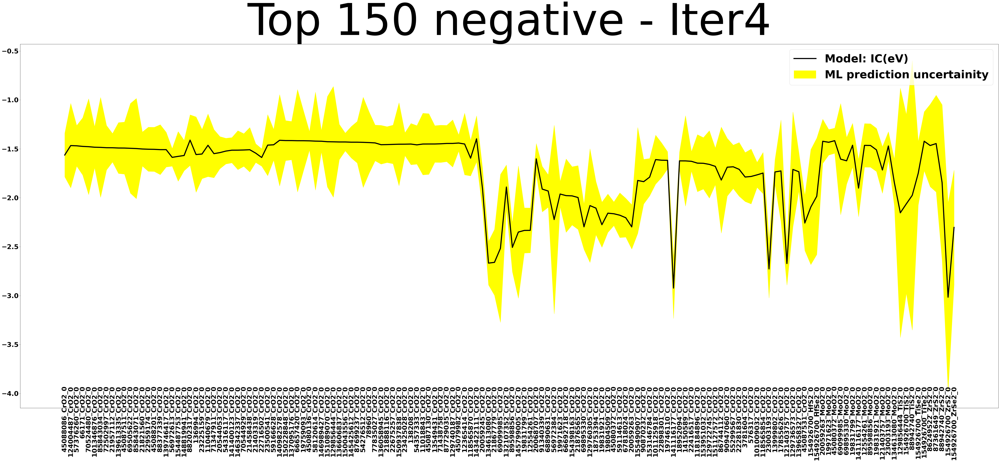

In [23]:
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 30}

mpl.rc('font', **font)

f, ax = plt.subplots(figsize=(80, 30))
ax.tick_params(axis="x",direction="in", pad=-100)
plt.plot(THN.System[:150], THN.Mean[:150], color = "black", label="Model: IC(eV)", linewidth=5)
plt.fill_between(THN.System[:150], THN.Mean[:150]-np.sqrt(THN.Variance[:150]), THN.Mean[:150]+np.sqrt(THN.Variance[:150]), color = "yellow",label="ML prediction uncertainity")

plt.legend(fontsize=50)
#plt.xlim([-3, 3])
#plt.ylim([-3, 3])
#plt.plot([-3, 3], [-3, 3], 'k--')
#plt.yticks(rotation = 45) 
plt.xticks(rotation = 90) 
plt.title("Top 150 negative - Iter4", fontsize = 200)
plt.show()

#f.savefig("Results_Code_4/THN_plot", dpi = 300, transparent = False, facecolor = 'white')

# Check overlap with previous iteration
### Comparing with top 150 predicted from previous interation

In [24]:
THN_combos_minus1 = pd.read_csv('Results_Code_3/Top_150_negative_combos', index_col = None, delimiter = ' ')
THN_combos_minus1

,CID,SMILES,Name
0,23003193,C1=CC2=CNC=CN2C=C1,CrO2
1,136067,C1=CN=CC2=C1C=NC=C2,CrO2
2,10997174,C1=CN2C=CN=C2C(=C1)C=O,CrO2
3,13999802,C1=CC=C2C(=C1)NC=CO2,CrO2
4,23356469,C1=CN2C(=CC=C2C=O)C=N1,CrO2
...,...,...,...
145,17855626,B1=CC=C2C1=CC=C2,WO2
146,154926700,C1=CC2=COC3=CC1=C23,WS2
147,129736573,C1=CC2=C3C1=CC3=CC2=O,WS2
148,154926700,C1=CC2=COC3=CC1=C23,ZrS2


In [25]:
Overlap = pd.concat([THN_combos,THN_combos_minus1], axis=0).reset_index()

## Adding "System" column: 
Overlap = Overlap.astype({'CID' :'str'})
system = []
for i in Overlap.index:
    cid_name = Overlap.CID[i]+'_'+Overlap.Name[i]+'_0'
    system.append(cid_name)

Overlap['System'] = pd.DataFrame(system)
Overlap


,index,CID,SMILES,Name,System
0,77150,45088086,C1=CN2C=CC2=C3C1=CON3,CrO2,45088086_CrO2_0
1,154766,124004487,B1=C(C=C1)F,CrO2,124004487_CrO2_0
2,92249,57376260,C1=COC=C2C1=COC=C2,CrO2,57376260_CrO2_0
3,3629,66171,C=CN1C=CN=C1,CrO2,66171_CrO2_0
4,109490,70524480,B1=CC=CC(=O)C1=O,CrO2,70524480_CrO2_0
...,...,...,...,...,...
295,145,17855626,B1=CC=C2C1=CC=C2,WO2,17855626_WO2_0
296,146,154926700,C1=CC2=COC3=CC1=C23,WS2,154926700_WS2_0
297,147,129736573,C1=CC2=C3C1=CC3=CC2=O,WS2,129736573_WS2_0
298,148,154926700,C1=CC2=COC3=CC1=C23,ZrS2,154926700_ZrS2_0


In [26]:
print('Number of materials predicted to be in top 150 again = ', Overlap.duplicated(subset=['System']).sum())

Number of materials predicted to be in top 150 again =  51


In [27]:
NonRepeating = Overlap.drop_duplicates(subset=['System'], keep=False)
Repeating = Overlap[~Overlap.System.isin(NonRepeating.System)].drop_duplicates(subset=['System'])
Repeating

,index,CID,SMILES,Name,System
0,77150,45088086,C1=CN2C=CC2=C3C1=CON3,CrO2,45088086_CrO2_0
2,92249,57376260,C1=COC=C2C1=COC=C2,CrO2,57376260_CrO2_0
8,64697,21957112,C1=CC=C2C(=C1)C=CON2,CrO2,21957112_CrO2_0
10,77024,45087511,C1=COC2=C3N1C=C3N=C2,CrO2,45087511_CrO2_0
15,77192,45088201,C1=CSC2=C3N1C=C3N=C2,CrO2,45088201_CrO2_0
18,90128,56972613,C1=CC2=C(C=CON2)N=C1,CrO2,56972613_CrO2_0
20,197060,148819941,C1=CN2C=CN=CC2=C=C1,CrO2,148819941_CrO2_0
22,7619,136994,B12C=CC=CN1C=CC=C2,CrO2,136994_CrO2_0
25,110771,71347911,C=C1C(=C)NC=CN1,CrO2,71347911_CrO2_0
27,86138,54316117,C=C1C=C(C(=CC1=C)O)O,CrO2,54316117_CrO2_0


In [28]:
## Adding "System" column: 
THN_combos = THN_combos.reset_index()
THN_combos = THN_combos.astype({'CID' :'str'})
system = []
for i in THN_combos.index:
    cid_name = THN_combos.CID[i]+'_'+THN_combos.Name[i]+'_0'
    system.append(cid_name)

THN_combos['System'] = pd.DataFrame(system)
THN_combos

,index,CID,SMILES,Name,System
0,77150,45088086,C1=CN2C=CC2=C3C1=CON3,CrO2,45088086_CrO2_0
1,154766,124004487,B1=C(C=C1)F,CrO2,124004487_CrO2_0
2,92249,57376260,C1=COC=C2C1=COC=C2,CrO2,57376260_CrO2_0
3,3629,66171,C=CN1C=CN=C1,CrO2,66171_CrO2_0
4,109490,70524480,B1=CC=CC(=O)C1=O,CrO2,70524480_CrO2_0
...,...,...,...,...,...
145,128979,86249522,C=C1C(=C)C2=C1C=C2,ZrS2,86249522_ZrS2_0
146,130848,87361649,C1=CC2=C(O2)C3=CSC=C31,ZrS2,87361649_ZrS2_0
147,133893,88942740,C1=CC2=C1C3=CC(=C23)O,ZrS2,88942740_ZrS2_0
148,210627,154926700,C1=CC2=COC3=CC1=C23,ZrS2,154926700_ZrS2_0


In [29]:
NonRepeating_combos = THN_combos[~THN_combos.System.isin(Repeating.System)]
NonRepeating_combos = NonRepeating_combos[['CID', 'SMILES', 'Name']]
#NonRepeating_combos.to_csv('Results_Code_4/Top_150_negative_combos_minus_overlap', index=False, sep=' ')
NonRepeating_combos

,CID,SMILES,Name
1,124004487,B1=C(C=C1)F,CrO2
3,66171,C=CN1C=CN=C1,CrO2
4,70524480,B1=CC=CC(=O)C1=O,CrO2
5,101346876,C=C1C=NC=CC1=N,CrO2
6,85843034,B1=CN=C1,CrO2
...,...,...,...
143,154926700,C1=CC2=COC3=CC1=C23,TiSe2
145,86249522,C=C1C(=C)C2=C1C=C2,ZrS2
146,87361649,C1=CC2=C(O2)C3=CSC=C31,ZrS2
147,88942740,C1=CC2=C1C3=CC(=C23)O,ZrS2


In [30]:
NonRepeating_molecules = NonRepeating_combos[['CID','SMILES']].drop_duplicates()
#NonRepeating_molecules.to_csv('Results_Code_4/Top_150_negative_mols_minus_overlap', index=False, sep=' ')
NonRepeating_molecules

,CID,SMILES
1,124004487,B1=C(C=C1)F
3,66171,C=CN1C=CN=C1
4,70524480,B1=CC=CC(=O)C1=O
5,101346876,C=C1C=NC=CC1=N
6,85843034,B1=CN=C1
...,...,...
139,134613080,C1=CC2=NC=CNN2C=C1
140,129856444,B1=CC=C2C1=CC=B2
142,88942740,C1=CC2=C1C3=CC(=C23)O
145,86249522,C=C1C(=C)C2=C1C=C2


## 2) Top N uncertain - from Bootstrap

In [31]:
THU = ExploreSet.nlargest(150, ['Variance']).sort_values(by=['Name'])
THU_combos = THU[['CID', 'SMILES', 'Name']]
#THU_combos.to_csv('Results_Code_4/Top_150_uncertain_combos', index=False, sep=' ')
THU_combos

,CID,SMILES,Name
127277,85612290,B1=NC=C1,CrO2
159008,129760305,B12C=CC=CN1O2,CrO2
128096,85843073,B1=CC1=N,CrO2
154556,123898489,B1=NC=COO1,CrO2
59342,21320951,B1=NOOC=C1,CrO2
...,...,...,...
161152,129856444,B1=CC=C2C1=CC=B2,ZrSe2
133895,88942740,C1=CC2=C1C3=CC(=C23)O,ZrTe2
161153,129856444,B1=CC=C2C1=CC=B2,ZrTe2
159767,129785799,C1=CC2=C3C(=CN2C=C1)C3=O,ZrTe2


In [32]:
THU_molecules = THU[['CID','SMILES']].drop_duplicates()
#THU_molecules.to_csv('Results_Code_4/Top_150_uncertain_mols', index=False, sep=' ')
THU_molecules

,CID,SMILES
127277,85612290,B1=NC=C1
159008,129760305,B12C=CC=CN1O2
128096,85843073,B1=CC1=N
154556,123898489,B1=NC=COO1
59342,21320951,B1=NOOC=C1
...,...,...
38777,14150589,B1=CC=C1
68408,22475533,C1=CC=C2C(=C1)C=COC2=S
127572,85774999,C1=C2C(=CC3=COC=C31)O2
8481,142400,C1=CC2=COC=C21


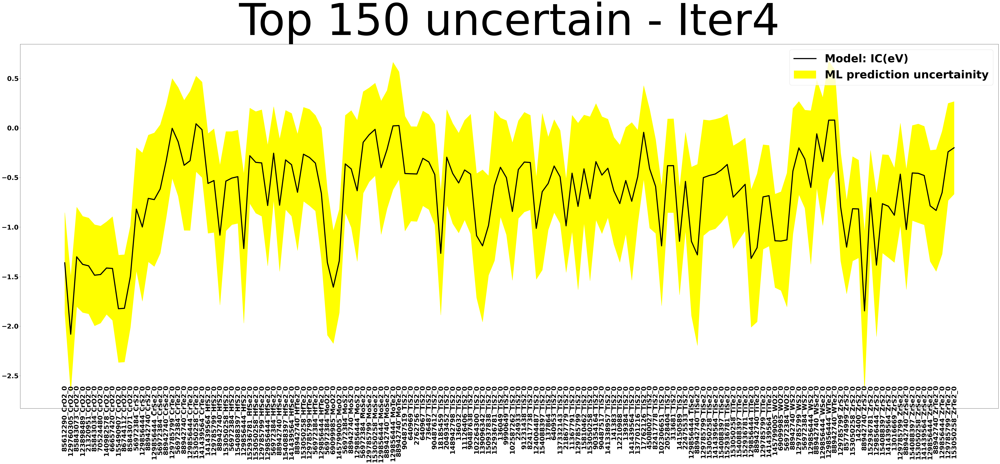

In [33]:
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 30}

mpl.rc('font', **font)

f, ax = plt.subplots(figsize=(80, 30))
ax.tick_params(axis="x",direction="in", pad=-105)
plt.plot(THU.System[:150], THU.Mean[:150], color = "black", label="Model: IC(eV)", linewidth=5)
plt.fill_between(THU.System[:150], THU.Mean[:150]-np.sqrt(THU.Variance[:150]), THU.Mean[:150]+np.sqrt(THU.Variance[:150]), color = "yellow",label="ML prediction uncertainity")

plt.legend(fontsize=50)
#plt.xlim([-3, 3])
#plt.ylim([-3, 3])
#plt.plot([-3, 3], [-3, 3], 'k--')
#plt.yticks(rotation = 45) 
plt.xticks(rotation = 90) 
plt.title("Top 150 uncertain - Iter4", fontsize = 200)
plt.show()

#f.savefig("Results_Code_4/THU_plot", dpi = 300, transparent = False, facecolor = 'white')

## Top N Negative: DFT vs Prediction

In [34]:
IC_9 = pd.read_csv('Results_Code_4/IC_THN_4.txt', delimiter =',')
Gas_9 = pd.read_csv('Results_Code_4/Gas_THN_4.txt', delimiter =',')

IC9 = IC_calculator.IC_calculator(IC_9, Gas_9, Bilayer)
IC9 = IC9.merge(ExploitSet, on=["System"], how = "left")
IC9['Error'] = IC9['Mean'] - IC9['IC_ENERGY']
IC9 = IC9[['System', 'IC_ENERGY', 'Variance', 'Mean', 'Error']].sort_values(by = "Error").dropna()
IC9

,System,IC_ENERGY,Variance,Mean,Error
88,88942740_ZrS2_0,0.351262,0.632631,-1.845351,-2.196613
38,155490907_CrO2_0,-0.413790,0.293248,-1.823422,-1.409632
82,86744112_CrO2_0,-0.492661,0.293385,-1.819210,-1.326549
31,151089070_CrO2_0,-0.192354,0.213376,-1.427447,-1.235093
57,3781604_CrO2_0,-0.637941,0.062723,-1.788303,-1.150362
...,...,...,...,...,...
40,19831799_CrO2_0,-4.125951,0.053445,-2.334146,1.791805
91,91340339_CrO2_0,-4.060397,0.054205,-1.911663,2.148734
30,150937838_CrO2_0,-3.695638,0.179758,-1.452981,2.242657
7,124004487_CrO2_0,-4.141505,0.186072,-1.466981,2.674524


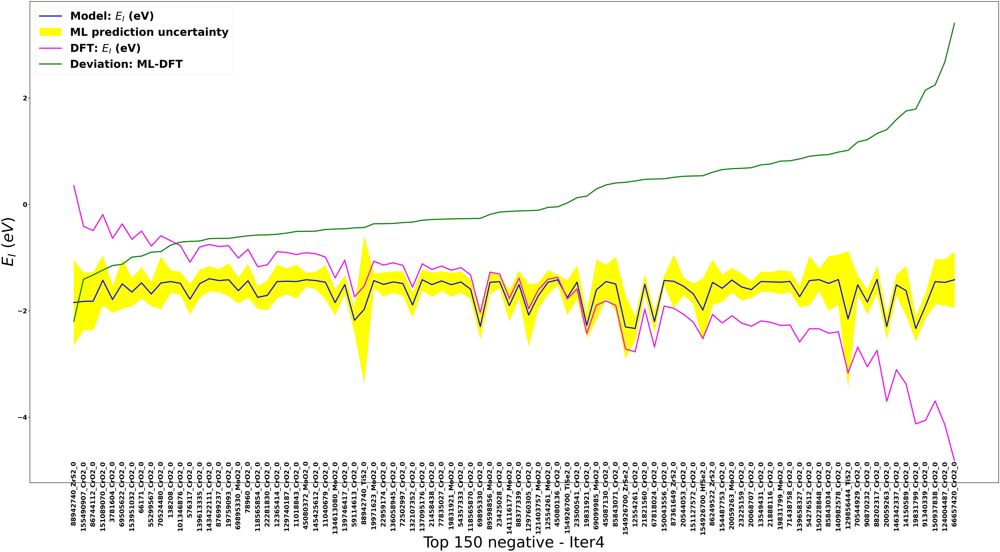

In [40]:
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 30}

mpl.rc('font', **font)

f, ax = plt.subplots(figsize=(80, 40))
ax.tick_params(axis="x",direction="in", pad=-100)
#label_mlr = "$R^2$ = %.2f" % r2_mean

# Increase axis font size
ax.tick_params(axis='both', labelsize=30)

# Increase axis linewidth
ax.spines['top'].set_linewidth(2)
ax.spines['bottom'].set_linewidth(2)
ax.spines['left'].set_linewidth(2)
ax.spines['right'].set_linewidth(2)

# Increase tick mark thickness and length
ax.tick_params(which='both', width=2, length=8)

plt.plot(IC9.System[:150], IC9.Mean[:150], color = "blue",label="Model: $E_I$ (eV)",linewidth=5)
plt.fill_between(IC9.System[:150], IC9.Mean[:150]-np.sqrt(IC9.Variance[:150]), IC9.Mean[:150]+np.sqrt(IC9.Variance[:150]), color = "yellow", label="ML prediction uncertainty")
plt.plot(IC9.System[:150], IC9.IC_ENERGY[:150], color = "magenta", label="DFT: $E_I$ (eV)", linewidth=5)
plt.plot(IC9.System[:150], IC9.Error[:150], color = "green", label="Deviation: ML-DFT",linewidth=5)
plt.ylabel(r"$E_{I}$ ($eV$)", fontsize = 70)
plt.xlabel("Top 150 negative - Iter4", fontsize = 70)
plt.legend(fontsize=50)
#plt.xlim([-3, 3])
#plt.ylim([-3, 1])
#plt.yticks(rotation = 45) 
plt.xticks(rotation = 90) 
#plt.title("Top 150 negative - Iter4", fontsize = 200)
plt.show()
 
#f.savefig("Results_Code_4/THN_with_DFT_plot", dpi = 300, transparent = False, facecolor = 'white')

## Top N Uncertain: DFT vs Prediction

In [36]:
IC_10 = pd.read_csv('Results_Code_4/IC_THU_4.txt', delimiter =',')
Gas_10 = pd.read_csv('Results_Code_4/Gas_THU_4.txt', delimiter =',')
IC10 = IC_calculator.IC_calculator(IC_10, Gas_10, Bilayer)
IC10 = IC10.merge(ExploitSet, on=["System"], how = "left")
IC10['Error'] = IC10['Mean'] - IC10['IC_ENERGY']
IC10 = IC10[['System', 'IC_ENERGY', 'Variance', 'Mean', 'Error']].sort_values(by = "Error").dropna()
IC10

,System,IC_ENERGY,Variance,Mean,Error
132,88942740_TiSe2_0,1.033800,0.835400,-1.280011,-2.313811
137,88942740_ZrS2_0,0.359950,0.632631,-1.845351,-2.205301
138,88942740_ZrSe2_0,0.899445,0.365123,-1.023986,-1.923431
133,88942740_TiTe2_0,0.541012,0.557660,-1.207931,-1.748943
127,88942740_HfSe2_0,0.960445,0.445004,-0.779068,-1.739513
...,...,...,...,...,...
60,150937838_TiS2_0,-3.042960,0.251837,-0.983757,2.059203
122,85843073_CrO2_0,-3.453114,0.251766,-1.299865,2.153249
110,66657420_CrO2_0,-3.725451,0.273636,-1.417296,2.308155
8,124004487_TiS2_0,-3.745844,0.263945,-1.012546,2.733298


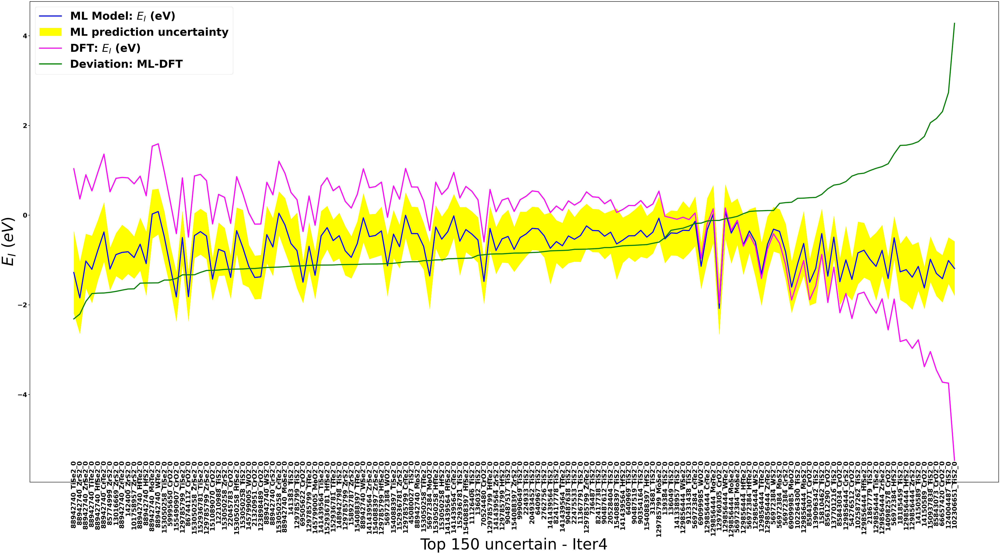

In [41]:
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 30}

mpl.rc('font', **font)

f, ax = plt.subplots(figsize=(80, 40))
ax.tick_params(axis="x",direction="in", pad=-100)

# Increase axis font size
ax.tick_params(axis='both', labelsize=30)

# Increase axis linewidth
ax.spines['top'].set_linewidth(2)
ax.spines['bottom'].set_linewidth(2)
ax.spines['left'].set_linewidth(2)
ax.spines['right'].set_linewidth(2)

# Increase tick mark thickness and length
ax.tick_params(which='both', width=2, length=8)

#label_mlr = "$R^2$ = %.2f" % r2_mean

plt.plot(IC10.System[:150], IC10.Mean[:150], color = "blue",label="ML Model: $E_I$ (eV)",linewidth=5)
plt.fill_between(IC10.System[:150], IC10.Mean[:150]-np.sqrt(IC10.Variance[:150]), IC10.Mean[:150]+np.sqrt(IC10.Variance[:150]), color = "yellow", label="ML prediction uncertainty")
plt.plot(IC10.System[:150], IC10.IC_ENERGY[:150], color = "magenta", label="DFT: $E_I$ (eV)", linewidth=5)
plt.plot(IC10.System[:150], IC10.Error[:150], color = "green", label="Deviation: ML-DFT",linewidth=5)
plt.ylabel(r"$E_{I}$ ($eV$)", fontsize = 70)
plt.xlabel("Top 150 uncertain - Iter4", fontsize = 70)
plt.legend(fontsize=50)
#plt.xlim([-3, 3])
#plt.ylim([-3, 3])
#plt.yticks(rotation = 45) 
plt.xticks(rotation = 90) 
#plt.title("Top 150 uncertain - Iter4", fontsize = 200)
plt.show()
 
#f.savefig("Results_Code_4/THU_with_DFT_plot", dpi = 300, transparent = False, facecolor = 'white')

In [38]:
#THN.to_csv('THN_4iter.txt', index=False)

In [39]:
#ExploitSet.to_csv('ExploitSet_4iter.txt', index=False)